### Script for summarizing microbiome article searches
#### Reads exported xml files from keyword searches in IU One Search and summarizes information by creating wordclouds from clusters of topics

by R.K.Fischer, rkfische@iu.edu

1. Read in and parse xml files (which were exported from separate keyword searches using IU one search); each xml file has hundreds to thousands of article records.  
2. Filter articles that contain a subject word in the bacteria_list; tokenize the filtered articles' abstract text.  
3. Group tokens into topics using sklearn's NMF algorithm.  Number of topics is determined by dividing the product of number of articles and the number of words by the non-zero values in the tfidf matrix. Originally, capped each search file to five NMF topics.  In each case, the topic contained 20 words each.  
4. Apply network graph technology to group topics. Topics linked with their words were brought into a network graph application, Gephi, and grouped using the modularity function. 
5. Create word streams from the grouped topics' words. The modularity groups were imported back and word streams were created for each group cluster.  
6. Print wordclouds as a way to summarize each cluster of topics (clusters contain 1, 2 or many topics, e.g. 20 topics are in one cluster) 

In [29]:
import xml.etree.ElementTree as ET
import pandas as pd

from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.decomposition import NMF, LatentDirichletAllocation
import numpy as np
import math
import matplotlib.pyplot as plt
from wordcloud import WordCloud, STOPWORDS 
import matplotlib.cm as cm

import networkx as nx
import community.community_louvain
from networkx.algorithms.community.centrality import girvan_newman

from collections import Counter

In [30]:
xml_files = ["microbiome_amplicon.xml", "microbiome_wholegenome.xml", "microbiome_deNovo.xml", 
             "microbiome_index.xml",'microbiome_consortium.xml',
             "microbiome_parkinson.xml", "microbiome_cancer.xml", 
             "microbiome_diabetes.xml", "microbiome_alzheimer.xml"]
file_tags = ['amp', 'wg', 'dn', 'ind', 'con','p', 'c', 'd', 'a']


In [31]:
bacteria_list = ['escherichia', 'coli', 'staphylococcus', 'aureus',
                 'enterococcus', 'faecalis',
                'staphylococcus', 'epidermidis', 'carbapenems',
                'salmonella', 'lactobacillus', 'streptococcus',
                'prevotella', 'coxiella', 'burnetii', 'legionella',
                'akkermansia', 'bifidobacterium',
                'lactobacillus', 'escherichia', 
                'roseburia', 'blautia', 'faecalibacterium']

In [32]:
def create_root(file):
    tree = ET.parse(file)
    root = tree.getroot()
    return root

In [33]:
def records_with_bacteria_subj(root):
    text_list = []
    record_list = []
    article_count = 0
    for record in root.findall("rec"):
        article_count +=1
        try:
            subjects = record.findall("header/controlInfo/artinfo/sug/")
            bacteria_flag = 0
            if len(subjects)>0:
                for subj in subjects:
                    try:
                        text_list.append(subj.text.lower().split())
                        text_words = text_list.pop()
                    except:
                        pass
                    for word in text_words:
                        if word in bacteria_list:
                            # print("word matches", word)
                            bacteria_flag = 1
            if bacteria_flag == 1:
                record_list.append(record.attrib['resultID'])
        except:
            pass
    # print(record_list)
    return [record_list, article_count]



In [34]:
def get_abstracts(record_list, root):
    tag_dict = {'au':'author', 'atl': 'title', 'subj': 'subject', 'affil': 'affiliation',
               'fmt': 'format'}
    ab_text_list = []
    rec_nbr=[]
    for record in root.findall("rec"):
        if record.attrib['resultID'] in record_list:
            try:
                abstract = record.find("header/controlInfo/artinfo/ab").text
                #There may be more than one ab per article
                if abstract not in ab_text_list:
                    ab_text_list.append(abstract)
                    rec_nbr.append(record.attrib['resultID'])
            except:
                pass
    # print(rec_nbr)
    return [ab_text_list, rec_nbr]
    

In [35]:
def topic_generation(text_list, tag, rec_nbr, number_of_topics, number_of_tokens):
    topic_list = []
    search_list = []
    vect = TfidfVectorizer(smooth_idf=True, sublinear_tf=False, norm=None, analyzer='word',
                           max_features=3000, min_df=2, ngram_range=(1,1),
                          stop_words='english', strip_accents ='ascii')
    X = vect.fit_transform(text_list)
    feature_names = np.array(vect.get_feature_names())
    # merge the search file tag to the record number to link back to a specific article
    index_rec = [tag+str(x) for x in rec_nbr]
    # save X array into a dataframe 
    # with word tokens as columns and file record number as row index
    tf_idf_df = pd.DataFrame(X.toarray(), columns = feature_names, index=index_rec)
    
    # count the nonzero values as part of the number of topics calculation
    x_ar = X.todense()
    non_zero_values = 0
    for x in x_ar:
        non_zero_values += np.count_nonzero(x)

    print("Number of abstract texts (length of text_list)",len(text_list))
    print("number of words (len of feature_names)", len(feature_names))
    print("non_zero_values", non_zero_values)
    number_of_topics = round( (len(text_list)*len(feature_names))/non_zero_values )
    print("Number of recommended topics:", number_of_topics )

    nmf = NMF(n_components=number_of_topics, solver="mu")
    W = nmf.fit_transform(X)
    H = nmf.components_
    for i, topic in enumerate(H):
        topic_words=[]
        for x in feature_names[topic.argsort()[-number_of_tokens:]]:
            topic_words.append(x)
        topic_list.append(topic_words)
        search_list.append(tag+str(i+1))
    return topic_list, search_list, tf_idf_df


In [36]:
# Main code calling the above functions

topic_word_list = []
topic_search_list = []
cnt = 0
tpc = 0
flag = 0
for file, tag in zip(xml_files, file_tags):
    print("\n", file, "tag", tag)
    root = create_root(file)
    record_list, article_count = records_with_bacteria_subj(root)
    print("Number of total records:", article_count)
    print("Number of filtered records",len(record_list)) 
    ab_text_list, rec_nbr = get_abstracts(record_list, root)
    topic_list, search_list, tf_idf_df = topic_generation(ab_text_list, tag, rec_nbr, 5, 20)
    
    # is there risk of word columns being overwritten across xml files???????????????????
    if flag == 0:
        ab_word_vector_df = tf_idf_df.copy(deep=True)
        flag = 1
    else:
        ab_word_vector_df = pd.concat([ab_word_vector_df,tf_idf_df])   
         
    topic_word_list.append(topic_list)
    topic_search_list.append(search_list)
print("\nNumber of search result xml files" ,len(topic_word_list) )
print("\nNumber of abstracts (length of ab_word_vector_df)", len(ab_word_vector_df))
print("\nNumber of word tokens (columns in ab_word_vector_df)", len(ab_word_vector_df.columns))
print("\nNumber of topics", len(topic_search_list))

topic_dict = {}
word_cloud_list = []
for tag, search in zip(topic_search_list, topic_word_list):
    for t, s in zip(tag, search):
        # print(t, s)
        topic_dict[t]=s
    for topic in search:
        for word in topic:
            word_cloud_list.append(word)
listToStr = ' '.join([str(elem) for elem in word_cloud_list])
print("\nTotal number of topics generated:", len(topic_dict))


    


 microbiome_amplicon.xml tag amp
Number of total records: 1728
Number of filtered records 224
Number of abstract texts (length of text_list) 210
number of words (len of feature_names) 2584
non_zero_values 18736
Number of recommended topics: 29

 microbiome_wholegenome.xml tag wg
Number of total records: 700
Number of filtered records 110
Number of abstract texts (length of text_list) 108
number of words (len of feature_names) 1719
non_zero_values 9191
Number of recommended topics: 20

 microbiome_deNovo.xml tag dn
Number of total records: 140
Number of filtered records 9
Number of abstract texts (length of text_list) 9
number of words (len of feature_names) 146
non_zero_values 367
Number of recommended topics: 4

 microbiome_index.xml tag ind
Number of total records: 2645
Number of filtered records 303
Number of abstract texts (length of text_list) 292
number of words (len of feature_names) 2951
non_zero_values 25335
Number of recommended topics: 34

 microbiome_consortium.xml tag con

In [37]:
ab_word_vector_df = ab_word_vector_df.fillna(0)

In [88]:
# find articles by key word sorted by tfidf
ex_word= 'study'
article_word_df = ab_word_vector_df.loc[ab_word_vector_df[ex_word]>0, [ex_word]]
print(ab_word_vector_df.loc['amp27'][ex_word])
print(article_word_df.sort_values(ex_word, ascending=False))

0.0
             study
ind1392  12.308072
ind1767  12.308072
con952    9.882548
c4859     9.188642
c2571     9.188642
...            ...
amp1103   1.476661
amp1105   1.476661
amp1109   1.476661
amp1709   1.476661
amp1352   1.476661

[771 rows x 1 columns]


In [89]:
article_word_df.index

Index(['amp100', 'amp126', 'amp133', 'amp156', 'amp157', 'amp166', 'amp187',
       'amp245', 'amp269', 'amp296',
       ...
       'd4976', 'a123', 'a175', 'a367', 'a420', 'a422', 'a456', 'a467', 'a508',
       'a520'],
      dtype='object', length=771)

In [90]:
def cosine_similarity(vector1, vector2):
    dot_product = sum(p*q for p,q in zip(vector1, vector2))
    magnitude = math.sqrt(sum([val**2 for val in vector1])) * math.sqrt(sum([val**2 for val in vector2]))
    if not magnitude:
        return 0
    return dot_product/magnitude

In [91]:
cosine_similarity(ab_word_vector_df.loc['amp100'], ab_word_vector_df.loc['amp126'])



0.020415346177405085

In [92]:
# Create a networkx graph with words and topic tags as nodes

microbiome = nx.Graph()

for tag in topic_search_list:
    for t in tag:
        microbiome.add_node(t, size = 100)
for words in topic_word_list:
    for word in words:
        for w in word:
            microbiome.add_node(w, size =1)

for tag, words in zip(topic_search_list, topic_word_list):
    for t, w in zip(tag, words):
        print("*********")
        for word in w: 
            print(t, word)
            microbiome.add_edge(t, word, weight = 1)
    
cluster = nx.clustering(microbiome)    

*********
amp1 study
amp1 healthy
amp1 microbial
amp1 risk
amp1 fecal
amp1 abundance
amp1 lactobacillus
amp1 probiotics
amp1 control
amp1 treatment
amp1 diversity
amp1 effects
amp1 significantly
amp1 patients
amp1 composition
amp1 microbiome
amp1 probiotic
amp1 group
amp1 microbiota
amp1 gut
*********
amp2 rare
amp2 abundance
amp2 dental
amp2 neisseria
amp2 taxa
amp2 diversity
amp2 difference
amp2 unstimulated
amp2 deep
amp2 05
amp2 active
amp2 dentinal
amp2 microbiota
amp2 salivary
amp2 affected
amp2 saliva
amp2 free
amp2 ecc
amp2 children
amp2 caries
*********
amp3 forest
amp3 mycoides
amp3 coxiella
amp3 ticks
amp3 tick
amp3 staphylococcus
amp3 bacterial
amp3 detected
amp3 species
amp3 bacillus
amp3 tof
amp3 maldi
amp3 cons
amp3 rhizobium
amp3 2797
amp3 dominant
amp3 bacilli
amp3 ricinus
amp3 ixodes
amp3 reads
*********
amp4 representative
amp4 culturable
amp4 infections
amp4 fimh
amp4 infection
amp4 using
amp4 cases
amp4 clinical
amp4 dominant
amp4 majority
amp4 coli
amp4 acute
amp4

dn2 strains
dn2 systems
dn2 dominant
dn2 assembled
dn2 results
dn2 data
dn2 assembly
dn2 bacterial
dn2 low
dn2 sequencing
dn2 phages
dn2 genomes
dn2 plasmids
dn2 genome
dn2 complete
*********
dn3 traits
dn3 showed
dn3 revealed
dn3 31
dn3 related
dn3 provide
dn3 level
dn3 composition
dn3 non
dn3 using
dn3 abundance
dn3 metagenome
dn3 study
dn3 allowed
dn3 relative
dn3 high
dn3 larger
dn3 accuracy
dn3 levels
dn3 feed
*********
dn4 samples
dn4 microbes
dn4 stool
dn4 gastrointestinal
dn4 acids
dn4 flagella
dn4 metabolism
dn4 carbohydrates
dn4 binding
dn4 adaptation
dn4 tract
dn4 changes
dn4 insight
dn4 significantly
dn4 functions
dn4 community
dn4 important
dn4 gut
dn4 microbial
dn4 species
*********
ind1 studies
ind1 intestinal
ind1 analysis
ind1 significantly
ind1 abundance
ind1 healthy
ind1 subjects
ind1 species
ind1 protein
ind1 associated
ind1 metabolic
ind1 diet
ind1 dietary
ind1 microbial
ind1 composition
ind1 obesity
ind1 diversity
ind1 microbiota
ind1 microbiome
ind1 gut
*********

ind34 consumption
ind34 score
ind34 lda
ind34 sugar
*********
con1 initial
con1 neutral
con1 bovine
con1 sialylated
con1 spectrometry
con1 range
con1 selective
con1 lactis
con1 infant
con1 key
con1 serve
con1 bifidobacteria
con1 growth
con1 infantis
con1 endobi
con1 substrates
con1 released
con1 glycoproteins
con1 milk
con1 glycans
*********
con2 behaviors
con2 memory
con2 conventionalization
con2 abnormalities
con2 neurodevelopment
con2 colonized
con2 complex
con2 bifidobacterium
con2 modulation
con2 neonatal
con2 adult
con2 behavior
con2 early
con2 motor
con2 behavioral
con2 microbiota
con2 infant
con2 free
con2 germ
con2 mice
*********
con3 impact
con3 specific
con3 healthy
con3 factors
con3 study
con3 bacterial
con3 probiotics
con3 bacteria
con3 vaginal
con3 body
con3 studies
con3 population
con3 microbial
con3 prevotella
con3 different
con3 health
con3 species
con3 host
con3 gut
con3 microbiome
*********
con4 strains
con4 14
con4 diversity
con4 time
con4 parameters
con4 period
con

c24 supplement
c24 state
c24 placebo
c24 stress
c24 anxiety
c24 psychological
c24 depression
c24 mood
*********
c25 significant
c25 abundance
c25 status
c25 cp
c25 lung
c25 source
c25 seven
c25 fold
c25 sp
c25 streptococcus
c25 spontaneous
c25 bacterial
c25 viridans
c25 biomarkers
c25 species
c25 year
c25 stage
c25 sputum
c25 samples
c25 lc
*********
c26 dependent
c26 indigenous
c26 growth
c26 status
c26 hosts
c26 coli
c26 susceptible
c26 mice
c26 compositional
c26 availability
c26 supplementation
c26 il10
c26 community
c26 wt
c26 dietary
c26 microbiota
c26 assembly
c26 host
c26 luminal
c26 iron
*********
c27 intraepithelial
c27 scoring
c27 effect
c27 crispatus
c27 higher
c27 types
c27 microbiota
c27 iners
c27 women
c27 neoplasia
c27 reri
c27 pattern
c27 semi
c27 dominant
c27 95
c27 ci
c27 vaginae
c27 risk
c27 cin
c27 cervical
*********
c28 essential
c28 early
c28 promote
c28 maturation
c28 protein
c28 bifidobacterium
c28 colonisers
c28 host
c28 subunit
c28 vivo
c28 epithelial
c28 stra

d32 end
d32 content
d32 placebo
d32 fecal
d32 fibrosis
d32 fat
d32 synbiotic
d32 nafld
d32 liver
*********
d33 expression
d33 supplements
d33 hypothesized
d33 increase
d33 mrna
d33 epithelial
d33 beneficial
d33 separately
d33 combination
d33 permeability
d33 dietary
d33 cell
d33 rhamnosus
d33 components
d33 lactis
d33 integrity
d33 barrier
d33 intestinal
d33 oil
d33 fish
*********
d34 infants
d34 immune
d34 bacteroides
d34 environmental
d34 islet
d34 autoimmunity
d34 birth
d34 mode
d34 milk
d34 breast
d34 46
d34 maturation
d34 early
d34 crosstalk
d34 developmental
d34 faster
d34 microbiome
d34 life
d34 months
d34 phase
*********
d35 database
d35 ckd
d35 frequency
d35 disturbance
d35 difficile
d35 constructed
d35 microbial
d35 analysis
d35 population
d35 33
d35 types
d35 links
d35 diseases
d35 respectively
d35 supplementation
d35 placebo
d35 published
d35 clostridium
d35 articles
d35 vs
*********
a1 disease
a1 functions
a1 alteration
a1 diversity
a1 dysbiosis
a1 18
a1 interventions
a1 c

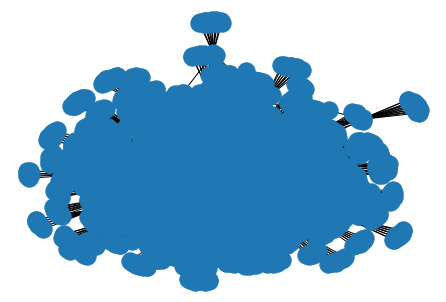

In [19]:

nx.draw(microbiome, with_labels=False)

In [93]:
len(microbiome)

2017

In [94]:
partition = community.community_louvain.best_partition(microbiome)

In [95]:
len(partition)

2017

In [96]:
cluster_list = list(set(partition.values()))
len(cluster_list)

23

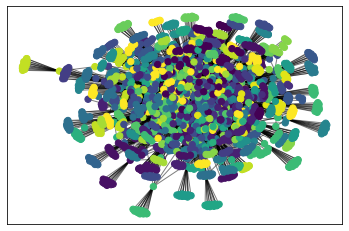

In [101]:

G= microbiome
# draw the graph
pos = nx.spring_layout(G)
# color the nodes according to their partition
cmap = cm.get_cmap('viridis', max(partition.values()) + 1)
nx.draw_networkx_nodes(G, pos, partition.keys(), node_size=40,
                       cmap=cmap, node_color=list(partition.values()))
nx.draw_networkx_edges(G, pos, alpha=0.5)
plt.show()

In [124]:
# Export graph for reading into Gephi
nx.write_gexf(microbiome, "microbiome.gexf")

In [97]:
# create a list of topic tags
topic_tags = []
for l in topic_search_list:
    for tag in l:
        topic_tags.append(tag)

In [98]:
# set the stopwords and include recurring stopwords that may not help the analysis 
stopwords = set(STOPWORDS) 
additional_stop_words = ['significantly', 'abundance', 'vector', 'group','patient',
                        'patients', 'sample', 'isolates', 'isolate','demonstrated',
                        'incorporated', 'free']
for word in additional_stop_words:
    stopwords.add(word)

Wordcloud ** study ** for these topics: ['amp1', 'wg1', 'wg9', 'dn4', 'ind1', 'ind8', 'ind24', 'con3', 'p4', 'p5', 'p6', 'c1', 'd5', 'd6', 'd23', 'a1', 'a3', 'a4', 'a6', 'a7'] 

Top 5 words ['study', 'healthy', 'microbial', 'risk', 'probiotics']


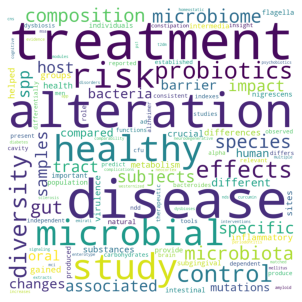

Wordcloud ** rare ** for these topics: ['amp2', 'amp6', 'amp8', 'wg12', 'ind12', 'con1', 'con4', 'con8', 'c28', 'c39', 'd9', 'd33', 'd34'] 

Top 5 words ['rare', 'dental', 'neisseria', 'difference', 'unstimulated']


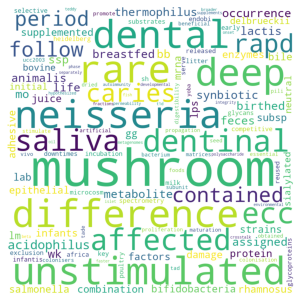

Wordcloud ** probiotic ** for these topics: ['amp9', 'wg5', 'wg16', 'ind13', 'ind17', 'ind23', 'ind29', 'con7', 'c4', 'c16', 'c17', 'c22', 'c34'] 

Top 5 words ['probiotic', 'children', 'correlated', 'anthropometric', '104']


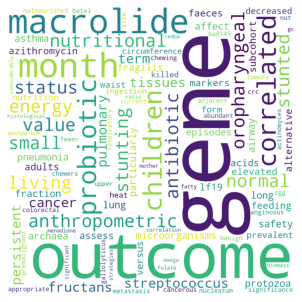

Wordcloud ** lactobacillus ** for these topics: ['ind20', 'ind21', 'p2', 'c24', 'd7', 'd17', 'a2'] 

Top 5 words ['lactobacillus', '12', 'placebo', 'bifidobacterium', 'scfa']


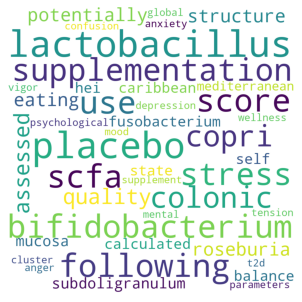

Wordcloud ** swabs ** for these topics: ['amp5', 'ind28', 'con10', 'con15', 'c25', 'c36'] 

Top 5 words ['swabs', 'low', 'dominated', 'lower', 'differed']


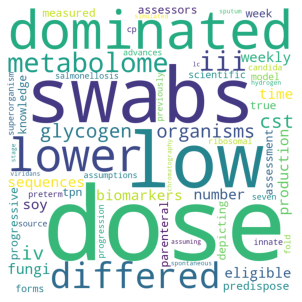

Wordcloud ** taxa ** for these topics: ['amp20', 'amp29', 'wg17', 'ind7', 'ind9', 'ind31', 'ind34', 'con13', 'd1', 'd19', 'd26', 'd27', 'd29', 'd32'] 

Top 5 words ['taxa', '05', 'participants', 'consumption', 'water']


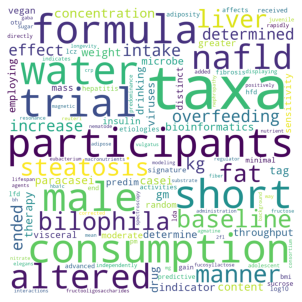

Wordcloud ** dominant ** for these topics: ['amp4', 'amp7', 'wg2', 'wg4', 'wg18', 'wg19', 'dn1', 'dn2', 'dn3', 'con18', 'c26'] 

Top 5 words ['dominant', 'representative', 'culturable', 'fimh', 'using']


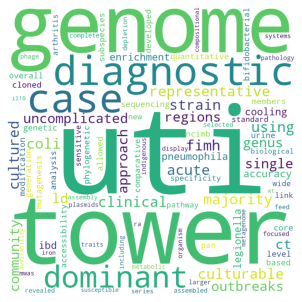

Wordcloud ** activity ** for these topics: ['c6', 'c9', 'd2'] 

Top 5 words ['activity', 'microbes', 'scfas', 'reduction', 'growth']


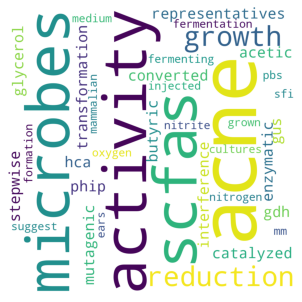

Wordcloud ** mice ** for these topics: ['wg7', 'ind2', 'ind6', 'con14', 'con16', 'c8', 'c11', 'c12', 'c29', 'c33', 'd3', 'a5'] 

Top 5 words ['mice', 'cell', 'culture', 'colon', 'induced']


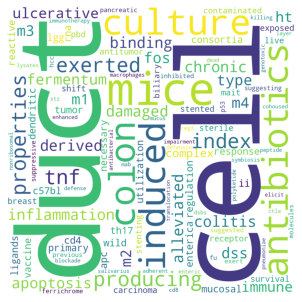

Wordcloud ** colonization ** for these topics: ['amp10', 'wg6', 'wg14', 'ind15', 'con5', 'c19', 'd13'] 

Top 5 words ['colonization', 'respect', 'carriers', 'pandemic', 'highly']


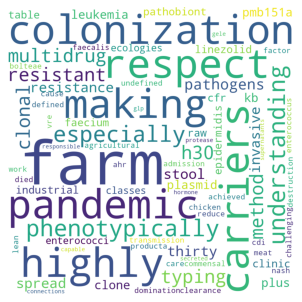

Wordcloud ** restore ** for these topics: ['amp11', 'ind32', 'c20', 'd15'] 

Top 5 words ['restore', 'prolonged', 'enriched', 'blaper', 'preferably']


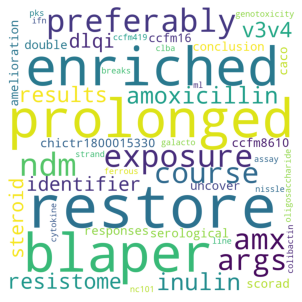

Wordcloud ** active ** for these topics: ['amp19', 'wg8', 'ind18', 'ind22', 'con17', 'c5', 'c15', 'c35', 'd35'] 

Top 5 words ['active', 'metabolites', 'models', 'difficile', '21']


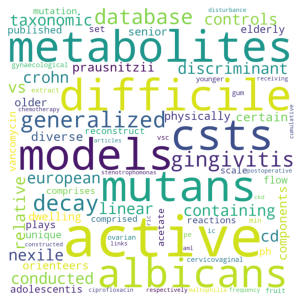

Wordcloud ** caused ** for these topics: ['amp13', 'amp28', 'ind19', 'p1', 'p3', 'd24'] 

Top 5 words ['caused', 'interestingly', 'solely', 'males', 'pseudomonas']


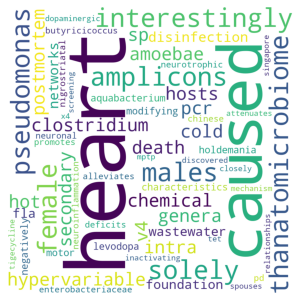

Wordcloud ** bacterial ** for these topics: ['amp14', 'amp23', 'wg11', 'c32', 'd8'] 

Top 5 words ['bacterial', 'related', 'like', 'reinforcing', 'cleaning']


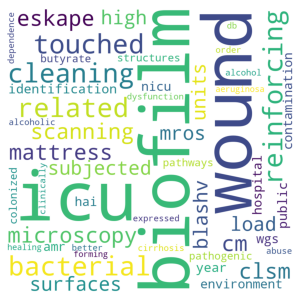

Wordcloud ** la ** for these topics: ['con11', 'c14', 'd21', 'a8'] 

Top 5 words ['la', 'expression', 'lipoprotein', 'prebiotic', 'plantarum']


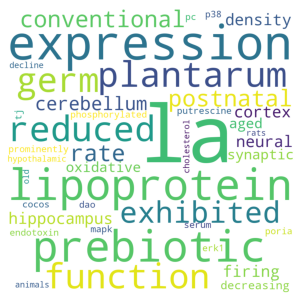

Wordcloud ** forest ** for these topics: ['amp3', 'amp21', 'amp22', 'wg13', 'ind10', 'c7', 'c31', 'd18'] 

Top 5 words ['forest', 'mycoides', 'coxiella', 'ticks', 'tick']


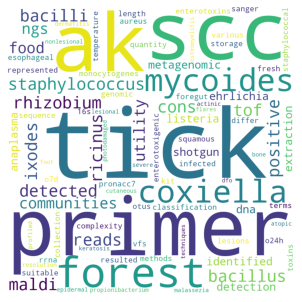

Wordcloud ** concentrations ** for these topics: ['amp18', 'amp25', 'amp26', 'ind4', 'ind5', 'ind25', 'ind26', 'ind30', 'p7', 'c10', 'd20', 'd28'] 

Top 5 words ['concentrations', 'fermented', 'intervention', 'demonstrated', 'murine']


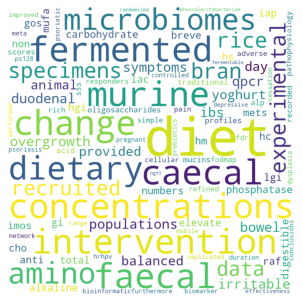

Wordcloud ** salivary ** for these topics: ['wg3', 'wg20', 'c40'] 

Top 5 words ['salivary', 'indicating', 'events', 'snps', 'lost']


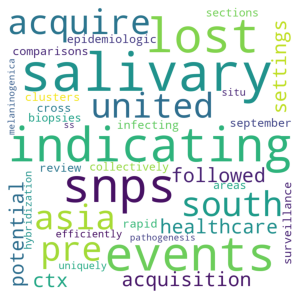

Wordcloud ** longum ** for these topics: ['wg15', 'ind3', 'ind27', 'con12', 'c2'] 

Top 5 words ['longum', 'pathogen', 'used', '01', 'capacity']


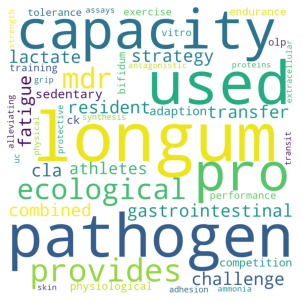

Wordcloud ** fecal ** for these topics: ['amp17', 'con6', 'c18', 'd11', 'd14', 'd25', 'd30'] 

Top 5 words ['fecal', 'years', 'prevotella', 'fmt', 'weeks']


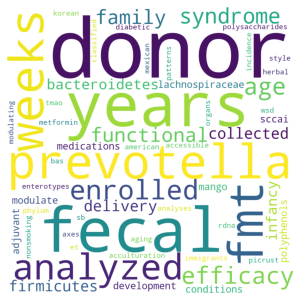

Wordcloud ** vaginal ** for these topics: ['amp12', 'amp15', 'amp24', 'wg10', 'ind16', 'con2', 'c30', 'd4', 'd12'] 

Top 5 words ['vaginal', 'women', 'infant', 'intestine', 'diagnosed']


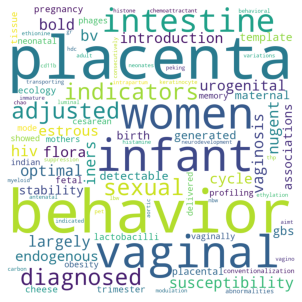

Wordcloud ** infections ** for these topics: ['amp27', 'ind11', 'c3', 'c23', 'c27'] 

Top 5 words ['infections', 'infection', 'hpv', 'cohort', 'ci']


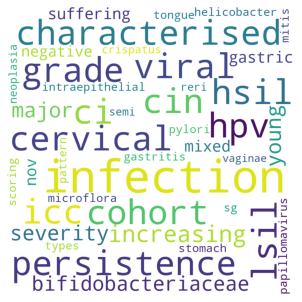

Wordcloud ** abundance ** for these topics: ['amp16', 'ind14', 'ind33', 'con9', 'c13', 'c21', 'c37', 'c38', 'd10', 'd16', 'd22', 'd31'] 

Top 5 words ['abundance', 'fed', 'western', 'sewage', 'richness']


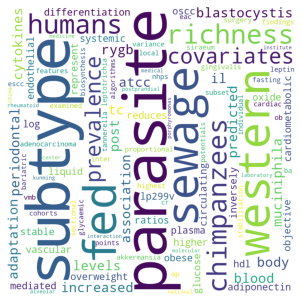

In [99]:
# print out a wordcloud for each group of topics along with the topics
# https://stackoverflow.com/questions/42322331/pythonic-way-to-find-all-elements-with-the-highest-frequency

summary_list = []
for g in cluster_list:
    word_cloud_list = []
    node_list = []
    for key in partition:
        group = partition[key]
        node = key
        if group==g and node not in topic_tags:
            word_cloud_list.append(node)
        if group==g and node in topic_tags and node not in node_list:  
            node_list.append(node)
    word_count = Counter(word_cloud_list)
    top_word_in_cluster = word_count.most_common(1)[0][0]
    top5 =  [x for x, _ in word_count.most_common(5)]
    listToStr = ' '.join([str(elem) for elem in word_cloud_list])
    wordcloud = WordCloud(width = 1000, height = 1000, 
                background_color ='white', 
                stopwords = stopwords, 
                min_font_size = 10).generate(listToStr) 
    print("Wordcloud **", top_word_in_cluster, "** for these topics:", node_list, "\n")
    print("Top 5 words", top5)
    #for node in node_list:
        #print(topic_dict[node])
    summary_list.append([len(node_list),top5])

    # plot the WordCloud image                        
    plt.figure(figsize = (4, 6), facecolor = None) 
    plt.imshow(wordcloud) 
    plt.axis("off") 
    plt.tight_layout(pad = 0) 
    plt.show()


In [100]:
summary_list.sort(key=lambda x: x[0], reverse=True)
summary_list

[[20, ['study', 'healthy', 'microbial', 'risk', 'probiotics']],
 [14, ['taxa', '05', 'participants', 'consumption', 'water']],
 [13, ['rare', 'dental', 'neisseria', 'difference', 'unstimulated']],
 [13, ['probiotic', 'children', 'correlated', 'anthropometric', '104']],
 [12, ['mice', 'cell', 'culture', 'colon', 'induced']],
 [12,
  ['concentrations', 'fermented', 'intervention', 'demonstrated', 'murine']],
 [12, ['abundance', 'fed', 'western', 'sewage', 'richness']],
 [11, ['dominant', 'representative', 'culturable', 'fimh', 'using']],
 [9, ['active', 'metabolites', 'models', 'difficile', '21']],
 [9, ['vaginal', 'women', 'infant', 'intestine', 'diagnosed']],
 [8, ['forest', 'mycoides', 'coxiella', 'ticks', 'tick']],
 [7, ['lactobacillus', '12', 'placebo', 'bifidobacterium', 'scfa']],
 [7, ['colonization', 'respect', 'carriers', 'pandemic', 'highly']],
 [7, ['fecal', 'years', 'prevotella', 'fmt', 'weeks']],
 [6, ['swabs', 'low', 'dominated', 'lower', 'differed']],
 [6, ['caused', 'inte

In [27]:
# approach for calculating cosine similarity on all file combinations... time consuming to run!!!!!!!!
filtered_ab_list = ab_word_vector_df.index
xx, yy = np.meshgrid(filtered_ab_list, filtered_ab_list)
cos_list = []
df = ab_word_vector_df
for x, y in zip(xx,yy):
    for doc in x:
        if doc!=y[1]:
            cos = cosine_similarity( df.loc[doc], df.loc[y[1]] ) 
            print(doc, y[1], cos)
            cos_list.append([doc,y[1],cos])

amp100 amp27 0.0242839414207629
amp126 amp27 0.11062646112364008
amp133 amp27 0.030029470159796377
amp156 amp27 0.01860329807817191
amp157 amp27 0.12107769934162478
amp162 amp27 0.017068726561059514
amp166 amp27 0.020404194802847737
amp183 amp27 0.08573384103366909
amp187 amp27 0.07554673788742053
amp189 amp27 0.07906030461581225
amp245 amp27 0.01818828804212986
amp269 amp27 0.005939596363414089
amp278 amp27 0.009615835592577527
amp292 amp27 0.014254303459012498
amp296 amp27 0.029656104554396056
amp298 amp27 0.07828360562981994
amp301 amp27 0.07828360562981994
amp308 amp27 0.13507974475723905
amp323 amp27 0.04022104885095165
amp360 amp27 0.012540322006500678
amp387 amp27 0.029135923893836596
amp392 amp27 0.022754573465439593
amp405 amp27 0.04193549481559958
amp416 amp27 0.010445316870412627
amp438 amp27 0.015808534756753236
amp442 amp27 0.030734057079133147
amp449 amp27 0.02049460345949435
amp453 amp27 0.010792641199251916
amp462 amp27 0.02700871267871134
amp469 amp27 0.005016202243165

wg381 amp27 0.013526769066430822
wg384 amp27 0.02791074575740186
wg385 amp27 0.19293049475697546
wg391 amp27 0.0349732366935559
wg392 amp27 0.014572704195097734
wg407 amp27 0.010077635130113602
wg414 amp27 0.012769676757477214
wg416 amp27 0.11447114137251653
wg431 amp27 0.024788101191774287
wg436 amp27 0.006246981686664926
wg443 amp27 0.06309900337929887
wg449 amp27 0.013271927953771927
wg453 amp27 0.06052448063645421
wg459 amp27 0.015874318780063307
wg478 amp27 0.017753558525506308
wg489 amp27 0.009608539975128956
wg492 amp27 0.07261613440338846
wg495 amp27 0.009684651162209996
wg498 amp27 0.027155682507251755
wg506 amp27 0.053984109658545096
wg509 amp27 0.022224932968995827
wg510 amp27 0.006096949927886069
wg511 amp27 0.015321184791271094
wg512 amp27 0.03919686664766295
wg513 amp27 0.00461778935872247
wg515 amp27 0.023844586570123352
wg516 amp27 0.012560092881715838
wg517 amp27 0.011130679994585328
wg523 amp27 0.03544484886956766
wg529 amp27 0.11874621303748326
wg531 amp27 0.05438489

ind2008 amp27 0.09694496838524733
ind2010 amp27 0.036125266169855945
ind2017 amp27 0.03239704089982416
ind2019 amp27 0.07991742067385096
ind2024 amp27 0.02231674558975381
ind2026 amp27 0.09036862790490138
ind2047 amp27 0.03175946415430721
ind2049 amp27 0.10066670171130424
ind2054 amp27 0.09008604587211386
ind2055 amp27 0.07018589161332779
ind2059 amp27 0.03572849333870798
ind2061 amp27 0.0849209573261782
ind2067 amp27 0.021012473026680984
ind2068 amp27 0.05918469734481857
ind2072 amp27 0.031034708360507424
ind2079 amp27 0.024978010876785604
ind2088 amp27 0.0469437906561812
ind2089 amp27 0.03175946415430721
ind2090 amp27 0.06632100553670336
ind2091 amp27 0.04748287426875991
ind2093 amp27 0.039692513231591744
ind2094 amp27 0.048561306329788306
ind2097 amp27 0.052480555772115446
ind2098 amp27 0.04474842621826569
ind2106 amp27 0.07709828227577499
ind2113 amp27 0.05871012189405806
ind2114 amp27 0.024697416895141856
ind2122 amp27 0.03305986209579482
ind2125 amp27 0.024845464268231473
ind2141

c1934 amp27 0.017609450795703217
c1946 amp27 0.050966312985055044
c1996 amp27 0.018559752210812092
c2001 amp27 0.059898755380448226
c2011 amp27 0.10635690377377736
c2018 amp27 0.023868918988306582
c2019 amp27 0.028001639270794843
c2060 amp27 0.04935383900891238
c2068 amp27 0.01422988432656528
c2078 amp27 0.006879225441921383
c2160 amp27 0.010586438757018294
c2178 amp27 0.09228529421534717
c2188 amp27 0.03749939437615032
c2199 amp27 0.021125949182168525
c2203 amp27 0.060860735441985864
c2266 amp27 0.0
c2268 amp27 0.08834398213789095
c2272 amp27 0.10475544352178001
c2287 amp27 0.03782411534778655
c2299 amp27 0.017889635973096042
c2302 amp27 0.17139049984949842
c2323 amp27 0.0344860769698301
c2341 amp27 0.034396492255400216
c2349 amp27 0.014285304129981805
c2368 amp27 0.022817905575282203
c2370 amp27 0.029849993607153274
c2373 amp27 0.07306397844698373
c2380 amp27 0.006508457675913952
c2385 amp27 0.023476366246871393
c2388 amp27 0.0359132280965023
c2408 amp27 0.007856627162935526
c2428 am

c5315 amp27 0.022426267799273123
c5324 amp27 0.05544579400931663
c5326 amp27 0.037791417031333596
c5332 amp27 0.05221739831660854
c5446 amp27 0.040134416428181816
c5456 amp27 0.10603637395583479
c5458 amp27 0.083423082649483
c5520 amp27 0.01553647132351689
c5541 amp27 0.014103993597330004
c5550 amp27 0.0065314889202549515
c5584 amp27 0.02663809280766617
c5585 amp27 0.04453170973165167
c5587 amp27 0.05025785901036602
c5625 amp27 0.023061667179811302
c5637 amp27 0.02939517501317885
c5639 amp27 0.04622318731525205
c5640 amp27 0.0
c5677 amp27 0.026977240144658396
c5726 amp27 0.035252301900058076
c5749 amp27 0.06205926762316569
c5759 amp27 0.009228337870983403
c5761 amp27 0.00517255464352761
c5765 amp27 0.006708042010605249
c5798 amp27 0.012026084716376837
c5845 amp27 0.02790986070108221
c5856 amp27 0.023399733323966547
c5873 amp27 0.006772149504718063
c5898 amp27 0.010256048131191974
c5901 amp27 0.009041401363679865
c5907 amp27 0.048617280928589544
c5922 amp27 0.07443899779922829
c5936 amp

d1894 amp27 0.008301182593232313
d1896 amp27 0.12121603236992456
d1899 amp27 0.07690637259474843
d1903 amp27 0.07521922873668417
d1907 amp27 0.1010836913348794
d1915 amp27 0.066425539976812
d1921 amp27 0.11773716629184051
d1924 amp27 0.06325421173004225
d1946 amp27 0.030319562727822658
d2004 amp27 0.054094068413134216
d2006 amp27 0.06747816803205327
d2026 amp27 0.035590222563691334
d2039 amp27 0.027412950314203377
d2050 amp27 0.012243137497648186
d2059 amp27 0.08849616402666116
d2066 amp27 0.022470781950128613
d2078 amp27 0.14585375625590033
d2079 amp27 0.033027606718781535
d2082 amp27 0.04404655802888131
d2099 amp27 0.09116848657724656
d2105 amp27 0.036180974952029085
d2124 amp27 0.03546712426227268
d2125 amp27 0.06803491251366697
d2131 amp27 0.07819800890830486
d2150 amp27 0.06594198697541653
d2156 amp27 0.040945231777791635
d2162 amp27 0.04181793040977793
d2171 amp27 0.033293859734232815
d2180 amp27 0.03200463686210154
d2192 amp27 0.007444306393731493
d2212 amp27 0.02451775028389165

amp462 amp100 0.012917061765972732
amp469 amp100 0.041287545491991005
amp479 amp100 0.03222645876376268
amp487 amp100 0.02209106959836074
amp496 amp100 0.03397983104067921
amp515 amp100 0.0
amp523 amp100 0.020908388639467108
amp526 amp100 0.032765623655779647
amp541 amp100 0.10439149501642153
amp562 amp100 0.024379646240853745
amp564 amp100 0.03414590034981297
amp571 amp100 0.023896732135807654
amp572 amp100 0.07125470423385404
amp573 amp100 0.05361613452369571
amp585 amp100 0.02546352133041227
amp595 amp100 0.03385233694246729
amp645 amp100 0.0246364564040023
amp646 amp100 0.43510766343967694
amp679 amp100 0.026557419296234702
amp704 amp100 0.17941444605099371
amp749 amp100 0.012992157979406616
amp763 amp100 0.04059871141156354
amp764 amp100 0.08269175422574751
amp770 amp100 0.022285437795109473
amp789 amp100 0.01756160909783708
amp792 amp100 0.0056940037852362966
amp798 amp100 0.020582617313038773
amp806 amp100 0.034337610434171634
amp810 amp100 0.014088195778286126
amp814 amp100 0.0

wg536 amp100 0.017711484058696457
wg541 amp100 0.009094983420539356
wg551 amp100 0.009047094041457059
wg552 amp100 0.03237978829135513
wg579 amp100 0.02879866827364402
wg582 amp100 0.05190866723192985
wg584 amp100 0.04704130646420564
wg597 amp100 0.026104895930215744
wg599 amp100 0.019800542341891277
wg601 amp100 0.02840486475034392
wg603 amp100 0.01720788847570393
wg604 amp100 0.020172996922599936
wg606 amp100 0.03459230985523679
wg614 amp100 0.05167845724174578
wg619 amp100 0.013718363218906956
wg627 amp100 0.017048174677562016
wg630 amp100 0.02705888782743377
wg632 amp100 0.04829414196893474
wg636 amp100 0.0636972013358433
wg640 amp100 0.04400188136945373
wg641 amp100 0.013718363218906956
wg649 amp100 0.077310672157288
wg651 amp100 0.0325636924069279
wg652 amp100 0.06120939036569737
wg658 amp100 0.03433708522556877
wg662 amp100 0.06557235317696941
wg663 amp100 0.030304570443280568
wg665 amp100 0.03947467880192581
wg668 amp100 0.024527463758988746
wg681 amp100 0.06557235317696941
wg6

ind2171 amp100 0.02181260209199968
ind2186 amp100 0.027760739274570997
ind2190 amp100 0.05271856365457995
ind2202 amp100 0.01135509115226476
ind2206 amp100 0.022541616030117458
ind2208 amp100 0.030791667398740598
ind2214 amp100 0.017069188805860176
ind2215 amp100 0.014706331636486922
ind2219 amp100 0.03835231993814417
ind2226 amp100 0.006509942810772073
ind2231 amp100 0.02941321806730929
ind2233 amp100 0.03467654444406287
ind2238 amp100 0.05619010951212219
ind2242 amp100 0.004359255067426103
ind2250 amp100 0.04121557391679052
ind2253 amp100 0.0248755512535559
ind2257 amp100 0.01411011406578673
ind2267 amp100 0.01600032303327262
ind2271 amp100 0.014978266584159464
ind2286 amp100 0.0531942524439353
ind2287 amp100 0.018647444315328006
ind2295 amp100 0.08744186515003984
ind2334 amp100 0.016712302159793357
ind2352 amp100 0.02487832275202892
ind2361 amp100 0.013168051717685444
ind2366 amp100 0.01604662981529173
ind2367 amp100 0.032595816268205006
ind2379 amp100 0.03583107462985359
ind2380 am

c2710 amp100 0.08451665455483191
c2741 amp100 0.042809789796948924
c2753 amp100 0.036274096553591255
c2755 amp100 0.02395946319065591
c2763 amp100 0.025950679431979696
c2766 amp100 0.0032886101763275957
c2767 amp100 0.01942857296324504
c2772 amp100 0.016679402153028492
c2784 amp100 0.058835646593183376
c2793 amp100 0.021158528294501794
c2811 amp100 0.030795447112929787
c2818 amp100 0.012710080564376497
c2830 amp100 0.06962901741387814
c2831 amp100 0.0675850804756682
c2843 amp100 0.05558173405587178
c2851 amp100 0.008267574987264782
c2856 amp100 0.012409912274497758
c2863 amp100 0.008710081866491682
c2864 amp100 0.013647286465941629
c2894 amp100 0.023022176521357518
c2896 amp100 0.008027204614144865
c2900 amp100 0.015839614681300306
c2904 amp100 0.03841553306371216
c2921 amp100 0.02724740471047152
c2934 amp100 0.02833052401101117
c2957 amp100 0.012951180437667336
c2958 amp100 0.03767313904095067
c2963 amp100 0.018763698181664634
c2986 amp100 0.06777589902575787
c2989 amp100 0.0283746223

c5856 amp100 0.021599480755622964
c5873 amp100 0.026487250737462612
c5898 amp100 0.005877282283852565
c5901 amp100 0.045037628508218
c5907 amp100 0.03370088024521543
c5922 amp100 0.019874866750146
c5936 amp100 0.01888336892466588
c5960 amp100 0.03989859095228747
c5989 amp100 0.05460415560733541
c5999 amp100 0.005057085395052488
c6004 amp100 0.009455911497494257
c6021 amp100 0.02854959179900663
c6022 amp100 0.026625963907093875
c6059 amp100 0.03810719284219505
c6083 amp100 0.022673643670378194
c6099 amp100 0.013634502649443384
c6113 amp100 0.018597187667347866
c6124 amp100 0.09904760317088382
c6144 amp100 0.015951507785054227
c6146 amp100 0.03767313904095067
c6162 amp100 0.016835601396048117
c6165 amp100 0.011834117445243828
c6175 amp100 0.00603746486448041
c6191 amp100 0.006418865447804581
c6205 amp100 0.01659415599705189
c6209 amp100 0.007334894812667472
c6211 amp100 0.004227845818015491
c6248 amp100 0.0
c6260 amp100 0.027344229215669882
c6317 amp100 0.02966301443058593
c6386 amp100 0

d2309 amp100 0.018735664884825972
d2313 amp100 0.022504769468937622
d2316 amp100 0.0056599667837413225
d2321 amp100 0.02115496494561193
d2326 amp100 0.028619093418837477
d2342 amp100 0.06987677683783415
d2364 amp100 0.013173745701221049
d2371 amp100 0.02653147911559125
d2391 amp100 0.02237942037864263
d2393 amp100 0.035903261513538565
d2399 amp100 0.016034858441378655
d2424 amp100 0.008348846004631911
d2426 amp100 0.029954716446178233
d2436 amp100 0.016874874900447867
d2441 amp100 0.03264934951557318
d2442 amp100 0.07614218665013024
d2454 amp100 0.025423479766460907
d2465 amp100 0.027997489361226938
d2509 amp100 0.03119515580945948
d2517 amp100 0.04253336324502092
d2536 amp100 0.04146901704073994
d2539 amp100 0.013632695196899866
d2546 amp100 0.03650233426986953
d2557 amp100 0.02204563997838287
d2565 amp100 0.04947354073133017
d2572 amp100 0.039298373438933006
d2587 amp100 0.008903566499226164
d2595 amp100 0.06701365034046357
d2598 amp100 0.011583929054258703
d2609 amp100 0.00939024269

amp928 amp126 0.07024699468165685
amp932 amp126 0.03600004933075969
amp939 amp126 0.11163258998966027
amp948 amp126 0.0034680390881874287
amp969 amp126 0.059014180790662236
amp975 amp126 0.040379384012412166
amp987 amp126 0.05283219037294772
amp1002 amp126 0.05106282881935894
amp1009 amp126 0.11777749255302288
amp1013 amp126 0.05309993469143218
amp1018 amp126 0.11024499508464693
amp1019 amp126 0.021378124609827704
amp1025 amp126 0.03442820091555737
amp1029 amp126 0.11398895196777292
amp1033 amp126 0.038361012385069
amp1035 amp126 0.01656319643677053
amp1037 amp126 0.013868325710746658
amp1040 amp126 0.05594727414196745
amp1041 amp126 0.06628018084623523
amp1042 amp126 0.027417052735190732
amp1045 amp126 0.019952258638009285
amp1049 amp126 0.026605202431689654
amp1061 amp126 0.011855234016565415
amp1069 amp126 0.061711650593822276
amp1070 amp126 0.02769577251267205
amp1071 amp126 0.052405389751412436
amp1073 amp126 0.06233373895824197
amp1077 amp126 0.1275225969633187
amp1079 amp126 0.0

ind202 amp126 0.05886955717533139
ind204 amp126 0.06894854820045963
ind205 amp126 0.09250588273683592
ind211 amp126 0.04295570111772732
ind214 amp126 0.02319223879791235
ind217 amp126 0.058192797522550674
ind218 amp126 0.08992073978504496
ind222 amp126 0.07839470600197979
ind230 amp126 0.060776045294706725
ind255 amp126 0.03901186067319881
ind282 amp126 0.025055835758628815
ind283 amp126 0.07852537413800283
ind297 amp126 0.032647916873572796
ind348 amp126 0.08928692257909178
ind354 amp126 0.02501711215058337
ind378 amp126 0.04675104198353097
ind381 amp126 0.02978744507806039
ind385 amp126 0.0451499069716562
ind438 amp126 0.0341544550415296
ind452 amp126 0.024746476946313715
ind454 amp126 0.0635813924160591
ind472 amp126 0.06378315177047253
ind484 amp126 0.04118610693364862
ind490 amp126 0.08464031079961541
ind491 amp126 0.1004485890501311
ind511 amp126 0.062369800430020474
ind522 amp126 0.08249229049479949
ind550 amp126 0.04435194407761216
ind553 amp126 0.022299969852770222
ind559 amp1

ind2566 amp126 0.014760653499818283
ind2574 amp126 0.05265580691906877
ind2575 amp126 0.027323342465124592
ind2579 amp126 0.026370085985848196
ind2591 amp126 0.06551065834554455
ind2595 amp126 0.030895355517203956
ind2597 amp126 0.030069779681677986
ind2606 amp126 0.059867408654656534
ind2607 amp126 0.018268391282176936
ind2615 amp126 0.04799562088213833
ind2620 amp126 0.1012738173671894
ind2631 amp126 0.07081228332609223
ind2632 amp126 0.09053842331453381
ind2638 amp126 0.021485129961500402
ind2645 amp126 0.037614591934141524
con21 amp126 0.025822202516231157
con30 amp126 0.076260086142632
con96 amp126 0.07467075607368065
con123 amp126 0.03863639141638694
con135 amp126 0.06419443968772874
con145 amp126 0.03716022960058987
con153 amp126 0.012057492677124434
con173 amp126 0.050101551366379386
con346 amp126 0.0686808878678724
con387 amp126 0.06433385420785102
con452 amp126 0.0537242916205501
con493 amp126 0.07027044641287544
con513 amp126 0.08657686117293646
con521 amp126 0.0925403890244

c3068 amp126 0.07628892909095074
c3070 amp126 0.10557658575587578
c3073 amp126 0.08633956499442862
c3085 amp126 0.053124811393002035
c3093 amp126 0.1070094705062547
c3116 amp126 0.02291469566571284
c3120 amp126 0.045081516043618444
c3123 amp126 0.022037079039696574
c3137 amp126 0.03340110552329385
c3168 amp126 0.052843109021036866
c3176 amp126 0.0606606576134592
c3190 amp126 0.04520247699780773
c3210 amp126 0.04990835863001202
c3235 amp126 0.035505070481320254
c3242 amp126 0.03164465799924513
c3255 amp126 0.02414024260045508
c3256 amp126 0.03628393446352864
c3261 amp126 0.06410587746693464
c3280 amp126 0.03725608542833731
c3297 amp126 0.05527030765180162
c3300 amp126 0.04888717026265406
c3336 amp126 0.04723180103452558
c3352 amp126 0.04500955647185632
c3364 amp126 0.03387002097039922
c3409 amp126 0.03365206214333677
c3416 amp126 0.059403049249752045
c3429 amp126 0.051372813229962566
c3442 amp126 0.03662605281215003
c3498 amp126 0.059459726532073084
c3509 amp126 0.0594715046018595
c3516

c6248 amp126 0.003311559569359809
c6260 amp126 0.026789316423986284
c6317 amp126 0.03108128605023778
c6386 amp126 0.024024980490237
c6405 amp126 0.03181557688557876
c6435 amp126 0.05548431577974443
c6437 amp126 0.03441405978598031
c6462 amp126 0.019743766875043627
c6477 amp126 0.04725588465402908
c6484 amp126 0.026014203615575934
c6487 amp126 0.04082281553409862
c6509 amp126 0.03720197512297504
c6516 amp126 0.0366370095340127
c6548 amp126 0.010805456795551331
c6573 amp126 0.05843565344909136
c6574 amp126 0.09954772401610054
c6587 amp126 0.07967533762537334
c6602 amp126 0.08966517035513419
c6614 amp126 0.02606551605880763
c6621 amp126 0.040218147965868
c6660 amp126 0.024009217081979384
c6673 amp126 0.0
c6698 amp126 0.07894222635753093
c6703 amp126 0.04067284535241329
c6710 amp126 0.055448711152346626
c6733 amp126 0.019384266017144835
c6756 amp126 0.02529543207404724
c6787 amp126 0.07609508028247548
c6794 amp126 0.021897344194004034
c6820 amp126 0.016014745273595872
c6823 amp126 0.050149

d2442 amp126 0.0539381411560351
d2454 amp126 0.09954248060817333
d2465 amp126 0.021353787652747386
d2509 amp126 0.12282546333109644
d2517 amp126 0.04016876783842373
d2536 amp126 0.062197481570819176
d2539 amp126 0.07481341696224963
d2546 amp126 0.07317625519593789
d2557 amp126 0.04496962616685034
d2565 amp126 0.06265216506441512
d2572 amp126 0.04556651018330753
d2587 amp126 0.062235303463003204
d2595 amp126 0.10366573356655383
d2598 amp126 0.048245983514247553
d2609 amp126 0.04348080468127183
d2616 amp126 0.06609400808155544
d2621 amp126 0.022776577547551868
d2632 amp126 0.04018549924220399
d2633 amp126 0.045162453716550345
d2637 amp126 0.04514910262046684
d2639 amp126 0.02232009285287604
d2650 amp126 0.041889959532899
d2655 amp126 0.08164285555646818
d2660 amp126 0.0748154210378493
d2662 amp126 0.03306412172981991
d2680 amp126 0.10366380021516679
d2687 amp126 0.0212385279448337
d2709 amp126 0.118392645278627
d2715 amp126 0.07266102993452377
d2717 amp126 0.08473221309618124
d2740 amp12

amp928 amp133 0.07885339913553348
amp932 amp133 0.03785526285299231
amp939 amp133 0.01903217932349544
amp948 amp133 0.008746213578811519
amp969 amp133 0.0734862176812231
amp975 amp133 0.037218511744530086
amp987 amp133 0.03031521838833667
amp1002 amp133 0.026163412457769295
amp1009 amp133 0.024702391571715266
amp1013 amp133 0.05910778813232706
amp1018 amp133 0.02699403135936279
amp1019 amp133 0.04379666133876157
amp1025 amp133 0.03367600001659489
amp1029 amp133 0.05578422324167373
amp1033 amp133 0.037433804479480776
amp1035 amp133 0.026659570741334942
amp1037 amp133 0.02745401753223113
amp1040 amp133 0.10251053432188803
amp1041 amp133 0.03259312643368797
amp1042 amp133 0.13220632202011123
amp1045 amp133 0.04615857716762201
amp1049 amp133 0.08261874954025085
amp1061 amp133 0.03375334816404481
amp1069 amp133 0.026655620542469425
amp1070 amp133 0.026619932445687677
amp1071 amp133 0.044836256433604595
amp1073 amp133 0.007127431911751851
amp1077 amp133 0.06170307655998287
amp1079 amp133 0.0

ind452 amp133 0.02584640544921988
ind454 amp133 0.02501776501213723
ind472 amp133 0.04573979328869232
ind484 amp133 0.021146135145404376
ind490 amp133 0.06938016881115909
ind491 amp133 0.08166494661882226
ind511 amp133 0.017726809185745644
ind522 amp133 0.032623969852327045
ind550 amp133 0.07683332220591005
ind553 amp133 0.03566917479359284
ind559 amp133 0.08713123436734896
ind567 amp133 0.03134450525847579
ind659 amp133 0.014029019936543565
ind679 amp133 0.03459051619383288
ind681 amp133 0.04434916165547099
ind694 amp133 0.0718688039774298
ind704 amp133 0.013862712307108806
ind706 amp133 0.02310479811329309
ind708 amp133 0.23642220318246554
ind755 amp133 0.0014101617927829624
ind772 amp133 0.036703680328986486
ind778 amp133 0.030466541413337152
ind782 amp133 0.02942474868662721
ind795 amp133 0.056919146306523845
ind803 amp133 0.033074974135299785
ind804 amp133 0.009513620524867013
ind805 amp133 0.01576229724886339
ind815 amp133 0.02385702895356587
ind831 amp133 0.031706051938531606
in

ind2516 amp133 0.009734570431732039
ind2517 amp133 0.004063956491066784
ind2520 amp133 0.013301394083070791
ind2522 amp133 0.0
ind2524 amp133 0.009393982087306746
ind2545 amp133 0.06195786031796453
ind2553 amp133 0.010762367105280689
ind2560 amp133 0.03928909289085504
ind2566 amp133 0.0347280517697509
ind2574 amp133 0.0817556097953408
ind2575 amp133 0.012227815754308157
ind2579 amp133 0.00926628805992641
ind2591 amp133 0.016597631543356098
ind2595 amp133 0.0
ind2597 amp133 0.008061813510226761
ind2606 amp133 0.026886307487241433
ind2607 amp133 0.02454190575364841
ind2615 amp133 0.13045558250418127
ind2620 amp133 0.01998956098074168
ind2631 amp133 0.018787681454792406
ind2632 amp133 0.01255023807697727
ind2638 amp133 0.00948909174746137
ind2645 amp133 0.03239769040581024
con21 amp133 0.04249727967634908
con30 amp133 0.0730939125483101
con96 amp133 0.03443399245551597
con123 amp133 0.009433313476315614
con135 amp133 0.00515099189995186
con145 amp133 0.024941640273201626
con153 amp133 0.0

c3352 amp133 0.03794611789335904
c3364 amp133 0.04167956328716734
c3409 amp133 0.013630868095367966
c3416 amp133 0.06264836652021703
c3429 amp133 0.06685058386035785
c3442 amp133 0.06801814476686513
c3498 amp133 0.05740011413103316
c3509 amp133 0.015904090767961777
c3516 amp133 0.09225376789540539
c3554 amp133 0.03343510375056994
c3564 amp133 0.016810589546462223
c3576 amp133 0.037563670603493776
c3577 amp133 0.01714213332164607
c3587 amp133 0.022701099640172993
c3588 amp133 0.027745461422670665
c3589 amp133 0.019597494890814474
c3592 amp133 0.03575674737291597
c3610 amp133 0.05307727841193551
c3622 amp133 0.025032837961064185
c3632 amp133 0.02451779594772322
c3637 amp133 0.04742054939825028
c3647 amp133 0.009645219574713437
c3675 amp133 0.08671870140593274
c3682 amp133 0.026424202519465503
c3687 amp133 0.0625603493767715
c3691 amp133 0.036419903214913854
c3693 amp133 0.014257910029835298
c3714 amp133 0.06476756514280642
c3724 amp133 0.04360569141574529
c3741 amp133 0.0
c3744 amp133 0.

c7540 amp133 0.00897013353616093
c7544 amp133 0.010346359436838376
c7549 amp133 0.03651919307656963
c7585 amp133 0.03489299162164282
c7617 amp133 0.00063684769891041
c7659 amp133 0.020151489333412754
c7662 amp133 0.005569376584247399
c7663 amp133 0.014701100106180183
c7666 amp133 0.006743534868348447
c7667 amp133 0.010512899230796494
c7677 amp133 0.0070733382058057945
c7709 amp133 0.025552689115592626
c7720 amp133 0.03272592851297864
c7748 amp133 0.011992979543918893
c7768 amp133 0.04499667545968516
c7770 amp133 0.0
c7788 amp133 0.022528777989219106
c7799 amp133 0.021974776207393826
c7804 amp133 0.015485536471279086
c7837 amp133 0.12322961755740802
c7838 amp133 0.012745895520566253
c7841 amp133 0.047346610266755663
c7855 amp133 0.04840402832385482
c7903 amp133 0.07198061021997915
c7910 amp133 0.07515298067078338
c7912 amp133 0.008541109177676344
c7924 amp133 0.03691095651701148
c7942 amp133 0.03409898450199038
c7944 amp133 0.017548402696063364
c7949 amp133 0.0064667699875710525
c7966 a

d3369 amp133 0.015582251167324588
d3398 amp133 0.03757948003904068
d3421 amp133 0.022569251153816253
d3518 amp133 0.022826080591215027
d3577 amp133 0.007371170992649687
d3620 amp133 0.017236735890037398
d3659 amp133 0.013320002723264853
d3668 amp133 0.031717113347466734
d3689 amp133 0.008382090471037287
d3744 amp133 0.01919156295203073
d3747 amp133 0.038240182872297
d3800 amp133 0.014150841583796836
d3828 amp133 0.02392560003790004
d3873 amp133 0.039132656015613665
d3880 amp133 0.014988620265304882
d3886 amp133 0.06095432935610966
d3893 amp133 0.010247688046834236
d3908 amp133 0.006298959301789281
d3925 amp133 0.02306034536850157
d3939 amp133 0.013698175204777417
d3950 amp133 0.029758429151802827
d3958 amp133 0.005597978614801883
d3967 amp133 0.021540289213415127
d4009 amp133 0.009855306799160688
d4061 amp133 0.042646223060659086
d4105 amp133 0.02087386276166862
d4133 amp133 0.0186129086923753
d4156 amp133 0.013743113807327106
d4157 amp133 0.047484302144895026
d4208 amp133 0.0239767563

amp1633 amp156 0.018651539730473413
amp1643 amp156 0.058484387212209055
amp1649 amp156 0.04293376745225671
amp1651 amp156 0.09466616580439392
amp1653 amp156 0.05824159877257486
amp1658 amp156 0.05405805793505419
amp1673 amp156 0.06627893213057301
amp1675 amp156 0.030201802618645246
amp1703 amp156 0.055119991694400725
amp1706 amp156 0.029468515012886914
amp1709 amp156 0.09270987150551138
amp1715 amp156 0.05424315835237914
wg10 amp156 0.1535758699686486
wg21 amp156 0.043970556419393236
wg35 amp156 0.05335267701620723
wg42 amp156 0.017894175283460625
wg49 amp156 0.09708243123771751
wg52 amp156 0.07061758104271877
wg57 amp156 0.04856824085309045
wg95 amp156 0.054313783761634475
wg97 amp156 0.037024218034476156
wg107 amp156 0.04130486442730979
wg109 amp156 0.0514108607149419
wg116 amp156 0.07026424792183181
wg118 amp156 0.04848635518948126
wg156 amp156 0.03192700808375475
wg161 amp156 0.05156368881796457
wg167 amp156 0.04192085234516394
wg169 amp156 0.06175465175705916
wg192 amp156 0.039359

ind1832 amp156 0.04180921399421397
ind1845 amp156 0.07840499165501932
ind1846 amp156 0.04433352002327361
ind1847 amp156 0.062110615754071764
ind1867 amp156 0.000979936492659962
ind1869 amp156 0.06516444295421159
ind1872 amp156 0.05036165744661441
ind1876 amp156 0.044070731129039926
ind1878 amp156 0.10864304223597374
ind1884 amp156 0.03786034331256777
ind1886 amp156 0.015210960072267085
ind1912 amp156 0.07290698784350141
ind1926 amp156 0.021282865314967796
ind1933 amp156 0.0571203514441942
ind1939 amp156 0.08651132297799587
ind1942 amp156 0.015154935063772888
ind1951 amp156 0.05404204510817254
ind1959 amp156 0.0854438671809286
ind1961 amp156 0.08393412374387003
ind1962 amp156 0.060176660052565764
ind1975 amp156 0.031185723518756068
ind1976 amp156 0.02909370828330918
ind1989 amp156 0.07008559947245244
ind1990 amp156 0.06155484607806609
ind2001 amp156 0.08406351824412855
ind2003 amp156 0.0529105636667869
ind2005 amp156 0.07305642837062339
ind2008 amp156 0.07113300305012436
ind2010 amp156 

c543 amp156 0.07350134582221036
c566 amp156 0.19651442689034931
c577 amp156 0.041516036921228044
c580 amp156 0.022986088785290997
c596 amp156 0.08508423370089922
c597 amp156 0.08336492156608494
c680 amp156 0.051036694306891776
c691 amp156 0.03780788611438303
c705 amp156 0.1819270030195168
c736 amp156 0.08424042576759301
c771 amp156 0.04515236438644278
c776 amp156 0.05612905260631037
c798 amp156 0.15036042281428774
c800 amp156 0.02181440968148077
c801 amp156 0.0593369621140931
c846 amp156 0.07765660943569441
c941 amp156 0.08851776698653172
c1049 amp156 0.028950566788813113
c1074 amp156 0.05966982958586501
c1157 amp156 0.08188400580015234
c1186 amp156 0.0578033395347336
c1248 amp156 0.05279387687311145
c1259 amp156 0.11323855354327214
c1275 amp156 0.1194250337984333
c1294 amp156 0.2693732320263969
c1326 amp156 0.03694570721929944
c1328 amp156 0.10173687920840005
c1366 amp156 0.04489737848255429
c1626 amp156 0.1355665334892658
c1631 amp156 0.0737800296983782
c1642 amp156 0.106810042443348

c4492 amp156 0.09594960514716237
c4499 amp156 0.07905636074235019
c4521 amp156 0.05730753668074316
c4558 amp156 0.04517180956345616
c4561 amp156 0.08440603083862785
c4567 amp156 0.07410467461915933
c4572 amp156 0.19499574949236145
c4619 amp156 0.08535407276132172
c4622 amp156 0.054747621957914
c4625 amp156 0.023669539577703978
c4626 amp156 0.10692340706104009
c4629 amp156 0.034706767957509474
c4634 amp156 0.07799581083290431
c4643 amp156 0.1373444995466568
c4646 amp156 0.05453804201338062
c4655 amp156 0.13799638500524697
c4656 amp156 0.017360064828526308
c4665 amp156 0.038284456438344105
c4711 amp156 0.01817960856413581
c4713 amp156 0.23133445947949735
c4718 amp156 0.13106480238970764
c4721 amp156 0.06919754297937598
c4722 amp156 0.03685892134697822
c4733 amp156 0.026844345857969625
c4742 amp156 0.0895703357490655
c4760 amp156 0.06389850202242986
c4772 amp156 0.11349656603116702
c4782 amp156 0.055244924863070595
c4794 amp156 0.14074930778378003
c4798 amp156 0.04734751459089396
c4805 am

d336 amp156 0.034839565675813616
d346 amp156 0.053422778952141696
d388 amp156 0.09175921889079505
d445 amp156 0.034173774008323096
d459 amp156 0.059754915739066626
d511 amp156 0.04564585419936522
d558 amp156 0.03621828617667182
d581 amp156 0.03005482668952152
d594 amp156 0.06910886197445057
d670 amp156 0.021982112171192926
d759 amp156 0.051930183698345136
d765 amp156 0.04633245786592714
d797 amp156 0.08219888322531653
d816 amp156 0.028821359134720472
d894 amp156 0.08750056177728585
d906 amp156 0.08577795255468018
d1011 amp156 0.11510298183307394
d1013 amp156 0.048580747835128724
d1015 amp156 0.09551532458627479
d1069 amp156 0.051876171351900494
d1086 amp156 0.09860351236245117
d1087 amp156 0.0818749501346402
d1096 amp156 0.03446980483417282
d1097 amp156 0.053422778952141696
d1110 amp156 0.09189514629501293
d1111 amp156 0.10513587695279678
d1118 amp156 0.0622367647464872
d1137 amp156 0.1045294842124039
d1145 amp156 0.025713530387459323
d1150 amp156 0.08350359586409493
d1197 amp156 0.073

d4930 amp156 0.043559916640342713
d4966 amp156 0.05916229051196541
d4976 amp156 0.07518268161844019
d4990 amp156 0.05981006364319293
d5019 amp156 0.09363770188720623
a79 amp156 0.06930226093482168
a115 amp156 0.06711291664974911
a123 amp156 0.042953200153951175
a137 amp156 0.018432319606938283
a174 amp156 0.037235485812042834
a175 amp156 0.022853144286786503
a177 amp156 0.1477863458073996
a181 amp156 0.06076868545004431
a234 amp156 0.03330953588489941
a272 amp156 0.062286750664140994
a284 amp156 0.026700665784963346
a316 amp156 0.19356607880571952
a357 amp156 0.12776614136127
a367 amp156 0.08699843292445089
a370 amp156 0.04515953703509878
a373 amp156 0.06076868545004431
a420 amp156 0.06299883800572442
a422 amp156 0.11876328274839279
a424 amp156 0.03475843637081553
a449 amp156 0.08336652016514748
a451 amp156 0.06831378091513796
a456 amp156 0.06727479458462644
a467 amp156 0.04869564712600863
a491 amp156 0.2101518977816135
a508 amp156 0.06359767557760218
a516 amp156 0.06951861683732818
a5

wg49 amp157 0.024802645497991313
wg52 amp157 0.08615943684578681
wg57 amp157 0.015888408911444805
wg95 amp157 0.07160197241891723
wg97 amp157 0.04227301638223359
wg107 amp157 0.04228207562686187
wg109 amp157 0.12166502172776815
wg116 amp157 0.14710180168907683
wg118 amp157 0.06684918134693292
wg156 amp157 0.024187153540424774
wg161 amp157 0.12202669305978425
wg167 amp157 0.10205012085595146
wg169 amp157 0.05287138640527534
wg192 amp157 0.007555330034723937
wg198 amp157 0.017466224528972864
wg216 amp157 0.019846837695314572
wg232 amp157 0.06836611722682899
wg238 amp157 0.14673734896397966
wg240 amp157 0.07089096030532703
wg244 amp157 0.03707189147733928
wg256 amp157 0.10984582433519981
wg259 amp157 0.08078728712238371
wg268 amp157 0.023514522402505754
wg281 amp157 0.05413185105058833
wg283 amp157 0.08282164720937712
wg288 amp157 0.046160336766154206
wg292 amp157 0.042628080733940546
wg302 amp157 0.044732491175224626
wg304 amp157 0.012653170556304293
wg310 amp157 0.041253308938691544
wg3

ind1670 amp157 0.08832449751491112
ind1677 amp157 0.09366302816310806
ind1711 amp157 0.02451023949654303
ind1722 amp157 0.06796558665829626
ind1733 amp157 0.05760324941512734
ind1745 amp157 0.1289650754462063
ind1755 amp157 0.0727968423812066
ind1761 amp157 0.07838287559729164
ind1767 amp157 0.027966029545966324
ind1771 amp157 0.1170523759432471
ind1780 amp157 0.10686891982234484
ind1783 amp157 0.08941196969046433
ind1786 amp157 0.1609851962352909
ind1795 amp157 0.05193057650250443
ind1803 amp157 0.17183996708321478
ind1805 amp157 0.07795027519107606
ind1811 amp157 0.09128512899274507
ind1832 amp157 0.19342140655819587
ind1845 amp157 0.06998652012478146
ind1846 amp157 0.04041844733495312
ind1847 amp157 0.03179733713513099
ind1867 amp157 0.042596473811638134
ind1869 amp157 0.06708355276528463
ind1872 amp157 0.22368068817015357
ind1876 amp157 0.057741723706745275
ind1878 amp157 0.09163813576474576
ind1884 amp157 0.06470009807061233
ind1886 amp157 0.08499861653992137
ind1912 amp157 0.0967

p599 amp157 0.00943507516425147
p646 amp157 0.07055436342688479
p678 amp157 0.07468378760050251
p819 amp157 0.12866034128342888
p820 amp157 0.10200095846827589
p822 amp157 0.10765769120332658
p836 amp157 0.0527488768901459
p861 amp157 0.061442544504430395
c8 amp157 0.11765992402004744
c34 amp157 0.11765992402004744
c41 amp157 0.05616476299866634
c227 amp157 0.0860839923341492
c235 amp157 0.048689134868910036
c237 amp157 0.09538062313821197
c266 amp157 0.08618319885701932
c319 amp157 0.058496138436128525
c332 amp157 0.03652117052271044
c381 amp157 0.10312687209401473
c429 amp157 0.08618319885701932
c466 amp157 0.1213696244015106
c473 amp157 0.09870267854445393
c503 amp157 0.09100755970410633
c543 amp157 0.0618916822986659
c566 amp157 0.04942827777840282
c577 amp157 0.06147390607424444
c580 amp157 0.024798467755089926
c596 amp157 0.10986402353365926
c597 amp157 0.08516816068371375
c680 amp157 0.0
c691 amp157 0.06007585124182227
c705 amp157 0.04324300255568044
c736 amp157 0.03956435651468

c4561 amp157 0.08250119308262825
c4567 amp157 0.02440200040217667
c4572 amp157 0.05291004701684842
c4619 amp157 0.03764555701448976
c4622 amp157 0.08110961420257984
c4625 amp157 0.04807677336706796
c4626 amp157 0.02064323554221161
c4629 amp157 0.04714357421899591
c4634 amp157 0.05478856896117884
c4643 amp157 0.16303301959497188
c4646 amp157 0.033495731107735585
c4655 amp157 0.01334656193958069
c4656 amp157 0.028653493416845643
c4665 amp157 0.04952064965191351
c4711 amp157 0.08222805001109919
c4713 amp157 0.02726595788849825
c4718 amp157 0.07050357694043964
c4721 amp157 0.17266844517468585
c4722 amp157 0.12655690060040403
c4733 amp157 0.027910519661938197
c4742 amp157 0.09750188359268455
c4760 amp157 0.04268847462290468
c4772 amp157 0.02634811889020392
c4782 amp157 0.08300346683772207
c4794 amp157 0.05646530657099973
c4798 amp157 0.07701024491373867
c4805 amp157 0.02840472573237651
c4813 amp157 0.02884870810643488
c4840 amp157 0.015581442255400082
c4848 amp157 0.026841272295750822
c4856

d1277 amp157 0.08107606829259656
d1289 amp157 0.067333263640126
d1321 amp157 0.028048674143107116
d1326 amp157 0.07063378223657577
d1356 amp157 0.049888786630396025
d1366 amp157 0.06287953993107886
d1375 amp157 0.04524444568857569
d1390 amp157 0.04562343521713255
d1397 amp157 0.060620776260699866
d1402 amp157 0.09668112276663185
d1409 amp157 0.11672462774954051
d1468 amp157 0.013791564756635502
d1480 amp157 0.12981233460001093
d1492 amp157 0.06354404625124883
d1496 amp157 0.0794215148579114
d1504 amp157 0.04339199931937538
d1514 amp157 0.15747804938008508
d1554 amp157 0.049501177856809235
d1576 amp157 0.0716263953303564
d1579 amp157 0.0755145233108178
d1582 amp157 0.06484491027691297
d1595 amp157 0.13119528311813203
d1602 amp157 0.08200473629879676
d1610 amp157 0.046808153007321655
d1612 amp157 0.10857954372676502
d1618 amp157 0.06918712225653761
d1621 amp157 0.06287953993107886
d1624 amp157 0.06985818928019055
d1655 amp157 0.06669239497364571
d1664 amp157 0.05026596840680035
d1681 amp

a373 amp157 0.02694526662503448
a420 amp157 0.02922264412296197
a422 amp157 0.1437696233282424
a424 amp157 0.13337680855341455
a449 amp157 0.122074349230769
a451 amp157 0.10008067010209817
a456 amp157 0.031206089553798926
a467 amp157 0.07176635446507793
a491 amp157 0.08964850179736378
a508 amp157 0.11431842383087264
a516 amp157 0.07351647844766632
a520 amp157 0.023777332817900003
amp27 amp162 0.017068726561059514
amp100 amp162 0.021281628108886848
amp126 amp162 0.06695084370757055
amp133 amp162 0.04761420908737526
amp156 amp162 0.05810382213329765
amp157 amp162 0.038510167803711345
amp166 amp162 0.03427709732777745
amp183 amp162 0.10725836541048286
amp187 amp162 0.024598238853283792
amp189 amp162 0.019292203718829542
amp245 amp162 0.04007147154446068
amp269 amp162 0.07306644300141897
amp278 amp162 0.05188226335458432
amp292 amp162 0.30309184326566435
amp296 amp162 0.03846265308819719
amp298 amp162 0.046636157125453846
amp301 amp162 0.046636157125453846
amp308 amp162 0.06743898572449403

wg256 amp162 0.12857241842927275
wg259 amp162 0.015115100005560744
wg268 amp162 0.0162554625027041
wg281 amp162 0.03395760959897014
wg283 amp162 0.06878436448976903
wg288 amp162 0.013978937909089153
wg292 amp162 0.009257063783098344
wg302 amp162 0.026110790631409288
wg304 amp162 0.0
wg310 amp162 0.0036993150624390764
wg317 amp162 0.053547347721028205
wg324 amp162 0.08583582937502168
wg331 amp162 0.3778689408303967
wg333 amp162 0.04323755034416897
wg339 amp162 0.027669636672210205
wg343 amp162 0.03966812262533478
wg345 amp162 0.06962870891849514
wg356 amp162 0.04510045177175791
wg357 amp162 0.05812386761011255
wg371 amp162 0.018834500540945473
wg376 amp162 0.019900614031450752
wg380 amp162 0.06024888572111337
wg381 amp162 0.05956351853053153
wg384 amp162 0.09545932370827306
wg385 amp162 0.05310355924019639
wg391 amp162 0.014949507261681119
wg392 amp162 0.012073542648091663
wg407 amp162 0.03316300559713249
wg414 amp162 0.01617957990738743
wg416 amp162 0.04458880699103465
wg431 amp162 0.0

ind1761 amp162 0.03385731817091328
ind1767 amp162 0.032385134023649134
ind1771 amp162 0.025836137651089292
ind1780 amp162 0.03738165662002727
ind1783 amp162 0.015364246162127638
ind1786 amp162 0.027437092759473074
ind1795 amp162 0.0039038192635332215
ind1803 amp162 0.04718061489454426
ind1805 amp162 0.03421264638280845
ind1811 amp162 0.019318615006105665
ind1832 amp162 0.07992756370551997
ind1845 amp162 0.053113781909868575
ind1846 amp162 0.02617882389356503
ind1847 amp162 0.02719733755692722
ind1867 amp162 0.008150881264148707
ind1869 amp162 0.037566766137233094
ind1872 amp162 0.032575893592693195
ind1876 amp162 0.06227893323366872
ind1878 amp162 0.05241892348310385
ind1884 amp162 0.05689646893323988
ind1886 amp162 0.020885025753903608
ind1912 amp162 0.07807043492421821
ind1926 amp162 0.012450186854035044
ind1933 amp162 0.026955047934911013
ind1939 amp162 0.019272105666122242
ind1942 amp162 0.007881376411325362
ind1951 amp162 0.018381490649093488
ind1959 amp162 0.06432758073982249
ind

c503 amp162 0.11580271455271829
c543 amp162 0.09252811229428937
c566 amp162 0.034852344990642097
c577 amp162 0.031481460503090905
c580 amp162 0.05200253079397985
c596 amp162 0.05252367065273754
c597 amp162 0.05588261958535985
c680 amp162 0.0
c691 amp162 0.0429951604260266
c705 amp162 0.06120463579638911
c736 amp162 0.0653810198650917
c771 amp162 0.10412582475094276
c776 amp162 0.003952300097377742
c798 amp162 0.059042730341545405
c800 amp162 0.07979208380431892
c801 amp162 0.018640315902494473
c846 amp162 0.02556669121892129
c941 amp162 0.04388846198098898
c1049 amp162 0.04208610572896273
c1074 amp162 0.055356018528605444
c1157 amp162 0.010101770606146908
c1186 amp162 0.05323345267985469
c1248 amp162 0.03910033105146267
c1259 amp162 0.05020003241612036
c1275 amp162 0.06371632820054746
c1294 amp162 0.028580220574454574
c1326 amp162 0.15831215054283945
c1328 amp162 0.005477835866093268
c1366 amp162 0.020876362058832334
c1626 amp162 0.01104575594178116
c1631 amp162 0.018771686561597646
c1

c4492 amp162 0.047945367241410144
c4499 amp162 0.08325693225016984
c4521 amp162 0.052776847612070035
c4558 amp162 0.08535818524318593
c4561 amp162 0.03630755985491504
c4567 amp162 0.01856372179047659
c4572 amp162 0.010027333533064595
c4619 amp162 0.03029731095442873
c4622 amp162 0.030755929938512932
c4625 amp162 0.0
c4626 amp162 0.006887297322278814
c4629 amp162 0.018943305328088564
c4634 amp162 0.047989636619269166
c4643 amp162 0.06753790764194588
c4646 amp162 0.16420505684786862
c4655 amp162 0.04404420446019163
c4656 amp162 0.03845965281562505
c4665 amp162 0.008953061864457284
c4711 amp162 0.04140722213591416
c4713 amp162 0.008850128397323602
c4718 amp162 0.04984110197186522
c4721 amp162 0.08295449658646238
c4722 amp162 0.004742388404740025
c4733 amp162 0.023620748526765344
c4742 amp162 0.18810099175142292
c4760 amp162 0.007108571211989651
c4772 amp162 0.030764290152002133
c4782 amp162 0.045310192349575465
c4794 amp162 0.05463802366280617
c4798 amp162 0.020835867943590387
c4805 amp16

d1015 amp162 0.048394171052171156
d1069 amp162 0.09570330013266337
d1086 amp162 0.060750629437628566
d1087 amp162 0.06063207951158734
d1096 amp162 0.01537695372804287
d1097 amp162 0.06664664134417289
d1110 amp162 0.02661554477878466
d1111 amp162 0.06680014187584171
d1118 amp162 0.020427993268206115
d1137 amp162 0.07517523540137346
d1145 amp162 0.025248219771666323
d1150 amp162 0.03828017767695174
d1197 amp162 0.01531883115678125
d1233 amp162 0.0935285320463467
d1239 amp162 0.02644300615678788
d1248 amp162 0.07387175254116235
d1277 amp162 0.0451058945706646
d1289 amp162 0.07124644675732962
d1321 amp162 0.03094840055726572
d1326 amp162 0.020249163441176072
d1356 amp162 0.024110971723424707
d1366 amp162 0.03320953308512119
d1375 amp162 0.013578103434768956
d1390 amp162 0.029268478374628003
d1397 amp162 0.03861091697745267
d1402 amp162 0.035228391351200566
d1409 amp162 0.050957937062387465
d1468 amp162 0.01064474157829563
d1480 amp162 0.027822407964751
d1492 amp162 0.030894037590193896
d14

d4663 amp162 0.005885056514796466
d4703 amp162 0.05841619905287203
d4723 amp162 0.030683818464698462
d4749 amp162 0.03255527864847738
d4763 amp162 0.04459310146236313
d4769 amp162 0.02438623847303857
d4777 amp162 0.02341341083275552
d4786 amp162 0.021144905910048188
d4792 amp162 0.02478877262790488
d4812 amp162 0.044455254096761314
d4827 amp162 0.04147221951207118
d4886 amp162 0.015007923056382428
d4930 amp162 0.03982207678241553
d4966 amp162 0.03792136396820494
d4976 amp162 0.03666700419987978
d4990 amp162 0.022507764414133904
d5019 amp162 0.044324209234932965
a79 amp162 0.05049493949486543
a115 amp162 0.05244722271263514
a123 amp162 0.04519368695553469
a137 amp162 0.010974938899356787
a174 amp162 0.01805284338147522
a175 amp162 0.02754790041357112
a177 amp162 0.054651475743386024
a181 amp162 0.02648399725774704
a234 amp162 0.06622302116423238
a272 amp162 0.07708246860675301
a284 amp162 0.018632234127386967
a316 amp162 0.06458757674316976
a357 amp162 0.03487641992015583
a367 amp162 0.

amp1673 amp166 0.0211774145601679
amp1675 amp166 0.12924022545565003
amp1703 amp166 0.016354224143092556
amp1706 amp166 0.024401278372618723
amp1709 amp166 0.02316663705187961
amp1715 amp166 0.042724242276172136
wg10 amp166 0.06456536018713264
wg21 amp166 0.02059422795314588
wg35 amp166 0.03417908062079507
wg42 amp166 0.025764091563040006
wg49 amp166 0.009168354555356955
wg52 amp166 0.06297708610868678
wg57 amp166 0.020137224687028644
wg95 amp166 0.017809143581171555
wg97 amp166 0.04901377806702403
wg107 amp166 0.03211591202993583
wg109 amp166 0.14086639973174134
wg116 amp166 0.06340293105181422
wg118 amp166 0.03242027658864709
wg156 amp166 0.02562534568458095
wg161 amp166 0.1412851506406204
wg167 amp166 0.06998458916008446
wg169 amp166 0.040204251801001546
wg192 amp166 0.018736897495426584
wg198 amp166 0.025635685111305886
wg216 amp166 0.03154308634721792
wg232 amp166 0.027476987065676157
wg238 amp166 0.06324584683710267
wg240 amp166 0.020399010008284466
wg244 amp166 0.038634318717828

ind1596 amp166 0.11650475631823391
ind1600 amp166 0.07259297538926548
ind1616 amp166 0.07864396746907619
ind1620 amp166 0.06528071729130021
ind1624 amp166 0.0677485643415909
ind1625 amp166 0.052443363501722295
ind1629 amp166 0.03479630049071584
ind1670 amp166 0.036071668768465015
ind1677 amp166 0.1378069580997436
ind1711 amp166 0.03234517322651593
ind1722 amp166 0.06551879962046425
ind1733 amp166 0.05235779702210383
ind1745 amp166 0.06767116724793479
ind1755 amp166 0.03436132252524796
ind1761 amp166 0.05148054045039324
ind1767 amp166 0.07141480023911762
ind1771 amp166 0.06200614143397702
ind1780 amp166 0.06396836758612053
ind1783 amp166 0.056056098548339636
ind1786 amp166 0.0960539517341555
ind1795 amp166 0.01102712703465425
ind1803 amp166 0.0550957574723419
ind1805 amp166 0.030184463892491773
ind1811 amp166 0.05094012933121826
ind1832 amp166 0.054689103935524556
ind1845 amp166 0.04287491086459245
ind1846 amp166 0.030991040201055867
ind1847 amp166 0.01577100007884024
ind1867 amp166 0.0

p514 amp166 0.03626161146455274
p526 amp166 0.0736450104048354
p566 amp166 0.11359377379559196
p599 amp166 0.009756540668954152
p646 amp166 0.05220518864387842
p678 amp166 0.030144415358788878
p819 amp166 0.08327741603372636
p820 amp166 0.09290259553698403
p822 amp166 0.10964504047232539
p836 amp166 0.02663537762305898
p861 amp166 0.028029807505517514
c8 amp166 0.05100965804560331
c34 amp166 0.05100965804560331
c41 amp166 0.023924502365274672
c227 amp166 0.032639067155568746
c235 amp166 0.03904325225846788
c237 amp166 0.041013623531578634
c266 amp166 0.04377696826157479
c319 amp166 0.02316116349888871
c332 amp166 0.015476412281510704
c381 amp166 0.08081838535402387
c429 amp166 0.04377696826157479
c466 amp166 0.11185974127679744
c473 amp166 0.064725485675969
c503 amp166 0.06056528977830605
c543 amp166 0.03134662724881701
c566 amp166 0.09155866937088554
c577 amp166 0.02884621347289258
c580 amp166 0.028626396526796726
c596 amp166 0.029906547782605108
c597 amp166 0.04003708429311148
c680 a

c4352 amp166 0.02262117342112136
c4395 amp166 0.04570985402223293
c4396 amp166 0.025978203530377074
c4403 amp166 0.07653710724257647
c4412 amp166 0.03036755021271405
c4421 amp166 0.01666467586904639
c4425 amp166 0.025817531419968544
c4437 amp166 0.08099687159786156
c4442 amp166 0.029335849745824247
c4447 amp166 0.05109290644353983
c4456 amp166 0.029474822059962894
c4457 amp166 0.03241398099056523
c4461 amp166 0.0403687816224727
c4464 amp166 0.09245431025262177
c4478 amp166 0.009100733554234153
c4480 amp166 0.02054588218523047
c4484 amp166 0.024869833680491286
c4492 amp166 0.04385307778825234
c4499 amp166 0.027197378451059386
c4521 amp166 0.04460275677370615
c4558 amp166 0.0387158715385795
c4561 amp166 0.04129898427718694
c4567 amp166 0.015434562667582002
c4572 amp166 0.02734027819131937
c4619 amp166 0.06769372727363852
c4622 amp166 0.02083411854355448
c4625 amp166 0.019292887565740633
c4626 amp166 0.015100866454336528
c4629 amp166 0.02452865786523714
c4634 amp166 0.04437758739503088
c4

c8281 amp166 0.0638421643791577
c8304 amp166 0.026305749017978518
c8312 amp166 0.008133640803369013
c8313 amp166 0.06274861028593041
c8326 amp166 0.017099536706043646
d84 amp166 0.06548873774872277
d102 amp166 0.05579953495298022
d115 amp166 0.02103613868203812
d124 amp166 0.12549657098270342
d198 amp166 0.05047506930674586
d202 amp166 0.030254243490763916
d226 amp166 0.034218696205825426
d270 amp166 0.026640358403846164
d273 amp166 0.10644139091163884
d278 amp166 0.042345019803488045
d316 amp166 0.050260214086324397
d336 amp166 0.09259705993775469
d346 amp166 0.08200389390093081
d388 amp166 0.06646171128036725
d445 amp166 0.02322520309828778
d459 amp166 0.026640358403846164
d511 amp166 0.1900147728387144
d558 amp166 0.032322676144293905
d581 amp166 0.02933606629645391
d594 amp166 0.04162162397008089
d670 amp166 0.00992127684159432
d759 amp166 0.034959772843638395
d765 amp166 0.033131872111276
d797 amp166 0.047305793892221684
d816 amp166 0.07860919090781592
d894 amp166 0.01961838188718

d4456 amp166 0.025358510974448488
d4523 amp166 0.0122551424760423
d4546 amp166 0.10749736986390858
d4549 amp166 0.04712149448560484
d4550 amp166 0.07363841150989567
d4569 amp166 0.0365671130368574
d4583 amp166 0.07367009539651309
d4600 amp166 0.027651207306451906
d4643 amp166 0.012909915791601046
d4663 amp166 0.07633773287810035
d4703 amp166 0.0899004832413848
d4723 amp166 0.049575498889749034
d4749 amp166 0.3207330266564589
d4763 amp166 0.07129143682049248
d4769 amp166 0.024068896168690544
d4777 amp166 0.00507369300319885
d4786 amp166 0.0834322081202931
d4792 amp166 0.081316916787471
d4812 amp166 0.01246377640737881
d4827 amp166 0.050740355481693755
d4886 amp166 0.023326505128802667
d4930 amp166 0.07535506588657923
d4966 amp166 0.03553252255736193
d4976 amp166 0.08130253751157704
d4990 amp166 0.011869858024434873
d5019 amp166 0.032639647589902045
a79 amp166 0.07237241730092754
a115 amp166 0.07008438883429775
a123 amp166 0.07868490007129941
a137 amp166 0.02333409491837049
a174 amp166 0

amp1658 amp183 0.03934393923578317
amp1673 amp183 0.06912807877154581
amp1675 amp183 0.05622476263664002
amp1703 amp183 0.04010540438176572
amp1706 amp183 0.01838729654423151
amp1709 amp183 0.04257536643401353
amp1715 amp183 0.009414899644303847
wg10 amp183 0.09562323348599973
wg21 amp183 0.07664316163747545
wg35 amp183 0.028895355485578617
wg42 amp183 0.07113813610891101
wg49 amp183 0.05462011542932255
wg52 amp183 0.06936937480264249
wg57 amp183 0.06548414437165763
wg95 amp183 0.061272347649019364
wg97 amp183 0.06386478137747197
wg107 amp183 0.08190228053851344
wg109 amp183 0.0779398983217238
wg116 amp183 0.02362348738369075
wg118 amp183 0.04330719055033491
wg156 amp183 0.03428078200756261
wg161 amp183 0.07817158879810648
wg167 amp183 0.11464986417838204
wg169 amp183 0.0567031351176571
wg192 amp183 0.03065358092072255
wg198 amp183 0.07754907146050732
wg216 amp183 0.02680451990626757
wg232 amp183 0.036431265043835766
wg238 amp183 0.023564958907122648
wg240 amp183 0.020557055362832647
w

ind1722 amp183 0.04334058943282712
ind1733 amp183 0.034541392643692805
ind1745 amp183 0.01581106603636269
ind1755 amp183 0.009449989644220043
ind1761 amp183 0.031275236555391536
ind1767 amp183 0.010522990028029339
ind1771 amp183 0.034076008091494886
ind1780 amp183 0.0338460291888328
ind1783 amp183 0.02375727219562643
ind1786 amp183 0.0387848498655164
ind1795 amp183 0.022874160103842942
ind1803 amp183 0.031507864100292104
ind1805 amp183 0.052844322860162475
ind1811 amp183 0.026130893598708443
ind1832 amp183 0.0715470956200575
ind1845 amp183 0.04811460156569127
ind1846 amp183 0.027003111101808447
ind1847 amp183 0.025067401478655927
ind1867 amp183 0.0051745106502105705
ind1869 amp183 0.04225352488538965
ind1872 amp183 0.020916546990785132
ind1876 amp183 0.03143863868866838
ind1878 amp183 0.05948191688769343
ind1884 amp183 0.055781628814974005
ind1886 amp183 0.03717087857659789
ind1912 amp183 0.1013490604961604
ind1926 amp183 0.006076001491360082
ind1933 amp183 0.019022807183919792
ind1939

p678 amp183 0.01164677300717034
p819 amp183 0.08701305696499304
p820 amp183 0.1115637633810311
p822 amp183 0.053213564862348496
p836 amp183 0.026429527802463812
p861 amp183 0.031231835571661593
c8 amp183 0.0378087261440925
c34 amp183 0.0378087261440925
c41 amp183 0.029844799819169113
c227 amp183 0.01885718722740007
c235 amp183 0.028364551017925867
c237 amp183 0.07053991767715055
c266 amp183 0.0317356590562507
c319 amp183 0.025403031380991797
c332 amp183 0.01169886947858821
c381 amp183 0.0696265225216145
c429 amp183 0.0317356590562507
c466 amp183 0.033927787552089396
c473 amp183 0.04823350317634224
c503 amp183 0.08437829160964
c543 amp183 0.1294269292755161
c566 amp183 0.10401887591131571
c577 amp183 0.0
c580 amp183 0.013190004675127319
c596 amp183 0.03892865286204303
c597 amp183 0.06444685842325398
c680 amp183 0.0
c691 amp183 0.030881015251712923
c705 amp183 0.05011858099608685
c736 amp183 0.011217761315226752
c771 amp183 0.06521133874116755
c776 amp183 0.00991639130021089
c798 amp183 

c4403 amp183 0.08278661195757933
c4412 amp183 0.029370703104471096
c4421 amp183 0.018932808698919213
c4425 amp183 0.05688108121981984
c4437 amp183 0.09090190425822185
c4442 amp183 0.04785564325053425
c4447 amp183 0.01792994105749432
c4456 amp183 0.03528385288966875
c4457 amp183 0.0
c4461 amp183 0.014035463963526219
c4464 amp183 0.055589958627963024
c4478 amp183 0.012443845732815966
c4480 amp183 0.03873022700254673
c4484 amp183 0.009957823893745011
c4492 amp183 0.025372573611524438
c4499 amp183 0.054893150993574315
c4521 amp183 0.05648965557009776
c4558 amp183 0.057063160266856136
c4561 amp183 0.049348548069323095
c4567 amp183 0.011393639353601891
c4572 amp183 0.024616024918169555
c4619 amp183 0.03721046859338069
c4622 amp183 0.03927356992097839
c4625 amp183 0.0
c4626 amp183 0.0074250687174540145
c4629 amp183 0.012543326939941991
c4634 amp183 0.03904307835825156
c4643 amp183 0.0471756208467019
c4646 amp183 0.041584502972331586
c4655 amp183 0.046103696263586
c4656 amp183 0.03313855169993

d1145 amp183 0.04744882700152152
d1150 amp183 0.06845943344533521
d1197 amp183 0.017392476747955972
d1233 amp183 0.035600517876797216
d1239 amp183 0.03465001181533861
d1248 amp183 0.030714541186120752
d1277 amp183 0.0891310537403124
d1289 amp183 0.0926752397305806
d1321 amp183 0.010304021873618738
d1326 amp183 0.06818874406694789
d1356 amp183 0.03562616808006866
d1366 amp183 0.06759629106584385
d1375 amp183 0.021835547720198974
d1390 amp183 0.013157671661049008
d1397 amp183 0.030923686914378544
d1402 amp183 0.017493833335708787
d1409 amp183 0.08737710375646113
d1468 amp183 0.007599442130987383
d1480 amp183 0.05540324690780011
d1492 amp183 0.011518575371532233
d1496 amp183 0.03987305746594236
d1504 amp183 0.05911992858658852
d1514 amp183 0.0923710535979093
d1554 amp183 0.0058988203606417135
d1576 amp183 0.05743947526416646
d1579 amp183 0.07692117216499728
d1582 amp183 0.07940170158278508
d1595 amp183 0.0820937857630388
d1602 amp183 0.06802985869888258
d1610 amp183 0.03268639172433861
d1

amp27 amp187 0.07554673788742053
amp100 amp187 0.024893733003351508
amp126 amp187 0.042627164598139464
amp133 amp187 0.022393295020096397
amp156 amp187 0.05329077224428952
amp157 amp187 0.06872374459451636
amp162 amp187 0.024598238853283792
amp166 amp187 0.026795479418687738
amp183 amp187 0.03499591489146453
amp189 amp187 0.03930682801511499
amp245 amp187 0.03974476778594527
amp269 amp187 0.00911560760735282
amp278 amp187 0.027642925468437884
amp292 amp187 0.034868700565674204
amp296 amp187 0.023146960479044822
amp298 amp187 0.04172271089475679
amp301 amp187 0.04172271089475679
amp308 amp187 0.0336697145994222
amp323 amp187 0.029068425954793163
amp360 amp187 0.03284835291664063
amp387 amp187 0.037587073445098894
amp392 amp187 0.06826465047240887
amp405 amp187 0.04572161128020184
amp416 amp187 0.01759915623292419
amp438 amp187 0.044584059601162636
amp442 amp187 0.03063225521750761
amp449 amp187 0.022304235486928253
amp453 amp187 0.026289969939043607
amp462 amp187 0.027450588445870946
am

wg283 amp187 0.036326250666241185
wg288 amp187 0.02025603690811552
wg292 amp187 0.01531762005265078
wg302 amp187 0.0037121454112616394
wg304 amp187 0.02804697503356304
wg310 amp187 0.028707282418412406
wg317 amp187 0.04171653855228645
wg324 amp187 0.009124507254838366
wg331 amp187 0.041908003221023955
wg333 amp187 0.03291993573617537
wg339 amp187 0.06007237899729007
wg343 amp187 0.002296648820278707
wg345 amp187 0.016155279881343205
wg356 amp187 0.015624679864696907
wg357 amp187 0.015340756585474945
wg371 amp187 0.060345742559962626
wg376 amp187 0.01601664994864041
wg380 amp187 0.014808824671452857
wg381 amp187 0.02073981777061793
wg384 amp187 0.05341115034832302
wg385 amp187 0.0434993689292575
wg391 amp187 0.02246211623926207
wg392 amp187 0.009465939157113312
wg407 amp187 0.039570936896859386
wg414 amp187 0.024706026210671448
wg416 amp187 0.064467693366721
wg431 amp187 0.0379495298191958
wg436 amp187 0.010938634829488526
wg443 amp187 0.0446787187052655
wg449 amp187 0.02588522526768119

ind1872 amp187 0.0483601376454456
ind1876 amp187 0.03316065519488435
ind1878 amp187 0.050917719095963716
ind1884 amp187 0.024005445331233857
ind1886 amp187 0.05941828664820721
ind1912 amp187 0.04301984532101986
ind1926 amp187 0.06855816904953307
ind1933 amp187 0.04255509161081155
ind1939 amp187 0.033653404184644645
ind1942 amp187 0.015966538644403293
ind1951 amp187 0.026089486333126893
ind1959 amp187 0.02659600664240724
ind1961 amp187 0.06316192922757358
ind1962 amp187 0.05899457822361925
ind1975 amp187 0.07636190058094493
ind1976 amp187 0.004206877070371035
ind1989 amp187 0.038420196343136856
ind1990 amp187 0.05486499544797101
ind2001 amp187 0.03948593271569589
ind2003 amp187 0.043873471957677754
ind2005 amp187 0.06439057823567089
ind2008 amp187 0.095456078806766
ind2010 amp187 0.04994994591992168
ind2017 amp187 0.02659600664240724
ind2019 amp187 0.030474710133736406
ind2024 amp187 0.12668449295345047
ind2026 amp187 0.09186138607523896
ind2047 amp187 0.02387350935128727
ind2049 amp187

c1863 amp187 0.042201119817223395
c1887 amp187 0.04882236877621665
c1892 amp187 0.05455798870744043
c1893 amp187 0.02125132438438013
c1934 amp187 0.039637469679253017
c1946 amp187 0.05492844807824408
c1996 amp187 0.02711245623184567
c2001 amp187 0.0023057319996329447
c2011 amp187 0.05960672686117761
c2018 amp187 0.015847584552596758
c2019 amp187 0.049555861611006474
c2060 amp187 0.05851128708920006
c2068 amp187 0.0136756320344798
c2078 amp187 0.014262867787370431
c2160 amp187 0.029378842088499824
c2178 amp187 0.0277215970565655
c2188 amp187 0.026167183667672234
c2199 amp187 0.01853469039982026
c2203 amp187 0.021599183232594053
c2266 amp187 0.01731465376921182
c2268 amp187 0.05293898265834617
c2272 amp187 0.03534774690478418
c2287 amp187 0.0497959562022346
c2299 amp187 0.013871461139626015
c2302 amp187 0.03986903259485175
c2323 amp187 0.03468838369869913
c2341 amp187 0.016316295993104704
c2349 amp187 0.030271818014712387
c2368 amp187 0.026243130589772803
c2370 amp187 0.0087051713438164


c5294 amp187 0.01503353861991623
c5301 amp187 0.0593968734861655
c5315 amp187 0.031989087340719626
c5324 amp187 0.025593704687584595
c5326 amp187 0.01324518493537899
c5332 amp187 0.021312332854440164
c5446 amp187 0.019601497458406676
c5456 amp187 0.0450266306026717
c5458 amp187 0.11022408539283951
c5520 amp187 0.06614351512085073
c5541 amp187 0.025165592411407076
c5550 amp187 0.015231597695307672
c5584 amp187 0.044374854728247405
c5585 amp187 0.017240304918960416
c5587 amp187 0.049036047041163634
c5625 amp187 0.04332882536270739
c5637 amp187 0.011620464382527906
c5639 amp187 0.04285690323309895
c5640 amp187 0.024838778190196285
c5677 amp187 0.009577561466249373
c5726 amp187 0.030406512591461817
c5749 amp187 0.012207365982351026
c5759 amp187 0.011193631897774666
c5761 amp187 0.013026675531236554
c5765 amp187 0.015483374301768545
c5798 amp187 0.014829802215594367
c5845 amp187 0.04939343661668554
c5856 amp187 0.014961514221199875
c5873 amp187 0.014040864605699272
c5898 amp187 0.0176297758

d2006 amp187 0.05693891635025884
d2026 amp187 0.011274147856327918
d2039 amp187 0.014503201270153893
d2050 amp187 0.024104805499554207
d2059 amp187 0.03313612609447855
d2066 amp187 0.012966993009369657
d2078 amp187 0.04976762997571534
d2079 amp187 0.03376400230850658
d2082 amp187 0.029723409099544615
d2099 amp187 0.05979076783165387
d2105 amp187 0.03139227415017326
d2124 amp187 0.09498440242745153
d2125 amp187 0.07868824347086495
d2131 amp187 0.014745938454135795
d2150 amp187 0.05702946749417925
d2156 amp187 0.0786279864293293
d2162 amp187 0.01518616341389676
d2171 amp187 0.0024368846283379583
d2180 amp187 0.029965071690743493
d2192 amp187 0.02303202188658093
d2212 amp187 0.03558734564634491
d2213 amp187 0.018669389263924727
d2218 amp187 0.037877194772998155
d2219 amp187 0.014417924132514618
d2230 amp187 0.012941436715691581
d2234 amp187 0.041881730646289375
d2257 amp187 0.02440982810560332
d2260 amp187 0.10906462799223807
d2264 amp187 0.054673399588374194
d2270 amp187 0.03079307476570

amp562 amp189 0.02705458889483985
amp564 amp189 0.08665297931314232
amp571 amp189 0.017560763767225252
amp572 amp189 0.2280203851442287
amp573 amp189 0.02100473089565451
amp585 amp189 0.04749706553661871
amp595 amp189 0.111400381395795
amp645 amp189 0.04540223463221431
amp646 amp189 0.012929065091063665
amp679 amp189 0.034687721881250376
amp704 amp189 0.0192805318524139
amp749 amp189 0.017904293316809608
amp763 amp189 0.02482918292672072
amp764 amp189 0.017881603625278242
amp770 amp189 0.008413117020489433
amp789 amp189 0.015597995465592712
amp792 amp189 0.0371179878311414
amp798 amp189 0.02078914268738455
amp806 amp189 0.03356506373831059
amp810 amp189 0.007590206945251387
amp814 amp189 0.033404916779816454
amp816 amp189 0.032298206874555035
amp834 amp189 0.08722501481657843
amp838 amp189 0.054168012578634364
amp843 amp189 0.030568360970363993
amp847 amp189 0.02534792669259267
amp848 amp189 0.059109899479920645
amp853 amp189 0.055668350665312456
amp854 amp189 0.017081850889490623
amp8

wg614 amp189 0.04106577047048051
wg619 amp189 0.023244332670022187
wg627 amp189 0.058815346902868756
wg630 amp189 0.15383676666617213
wg632 amp189 0.025873337514968207
wg636 amp189 0.0634969396331654
wg640 amp189 0.20522217392061753
wg641 amp189 0.023244332670022187
wg649 amp189 0.06658288202756472
wg651 amp189 0.022793838405520375
wg652 amp189 0.060306741872320324
wg658 amp189 0.05435253385690027
wg662 amp189 0.016688597326039053
wg663 amp189 0.09232318723977877
wg665 amp189 0.06308577348512577
wg668 amp189 0.03553992359216749
wg681 amp189 0.016688597326039053
wg695 amp189 0.07570463307375469
dn6 amp189 0.043424754074997914
dn9 amp189 0.050383423193221026
dn16 amp189 0.025447933221887733
dn65 amp189 0.02579031808358887
dn71 amp189 0.058669330582728586
dn120 amp189 0.032138649479931156
dn123 amp189 0.01613110513988516
dn124 amp189 0.042706012521368235
dn135 amp189 0.047785687714989006
ind17 amp189 0.0664007122377656
ind29 amp189 0.1211130610053553
ind44 amp189 0.10597281531757118
ind11

ind2171 amp189 0.054949600375250325
ind2186 amp189 0.04005118425057466
ind2190 amp189 0.05449036777911867
ind2202 amp189 0.03710337543173256
ind2206 amp189 0.042032777742548606
ind2208 amp189 0.014209108894116687
ind2214 amp189 0.05524358351970891
ind2215 amp189 0.019316318199788265
ind2219 amp189 0.08636180898468937
ind2226 amp189 0.05835848588681363
ind2231 amp189 0.03663987066495028
ind2233 amp189 0.057712792521460346
ind2238 amp189 0.0708899807919421
ind2242 amp189 0.028208951026964618
ind2250 amp189 0.018441555349012075
ind2253 amp189 0.041216782534955254
ind2257 amp189 0.012408571099933303
ind2267 amp189 0.012198651574546573
ind2271 amp189 0.19319976098191635
ind2286 amp189 0.10812464862366779
ind2287 amp189 0.04354147685065484
ind2295 amp189 0.042644621866515076
ind2334 amp189 0.042871677864909793
ind2352 amp189 0.05623793544795768
ind2361 amp189 0.07975179099314138
ind2366 amp189 0.014558721441978966
ind2367 amp189 0.17079651665558632
ind2379 amp189 0.027719685652440512
ind2380

c2611 amp189 0.03278066527629076
c2617 amp189 0.03511797843770902
c2626 amp189 0.014338951927269692
c2640 amp189 0.1245227732750677
c2655 amp189 0.08211527068589564
c2676 amp189 0.008797779181624266
c2710 amp189 0.03027532933401254
c2741 amp189 0.011103250350125597
c2753 amp189 0.0455199099334578
c2755 amp189 0.19376832331230562
c2763 amp189 0.02472225492214019
c2766 amp189 0.019282104953834988
c2767 amp189 0.01022585363263445
c2772 amp189 0.012381935099862872
c2784 amp189 0.04160297288548849
c2793 amp189 0.01230165753137028
c2811 amp189 0.02433838170941569
c2818 amp189 0.017623151134605896
c2830 amp189 0.011908955064327617
c2831 amp189 0.0243030257708485
c2843 amp189 0.0467162086644835
c2851 amp189 0.0174601655089366
c2856 amp189 0.024414549118476375
c2863 amp189 0.020345594487639982
c2864 amp189 0.019596500697375924
c2894 amp189 0.09814129172004885
c2896 amp189 0.045476055295802516
c2900 amp189 0.05320802878179568
c2904 amp189 0.02802952037650918
c2921 amp189 0.06227711389721758
c293

c5907 amp189 0.12914293089117604
c5922 amp189 0.03193065952454848
c5936 amp189 0.08214082199707953
c5960 amp189 0.0205320821656901
c5989 amp189 0.03731248845914446
c5999 amp189 0.019622360523011022
c6004 amp189 0.22292964515646962
c6021 amp189 0.08999917971387923
c6022 amp189 0.011143915257022812
c6059 amp189 0.11606543293214891
c6083 amp189 0.05273115596464209
c6099 amp189 0.019578144076112924
c6113 amp189 0.041078391064195655
c6124 amp189 0.030162248847781233
c6144 amp189 0.022504536258856157
c6146 amp189 0.03556656326697155
c6162 amp189 0.0
c6165 amp189 0.04471859559438728
c6175 amp189 0.02562638617464332
c6191 amp189 0.01822456443576449
c6205 amp189 0.06479145838181925
c6209 amp189 0.11539833583993128
c6211 amp189 0.010211197354228688
c6248 amp189 0.0
c6260 amp189 0.007674737018383342
c6317 amp189 0.02984666856198808
c6386 amp189 0.032391945890071404
c6405 amp189 0.058133459165843934
c6435 amp189 0.027828158587294025
c6437 amp189 0.03319248881758466
c6462 amp189 0.03942057879605711

d2150 amp189 0.033632860495200485
d2156 amp189 0.024089793652466204
d2162 amp189 0.009847350260526671
d2171 amp189 0.007745398402498078
d2180 amp189 0.08357400806718171
d2192 amp189 0.17711069611005473
d2212 amp189 0.03740047150288157
d2213 amp189 0.1302412314450463
d2218 amp189 0.022681796918457977
d2219 amp189 0.0
d2230 amp189 0.015608569660942163
d2234 amp189 0.06989042079549468
d2257 amp189 0.04853742139679608
d2260 amp189 0.02921632336330901
d2264 amp189 0.03189432797150204
d2270 amp189 0.12788266010979193
d2275 amp189 0.026700180441691077
d2282 amp189 0.03149610763979379
d2298 amp189 0.020325272744011323
d2304 amp189 0.05314639297852492
d2308 amp189 0.05307015902244529
d2309 amp189 0.1405908367862387
d2313 amp189 0.06127748082811416
d2316 amp189 0.0
d2321 amp189 0.017175792436482762
d2326 amp189 0.01844479254053044
d2342 amp189 0.02802524061170753
d2364 amp189 0.08170581708925596
d2371 amp189 0.03314311855702095
d2391 amp189 0.15282241038644653
d2393 amp189 0.06619595656796616
d2

amp1018 amp245 0.09225991187995598
amp1019 amp245 0.02829620064958691
amp1025 amp245 0.07158145272570353
amp1029 amp245 0.043252351396100334
amp1033 amp245 0.05277882833701373
amp1035 amp245 0.037695903406007154
amp1037 amp245 0.5084034933828163
amp1040 amp245 0.031068874671940645
amp1041 amp245 0.039721396883217484
amp1042 amp245 0.0412832357089198
amp1045 amp245 0.04891561460505373
amp1049 amp245 0.02440024184726708
amp1061 amp245 0.01892399717135242
amp1069 amp245 0.021980911814236417
amp1070 amp245 0.018107520975498143
amp1071 amp245 0.07797747457110779
amp1073 amp245 0.015086689877971318
amp1077 amp245 0.03321095753276976
amp1079 amp245 0.028707500236937772
amp1081 amp245 0.013023134530443603
amp1085 amp245 0.063849540633994
amp1087 amp245 0.06016383061427058
amp1088 amp245 0.049197829417788386
amp1090 amp245 0.09149934583651997
amp1091 amp245 0.04411233123940627
amp1097 amp245 0.0325277783491674
amp1100 amp245 0.11570821457266321
amp1102 amp245 0.12211372105377742
amp1103 amp245 

ind491 amp245 0.05361546288608909
ind511 amp245 0.020763997677629074
ind522 amp245 0.03865969032523379
ind550 amp245 0.09563214306492554
ind553 amp245 0.03502019971282986
ind559 amp245 0.05716365388492759
ind567 amp245 0.03314999362872732
ind659 amp245 0.011799626877574788
ind679 amp245 0.016681352105448962
ind681 amp245 0.06436621474898443
ind694 amp245 0.08556716915552165
ind704 amp245 0.034372864000175155
ind706 amp245 0.06881474488089759
ind708 amp245 0.041885486707909515
ind755 amp245 0.011090847582961385
ind772 amp245 0.018113951376280503
ind778 amp245 0.032966219223860865
ind782 amp245 0.056346594596975996
ind795 amp245 0.05502277509157047
ind803 amp245 0.08697604988739045
ind804 amp245 0.02702263896757115
ind805 amp245 0.048722267702250466
ind815 amp245 0.04793829671146203
ind831 amp245 0.0332644772143049
ind840 amp245 0.1121496760382267
ind873 amp245 0.046531503039231426
ind874 amp245 0.018790693570523653
ind877 amp245 0.009476435175399697
ind901 amp245 0.03253402167961539
ind

con346 amp245 0.06718940350720835
con387 amp245 0.10302268076552694
con452 amp245 0.036129504825010594
con493 amp245 0.06197677326565934
con513 amp245 0.04244309599967194
con521 amp245 0.0429732536619336
con524 amp245 0.025280868764195052
con526 amp245 0.08244439967317763
con549 amp245 0.03691581971789547
con557 amp245 0.037515580458545396
con580 amp245 0.09160078603283096
con617 amp245 0.084896875131509
con629 amp245 0.014806157645689164
con652 amp245 0.013210016786381258
con674 amp245 0.03142811904990527
con689 amp245 0.08223149443376201
con695 amp245 0.04565440845569109
con729 amp245 0.023824910268583726
con747 amp245 0.027233127332795832
con763 amp245 0.02849611240975867
con765 amp245 0.026342795103771494
con776 amp245 0.04114417026452722
con830 amp245 0.07105235907619441
con839 amp245 0.084896875131509
con883 amp245 0.02611303355359441
con918 amp245 0.0424051869426571
con922 amp245 0.04244309599967194
con923 amp245 0.07278355897024553
con924 amp245 0.03245082481235835
con935 amp24

c3687 amp245 0.07022006891151289
c3691 amp245 0.05108184123210109
c3693 amp245 0.009342836884829633
c3714 amp245 0.04663507802569387
c3724 amp245 0.0364953205721037
c3741 amp245 0.04228356097575239
c3744 amp245 0.04275370931255897
c3749 amp245 0.008150441646117374
c3755 amp245 0.04310151015535798
c3761 amp245 0.009706071096452494
c3790 amp245 0.08459250748826255
c3791 amp245 0.02710776427481445
c3794 amp245 0.11424312524850107
c3795 amp245 0.06485856320309542
c3807 amp245 0.041620632277251574
c3812 amp245 0.0493418057945332
c3815 amp245 0.05338920134519167
c3816 amp245 0.049723486038240464
c3827 amp245 0.030897125284033995
c3831 amp245 0.017774463293342053
c3841 amp245 0.010036290252860031
c3859 amp245 0.018898489245511366
c3861 amp245 0.05266920567773817
c3884 amp245 0.030786047802719433
c3893 amp245 0.044431207252862585
c3907 amp245 0.04921727711258939
c3913 amp245 0.017958512253164225
c3923 amp245 0.02884554244364667
c3937 amp245 0.06161465509731305
c3942 amp245 0.028986823202591834

c7709 amp245 0.034817823004378086
c7720 amp245 0.03224730005009764
c7748 amp245 0.016616439351623397
c7768 amp245 0.02703853325828441
c7770 amp245 0.034275469813251615
c7788 amp245 0.005017648134318808
c7799 amp245 0.04196197231215086
c7804 amp245 0.027389610609926784
c7837 amp245 0.017654101522618655
c7838 amp245 0.027163191696438844
c7841 amp245 0.021080259614096347
c7855 amp245 0.04764272961385378
c7903 amp245 0.03175684406604862
c7910 amp245 0.010560669596349038
c7912 amp245 0.05493973024867393
c7924 amp245 0.0403887258187335
c7942 amp245 0.01448955911737556
c7944 amp245 0.021745257291708214
c7949 amp245 0.05652581690886292
c7966 amp245 0.06651030911230696
c8000 amp245 0.00504135239700738
c8060 amp245 0.00782050493402953
c8067 amp245 0.026206672001039384
c8069 amp245 0.046243156354769936
c8071 amp245 0.008669855813133355
c8097 amp245 0.07396848261945432
c8108 amp245 0.047796152736664446
c8111 amp245 0.020516559554666688
c8136 amp245 0.01662576187502088
c8149 amp245 0.04495350899806

d3266 amp245 0.027754636116485234
d3279 amp245 0.010534060272039061
d3280 amp245 0.026986371138888028
d3305 amp245 0.03658931332288979
d3308 amp245 0.008731404350669264
d3325 amp245 0.04704008463978138
d3339 amp245 0.05071820090150275
d3369 amp245 0.030042274886624098
d3398 amp245 0.045842275297084414
d3421 amp245 0.01752490144848858
d3518 amp245 0.016828959870633944
d3577 amp245 0.05656452313396729
d3620 amp245 0.00885036138740886
d3659 amp245 0.028804204833090888
d3668 amp245 0.026224236004710234
d3689 amp245 0.022451400890545564
d3744 amp245 0.0452815763856788
d3747 amp245 0.03470366338336486
d3800 amp245 0.054973240322257116
d3828 amp245 0.03816706996037059
d3873 amp245 0.034148874536466464
d3880 amp245 0.013942674319177813
d3886 amp245 0.05279369529475701
d3893 amp245 0.053544634543590826
d3908 amp245 0.028662511064514055
d3925 amp245 0.0074885502856153864
d3939 amp245 0.033044904617077465
d3950 amp245 0.05112346467335447
d3958 amp245 0.003441726238464838
d3967 amp245 0.0271406480

amp1412 amp269 0.03536709070998205
amp1413 amp269 0.031162526532261245
amp1426 amp269 0.03234831418703286
amp1429 amp269 0.05578113526601437
amp1478 amp269 0.008416027625770272
amp1487 amp269 0.02589015434469233
amp1502 amp269 0.1458266990582846
amp1538 amp269 0.09396404021979539
amp1540 amp269 0.051818066615939115
amp1566 amp269 0.024652758656431795
amp1598 amp269 0.1781798360235596
amp1605 amp269 0.6961912249556641
amp1631 amp269 0.010102682426136978
amp1633 amp269 0.006109026462909581
amp1643 amp269 0.618377940405059
amp1649 amp269 0.033145082207975185
amp1651 amp269 0.04700986684648254
amp1653 amp269 0.43781278399070916
amp1658 amp269 0.04930431126937883
amp1673 amp269 0.026235620289753184
amp1675 amp269 0.02295562276323017
amp1703 amp269 0.019149007773729246
amp1706 amp269 0.03685167997304288
amp1709 amp269 0.027403979503464425
amp1715 amp269 0.0
wg10 amp269 0.03695816400432017
wg21 amp269 0.018779048395259765
wg35 amp269 0.014113799112364258
wg42 amp269 0.008035324726411828
wg49 

ind1711 amp269 0.015556599797656407
ind1722 amp269 0.01822168505368312
ind1733 amp269 0.0421215876194676
ind1745 amp269 0.015974498528360127
ind1755 amp269 0.022871528045010237
ind1761 amp269 0.039723496071295286
ind1767 amp269 0.09927836395314127
ind1771 amp269 0.023682481252198757
ind1780 amp269 0.03411629231842329
ind1783 amp269 0.014274762459008973
ind1786 amp269 0.13735828503185157
ind1795 amp269 0.0009500554040253443
ind1803 amp269 0.03151365004495059
ind1805 amp269 0.023577096255068455
ind1811 amp269 0.03524393386653123
ind1832 amp269 0.06377289353431331
ind1845 amp269 0.05222773393900595
ind1846 amp269 0.029536014571160386
ind1847 amp269 0.01988722246394202
ind1867 amp269 0.0112698078329515
ind1869 amp269 0.07560526579437668
ind1872 amp269 0.0424715548012542
ind1876 amp269 0.03086552952039642
ind1878 amp269 0.055568247952360005
ind1884 amp269 0.05711681252405416
ind1886 amp269 0.0254626816080983
ind1912 amp269 0.038480514955296974
ind1926 amp269 0.04524159989743655
ind1933 amp2

c235 amp269 0.0
c237 amp269 0.007148718145883067
c266 amp269 0.050322501523076935
c319 amp269 0.010320290691828564
c332 amp269 0.012964479620137932
c381 amp269 0.03295347887853745
c429 amp269 0.050322501523076935
c466 amp269 0.023680481306301054
c473 amp269 0.06943430087543437
c503 amp269 0.05813175350566306
c543 amp269 0.030882073009769365
c566 amp269 0.05145533907450335
c577 amp269 0.015335165718798319
c580 amp269 0.010524199990183182
c596 amp269 0.009409279191451285
c597 amp269 0.010690707775001623
c680 amp269 0.002182309712951075
c691 amp269 0.024138092049336916
c705 amp269 0.014053220349918136
c736 amp269 0.06241698498081621
c771 amp269 0.022136216401708965
c776 amp269 0.004707012998405008
c798 amp269 0.04757422313058106
c800 amp269 0.02859170731887636
c801 amp269 0.004400939758937887
c846 amp269 0.002800372347636056
c941 amp269 0.015701154389550716
c1049 amp269 0.02614858767313943
c1074 amp269 0.022591986773083446
c1157 amp269 0.016284140970599038
c1186 amp269 0.0710577756820925


c4464 amp269 0.04526584566359559
c4478 amp269 0.002913710026988141
c4480 amp269 0.011274775544484694
c4484 amp269 0.0415114354702069
c4492 amp269 0.05659915637811174
c4499 amp269 0.06744718127225033
c4521 amp269 0.07044828411525622
c4558 amp269 0.029020221441023
c4561 amp269 0.04125753478909989
c4567 amp269 0.017376232963230077
c4572 amp269 0.06575343099754001
c4619 amp269 0.03296287530370081
c4622 amp269 0.011432948370288154
c4625 amp269 0.0
c4626 amp269 0.1065644964629703
c4629 amp269 0.0020995747859395876
c4634 amp269 0.034950603168602996
c4643 amp269 0.030809405937337744
c4646 amp269 0.04016844728771629
c4655 amp269 0.047186246605666136
c4656 amp269 0.01861834796418603
c4665 amp269 0.0017967932083656107
c4711 amp269 0.03424124377665565
c4713 amp269 0.021288529473538972
c4718 amp269 0.024405984153304063
c4721 amp269 0.08168544093372174
c4722 amp269 0.011160164594953005
c4733 amp269 0.006627861829564195
c4742 amp269 0.05179468280851758
c4760 amp269 0.07140311138026108
c4772 amp269 0.

d1248 amp269 0.03891347806149031
d1277 amp269 0.05967499005856146
d1289 amp269 0.15177958744278197
d1321 amp269 0.004973231111586679
d1326 amp269 0.011702431545479048
d1356 amp269 0.04267938248358193
d1366 amp269 0.026583046736899128
d1375 amp269 0.024013956327101592
d1390 amp269 0.011586525183624003
d1397 amp269 0.09379945135986077
d1402 amp269 0.13695355921640032
d1409 amp269 0.04469444688619186
d1468 amp269 0.010741881257662237
d1480 amp269 0.023829960147274218
d1492 amp269 0.02437268075130262
d1496 amp269 0.03502872368532068
d1504 amp269 0.017467242179181365
d1514 amp269 0.10238999469755919
d1554 amp269 0.016431094306534184
d1576 amp269 0.05813946041127102
d1579 amp269 0.04329464805274533
d1582 amp269 0.06759858508646446
d1595 amp269 0.053289394773614135
d1602 amp269 0.10793320940177743
d1610 amp269 0.06657644167153312
d1612 amp269 0.11439246056339007
d1618 amp269 0.04830931836432791
d1621 amp269 0.026583046736899128
d1624 amp269 0.02674129774047265
d1655 amp269 0.02306257972615015

amp126 amp278 0.02957704684514358
amp133 amp278 0.08013451075074465
amp156 amp278 0.05162693265232895
amp157 amp278 0.0328193292541603
amp162 amp278 0.05188226335458432
amp166 amp278 0.02521387301901306
amp183 amp278 0.03627131377744166
amp187 amp278 0.027642925468437884
amp189 amp278 0.02863064887101782
amp245 amp278 0.017027536221232258
amp269 amp278 0.03154403141012965
amp292 amp278 0.04623769592303474
amp296 amp278 0.04111027959624244
amp298 amp278 0.023123170271773234
amp301 amp278 0.023123170271773234
amp308 amp278 0.054990809411921034
amp323 amp278 0.12202433682619515
amp360 amp278 0.04180713769313412
amp387 amp278 0.05377408833061591
amp392 amp278 0.03729325979404362
amp405 amp278 0.03623421866869924
amp416 amp278 0.009766675652738348
amp438 amp278 0.053115997792187064
amp442 amp278 0.03367591434968188
amp449 amp278 0.04680603131155546
amp453 amp278 0.03127180940359926
amp462 amp278 0.0354304335097931
amp469 amp278 0.04242020799745709
amp479 amp278 0.04607689278565201
amp487 am

wg385 amp278 0.019267896820670607
wg391 amp278 0.006091290027933701
wg392 amp278 0.0206310822062621
wg407 amp278 0.019600382557249836
wg414 amp278 0.020238268340804777
wg416 amp278 0.021658816226829032
wg431 amp278 0.019209339036801717
wg436 amp278 0.024124171877194036
wg443 amp278 0.04145036181052719
wg449 amp278 0.037779485153700096
wg453 amp278 0.04104731441308914
wg459 amp278 0.044399865399628737
wg478 amp278 0.022243094679466318
wg489 amp278 0.04433120356931136
wg492 amp278 0.02482750865761217
wg495 amp278 0.03728065569831759
wg498 amp278 0.08985733119557442
wg506 amp278 0.004781222012758332
wg509 amp278 0.036909631273775445
wg510 amp278 0.06453774417461174
wg511 amp278 0.025810510669572392
wg512 amp278 0.01925618373844702
wg513 amp278 0.04812216420905361
wg515 amp278 0.06290145823836625
wg516 amp278 0.013120065270700832
wg517 amp278 0.05709228531578156
wg523 amp278 0.027541453377450165
wg529 amp278 0.03857207607730466
wg531 amp278 0.034844214163449856
wg536 amp278 0.0639209918922

ind2024 amp278 0.044858598801087474
ind2026 amp278 0.03887290918465012
ind2047 amp278 0.03474892130926297
ind2049 amp278 0.05735629346560634
ind2054 amp278 0.01040545708615925
ind2055 amp278 0.0547360585879146
ind2059 amp278 0.033047375327947465
ind2061 amp278 0.019624487708408193
ind2067 amp278 0.052501977306655324
ind2068 amp278 0.0777229985836829
ind2072 amp278 0.035292388742081425
ind2079 amp278 0.022276963744605357
ind2088 amp278 0.01838076778555662
ind2089 amp278 0.03474892130926297
ind2090 amp278 0.01477226701341394
ind2091 amp278 0.06643709574117627
ind2093 amp278 0.033165622656541126
ind2094 amp278 0.051503399857847396
ind2097 amp278 0.013786477945039977
ind2098 amp278 0.059237871290668744
ind2106 amp278 0.031425422552150015
ind2113 amp278 0.008650370668686439
ind2114 amp278 0.025536159892084492
ind2122 amp278 0.032382715655809524
ind2125 amp278 0.023275766112411393
ind2141 amp278 0.02259947069157796
ind2144 amp278 0.007831291310443259
ind2146 amp278 0.06114488174870342
ind214

c2341 amp278 0.0484364870505241
c2349 amp278 0.0675251037460904
c2368 amp278 0.03176107990792978
c2370 amp278 0.010934617117565312
c2373 amp278 0.012807142909350559
c2380 amp278 0.007761948259579159
c2385 amp278 0.05330326295354063
c2388 amp278 0.021727351667381618
c2408 amp278 0.0060255040752447775
c2428 amp278 0.06188319379603913
c2444 amp278 0.07595054346554567
c2494 amp278 0.05006794481563055
c2503 amp278 0.04717459039822449
c2513 amp278 0.018121160406631764
c2534 amp278 0.05977563754057275
c2546 amp278 0.030415967901742204
c2564 amp278 0.03588917153808049
c2571 amp278 0.049589338982785634
c2590 amp278 0.05115497434402312
c2598 amp278 0.008308740270293345
c2611 amp278 0.0638026303387918
c2617 amp278 0.023186293905799345
c2626 amp278 0.026673883025150703
c2640 amp278 0.030548642834669182
c2655 amp278 0.03525027057080549
c2676 amp278 0.004594557240632578
c2710 amp278 0.07572957744621046
c2741 amp278 0.046426306243063785
c2753 amp278 0.05223664338123243
c2755 amp278 0.0462498834581857

c5541 amp278 0.024421973970604756
c5550 amp278 0.003976017980556943
c5584 amp278 0.012938068053770959
c5585 amp278 0.006850237509582055
c5587 amp278 0.03582093077835928
c5625 amp278 0.040021484204307976
c5637 amp278 0.0049064558621017456
c5639 amp278 0.04301795109320131
c5640 amp278 0.09057336021050562
c5677 amp278 0.028331375273386448
c5726 amp278 0.06809667041060527
c5749 amp278 0.010335828788306018
c5759 amp278 0.028908973498828743
c5761 amp278 0.023354003550090485
c5765 amp278 0.04738628603507332
c5798 amp278 0.008536826575906062
c5845 amp278 0.017151161481041136
c5856 amp278 0.044295740614616476
c5873 amp278 0.006590090917722125
c5898 amp278 0.0031912389199492976
c5901 amp278 0.0
c5907 amp278 0.01791293666196884
c5922 amp278 0.021054803743240307
c5936 amp278 0.03903432929353466
c5960 amp278 0.006251944822989298
c5989 amp278 0.05351083166753803
c5999 amp278 0.01448427035693535
c6004 amp278 0.0
c6021 amp278 0.0
c6022 amp278 0.028475403571040243
c6059 amp278 0.013506653923131025
c608

d2079 amp278 0.0268511227656817
d2082 amp278 0.032736670745706464
d2099 amp278 0.03460563148601843
d2105 amp278 0.03976809793964626
d2124 amp278 0.12054725874899352
d2125 amp278 0.07657634813249414
d2131 amp278 0.017111564893469454
d2150 amp278 0.01859925373769953
d2156 amp278 0.048591795346587356
d2162 amp278 0.01039114404109356
d2171 amp278 0.030815408409192373
d2180 amp278 0.030712396801360887
d2192 amp278 0.034835229476545757
d2212 amp278 0.018054760053233487
d2213 amp278 0.014485764187107012
d2218 amp278 0.06932103553728917
d2219 amp278 0.021379168611517754
d2230 amp278 0.0005601239863537399
d2234 amp278 0.023228836125474026
d2257 amp278 0.048359685273215006
d2260 amp278 0.04971313271042203
d2264 amp278 0.0814693639690335
d2270 amp278 0.0704214675972643
d2275 amp278 0.07157488350500787
d2282 amp278 0.0670503133277971
d2298 amp278 0.056139009733052254
d2304 amp278 0.07772986606976102
d2308 amp278 0.05250510652069101
d2309 amp278 0.038348285840680674
d2313 amp278 0.0
d2316 amp278 0.

amp871 amp292 0.048798355141303276
amp878 amp292 0.015128829689731295
amp879 amp292 0.039347281836897195
amp897 amp292 0.021714817734432516
amp901 amp292 0.0135123443500364
amp916 amp292 0.025942378469410186
amp928 amp292 0.08395446267835914
amp932 amp292 0.02757263849450484
amp939 amp292 0.060815154528758485
amp948 amp292 0.0024145432312753326
amp969 amp292 0.07114395215906669
amp975 amp292 0.02069435122634105
amp987 amp292 0.07020151948588735
amp1002 amp292 0.04319811732238739
amp1009 amp292 0.025395510246592964
amp1013 amp292 0.05881396653626155
amp1018 amp292 0.04143841586074421
amp1019 amp292 0.026278160175750825
amp1025 amp292 0.024613190121682206
amp1029 amp292 0.0221990195256236
amp1033 amp292 0.0969729331017585
amp1035 amp292 0.1016888298951448
amp1037 amp292 0.0020286464593904804
amp1040 amp292 0.05750672384966383
amp1041 amp292 0.022339551963040785
amp1042 amp292 0.0214965618745169
amp1045 amp292 0.02919039956960202
amp1049 amp292 0.027239470414639814
amp1061 amp292 0.018651

wg695 amp292 0.0036127809007405706
dn6 amp292 0.045352759423926095
dn9 amp292 0.05082309633992472
dn16 amp292 0.017619532407788734
dn65 amp292 0.025631139682136532
dn71 amp292 0.05744920324253543
dn120 amp292 0.037734806538031185
dn123 amp292 0.014900468167298574
dn124 amp292 0.030145658168110948
dn135 amp292 0.05039747512702366
ind17 amp292 0.01574469354934772
ind29 amp292 0.025182267609828377
ind44 amp292 0.049977392717844245
ind111 amp292 0.042992181657430996
ind120 amp292 0.020023936193434955
ind141 amp292 0.04213130663495289
ind145 amp292 0.03408078678029543
ind152 amp292 0.03749102490538009
ind167 amp292 0.018534063948934896
ind182 amp292 0.03432994841229109
ind190 amp292 0.04203213413965118
ind202 amp292 0.02569079274422295
ind204 amp292 0.026601653763181313
ind205 amp292 0.07135373804754494
ind211 amp292 0.03300393576887881
ind214 amp292 0.010588533646519675
ind217 amp292 0.07327025696620172
ind218 amp292 0.07158540251154477
ind222 amp292 0.04395827471330375
ind230 amp292 0.018

ind2483 amp292 0.03373788584199126
ind2490 amp292 0.03261076917834626
ind2492 amp292 0.022945705169948382
ind2500 amp292 0.04286491119441542
ind2511 amp292 0.03676938877507356
ind2512 amp292 0.017959669508158353
ind2516 amp292 0.0
ind2517 amp292 0.0730340751158965
ind2520 amp292 0.03366206298462708
ind2522 amp292 0.027609140815589687
ind2524 amp292 0.028187366051777393
ind2545 amp292 0.09739244024766745
ind2553 amp292 0.03571549828728642
ind2560 amp292 0.008033359499435278
ind2566 amp292 0.015602800774492387
ind2574 amp292 0.05217255018628071
ind2575 amp292 0.030392134907876494
ind2579 amp292 0.019392062708380776
ind2591 amp292 0.028567064163418417
ind2595 amp292 0.007229129529804484
ind2597 amp292 0.015867426476707743
ind2606 amp292 0.03679833280994509
ind2607 amp292 0.005116423320601495
ind2615 amp292 0.06188639904639784
ind2620 amp292 0.04769207661063194
ind2631 amp292 0.04717740577325162
ind2632 amp292 0.05800435947581643
ind2638 amp292 0.01042694288223361
ind2645 amp292 0.03374099

c3044 amp292 0.05059707229678763
c3055 amp292 0.08098552081188716
c3068 amp292 0.04271659936800814
c3070 amp292 0.06567474760124965
c3073 amp292 0.04294287524281281
c3085 amp292 0.06894722314717837
c3093 amp292 0.03844210058121996
c3116 amp292 0.01410892805000763
c3120 amp292 0.06018706211621136
c3123 amp292 0.03640785811383816
c3137 amp292 0.03094961526991863
c3168 amp292 0.03594812348507745
c3176 amp292 0.06108778839566524
c3190 amp292 0.011383711398831715
c3210 amp292 0.07418534910281958
c3235 amp292 0.03255845090447895
c3242 amp292 0.031261014123602056
c3255 amp292 0.018399311729364095
c3256 amp292 0.014627472868392348
c3261 amp292 0.039541431690277774
c3280 amp292 0.015768323159158857
c3297 amp292 0.05847582241759837
c3300 amp292 0.015018753062100767
c3336 amp292 0.151647950631646
c3352 amp292 0.018909605819425745
c3364 amp292 0.025780232351017358
c3409 amp292 0.018753223200422574
c3416 amp292 0.044913122427229286
c3429 amp292 0.03209374343867039
c3442 amp292 0.02554214977856171
c

c6405 amp292 0.026487739206336246
c6435 amp292 0.051684906522045194
c6437 amp292 0.047278352981574574
c6462 amp292 0.0022654860055504656
c6477 amp292 0.04859506341835826
c6484 amp292 0.11668842933686288
c6487 amp292 0.14725972422769332
c6509 amp292 0.02851827356583087
c6516 amp292 0.02931536129863658
c6548 amp292 0.011479976657210237
c6573 amp292 0.05518767807726029
c6574 amp292 0.03496715205175609
c6587 amp292 0.049904859160203464
c6602 amp292 0.05682127573525436
c6614 amp292 0.013739973508668034
c6621 amp292 0.08445321386255127
c6660 amp292 0.013477727457689524
c6673 amp292 0.010098125710018302
c6698 amp292 0.010533715766570454
c6703 amp292 0.02251025012455897
c6710 amp292 0.01003906041364938
c6733 amp292 0.035404666664743234
c6756 amp292 0.0
c6787 amp292 0.05320015585061046
c6794 amp292 0.025971721283615554
c6820 amp292 0.007836759133148963
c6823 amp292 0.046350611456026994
c6885 amp292 0.028560996182985708
c6892 amp292 0.006982203601191948
c6901 amp292 0.027869844256934978
c6908 am

d2595 amp292 0.06170501572168775
d2598 amp292 0.016876933893146984
d2609 amp292 0.0373424836297648
d2616 amp292 0.043590500846765204
d2621 amp292 0.02984913307609853
d2632 amp292 0.022390144149087327
d2633 amp292 0.04940911381236211
d2637 amp292 0.037830193757492275
d2639 amp292 0.023194417751271523
d2650 amp292 0.041915064075091914
d2655 amp292 0.053040238458195825
d2660 amp292 0.08418833010019011
d2662 amp292 0.03786930529197786
d2680 amp292 0.0055329384612283275
d2687 amp292 0.017054043302771382
d2709 amp292 0.08557863239611341
d2715 amp292 0.0353584780082756
d2717 amp292 0.035022031344071745
d2740 amp292 0.028026840260970038
d2759 amp292 0.13014111812318438
d2762 amp292 0.04184839516917389
d2766 amp292 0.029520376064174573
d2772 amp292 0.03645467372852727
d2779 amp292 0.04413236666931778
d2812 amp292 0.035356831048018365
d2826 amp292 0.040211812836597506
d2863 amp292 0.05018426313767306
d2884 amp292 0.02899756608253179
d2893 amp292 0.015990748483297398
d2922 amp292 0.01847745669133

amp1070 amp296 0.03822409420586415
amp1071 amp296 0.06711301514726828
amp1073 amp296 0.05816170016874882
amp1077 amp296 0.057920651711256925
amp1079 amp296 0.046157317215966685
amp1081 amp296 0.09252235117350037
amp1085 amp296 0.034967001974999336
amp1087 amp296 0.06101745623601117
amp1088 amp296 0.07159248825410051
amp1090 amp296 0.09357065756766345
amp1091 amp296 0.13749041023652925
amp1097 amp296 0.009470839522113797
amp1100 amp296 0.051833551170930074
amp1102 amp296 0.08442350209997873
amp1103 amp296 0.056012676586032845
amp1105 amp296 0.020628700246289475
amp1109 amp296 0.04154062160736569
amp1110 amp296 0.07035138308393046
amp1114 amp296 0.08416446599044201
amp1116 amp296 0.13988075911660297
amp1120 amp296 0.04953183916932502
amp1125 amp296 0.042359082382119634
amp1127 amp296 0.11359721694612702
amp1132 amp296 0.034487724080569465
amp1137 amp296 0.045892513858799805
amp1138 amp296 0.15159460182809179
amp1148 amp296 0.011552240389661898
amp1161 amp296 0.09008187742531355
amp1164 a

ind217 amp296 0.03320181983337174
ind218 amp296 0.07405556133296312
ind222 amp296 0.0816609934068284
ind230 amp296 0.03414836163622009
ind255 amp296 0.060638082360694436
ind282 amp296 0.039834145433766406
ind283 amp296 0.09274240950800346
ind297 amp296 0.03650059596143224
ind348 amp296 0.07418367108665413
ind354 amp296 0.1794590774881308
ind378 amp296 0.019350997615136128
ind381 amp296 0.04296825558223934
ind385 amp296 0.03839300932278187
ind438 amp296 0.04898794196488412
ind452 amp296 0.020176815860160627
ind454 amp296 0.07302684057225833
ind472 amp296 0.03970707063570906
ind484 amp296 0.08421930853107547
ind490 amp296 0.04724477898535639
ind491 amp296 0.05858206828690681
ind511 amp296 0.09154484183794581
ind522 amp296 0.06156134648852147
ind550 amp296 0.04563975792087348
ind553 amp296 0.08121353029912948
ind559 amp296 0.04595627476415061
ind567 amp296 0.011294433797766975
ind659 amp296 0.03533624363679902
ind679 amp296 0.04938494761001819
ind681 amp296 0.09228384684020673
ind694 amp2

ind2597 amp296 0.03639549336151614
ind2606 amp296 0.056394417766616224
ind2607 amp296 0.062067009761792795
ind2615 amp296 0.053994213373100175
ind2620 amp296 0.04388090319122847
ind2631 amp296 0.12797551439292565
ind2632 amp296 0.07741436365780548
ind2638 amp296 0.06140874555610166
ind2645 amp296 0.06368101528893393
con21 amp296 0.016328070603421018
con30 amp296 0.037771041293465
con96 amp296 0.04105367054312001
con123 amp296 0.01739266907873617
con135 amp296 0.01352522322190984
con145 amp296 0.012826476658303184
con153 amp296 0.016189315099143144
con173 amp296 0.03644593889935074
con346 amp296 0.05717674529493889
con387 amp296 0.0733726671198386
con452 amp296 0.08058882144191079
con493 amp296 0.02959076024237569
con513 amp296 0.05432584287812845
con521 amp296 0.036986455722009086
con524 amp296 0.1310001124762849
con526 amp296 0.05227372102826473
con549 amp296 0.05364392501861506
con557 amp296 0.023055906741190457
con580 amp296 0.01569225791382575
con617 amp296 0.08388679134271479
con6

c3637 amp296 0.021601091146810705
c3647 amp296 0.027569846491372844
c3675 amp296 0.023274770490697903
c3682 amp296 0.01862427582182016
c3687 amp296 0.07048360529300969
c3691 amp296 0.029633613437379105
c3693 amp296 0.01977012401653312
c3714 amp296 0.10576127351153441
c3724 amp296 0.011340649137845502
c3741 amp296 0.016596145066949942
c3744 amp296 0.03163192956748155
c3749 amp296 0.06567411674917355
c3755 amp296 0.04543739528087979
c3761 amp296 0.06238695547277172
c3790 amp296 0.07465251568577867
c3791 amp296 0.04493787237962452
c3794 amp296 0.013871607530224863
c3795 amp296 0.05108199530301001
c3807 amp296 0.1988405520569284
c3812 amp296 0.06372957864571238
c3815 amp296 0.04338430759064981
c3816 amp296 0.039196495132511604
c3827 amp296 0.04486334601006277
c3831 amp296 0.015536847649385633
c3841 amp296 0.0
c3859 amp296 0.025616606139419296
c3861 amp296 0.03504391055827074
c3884 amp296 0.05500492135709959
c3893 amp296 0.05092523745953286
c3907 amp296 0.04349656289568739
c3913 amp296 0.06

c7157 amp296 0.06355380054587546
c7184 amp296 0.08693041939780757
c7227 amp296 0.01687276585073118
c7240 amp296 0.010392675200314418
c7250 amp296 0.12959990127614412
c7254 amp296 0.016783806298852667
c7262 amp296 0.017598522853414372
c7280 amp296 0.04622461385778466
c7285 amp296 0.041154797277624
c7360 amp296 0.02383976482671225
c7412 amp296 0.16591917315365118
c7428 amp296 0.0851669385344195
c7483 amp296 0.0190417121206778
c7494 amp296 0.01746306530380838
c7511 amp296 0.06771687537330728
c7531 amp296 0.010746273322544514
c7538 amp296 0.04449754300467367
c7540 amp296 0.011461673782941996
c7544 amp296 0.005666573045632886
c7549 amp296 0.04590166253504497
c7585 amp296 0.0505676911686776
c7617 amp296 0.01074411438354885
c7659 amp296 0.044938481830419284
c7662 amp296 0.022960615486045832
c7663 amp296 0.05193209123387485
c7666 amp296 0.008253862644946356
c7667 amp296 0.029666996451352182
c7677 amp296 0.018187402516833304
c7709 amp296 0.05429226156392522
c7720 amp296 0.052540158811995204
c77

d3082 amp296 0.015244215002286668
d3084 amp296 0.054114085043941024
d3110 amp296 0.07980606199140154
d3117 amp296 0.03814833768749309
d3119 amp296 0.04879008848374065
d3140 amp296 0.07459048785692998
d3148 amp296 0.05362459094466589
d3152 amp296 0.03350536938022165
d3178 amp296 0.018582817394664712
d3182 amp296 0.05629118431680301
d3194 amp296 0.07181831415544582
d3199 amp296 0.03954342488114957
d3203 amp296 0.041005459679371185
d3214 amp296 0.062058289817989866
d3223 amp296 0.019194370484819485
d3225 amp296 0.04447173174328348
d3231 amp296 0.05224358863095758
d3240 amp296 0.07942680583762407
d3244 amp296 0.023273549228206125
d3266 amp296 0.0934526692904737
d3279 amp296 0.028304515383339727
d3280 amp296 0.07118690977417232
d3305 amp296 0.11743319374861745
d3308 amp296 0.09750275057855315
d3325 amp296 0.04760306882872753
d3339 amp296 0.09410234089625098
d3369 amp296 0.1091736599121043
d3398 amp296 0.037608441442430876
d3421 amp296 0.058762757525228373
d3518 amp296 0.12159265667430319
d3

amp1317 amp298 0.04931197093952646
amp1320 amp298 0.070475410079375
amp1322 amp298 0.0925806884380731
amp1326 amp298 0.08301670698790636
amp1328 amp298 0.07413105972392478
amp1336 amp298 0.03289458384742543
amp1338 amp298 0.047534184825290614
amp1341 amp298 0.021707033960337976
amp1343 amp298 0.0672256898252445
amp1352 amp298 0.06556029505972419
amp1355 amp298 0.056428692426491636
amp1356 amp298 0.013666080229107917
amp1357 amp298 0.06223657634268847
amp1359 amp298 0.0646220893874064
amp1365 amp298 0.03651091292566827
amp1367 amp298 0.07555922237014437
amp1371 amp298 0.0952925703248181
amp1377 amp298 0.053167724083003215
amp1379 amp298 0.03930907336636143
amp1382 amp298 0.059510189729071995
amp1384 amp298 0.03637344376576187
amp1392 amp298 0.10539233746584502
amp1399 amp298 0.01862914985285036
amp1410 amp298 0.060413947280786646
amp1412 amp298 0.10410991139359113
amp1413 amp298 0.07614538136409926
amp1426 amp298 0.015594209676157898
amp1429 amp298 0.054437877146217166
amp1478 amp298 0.

ind1263 amp298 0.04797043277954814
ind1266 amp298 0.0479859363894378
ind1271 amp298 0.02601486310840416
ind1295 amp298 0.011248521476796208
ind1302 amp298 0.025611195413250524
ind1305 amp298 0.057437920483767085
ind1309 amp298 0.040173884286709996
ind1323 amp298 0.0511239192086598
ind1334 amp298 0.03140909402348229
ind1356 amp298 0.07444671242747494
ind1359 amp298 0.024430869879811353
ind1372 amp298 0.06318036199987949
ind1374 amp298 0.06288078000864933
ind1377 amp298 0.03533801646734144
ind1383 amp298 0.04126477856945328
ind1392 amp298 0.021042608892259326
ind1406 amp298 0.022988052704736046
ind1409 amp298 0.02204982934069365
ind1413 amp298 0.031643234106776684
ind1423 amp298 0.027505199314409267
ind1436 amp298 0.05830894714267847
ind1447 amp298 0.042433311723010694
ind1448 amp298 0.0
ind1454 amp298 0.03210147138130414
ind1455 amp298 0.021644911263415622
ind1458 amp298 0.02533422389105369
ind1461 amp298 0.03379745526468541
ind1469 amp298 0.06977404733753545
ind1477 amp298 0.0609446877

con1540 amp298 0.03671525006324826
con1568 amp298 0.0535227198900045
p116 amp298 0.013586109405331474
p149 amp298 0.08470191722970126
p221 amp298 0.010803010624548543
p238 amp298 0.011739370205876783
p300 amp298 0.04345057027222293
p384 amp298 0.030470599279397926
p429 amp298 0.01305550558757036
p456 amp298 0.06198462787010509
p485 amp298 0.1126686894174023
p514 amp298 0.030363382312276966
p526 amp298 0.03273816464907219
p566 amp298 0.058583279535548885
p599 amp298 0.0019211742112410413
p646 amp298 0.042945828310624094
p678 amp298 0.13106691242329063
p819 amp298 0.06207138056575376
p820 amp298 0.12153238370860704
p822 amp298 0.049055007409008915
p836 amp298 0.04322649107796762
p861 amp298 0.06319126432895242
c8 amp298 0.05809317907469076
c34 amp298 0.05809317907469076
c41 amp298 0.08287482827407809
c227 amp298 0.0812557527292177
c235 amp298 0.045135355993930745
c237 amp298 0.06609992178273418
c266 amp298 0.043154120163140096
c319 amp298 0.033098613171231916
c332 amp298 0.03162812969578

c4396 amp298 0.06734875634614944
c4403 amp298 0.018444867229399343
c4412 amp298 0.03814072820390865
c4421 amp298 0.07596843045427773
c4425 amp298 0.040382790465234686
c4437 amp298 0.06551964097221571
c4442 amp298 0.0345105954244352
c4447 amp298 0.010484878301053406
c4456 amp298 0.035868695867176344
c4457 amp298 0.007819418766606941
c4461 amp298 0.029653395732400684
c4464 amp298 0.08763703006167774
c4478 amp298 0.021060323680688168
c4480 amp298 0.03276328929403744
c4484 amp298 0.04673159098732315
c4492 amp298 0.029205228959938868
c4499 amp298 0.025801776879376417
c4521 amp298 0.04586442649180808
c4558 amp298 0.028400715310551324
c4561 amp298 0.0703178118021267
c4567 amp298 0.04068160402960945
c4572 amp298 0.028929400743269024
c4619 amp298 0.028658799039070357
c4622 amp298 0.03322292257274951
c4625 amp298 0.0
c4626 amp298 0.012003240825166614
c4629 amp298 0.016451132643304826
c4634 amp298 0.08102756387368325
c4643 amp298 0.09811325598404029
c4646 amp298 0.036189433086560495
c4655 amp298 

d594 amp298 0.04093858164201492
d670 amp298 0.07117319339571894
d759 amp298 0.025150576851950514
d765 amp298 0.04317548178495118
d797 amp298 0.026192250642819923
d816 amp298 0.02202020623473331
d894 amp298 0.046320625758382306
d906 amp298 0.05060256246588921
d1011 amp298 0.014953945709881318
d1013 amp298 0.04305546973099824
d1015 amp298 0.06402900842124182
d1069 amp298 0.07360746186048991
d1086 amp298 0.05374787444782323
d1087 amp298 0.049971255309505545
d1096 amp298 0.02258174872492873
d1097 amp298 0.04464093995045946
d1110 amp298 0.027327378486169743
d1111 amp298 0.08077482095033407
d1118 amp298 0.048567224639443546
d1137 amp298 0.05225686274493085
d1145 amp298 0.010705410069181468
d1150 amp298 0.03902268016525714
d1197 amp298 0.034003096512515645
d1233 amp298 0.09623104071295513
d1239 amp298 0.013483926436354092
d1248 amp298 0.020927982893164717
d1277 amp298 0.02906947368069059
d1289 amp298 0.053585571225217184
d1321 amp298 0.0
d1326 amp298 0.027719472570732075
d1356 amp298 0.018956

d4812 amp298 0.03689607194626849
d4827 amp298 0.021521849339424776
d4886 amp298 0.05694733601897479
d4930 amp298 0.130281286415584
d4966 amp298 0.024108635359507156
d4976 amp298 0.04192870488237503
d4990 amp298 0.003424659959108461
d5019 amp298 0.02748425168538879
a79 amp298 0.08377402929812006
a115 amp298 0.01833721399871168
a123 amp298 0.02737168556557346
a137 amp298 0.04317101666896262
a174 amp298 0.006194838501215534
a175 amp298 0.034198379154906255
a177 amp298 0.07078453177233757
a181 amp298 0.08691773434545039
a234 amp298 0.028775840518552122
a272 amp298 0.055225563039237084
a284 amp298 0.028597350059178683
a316 amp298 0.02882664788095904
a357 amp298 0.052816875624993403
a367 amp298 0.07749568564843182
a370 amp298 0.016097718780204832
a373 amp298 0.08691773434545039
a420 amp298 0.04080214369678133
a422 amp298 0.05539425545004231
a424 amp298 0.038394258626625134
a449 amp298 0.04174282585289566
a451 amp298 0.04568675557578499
a456 amp298 0.043571531201320776
a467 amp298 0.054208385

wg317 amp301 0.055699909751858984
wg324 amp301 0.06354344831714089
wg331 amp301 0.07558945550757229
wg333 amp301 0.18677466254703656
wg339 amp301 0.11370467314877121
wg343 amp301 0.020643339358550023
wg345 amp301 0.15175935560136813
wg356 amp301 0.04717137816851126
wg357 amp301 0.1164119244981111
wg371 amp301 0.0410179672539774
wg376 amp301 0.027538870365047527
wg380 amp301 0.06816381245154449
wg381 amp301 0.07679400294846171
wg384 amp301 0.06471869980207112
wg385 amp301 0.040305323139328005
wg391 amp301 0.18504577997556126
wg392 amp301 0.03532670430043712
wg407 amp301 0.09215205230509874
wg414 amp301 0.10511669204075944
wg416 amp301 0.09038276637778551
wg431 amp301 0.13366467070717736
wg436 amp301 0.13605261663298815
wg443 amp301 0.0644520328843687
wg449 amp301 0.0891590821866639
wg453 amp301 0.11021423144247156
wg459 amp301 0.026549323747347163
wg478 amp301 0.1162097998485954
wg489 amp301 0.08591238903030321
wg492 amp301 0.15850221542217932
wg495 amp301 0.1494142924734355
wg498 amp30

ind1942 amp301 0.01370052700682774
ind1951 amp301 0.08504503062628539
ind1959 amp301 0.04248449976773584
ind1961 amp301 0.03197144164537601
ind1962 amp301 0.007711322787930269
ind1975 amp301 0.04691226782398684
ind1976 amp301 0.010126593485591018
ind1989 amp301 0.03793033815327439
ind1990 amp301 0.04978891649895498
ind2001 amp301 0.06262982304090654
ind2003 amp301 0.03892957036416394
ind2005 amp301 0.09917700707932445
ind2008 amp301 0.07996345803674693
ind2010 amp301 0.11370091613159022
ind2017 amp301 0.04248449976773584
ind2019 amp301 0.06408764080896778
ind2024 amp301 0.02914236303149684
ind2026 amp301 0.04768681763168973
ind2047 amp301 0.030084981068888544
ind2049 amp301 0.04992973768407748
ind2054 amp301 0.035774321690112514
ind2055 amp301 0.03948451543243661
ind2059 amp301 0.04981980882931998
ind2061 amp301 0.08497828832681537
ind2067 amp301 0.03740614977379631
ind2068 amp301 0.008921560256053005
ind2072 amp301 0.025509563646954482
ind2079 amp301 0.0971812409512894
ind2088 amp301 

c1887 amp301 0.02716202900137273
c1892 amp301 0.04969344828187253
c1893 amp301 0.07011656424475775
c1934 amp301 0.025090567556308438
c1946 amp301 0.05508693166338977
c1996 amp301 0.056608036695575806
c2001 amp301 0.015544876707634775
c2011 amp301 0.03185971260348791
c2018 amp301 0.09197869779873886
c2019 amp301 0.010918138249880423
c2060 amp301 0.04676520854303976
c2068 amp301 0.01911867436913655
c2078 amp301 0.010335249606340281
c2160 amp301 0.04456391336560505
c2178 amp301 0.027851261209049568
c2188 amp301 0.038799243262516804
c2199 amp301 0.21512529896332128
c2203 amp301 0.032733116128369405
c2266 amp301 0.010993068061392634
c2268 amp301 0.048801954796052635
c2272 amp301 0.035116487236637614
c2287 amp301 0.0789770490369728
c2299 amp301 0.056899129585192214
c2302 amp301 0.03878368284032791
c2323 amp301 0.01626158005216038
c2341 amp301 0.06982917424697634
c2349 amp301 0.10601823471815247
c2368 amp301 0.06008207477794937
c2370 amp301 0.03688639236709141
c2373 amp301 0.06071862843533911

c5061 amp301 0.0484090099803662
c5066 amp301 0.01900538920973058
c5069 amp301 0.009956398309934614
c5080 amp301 0.025482127525216794
c5086 amp301 0.019408967347890466
c5115 amp301 0.06067960671563471
c5136 amp301 0.04033364710971506
c5141 amp301 0.028489962572827952
c5157 amp301 0.02286994083974614
c5169 amp301 0.019031633064787223
c5172 amp301 0.04335885391508085
c5185 amp301 0.0
c5186 amp301 0.03136625612172919
c5189 amp301 0.017447157720661823
c5200 amp301 0.05644659522183007
c5203 amp301 0.024848037524521027
c5216 amp301 0.0272828375330844
c5293 amp301 0.01402817861362276
c5294 amp301 0.018636686307464356
c5301 amp301 0.039038648435379436
c5315 amp301 0.018399904211153034
c5324 amp301 0.07329426758727015
c5326 amp301 0.015007486041154598
c5332 amp301 0.04815030495893634
c5446 amp301 0.024728424104236816
c5456 amp301 0.03205880731637285
c5458 amp301 0.0526046909838794
c5520 amp301 0.017223721058718815
c5541 amp301 0.031678267504743875
c5550 amp301 0.014904757528399799
c5584 amp301 0

d1856 amp301 0.05665158389238436
d1879 amp301 0.07970258432432673
d1885 amp301 0.039008784816563696
d1886 amp301 0.014348583679182585
d1887 amp301 0.03355775119869477
d1894 amp301 0.038268409479639075
d1896 amp301 0.0398386901145578
d1899 amp301 0.07674928104145638
d1903 amp301 0.014013331179147135
d1907 amp301 0.02802136716863441
d1915 amp301 0.046732011563896
d1921 amp301 0.036328421203224985
d1924 amp301 0.06612123166509513
d1946 amp301 0.012317103113370125
d2004 amp301 0.02644807394804665
d2006 amp301 0.048827516800789096
d2026 amp301 0.06771058394428471
d2039 amp301 0.07458460625244889
d2050 amp301 0.06691362723643078
d2059 amp301 0.046300984215296666
d2066 amp301 0.02134702286465153
d2078 amp301 0.09858327162749667
d2079 amp301 0.06182415401517143
d2082 amp301 0.03357084467357454
d2099 amp301 0.031066024142979553
d2105 amp301 0.033531978757563724
d2124 amp301 0.06571332790025673
d2125 amp301 0.04217062476710799
d2131 amp301 0.038090869536660264
d2150 amp301 0.04826578498947489
d2

amp763 amp308 0.10009919314068724
amp764 amp308 0.019935892382668855
amp770 amp308 0.018326282039000535
amp789 amp308 0.08262833764969132
amp792 amp308 0.027523748595535538
amp798 amp308 0.050807124755949645
amp806 amp308 0.06737018850763307
amp810 amp308 0.06673358683575478
amp814 amp308 0.052312798803667133
amp816 amp308 0.052992746772950905
amp834 amp308 0.17523615223783384
amp838 amp308 0.10450536581554157
amp843 amp308 0.11213775765535063
amp847 amp308 0.09582871383240711
amp848 amp308 0.09710588926682505
amp853 amp308 0.07814200557143641
amp854 amp308 0.04744623654569812
amp858 amp308 0.05343783698252318
amp864 amp308 0.05064809970050714
amp871 amp308 0.05128443421999547
amp878 amp308 0.1091936151608983
amp879 amp308 0.10243762541346163
amp897 amp308 0.0922045960041986
amp901 amp308 0.13484764473177405
amp916 amp308 0.13955850648775533
amp928 amp308 0.11644009092824965
amp932 amp308 0.07275004754232146
amp939 amp308 0.17795701673086803
amp948 amp308 0.023101470451638958
amp969 am

wg630 amp308 0.0650321832497073
wg632 amp308 0.06405114903460461
wg636 amp308 0.10575528522827
wg640 amp308 0.17722649041821928
wg641 amp308 0.08493728705357177
wg649 amp308 0.19526569721273396
wg651 amp308 0.08803023852812147
wg652 amp308 0.2889323991620359
wg658 amp308 0.07349711885582759
wg662 amp308 0.07466735797213023
wg663 amp308 0.14244035528493978
wg665 amp308 0.09593780598631628
wg668 amp308 0.12361157016592497
wg681 amp308 0.07466735797213023
wg695 amp308 0.0
dn6 amp308 0.0916230832589268
dn9 amp308 0.11943393834083608
dn16 amp308 0.0411117248643581
dn65 amp308 0.1010654468914443
dn71 amp308 0.17537469088298094
dn120 amp308 0.05443623249860536
dn123 amp308 0.060127062401750864
dn124 amp308 0.03531153300038515
dn135 amp308 0.08852462843581325
ind17 amp308 0.08898760482971568
ind29 amp308 0.04626143382706287
ind44 amp308 0.11311192010045215
ind111 amp308 0.22303775911003126
ind120 amp308 0.0627309424881677
ind141 amp308 0.10782956323333717
ind145 amp308 0.05174314089677923
ind1

ind2208 amp308 0.07754358347149579
ind2214 amp308 0.0068179042475265805
ind2215 amp308 0.057637195340970115
ind2219 amp308 0.08560096886383643
ind2226 amp308 0.03184477400205018
ind2231 amp308 0.13152652444687585
ind2233 amp308 0.09298802561218555
ind2238 amp308 0.09378596448730725
ind2242 amp308 0.03434119602241086
ind2250 amp308 0.04641449582679603
ind2253 amp308 0.10897555649464759
ind2257 amp308 0.037125742720500364
ind2267 amp308 0.07312969977740763
ind2271 amp308 0.052963166696412205
ind2286 amp308 0.1108929883319966
ind2287 amp308 0.0643147757492759
ind2295 amp308 0.06633073893620502
ind2334 amp308 0.01880738086390283
ind2352 amp308 0.0734504231548029
ind2361 amp308 0.023305485151662187
ind2366 amp308 0.050304503161030086
ind2367 amp308 0.04956441166968791
ind2379 amp308 0.04532339236658524
ind2380 amp308 0.11162415501340346
ind2383 amp308 0.08698130641905964
ind2399 amp308 0.049396048777137075
ind2411 amp308 0.045411696138540514
ind2412 amp308 0.08915359524633437
ind2413 amp308

c2710 amp308 0.055534307500901825
c2741 amp308 0.044076745302225356
c2753 amp308 0.051702008070368004
c2755 amp308 0.04872915057697863
c2763 amp308 0.07968208646819784
c2766 amp308 0.03534244431020276
c2767 amp308 0.07406278094169931
c2772 amp308 0.055168964428670475
c2784 amp308 0.17333368184635187
c2793 amp308 0.11708027556795005
c2811 amp308 0.06167834880839359
c2818 amp308 0.030189787993155973
c2830 amp308 0.019496211248158247
c2831 amp308 0.09290987248685265
c2843 amp308 0.11144493239499985
c2851 amp308 0.04461108366845033
c2856 amp308 0.027569373905917644
c2863 amp308 0.031106297563258382
c2864 amp308 0.016004972493874857
c2894 amp308 0.03367019078821803
c2896 amp308 0.033367295033437674
c2900 amp308 0.07930911347503787
c2904 amp308 0.04102773034980419
c2921 amp308 0.13915908416430825
c2934 amp308 0.07824280679979738
c2957 amp308 0.05624275286735185
c2958 amp308 0.022084704150723465
c2963 amp308 0.018774980730309903
c2986 amp308 0.17477331771607263
c2989 amp308 0.0688443155601647

c6405 amp308 0.0984872444998627
c6435 amp308 0.026318183120562274
c6437 amp308 0.057508349597878566
c6462 amp308 0.03314613424554012
c6477 amp308 0.030379772306502836
c6484 amp308 0.03517344812787911
c6487 amp308 0.06140795232019598
c6509 amp308 0.025469186712680537
c6516 amp308 0.021615720503431538
c6548 amp308 0.01498583293110714
c6573 amp308 0.07484986388205311
c6574 amp308 0.10944417647267939
c6587 amp308 0.0472528372312647
c6602 amp308 0.11540188982206072
c6614 amp308 0.013521697922009655
c6621 amp308 0.0654435465229192
c6660 amp308 0.02697235698341388
c6673 amp308 0.09866049174508322
c6698 amp308 0.09860648521218308
c6703 amp308 0.029048877565169502
c6710 amp308 0.05279749000807425
c6733 amp308 0.010099289674269171
c6756 amp308 0.0
c6787 amp308 0.04741835441013141
c6794 amp308 0.02765547738943779
c6820 amp308 0.12140776621208595
c6823 amp308 0.12730727996412045
c6885 amp308 0.03981459341040175
c6892 amp308 0.03905221563901807
c6901 amp308 0.04109385700505285
c6908 amp308 0.032426

d2621 amp308 0.02590141193999312
d2632 amp308 0.07222645894077687
d2633 amp308 0.0761461125415045
d2637 amp308 0.04419608425712725
d2639 amp308 0.0321616660646733
d2650 amp308 0.030908507223514903
d2655 amp308 0.1221814229633013
d2660 amp308 0.06673774368196955
d2662 amp308 0.06727537605793867
d2680 amp308 0.03803099020354672
d2687 amp308 0.003031185081478312
d2709 amp308 0.0905924729974644
d2715 amp308 0.10305032626557392
d2717 amp308 0.0921309236470717
d2740 amp308 0.05761426763779174
d2759 amp308 0.04629635110902884
d2762 amp308 0.10731169215152214
d2766 amp308 0.08669833219953339
d2772 amp308 0.042438309020526505
d2779 amp308 0.06964473027087387
d2812 amp308 0.1658763583643991
d2826 amp308 0.06679815498759115
d2863 amp308 0.03680469451926327
d2884 amp308 0.026777541316665474
d2893 amp308 0.04623950588611615
d2922 amp308 0.03340425918350278
d2926 amp308 0.07635547971595824
d2929 amp308 0.05649465763468078
d2940 amp308 0.043863309821192645
d2950 amp308 0.12511559594279195
d2971 amp30

amp1169 amp323 0.03226522751433652
amp1174 amp323 0.0662832201295462
amp1181 amp323 0.024515858756745796
amp1182 amp323 0.01188338996938608
amp1187 amp323 0.015109855053998799
amp1188 amp323 0.03773221621808736
amp1194 amp323 0.015092640623628015
amp1195 amp323 0.005581555470583012
amp1200 amp323 0.053601658390353954
amp1210 amp323 0.0
amp1226 amp323 0.004806458039859374
amp1229 amp323 0.033325477166463016
amp1231 amp323 0.007136396599129059
amp1238 amp323 0.022140771209202235
amp1240 amp323 0.016405067091185055
amp1243 amp323 0.006788944466906858
amp1249 amp323 0.07477815572354457
amp1253 amp323 0.018109197405519507
amp1254 amp323 0.022182556560922283
amp1261 amp323 0.026132959199328686
amp1262 amp323 0.027299345303932732
amp1270 amp323 0.056344344665123065
amp1272 amp323 0.008620395859022271
amp1280 amp323 0.0
amp1282 amp323 0.0044651417702553315
amp1283 amp323 0.025545669332403393
amp1284 amp323 0.04238690086195091
amp1290 amp323 0.018967601081864946
amp1296 amp323 0.018034280794894

ind1189 amp323 0.018608889158816082
ind1196 amp323 0.031364115549394174
ind1207 amp323 0.0066921297883187365
ind1213 amp323 0.044826499263606365
ind1217 amp323 0.027847827723626914
ind1218 amp323 0.023280287071270986
ind1220 amp323 0.007656959685596635
ind1221 amp323 0.044565004320736346
ind1224 amp323 0.03730851637436784
ind1239 amp323 0.013494512551500361
ind1256 amp323 0.07137142740543523
ind1260 amp323 0.0
ind1263 amp323 0.016896108288996858
ind1266 amp323 0.02447161145223849
ind1271 amp323 0.011799541407676152
ind1295 amp323 0.00930891760603484
ind1302 amp323 0.004337951674681605
ind1305 amp323 0.0229334807176423
ind1309 amp323 0.0553522149333843
ind1323 amp323 0.02970811078155242
ind1334 amp323 0.04435030248455706
ind1356 amp323 0.023965770077574604
ind1359 amp323 0.013199553558327484
ind1372 amp323 0.026463732490812672
ind1374 amp323 0.0030452692407700044
ind1377 amp323 0.009498061344486912
ind1383 amp323 0.009811784717946451
ind1392 amp323 0.03147923100767193
ind1406 amp323 0.0

con674 amp323 0.048155628062374334
con689 amp323 0.04874267451471306
con695 amp323 0.026181102343118934
con729 amp323 0.01787738171379585
con747 amp323 0.01771155785763166
con763 amp323 0.06202367232442369
con765 amp323 0.029149674957273993
con776 amp323 0.03424990457944592
con830 amp323 0.004056343074920345
con839 amp323 0.03554266207969817
con883 amp323 0.048220579930465614
con918 amp323 0.005042903342766222
con922 amp323 0.0027614029798432305
con923 amp323 0.024481349389083577
con924 amp323 0.0
con935 amp323 0.03395861990314862
con937 amp323 0.0027020385664813865
con952 amp323 0.06312697041352779
con965 amp323 0.027554503099474232
con966 amp323 0.011745949854022185
con970 amp323 0.01586591424067229
con986 amp323 0.008073896953045785
con1016 amp323 0.019801134125190526
con1017 amp323 0.046193157780090206
con1021 amp323 0.006254694023793132
con1035 amp323 0.01829238360003618
con1038 amp323 0.008805124123967717
con1049 amp323 0.007708691193496033
con1059 amp323 0.013674988133512169
con

c3859 amp323 0.013175397287143047
c3861 amp323 0.025220673186060253
c3884 amp323 0.04485901429556548
c3893 amp323 0.010928385569524527
c3907 amp323 0.02777825637964339
c3913 amp323 0.0186216177143937
c3923 amp323 0.0
c3937 amp323 0.011083758202163573
c3942 amp323 0.02417943859885474
c3944 amp323 0.03985484345128098
c3965 amp323 0.08439349878911999
c3977 amp323 0.018508666401865364
c3986 amp323 0.04952661676759616
c3990 amp323 0.03929882325564038
c4008 amp323 0.011040719601524814
c4011 amp323 0.03611000732649943
c4017 amp323 0.026632479124380003
c4027 amp323 0.013145708283102771
c4036 amp323 0.0011730221028217012
c4039 amp323 0.0031113631860409377
c4046 amp323 0.015111887447461364
c4054 amp323 0.04650660478024484
c4068 amp323 0.005790679847060052
c4074 amp323 0.01930229254488718
c4084 amp323 0.005597051150231477
c4086 amp323 0.0014582333218439764
c4100 amp323 0.03395112382354091
c4109 amp323 0.018516750154761265
c4110 amp323 0.0393270795712951
c4113 amp323 0.03317865036215197
c4114 amp3

c7837 amp323 0.0022635256803860593
c7838 amp323 0.0
c7841 amp323 0.05612633199127665
c7855 amp323 0.019266627236019778
c7903 amp323 0.014678218161004241
c7910 amp323 0.0
c7912 amp323 0.02324938161197795
c7924 amp323 0.009793031957246873
c7942 amp323 0.00824521152453439
c7944 amp323 0.022293814632888903
c7949 amp323 0.00680631517171427
c7966 amp323 0.027552648092244097
c8000 amp323 0.0216673397593533
c8060 amp323 0.05228994874815594
c8067 amp323 0.0
c8069 amp323 0.01879773521955768
c8071 amp323 0.0020953217734616648
c8097 amp323 0.0500663944082537
c8108 amp323 0.020684212200087336
c8111 amp323 0.04153169539118216
c8136 amp323 0.012370051189039605
c8149 amp323 0.028141784622181348
c8160 amp323 0.10602783229462795
c8172 amp323 0.039364172362970545
c8177 amp323 0.016627463199260333
c8191 amp323 0.038823232526876694
c8198 amp323 0.02009712681684132
c8204 amp323 0.052901108078528485
c8232 amp323 0.020549184308605688
c8260 amp323 0.015032328340155552
c8271 amp323 0.0075551983519372866
c8278 a

d3369 amp323 0.0
d3398 amp323 0.044920596859444446
d3421 amp323 0.04195938015280541
d3518 amp323 0.025608393595062437
d3577 amp323 0.00834692254679645
d3620 amp323 0.0
d3659 amp323 0.05013155489640051
d3668 amp323 0.01979992801271557
d3689 amp323 0.03662749673213453
d3744 amp323 0.026061391850213587
d3747 amp323 0.036314781731743975
d3800 amp323 0.03907391021256114
d3828 amp323 0.04242149567571457
d3873 amp323 0.03813896390821781
d3880 amp323 0.0
d3886 amp323 0.048714449812648664
d3893 amp323 0.010561841984133298
d3908 amp323 0.05014243695880053
d3925 amp323 0.019441623508279767
d3939 amp323 0.014058272008567187
d3950 amp323 0.020840330091636838
d3958 amp323 0.07386975081234662
d3967 amp323 0.08272159248245832
d4009 amp323 0.06472878154491679
d4061 amp323 0.020652986738053745
d4105 amp323 0.039814262888067345
d4133 amp323 0.04274032942716787
d4156 amp323 0.011625872662130056
d4157 amp323 0.0809921460161395
d4208 amp323 0.039230357451464734
d4218 amp323 0.030166362546029737
d4268 amp323

amp1297 amp360 0.03212506769950642
amp1310 amp360 0.026739355778413264
amp1314 amp360 0.015306401574021779
amp1315 amp360 0.1075058905763518
amp1317 amp360 0.03114831788240631
amp1320 amp360 0.018002009158900493
amp1322 amp360 0.01266369209688265
amp1326 amp360 0.02335063461736375
amp1328 amp360 0.024317967440725154
amp1336 amp360 0.012038656083450843
amp1338 amp360 0.111076445632017
amp1341 amp360 0.019107745591856327
amp1343 amp360 0.03982323346274226
amp1352 amp360 0.01822299699054027
amp1355 amp360 0.01199677917620533
amp1356 amp360 0.011462984613857133
amp1357 amp360 0.07473040801181277
amp1359 amp360 0.030725233296809987
amp1365 amp360 0.013789310364947736
amp1367 amp360 0.28370054132912575
amp1371 amp360 0.03823599312981372
amp1377 amp360 0.015162363272462807
amp1379 amp360 0.021739434918906755
amp1382 amp360 0.019340483972290566
amp1384 amp360 0.03676557844679261
amp1392 amp360 0.01311548747264852
amp1399 amp360 0.008466949011611156
amp1410 amp360 0.039217576526626746
amp1412 a

ind1189 amp360 0.02430172642723651
ind1196 amp360 0.002161563015250476
ind1207 amp360 0.013579946269828998
ind1213 amp360 0.057890127152831414
ind1217 amp360 0.05919163402184761
ind1218 amp360 0.0032881232999144093
ind1220 amp360 0.01835281446406369
ind1221 amp360 0.04795559905288523
ind1224 amp360 0.01685222498903633
ind1239 amp360 0.016287489567486216
ind1256 amp360 0.12950830564873947
ind1260 amp360 0.004065319029437885
ind1263 amp360 0.04058569296642311
ind1266 amp360 0.06379839380243671
ind1271 amp360 0.05372648810714373
ind1295 amp360 0.011887233325762374
ind1302 amp360 0.0019299296712758712
ind1305 amp360 0.018885842327095174
ind1309 amp360 0.02516952010497907
ind1323 amp360 0.05785612585868114
ind1334 amp360 0.0033222564361919107
ind1356 amp360 0.050137775315101024
ind1359 amp360 0.012412523620625886
ind1372 amp360 0.01837638070949252
ind1374 amp360 0.04840386820544814
ind1377 amp360 0.033654399382876454
ind1383 amp360 0.1482995970923406
ind1392 amp360 0.018681290128963118
ind1

con1325 amp360 0.014994374685676166
con1343 amp360 0.014912630224061415
con1406 amp360 0.017443441134880364
con1413 amp360 0.006568277549392132
con1422 amp360 0.07566580744977004
con1447 amp360 0.05320470446245889
con1467 amp360 0.008671677759203357
con1477 amp360 0.02099639850619719
con1479 amp360 0.015023400282315712
con1488 amp360 0.0050648332214197275
con1538 amp360 0.0029839593664416596
con1540 amp360 0.013055703003691663
con1568 amp360 0.017691559091851255
p116 amp360 0.0
p149 amp360 0.03644179986208885
p221 amp360 0.0
p238 amp360 0.01733509446733725
p300 amp360 0.04300001002855854
p384 amp360 0.011408698887392281
p429 amp360 0.023091013594531536
p456 amp360 0.043615357612183124
p485 amp360 0.05594337383268428
p514 amp360 0.003441969146275991
p526 amp360 0.022197448155207033
p566 amp360 0.05029408387231629
p599 amp360 0.0
p646 amp360 0.02508063169261824
p678 amp360 0.05295542689468632
p819 amp360 0.043676400970424564
p820 amp360 0.04802288861380192
p822 amp360 0.04944293014315969

c4027 amp360 0.023721514349048445
c4036 amp360 0.006029672471921096
c4039 amp360 0.029545064926848046
c4046 amp360 0.0426480512890775
c4054 amp360 0.04851984382670822
c4068 amp360 0.025322487979315685
c4074 amp360 0.005306587273423469
c4084 amp360 0.01128809279365123
c4086 amp360 0.015661810251650424
c4100 amp360 0.036363946554053936
c4109 amp360 0.01221406325944115
c4110 amp360 0.07126875007906477
c4113 amp360 0.018144880430601456
c4114 amp360 0.013966150656519778
c4118 amp360 0.006752063774726511
c4119 amp360 0.016438224068310497
c4136 amp360 0.04269827835656607
c4148 amp360 0.056095729277792314
c4157 amp360 0.038326701273647484
c4160 amp360 0.03774831500517328
c4168 amp360 0.02881060628097081
c4181 amp360 0.03694604667409261
c4193 amp360 0.031335211843655286
c4202 amp360 0.018521713438494833
c4205 amp360 0.036042221877145335
c4213 amp360 0.008222224950562967
c4214 amp360 0.018826058291423257
c4216 amp360 0.02753623259223236
c4219 amp360 0.03466641261130871
c4238 amp360 0.05305921189

c7944 amp360 0.023455382619292937
c7949 amp360 0.0014535518115450106
c7966 amp360 0.0028709308034616373
c8000 amp360 0.003125919256836693
c8060 amp360 0.005112021938201462
c8067 amp360 0.020111863288323543
c8069 amp360 0.019436310817974894
c8071 amp360 0.0
c8097 amp360 0.007446124846820485
c8108 amp360 0.023381272695172654
c8111 amp360 0.032322536290224094
c8136 amp360 0.005891838014121181
c8149 amp360 0.011108969951755596
c8160 amp360 0.03146376230577817
c8172 amp360 0.02116109652765215
c8177 amp360 0.009040113855330342
c8191 amp360 0.009633926611580362
c8198 amp360 0.017450525752339973
c8204 amp360 0.018119755256272598
c8232 amp360 0.01736751798315208
c8260 amp360 0.010459294730435812
c8271 amp360 0.009683189575529582
c8278 amp360 0.04934655733421364
c8281 amp360 0.0034727536101038276
c8304 amp360 0.024845332385359194
c8312 amp360 0.016871287962932007
c8313 amp360 0.041671756797301104
c8326 amp360 0.003127846663791155
d84 amp360 0.13266360014753012
d102 amp360 0.014944601093904993
d1

d3280 amp360 0.013176871465801645
d3305 amp360 0.011193395805154337
d3308 amp360 0.0
d3325 amp360 0.10640110677673975
d3339 amp360 0.015107154549403295
d3369 amp360 0.024703771975011477
d3398 amp360 0.11716324723110179
d3421 amp360 0.02103631875059371
d3518 amp360 0.003837810936462183
d3577 amp360 0.03306128330454251
d3620 amp360 0.012643426189129132
d3659 amp360 0.010040733760715664
d3668 amp360 0.013895081551167872
d3689 amp360 0.019499936826334753
d3744 amp360 0.01445604480995772
d3747 amp360 0.026595971144894374
d3800 amp360 0.02619415598805481
d3828 amp360 0.022581599959794373
d3873 amp360 0.03206687814390873
d3880 amp360 0.002781006708246873
d3886 amp360 0.06335331710812381
d3893 amp360 0.0028690279707562524
d3908 amp360 0.013534042862218541
d3925 amp360 0.042658484482335494
d3939 amp360 0.13662284503790945
d3950 amp360 0.02484750524597934
d3958 amp360 0.0050057724777165654
d3967 amp360 0.02254815468875897
d4009 amp360 0.004860561473811955
d4061 amp360 0.015824627133926926
d4105 

amp1538 amp387 0.08680208527507184
amp1540 amp387 0.0501367823590121
amp1566 amp387 0.03762641467795141
amp1598 amp387 0.08580275462435727
amp1605 amp387 0.009896078765220785
amp1631 amp387 0.0402386285655292
amp1633 amp387 0.05156731411743419
amp1643 amp387 0.02254404680464221
amp1649 amp387 0.1595097470474174
amp1651 amp387 0.0807381717745332
amp1653 amp387 0.062002597546129835
amp1658 amp387 0.045581919098156565
amp1673 amp387 0.020147130942296594
amp1675 amp387 0.12220000718039985
amp1703 amp387 0.02856180320276761
amp1706 amp387 0.03950962823562191
amp1709 amp387 0.05460166748989518
amp1715 amp387 0.03452095375749597
wg10 amp387 0.10222006725734932
wg21 amp387 0.02406478176384433
wg35 amp387 0.020888635065162562
wg42 amp387 0.02035343451720191
wg49 amp387 0.027939495883899608
wg52 amp387 0.09273453727629026
wg57 amp387 0.008975282011078443
wg95 amp387 0.06757493066855966
wg97 amp387 0.057565779172239546
wg107 amp387 0.05018015339492528
wg109 amp387 0.08589744620484993
wg116 amp387

ind1436 amp387 0.06099358992098362
ind1447 amp387 0.07075505872851959
ind1448 amp387 0.12128281779237705
ind1454 amp387 0.03228807559479193
ind1455 amp387 0.07443125407065526
ind1458 amp387 0.07504073721964538
ind1461 amp387 0.06368295261473132
ind1469 amp387 0.08608421080683902
ind1477 amp387 0.24834762704489538
ind1481 amp387 0.08123983501212025
ind1484 amp387 0.08796240268664214
ind1488 amp387 0.047710177843193355
ind1491 amp387 0.07437697027091221
ind1492 amp387 0.0937652949020445
ind1500 amp387 0.03157388590498931
ind1515 amp387 0.08873572331201877
ind1516 amp387 0.005406804739459458
ind1526 amp387 0.09857715973313103
ind1530 amp387 0.07973723702605359
ind1548 amp387 0.13997489541719
ind1557 amp387 0.07657850746247608
ind1574 amp387 0.09513999586663374
ind1582 amp387 0.0836996410150352
ind1596 amp387 0.19319422443063813
ind1600 amp387 0.04819753791199348
ind1616 amp387 0.04067741025759597
ind1620 amp387 0.06817964736433896
ind1624 amp387 0.06569553163256936
ind1625 amp387 0.089261

con1413 amp387 0.06690269882186087
con1422 amp387 0.02670898684041949
con1447 amp387 0.09288877056181319
con1467 amp387 0.02604172431431333
con1477 amp387 0.03238835679016465
con1479 amp387 0.0941689040911469
con1488 amp387 0.04334642970850525
con1538 amp387 0.04738875241846911
con1540 amp387 0.05198602187259883
con1568 amp387 0.05882386876750635
p116 amp387 0.04225341531605094
p149 amp387 0.06488420086274879
p221 amp387 0.007662774220068841
p238 amp387 0.016807011669717757
p300 amp387 0.046306830574545904
p384 amp387 0.07847659866185414
p429 amp387 0.03162424985675384
p456 amp387 0.11477482580507858
p485 amp387 0.08135018431343868
p514 amp387 0.046639739305945144
p526 amp387 0.15447653942969553
p566 amp387 0.1011390622142815
p599 amp387 0.013672016019765776
p646 amp387 0.07560505981024389
p678 amp387 0.052332836890077845
p819 amp387 0.11493546281901798
p820 amp387 0.1179378195604762
p822 amp387 0.09577838121461542
p836 amp387 0.06609350004240085
p861 amp387 0.03569366960989096
c8 amp3

c4214 amp387 0.018995012269386494
c4216 amp387 0.02432786256513166
c4219 amp387 0.06255786778633787
c4238 amp387 0.060005198838208554
c4261 amp387 0.13840995559088753
c4266 amp387 0.04076306737486227
c4284 amp387 0.06312173348841134
c4328 amp387 0.05411958438560047
c4339 amp387 0.07861050538841204
c4349 amp387 0.04910049126537847
c4350 amp387 0.08294312181642641
c4352 amp387 0.040337742616629674
c4395 amp387 0.06555077234985164
c4396 amp387 0.03663849584867377
c4403 amp387 0.06010533257217961
c4412 amp387 0.029059005025028863
c4421 amp387 0.03686294413556944
c4425 amp387 0.06378681411920081
c4437 amp387 0.10163809453981469
c4442 amp387 0.04974921026566331
c4447 amp387 0.05129196838179101
c4456 amp387 0.021694436365812936
c4457 amp387 0.07905867346374605
c4461 amp387 0.03276937359886088
c4464 amp387 0.18329480068390047
c4478 amp387 0.005487717947238585
c4480 amp387 0.04486687119258915
c4484 amp387 0.04115301505834822
c4492 amp387 0.03181625917342971
c4499 amp387 0.04910911997857834
c452

d388 amp387 0.07905486021808866
d445 amp387 0.04010121323128571
d459 amp387 0.02614884341383017
d511 amp387 0.04889625775170044
d558 amp387 0.10613561452671058
d581 amp387 0.01836255957393997
d594 amp387 0.03858578016848576
d670 amp387 0.003212656423797005
d759 amp387 0.08218932237602623
d765 amp387 0.032346039293630745
d797 amp387 0.04510418948227189
d816 amp387 0.08188410174091415
d894 amp387 0.04684712353702916
d906 amp387 0.08716972459336995
d1011 amp387 0.03645835140390685
d1013 amp387 0.07129767466437427
d1015 amp387 0.14026901168309688
d1069 amp387 0.19234205803521123
d1086 amp387 0.06359034676790666
d1087 amp387 0.054147875241778616
d1096 amp387 0.013865685031016305
d1097 amp387 0.18452253581327083
d1110 amp387 0.07288087314306256
d1111 amp387 0.08501446758775871
d1118 amp387 0.03857340210265512
d1137 amp387 0.06983363341348266
d1145 amp387 0.08037520765258363
d1150 amp387 0.03961009416575835
d1197 amp387 0.07826260867816465
d1233 amp387 0.13408730362684534
d1239 amp387 0.09550

d4643 amp387 0.01642413074039817
d4663 amp387 0.033544809887705626
d4703 amp387 0.044684675544780325
d4723 amp387 0.13676470090280693
d4749 amp387 0.04865528737655291
d4763 amp387 0.04604642782101765
d4769 amp387 0.04686102741303645
d4777 amp387 0.02014601366194817
d4786 amp387 0.008185616337353653
d4792 amp387 0.026564653917863095
d4812 amp387 0.023094534473504066
d4827 amp387 0.07959413583094209
d4886 amp387 0.012706314251452022
d4930 amp387 0.044738994655696994
d4966 amp387 0.031403856465193884
d4976 amp387 0.10251759721341881
d4990 amp387 0.00989651400213616
d5019 amp387 0.019427552352327734
a79 amp387 0.10458693269369818
a115 amp387 0.15331372940940963
a123 amp387 0.04754309277586507
a137 amp387 0.06393379055895572
a174 amp387 0.04417919842576283
a175 amp387 0.07374923828870841
a177 amp387 0.09864057520972597
a181 amp387 0.019997452588641353
a234 amp387 0.055814781745856294
a272 amp387 0.09306584420777808
a284 amp387 0.0414478831454378
a316 amp387 0.05148908782912244
a357 amp387 0

amp1649 amp392 0.03362138709255424
amp1651 amp392 0.10386878545891505
amp1653 amp392 0.08502260422131445
amp1658 amp392 0.053449806372313356
amp1673 amp392 0.05771911370407014
amp1675 amp392 0.04810178884739029
amp1703 amp392 0.03854172035206196
amp1706 amp392 0.03450872418613639
amp1709 amp392 0.09827194169527377
amp1715 amp392 0.004580242706223391
wg10 amp392 0.13966264572188547
wg21 amp392 0.08922947708293795
wg35 amp392 0.04891772458430553
wg42 amp392 0.0847700559824572
wg49 amp392 0.06098199245834598
wg52 amp392 0.10019217067193238
wg57 amp392 0.0553250497540701
wg95 amp392 0.04784708675143523
wg97 amp392 0.03442923617232603
wg107 amp392 0.0669531518426678
wg109 amp392 0.04564774986658865
wg116 amp392 0.05251309278870866
wg118 amp392 0.1080602286601937
wg156 amp392 0.03163256515477013
wg161 amp392 0.045783446077901774
wg167 amp392 0.062448430630804276
wg169 amp392 0.07549023428220218
wg192 amp392 0.06869356866629454
wg198 amp392 0.004283178397904553
wg216 amp392 0.0384097165762665

ind1722 amp392 0.021730462023620757
ind1733 amp392 0.0
ind1745 amp392 0.02162407199096387
ind1755 amp392 0.028048530902806738
ind1761 amp392 0.03507081317007734
ind1767 amp392 0.016370966538726616
ind1771 amp392 0.0262296179426475
ind1780 amp392 0.02723744029975396
ind1783 amp392 0.05811812120275266
ind1786 amp392 0.07161384009555577
ind1795 amp392 0.030521876755350605
ind1803 amp392 0.07143523243957826
ind1805 amp392 0.04050257933248565
ind1811 amp392 0.02548056026176162
ind1832 amp392 0.11356179622988823
ind1845 amp392 0.05399515921711933
ind1846 amp392 0.006642428957068698
ind1847 amp392 0.03710712301886803
ind1867 amp392 0.000777385184015581
ind1869 amp392 0.07704934743123901
ind1872 amp392 0.04232474878004387
ind1876 amp392 0.03394670050458505
ind1878 amp392 0.08147161760786538
ind1884 amp392 0.02763829612776266
ind1886 amp392 0.025135699436802512
ind1912 amp392 0.0989473568603008
ind1926 amp392 0.02137582205169219
ind1933 amp392 0.044209350881559875
ind1939 amp392 0.0597875041738

c1074 amp392 0.0403827139802631
c1157 amp392 0.0474865692355537
c1186 amp392 0.07809682019841649
c1248 amp392 0.05504683842745263
c1259 amp392 0.03835189726906843
c1275 amp392 0.12040022114125735
c1294 amp392 0.03499736478044351
c1326 amp392 0.10784952738863735
c1328 amp392 0.05940083337374245
c1366 amp392 0.04002727525087152
c1626 amp392 0.0630909928049667
c1631 amp392 0.02637216636732943
c1642 amp392 0.06514651102536172
c1652 amp392 0.03299692711100952
c1658 amp392 0.039055372072545974
c1742 amp392 0.09569569322998596
c1755 amp392 0.06277860339259281
c1780 amp392 0.06279545307949817
c1788 amp392 0.11898256165503884
c1797 amp392 0.11358425984422993
c1816 amp392 0.08533343879162299
c1820 amp392 0.02838835106488383
c1863 amp392 0.027962851246880534
c1887 amp392 0.09313059129514072
c1892 amp392 0.07947704310684596
c1893 amp392 0.035049617447171694
c1934 amp392 0.03928316010289103
c1946 amp392 0.07018430367663965
c1996 amp392 0.05715650125180737
c2001 amp392 0.0
c2011 amp392 0.05041061496

c4722 amp392 0.03792609466063527
c4733 amp392 0.024814193088737606
c4742 amp392 0.11201654472624119
c4760 amp392 0.03741088223141036
c4772 amp392 0.048771329138407184
c4782 amp392 0.07097192999009305
c4794 amp392 0.04905975264716973
c4798 amp392 0.09921297439361912
c4805 amp392 0.0865746065547223
c4813 amp392 0.029567137268418465
c4840 amp392 0.09366887863346013
c4848 amp392 0.08740937061753944
c4856 amp392 0.034397887298077384
c4859 amp392 0.02957742237955883
c4864 amp392 0.014970331757178065
c4895 amp392 0.07473678906557252
c4908 amp392 0.04247969022386543
c4913 amp392 0.021723240793013868
c4919 amp392 0.027512108633263976
c4948 amp392 0.03417319372724762
c4973 amp392 0.06977175099504881
c4978 amp392 0.057153825628218295
c4995 amp392 0.03431137874831773
c5004 amp392 0.039182443737428525
c5061 amp392 0.020309361842622563
c5066 amp392 0.036538953426505844
c5069 amp392 0.04309561768987638
c5080 amp392 0.06583047710322591
c5086 amp392 0.018971028550999712
c5115 amp392 0.02407634044269227

d1150 amp392 0.0508190935226886
d1197 amp392 0.0714512004376188
d1233 amp392 0.06461153813260237
d1239 amp392 0.07327660945949485
d1248 amp392 0.029021207012776894
d1277 amp392 0.04799176688249418
d1289 amp392 0.06187607177233156
d1321 amp392 0.02153351321519475
d1326 amp392 0.07041986528359498
d1356 amp392 0.07312646133491357
d1366 amp392 0.07187781978606754
d1375 amp392 0.06104682355478108
d1390 amp392 0.06539082285997687
d1397 amp392 0.016894261689054443
d1402 amp392 0.08796969336561873
d1409 amp392 0.04119935636652644
d1468 amp392 0.03088070695886495
d1480 amp392 0.019947348507890393
d1492 amp392 0.05389477520305686
d1496 amp392 0.03208515499756287
d1504 amp392 0.11965647980770763
d1514 amp392 0.1408401699920395
d1554 amp392 0.044579865653024416
d1576 amp392 0.0865705936718635
d1579 amp392 0.04122831627391228
d1582 amp392 0.059636777292826744
d1595 amp392 0.05067688405876068
d1602 amp392 0.10737916573564757
d1610 amp392 0.07017561771125481
d1612 amp392 0.04714086890078621
d1618 amp

d4703 amp392 0.05016357604867025
d4723 amp392 0.02779614594639559
d4749 amp392 0.02771811072336725
d4763 amp392 0.0647720822378602
d4769 amp392 0.06442184404971167
d4777 amp392 0.01458936618988151
d4786 amp392 0.002552037022631771
d4792 amp392 0.086564212814021
d4812 amp392 0.021845386861932176
d4827 amp392 0.053359148143727816
d4886 amp392 0.03608279240891904
d4930 amp392 0.03716089686433184
d4966 amp392 0.03283383655574745
d4976 amp392 0.06142178718574499
d4990 amp392 0.04460912295598383
d5019 amp392 0.04709856349916072
a79 amp392 0.054594991945092944
a115 amp392 0.08479696558812279
a123 amp392 0.03835416753033663
a137 amp392 0.035701088812915706
a174 amp392 0.0
a175 amp392 0.08261257847374505
a177 amp392 0.09475892811239225
a181 amp392 0.09859030497214016
a234 amp392 0.0
a272 amp392 0.06257908829375605
a284 amp392 0.04386865294674609
a316 amp392 0.10476322173608893
a357 amp392 0.09330262289512797
a367 amp392 0.031717011337380044
a370 amp392 0.021452892857943943
a373 amp392 0.0985903

amp1658 amp405 0.004514378668506512
amp1673 amp405 0.022491226229856158
amp1675 amp405 0.008561276363367098
amp1703 amp405 0.0453246827577054
amp1706 amp405 0.00869443710186572
amp1709 amp405 0.02921483740994611
amp1715 amp405 0.01973230840075333
wg10 amp405 0.09762143830848008
wg21 amp405 0.04969229298681868
wg35 amp405 0.08805109882605945
wg42 amp405 0.0
wg49 amp405 0.06426605774080793
wg52 amp405 0.0738937463772897
wg57 amp405 0.03003215925666526
wg95 amp405 0.060532619391033056
wg97 amp405 0.04550691830995732
wg107 amp405 0.047617089721348704
wg109 amp405 0.04352675744522451
wg116 amp405 0.01749414275337577
wg118 amp405 0.030746849821854032
wg156 amp405 0.06983936286868721
wg161 amp405 0.04365614862208043
wg167 amp405 0.045891320770908954
wg169 amp405 0.06529165924472623
wg192 amp405 0.034272235854882836
wg198 amp405 0.038226445091835586
wg216 amp405 0.11311309231815124
wg232 amp405 0.01274568902813245
wg238 amp405 0.01745080006194373
wg240 amp405 0.011735270242538681
wg244 amp405 

ind1761 amp405 0.007793833157948834
ind1767 amp405 0.010365487556698345
ind1771 amp405 0.017695805175283772
ind1780 amp405 0.015632603767689168
ind1783 amp405 0.013955954057861859
ind1786 amp405 0.008410613267043848
ind1795 amp405 0.011784079733889521
ind1803 amp405 0.03002494755754719
ind1805 amp405 0.033748436177180034
ind1811 amp405 0.01253043171969172
ind1832 amp405 0.04019433916285121
ind1845 amp405 0.030836772538077258
ind1846 amp405 0.009468915318765071
ind1847 amp405 0.0016454724521086182
ind1867 amp405 0.0006741354266486053
ind1869 amp405 0.007398411949671371
ind1872 amp405 0.013984896630144383
ind1876 amp405 0.03372206781619332
ind1878 amp405 0.03435484798085029
ind1884 amp405 0.016930828796307338
ind1886 amp405 0.0009881115309953088
ind1912 amp405 0.037029981248144134
ind1926 amp405 0.021912444227654544
ind1933 amp405 0.017419494662538657
ind1939 amp405 0.01108912582548172
ind1942 amp405 0.007593796704594224
ind1951 amp405 0.014024603674064962
ind1959 amp405 0.02921261487245

c1275 amp405 0.18355252997811866
c1294 amp405 0.01854787838122572
c1326 amp405 0.09429938937757429
c1328 amp405 0.07295922550719565
c1366 amp405 0.082708229351322
c1626 amp405 0.014822892118622585
c1631 amp405 0.012698531968706949
c1642 amp405 0.027056011792345704
c1652 amp405 0.008407820038142402
c1658 amp405 0.03617816737177441
c1742 amp405 0.08073651111078867
c1755 amp405 0.033201836264197544
c1780 amp405 0.023370024079607074
c1788 amp405 0.05370601334446648
c1797 amp405 0.048566888018462935
c1816 amp405 0.04756415622462273
c1820 amp405 0.022132311650636644
c1863 amp405 0.02300906935405765
c1887 amp405 0.040091047780318155
c1892 amp405 0.017950257592077946
c1893 amp405 0.025069173600929893
c1934 amp405 0.03228102096823891
c1946 amp405 0.005110267654955528
c1996 amp405 0.051867977769822646
c2001 amp405 0.013759451394626789
c2011 amp405 0.06737879339917818
c2018 amp405 0.038996905582371434
c2019 amp405 0.011570042556284157
c2060 amp405 0.023068900138424355
c2068 amp405 0.0035283987034

c4848 amp405 0.05989865963114998
c4856 amp405 0.03906945124600777
c4859 amp405 0.016315313747344566
c4864 amp405 0.008259182220240557
c4895 amp405 0.014615403131595798
c4908 amp405 0.01438502702069898
c4913 amp405 0.005852371871142855
c4919 amp405 0.015708041280666676
c4948 amp405 0.03426532410398885
c4973 amp405 0.032523880441157144
c4978 amp405 0.045031982257918185
c4995 amp405 0.03341319555347375
c5004 amp405 0.05890261610437335
c5061 amp405 0.05961067760411468
c5066 amp405 0.017355761775051524
c5069 amp405 0.006186371708814089
c5080 amp405 0.005369423504679356
c5086 amp405 0.00461042393382557
c5115 amp405 0.006813248937476895
c5136 amp405 0.033395398723375706
c5141 amp405 0.024565668979792746
c5157 amp405 0.07846447959857211
c5169 amp405 0.0058603975369275075
c5172 amp405 0.040287886121051136
c5185 amp405 0.0
c5186 amp405 0.03744146866069368
c5189 amp405 0.006527941881474503
c5200 amp405 0.041184152349105906
c5203 amp405 0.019173960987899537
c5216 amp405 0.004306711096574859
c5293 

d1704 amp405 0.0802788400533747
d1705 amp405 0.009927113108695955
d1707 amp405 0.027063591854864382
d1711 amp405 0.017446531145060788
d1719 amp405 0.006710328654447617
d1727 amp405 0.1655892347361587
d1735 amp405 0.03779297593216266
d1738 amp405 0.04387122410269765
d1751 amp405 0.01421871034303245
d1760 amp405 0.008887779642661684
d1769 amp405 0.013782734682230844
d1775 amp405 0.011588252145019266
d1785 amp405 0.028211360140291155
d1789 amp405 0.012825932014498916
d1791 amp405 0.028166148564847827
d1809 amp405 0.04427128470661174
d1816 amp405 0.03880800260787142
d1845 amp405 0.007457710096782194
d1847 amp405 0.023763831041710266
d1856 amp405 0.01298541251590602
d1879 amp405 0.0863486025755472
d1885 amp405 0.010646986973980317
d1886 amp405 0.012308159766735166
d1887 amp405 0.06467783904770248
d1894 amp405 0.010040497211475477
d1896 amp405 0.03611606561069916
d1899 amp405 0.03208059725091148
d1903 amp405 0.003846045576877004
d1907 amp405 0.05767675649599663
d1915 amp405 0.016065252538341

amp157 amp416 0.060475985822266994
amp162 amp416 0.19630973285883704
amp166 amp416 0.05750471788775523
amp183 amp416 0.0
amp187 amp416 0.01759915623292419
amp189 amp416 0.06877934684476852
amp245 amp416 0.0015466957426666548
amp269 amp416 0.0030402624577990423
amp278 amp416 0.009766675652738348
amp292 amp416 0.3462706750199099
amp296 amp416 0.009764671841828035
amp298 amp416 0.019074045907899965
amp301 amp416 0.019074045907899965
amp308 amp416 0.010822888927660583
amp323 amp416 0.0
amp360 amp416 0.02969208315497828
amp387 amp416 0.10175668685814367
amp392 amp416 0.008718541326411304
amp405 amp416 0.0
amp438 amp416 0.10085836169694365
amp442 amp416 0.005318738109486769
amp449 amp416 0.35872613678219134
amp453 amp416 0.004883364884428403
amp462 amp416 0.0037590969821121446
amp469 amp416 0.05208758575676064
amp479 amp416 0.3450664322518549
amp487 amp416 0.00843928085256183
amp496 amp416 0.08307724247963667
amp515 amp416 0.04133227392303465
amp523 amp416 0.001710970794611652
amp526 amp416 

wg536 amp416 0.02756357022802979
wg541 amp416 0.0
wg551 amp416 0.0
wg552 amp416 0.006451429051689493
wg579 amp416 0.008681478302013624
wg582 amp416 0.013044923391965446
wg584 amp416 0.040815315446018366
wg597 amp416 0.022780034935662413
wg599 amp416 0.0034417070244245128
wg601 amp416 0.03773229095297584
wg603 amp416 0.0
wg604 amp416 0.021763884599238063
wg606 amp416 0.007008022357036804
wg614 amp416 0.1068988312849255
wg619 amp416 0.0
wg627 amp416 0.0
wg630 amp416 0.0519977375827984
wg632 amp416 0.003587223662965078
wg636 amp416 0.037891084784096724
wg640 amp416 0.09597953190997482
wg641 amp416 0.0
wg649 amp416 0.017374354097459094
wg651 amp416 0.0
wg652 amp416 0.029721927988143472
wg658 amp416 0.010665712276679493
wg662 amp416 0.0018253696383374414
wg663 amp416 0.0
wg665 amp416 0.11316806328829702
wg668 amp416 0.044167208962036374
wg681 amp416 0.0018253696383374414
wg695 amp416 0.01100877629644561
dn6 amp416 0.0046109532607859155
dn9 amp416 0.006648408438722499
dn16 amp416 0.0
dn65 am

ind2215 amp416 0.0
ind2219 amp416 0.014947524170898471
ind2226 amp416 0.0480527231989727
ind2231 amp416 0.007360354213425575
ind2233 amp416 0.049970223353482716
ind2238 amp416 0.005669570704853778
ind2242 amp416 0.0
ind2250 amp416 0.0
ind2253 amp416 0.022375751267452067
ind2257 amp416 0.004355879423178941
ind2267 amp416 0.0
ind2271 amp416 0.018977233075250687
ind2286 amp416 0.013016647208024538
ind2287 amp416 0.011918860184381493
ind2295 amp416 0.02156621218324449
ind2334 amp416 0.0
ind2352 amp416 0.008610221726930095
ind2361 amp416 0.07302746959704429
ind2366 amp416 0.0
ind2367 amp416 0.022261814518513758
ind2379 amp416 0.016634867919720353
ind2380 amp416 0.0232879359039636
ind2383 amp416 0.018207702191762657
ind2399 amp416 0.014221256803437035
ind2411 amp416 0.0
ind2412 amp416 0.019540240652656467
ind2413 amp416 0.022550595409993504
ind2414 amp416 0.052454346751116654
ind2426 amp416 0.08075669505569377
ind2435 amp416 0.013696502010042421
ind2453 amp416 0.0
ind2460 amp416 0.0752527019

c2894 amp416 0.03965567559481891
c2896 amp416 0.021270481546815306
c2900 amp416 0.05842338036069717
c2904 amp416 0.046345399582061936
c2921 amp416 0.023389099777131585
c2934 amp416 0.07668747930349631
c2957 amp416 0.010340735862871596
c2958 amp416 0.06742353158112065
c2963 amp416 0.06013715720989952
c2986 amp416 0.0352994547687622
c2989 amp416 0.021876158449939852
c2994 amp416 0.011608196705595712
c3009 amp416 0.01261585875296152
c3016 amp416 0.005706889147686392
c3018 amp416 0.009152763500087953
c3044 amp416 0.023146700401648644
c3055 amp416 0.008764977778118861
c3068 amp416 0.026720850472834536
c3070 amp416 0.026841477515168778
c3073 amp416 0.022873718468507914
c3085 amp416 0.0190461850223652
c3093 amp416 0.05759214964559994
c3116 amp416 0.019681564887906667
c3120 amp416 0.04437753731519405
c3123 amp416 0.01992439820967214
c3137 amp416 0.003669982054511141
c3168 amp416 0.0039006743632821737
c3176 amp416 0.019490452702657975
c3190 amp416 0.019302580549740468
c3210 amp416 0.01295177892

c6405 amp416 0.05071826208881391
c6435 amp416 0.0
c6437 amp416 0.0
c6462 amp416 0.012363389424308027
c6477 amp416 0.0018795026769923328
c6484 amp416 0.05807293916548008
c6487 amp416 0.11619272562483923
c6509 amp416 0.0
c6516 amp416 0.012299905041356632
c6548 amp416 0.003576415409230195
c6573 amp416 0.002460115183540727
c6574 amp416 0.058460646306873754
c6587 amp416 0.017212160177509296
c6602 amp416 0.02299833562183202
c6614 amp416 0.05708632962557068
c6621 amp416 0.04217302733672558
c6660 amp416 0.0732944034016931
c6673 amp416 0.0
c6698 amp416 0.0
c6703 amp416 0.003894195071215851
c6710 amp416 0.01020009356161159
c6733 amp416 0.0
c6756 amp416 0.0
c6787 amp416 0.025215690006115545
c6794 amp416 0.0
c6820 amp416 0.0015919201981291905
c6823 amp416 0.021072318768848554
c6885 amp416 0.0
c6892 amp416 0.04271529398174116
c6901 amp416 0.0
c6908 amp416 0.0195622945974223
c6912 amp416 0.04214290470691822
c6924 amp416 0.004279134241210441
c6928 amp416 0.08592564269895851
c6934 amp416 0.0
c6946 amp

d2616 amp416 0.03233259394674006
d2621 amp416 0.0
d2632 amp416 0.004733730004009557
d2633 amp416 0.005861721162919694
d2637 amp416 0.03543835501989557
d2639 amp416 0.050011818198956635
d2650 amp416 0.022653163995084834
d2655 amp416 0.031742253767184155
d2660 amp416 0.04415741922299476
d2662 amp416 0.04527301127098476
d2680 amp416 0.0273666207276752
d2687 amp416 0.08206460976446228
d2709 amp416 0.00602248609305485
d2715 amp416 0.013451342012252916
d2717 amp416 0.03603173100895827
d2740 amp416 0.07245175885204176
d2759 amp416 0.11381008842491838
d2762 amp416 0.03151003047828413
d2766 amp416 0.03223344598955588
d2772 amp416 0.024165166230111987
d2779 amp416 0.1913872944490358
d2812 amp416 0.0
d2826 amp416 0.011591704870032948
d2863 amp416 0.0467805087544313
d2884 amp416 0.005609125187373921
d2893 amp416 0.02936832770836782
d2922 amp416 0.016518241727861687
d2926 amp416 0.045641476258232644
d2929 amp416 0.011485723228385133
d2940 amp416 0.019877515711914606
d2950 amp416 0.15886551005962107

amp1090 amp438 0.06770262169472835
amp1091 amp438 0.03704819013681423
amp1097 amp438 0.028824481472875082
amp1100 amp438 0.03901830144291782
amp1102 amp438 0.0347567966686342
amp1103 amp438 0.044915792099847265
amp1105 amp438 0.029157041657324075
amp1109 amp438 0.008664913584051316
amp1110 amp438 0.047986831385728734
amp1114 amp438 0.01800842703470024
amp1116 amp438 0.01260590400446789
amp1120 amp438 0.033629281133228855
amp1125 amp438 0.11301021363353529
amp1127 amp438 0.045181636324453794
amp1132 amp438 0.02344854846399603
amp1137 amp438 0.02455660027713176
amp1138 amp438 0.09594753909144756
amp1148 amp438 0.013291487236566826
amp1161 amp438 0.04469267091716611
amp1164 amp438 0.04547681282532308
amp1169 amp438 0.014295727958435636
amp1174 amp438 0.04680495455740117
amp1181 amp438 0.08482035637604243
amp1182 amp438 0.026793882869155943
amp1187 amp438 0.009079123852920154
amp1188 amp438 0.031122236693870885
amp1194 amp438 0.03139184139850688
amp1195 amp438 0.02961210732645747
amp1200 a

ind354 amp438 0.02708675694096663
ind378 amp438 0.007398309778325791
ind381 amp438 0.019366962312095906
ind385 amp438 0.05378775868530657
ind438 amp438 0.030633284216878786
ind452 amp438 0.02957799133959531
ind454 amp438 0.036494554675918355
ind472 amp438 0.4228834359307169
ind484 amp438 0.09269865250228132
ind490 amp438 0.03646045811203461
ind491 amp438 0.03988020775526071
ind511 amp438 0.033760927929071746
ind522 amp438 0.021183824113798856
ind550 amp438 0.05166853512587219
ind553 amp438 0.07030590453318554
ind559 amp438 0.019311915828661305
ind567 amp438 0.012159151904448622
ind659 amp438 0.02280325258186886
ind679 amp438 0.06270990733957149
ind681 amp438 0.07339577479147359
ind694 amp438 0.005326664946166539
ind704 amp438 0.018505764441198492
ind706 amp438 0.05450327895789377
ind708 amp438 0.027530855756572527
ind755 amp438 0.04927014642530747
ind772 amp438 0.0490546450470596
ind778 amp438 0.02241682504912733
ind782 amp438 0.023748569447526964
ind795 amp438 0.019131671282506976
ind

ind2620 amp438 0.08322869807914517
ind2631 amp438 0.037676541365549994
ind2632 amp438 0.057334911071185435
ind2638 amp438 0.014884320547828818
ind2645 amp438 0.06371896688415822
con21 amp438 0.037149355515829846
con30 amp438 0.08476998768613145
con96 amp438 0.04218733236296524
con123 amp438 0.01427510854385726
con135 amp438 0.052438737969437675
con145 amp438 0.014488158181521571
con153 amp438 0.0
con173 amp438 0.06414129420003938
con346 amp438 0.06292475186459213
con387 amp438 0.028460199770589025
con452 amp438 0.08872499073629189
con493 amp438 0.02989292054633301
con513 amp438 0.02513917668519372
con521 amp438 0.03609808850166761
con524 amp438 0.02819597649938525
con526 amp438 0.025283941822101103
con549 amp438 0.04376133351356064
con557 amp438 0.0377504402547519
con580 amp438 0.015195510965851113
con617 amp438 0.037409757467409904
con629 amp438 0.016547028658520313
con652 amp438 0.03515635911281701
con674 amp438 0.024902928142312816
con689 amp438 0.0278348971262706
con695 amp438 0.04

c3509 amp438 0.05216795608140392
c3516 amp438 0.04478220612605695
c3554 amp438 0.02165917763328927
c3564 amp438 0.07578439988511536
c3576 amp438 0.0402770315344785
c3577 amp438 0.01140853215736915
c3587 amp438 0.04274350282955519
c3588 amp438 0.04192966945230893
c3589 amp438 0.07223809771755858
c3592 amp438 0.021139666856542543
c3610 amp438 0.012945608108890866
c3622 amp438 0.06641227058803593
c3632 amp438 0.01586602568575401
c3637 amp438 0.004559626449676273
c3647 amp438 0.12334148619891548
c3675 amp438 0.02712092278116451
c3682 amp438 0.09064663803395077
c3687 amp438 0.1661183058135864
c3691 amp438 0.027214160981436968
c3693 amp438 0.043573114839924806
c3714 amp438 0.03787897195972789
c3724 amp438 0.01078813008723906
c3741 amp438 0.012297095849054127
c3744 amp438 0.009443316487377592
c3749 amp438 0.022616246505343482
c3755 amp438 0.054341784552267465
c3761 amp438 0.026655121146789966
c3790 amp438 0.15516209043417645
c3791 amp438 0.011458741827788001
c3794 amp438 0.03758689806220914
c

c7131 amp438 0.04252581855714728
c7157 amp438 0.08535217158329751
c7184 amp438 0.008232487941700815
c7227 amp438 0.1309034282722271
c7240 amp438 0.012535728067174744
c7250 amp438 0.04326943016505702
c7254 amp438 0.02873044300088688
c7262 amp438 0.012809851613396917
c7280 amp438 0.03141124378100916
c7285 amp438 0.07523895234698913
c7360 amp438 0.12515308509284132
c7412 amp438 0.021661677075776375
c7428 amp438 0.02357454549899489
c7483 amp438 0.030339023603978207
c7494 amp438 0.15109871154351662
c7511 amp438 0.022080866320922585
c7531 amp438 0.032433325951785434
c7538 amp438 0.021380471281295173
c7540 amp438 0.016532530045352548
c7544 amp438 0.060222019530384405
c7549 amp438 0.0234048170925988
c7585 amp438 0.0021013012395000386
c7617 amp438 0.020100187049018475
c7659 amp438 0.02934228293830038
c7662 amp438 0.11832571120163006
c7663 amp438 0.008545861660069152
c7666 amp438 0.0193146382962438
c7667 amp438 0.0
c7677 amp438 0.005439566106318357
c7709 amp438 0.24258104926183588
c7720 amp438 0

d2926 amp438 0.05223134279751527
d2929 amp438 0.024784753871091345
d2940 amp438 0.00861497865493731
d2950 amp438 0.07476338859017771
d2971 amp438 0.018069676616986885
d2981 amp438 0.055263279416537525
d2987 amp438 0.028875896255552688
d3001 amp438 0.022931508490879243
d3002 amp438 0.0064676376201179605
d3011 amp438 0.03274624027787415
d3014 amp438 0.04898026801826799
d3040 amp438 0.013386859570460584
d3041 amp438 0.04657916319859078
d3073 amp438 0.013837896004551866
d3082 amp438 0.016212765613670924
d3084 amp438 0.0048367240997985155
d3110 amp438 0.02390446604322743
d3117 amp438 0.03212483300884669
d3119 amp438 0.06587616674585862
d3140 amp438 0.05542016686913451
d3148 amp438 0.019114888034098148
d3152 amp438 0.024324641819426607
d3178 amp438 0.022215105943356305
d3182 amp438 0.009264449292034316
d3194 amp438 0.061311560621100165
d3199 amp438 0.02003519485532986
d3203 amp438 0.06522203229773152
d3214 amp438 0.031239899050013203
d3223 amp438 0.011316381943496509
d3225 amp438 0.019628009

amp1229 amp442 0.03749823751455848
amp1231 amp442 0.0371405911865924
amp1238 amp442 0.04745407706942293
amp1240 amp442 0.0208159830528239
amp1243 amp442 0.01646536712288565
amp1249 amp442 0.0
amp1253 amp442 0.006441205651111253
amp1254 amp442 0.07992066424503176
amp1261 amp442 0.010913403879149635
amp1262 amp442 0.08132749974892056
amp1270 amp442 0.0272991530497737
amp1272 amp442 0.009955406708609608
amp1280 amp442 0.07479969891198827
amp1282 amp442 0.06610655012058074
amp1283 amp442 0.05936618997560045
amp1284 amp442 0.03872725876325695
amp1290 amp442 0.06980258679707996
amp1296 amp442 0.022889778865661833
amp1297 amp442 0.08485820268742829
amp1310 amp442 0.04066717863800714
amp1314 amp442 0.02058482185102407
amp1315 amp442 0.01724577815100452
amp1317 amp442 0.08695739319280874
amp1320 amp442 0.06142507605228614
amp1322 amp442 0.045370894445919276
amp1326 amp442 0.04059184692047661
amp1328 amp442 0.027989233480898424
amp1336 amp442 0.04071537863650343
amp1338 amp442 0.0287107983532255

ind1334 amp442 0.005628206834304129
ind1356 amp442 0.04363092157483486
ind1359 amp442 0.01666697371350135
ind1372 amp442 0.030699277331825765
ind1374 amp442 0.044116974861613124
ind1377 amp442 0.02152034503076331
ind1383 amp442 0.017230040759999687
ind1392 amp442 0.028798471316205602
ind1406 amp442 0.027018716644165296
ind1409 amp442 0.02114336237635795
ind1413 amp442 0.02288909883612635
ind1423 amp442 0.010788097994238533
ind1436 amp442 0.012005883860705644
ind1447 amp442 0.07445879340635882
ind1448 amp442 0.0
ind1454 amp442 0.04969269443904173
ind1455 amp442 0.00353586859353201
ind1458 amp442 0.007997182651302732
ind1461 amp442 0.04027204423626152
ind1469 amp442 0.036761908894914756
ind1477 amp442 0.04128606910098915
ind1481 amp442 0.029382367350253607
ind1484 amp442 0.04713506099704816
ind1488 amp442 0.024039114146458936
ind1491 amp442 0.023760221457021242
ind1492 amp442 0.052148656080485196
ind1500 amp442 0.04174311298032103
ind1515 amp442 0.025334772601211957
ind1516 amp442 0.0748

con1477 amp442 0.017750795305078653
con1479 amp442 0.02997107191831604
con1488 amp442 0.008580291587629407
con1538 amp442 0.007194205760346088
con1540 amp442 0.032941598267613725
con1568 amp442 0.025706776588338105
p116 amp442 0.0
p149 amp442 0.03682624487777659
p221 amp442 0.0
p238 amp442 0.08449254777115082
p300 amp442 0.05894781098262105
p384 amp442 0.023970163004794487
p429 amp442 0.00411993826059947
p456 amp442 0.04138450039682857
p485 amp442 0.05161678314271616
p514 amp442 0.0
p526 amp442 0.0
p566 amp442 0.07365465033195845
p599 amp442 0.0
p646 amp442 0.010872186595679222
p678 amp442 0.03667835243374236
p819 amp442 0.04144242148292465
p820 amp442 0.05873654898370857
p822 amp442 0.06126470296703188
p836 amp442 0.012595373493088457
p861 amp442 0.09355424214623993
c8 amp442 0.07638598667509178
c34 amp442 0.07638598667509178
c41 amp442 0.03194992386656038
c227 amp442 0.039302002113423204
c235 amp442 0.09019984151562467
c237 amp442 0.02805184550007026
c266 amp442 0.060684210844065924


c4216 amp442 0.00969861009865168
c4219 amp442 0.03726737528866165
c4238 amp442 0.06584551254729065
c4261 amp442 0.017482658071859766
c4266 amp442 0.006348796152511866
c4284 amp442 0.01729111248944185
c4328 amp442 0.019962701140272366
c4339 amp442 0.018839553632123144
c4349 amp442 0.032640935631693645
c4350 amp442 0.003896805119784746
c4352 amp442 0.015996869687344074
c4395 amp442 0.05654375464917043
c4396 amp442 0.03302951662081668
c4403 amp442 0.007572765762345566
c4412 amp442 0.023097133762823647
c4421 amp442 0.04685914451739735
c4425 amp442 0.044137913915241696
c4437 amp442 0.05195392380884969
c4442 amp442 0.0690973625131184
c4447 amp442 0.005436741199661508
c4456 amp442 0.010102483805720267
c4457 amp442 0.0033866022427679623
c4461 amp442 0.0018310883812776855
c4464 amp442 0.02105831621154809
c4478 amp442 0.026938674113127073
c4480 amp442 0.05123570432682755
c4484 amp442 0.015251230181730921
c4492 amp442 0.037275650956929154
c4499 amp442 0.015551423764627854
c4521 amp442 0.031955979

d594 amp442 0.049169088159497804
d670 amp442 0.009680562259298947
d759 amp442 0.015973753152149557
d765 amp442 0.02291934929418251
d797 amp442 0.00927405558053433
d816 amp442 0.03716963420267304
d894 amp442 0.004795220498275839
d906 amp442 0.06137802118133677
d1011 amp442 0.009040115493277608
d1013 amp442 0.049410792942077904
d1015 amp442 0.05127820638856738
d1069 amp442 0.023506592378272687
d1086 amp442 0.012462673058823669
d1087 amp442 0.07677087516070673
d1096 amp442 0.10616389737672702
d1097 amp442 0.01132732662255455
d1110 amp442 0.03545824984817921
d1111 amp442 0.04437430196392277
d1118 amp442 0.018988820140592617
d1137 amp442 0.05673337237269748
d1145 amp442 0.0
d1150 amp442 0.06545336214173311
d1197 amp442 0.015104166719820686
d1233 amp442 0.020184063981160145
d1239 amp442 0.033008340100517
d1248 amp442 0.0
d1277 amp442 0.022699441150539287
d1289 amp442 0.037699907383870586
d1321 amp442 0.0
d1326 amp442 0.002427009130970453
d1356 amp442 0.03013724624501681
d1366 amp442 0.016344

d4930 amp442 0.010878247039763716
d4966 amp442 0.009226152532274873
d4976 amp442 0.024286523102905386
d4990 amp442 0.032692571944655455
d5019 amp442 0.014694557711761756
a79 amp442 0.0328732209767046
a115 amp442 0.0
a123 amp442 0.029553735416767868
a137 amp442 0.011799580013263259
a174 amp442 0.0
a175 amp442 0.02638516118048991
a177 amp442 0.02780099291550713
a181 amp442 0.02652377600515815
a234 amp442 0.04043486279493554
a272 amp442 0.06572043303813682
a284 amp442 0.03978755626089551
a316 amp442 0.002513562391772834
a357 amp442 0.03291892891650694
a367 amp442 0.036337874898394205
a370 amp442 0.020522952104674905
a373 amp442 0.02652377600515815
a420 amp442 0.020166683162098315
a422 amp442 0.03116707574645379
a424 amp442 0.03339101495892205
a449 amp442 0.024525021649802
a451 amp442 0.05436666658487506
a456 amp442 0.0215354681154616
a467 amp442 0.014033883007053894
a491 amp442 0.06464890036158005
a508 amp442 0.054030659949313345
a516 amp442 0.032975848442198114
a520 amp442 0.008091835068

amp1709 amp449 0.06006395921017596
amp1715 amp449 0.02566128733931
wg10 amp449 0.06985720503446206
wg21 amp449 0.031211515202832326
wg35 amp449 0.02740058431119902
wg42 amp449 0.015205304218391415
wg49 amp449 0.02811217845074538
wg52 amp449 0.037495939872045296
wg57 amp449 0.009807844709941584
wg95 amp449 0.01920751170471734
wg97 amp449 0.03760605053115433
wg107 amp449 0.024862925127014664
wg109 amp449 0.03728263234262313
wg116 amp449 0.04202721588219871
wg118 amp449 0.047577056250799894
wg156 amp449 0.018077790962230594
wg161 amp449 0.03739346172570247
wg167 amp449 0.03323773867310917
wg169 amp449 0.04612853381903745
wg192 amp449 0.01715692937445466
wg198 amp449 0.027551529411625284
wg216 amp449 0.036511526231273385
wg232 amp449 0.04280087378317779
wg238 amp449 0.04192309116597743
wg240 amp449 0.004765166638693417
wg244 amp449 0.022202615769724026
wg256 amp449 0.06501703271048612
wg259 amp449 0.003356414529047461
wg268 amp449 0.0201057539184485
wg281 amp449 0.013154035113389417
wg283 

ind1867 amp449 0.0018502097342827394
ind1869 amp449 0.041721265210819085
ind1872 amp449 0.024755017537770995
ind1876 amp449 0.03403278160626634
ind1878 amp449 0.04905894526017761
ind1884 amp449 0.032025852565186204
ind1886 amp449 0.018900995155777714
ind1912 amp449 0.03628499578437849
ind1926 amp449 0.010165350395712534
ind1933 amp449 0.01516566162382367
ind1939 amp449 0.017314241096134397
ind1942 amp449 0.009148686165758297
ind1951 amp449 0.01788169547406799
ind1959 amp449 0.032936594795023234
ind1961 amp449 0.04079153498721206
ind1962 amp449 0.019675626204751634
ind1975 amp449 0.021590346489069098
ind1976 amp449 0.024528604580720263
ind1989 amp449 0.03381408724598621
ind1990 amp449 0.018195556513644007
ind2001 amp449 0.05174878018075458
ind2003 amp449 0.03013618758785375
ind2005 amp449 0.0392491605091165
ind2008 amp449 0.020546205991357865
ind2010 amp449 0.040695242701814
ind2017 amp449 0.032936594795023234
ind2019 amp449 0.03285990292363972
ind2024 amp449 0.027652251163679087
ind202

c1631 amp449 0.023523475848973973
c1642 amp449 0.03349405687222718
c1652 amp449 0.01828725477089028
c1658 amp449 0.019963296139313944
c1742 amp449 0.03918807804455973
c1755 amp449 0.03560458457811473
c1780 amp449 0.031753023689886736
c1788 amp449 0.025968009508141945
c1797 amp449 0.03371968149745161
c1816 amp449 0.01254076079488437
c1820 amp449 0.018503708922510242
c1863 amp449 0.009092851247097895
c1887 amp449 0.045138081619905214
c1892 amp449 0.05443642426115415
c1893 amp449 0.04784883586751577
c1934 amp449 0.02483364225182528
c1946 amp449 0.04186902859997415
c1996 amp449 0.022714340984330693
c2001 amp449 0.014750610457258695
c2011 amp449 0.0256071878613058
c2018 amp449 0.03939001661697842
c2019 amp449 0.030440768923530107
c2060 amp449 0.03285600912775293
c2068 amp449 0.012988276149716151
c2078 amp449 0.007021826787390042
c2160 amp449 0.026794833110061058
c2178 amp449 0.04610598208115113
c2188 amp449 0.026694074118016005
c2199 amp449 0.025525931085252966
c2203 amp449 0.01564039349657

c4948 amp449 0.303344966798822
c4973 amp449 0.02435626450633044
c4978 amp449 0.045490559996488864
c4995 amp449 0.02877236606508957
c5004 amp449 0.014464373094164483
c5061 amp449 0.027034893537169095
c5066 amp449 0.005617169764560025
c5069 amp449 0.01697891062103382
c5080 amp449 0.023283070365974205
c5086 amp449 0.010465245356386339
c5115 amp449 0.32389890235924945
c5136 amp449 0.025295513840515083
c5141 amp449 0.05200541781439732
c5157 amp449 0.04614496564660938
c5169 amp449 0.0
c5172 amp449 0.05273202339271652
c5185 amp449 0.017118905404511456
c5186 amp449 0.04150071134841213
c5189 amp449 0.011998957834524026
c5200 amp449 0.028687464063983183
c5203 amp449 0.02956389163837839
c5216 amp449 0.03508895351041742
c5293 amp449 0.012687895380676497
c5294 amp449 0.013964729557503172
c5301 amp449 0.0709401732336903
c5315 amp449 0.02901966282777719
c5324 amp449 0.03480551035777086
c5326 amp449 0.010263890555828964
c5332 amp449 0.022800349735524715
c5446 amp449 0.2840222020581831
c5456 amp449 0.0

d1504 amp449 0.044392492820671065
d1514 amp449 0.06655509841024547
d1554 amp449 0.013856297926689246
d1576 amp449 0.05417023143790369
d1579 amp449 0.05552573164888612
d1582 amp449 0.032641587621211283
d1595 amp449 0.04084010204698277
d1602 amp449 0.08321722258959798
d1610 amp449 0.019276022434213187
d1612 amp449 0.04549056142395304
d1618 amp449 0.02810219717149036
d1621 amp449 0.027507732373017898
d1624 amp449 0.008981481688589865
d1655 amp449 0.02920126551128327
d1664 amp449 0.06881873065847989
d1681 amp449 0.037295017035472514
d1694 amp449 0.04662576937906117
d1704 amp449 0.03641782991354908
d1705 amp449 0.025243056603805762
d1707 amp449 0.010802186579010192
d1711 amp449 0.017116083826696417
d1719 amp449 0.06907548600729754
d1727 amp449 0.07070804965898259
d1735 amp449 0.023522711721597884
d1738 amp449 0.021129442617101337
d1751 amp449 0.02666966613150757
d1760 amp449 0.03179627500536926
d1769 amp449 0.05743077264415431
d1775 amp449 0.02286184032345272
d1785 amp449 0.0346585018314922

amp245 amp453 0.059699346502775426
amp269 amp453 0.0072997468518812255
amp278 amp453 0.03127180940359926
amp292 amp453 0.04290744443208823
amp296 amp453 0.011613019641037198
amp298 amp453 0.11501227984788538
amp301 amp453 0.11501227984788538
amp308 amp453 0.02938569064381609
amp323 amp453 0.0
amp360 amp453 0.010569442743441203
amp387 amp453 0.005150183739795731
amp392 amp453 0.006723736909613698
amp405 amp453 0.029361644009205195
amp416 amp453 0.004883364884428403
amp438 amp453 0.015483717719322018
amp442 amp453 0.22649156580852675
amp449 amp453 0.02202750613446308
amp462 amp453 0.06554669394819884
amp469 amp453 0.010208204755576301
amp479 amp453 0.04275822307613573
amp487 amp453 0.04971609868358156
amp496 amp453 0.01610218052192062
amp515 amp453 0.10612522218592724
amp523 amp453 0.017669483948361035
amp526 amp453 0.017232683027408952
amp541 amp453 0.00843742071818651
amp562 amp453 0.035548832246206814
amp564 amp453 0.02232479027726396
amp571 amp453 0.10200363431713816
amp572 amp453 0.

wg619 amp453 0.0411233008474075
wg627 amp453 0.0049344607598732155
wg630 amp453 0.0222186306455195
wg632 amp453 0.037080363700629615
wg636 amp453 0.01995552992644781
wg640 amp453 0.04241887787313322
wg641 amp453 0.0411233008474075
wg649 amp453 0.04099281987260863
wg651 amp453 0.027361229470140493
wg652 amp453 0.050790671479341985
wg658 amp453 0.018103572327113546
wg662 amp453 0.018712917490857208
wg663 amp453 0.05446550005008754
wg665 amp453 0.040518238044513585
wg668 amp453 0.03590197319071081
wg681 amp453 0.018712917490857208
wg695 amp453 0.011374836597529974
dn6 amp453 0.09518753780119377
dn9 amp453 0.028769459434261638
dn16 amp453 0.02773753897204194
dn65 amp453 0.03216741628901836
dn71 amp453 0.02845707086247961
dn120 amp453 0.02923636246615726
dn123 amp453 0.0161825384140701
dn124 amp453 0.14460910704786223
dn135 amp453 0.04440709025816052
ind17 amp453 0.012654407545427952
ind29 amp453 0.0
ind44 amp453 0.030414307320256313
ind111 amp453 0.006365100486934965
ind120 amp453 0.002119

ind2286 amp453 0.0021919162067622054
ind2287 amp453 0.0
ind2295 amp453 0.01186260206147347
ind2334 amp453 0.02483507566100932
ind2352 amp453 0.0
ind2361 amp453 0.0
ind2366 amp453 0.018008963202206317
ind2367 amp453 0.006478053888209702
ind2379 amp453 0.0031013414791162576
ind2380 amp453 0.007433018054906993
ind2383 amp453 0.006773257407775609
ind2399 amp453 0.007837934129136253
ind2411 amp453 0.0
ind2412 amp453 0.05665051990498927
ind2413 amp453 0.02223536670734786
ind2414 amp453 0.03661816888089301
ind2426 amp453 0.032530959400317395
ind2435 amp453 0.031030781204135827
ind2453 amp453 0.0
ind2460 amp453 0.011010901169661818
ind2468 amp453 0.0
ind2474 amp453 0.0033842258268977177
ind2478 amp453 0.00909837125520145
ind2483 amp453 0.009199257096705347
ind2490 amp453 0.028615201603621472
ind2492 amp453 0.0
ind2500 amp453 0.004010472242666963
ind2511 amp453 0.028947451661807417
ind2512 amp453 0.023736038787960774
ind2516 amp453 0.0
ind2517 amp453 0.0
ind2520 amp453 0.0
ind2522 amp453 0.0391

c2863 amp453 0.01819610345410982
c2864 amp453 0.054631456581228685
c2894 amp453 0.007846213519685622
c2896 amp453 0.015416171770020293
c2900 amp453 0.07285942042932018
c2904 amp453 0.011172860641715772
c2921 amp453 0.07357278670367474
c2934 amp453 0.013905149873617958
c2957 amp453 0.0
c2958 amp453 0.010728744887272497
c2963 amp453 0.041889125319925696
c2986 amp453 0.02117490670263525
c2989 amp453 0.017223308913533426
c2994 amp453 0.026022272468223726
c3009 amp453 0.011729684392566142
c3016 amp453 0.015441497755274956
c3018 amp453 0.024640258850405918
c3044 amp453 0.12109817653453112
c3055 amp453 0.00970069407768721
c3068 amp453 0.018013738591021095
c3070 amp453 0.010734218205166526
c3073 amp453 0.01800180807523307
c3085 amp453 0.019705127994809862
c3093 amp453 0.013611846426366274
c3116 amp453 0.0149768296110461
c3120 amp453 0.025546472859666474
c3123 amp453 0.0
c3137 amp453 0.021489572276989295
c3168 amp453 0.03728307659784575
c3176 amp453 0.026833835910038212
c3190 amp453 0.016298822

c6462 amp453 0.002612917262443952
c6477 amp453 0.005061601837843245
c6484 amp453 0.0
c6487 amp453 0.00932995011916209
c6509 amp453 0.02581972802878122
c6516 amp453 0.0
c6548 amp453 0.03998197461188347
c6573 amp453 0.0066252225584707775
c6574 amp453 0.010674147208011141
c6587 amp453 0.018685589819700987
c6602 amp453 0.020135282907699507
c6614 amp453 0.010436153840858603
c6621 amp453 0.025354827374732596
c6660 amp453 0.004011065182744015
c6673 amp453 0.0
c6698 amp453 0.0
c6703 amp453 0.0
c6710 amp453 0.010539263803580967
c6733 amp453 0.0
c6756 amp453 0.0
c6787 amp453 0.019659336273878447
c6794 amp453 0.0
c6820 amp453 0.0016448542183451888
c6823 amp453 0.007570542519250937
c6885 amp453 0.0073139390665834325
c6892 amp453 0.0075176441048028664
c6901 amp453 0.010904194290495427
c6908 amp453 0.018707717580108103
c6912 amp453 0.0082893271123145
c6924 amp453 0.020130647692058405
c6928 amp453 0.009780082601178141
c6934 amp453 0.0
c6946 amp453 0.03068397824269608
c6957 amp453 0.012620339060955861

d2687 amp453 0.01001013341376805
d2709 amp453 0.0
d2715 amp453 0.03483342800290509
d2717 amp453 0.025681213455527388
d2740 amp453 0.007579781156587583
d2759 amp453 0.026615511077760834
d2762 amp453 0.025974846689337947
d2766 amp453 0.05267932322178075
d2772 amp453 0.01478405771215875
d2779 amp453 0.0023173380613448064
d2812 amp453 0.022786036398504017
d2826 amp453 0.03239036805252871
d2863 amp453 0.001984739545743056
d2884 amp453 0.050939806842747244
d2893 amp453 0.007687106601240752
d2922 amp453 0.002312014336273169
d2926 amp453 0.02196069142102462
d2929 amp453 0.0014675747594391647
d2940 amp453 0.00863777268068855
d2950 amp453 0.0452892076407741
d2971 amp453 0.03197706158931547
d2981 amp453 0.017409810970642894
d2987 amp453 0.005497745879583526
d3001 amp453 0.0
d3002 amp453 0.007387200232586474
d3011 amp453 0.03618417589200102
d3014 amp453 0.0634382366431139
d3040 amp453 0.009287395496718516
d3041 amp453 0.012431082368339997
d3073 amp453 0.07211613947810291
d3082 amp453 0.02399778589

amp1090 amp462 0.0222888946103304
amp1091 amp462 0.04318681079071179
amp1097 amp462 0.01835523060559633
amp1100 amp462 0.027314751365666773
amp1102 amp462 0.022967933247437025
amp1103 amp462 0.02574316769597322
amp1105 amp462 0.023129128688334406
amp1109 amp462 0.01985039388099695
amp1110 amp462 0.08361307483149977
amp1114 amp462 0.023898834108328375
amp1116 amp462 0.015368136383546713
amp1120 amp462 0.04193870039800576
amp1125 amp462 0.005323332436373394
amp1127 amp462 0.045863616149184466
amp1132 amp462 0.03818174669123446
amp1137 amp462 0.03771665786255963
amp1138 amp462 0.022874109785350358
amp1148 amp462 0.018325821157927587
amp1161 amp462 0.021020719084468866
amp1164 amp462 0.029696553159128912
amp1169 amp462 0.017347177786309443
amp1174 amp462 0.03246338130932632
amp1181 amp462 0.035172846686066926
amp1182 amp462 0.0168078471300737
amp1187 amp462 0.04514626033301976
amp1188 amp462 0.02314329967152832
amp1194 amp462 0.03297990431748292
amp1195 amp462 0.043524416173526606
amp1200 

ind778 amp462 0.054783895277356415
ind782 amp462 0.01283105347183074
ind795 amp462 0.055067256318036675
ind803 amp462 0.055435610518139763
ind804 amp462 0.008805650710021519
ind805 amp462 0.004568059443141603
ind815 amp462 0.006200376158736528
ind831 amp462 0.026429730726977487
ind840 amp462 0.002281906376701795
ind873 amp462 0.06432952879661713
ind874 amp462 0.026160319457600927
ind877 amp462 0.004335793299646979
ind901 amp462 0.0
ind923 amp462 0.0041787996159698745
ind988 amp462 0.02832743485041931
ind997 amp462 0.03928941634182966
ind1013 amp462 0.007201736351399612
ind1017 amp462 0.05522176230725363
ind1029 amp462 0.035253210170892856
ind1073 amp462 0.0
ind1105 amp462 0.00871247030772421
ind1118 amp462 0.0
ind1121 amp462 0.041752456831685276
ind1148 amp462 0.055209992247458255
ind1152 amp462 0.08600845994882769
ind1157 amp462 0.04317292671498433
ind1163 amp462 0.007855369991279075
ind1186 amp462 0.011226135298771285
ind1189 amp462 0.023113842318985854
ind1196 amp462 0.0503867378713

con521 amp462 0.009165906414510979
con524 amp462 0.050378718909874505
con526 amp462 0.06251816658273342
con549 amp462 0.0
con557 amp462 0.029168540144347038
con580 amp462 0.006102659610684288
con617 amp462 0.06712517677631913
con629 amp462 0.0035910913355019784
con652 amp462 0.0
con674 amp462 0.03611717399623042
con689 amp462 0.02409293384546129
con695 amp462 0.013367609306510436
con729 amp462 0.05625201949577099
con747 amp462 0.008973965434485165
con763 amp462 0.022536782519813076
con765 amp462 0.02499816187795346
con776 amp462 0.009786065136716171
con830 amp462 0.02990832541219106
con839 amp462 0.06712517677631913
con883 amp462 0.010709395611222076
con918 amp462 0.0459213265390544
con922 amp462 0.014923002570028017
con923 amp462 0.024610462432913906
con924 amp462 0.023698880321130024
con935 amp462 0.015441347106363308
con937 amp462 0.015043735316304376
con952 amp462 0.056055842420885495
con965 amp462 0.01610313103365379
con966 amp462 0.0
con970 amp462 0.06246169608917842
con986 amp46

c3592 amp462 0.02718529936890781
c3610 amp462 0.04108471194151844
c3622 amp462 0.002784869731004778
c3632 amp462 0.0
c3637 amp462 0.014946962924561201
c3647 amp462 0.0066053216228076335
c3675 amp462 0.026311519013010584
c3682 amp462 0.011607043727701683
c3687 amp462 0.06222424379612362
c3691 amp462 0.017586440995031788
c3693 amp462 0.05902159072344351
c3714 amp462 0.013014162264163005
c3724 amp462 0.023477037087915615
c3741 amp462 0.0
c3744 amp462 0.02022502647383666
c3749 amp462 0.017503964427993898
c3755 amp462 0.03150723929427597
c3761 amp462 0.019097884241906005
c3790 amp462 0.05872185845244737
c3791 amp462 0.016907562243717193
c3794 amp462 0.019789650950242876
c3795 amp462 0.019674928577850307
c3807 amp462 0.03424946133432375
c3812 amp462 0.04560150758943463
c3815 amp462 0.025710869170576488
c3816 amp462 0.03283523649464441
c3827 amp462 0.04278324694518876
c3831 amp462 0.01970822093713484
c3841 amp462 0.024992871477244556
c3859 amp462 0.007322411195300837
c3861 amp462 0.0157773181

c7116 amp462 0.0
c7123 amp462 0.004971758461498149
c7131 amp462 0.06917847415710332
c7157 amp462 0.034544757541479405
c7184 amp462 0.013872861727031121
c7227 amp462 0.011241976636374306
c7240 amp462 0.0
c7250 amp462 0.0195420727210566
c7254 amp462 0.017177078936385676
c7262 amp462 0.027525288803637683
c7280 amp462 0.007451486587474129
c7285 amp462 0.03134589673782389
c7360 amp462 0.02747016422858112
c7412 amp462 0.011812910152181588
c7428 amp462 0.01510192667192726
c7483 amp462 0.0
c7494 amp462 0.014251850774918655
c7511 amp462 0.007909974921324633
c7531 amp462 0.01145920724251046
c7538 amp462 0.04909670398339017
c7540 amp462 0.05187433053262706
c7544 amp462 0.02653388829516341
c7549 amp462 0.03530133051686604
c7585 amp462 0.009857337481262022
c7617 amp462 0.0
c7659 amp462 0.04988616079346235
c7662 amp462 0.02336238340431913
c7663 amp462 0.0033757055864425864
c7666 amp462 0.015756765567998526
c7667 amp462 0.05168938043136111
c7677 amp462 0.00966375117792174
c7709 amp462 0.0219528657059

d3014 amp462 0.03753008217836577
d3040 amp462 0.012951787620897827
d3041 amp462 0.03485654898026518
d3073 amp462 0.01842659001028594
d3082 amp462 0.015704251641606312
d3084 amp462 0.049476562381100805
d3110 amp462 0.035542780614193144
d3117 amp462 0.02266353414331097
d3119 amp462 0.031525136630068534
d3140 amp462 0.032345731504775495
d3148 amp462 0.027402224806986463
d3152 amp462 0.023491768206035775
d3178 amp462 0.011824767793731405
d3182 amp462 0.025542049211815063
d3194 amp462 0.033446445217165464
d3199 amp462 0.03762749701241731
d3203 amp462 0.015333626721609442
d3214 amp462 0.03357792556510421
d3223 amp462 0.013944039775649078
d3225 amp462 0.004136814925928712
d3231 amp462 0.05593211394762135
d3240 amp462 0.0368305053470385
d3244 amp462 0.006183660070769343
d3266 amp462 0.0
d3279 amp462 0.023813624653053617
d3280 amp462 0.021639568299198664
d3305 amp462 0.04989743544962874
d3308 amp462 0.016939394898694067
d3325 amp462 0.02591870575185675
d3339 amp462 0.0
d3369 amp462 0.0202883773

amp1326 amp469 0.0412869588698262
amp1328 amp469 0.06149131774642276
amp1336 amp469 0.008033419645817235
amp1338 amp469 0.02208265518711954
amp1341 amp469 0.03341482097788421
amp1343 amp469 0.07244029840188888
amp1352 amp469 0.043459190994277315
amp1355 amp469 0.01401171402537658
amp1356 amp469 0.0735362591809334
amp1357 amp469 0.04029655499198375
amp1359 amp469 0.031732346655647184
amp1365 amp469 0.04073261994531272
amp1367 amp469 0.034664100224366924
amp1371 amp469 0.0399275507716312
amp1377 amp469 0.05290228180752848
amp1379 amp469 0.06526018926175603
amp1382 amp469 0.04616255924474334
amp1384 amp469 0.029137340933012523
amp1392 amp469 0.08739392066329219
amp1399 amp469 0.03816134801815081
amp1410 amp469 0.02193476281708338
amp1412 amp469 0.024199748333654278
amp1413 amp469 0.011297075759606246
amp1426 amp469 0.1510335273443511
amp1429 amp469 0.04056844697993089
amp1478 amp469 0.01750814089903365
amp1487 amp469 0.03830505796029825
amp1502 amp469 0.04028139064941498
amp1538 amp469 0.

ind1374 amp469 0.049748972631192004
ind1377 amp469 0.02615177988208966
ind1383 amp469 0.04666301340475705
ind1392 amp469 0.028843165441230296
ind1406 amp469 0.018331532343085336
ind1409 amp469 0.03484058535961265
ind1413 amp469 0.01954404775926888
ind1423 amp469 0.02499762682625996
ind1436 amp469 0.060870926842946656
ind1447 amp469 0.028562960259447268
ind1448 amp469 0.09149663025280247
ind1454 amp469 0.07149578393615423
ind1455 amp469 0.019099172287212102
ind1458 amp469 0.041657424812146085
ind1461 amp469 0.05500738792914373
ind1469 amp469 0.03916748660279605
ind1477 amp469 0.06478178946752118
ind1481 amp469 0.05643776027185399
ind1484 amp469 0.060054136316582435
ind1488 amp469 0.05149211295642271
ind1491 amp469 0.03615748179558547
ind1492 amp469 0.14590002922415718
ind1500 amp469 0.027730123737674178
ind1515 amp469 0.056855921894995755
ind1516 amp469 0.0
ind1526 amp469 0.05454748908925499
ind1530 amp469 0.1063820145155515
ind1548 amp469 0.023944025471222128
ind1557 amp469 0.028206010

p526 amp469 0.045894406494912436
p566 amp469 0.07475090664310777
p599 amp469 0.008187472471213686
p646 amp469 0.05324064064129035
p678 amp469 0.029199319011401922
p819 amp469 0.059362163967125896
p820 amp469 0.05707091357878706
p822 amp469 0.07683552522164434
p836 amp469 0.0028303986860440697
p861 amp469 0.023669885505088122
c8 amp469 0.021800567615918604
c34 amp469 0.021800567615918604
c41 amp469 0.03557413132703748
c227 amp469 0.03218949764858872
c235 amp469 0.008348239372586424
c237 amp469 0.009369952647094434
c266 amp469 0.04334675851329779
c319 amp469 0.018773489892589527
c332 amp469 0.015843668749166716
c381 amp469 0.037057177145211374
c429 amp469 0.04334675851329779
c466 amp469 0.06687735882285584
c473 amp469 0.0885974329542022
c503 amp469 0.051292374557359056
c543 amp469 0.043033595784785356
c566 amp469 0.029668892605234566
c577 amp469 0.04944944740830464
c580 amp469 0.054330931525148396
c596 amp469 0.027296490981591096
c597 amp469 0.044600808277552646
c680 amp469 0.01098826159

c4395 amp469 0.020304087623195917
c4396 amp469 0.008286071516471255
c4403 amp469 0.0253438886059528
c4412 amp469 0.10144149102248297
c4421 amp469 0.02556314770433278
c4425 amp469 0.02939450125874178
c4437 amp469 0.0616004351398289
c4442 amp469 0.03592046000604788
c4447 amp469 0.02149284821658145
c4456 amp469 0.02264634780488482
c4457 amp469 0.025804542192502097
c4461 amp469 0.04256755158935981
c4464 amp469 0.08384606505778494
c4478 amp469 0.01204164936506614
c4480 amp469 0.10829629447254512
c4484 amp469 0.10622586766719096
c4492 amp469 0.03928246283939861
c4499 amp469 0.04246627690569969
c4521 amp469 0.0486460239166512
c4558 amp469 0.03800658174343161
c4561 amp469 0.02535133566766441
c4567 amp469 0.022888495712926758
c4572 amp469 0.07860127734723063
c4619 amp469 0.029290706259142856
c4622 amp469 0.10981557357953765
c4625 amp469 0.012207951830339727
c4626 amp469 0.01733475639989867
c4629 amp469 0.01854932992656616
c4634 amp469 0.03515003449801614
c4643 amp469 0.04067545966131479
c4646 a

d894 amp469 0.004720608280046263
d906 amp469 0.056986466065650436
d1011 amp469 0.024056542612550302
d1013 amp469 0.05552421307065874
d1015 amp469 0.04310881757114283
d1069 amp469 0.03984837110249389
d1086 amp469 0.02998771606172503
d1087 amp469 0.08100577880718858
d1096 amp469 0.0018208730894248596
d1097 amp469 0.0734945241846683
d1110 amp469 0.027420576271818542
d1111 amp469 0.04869304831573608
d1118 amp469 0.03579516216836032
d1137 amp469 0.04022847645925482
d1145 amp469 0.03305566845424342
d1150 amp469 0.026337224596335317
d1197 amp469 0.05374751734562365
d1233 amp469 0.037366576939396046
d1239 amp469 0.014773754379226428
d1248 amp469 0.012278530174732143
d1277 amp469 0.11389049390404939
d1289 amp469 0.033784303225928985
d1321 amp469 0.0
d1326 amp469 0.02234723573341243
d1356 amp469 0.027994321385555892
d1366 amp469 0.02041753118292408
d1375 amp469 0.03309157206773338
d1390 amp469 0.041752020893539334
d1397 amp469 0.0719268091345827
d1402 amp469 0.02312219201206978
d1409 amp469 0.03

d4703 amp469 0.029305466864557175
d4723 amp469 0.049151281071237306
d4749 amp469 0.055575693621424
d4763 amp469 0.09671208477488091
d4769 amp469 0.038036228878107516
d4777 amp469 0.04444392198777832
d4786 amp469 0.024871198556380474
d4792 amp469 0.02946247475025355
d4812 amp469 0.0
d4827 amp469 0.045840682460384884
d4886 amp469 0.014374134922031009
d4930 amp469 0.03335980101302513
d4966 amp469 0.03568319968466705
d4976 amp469 0.09836722770386126
d4990 amp469 0.008708839839189724
d5019 amp469 0.020602006149829204
a79 amp469 0.07141166386016522
a115 amp469 0.044979385095064515
a123 amp469 0.18438277478327778
a137 amp469 0.0025416008678142664
a174 amp469 0.012524231225555406
a175 amp469 0.034139082874908876
a177 amp469 0.081187015056637
a181 amp469 0.00253315051048216
a234 amp469 0.024738590887513408
a272 amp469 0.07475839242352852
a284 amp469 0.022275678917546338
a316 amp469 0.036975941194054826
a357 amp469 0.02628893694167532
a367 amp469 0.022950579168465556
a370 amp469 0.02469119688473

wg302 amp479 0.03300139469082227
wg304 amp479 0.009276834402757827
wg310 amp479 0.024098665262065923
wg317 amp479 0.021819298971304895
wg324 amp479 0.028757023892043064
wg331 amp479 0.28838095393449825
wg333 amp479 0.02818546497075021
wg339 amp479 0.03422331197531286
wg343 amp479 0.026085742526106365
wg345 amp479 0.027918760867372664
wg356 amp479 0.009141912399772337
wg357 amp479 0.0077761347086319705
wg371 amp479 0.029334319701936663
wg376 amp479 0.004451424917965607
wg380 amp479 0.010463044873051018
wg381 amp479 0.011733906230816504
wg384 amp479 0.06961384753747445
wg385 amp479 0.022166088741144965
wg391 amp479 0.027644813806674304
wg392 amp479 0.011799844422827168
wg407 amp479 0.028546294813160313
wg414 amp479 0.008136244371419252
wg416 amp479 0.040977170304536174
wg431 amp479 0.009129518841556892
wg436 amp479 0.020120191200638734
wg443 amp479 0.025752618400649126
wg449 amp479 0.0343790557404689
wg453 amp479 0.09849519552022824
wg459 amp479 0.03436002792013385
wg478 amp479 0.0320811

ind1926 amp479 0.03415171988354897
ind1933 amp479 0.03548601037931242
ind1939 amp479 0.02376714553783005
ind1942 amp479 0.014591303345107888
ind1951 amp479 0.011012502310789788
ind1959 amp479 0.04076707136533097
ind1961 amp479 0.026234619885921448
ind1962 amp479 0.022788767154470008
ind1975 amp479 0.06393815064862415
ind1976 amp479 0.025886912816028822
ind1989 amp479 0.039744451972050475
ind1990 amp479 0.021880420012135506
ind2001 amp479 0.040480437958417964
ind2003 amp479 0.03424896896697095
ind2005 amp479 0.03396569083335769
ind2008 amp479 0.03334173777104925
ind2010 amp479 0.03912873146012165
ind2017 amp479 0.04076707136533097
ind2019 amp479 0.05206444471104304
ind2024 amp479 0.03339053279114866
ind2026 amp479 0.05928077102668852
ind2047 amp479 0.04605363504859635
ind2049 amp479 0.04920176187817253
ind2054 amp479 0.0255486047296107
ind2055 amp479 0.03512954756781473
ind2059 amp479 0.0325618690179259
ind2061 amp479 0.02929631334526021
ind2067 amp479 0.06468772303463291
ind2068 amp479

c1893 amp479 0.03808833271776566
c1934 amp479 0.02670133635214567
c1946 amp479 0.03191841741637197
c1996 amp479 0.02912426152892363
c2001 amp479 0.010530304484287038
c2011 amp479 0.0182300825880799
c2018 amp479 0.06859580603151694
c2019 amp479 0.030820123853994224
c2060 amp479 0.04767163180039782
c2068 amp479 0.01259748163441965
c2078 amp479 0.011791554309837365
c2160 amp479 0.016622734703296282
c2178 amp479 0.03754744289232576
c2188 amp479 0.021307870774031002
c2199 amp479 0.026019931980855324
c2203 amp479 0.03244376713920408
c2266 amp479 0.010858413919909903
c2268 amp479 0.05192641676409598
c2272 amp479 0.08104037086718804
c2287 amp479 0.0492843397957108
c2299 amp479 0.018574194839212986
c2302 amp479 0.0163916187145504
c2323 amp479 0.11300340855421549
c2341 amp479 0.014971831572112808
c2349 amp479 0.06014483612107421
c2368 amp479 0.01837007746245616
c2370 amp479 0.023680515457019102
c2373 amp479 0.0173829755864681
c2380 amp479 0.01196766547214713
c2385 amp479 0.03369217183661827
c238

c5185 amp479 0.0
c5186 amp479 0.03633192658638703
c5189 amp479 0.012779406670321496
c5200 amp479 0.05202059580512282
c5203 amp479 0.024851277718993287
c5216 amp479 0.0492470436970761
c5293 amp479 0.02136501780147819
c5294 amp479 0.04351426818403616
c5301 amp479 0.02056421036839428
c5315 amp479 0.02302048212851445
c5324 amp479 0.030815497719504474
c5326 amp479 0.021409842570859264
c5332 amp479 0.029593719530628795
c5446 amp479 0.01182872463195561
c5456 amp479 0.05695618562824955
c5458 amp479 0.051004053627968435
c5520 amp479 0.04977188411946706
c5541 amp479 0.010373996678342406
c5550 amp479 0.01364635302319417
c5584 amp479 0.013733548004795895
c5585 amp479 0.0049164137064333134
c5587 amp479 0.05313790407415819
c5625 amp479 0.08092625721597514
c5637 amp479 0.00991186552317762
c5639 amp479 0.013735231943664387
c5640 amp479 0.03569102785633903
c5677 amp479 0.01113925207147873
c5726 amp479 0.04800457808585248
c5749 amp479 0.03627198851146137
c5759 amp479 0.15477934726108045
c5761 amp479 0.0

d1946 amp479 0.01748703473870872
d2004 amp479 0.03490019821924877
d2006 amp479 0.035174365187813396
d2026 amp479 0.025280908355052298
d2039 amp479 0.02371413180376133
d2050 amp479 0.03429035968126424
d2059 amp479 0.028236130853638977
d2066 amp479 0.019812968411725643
d2078 amp479 0.03982669985836289
d2079 amp479 0.0517607480300125
d2082 amp479 0.03832553118128208
d2099 amp479 0.029813687785614496
d2105 amp479 0.010198572377400211
d2124 amp479 0.08062832912816849
d2125 amp479 0.0364111054571248
d2131 amp479 0.05381447432336647
d2150 amp479 0.051883483829653874
d2156 amp479 0.02957431464009255
d2162 amp479 0.011946178778937517
d2171 amp479 0.03508080457445415
d2180 amp479 0.027293698333991742
d2192 amp479 0.01785208730875056
d2212 amp479 0.04962407992463607
d2213 amp479 0.02821119288511675
d2218 amp479 0.037309251410200035
d2219 amp479 0.0
d2230 amp479 0.05429909056543929
d2234 amp479 0.01687270795570912
d2257 amp479 0.01920776424838549
d2260 amp479 0.016587902721478365
d2264 amp479 0.04

amp878 amp487 0.0
amp879 amp487 0.03692562224958266
amp897 amp487 0.016436345860200194
amp901 amp487 0.01530497329588594
amp916 amp487 0.03371192971149162
amp928 amp487 0.032731019450416
amp932 amp487 0.009384324934855819
amp939 amp487 0.009983876181266699
amp948 amp487 0.05089990404032296
amp969 amp487 0.018341505743357116
amp975 amp487 0.029242156752713067
amp987 amp487 0.03631542474461544
amp1002 amp487 0.06085895280697561
amp1009 amp487 0.02275688628947853
amp1013 amp487 0.0630177553590809
amp1018 amp487 0.04297420108116673
amp1019 amp487 0.028806969256085516
amp1025 amp487 0.03309910256525952
amp1029 amp487 0.040043228508636834
amp1033 amp487 0.026168697752972658
amp1035 amp487 0.011706440554919062
amp1037 amp487 0.011038147008765927
amp1040 amp487 0.04576518634391934
amp1041 amp487 0.044202663935411515
amp1042 amp487 0.06436129497301121
amp1045 amp487 0.011981179360360488
amp1049 amp487 0.05227177078097804
amp1061 amp487 0.00715333724814716
amp1069 amp487 0.04628564457603977
amp1

ind381 amp487 0.04252042866778249
ind385 amp487 0.01697432413145217
ind438 amp487 0.018245202195007252
ind452 amp487 0.12790187427370975
ind454 amp487 0.002923838151617388
ind472 amp487 0.055957033435484214
ind484 amp487 0.06967369474562782
ind490 amp487 0.048665519344353994
ind491 amp487 0.04791010355585671
ind511 amp487 0.00915714273314495
ind522 amp487 0.04005576319812246
ind550 amp487 0.020642471395905748
ind553 amp487 0.0378919951918245
ind559 amp487 0.024706659408095893
ind567 amp487 0.032922372535434015
ind659 amp487 0.0
ind679 amp487 0.01152400237957018
ind681 amp487 0.023339761317099916
ind694 amp487 0.010736941842141403
ind704 amp487 0.01495981069440599
ind706 amp487 0.0013967503704165713
ind708 amp487 0.025670349072866545
ind755 amp487 0.009293591498580634
ind772 amp487 0.023309167905227253
ind778 amp487 0.022515700888894253
ind782 amp487 0.014873442758774178
ind795 amp487 0.021666067464392456
ind803 amp487 0.10076217057075533
ind804 amp487 0.005297276029194615
ind805 amp487

ind2574 amp487 0.054282325341390054
ind2575 amp487 0.0418030470424927
ind2579 amp487 0.016379270548389134
ind2591 amp487 0.020374460840420192
ind2595 amp487 0.0
ind2597 amp487 0.0
ind2606 amp487 0.08881585358130936
ind2607 amp487 0.035515246480911894
ind2615 amp487 0.02891169408555754
ind2620 amp487 0.02207907664430598
ind2631 amp487 0.004006236615881767
ind2632 amp487 0.01917863089779101
ind2638 amp487 0.005283618168421554
ind2645 amp487 0.0
con21 amp487 0.02547701284591822
con30 amp487 0.04484403910769006
con96 amp487 0.05238425837343592
con123 amp487 0.086137177837577
con135 amp487 0.0031077515957837255
con145 amp487 0.003394009731033485
con153 amp487 0.03503975943059637
con173 amp487 0.04197218912412421
con346 amp487 0.06753048090587706
con387 amp487 0.018902259176965506
con452 amp487 0.023380780383488613
con493 amp487 0.06288831413302293
con513 amp487 0.024887161396002007
con521 amp487 0.06911932639379903
con524 amp487 0.02409456013915676
con526 amp487 0.03153599845248111
con549 a

c3429 amp487 0.0
c3442 amp487 0.028980624273501836
c3498 amp487 0.06844616938820995
c3509 amp487 0.007778276375172115
c3516 amp487 0.008732703954877703
c3554 amp487 0.00969854274289939
c3564 amp487 0.055619897179460656
c3576 amp487 0.014132590207103819
c3577 amp487 0.18340185765791112
c3587 amp487 0.06067740411578452
c3588 amp487 0.02524272773320875
c3589 amp487 0.03685437869135947
c3592 amp487 0.07509191200520793
c3610 amp487 0.019979221742461483
c3622 amp487 0.03249367518952884
c3632 amp487 0.07595584255163264
c3637 amp487 0.021958187949312067
c3647 amp487 0.014973013346798876
c3675 amp487 0.057972873276707484
c3682 amp487 0.03131148234035838
c3687 amp487 0.06165264767059305
c3691 amp487 0.022308005031173486
c3693 amp487 0.03816758793290918
c3714 amp487 0.013567111954504836
c3724 amp487 0.06472443017544247
c3741 amp487 0.03277174836304751
c3744 amp487 0.010526391793480229
c3749 amp487 0.014039559945473856
c3755 amp487 0.05076442603753775
c3761 amp487 0.011318787561226755
c3790 amp487

c7412 amp487 0.045552408251099075
c7428 amp487 0.011301419924843919
c7483 amp487 0.014643223449611205
c7494 amp487 0.023684698606471696
c7511 amp487 0.005919373741037093
c7531 amp487 0.004119689726049046
c7538 amp487 0.026439627855439896
c7540 amp487 0.02907963356674051
c7544 amp487 0.057900473822264605
c7549 amp487 0.08007850894009039
c7585 amp487 0.028211613010172516
c7617 amp487 0.03241334760296374
c7659 amp487 0.0
c7662 amp487 0.015940398247046232
c7663 amp487 0.013068257534147115
c7666 amp487 0.008753043692736382
c7667 amp487 0.018582804639308323
c7677 amp487 0.0072317997884279945
c7709 amp487 0.01129900970054835
c7720 amp487 0.01782611612421105
c7748 amp487 0.01496134144426581
c7768 amp487 0.015417476182838804
c7770 amp487 0.02367700666580474
c7788 amp487 0.008085650266713115
c7799 amp487 0.0
c7804 amp487 0.0034725868833308774
c7837 amp487 0.0
c7838 amp487 0.019865634374551716
c7841 amp487 0.025762524271358903
c7855 amp487 0.0
c7903 amp487 0.018257659552545078
c7910 amp487 0.0174

d3194 amp487 0.03548145304665775
d3199 amp487 0.012970524785594767
d3203 amp487 0.009690896094187246
d3214 amp487 0.06755790130596188
d3223 amp487 0.0
d3225 amp487 0.03394116562979228
d3231 amp487 0.010350227742303429
d3240 amp487 0.08637101739189235
d3244 amp487 0.006580727152001944
d3266 amp487 0.0
d3279 amp487 0.005933046665234465
d3280 amp487 0.0
d3305 amp487 0.048873383440209674
d3308 amp487 0.012676476265691582
d3325 amp487 0.01427453207723289
d3339 amp487 0.010043442513819325
d3369 amp487 0.0
d3398 amp487 0.013878134207947649
d3421 amp487 0.02398805492453289
d3518 amp487 0.03397819242160473
d3577 amp487 0.04267589148498228
d3620 amp487 0.0062962004371985075
d3659 amp487 0.03244862957893492
d3668 amp487 0.021991673804070574
d3689 amp487 0.017856297809538405
d3744 amp487 0.016675030211984018
d3747 amp487 0.0174361357534105
d3800 amp487 0.006069392059552811
d3828 amp487 0.0033522636568853958
d3873 amp487 0.043147919741065605
d3880 amp487 0.028645855415884852
d3886 amp487 0.01455198

amp1338 amp496 0.033064547273530726
amp1341 amp496 0.03200068668820533
amp1343 amp496 0.08803174052023127
amp1352 amp496 0.10167301134617487
amp1355 amp496 0.027828959827515973
amp1356 amp496 0.12332912908069336
amp1357 amp496 0.040535033920428336
amp1359 amp496 0.032351142312208724
amp1365 amp496 0.06584036156049522
amp1367 amp496 0.06292779795497606
amp1371 amp496 0.04552879245131134
amp1377 amp496 0.027916098278371826
amp1379 amp496 0.11791396738330309
amp1382 amp496 0.057163672376282594
amp1384 amp496 0.06483913806045229
amp1392 amp496 0.06276403995003683
amp1399 amp496 0.12426176107422879
amp1410 amp496 0.028985087922411855
amp1412 amp496 0.034934863081844285
amp1413 amp496 0.056515104950102035
amp1426 amp496 0.10557022902392488
amp1429 amp496 0.049030846240217425
amp1478 amp496 0.027116347217011876
amp1487 amp496 0.08488975127220506
amp1502 amp496 0.03908645493889364
amp1538 amp496 0.044227779238229764
amp1540 amp496 0.11791396738330309
amp1566 amp496 0.027828959827515973
amp1598

ind1309 amp496 0.060386977277019346
ind1323 amp496 0.08944450359878196
ind1334 amp496 0.03157669146296079
ind1356 amp496 0.05322589968184584
ind1359 amp496 0.02423563501688471
ind1372 amp496 0.03394084788575779
ind1374 amp496 0.05521714737985641
ind1377 amp496 0.03943834894686827
ind1383 amp496 0.041178032505344596
ind1392 amp496 0.06091545461612708
ind1406 amp496 0.025686166670944262
ind1409 amp496 0.05989573347481255
ind1413 amp496 0.02101452016041402
ind1423 amp496 0.03977157930715002
ind1436 amp496 0.03563330275823918
ind1447 amp496 0.0694896792333234
ind1448 amp496 0.05620436722390142
ind1454 amp496 0.036013826140045016
ind1455 amp496 0.04064235439910405
ind1458 amp496 0.05941848379376267
ind1461 amp496 0.11512475741053338
ind1469 amp496 0.048230207281916446
ind1477 amp496 0.10532960851001417
ind1481 amp496 0.09639951780324478
ind1484 amp496 0.05204024309690007
ind1488 amp496 0.02409180968597728
ind1491 amp496 0.07943442357464896
ind1492 amp496 0.07318306519115314
ind1500 amp496 0

p116 amp496 0.05167664818260785
p149 amp496 0.08854136669471732
p221 amp496 0.050506063795213225
p238 amp496 0.026613207967178216
p300 amp496 0.10229215571850214
p384 amp496 0.0497589574073827
p429 amp496 0.03380784533102004
p456 amp496 0.11866711304835977
p485 amp496 0.05473332275998082
p514 amp496 0.012942037791711243
p526 amp496 0.07162584282289083
p566 amp496 0.16098087975497294
p599 amp496 0.00886707195992366
p646 amp496 0.11393323733877471
p678 amp496 0.03110486487944171
p819 amp496 0.11883319764538863
p820 amp496 0.12248954854939549
p822 amp496 0.14255382448975443
p836 amp496 0.0623411279189033
p861 amp496 0.047372646937129025
c8 amp496 0.01931279678523771
c34 amp496 0.01931279678523771
c41 amp496 0.051060876982651666
c227 amp496 0.03103226938882402
c235 amp496 0.008987765564888504
c237 amp496 0.045386450610263626
c266 amp496 0.03273048735133091
c319 amp496 0.033165360116639585
c332 amp496 0.026644939247644925
c381 amp496 0.07167471099895384
c429 amp496 0.03273048735133091
c466 

c4238 amp496 0.06124072810669772
c4261 amp496 0.09630534380376822
c4266 amp496 0.021241426483055787
c4284 amp496 0.02307960033484394
c4328 amp496 0.06271904198780912
c4339 amp496 0.08442460855384605
c4349 amp496 0.04621018661356983
c4350 amp496 0.04448359106278074
c4352 amp496 0.01207656844475123
c4395 amp496 0.02499158973427684
c4396 amp496 0.007158812762583599
c4403 amp496 0.060087481477638996
c4412 amp496 0.09048141936891552
c4421 amp496 0.04088020294921889
c4425 amp496 0.023483087461282262
c4437 amp496 0.051657754347295394
c4442 amp496 0.03403876418111845
c4447 amp496 0.06891586472075584
c4456 amp496 0.037364878549860016
c4457 amp496 0.028950358967275852
c4461 amp496 0.03742674271678574
c4464 amp496 0.16479064069634933
c4478 amp496 0.00883320907005368
c4480 amp496 0.08296812999885164
c4484 amp496 0.06587425100188336
c4492 amp496 0.06127690151699894
c4499 amp496 0.05612345204165825
c4521 amp496 0.041122174732607375
c4558 amp496 0.0383756563068418
c4561 amp496 0.06370882709421298
c45

d459 amp496 0.010162048823018383
d511 amp496 0.041267332840444315
d558 amp496 0.06324114113925763
d581 amp496 0.020132400560618977
d594 amp496 0.04356402626379479
d670 amp496 0.0030016404048148165
d759 amp496 0.043699697550227186
d765 amp496 0.039386054819035884
d797 amp496 0.041077387944940626
d816 amp496 0.10080131300073147
d894 amp496 0.018151127902879823
d906 amp496 0.043412090321625275
d1011 amp496 0.05340777637103214
d1013 amp496 0.13487564024451942
d1015 amp496 0.09943978012017217
d1069 amp496 0.10465153585617923
d1086 amp496 0.06515288113504913
d1087 amp496 0.055288204112080824
d1096 amp496 0.035628228374804345
d1097 amp496 0.12015773056468113
d1110 amp496 0.05063338763419197
d1111 amp496 0.043430904296323965
d1118 amp496 0.054178514515325224
d1137 amp496 0.07737698340984943
d1145 amp496 0.10696015351735128
d1150 amp496 0.0858469564888152
d1197 amp496 0.09628620640953549
d1233 amp496 0.10364951162305924
d1239 amp496 0.023608060541225537
d1248 amp496 0.02178711070028668
d1277 am

d4643 amp496 0.026160943607114878
d4663 amp496 0.011468945733002334
d4703 amp496 0.061387238526148045
d4723 amp496 0.04464007752034266
d4749 amp496 0.07522445802626572
d4763 amp496 0.052781059163384804
d4769 amp496 0.034094853356487674
d4777 amp496 0.09877436086774465
d4786 amp496 0.04667266114663747
d4792 amp496 0.023340323234011945
d4812 amp496 0.04472847275421647
d4827 amp496 0.056682574116731985
d4886 amp496 0.02748172405204354
d4930 amp496 0.033686871723735676
d4966 amp496 0.014228174014336143
d4976 amp496 0.08456545627861434
d4990 amp496 0.006147768641645941
d5019 amp496 0.021844120099852964
a79 amp496 0.09293182138073107
a115 amp496 0.06940947040232037
a123 amp496 0.09859826491210595
a137 amp496 0.05686857004514701
a174 amp496 0.027423167542085274
a175 amp496 0.049835145421397
a177 amp496 0.06366535838578534
a181 amp496 0.014076583518129954
a234 amp496 0.022421149694147286
a272 amp496 0.15785108028064962
a284 amp496 0.05693169899760846
a316 amp496 0.06632054061523945
a357 amp496

wg21 amp515 0.014637061080246238
wg35 amp515 0.09851248385531013
wg42 amp515 0.03607594055644669
wg49 amp515 0.007448780732416953
wg52 amp515 0.04482170747225544
wg57 amp515 0.007927763460994951
wg95 amp515 0.10318700307186472
wg97 amp515 0.0
wg107 amp515 0.004601222076912265
wg109 amp515 0.0029467810890735128
wg116 amp515 0.0671838567217191
wg118 amp515 0.1310963205668481
wg156 amp515 0.03170064279500902
wg161 amp515 0.0029555409300410325
wg167 amp515 0.07940153850615149
wg169 amp515 0.008951840256599996
wg192 amp515 0.055656751941549204
wg198 amp515 0.056393854434852335
wg216 amp515 0.008864882118365823
wg232 amp515 0.028305586994819807
wg238 amp515 0.06701740505774477
wg240 amp515 0.017104814998003055
wg244 amp515 0.06347130278119935
wg256 amp515 0.020375329671543735
wg259 amp515 0.06376704305430202
wg268 amp515 0.07079353314064472
wg281 amp515 0.0
wg283 amp515 0.076490120458965
wg288 amp515 0.03713494026081401
wg292 amp515 0.0
wg302 amp515 0.0
wg304 amp515 0.0
wg310 amp515 0.020637

ind1805 amp515 0.0191982940015606
ind1811 amp515 0.02588986131667163
ind1832 amp515 0.02003612899814179
ind1845 amp515 0.0028731318195591286
ind1846 amp515 0.0
ind1847 amp515 0.0
ind1867 amp515 0.0
ind1869 amp515 0.002328906694929409
ind1872 amp515 0.01684204225570974
ind1876 amp515 0.0
ind1878 amp515 0.013933541169263411
ind1884 amp515 0.01206726098760512
ind1886 amp515 0.01589561019213677
ind1912 amp515 0.019753518504081014
ind1926 amp515 0.0023782174097980793
ind1933 amp515 0.017527882352324005
ind1939 amp515 0.002570475626199724
ind1942 amp515 0.0014911198148033847
ind1951 amp515 0.004583553872501321
ind1959 amp515 0.013291666618497597
ind1961 amp515 0.0026392784266699603
ind1962 amp515 0.0
ind1975 amp515 0.014561112978376768
ind1976 amp515 0.0
ind1989 amp515 0.021060167436992027
ind1990 amp515 0.023028646931026204
ind2001 amp515 0.003925538377990586
ind2003 amp515 0.030155120029740384
ind2005 amp515 0.0313938840531415
ind2008 amp515 0.005628873409746733
ind2010 amp515 0.0124239361

c2268 amp515 0.03500631827891786
c2272 amp515 0.07421124451525982
c2287 amp515 0.0059773108383589435
c2299 amp515 0.024433383917475186
c2302 amp515 0.020565819963953326
c2323 amp515 0.009457848944444219
c2341 amp515 0.027417830105878255
c2349 amp515 0.026348853689000615
c2368 amp515 0.004268682722198971
c2370 amp515 0.0
c2373 amp515 0.043133033442899184
c2380 amp515 0.029945945133620318
c2385 amp515 0.006070569250342984
c2388 amp515 0.004194415090145334
c2408 amp515 0.02754848958105833
c2428 amp515 0.02003036999924179
c2444 amp515 0.016123498019065922
c2494 amp515 0.00338463698435787
c2503 amp515 0.0
c2513 amp515 0.0
c2534 amp515 0.03381362460167201
c2546 amp515 0.01590623379043263
c2564 amp515 0.03434471104878115
c2571 amp515 0.037163989279183525
c2590 amp515 0.030028322553322426
c2598 amp515 0.06605265526900087
c2611 amp515 0.014432739496818102
c2617 amp515 0.0
c2626 amp515 0.011381397949961453
c2640 amp515 0.06699263945760622
c2655 amp515 0.07400159020594117
c2676 amp515 0.017406037

c5456 amp515 0.027607608797209544
c5458 amp515 0.010879670271381417
c5520 amp515 0.004402250494679796
c5541 amp515 0.0646341094258036
c5550 amp515 0.0
c5584 amp515 0.020084614062420663
c5585 amp515 0.0
c5587 amp515 0.01663432640146323
c5625 amp515 0.013095456795344768
c5637 amp515 0.0
c5639 amp515 0.07878849006225197
c5640 amp515 0.0
c5677 amp515 0.0023624522514255914
c5726 amp515 0.015245355907477635
c5749 amp515 0.0
c5759 amp515 0.04464895903737251
c5761 amp515 0.022393344778337976
c5765 amp515 0.012445723598535399
c5798 amp515 0.005322189162737434
c5845 amp515 0.0018779547890051078
c5856 amp515 0.15491179075813616
c5873 amp515 0.0018103031466664872
c5898 amp515 0.008242507965605042
c5901 amp515 0.0056854698383372905
c5907 amp515 0.014749890050854727
c5922 amp515 0.057853809914993504
c5936 amp515 0.018293090981011968
c5960 amp515 0.0
c5989 amp515 0.023014982446147657
c5999 amp515 0.02650703369694632
c6004 amp515 0.029542260731129116
c6021 amp515 0.0
c6022 amp515 0.02849375405257227
c

d2321 amp515 0.013415316669237747
d2326 amp515 0.0414272136718642
d2342 amp515 0.0
d2364 amp515 0.003260133141793394
d2371 amp515 0.010721572265155391
d2391 amp515 0.01961618171492437
d2393 amp515 0.03598117182706812
d2399 amp515 0.00952932979306712
d2424 amp515 0.02116552586107792
d2426 amp515 0.019662729683340145
d2436 amp515 0.01875327163703447
d2441 amp515 0.012167131718426677
d2442 amp515 0.029095676962297996
d2454 amp515 0.018153044468205967
d2465 amp515 0.019706430802889224
d2509 amp515 0.07414906677293655
d2517 amp515 0.002027144388743792
d2536 amp515 0.023786687853847563
d2539 amp515 0.019952414159038458
d2546 amp515 0.0
d2557 amp515 0.0
d2565 amp515 0.0327476661409438
d2572 amp515 0.008280519880828686
d2587 amp515 0.013832105815997458
d2595 amp515 0.02335905152694596
d2598 amp515 0.0
d2609 amp515 0.02613631677035391
d2616 amp515 0.004796368456486801
d2621 amp515 0.0
d2632 amp515 0.0355537804712636
d2633 amp515 0.036112128364740495
d2637 amp515 0.004069709168144364
d2639 amp51

amp1085 amp523 0.03629869959225523
amp1087 amp523 0.06720467738391953
amp1088 amp523 0.03639027012037786
amp1090 amp523 0.06862618084611465
amp1091 amp523 0.058455598056940665
amp1097 amp523 0.025893730838143846
amp1100 amp523 0.05554006668505971
amp1102 amp523 0.02966943297909633
amp1103 amp523 0.051838664082605575
amp1105 amp523 0.045852855732758595
amp1109 amp523 0.026020045928247325
amp1110 amp523 0.029209783490598797
amp1114 amp523 0.012772938390368867
amp1116 amp523 0.02250797046164505
amp1120 amp523 0.057330091277066786
amp1125 amp523 0.024216079119717047
amp1127 amp523 0.029695210402410157
amp1132 amp523 0.03693915564201209
amp1137 amp523 0.017877444330692393
amp1138 amp523 0.03755768171115193
amp1148 amp523 0.0139938664747004
amp1161 amp523 0.026413772084813627
amp1164 amp523 0.04573035731484208
amp1169 amp523 0.09863055223051134
amp1174 amp523 0.034678168181163205
amp1181 amp523 0.03715006188936577
amp1182 amp523 0.029421240472772236
amp1187 amp523 0.01787657151779292
amp1188

ind706 amp523 0.03192878122667475
ind708 amp523 0.046419070355077155
ind755 amp523 0.03631120560324585
ind772 amp523 0.030152807680372744
ind778 amp523 0.019562765497295426
ind782 amp523 0.012256863082170569
ind795 amp523 0.024424858301061017
ind803 amp523 0.05586993083119563
ind804 amp523 0.012777616206749616
ind805 amp523 0.009680348945027457
ind815 amp523 0.025534605027204817
ind831 amp523 0.03653937032682623
ind840 amp523 0.018310529074971472
ind873 amp523 0.05745658699202184
ind874 amp523 0.0047516997653512996
ind877 amp523 0.003936604493547576
ind901 amp523 0.04275491458232376
ind923 amp523 0.027947734981322015
ind988 amp523 0.004921267786767957
ind997 amp523 0.021519807537576895
ind1013 amp523 0.03822207286615488
ind1017 amp523 0.006000473308013637
ind1029 amp523 0.029454021914006694
ind1073 amp523 0.02353453154586602
ind1105 amp523 0.012512814883269687
ind1118 amp523 0.007917204269907576
ind1121 amp523 0.033419994605036404
ind1148 amp523 0.014306443940439879
ind1152 amp523 0.03

ind2595 amp523 0.002658224855251658
ind2597 amp523 0.008087276710486207
ind2606 amp523 0.019512568831465224
ind2607 amp523 0.03339362156808325
ind2615 amp523 0.048477695483063514
ind2620 amp523 0.02304735431661444
ind2631 amp523 0.015962180178321333
ind2632 amp523 0.03586007828437227
ind2638 amp523 0.012744671934598873
ind2645 amp523 0.012090028403454562
con21 amp523 0.06663972654078947
con30 amp523 0.025724225720459383
con96 amp523 0.03684222438787006
con123 amp523 0.031675751384785435
con135 amp523 0.008253812367246498
con145 amp523 0.010498828344822917
con153 amp523 0.06388425375340431
con173 amp523 0.065026760809278
con346 amp523 0.054240538937539204
con387 amp523 0.015696308817481176
con452 amp523 0.029849731497829317
con493 amp523 0.02974467736581819
con513 amp523 0.03157805640632506
con521 amp523 0.014133766390347781
con524 amp523 0.05035017195344705
con526 amp523 0.03586555914682163
con549 amp523 0.07483475322039013
con557 amp523 0.06868642393285998
con580 amp523 0.011344574046

c3647 amp523 0.01755487594526053
c3675 amp523 0.026152240256553824
c3682 amp523 0.03176595606764489
c3687 amp523 0.06147629851043063
c3691 amp523 0.03157324352745327
c3693 amp523 0.027677584358242132
c3714 amp523 0.020326171867416847
c3724 amp523 0.02071824549375682
c3741 amp523 0.011063892725961807
c3744 amp523 0.023724059488205596
c3749 amp523 0.015237247802740663
c3755 amp523 0.09813287890510296
c3761 amp523 0.04526794394429433
c3790 amp523 0.04363357467571001
c3791 amp523 0.018178352337272087
c3794 amp523 0.041497101803794546
c3795 amp523 0.037641221890131034
c3807 amp523 0.02331230037590805
c3812 amp523 0.045656435411369566
c3815 amp523 0.03103186060908342
c3816 amp523 0.06578439870290305
c3827 amp523 0.03260323165102702
c3831 amp523 0.031100741381671636
c3841 amp523 0.025658165998142083
c3859 amp523 0.020254883264194834
c3861 amp523 0.032403866871726465
c3884 amp523 0.019701680159724577
c3893 amp523 0.009576678179512379
c3907 amp523 0.022400749710061445
c3913 amp523 0.00836479831

c7285 amp523 0.02379029778919246
c7360 amp523 0.01801828966682508
c7412 amp523 0.03288253426925882
c7428 amp523 0.025373193790557247
c7483 amp523 0.0
c7494 amp523 0.006278060991571752
c7511 amp523 0.01165713588381486
c7531 amp523 0.034721190162547454
c7538 amp523 0.019427504659635244
c7540 amp523 0.021962371835614686
c7544 amp523 0.02786733292632255
c7549 amp523 0.04469490772131766
c7585 amp523 0.019500488130926356
c7617 amp523 0.0030152265306863067
c7659 amp523 0.045065457078719895
c7662 amp523 0.008512514190616076
c7663 amp523 0.012738615158943667
c7666 amp523 0.03812913815803043
c7667 amp523 0.01130237394937942
c7677 amp523 0.014016544641843588
c7709 amp523 0.029262330924342488
c7720 amp523 0.03329655135717058
c7748 amp523 0.010486051356954657
c7768 amp523 0.026351838503697378
c7770 amp523 0.007200376599041594
c7788 amp523 0.018304821996416486
c7799 amp523 0.010568369418816935
c7804 amp523 0.005486843078298338
c7837 amp523 0.07221436624712003
c7838 amp523 0.006746615618955279
c7841 

d3178 amp523 0.03325146093221529
d3182 amp523 0.02303130185741215
d3194 amp523 0.03699402753707193
d3199 amp523 0.018752985298058907
d3203 amp523 0.012812482222928126
d3214 amp523 0.07530838724264542
d3223 amp523 0.0272940524056678
d3225 amp523 0.04583642125884549
d3231 amp523 0.02166993867313034
d3240 amp523 0.039772001559594206
d3244 amp523 0.011397358002807164
d3266 amp523 0.030488125663736914
d3279 amp523 0.008422895098216452
d3280 amp523 0.05717520020367669
d3305 amp523 0.010544454469141989
d3308 amp523 0.02323022073382274
d3325 amp523 0.03548048135446316
d3339 amp523 0.03877640297523282
d3369 amp523 0.029560286387685517
d3398 amp523 0.03848141602189212
d3421 amp523 0.03348750913395619
d3518 amp523 0.04745088348735228
d3577 amp523 0.02846344104713066
d3620 amp523 0.009275908493705751
d3659 amp523 0.020719084287945836
d3668 amp523 0.004761301066503638
d3689 amp523 0.05189738323902372
d3744 amp523 0.012564062004114963
d3747 amp523 0.03359734511184837
d3800 amp523 0.02775903953882241

amp1182 amp526 0.046459471990538126
amp1187 amp526 0.021890306848160748
amp1188 amp526 0.04161883170891169
amp1194 amp526 0.01910820690431544
amp1195 amp526 0.0237188660947473
amp1200 amp526 0.05822642097335485
amp1210 amp526 0.022916080252345965
amp1226 amp526 0.05909093238897193
amp1229 amp526 0.02623420554687766
amp1231 amp526 0.014828521247965399
amp1238 amp526 0.027685797480173795
amp1240 amp526 0.048665959931566236
amp1243 amp526 0.03953370145273419
amp1249 amp526 0.019101854524766284
amp1253 amp526 0.031090337630640414
amp1254 amp526 0.031356048288111
amp1261 amp526 0.030739333291102434
amp1262 amp526 0.03876987806359955
amp1270 amp526 0.02100147864341641
amp1272 amp526 0.041533349160773766
amp1280 amp526 0.007293188835612988
amp1282 amp526 0.03145531926834946
amp1283 amp526 0.014986343546679591
amp1284 amp526 0.04231243329824722
amp1290 amp526 0.01732009112882691
amp1296 amp526 0.01579349166260074
amp1297 amp526 0.017706739462860315
amp1310 amp526 0.015893936178444174
amp1314 a

ind1157 amp526 0.07983244774383175
ind1163 amp526 0.04672191694046045
ind1186 amp526 0.043013840825294324
ind1189 amp526 0.05778807185451933
ind1196 amp526 0.012584258200566542
ind1207 amp526 0.044629384435860994
ind1213 amp526 0.046271499797088604
ind1217 amp526 0.06869863697771077
ind1218 amp526 0.00430418690253032
ind1220 amp526 0.01296853232450788
ind1221 amp526 0.05766940907142211
ind1224 amp526 0.042287340707589896
ind1239 amp526 0.04915297681475516
ind1256 amp526 0.0886996247759789
ind1260 amp526 0.026549454787256673
ind1263 amp526 0.0420687688506226
ind1266 amp526 0.02338196126900157
ind1271 amp526 0.036149491812174896
ind1295 amp526 0.037181797879691836
ind1302 amp526 0.05153703981423295
ind1305 amp526 0.03310396327076966
ind1309 amp526 0.04178879947883664
ind1323 amp526 0.04868996800397568
ind1334 amp526 0.011602568028608755
ind1356 amp526 0.05775800880552406
ind1359 amp526 0.05409075037958257
ind1372 amp526 0.04013527640464241
ind1374 amp526 0.0763940340350064
ind1377 amp526

con1091 amp526 0.018021313978274434
con1102 amp526 0.007960150265407468
con1111 amp526 0.027301988279256173
con1121 amp526 0.01037076768330867
con1123 amp526 0.059663203774943684
con1124 amp526 0.06262704936982884
con1126 amp526 0.019196489389800966
con1166 amp526 0.024662223061995798
con1274 amp526 0.049794313070647904
con1325 amp526 0.015414172869862618
con1343 amp526 0.021621530834728536
con1406 amp526 0.01685147492963237
con1413 amp526 0.026968332385314195
con1422 amp526 0.007282216489440851
con1447 amp526 0.02076651513305291
con1467 amp526 0.024192545312827586
con1477 amp526 0.0072945738306753605
con1479 amp526 0.0
con1488 amp526 0.0016547376710836083
con1538 amp526 0.019714859812491037
con1540 amp526 0.022036861677661806
con1568 amp526 0.04631641682937274
p116 amp526 0.013074042590852165
p149 amp526 0.027061065772625147
p221 amp526 0.01854156224403416
p238 amp526 0.006090859910569497
p300 amp526 0.06980868692305744
p384 amp526 0.08657375911090907
p429 amp526 0.023007321030852023


c4039 amp526 0.015864921742363904
c4046 amp526 0.013262388897685088
c4054 amp526 0.018822552928338038
c4068 amp526 0.045331847085824925
c4074 amp526 0.03045260193856752
c4084 amp526 0.03121363515469488
c4086 amp526 0.013396576936390174
c4100 amp526 0.03489128735474851
c4109 amp526 0.02097078020157676
c4110 amp526 0.06706290418620289
c4113 amp526 0.010637737854849375
c4114 amp526 0.2011929083175351
c4118 amp526 0.04097575949688378
c4119 amp526 0.01863287027974181
c4136 amp526 0.05245949725901244
c4148 amp526 0.06357130087983748
c4157 amp526 0.01861671897533447
c4160 amp526 0.05298524270765983
c4168 amp526 0.05555467884087571
c4181 amp526 0.05003025636762959
c4193 amp526 0.07803726976090422
c4202 amp526 0.03233009039260141
c4205 amp526 0.03446694317194846
c4213 amp526 0.019706344816959216
c4214 amp526 0.01944426633278925
c4216 amp526 0.05285884646798351
c4219 amp526 0.014413160238064127
c4238 amp526 0.040049429052789236
c4261 amp526 0.03376337493881709
c4266 amp526 0.011424921986593737
c

c7748 amp526 0.009254744969475995
c7768 amp526 0.01579177893764172
c7770 amp526 0.004316664830585399
c7788 amp526 0.00900181308248095
c7799 amp526 0.018907425472826964
c7804 amp526 0.018652438418482242
c7837 amp526 0.013414154634593339
c7838 amp526 0.009956955198423982
c7841 amp526 0.009906068803973447
c7855 amp526 0.012137040325189816
c7903 amp526 0.026719194791960804
c7910 amp526 0.002196772542772884
c7912 amp526 0.013832867096696655
c7924 amp526 0.0860185425489582
c7942 amp526 0.010137677893627142
c7944 amp526 0.0185169971873275
c7949 amp526 0.026071382639714945
c7966 amp526 0.18922398529100135
c8000 amp526 0.003932854700844472
c8060 amp526 0.008690520028375982
c8067 amp526 0.02848754741115092
c8069 amp526 0.019333012873808425
c8071 amp526 0.005050485950768001
c8097 amp526 0.017826503911521997
c8108 amp526 0.0102236916918626
c8111 amp526 0.005754166505457394
c8136 amp526 0.023707440037982568
c8149 amp526 0.02428191027141459
c8160 amp526 0.02159827239342762
c8172 amp526 0.01621278631

d3178 amp526 0.0036622278279442853
d3182 amp526 0.03520918424484443
d3194 amp526 0.06973452316197072
d3199 amp526 0.02305533812739788
d3203 amp526 0.054330088698823914
d3214 amp526 0.03745204210959381
d3223 amp526 0.01312097691742329
d3225 amp526 0.051531129406243964
d3231 amp526 0.02888926293188583
d3240 amp526 0.04717168341461661
d3244 amp526 0.008089631064857794
d3266 amp526 0.05739508001991522
d3279 amp526 0.013545685082160534
d3280 amp526 0.036121101006350596
d3305 amp526 0.016282518935357104
d3308 amp526 0.03097778955878699
d3325 amp526 0.040974082304771384
d3339 amp526 0.049097200897950236
d3369 amp526 0.008873267470553566
d3398 amp526 0.04168590614871077
d3421 amp526 0.037704185963250786
d3518 amp526 0.04601063163977584
d3577 amp526 0.015577773358190515
d3620 amp526 0.003882012764255027
d3659 amp526 0.011829166809326804
d3668 amp526 0.012068074408235282
d3689 amp526 0.027710987916960063
d3744 amp526 0.015151424583811041
d3747 amp526 0.04090576304496948
d3800 amp526 0.0238207630

amp1343 amp541 0.10714295245495671
amp1352 amp541 0.12008060398776357
amp1355 amp541 0.05966429893957499
amp1356 amp541 0.11922280587486651
amp1357 amp541 0.16643465113750824
amp1359 amp541 0.0417678104800409
amp1365 amp541 0.15375188446003615
amp1367 amp541 0.10760293591895609
amp1371 amp541 0.0643829658843982
amp1377 amp541 0.053865692776520264
amp1379 amp541 0.11180607430476538
amp1382 amp541 0.08359893994158524
amp1384 amp541 0.08481390228114885
amp1392 amp541 0.036400093576423515
amp1399 amp541 0.0980341303264884
amp1410 amp541 0.10818965759107299
amp1412 amp541 0.03804961527390133
amp1413 amp541 0.018884762387000563
amp1426 amp541 0.14054234188545564
amp1429 amp541 0.07618516415362216
amp1478 amp541 0.031836675609411086
amp1487 amp541 0.0705170812713267
amp1502 amp541 0.0708427446481257
amp1538 amp541 0.1737752640253484
amp1540 amp541 0.11180607430476538
amp1566 amp541 0.05966429893957499
amp1598 amp541 0.21024073505931065
amp1605 amp541 0.02408859626981962
amp1631 amp541 0.01954

ind1469 amp541 0.13220144444841428
ind1477 amp541 0.0853342863130212
ind1481 amp541 0.10501339842067135
ind1484 amp541 0.08247195458573295
ind1488 amp541 0.059044122374365085
ind1491 amp541 0.08513968530038997
ind1492 amp541 0.13873415000668668
ind1500 amp541 0.11269820382797084
ind1515 amp541 0.10061422500767592
ind1516 amp541 0.03303825960459021
ind1526 amp541 0.09059114360587293
ind1530 amp541 0.1351901851186126
ind1548 amp541 0.09881390274013703
ind1557 amp541 0.14858245528670355
ind1574 amp541 0.10556757218542076
ind1582 amp541 0.16880646056997034
ind1596 amp541 0.1445627707423774
ind1600 amp541 0.10403668929813252
ind1616 amp541 0.031276776360869334
ind1620 amp541 0.12275328027005711
ind1624 amp541 0.06018176478231952
ind1625 amp541 0.09770958658422091
ind1629 amp541 0.08830967727613181
ind1670 amp541 0.10711812806942464
ind1677 amp541 0.08676716474327448
ind1711 amp541 0.044524186215902234
ind1722 amp541 0.08115659284031111
ind1733 amp541 0.04659298511105615
ind1745 amp541 0.064

c332 amp541 0.030014627043424422
c381 amp541 0.12627219927450767
c429 amp541 0.11572096241046036
c466 amp541 0.12483489666854478
c473 amp541 0.19492427179851374
c503 amp541 0.10956198835316776
c543 amp541 0.07408425973408277
c566 amp541 0.08634492633971019
c577 amp541 0.04974756531247886
c580 amp541 0.028329893801662686
c596 amp541 0.04737408217437575
c597 amp541 0.056184026627390506
c680 amp541 0.006898763970726163
c691 amp541 0.030930277901328625
c705 amp541 0.027206719167769948
c736 amp541 0.10120231280759318
c771 amp541 0.07177890115524509
c776 amp541 0.02054523663374587
c798 amp541 0.1840892276535654
c800 amp541 0.037650855728356504
c801 amp541 0.05787244712063511
c846 amp541 0.10304004161696267
c941 amp541 0.055947784317338066
c1049 amp541 0.051513763570393854
c1074 amp541 0.108796747957051
c1157 amp541 0.08453963426807455
c1186 amp541 0.10722109788147731
c1248 amp541 0.045225012203972216
c1259 amp541 0.058664214858952554
c1275 amp541 0.07258705391950417
c1294 amp541 0.0962272959

c4352 amp541 0.06048636185574047
c4395 amp541 0.09700754296238663
c4396 amp541 0.02660722430503828
c4403 amp541 0.10577367399776487
c4412 amp541 0.10029221461359256
c4421 amp541 0.031440430546135156
c4425 amp541 0.059220948513669
c4437 amp541 0.13920038277635824
c4442 amp541 0.06819353743048163
c4447 amp541 0.03664880219686635
c4456 amp541 0.07997828529625703
c4457 amp541 0.07795501111051276
c4461 amp541 0.04434504282393305
c4464 amp541 0.15960577652097926
c4478 amp541 0.01720436653479424
c4480 amp541 0.05391423330824503
c4484 amp541 0.07842203958943585
c4492 amp541 0.10431745142422034
c4499 amp541 0.10164056268538536
c4521 amp541 0.10630141872858545
c4558 amp541 0.14777693959658209
c4561 amp541 0.12300223066374838
c4567 amp541 0.05509629773703599
c4572 amp541 0.056625377565341195
c4619 amp541 0.06789762082719204
c4622 amp541 0.054670591303998095
c4625 amp541 0.07936681769444488
c4626 amp541 0.06104219225823729
c4629 amp541 0.06728184692988848
c4634 amp541 0.10230145392774648
c4643 amp

d459 amp541 0.05904341355419336
d511 amp541 0.08876448744052762
d558 amp541 0.072750748591411
d581 amp541 0.0609916495525088
d594 amp541 0.07423443242036198
d670 amp541 0.014487050358239393
d759 amp541 0.11148658529366891
d765 amp541 0.0934539750782281
d797 amp541 0.06901848936076302
d816 amp541 0.08647858070124248
d894 amp541 0.13088170581485653
d906 amp541 0.17140505995642444
d1011 amp541 0.043650411717597135
d1013 amp541 0.06272038051432571
d1015 amp541 0.1850730768373945
d1069 amp541 0.0591909146338003
d1086 amp541 0.07268470939017303
d1087 amp541 0.0856170853405953
d1096 amp541 0.0021697578494454407
d1097 amp541 0.09073733212329582
d1110 amp541 0.1124807662430099
d1111 amp541 0.15329157371958319
d1118 amp541 0.05826999470678374
d1137 amp541 0.15754684584024242
d1145 amp541 0.054393873970141934
d1150 amp541 0.13207088703281605
d1197 amp541 0.15659369439812676
d1233 amp541 0.06639571095320673
d1239 amp541 0.19677229293768375
d1248 amp541 0.053623433629950805
d1277 amp541 0.138649882

d4456 amp541 0.06354445143359466
d4523 amp541 0.057052909904901236
d4546 amp541 0.04395234420322983
d4549 amp541 0.12775719566679608
d4550 amp541 0.12196053157159951
d4569 amp541 0.08273228894682536
d4583 amp541 0.028401978210778514
d4600 amp541 0.03577884751523023
d4643 amp541 0.03304379281256052
d4663 amp541 0.0455002387054333
d4703 amp541 0.13317108816979747
d4723 amp541 0.05086100717804227
d4749 amp541 0.10406515123885575
d4763 amp541 0.07722499537109201
d4769 amp541 0.17724695545209435
d4777 amp541 0.03967433577393697
d4786 amp541 0.06487169992042432
d4792 amp541 0.07094329968767028
d4812 amp541 0.0029988077273964053
d4827 amp541 0.1306943018999778
d4886 amp541 0.03274630666086807
d4930 amp541 0.028445432312750398
d4966 amp541 0.03833022711725134
d4976 amp541 0.09966394713379033
d4990 amp541 0.08141204479829028
d5019 amp541 0.048611973688053194
a79 amp541 0.160797234675233
a115 amp541 0.1812956922805854
a123 amp541 0.13550614073767986
a137 amp541 0.07774862180985032
a174 amp541 0.

wg35 amp562 0.03245702453081147
wg42 amp562 0.0814078842144208
wg49 amp562 0.041701642778479646
wg52 amp562 0.0978896829972286
wg57 amp562 0.05033294064324599
wg95 amp562 0.0624733858904956
wg97 amp562 0.041175792577715
wg107 amp562 0.04746198497907176
wg109 amp562 0.060458407734118834
wg116 amp562 0.08247349125629444
wg118 amp562 0.04585277004312466
wg156 amp562 0.0931442576621568
wg161 amp562 0.0606381313107578
wg167 amp562 0.038517320466154234
wg169 amp562 0.03854183112028078
wg192 amp562 0.02888130390926627
wg198 amp562 0.033478136271865105
wg216 amp562 0.01657657562083852
wg232 amp562 0.0221744567326672
wg238 amp562 0.08226915869006139
wg240 amp562 0.03710410576905082
wg244 amp562 0.036625022100010715
wg256 amp562 0.07691649458966958
wg259 amp562 0.04742455132726526
wg268 amp562 0.02801541291736055
wg281 amp562 0.03343933681149034
wg283 amp562 0.047049243995242046
wg288 amp562 0.02216712596154892
wg292 amp562 0.0031811338517273103
wg302 amp562 0.009302847400534506
wg304 amp562 0.0

ind1755 amp562 0.022587505973886316
ind1761 amp562 0.033964809921829
ind1767 amp562 0.018553163746272017
ind1771 amp562 0.01786403980247261
ind1780 amp562 0.017987704686950712
ind1783 amp562 0.026280360919932355
ind1786 amp562 0.08873689816343389
ind1795 amp562 0.06844285379436048
ind1803 amp562 0.03332911733802471
ind1805 amp562 0.04837729311052457
ind1811 amp562 0.04984556719113313
ind1832 amp562 0.03927454835594579
ind1845 amp562 0.058329363566123574
ind1846 amp562 0.025669056684642397
ind1847 amp562 0.03600828128265661
ind1867 amp562 0.01694449949165195
ind1869 amp562 0.02927655531305141
ind1872 amp562 0.027256794619110472
ind1876 amp562 0.07088731527052738
ind1878 amp562 0.05963249060385708
ind1884 amp562 0.03540282580905201
ind1886 amp562 0.04185296717786796
ind1912 amp562 0.09529351849709712
ind1926 amp562 0.04168618436459853
ind1933 amp562 0.06282223423319264
ind1939 amp562 0.03867815123900545
ind1942 amp562 0.017096418911655996
ind1951 amp562 0.024585774612644655
ind1959 amp56

c381 amp562 0.04240293341972341
c429 amp562 0.04771975881337969
c466 amp562 0.036101666036281
c473 amp562 0.1890099632517228
c503 amp562 0.05667372992493684
c543 amp562 0.06020016689082922
c566 amp562 0.02034149987609035
c577 amp562 0.012531467195308517
c580 amp562 0.033593680103059485
c596 amp562 0.07270191833960171
c597 amp562 0.01999099321999847
c680 amp562 0.008374174843618545
c691 amp562 0.03221107951023927
c705 amp562 0.08071617756831895
c736 amp562 0.06067038712835741
c771 amp562 0.05344029955099391
c776 amp562 0.020258493652499657
c798 amp562 0.09524485088049628
c800 amp562 0.05234857578458198
c801 amp562 0.0052667731708099085
c846 amp562 0.0321308712806747
c941 amp562 0.057258604635178595
c1049 amp562 0.03434569667880892
c1074 amp562 0.032386912088933136
c1157 amp562 0.02017473029457522
c1186 amp562 0.0651288826706336
c1248 amp562 0.004889299959303113
c1259 amp562 0.045918511282586526
c1275 amp562 0.14143452992865296
c1294 amp562 0.020683890697015078
c1326 amp562 0.07915562918

c4437 amp562 0.07698564856484585
c4442 amp562 0.05155295432970446
c4447 amp562 0.022743550612844506
c4456 amp562 0.03793417544508072
c4457 amp562 0.02558201645785855
c4461 amp562 0.049893500098239334
c4464 amp562 0.03879261300542059
c4478 amp562 0.015377219720296792
c4480 amp562 0.0416178451305565
c4484 amp562 0.18997174146957307
c4492 amp562 0.03229895824189441
c4499 amp562 0.08862197145226135
c4521 amp562 0.0645702456409183
c4558 amp562 0.05283555569082777
c4561 amp562 0.03428771961806345
c4567 amp562 0.07723401241277458
c4572 amp562 0.04748692660224619
c4619 amp562 0.032481316704719584
c4622 amp562 0.04220169818751345
c4625 amp562 0.0
c4626 amp562 0.012936967744924352
c4629 amp562 0.010596189273864132
c4634 amp562 0.09314761409232354
c4643 amp562 0.04360605754953173
c4646 amp562 0.21226375236320913
c4655 amp562 0.025649425667114523
c4656 amp562 0.008690403624275268
c4665 amp562 0.015852774592037096
c4711 amp562 0.06342108475952253
c4713 amp562 0.046488914126371066
c4718 amp562 0.043

d759 amp562 0.051660453172983026
d765 amp562 0.029020912747995013
d797 amp562 0.04718031038845355
d816 amp562 0.04553828289360326
d894 amp562 0.07370360161337207
d906 amp562 0.051833322626011306
d1011 amp562 0.025396471468499056
d1013 amp562 0.05205243764521654
d1015 amp562 0.05438905736732631
d1069 amp562 0.10460616096257437
d1086 amp562 0.08546891841271442
d1087 amp562 0.03434136360965728
d1096 amp562 0.008920965330787132
d1097 amp562 0.06327441502774166
d1110 amp562 0.06520926689635788
d1111 amp562 0.05299712298776358
d1118 amp562 0.012606633844997342
d1137 amp562 0.06285694723891604
d1145 amp562 0.025147336596924242
d1150 amp562 0.05520117790054113
d1197 amp562 0.02473767407541089
d1233 amp562 0.07915493916892266
d1239 amp562 0.08585635449757456
d1248 amp562 0.018992412593197398
d1277 amp562 0.05342566549576863
d1289 amp562 0.03569089110949162
d1321 amp562 0.015789279239035604
d1326 amp562 0.0732727015766337
d1356 amp562 0.026920507578766142
d1366 amp562 0.048224745808168115
d1375 

d4643 amp562 0.031030098605401943
d4663 amp562 0.08846969855266962
d4703 amp562 0.05450358927607051
d4723 amp562 0.058077343433121174
d4749 amp562 0.07515786766533657
d4763 amp562 0.04766690935160195
d4769 amp562 0.04097527177670815
d4777 amp562 0.019040826512054798
d4786 amp562 0.024235618275040095
d4792 amp562 0.06028108213384783
d4812 amp562 0.0854536052223698
d4827 amp562 0.021685291534996393
d4886 amp562 0.023744152071571187
d4930 amp562 0.12764711325716704
d4966 amp562 0.008811908548200825
d4976 amp562 0.04839606213752953
d4990 amp562 0.02851292979418536
d5019 amp562 0.05501189345634461
a79 amp562 0.07868555001129598
a115 amp562 0.04247516094599028
a123 amp562 0.051111799665111694
a137 amp562 0.03719915157790488
a174 amp562 0.010497127271374874
a175 amp562 0.03687564961806465
a177 amp562 0.10543126046153448
a181 amp562 0.050357762165807805
a234 amp562 0.0029408634378087226
a272 amp562 0.06968389709104349
a284 amp562 0.043768494152481366
a316 amp562 0.05299810247722367
a357 amp562

wg118 amp564 0.02539487640548913
wg156 amp564 0.035531591941458995
wg161 amp564 0.16767718706102408
wg167 amp564 0.038636230852682106
wg169 amp564 0.025855476576057832
wg192 amp564 0.03482308117160172
wg198 amp564 0.027740168833324228
wg216 amp564 0.036871804209800144
wg232 amp564 0.03618612818680214
wg238 amp564 0.024841095401447088
wg240 amp564 0.025944635579309646
wg244 amp564 0.019844747082300985
wg256 amp564 0.05054538153151654
wg259 amp564 0.03721272171380958
wg268 amp564 0.016534158766763195
wg281 amp564 0.039873672324442146
wg283 amp564 0.04573952427910964
wg288 amp564 0.021250509519427845
wg292 amp564 0.16450323268938435
wg302 amp564 0.012767717458932105
wg304 amp564 0.0158766437060856
wg310 amp564 0.022874772482844807
wg317 amp564 0.04264248430823841
wg324 amp564 0.03610675322306473
wg331 amp564 0.032398180486096
wg333 amp564 0.019481604776737493
wg339 amp564 0.029553962211840083
wg343 amp564 0.019474277851879395
wg345 amp564 0.03278766080951096
wg356 amp564 0.023408913584629

ind1629 amp564 0.043968965066686815
ind1670 amp564 0.022628158990527367
ind1677 amp564 0.1390033868424317
ind1711 amp564 0.027040125895007764
ind1722 amp564 0.04078587162171877
ind1733 amp564 0.01818801342475112
ind1745 amp564 0.03827767940648681
ind1755 amp564 0.0717121279380062
ind1761 amp564 0.04086219727008299
ind1767 amp564 0.01915892175960259
ind1771 amp564 0.056914381498232705
ind1780 amp564 0.08899325051594618
ind1783 amp564 0.03740893006091567
ind1786 amp564 0.06804373803840218
ind1795 amp564 0.04995857809292557
ind1803 amp564 0.06690014910083596
ind1805 amp564 0.07400264906162568
ind1811 amp564 0.07245350338065591
ind1832 amp564 0.07372445890783266
ind1845 amp564 0.07425688059049401
ind1846 amp564 0.009549895315382103
ind1847 amp564 0.01866568052991476
ind1867 amp564 0.013682483663712039
ind1869 amp564 0.026855014942644275
ind1872 amp564 0.09419070523422393
ind1876 amp564 0.03367475187964923
ind1878 amp564 0.051090093286586
ind1884 amp564 0.022776414561913646
ind1886 amp564 0

p599 amp564 0.006895845842774359
p646 amp564 0.06446604221128063
p678 amp564 0.04412515135808313
p819 amp564 0.06455108658725549
p820 amp564 0.07115296904775802
p822 amp564 0.08316008232574694
p836 amp564 0.05982906619359334
p861 amp564 0.04623910811667871
c8 amp564 0.09277243562486248
c34 amp564 0.09277243562486248
c41 amp564 0.04271193599174326
c227 amp564 0.025644613787561915
c235 amp564 0.0037384249094817084
c237 amp564 0.020006109991379414
c266 amp564 0.045611230829128005
c319 amp564 0.042921702249704236
c332 amp564 0.030479516603699793
c381 amp564 0.07034513694290445
c429 amp564 0.045611230829128005
c466 amp564 0.08595754386955369
c473 amp564 0.07076014430034104
c503 amp564 0.025431305780654678
c543 amp564 0.04798418624514552
c566 amp564 0.061574995770837616
c577 amp564 0.07979791987117717
c580 amp564 0.057408402970228485
c596 amp564 0.013540052728230965
c597 amp564 0.11649442494699286
c680 amp564 0.0
c691 amp564 0.06369201925403088
c705 amp564 0.02514192987147394
c736 amp564 0.0

c4202 amp564 0.07944421055031406
c4205 amp564 0.05687218099756109
c4213 amp564 0.012622559005063469
c4214 amp564 0.0609883647768366
c4216 amp564 0.05328280777250374
c4219 amp564 0.034448779313355236
c4238 amp564 0.08017497720740964
c4261 amp564 0.14152895384708408
c4266 amp564 0.02379551046733781
c4284 amp564 0.035475210724128244
c4328 amp564 0.025206503630215867
c4339 amp564 0.029924704016079638
c4349 amp564 0.03188115897329448
c4350 amp564 0.04896658843454583
c4352 amp564 0.015036648444210763
c4395 amp564 0.018222795093805387
c4396 amp564 0.02592198892745534
c4403 amp564 0.06334600070770663
c4412 amp564 0.06084310593992639
c4421 amp564 0.02027407390714633
c4425 amp564 0.01817668974420519
c4437 amp564 0.07826877986032248
c4442 amp564 0.014726540369202717
c4447 amp564 0.06264140109424256
c4456 amp564 0.039422187748085896
c4457 amp564 0.028231733053350798
c4461 amp564 0.029429963700023726
c4464 amp564 0.08971793316321457
c4478 amp564 0.022428234176910703
c4480 amp564 0.0801908091186272


d273 amp564 0.08128198906578725
d278 amp564 0.04968877690139733
d316 amp564 0.09023319812787904
d336 amp564 0.10978172942760447
d346 amp564 0.09966491019941959
d388 amp564 0.05470611698545057
d445 amp564 0.04832922344580205
d459 amp564 0.033770108201893405
d511 amp564 0.059956365384055514
d558 amp564 0.08618752640370453
d581 amp564 0.08504571482939607
d594 amp564 0.05112892759158217
d670 amp564 0.0046009840267484435
d759 amp564 0.1368540135886471
d765 amp564 0.07242395402367868
d797 amp564 0.04183056116776519
d816 amp564 0.045920173017725725
d894 amp564 0.04638984140504025
d906 amp564 0.06253325933698257
d1011 amp564 0.04685433773487093
d1013 amp564 0.07786848812207832
d1015 amp564 0.0637653599662388
d1069 amp564 0.0712892683103554
d1086 amp564 0.0951461987102252
d1087 amp564 0.10711908674360837
d1096 amp564 0.020457226098557966
d1097 amp564 0.09966491019941959
d1110 amp564 0.09120178970459186
d1111 amp564 0.039225441797553405
d1118 amp564 0.04474667850268578
d1137 amp564 0.08314715485

d4156 amp564 0.023574956971434344
d4157 amp564 0.07020346989647668
d4208 amp564 0.0408269195626992
d4218 amp564 0.0186743642659189
d4268 amp564 0.05402397108680523
d4289 amp564 0.022560292093283155
d4294 amp564 0.060447891949478756
d4300 amp564 0.08482582718525726
d4335 amp564 0.06949620795097676
d4356 amp564 0.006426673377647604
d4399 amp564 0.039419499343088166
d4432 amp564 0.04982937526073036
d4448 amp564 0.04533852861720355
d4456 amp564 0.021504721050043432
d4523 amp564 0.02255903091456211
d4546 amp564 0.0
d4549 amp564 0.04381701936220992
d4550 amp564 0.029006220210797407
d4569 amp564 0.06939115498713172
d4583 amp564 0.07686680455259726
d4600 amp564 0.00898484735592816
d4643 amp564 0.007194888512475241
d4663 amp564 0.11809986631844499
d4703 amp564 0.09841486041681173
d4723 amp564 0.057700335114101664
d4749 amp564 0.06130356412328601
d4763 amp564 0.06395572106295462
d4769 amp564 0.05480087973861197
d4777 amp564 0.06096039860288784
d4786 amp564 0.026662540537609285
d4792 amp564 0.032

amp1703 amp571 0.09106728293695869
amp1706 amp571 0.0
amp1709 amp571 0.05783516951652255
amp1715 amp571 0.00824635207871728
wg10 amp571 0.1390872207711859
wg21 amp571 0.029027456461403985
wg35 amp571 0.02021783454917033
wg42 amp571 0.0
wg49 amp571 0.0717632305225749
wg52 amp571 0.021961203256692985
wg57 amp571 0.023926487289114968
wg95 amp571 0.04807861657717111
wg97 amp571 0.05659375754466742
wg107 amp571 0.047021373857387624
wg109 amp571 0.027657835817272946
wg116 amp571 0.029170249375938043
wg118 amp571 0.05614757085237268
wg156 amp571 0.008675927027519393
wg161 amp571 0.027740053747937508
wg167 amp571 0.03343019279790077
wg169 amp571 0.07506166596364844
wg192 amp571 0.027697685274173236
wg198 amp571 0.07798570688330153
wg216 amp571 0.07488731304347095
wg232 amp571 0.048976608775649494
wg238 amp571 0.02909797849444813
wg240 amp571 0.0380538001429991
wg244 amp571 0.06567180534310377
wg256 amp571 0.09152633461668341
wg259 amp571 0.01768817035069525
wg268 amp571 0.0051142465357861865
w

ind1711 amp571 0.024759563784447536
ind1722 amp571 0.05036970460075221
ind1733 amp571 0.0
ind1745 amp571 0.021477964255775438
ind1755 amp571 0.016040329361435145
ind1761 amp571 0.0031783644036731474
ind1767 amp571 0.006018991244439602
ind1771 amp571 0.03974252817123843
ind1780 amp571 0.028457006589036105
ind1783 amp571 0.014378283980256012
ind1786 amp571 0.0467922405363032
ind1795 amp571 0.016829451324850524
ind1803 amp571 0.019802852762448968
ind1805 amp571 0.03573284229073184
ind1811 amp571 0.028583192852001178
ind1832 amp571 0.057527329739461265
ind1845 amp571 0.0309920175037172
ind1846 amp571 0.0
ind1847 amp571 0.0
ind1867 amp571 0.0
ind1869 amp571 0.034719722120726396
ind1872 amp571 0.01805739421675194
ind1876 amp571 0.06089924915562688
ind1878 amp571 0.054305752418335566
ind1884 amp571 0.017473665860684866
ind1886 amp571 0.028234121455655552
ind1912 amp571 0.06735252483125354
ind1926 amp571 0.005855880623983268
ind1933 amp571 0.03326899433860112
ind1939 amp571 0.02532392571794227

c776 amp571 0.01606926453558526
c798 amp571 0.06376974358438635
c800 amp571 0.07482453415372226
c801 amp571 0.027588233864048663
c846 amp571 0.012010456296771506
c941 amp571 0.044705296589018194
c1049 amp571 0.025804644801561617
c1074 amp571 0.0675625677117354
c1157 amp571 0.01824524383796583
c1186 amp571 0.043165717693807254
c1248 amp571 0.008940870194586
c1259 amp571 0.05985017724369521
c1275 amp571 0.056724741369417214
c1294 amp571 0.03715146946601437
c1326 amp571 0.03185195283221971
c1328 amp571 0.015159794840122198
c1366 amp571 0.019157615088560804
c1626 amp571 0.0031065928677245
c1631 amp571 0.016422469632731525
c1642 amp571 0.023606774011354505
c1652 amp571 0.008108946534164826
c1658 amp571 0.037071311305592575
c1742 amp571 0.023412934235012117
c1755 amp571 0.015422987786674251
c1780 amp571 0.021717577533354442
c1788 amp571 0.05204106255461823
c1797 amp571 0.017057445561588638
c1816 amp571 0.039405629912133706
c1820 amp571 0.005670292212315177
c1863 amp571 0.013655895470060075
c

c4813 amp571 0.030704178062652337
c4840 amp571 0.014900486182054895
c4848 amp571 0.017982239233403377
c4856 amp571 0.02067416083390108
c4859 amp571 0.005634008413861562
c4864 amp571 0.01015187203332697
c4895 amp571 0.0405177031663603
c4908 amp571 0.008091680502211257
c4913 amp571 0.010664650704044543
c4919 amp571 0.013469156034493491
c4948 amp571 0.020093097990236418
c4973 amp571 0.008215867065517602
c4978 amp571 0.03184784056068184
c4995 amp571 0.01568280627185359
c5004 amp571 0.04633227467598508
c5061 amp571 0.01820306555800103
c5066 amp571 0.014811566480007336
c5069 amp571 0.035417968107212684
c5080 amp571 0.017498344642921028
c5086 amp571 0.03067590759110279
c5115 amp571 0.03054627179876911
c5136 amp571 0.05624443941038808
c5141 amp571 0.030693219666896542
c5157 amp571 0.0295245160613299
c5169 amp571 0.0025584069687143727
c5172 amp571 0.04205139097714845
c5185 amp571 0.0
c5186 amp571 0.02845211804631554
c5189 amp571 0.0
c5200 amp571 0.04357001414866871
c5203 amp571 0.00292678045973

d1397 amp571 0.013072543679808805
d1402 amp571 0.05162101166558262
d1409 amp571 0.05644740044721913
d1468 amp571 0.007450132963253199
d1480 amp571 0.021146936547578873
d1492 amp571 0.035804577139794506
d1496 amp571 0.02358817960297471
d1504 amp571 0.05743335219535191
d1514 amp571 0.01836729274449089
d1554 amp571 0.01603838675351539
d1576 amp571 0.034778657830754345
d1579 amp571 0.057957035614813
d1582 amp571 0.07228267390777725
d1595 amp571 0.05353479860312831
d1602 amp571 0.06806211907149742
d1610 amp571 0.026568915031550618
d1612 amp571 0.04180150401924906
d1618 amp571 0.024254883847356905
d1621 amp571 0.03424954814216862
d1624 amp571 0.010869577390541165
d1655 amp571 0.017034963797379357
d1664 amp571 0.01529699290329189
d1681 amp571 0.020371188256963668
d1694 amp571 0.06541360727284415
d1704 amp571 0.07398344021098886
d1705 amp571 0.02182855698724833
d1707 amp571 0.015511475126237469
d1711 amp571 0.025234066350729854
d1719 amp571 0.039396642173157005
d1727 amp571 0.02048895161904137

d4812 amp571 0.043547285643738214
d4827 amp571 0.0194704482358705
d4886 amp571 0.015071766826288548
d4930 amp571 0.034198399850947234
d4966 amp571 0.01605611377662822
d4976 amp571 0.052284311803961064
d4990 amp571 0.013072015445756861
d5019 amp571 0.0704672379337539
a79 amp571 0.05863363804085013
a115 amp571 0.016804116299852692
a123 amp571 0.013101251747813444
a137 amp571 0.02733052695825644
a174 amp571 0.0
a175 amp571 0.021721597130903346
a177 amp571 0.06436405852248879
a181 amp571 0.010798729103824914
a234 amp571 0.009097336152477797
a272 amp571 0.032980388307797856
a284 amp571 0.04872372336518409
a316 amp571 0.008427930488109171
a357 amp571 0.033459594637935845
a367 amp571 0.025445687498173095
a370 amp571 0.013259776674107347
a373 amp571 0.010798729103824914
a420 amp571 0.026171621242558334
a422 amp571 0.03111620850953302
a424 amp571 0.029383724257795195
a449 amp571 0.04420041047967268
a451 amp571 0.02541504553131711
a456 amp571 0.027947982832314644
a467 amp571 0.028098769585244102

wg317 amp572 0.014721135194607505
wg324 amp572 0.03993020894741704
wg331 amp572 0.05045240357763565
wg333 amp572 0.0766105626160997
wg339 amp572 0.022032627533859372
wg343 amp572 0.0507481335716072
wg345 amp572 0.04103635146743682
wg356 amp572 0.11473783213321821
wg357 amp572 0.04157218912504905
wg371 amp572 0.019690327839579566
wg376 amp572 0.07167516081859682
wg380 amp572 0.03687013608978619
wg381 amp572 0.026343643775333662
wg384 amp572 0.07362950768074593
wg385 amp572 0.22577795375904894
wg391 amp572 0.0308512246360311
wg392 amp572 0.017746175031364456
wg407 amp572 0.06227461457451801
wg414 amp572 0.03296973846266994
wg416 amp572 0.10695900292493005
wg431 amp572 0.07139074295593427
wg436 amp572 0.0658534933540209
wg443 amp572 0.12556544261179925
wg449 amp572 0.019155159261401527
wg453 amp572 0.08223114072645608
wg459 amp572 0.029704216431435712
wg478 amp572 0.02962818749121706
wg489 amp572 0.05272390194585912
wg492 amp572 0.11739935895951283
wg495 amp572 0.03780339906087953
wg498 a

ind1876 amp572 0.06195503733155755
ind1878 amp572 0.07438192441030424
ind1884 amp572 0.08243841410144435
ind1886 amp572 0.056891099714338395
ind1912 amp572 0.08874528717821403
ind1926 amp572 0.14462642528886174
ind1933 amp572 0.0329353526575201
ind1939 amp572 0.04450402840151157
ind1942 amp572 0.07729213764953662
ind1951 amp572 0.10841905439572294
ind1959 amp572 0.08075773559292258
ind1961 amp572 0.25847946029591673
ind1962 amp572 0.18052757624213595
ind1975 amp572 0.04151553417115979
ind1976 amp572 0.08750125460332137
ind1989 amp572 0.15994574817598728
ind1990 amp572 0.05308532016019623
ind2001 amp572 0.09150238050745335
ind2003 amp572 0.062412124504249586
ind2005 amp572 0.13109717160752848
ind2008 amp572 0.06553118416110995
ind2010 amp572 0.08358935505024784
ind2017 amp572 0.08075773559292258
ind2019 amp572 0.0998401410217911
ind2024 amp572 0.0833700805999391
ind2026 amp572 0.1218270529980418
ind2047 amp572 0.09014037675608266
ind2049 amp572 0.05089948004698117
ind2054 amp572 0.08609

c1259 amp572 0.035557234918109665
c1275 amp572 0.0413337342372378
c1294 amp572 0.06418579329131166
c1326 amp572 0.123226297464604
c1328 amp572 0.01848478464679301
c1366 amp572 0.02648537430972737
c1626 amp572 0.04161739136583678
c1631 amp572 0.08657551809846956
c1642 amp572 0.22904856218227665
c1652 amp572 0.04071591762779966
c1658 amp572 0.08016331942012198
c1742 amp572 0.08209172068827282
c1755 amp572 0.2895740191123729
c1780 amp572 0.014324337020723821
c1788 amp572 0.2062074098059864
c1797 amp572 0.06744656691153345
c1816 amp572 0.23389235371414038
c1820 amp572 0.012274597058744447
c1863 amp572 0.1655498960204176
c1887 amp572 0.06343189594809094
c1892 amp572 0.09381502108744609
c1893 amp572 0.15941490395217453
c1934 amp572 0.02529161381102471
c1946 amp572 0.08460821707027855
c1996 amp572 0.013329950496636296
c2001 amp572 0.059401311271623285
c2011 amp572 0.14347760475606383
c2018 amp572 0.07950577729363373
c2019 amp572 0.0932859418036339
c2060 amp572 0.05920744890742091
c2068 amp572

c4625 amp572 0.013687673724581743
c4626 amp572 0.0090307263135935
c4629 amp572 0.05117664855714949
c4634 amp572 0.050790834847625504
c4643 amp572 0.23111978375300954
c4646 amp572 0.024111285326219103
c4655 amp572 0.0443331835728738
c4656 amp572 0.07370220632560211
c4665 amp572 0.06003828923724445
c4711 amp572 0.11011197893435817
c4713 amp572 0.021617328624379942
c4718 amp572 0.049687341333916474
c4721 amp572 0.2564033966646681
c4722 amp572 0.190850666596615
c4733 amp572 0.037394845577402705
c4742 amp572 0.03596062650493344
c4760 amp572 0.05767552257519653
c4772 amp572 0.017098644569984445
c4782 amp572 0.03882652161626773
c4794 amp572 0.02414585843202924
c4798 amp572 0.059447722470281815
c4805 amp572 0.03358348990148136
c4813 amp572 0.050284920651095556
c4840 amp572 0.057551470291070654
c4848 amp572 0.05983883352743454
c4856 amp572 0.20837408877227295
c4859 amp572 0.019547786844822862
c4864 amp572 0.03345689538254525
c4895 amp572 0.06530983268006124
c4908 amp572 0.026534932818705614
c49

d1326 amp572 0.07190336117617763
d1356 amp572 0.04385185353497675
d1366 amp572 0.049762774247104416
d1375 amp572 0.07133842004535262
d1390 amp572 0.05441830772367457
d1397 amp572 0.06315319233732376
d1402 amp572 0.052488658091083
d1409 amp572 0.12871236890345328
d1468 amp572 0.032359025185728085
d1480 amp572 0.08709480773512178
d1492 amp572 0.03470937849396826
d1496 amp572 0.09304342219616464
d1504 amp572 0.03869631989545066
d1514 amp572 0.18329315046968805
d1554 amp572 0.059709103297026334
d1576 amp572 0.10898279447211874
d1579 amp572 0.14784421879657775
d1582 amp572 0.11368366269152311
d1595 amp572 0.09706670878582069
d1602 amp572 0.07632463100253012
d1610 amp572 0.06669033287476064
d1612 amp572 0.04917335204129343
d1618 amp572 0.08076412947981002
d1621 amp572 0.049762774247104416
d1624 amp572 0.07062034010049296
d1655 amp572 0.04960086147857716
d1664 amp572 0.055037550323748734
d1681 amp572 0.0966019304996073
d1694 amp572 0.10528845628841946
d1704 amp572 0.08947334843334517
d1705 am

a316 amp572 0.0712925281343831
a357 amp572 0.0769364269534561
a367 amp572 0.0768194381204118
a370 amp572 0.1437308341492556
a373 amp572 0.01996356576035182
a420 amp572 0.04589808322166517
a422 amp572 0.16313430722992622
a424 amp572 0.1367636458725005
a449 amp572 0.18833930191281414
a451 amp572 0.12320964137490267
a456 amp572 0.049013350377748885
a467 amp572 0.12086037569495797
a491 amp572 0.03465905927861176
a508 amp572 0.12490978944110298
a516 amp572 0.07368862331038203
a520 amp572 0.0617336323064517
amp27 amp573 0.03240564154760758
amp100 amp573 0.05361613452369571
amp126 amp573 0.03254438129965214
amp133 amp573 0.08929545676466956
amp156 amp573 0.039445505021132816
amp157 amp573 0.05059804052723655
amp162 amp573 0.13216245996000658
amp166 amp573 0.025027422444823172
amp183 amp573 0.07621923461880398
amp187 amp573 0.03304304540958162
amp189 amp573 0.02100473089565451
amp245 amp573 0.04513091205098883
amp269 amp573 0.038617018412690954
amp278 amp573 0.05173340387102962
amp292 amp573 0

wg384 amp573 0.06441093625752628
wg385 amp573 0.033456835618756176
wg391 amp573 0.014024241798201914
wg392 amp573 0.04063142993835588
wg407 amp573 0.05361957971175135
wg414 amp573 0.01750837041006351
wg416 amp573 0.025282017616788843
wg431 amp573 0.03350720174757767
wg436 amp573 0.01660604913446221
wg443 amp573 0.05221679135655028
wg449 amp573 0.008751815881238963
wg453 amp573 0.15966434651221667
wg459 amp573 0.0
wg478 amp573 0.029516843808091803
wg489 amp573 0.0089473644230783
wg492 amp573 0.04775778943806153
wg495 amp573 0.03917761276272749
wg498 amp573 0.11786743821040617
wg506 amp573 0.013848612033142072
wg509 amp573 0.0489878095983164
wg510 amp573 0.03211843110728949
wg511 amp573 0.020421403742277508
wg512 amp573 0.045613336104267266
wg513 amp573 0.03929423651546027
wg515 amp573 0.054635976807675325
wg516 amp573 0.013895818305102912
wg517 amp573 0.03255037118080575
wg523 amp573 0.026643234383713504
wg529 amp573 0.07870052931782337
wg531 amp573 0.050731923688442815
wg536 amp573 0.0

ind2067 amp573 0.04557699094207075
ind2068 amp573 0.03520703352960317
ind2072 amp573 0.06464207117838502
ind2079 amp573 0.07559477394601345
ind2088 amp573 0.002623869116253179
ind2089 amp573 0.03573598031622115
ind2090 amp573 0.04060043216778609
ind2091 amp573 0.05215212003972346
ind2093 amp573 0.0361099753644413
ind2094 amp573 0.037964963948292664
ind2097 amp573 0.007121673644387204
ind2098 amp573 0.03099730078367048
ind2106 amp573 0.06684212127899898
ind2113 amp573 0.06500707851515215
ind2114 amp573 0.03652403706366669
ind2122 amp573 0.08309992239777506
ind2125 amp573 0.030065115677639236
ind2141 amp573 0.01913219450176943
ind2144 amp573 0.03409816436121543
ind2146 amp573 0.056441894680784616
ind2149 amp573 0.03819893227201146
ind2165 amp573 0.08734802416058338
ind2167 amp573 0.02515969340593218
ind2170 amp573 0.010455966141384792
ind2171 amp573 0.031120010075623792
ind2186 amp573 0.023317780919363068
ind2190 amp573 0.0455737618146519
ind2202 amp573 0.010515508881985604
ind2206 amp57

c2444 amp573 0.049886129026566285
c2494 amp573 0.05010597749964183
c2503 amp573 0.024809759881066838
c2513 amp573 0.03913585663832407
c2534 amp573 0.03175413708539407
c2546 amp573 0.05908856083332399
c2564 amp573 0.0926504330734159
c2571 amp573 0.03740916034961123
c2590 amp573 0.061484570295927514
c2598 amp573 0.03097640135226451
c2611 amp573 0.06406766436087402
c2617 amp573 0.017714078570398827
c2626 amp573 0.06795007018724701
c2640 amp573 0.01978650684466989
c2655 amp573 0.037802809340257655
c2676 amp573 0.008763602987346315
c2710 amp573 0.04111759095595822
c2741 amp573 0.03479766509548033
c2753 amp573 0.03412785886296778
c2755 amp573 0.05993680088208528
c2763 amp573 0.01816244358988525
c2766 amp573 0.03218086528691063
c2767 amp573 0.01947366273353576
c2772 amp573 0.04722193023368798
c2784 amp573 0.06232309758354692
c2793 amp573 0.08741809409406158
c2811 amp573 0.07760227091784853
c2818 amp573 0.013852060843143402
c2830 amp573 0.0713367274243567
c2831 amp573 0.02955070134535019
c2843

c5446 amp573 0.30048411031710326
c5456 amp573 0.04821896342346875
c5458 amp573 0.017412143960820744
c5520 amp573 0.027307628081369235
c5541 amp573 0.03514059084926104
c5550 amp573 0.03298331483746435
c5584 amp573 0.018033380061189253
c5585 amp573 0.022393579528192036
c5587 amp573 0.01718155931022822
c5625 amp573 0.03226558814854492
c5637 amp573 0.026892507573544996
c5639 amp573 0.009349188550419246
c5640 amp573 0.006596244706784902
c5677 amp573 0.009380380716542923
c5726 amp573 0.042958799057555806
c5749 amp573 0.010513254199418004
c5759 amp573 0.06480700944559922
c5761 amp573 0.01984131792040338
c5765 amp573 0.1798142128300863
c5798 amp573 0.05075537217776943
c5845 amp573 0.026586512626265872
c5856 amp573 0.0365343537995927
c5873 amp573 0.015254190078775879
c5898 amp573 0.012487615192555167
c5901 amp573 0.0036261199908028184
c5907 amp573 0.02832201602505663
c5922 amp573 0.026989056932105397
c5936 amp573 0.04448114354471324
c5960 amp573 0.027807043246115794
c5989 amp573 0.0602248229802

d2004 amp573 0.0497108230684596
d2006 amp573 0.05807102865303746
d2026 amp573 0.03243455410104874
d2039 amp573 0.0636659593409251
d2050 amp573 0.06959793855590221
d2059 amp573 0.03392991229090261
d2066 amp573 0.025598747812809464
d2078 amp573 0.04073869759398064
d2079 amp573 0.023113335418209445
d2082 amp573 0.04829949132623596
d2099 amp573 0.025611740839201005
d2105 amp573 0.009794820458309456
d2124 amp573 0.06922551137515986
d2125 amp573 0.015639259032772884
d2131 amp573 0.021041081116390584
d2150 amp573 0.03846651189892084
d2156 amp573 0.025168877956839007
d2162 amp573 0.02624637256434087
d2171 amp573 0.0032035208177947153
d2180 amp573 0.03946686211747141
d2192 amp573 0.003552263551269071
d2212 amp573 0.030315096887262593
d2213 amp573 0.020364379908764215
d2218 amp573 0.04294913903009384
d2219 amp573 0.025343839950407003
d2230 amp573 0.01337096179354229
d2234 amp573 0.021450115955978098
d2257 amp573 0.039178448551770356
d2260 amp573 0.053334767662176645
d2264 amp573 0.08090256638567

amp469 amp585 0.10000570338650643
amp479 amp585 0.02851066321000912
amp487 amp585 0.011570615356914777
amp496 amp585 0.23845374972124603
amp515 amp585 0.012435526678754704
amp523 amp585 0.020101878588096124
amp526 amp585 0.057404243714420204
amp541 amp585 0.03134664497503969
amp562 amp585 0.01416062337939365
amp564 amp585 0.0274868011326134
amp571 amp585 0.012340788105531105
amp572 amp585 0.1769491054314459
amp573 amp585 0.02523830495412176
amp595 amp585 0.034829480721293535
amp645 amp585 0.054189443489167495
amp646 amp585 0.002257266525888299
amp679 amp585 0.006641743971607519
amp704 amp585 0.04747135493269627
amp749 amp585 0.08055934523425011
amp763 amp585 0.009687008498603177
amp764 amp585 0.010223932587506658
amp770 amp585 0.005048796868820579
amp789 amp585 0.016210380199378226
amp792 amp585 0.0
amp798 amp585 0.014581943153512647
amp806 amp585 0.02291541094077925
amp810 amp585 0.024572211508636258
amp814 amp585 0.03621519019538305
amp816 amp585 0.013154739525447616
amp834 amp585 0.

wg582 amp585 0.02675762281823452
wg584 amp585 0.03742834029865674
wg597 amp585 0.05228814008264515
wg599 amp585 0.0263263492362486
wg601 amp585 0.03224964987067354
wg603 amp585 0.0
wg604 amp585 0.028510474290356604
wg606 amp585 0.048926984232439505
wg614 amp585 0.06525213170618256
wg619 amp585 0.02090840687124158
wg627 amp585 0.009448453301553337
wg630 amp585 0.026611078187194534
wg632 amp585 0.03944348723984753
wg636 amp585 0.044608747845494054
wg640 amp585 0.10275482384073399
wg641 amp585 0.02090840687124158
wg649 amp585 0.04869987850271736
wg651 amp585 0.02722031365738687
wg652 amp585 0.056259330413817615
wg658 amp585 0.007818732858368243
wg662 amp585 0.008727431024449749
wg663 amp585 0.0006396371194009874
wg665 amp585 0.052234149900937735
wg668 amp585 0.01515302766010362
wg681 amp585 0.008727431024449749
wg695 amp585 0.0
dn6 amp585 0.021002556428292133
dn9 amp585 0.039537694912279694
dn16 amp585 0.00647319650567912
dn65 amp585 0.02317777114212636
dn71 amp585 0.010240705247735992
dn

ind2146 amp585 0.019165860658600518
ind2149 amp585 0.11124177557866893
ind2165 amp585 0.03254290581407273
ind2167 amp585 0.06498231547982972
ind2170 amp585 0.12419676215502382
ind2171 amp585 0.057639339380238325
ind2186 amp585 0.06097544819394925
ind2190 amp585 0.06335068530434806
ind2202 amp585 0.0248767268366738
ind2206 amp585 0.08699040606306681
ind2208 amp585 0.03153453355542763
ind2214 amp585 0.04177846140239202
ind2215 amp585 0.07011095079513961
ind2219 amp585 0.045017184200441235
ind2226 amp585 0.058252189531463425
ind2231 amp585 0.025529265398978374
ind2233 amp585 0.07202757069024987
ind2238 amp585 0.039893091828384415
ind2242 amp585 0.08503197155208739
ind2250 amp585 0.05278689095630558
ind2253 amp585 0.03821481201346753
ind2257 amp585 0.0570844632065032
ind2267 amp585 0.08908335490759627
ind2271 amp585 0.005911030661772585
ind2286 amp585 0.00489643767505068
ind2287 amp585 0.04119626407421167
ind2295 amp585 0.09215644511390918
ind2334 amp585 0.0
ind2352 amp585 0.01977951235748

c2266 amp585 0.01702887380785743
c2268 amp585 0.015658509874301764
c2272 amp585 0.06364694495157891
c2287 amp585 0.0437668066633159
c2299 amp585 0.0068229464334804354
c2302 amp585 0.0
c2323 amp585 0.0
c2341 amp585 0.004193505514465754
c2349 amp585 0.014327387203363058
c2368 amp585 0.039687966820610425
c2370 amp585 0.06755948509630377
c2373 amp585 0.06215756812586601
c2380 amp585 0.01832401444163121
c2385 amp585 0.035100603904066344
c2388 amp585 0.013395270712310127
c2408 amp585 0.059149891801823264
c2428 amp585 0.10733307872101727
c2444 amp585 0.0333129528517018
c2494 amp585 0.027527354617844682
c2503 amp585 0.06505226535180497
c2513 amp585 0.020304506652575983
c2534 amp585 0.019364173912440604
c2546 amp585 0.04683172563040038
c2564 amp585 0.00987310707632181
c2571 amp585 0.01461732287995038
c2590 amp585 0.016504060955322905
c2598 amp585 0.048969229353925614
c2611 amp585 0.037722518074471814
c2617 amp585 0.018138239207377605
c2626 amp585 0.02850133273766666
c2640 amp585 0.0196819588963

c5216 amp585 0.020811874308635844
c5293 amp585 0.04013364526899242
c5294 amp585 0.09659772646597085
c5301 amp585 0.03630081241916776
c5315 amp585 0.03777242052503214
c5324 amp585 0.06418495701753557
c5326 amp585 0.027802699231818776
c5332 amp585 0.012991269332826433
c5446 amp585 0.1303112225676461
c5456 amp585 0.06298459541414989
c5458 amp585 0.08048771359235946
c5520 amp585 0.029167552741040343
c5541 amp585 0.0
c5550 amp585 0.015876640807467847
c5584 amp585 0.1768000665892025
c5585 amp585 0.022486863313331384
c5587 amp585 0.01311135476935575
c5625 amp585 0.08550098782005824
c5637 amp585 0.0036734968881336825
c5639 amp585 0.0636040212954445
c5640 amp585 0.013625859881965713
c5677 amp585 0.03296206487079935
c5726 amp585 0.021270723893024857
c5749 amp585 0.0471904631556137
c5759 amp585 0.02225757329364257
c5761 amp585 0.0
c5765 amp585 0.019005541945252776
c5798 amp585 0.013861433573079392
c5845 amp585 0.04773276143168835
c5856 amp585 0.013681590895920075
c5873 amp585 0.020496642193462273

d1809 amp585 0.01938314076332304
d1816 amp585 0.03809007046120313
d1845 amp585 0.025754749086306556
d1847 amp585 0.009921363934825301
d1856 amp585 0.04003469712280786
d1879 amp585 0.0861388107706268
d1885 amp585 0.07323606621100337
d1886 amp585 0.019576504920706977
d1887 amp585 0.026212380912120786
d1894 amp585 0.009332680511143292
d1896 amp585 0.12042151109668167
d1899 amp585 0.04183685002780877
d1903 amp585 0.06447989889322793
d1907 amp585 0.0278988671935502
d1915 amp585 0.0
d1921 amp585 0.022895271479394484
d1924 amp585 0.04047463046087473
d1946 amp585 0.0028969195585831367
d2004 amp585 0.012870670963648183
d2006 amp585 0.038641920158706884
d2026 amp585 0.011062042363853618
d2039 amp585 0.016740005504569475
d2050 amp585 0.02267783752481604
d2059 amp585 0.02474294462980256
d2066 amp585 0.008386669358560682
d2078 amp585 0.045595571055298274
d2079 amp585 0.03261022825789123
d2082 amp585 0.06473518629374891
d2099 amp585 0.058505601227640085
d2105 amp585 0.005390202909072891
d2124 amp585

amp541 amp595 0.20280519100693595
amp562 amp595 0.07658061525334213
amp564 amp595 0.08423571264333332
amp571 amp595 0.02636426707535997
amp572 amp595 0.1884636672004818
amp573 amp595 0.08624183641763832
amp585 amp595 0.034829480721293535
amp645 amp595 0.04910220772840984
amp646 amp595 0.03946153092868507
amp679 amp595 0.050623845400943744
amp704 amp595 0.0781375048229298
amp749 amp595 0.08173361772848543
amp763 amp595 0.05957146235088809
amp764 amp595 0.049396790073042256
amp770 amp595 0.018616131438733963
amp789 amp595 0.0428647040219059
amp792 amp595 0.027172387421287504
amp798 amp595 0.09855475139986125
amp806 amp595 0.06953293457576767
amp810 amp595 0.038321841292427265
amp814 amp595 0.03644355881545991
amp816 amp595 0.029329715004777743
amp834 amp595 0.1047247932468006
amp838 amp595 0.09595035097745336
amp843 amp595 0.05738128545954834
amp847 amp595 0.04413013064203835
amp848 amp595 0.13044338291799515
amp853 amp595 0.08185622033800727
amp854 amp595 0.03574703721815208
amp858 amp5

wg531 amp595 0.0754269827371824
wg536 amp595 0.17414910531058325
wg541 amp595 0.0193489834099285
wg551 amp595 0.06214626140471002
wg552 amp595 0.10499931697086588
wg579 amp595 0.0629445379015502
wg582 amp595 0.062149378820210203
wg584 amp595 0.06419217871645906
wg597 amp595 0.0920197362370473
wg599 amp595 0.05225529070134958
wg601 amp595 0.03784863382972416
wg603 amp595 0.006199381705773387
wg604 amp595 0.06054592923856034
wg606 amp595 0.04336529713489978
wg614 amp595 0.13549994644069865
wg619 amp595 0.06693746138066767
wg627 amp595 0.02597714301711341
wg630 amp595 0.08906934820243767
wg632 amp595 0.05467760322100435
wg636 amp595 0.10226508634192885
wg640 amp595 0.21192881555508467
wg641 amp595 0.06693746138066767
wg649 amp595 0.1273446037151271
wg651 amp595 0.057576306279873035
wg652 amp595 0.13328079873350732
wg658 amp595 0.03865164933757513
wg662 amp595 0.021699904496699344
wg663 amp595 0.17405933299744947
wg665 amp595 0.1442056290134013
wg668 amp595 0.045438323065740256
wg681 amp59

ind2233 amp595 0.0889691787517208
ind2238 amp595 0.10850386613942538
ind2242 amp595 0.046627663601747825
ind2250 amp595 0.08244466430697452
ind2253 amp595 0.1331694427165376
ind2257 amp595 0.053646684021223835
ind2267 amp595 0.039424253776173375
ind2271 amp595 0.13570724695120706
ind2286 amp595 0.1410353226345823
ind2287 amp595 0.1771822414239195
ind2295 amp595 0.056468059348472696
ind2334 amp595 0.057214089560331874
ind2352 amp595 0.15717168758004205
ind2361 amp595 0.021026422509950696
ind2366 amp595 0.03890998376114028
ind2367 amp595 0.13731323182471947
ind2379 amp595 0.0846397799348117
ind2380 amp595 0.07970036427956181
ind2383 amp595 0.09273621581951697
ind2399 amp595 0.11282194400241105
ind2411 amp595 0.05067972571570405
ind2412 amp595 0.02695886809006322
ind2413 amp595 0.015806840563003802
ind2414 amp595 0.028910157167189067
ind2426 amp595 0.019491663714698397
ind2435 amp595 0.0515086270223889
ind2453 amp595 0.04125377951292567
ind2460 amp595 0.095428542109277
ind2468 amp595 0.10

c2900 amp595 0.07181608154746173
c2904 amp595 0.060633834895535886
c2921 amp595 0.12121067521611989
c2934 amp595 0.05480675516468339
c2957 amp595 0.0903389000460966
c2958 amp595 0.02672018335987457
c2963 amp595 0.06182882387323176
c2986 amp595 0.19804158119258014
c2989 amp595 0.05576538454150187
c2994 amp595 0.02873346527950937
c3009 amp595 0.1352437490866883
c3016 amp595 0.13593669863936245
c3018 amp595 0.06609796795980535
c3044 amp595 0.09073903075762495
c3055 amp595 0.10381775745122618
c3068 amp595 0.13956175568551862
c3070 amp595 0.09529608785307962
c3073 amp595 0.05464064537056854
c3085 amp595 0.07304465903965097
c3093 amp595 0.0980093811992067
c3116 amp595 0.09414594600892962
c3120 amp595 0.10050534716881096
c3123 amp595 0.06304247377427227
c3137 amp595 0.06081768167755232
c3168 amp595 0.05564739334664251
c3176 amp595 0.17588394673762894
c3190 amp595 0.04974914507337725
c3210 amp595 0.08485455153727674
c3235 amp595 0.1343111516050755
c3242 amp595 0.03912651804002515
c3255 amp595 

c5999 amp595 0.04737646592945745
c6004 amp595 0.0530754464238337
c6021 amp595 0.03314752329792355
c6022 amp595 0.03906106396310127
c6059 amp595 0.14078571147351665
c6083 amp595 0.06301791773041988
c6099 amp595 0.0317303280884327
c6113 amp595 0.07555177540865289
c6124 amp595 0.056796325435050574
c6144 amp595 0.047793895547135826
c6146 amp595 0.02672018335987457
c6162 amp595 0.0
c6165 amp595 0.07069161425942534
c6175 amp595 0.06067023027154036
c6191 amp595 0.04814863908840536
c6205 amp595 0.06667040717792021
c6209 amp595 0.06859374404850942
c6211 amp595 0.0
c6248 amp595 0.0
c6260 amp595 0.026277734768784318
c6317 amp595 0.046619571863750674
c6386 amp595 0.04227588124126566
c6405 amp595 0.14103421279328524
c6435 amp595 0.08016722396395465
c6437 amp595 0.06273906467498346
c6462 amp595 0.012340783877941582
c6477 amp595 0.06724544075841746
c6484 amp595 0.037581653950364946
c6487 amp595 0.0744899295870239
c6509 amp595 0.07270570182310651
c6516 amp595 0.07582832403257186
c6548 amp595 0.0109882

d2234 amp595 0.13209167926696205
d2257 amp595 0.14902885277618586
d2260 amp595 0.03186346065103045
d2264 amp595 0.0642092909638252
d2270 amp595 0.10619114465586156
d2275 amp595 0.11173849197281682
d2282 amp595 0.07685543708022903
d2298 amp595 0.059587382704759835
d2304 amp595 0.1337653339425515
d2308 amp595 0.04355124276369998
d2309 amp595 0.15094493599003012
d2313 amp595 0.11205516087241735
d2316 amp595 0.029749550938871962
d2321 amp595 0.09165908203826674
d2326 amp595 0.02512262311158341
d2342 amp595 0.07666915954922188
d2364 amp595 0.08518783468256298
d2371 amp595 0.07368695327318467
d2391 amp595 0.06432581585726015
d2393 amp595 0.11754470976887844
d2399 amp595 0.04140641573077739
d2424 amp595 0.026707606740950213
d2426 amp595 0.05908026888272084
d2436 amp595 0.0667841736556571
d2441 amp595 0.1384199322103719
d2442 amp595 0.055758420889969657
d2454 amp595 0.18394282916813234
d2465 amp595 0.006345818358193611
d2509 amp595 0.1370431502658879
d2517 amp595 0.04355124276369998
d2536 amp5

amp838 amp645 0.027208647931823548
amp843 amp645 0.010443489578070418
amp847 amp645 0.035428166798967056
amp848 amp645 0.08067455599031116
amp853 amp645 0.02633366956106717
amp854 amp645 0.012211899365980515
amp858 amp645 0.07190453556994757
amp864 amp645 0.03469079776251752
amp871 amp645 0.05923073438468212
amp878 amp645 0.025545503764226797
amp879 amp645 0.034564107087746085
amp897 amp645 0.013850006978578742
amp901 amp645 0.014252709278902933
amp916 amp645 0.09089110526453828
amp928 amp645 0.03562894019917872
amp932 amp645 0.047168116686380324
amp939 amp645 0.08505938830249579
amp948 amp645 0.006787928032460135
amp969 amp645 0.07587266793921497
amp975 amp645 0.028038866932849574
amp987 amp645 0.021310516445336946
amp1002 amp645 0.01503823000050783
amp1009 amp645 0.02010602241496524
amp1013 amp645 0.08050801556971983
amp1018 amp645 0.05340882202776501
amp1019 amp645 0.021848902807890872
amp1025 amp645 0.04020152347395236
amp1029 amp645 0.02960453705850941
amp1033 amp645 0.09294431424

wg658 amp645 0.011105791711811995
wg662 amp645 0.011818234305602943
wg663 amp645 0.015524681400157829
wg665 amp645 0.06925503654262744
wg668 amp645 0.03234917130500838
wg681 amp645 0.011818234305602943
wg695 amp645 0.004014030416440153
dn6 amp645 0.035461372892071075
dn9 amp645 0.050830669881088565
dn16 amp645 0.029272083822155664
dn65 amp645 0.01002461215592055
dn71 amp645 0.037384794626666655
dn120 amp645 0.033252185932645985
dn123 amp645 0.02516184866554872
dn124 amp645 0.031077516657735317
dn135 amp645 0.023953061019784522
ind17 amp645 0.04689205861879637
ind29 amp645 0.027698079284951518
ind44 amp645 0.05655924230956233
ind111 amp645 0.024796553590951675
ind120 amp645 0.01551940248562596
ind141 amp645 0.04921602636729928
ind145 amp645 0.0382589174270076
ind152 amp645 0.01315125541185266
ind167 amp645 0.010774688878200182
ind182 amp645 0.0160595233110966
ind190 amp645 0.028499016848811818
ind202 amp645 0.027717619784067792
ind204 amp645 0.04967248006982501
ind205 amp645 0.013418515

ind2490 amp645 0.041964757892843006
ind2492 amp645 0.0118492298732372
ind2500 amp645 0.015595386034407964
ind2511 amp645 0.03989613328085982
ind2512 amp645 0.01978213012667938
ind2516 amp645 0.014117626785871662
ind2517 amp645 0.026783782130383096
ind2520 amp645 0.059423197187067345
ind2522 amp645 0.04704086270624397
ind2524 amp645 0.044960411921241346
ind2545 amp645 0.03690375102742929
ind2553 amp645 0.04704391596122159
ind2560 amp645 0.0464032327835758
ind2566 amp645 0.03008941792546111
ind2574 amp645 0.0513834366779288
ind2575 amp645 0.005167318572375173
ind2579 amp645 0.013871751593281575
ind2591 amp645 0.026087177476469558
ind2595 amp645 0.0026773416023348866
ind2597 amp645 0.0786179830047126
ind2606 amp645 0.07881729078727513
ind2607 amp645 0.07205620899370493
ind2615 amp645 0.03249658392129329
ind2620 amp645 0.0501800002759893
ind2631 amp645 0.023343379085637703
ind2632 amp645 0.024034605773855976
ind2638 amp645 0.016111731086304017
ind2645 amp645 0.0500171446115879
con21 amp645

c2994 amp645 0.018425148553673082
c3009 amp645 0.022283883151391844
c3016 amp645 0.025365702836667902
c3018 amp645 0.029059953214747736
c3044 amp645 0.03249702467496558
c3055 amp645 0.02275108232405837
c3068 amp645 0.040920256341400944
c3070 amp645 0.04197956717691363
c3073 amp645 0.022619328957968584
c3085 amp645 0.04782812615506459
c3093 amp645 0.081389930701265
c3116 amp645 0.03109827580372245
c3120 amp645 0.042622824547969174
c3123 amp645 0.026776751887103167
c3137 amp645 0.011449939992795723
c3168 amp645 0.03717409605387277
c3176 amp645 0.027002798393217214
c3190 amp645 0.01461205466679979
c3210 amp645 0.04004406258999297
c3235 amp645 0.03548864218565401
c3242 amp645 0.014431518734336872
c3255 amp645 0.02642850706485809
c3256 amp645 0.033298654934668756
c3261 amp645 0.03985967543330131
c3280 amp645 0.03210850922861501
c3297 amp645 0.031138167719646972
c3300 amp645 0.020754020885533256
c3336 amp645 0.08940043131525793
c3352 amp645 0.01103370962637992
c3364 amp645 0.0212764469547631

c6703 amp645 0.029884390097612755
c6710 amp645 0.0037191677534644486
c6733 amp645 0.013272241509962214
c6756 amp645 0.055312178270939184
c6787 amp645 0.016138006181918452
c6794 amp645 0.0
c6820 amp645 0.0032674990779821183
c6823 amp645 0.031191343056044648
c6885 amp645 0.012835343480699405
c6892 amp645 0.022699185465043133
c6901 amp645 0.02395961569644979
c6908 amp645 0.0152898177932143
c6912 amp645 0.007065513257511668
c6924 amp645 0.04451691118125514
c6928 amp645 0.017620951627896543
c6934 amp645 0.007172964411266672
c6946 amp645 0.008374952544564745
c6957 amp645 0.07380678390096473
c7000 amp645 0.005224551528482735
c7066 amp645 0.017987801723385745
c7084 amp645 0.06366943900724119
c7107 amp645 0.039963683958183734
c7116 amp645 0.0
c7123 amp645 0.020270541354669002
c7131 amp645 0.020573263233406885
c7157 amp645 0.06946499419952773
c7184 amp645 0.005235582764783439
c7227 amp645 0.01041090513849859
c7240 amp645 0.0026831637440883254
c7250 amp645 0.010444125316017986
c7254 amp645 0.0341

d2779 amp645 0.03431664321754481
d2812 amp645 0.02535820878273243
d2826 amp645 0.023143473400114026
d2863 amp645 0.01456444030219484
d2884 amp645 0.015457274974762517
d2893 amp645 0.024696098920200166
d2922 amp645 0.026428753858636758
d2926 amp645 0.042957396635836774
d2929 amp645 0.03095240476389535
d2940 amp645 0.00657423333251471
d2950 amp645 0.09041689829473154
d2971 amp645 0.01569898809192834
d2981 amp645 0.04572419754832071
d2987 amp645 0.05014523859743961
d3001 amp645 0.004858517313134686
d3002 amp645 0.016828467397657955
d3011 amp645 0.027551802041612297
d3014 amp645 0.04438758216554914
d3040 amp645 0.03557348895226662
d3041 amp645 0.0443303263881341
d3073 amp645 0.04048037072856644
d3082 amp645 0.019369043957606778
d3084 amp645 0.011206523297518053
d3110 amp645 0.02913244938361582
d3117 amp645 0.01956048041343872
d3119 amp645 0.07472136662867106
d3140 amp645 0.03784004919207213
d3148 amp645 0.028233299473164334
d3152 amp645 0.008308332888247104
d3178 amp645 0.01230602486416472

amp1087 amp646 0.018532722168158218
amp1088 amp646 0.10851438606059387
amp1090 amp646 0.04639576873693594
amp1091 amp646 0.023784759971947404
amp1097 amp646 0.11068079000347504
amp1100 amp646 0.0178922201121155
amp1102 amp646 0.021279209105715863
amp1103 amp646 0.0739410115644994
amp1105 amp646 0.040333211064069445
amp1109 amp646 0.01999996416885167
amp1110 amp646 0.01782389836990119
amp1114 amp646 0.025952948232555204
amp1116 amp646 0.0251942238005642
amp1120 amp646 0.015200345828359323
amp1125 amp646 0.011046288487680581
amp1127 amp646 0.11909659328335966
amp1132 amp646 0.03664046547997697
amp1137 amp646 0.003505487382018451
amp1138 amp646 0.028687509156088146
amp1148 amp646 0.0405125335708738
amp1161 amp646 0.02276632978951854
amp1164 amp646 0.011979324044051495
amp1169 amp646 0.02030532979490122
amp1174 amp646 0.018173240810559047
amp1181 amp646 0.049332854274190395
amp1182 amp646 0.13632326193725328
amp1187 amp646 0.008389751213115937
amp1188 amp646 0.021441681661176496
amp1194 am

ind354 amp646 0.016449079008114275
ind378 amp646 0.005050069910024936
ind381 amp646 0.013780127222763372
ind385 amp646 0.03403974192579526
ind438 amp646 0.06330843917646145
ind452 amp646 0.021066604476833308
ind454 amp646 0.02446260111937286
ind472 amp646 0.020396825136992838
ind484 amp646 0.013712401486621475
ind490 amp646 0.027722673920179103
ind491 amp646 0.04005722350522291
ind511 amp646 0.02918192579885985
ind522 amp646 0.04133851390850472
ind550 amp646 0.03964226091926833
ind553 amp646 0.003364594550158294
ind559 amp646 0.027248315306968952
ind567 amp646 0.016014788187983096
ind659 amp646 0.005277510080571229
ind679 amp646 0.011555452304556605
ind681 amp646 0.01621346302275666
ind694 amp646 0.018399553264192698
ind704 amp646 0.026439194149537545
ind706 amp646 0.014525146599163775
ind708 amp646 0.052933919580268315
ind755 amp646 0.012489929210060384
ind772 amp646 0.029453286937956773
ind778 amp646 0.023190268947691748
ind782 amp646 0.08385765419152712
ind795 amp646 0.0184550569630

ind2492 amp646 0.004187359106215961
ind2500 amp646 0.01404988009044212
ind2511 amp646 0.004182765141861667
ind2512 amp646 0.0012668012051194905
ind2516 amp646 0.002125839587539019
ind2517 amp646 0.006933407431091721
ind2520 amp646 0.00787792739846654
ind2522 amp646 0.0
ind2524 amp646 0.013811444864714896
ind2545 amp646 0.056094583778946695
ind2553 amp646 0.007186443492889749
ind2560 amp646 0.006935778136635442
ind2566 amp646 0.005381765707149984
ind2574 amp646 0.06469484923223781
ind2575 amp646 0.0036957273011228504
ind2579 amp646 0.007904483061587293
ind2591 amp646 0.08855400773017807
ind2595 amp646 0.0
ind2597 amp646 0.007394759245084756
ind2606 amp646 0.011240325858958204
ind2607 amp646 0.0014918152279621575
ind2615 amp646 0.019466568111214107
ind2620 amp646 0.030695026841654392
ind2631 amp646 0.00938522801332101
ind2632 amp646 0.007820477097542043
ind2638 amp646 0.009043714154517032
ind2645 amp646 0.009999189960812985
con21 amp646 0.048357917572732965
con30 amp646 0.038300323983404

c3116 amp646 0.026016915160697734
c3120 amp646 0.045071004469003424
c3123 amp646 0.018086755964552594
c3137 amp646 0.034649648320659025
c3168 amp646 0.03365398067751113
c3176 amp646 0.020541665682674244
c3190 amp646 0.010476252985770804
c3210 amp646 0.03989388737275824
c3235 amp646 0.010860875711896492
c3242 amp646 0.05567678654104259
c3255 amp646 0.23639141337394728
c3256 amp646 0.048819958961932565
c3261 amp646 0.029712478834513282
c3280 amp646 0.015154034068876969
c3297 amp646 0.06451635452741258
c3300 amp646 0.015060074232519906
c3336 amp646 0.01817164640631835
c3352 amp646 0.02959888831058866
c3364 amp646 0.05048741888578797
c3409 amp646 0.008062417801098232
c3416 amp646 0.05214739867423045
c3429 amp646 0.013541755980077714
c3442 amp646 0.023381526825361272
c3498 amp646 0.05850883876932753
c3509 amp646 0.00944599004469222
c3516 amp646 0.04099798936087605
c3554 amp646 0.022758440033551722
c3564 amp646 0.01082496136887926
c3576 amp646 0.018146076083367272
c3577 amp646 0.008096768191

c6205 amp646 0.008020555902182334
c6209 amp646 0.005053818958046523
c6211 amp646 0.00985415416226773
c6248 amp646 0.0026912247719339095
c6260 amp646 0.020764426610229328
c6317 amp646 0.038785694851447935
c6386 amp646 0.009715481666426731
c6405 amp646 0.012857429551483831
c6435 amp646 0.014925789742165163
c6437 amp646 0.017529443556430498
c6462 amp646 0.03786358106981163
c6477 amp646 0.02579510273218208
c6484 amp646 0.005315224698621379
c6487 amp646 0.054689566450793654
c6509 amp646 0.0007657347500341393
c6516 amp646 0.002002029576334584
c6548 amp646 0.002054982804374026
c6573 amp646 0.01778626366554141
c6574 amp646 0.005935909934440814
c6587 amp646 0.008458193019636887
c6602 amp646 0.017920346791233555
c6614 amp646 0.004011867440100787
c6621 amp646 0.01850036632090914
c6660 amp646 0.0035610834070735147
c6673 amp646 0.0
c6698 amp646 0.0
c6703 amp646 0.01720194886941209
c6710 amp646 0.010955268990073354
c6733 amp646 0.003886017715193275
c6756 amp646 0.0
c6787 amp646 0.02732056432657339
c

d2565 amp646 0.04228578099681286
d2572 amp646 0.031572599965796554
d2587 amp646 0.008315574800279626
d2595 amp646 0.04580927819779168
d2598 amp646 0.003278965480845201
d2609 amp646 0.008562297094795298
d2616 amp646 0.011124092596604683
d2621 amp646 0.004986951054669268
d2632 amp646 0.01934320201236807
d2633 amp646 0.028295010805958802
d2637 amp646 0.014682634060971951
d2639 amp646 0.01588970013935315
d2650 amp646 0.015252995316513541
d2655 amp646 0.1917210686628632
d2660 amp646 0.035428200162241706
d2662 amp646 0.01386327101964851
d2680 amp646 0.009999746748272446
d2687 amp646 0.005566650826331915
d2709 amp646 0.015456751590790128
d2715 amp646 0.013680108719429897
d2717 amp646 0.00856694535045027
d2740 amp646 0.026845181619737427
d2759 amp646 0.014800927281397033
d2762 amp646 0.016815841265231026
d2766 amp646 0.01006125299798498
d2772 amp646 0.04211784600975714
d2779 amp646 0.030340175953763503
d2812 amp646 0.001874464829909614
d2826 amp646 0.008169776305744064
d2863 amp646 0.044775657

amp1169 amp679 0.05570179317227706
amp1174 amp679 0.03769058754986141
amp1181 amp679 0.047326831360317255
amp1182 amp679 0.041551180823856004
amp1187 amp679 0.028227842912659375
amp1188 amp679 0.019616015648212484
amp1194 amp679 0.03854590647730168
amp1195 amp679 0.07205594748696399
amp1200 amp679 0.047580029705542454
amp1210 amp679 0.07863363112028268
amp1226 amp679 0.032491619399226075
amp1229 amp679 0.10891532453736073
amp1231 amp679 0.019529664873239084
amp1238 amp679 0.04364736013053405
amp1240 amp679 0.03473204245176194
amp1243 amp679 0.12472952020634513
amp1249 amp679 0.0
amp1253 amp679 0.007466348646604256
amp1254 amp679 0.1393103761217691
amp1261 amp679 0.01534953640929047
amp1262 amp679 0.0524941305863825
amp1270 amp679 0.021028123334971796
amp1272 amp679 0.09478791688695358
amp1280 amp679 0.04071913261498942
amp1282 amp679 0.03496242800610953
amp1283 amp679 0.03399557646800769
amp1284 amp679 0.03546848552867273
amp1290 amp679 0.025627419088156442
amp1296 amp679 0.06387967286

ind1221 amp679 0.0781125087811642
ind1224 amp679 0.022133569648639155
ind1239 amp679 0.02538505508643456
ind1256 amp679 0.01350348520599359
ind1260 amp679 0.026432320005604328
ind1263 amp679 0.03197583046469146
ind1266 amp679 0.03753356342534547
ind1271 amp679 0.039025741998779416
ind1295 amp679 0.0017682315491462325
ind1302 amp679 0.09487840692893457
ind1305 amp679 0.01631561675894314
ind1309 amp679 0.06929223449682355
ind1323 amp679 0.047848024582129105
ind1334 amp679 0.00223441343694596
ind1356 amp679 0.03920316938781519
ind1359 amp679 0.008959009652510749
ind1372 amp679 0.030653895954516976
ind1374 amp679 0.033536433645219264
ind1377 amp679 0.04011375637180676
ind1383 amp679 0.030840296033232312
ind1392 amp679 0.010372452607073535
ind1406 amp679 0.014276234800054188
ind1409 amp679 0.03079421898144892
ind1413 amp679 0.020012012584578916
ind1423 amp679 0.025875899863495394
ind1436 amp679 0.029117480036073718
ind1447 amp679 0.04099681282180597
ind1448 amp679 0.016426556221309813
ind14

con986 amp679 0.08668833761279138
con1016 amp679 0.038585500876808974
con1017 amp679 0.07052714049334398
con1021 amp679 0.05255555414900182
con1035 amp679 0.042901312450215244
con1038 amp679 0.01722357138306153
con1049 amp679 0.06976507256403602
con1059 amp679 0.08784293557473821
con1067 amp679 0.047429024596435936
con1082 amp679 0.10728893640844298
con1086 amp679 0.022934766251113032
con1091 amp679 0.14653397750460298
con1102 amp679 0.0499827721590634
con1111 amp679 0.06556634371296344
con1121 amp679 0.024622004390332353
con1123 amp679 0.09079220986881163
con1124 amp679 0.01730863393482274
con1126 amp679 0.1503018616203672
con1166 amp679 0.12036297962159163
con1274 amp679 0.05123022250783822
con1325 amp679 0.022732947254374126
con1343 amp679 0.058111161462282006
con1406 amp679 0.010376220927494509
con1413 amp679 0.018075990940803893
con1422 amp679 0.037142275116613534
con1447 amp679 0.021338379852292817
con1467 amp679 0.024912505996002463
con1477 amp679 0.003062462902275723
con1479 am

c4119 amp679 0.03923275590595989
c4136 amp679 0.06279621034663413
c4148 amp679 0.04635853588503027
c4157 amp679 0.024543246352748602
c4160 amp679 0.052605148342071556
c4168 amp679 0.018727662376833303
c4181 amp679 0.042134899980539396
c4193 amp679 0.048667658098264434
c4202 amp679 0.02455630953805893
c4205 amp679 0.02922382231425947
c4213 amp679 0.027708182865117694
c4214 amp679 0.0038715784776975847
c4216 amp679 0.011667887118066404
c4219 amp679 0.04362640231642725
c4238 amp679 0.11837030895921417
c4261 amp679 0.028776197865444053
c4266 amp679 0.005490181279980258
c4284 amp679 0.02994867940687907
c4328 amp679 0.03833370849991001
c4339 amp679 0.020811471354647337
c4349 amp679 0.030527151911267394
c4350 amp679 0.0035180256731033904
c4352 amp679 0.016302895385196036
c4395 amp679 0.03109103003593138
c4396 amp679 0.1476691835589702
c4403 amp679 0.024278214261685208
c4412 amp679 0.01126238930501998
c4421 amp679 0.06980023714584016
c4425 amp679 0.01680450520928948
c4437 amp679 0.101381150363

c8177 amp679 0.007681115880426456
c8191 amp679 0.006479383962347139
c8198 amp679 0.02998189395440097
c8204 amp679 0.026512752087597093
c8232 amp679 0.005137900576989668
c8260 amp679 0.008370308054189177
c8271 amp679 0.02109837637251062
c8278 amp679 0.048795426514732405
c8281 amp679 0.009653104750433617
c8304 amp679 0.07242343165600448
c8312 amp679 0.008432795919459777
c8313 amp679 0.10119550956109426
c8326 amp679 0.012250305248391111
d84 amp679 0.020376607990258255
d102 amp679 0.03270441366676104
d115 amp679 0.06975509885858275
d124 amp679 0.0
d198 amp679 0.053595268846590105
d202 amp679 0.017177823961745317
d226 amp679 0.037495596657990085
d270 amp679 0.04999413357334916
d273 amp679 0.027329364183415136
d278 amp679 0.004592463346153161
d316 amp679 0.03334841621381845
d336 amp679 0.028952202794038824
d346 amp679 0.03609471310648304
d388 amp679 0.03557272358796862
d445 amp679 0.049376756347193386
d459 amp679 0.04999413357334916
d511 amp679 0.027146733040874522
d558 amp679 0.050660185885

d3339 amp679 0.019701922654162464
d3369 amp679 0.13200430863451915
d3398 amp679 0.049381045162939084
d3421 amp679 0.011727949846244569
d3518 amp679 0.03397074612119903
d3577 amp679 0.019126702840202955
d3620 amp679 0.007991408608816546
d3659 amp679 0.018102527207577955
d3668 amp679 0.028751864782286078
d3689 amp679 0.05009012208925681
d3744 amp679 0.014180828028104086
d3747 amp679 0.050096904344779626
d3800 amp679 0.03611147050813419
d3828 amp679 0.032765226842377614
d3873 amp679 0.07712321443604837
d3880 amp679 0.11138285257283799
d3886 amp679 0.05733556121763457
d3893 amp679 0.0
d3908 amp679 0.0376138154225883
d3925 amp679 0.02782108230384144
d3939 amp679 0.016262951519722405
d3950 amp679 0.05753369968293218
d3958 amp679 0.0
d3967 amp679 0.02148186332062552
d4009 amp679 0.003269014321072696
d4061 amp679 0.02266966571187987
d4105 amp679 0.017293882065778695
d4133 amp679 0.022375543705268862
d4156 amp679 0.000919627997016939
d4157 amp679 0.0665028517360064
d4208 amp679 0.0
d4218 amp679

amp1356 amp704 0.037136641592036404
amp1357 amp704 0.10114750941240062
amp1359 amp704 0.010064007852556373
amp1365 amp704 0.06719232282590624
amp1367 amp704 0.041282553829329154
amp1371 amp704 0.031950375438362454
amp1377 amp704 0.012933163536809735
amp1379 amp704 0.04486501234531166
amp1382 amp704 0.039597882007920686
amp1384 amp704 0.03778744779539652
amp1392 amp704 0.016521436979878235
amp1399 amp704 0.030574807871285536
amp1410 amp704 0.06637069257405091
amp1412 amp704 0.010735999152925339
amp1413 amp704 0.013865627525948231
amp1426 amp704 0.03315901637181877
amp1429 amp704 0.03494682301075584
amp1478 amp704 0.012986887599487703
amp1487 amp704 0.0628438064650516
amp1502 amp704 0.026862964509083622
amp1538 amp704 0.1533402575835757
amp1540 amp704 0.04486501234531166
amp1566 amp704 0.01830915748464774
amp1598 amp704 0.28485912944937236
amp1605 amp704 0.22279633831071344
amp1631 amp704 0.010937641910875916
amp1633 amp704 0.0033622073624553087
amp1643 amp704 0.20049883523510217
amp1649

ind1491 amp704 0.04478414761189332
ind1492 amp704 0.088536893250193
ind1500 amp704 0.018913795536528225
ind1515 amp704 0.06757756278090736
ind1516 amp704 0.026248099131896425
ind1526 amp704 0.049497229460182895
ind1530 amp704 0.09619827197613318
ind1548 amp704 0.02744066493017709
ind1557 amp704 0.06067600823210032
ind1574 amp704 0.0948015274499507
ind1582 amp704 0.08123551714945051
ind1596 amp704 0.06905272892007672
ind1600 amp704 0.07429415012231262
ind1616 amp704 0.025517562199306773
ind1620 amp704 0.062538021573875
ind1624 amp704 0.032065716079470744
ind1625 amp704 0.08921124830740261
ind1629 amp704 0.041127320673762305
ind1670 amp704 0.05556544362781276
ind1677 amp704 0.0077863797701647796
ind1711 amp704 0.01641661577511352
ind1722 amp704 0.04767556271688276
ind1733 amp704 0.031972443395714645
ind1745 amp704 0.05169518937862349
ind1755 amp704 0.019136291399109065
ind1761 amp704 0.050714946322234104
ind1767 amp704 0.2000291645412688
ind1771 amp704 0.024384911233370315
ind1780 amp704

con1477 amp704 0.0036759382881645626
con1479 amp704 0.007807918906170863
con1488 amp704 0.14728889106228882
con1538 amp704 0.041102262822409065
con1540 amp704 0.017431611524363937
con1568 amp704 0.09968091060708532
p116 amp704 0.0534748485846417
p149 amp704 0.017932752823844305
p221 amp704 0.038051297902445456
p238 amp704 0.016471582413733313
p300 amp704 0.07254395811628521
p384 amp704 0.03577047126664004
p429 amp704 0.024845619872820524
p456 amp704 0.06980592370604376
p485 amp704 0.04498892458326691
p514 amp704 0.06436513596244745
p526 amp704 0.050069854747863636
p566 amp704 0.022863947974612327
p599 amp704 0.008356535436234465
p646 amp704 0.03883210825376363
p678 amp704 0.048916804006228096
p819 amp704 0.06990362296248578
p820 amp704 0.06823779371375031
p822 amp704 0.03331988684745004
p836 amp704 0.008791574135682219
p861 amp704 0.029804355395286114
c8 amp704 0.01330543641492831
c34 amp704 0.01330543641492831
c41 amp704 0.034206937673545504
c227 amp704 0.045373075258044356
c235 amp70

c4442 amp704 0.04921435776120459
c4447 amp704 0.019045613188461034
c4456 amp704 0.041433001470389655
c4457 amp704 0.008486183374022523
c4461 amp704 0.012448571763813683
c4464 amp704 0.0562972861151998
c4478 amp704 0.0290090086773818
c4480 amp704 0.011124332878772004
c4484 amp704 0.049794400005768624
c4492 amp704 0.06772347753058393
c4499 amp704 0.03535925280372687
c4521 amp704 0.03910283220277792
c4558 amp704 0.03941877699765369
c4561 amp704 0.03794533435637722
c4567 amp704 0.011552320102130562
c4572 amp704 0.0489428004251719
c4619 amp704 0.027882202450636388
c4622 amp704 0.011280395157765613
c4625 amp704 0.0
c4626 amp704 0.04019258196947879
c4629 amp704 0.015805608673757077
c4634 amp704 0.025292510583653848
c4643 amp704 0.014299987437391545
c4646 amp704 0.022466851748476492
c4655 amp704 0.032174373295592085
c4656 amp704 0.02303561756537336
c4665 amp704 0.015774235410850625
c4711 amp704 0.06807281370634266
c4713 amp704 0.012342211268667812
c4718 amp704 0.016000747413876245
c4721 amp704

d816 amp704 0.05216385786024187
d894 amp704 0.025840907673959298
d906 amp704 0.03383397016693265
d1011 amp704 0.03073862796370363
d1013 amp704 0.017032802154709124
d1015 amp704 0.03645220495302069
d1069 amp704 0.029153835712782326
d1086 amp704 0.09032353893554103
d1087 amp704 0.04975139554402009
d1096 amp704 0.002067809539932401
d1097 amp704 0.03675562788441781
d1110 amp704 0.07931386266250398
d1111 amp704 0.14685513820763577
d1118 amp704 0.054563384215264195
d1137 amp704 0.07317137887025393
d1145 amp704 0.1315414194114516
d1150 amp704 0.06265697353997844
d1197 amp704 0.03135388297248789
d1233 amp704 0.03427951861399806
d1239 amp704 0.040421310407825
d1248 amp704 0.029990040407467233
d1277 amp704 0.07926213064064912
d1289 amp704 0.22379722851310896
d1321 amp704 0.0
d1326 amp704 0.043898379846964666
d1356 amp704 0.03412904101647857
d1366 amp704 0.03474895807051814
d1375 amp704 0.03202876699793886
d1390 amp704 0.013705701746358887
d1397 amp704 0.10982832082724392
d1402 amp704 0.068535658

d4763 amp704 0.05230696063621036
d4769 amp704 0.057220965266858395
d4777 amp704 0.04610791142893073
d4786 amp704 0.019333456728728975
d4792 amp704 0.04842378668857027
d4812 amp704 0.0
d4827 amp704 0.06461580803969422
d4886 amp704 0.008377365466206797
d4930 amp704 0.032144837783174174
d4966 amp704 0.0077235526777730745
d4976 amp704 0.021109101958146234
d4990 amp704 0.011834955995977276
d5019 amp704 0.027407148391173614
a79 amp704 0.056823346345283555
a115 amp704 0.04947766547737726
a123 amp704 0.03216719719073049
a137 amp704 0.00952423308284256
a174 amp704 0.02464655956853126
a175 amp704 0.04317454702021265
a177 amp704 0.05836726069501057
a181 amp704 0.00858603821617509
a234 amp704 0.03246913057947359
a272 amp704 0.022964627201621388
a284 amp704 0.007891848520075939
a316 amp704 0.03516143392566163
a357 amp704 0.026956657066991952
a367 amp704 0.0659376194642686
a370 amp704 0.05176742964031762
a373 amp704 0.00858603821617509
a420 amp704 0.021273178988002937
a422 amp704 0.05297927191167313

wg391 amp749 0.011274779485301442
wg392 amp749 0.0
wg407 amp749 0.0
wg414 amp749 0.0
wg416 amp749 0.04083018741214441
wg431 amp749 0.018366767031687364
wg436 amp749 0.021635880755955007
wg443 amp749 0.058431035557420644
wg449 amp749 0.0
wg453 amp749 0.0274684094405613
wg459 amp749 0.0
wg478 amp749 0.007573433430718693
wg489 amp749 0.032031213553621665
wg492 amp749 0.11655670022433062
wg495 amp749 0.0
wg498 amp749 0.026587969785884995
wg506 amp749 0.025568499253215863
wg509 amp749 0.012748683114509598
wg510 amp749 0.021038980419070766
wg511 amp749 0.03885199418437231
wg512 amp749 0.01960835543861369
wg513 amp749 0.005015132787219183
wg515 amp749 0.035198994075560985
wg516 amp749 0.01789247746305649
wg517 amp749 0.041472594530490035
wg523 amp749 0.07024977251230134
wg529 amp749 0.03805138515781042
wg531 amp749 0.008297527601805077
wg536 amp749 0.05680676360149815
wg541 amp749 0.0
wg551 amp749 0.07846606102563244
wg552 amp749 0.053997187702573446
wg579 amp749 0.012957991014793693
wg582 am

ind2170 amp749 0.02052533714117307
ind2171 amp749 0.03914113247488495
ind2186 amp749 0.11275776591501274
ind2190 amp749 0.03856358315969433
ind2202 amp749 0.06714921116761122
ind2206 amp749 0.27916897555900233
ind2208 amp749 0.06500877158777099
ind2214 amp749 0.017511020069271924
ind2215 amp749 0.05675911716467251
ind2219 amp749 0.0606234559126973
ind2226 amp749 0.05111071486377031
ind2231 amp749 0.01904993837933243
ind2233 amp749 0.0436300197257806
ind2238 amp749 0.05348615437132881
ind2242 amp749 0.02721941059498262
ind2250 amp749 0.03281182285025486
ind2253 amp749 0.07335857478842815
ind2257 amp749 0.023137315021194458
ind2267 amp749 0.062266338065695793
ind2271 amp749 0.030885351896480433
ind2286 amp749 0.0
ind2287 amp749 0.06668491129631797
ind2295 amp749 0.04926336396121056
ind2334 amp749 0.011095869605904434
ind2352 amp749 0.025986608605985895
ind2361 amp749 0.017315550241707438
ind2366 amp749 0.04319677332429285
ind2367 amp749 0.021999221905263662
ind2379 amp749 0.0340810179329

c2818 amp749 0.0065438849744157345
c2830 amp749 0.006657148136107563
c2831 amp749 0.0388386727218221
c2843 amp749 0.11292015043221201
c2851 amp749 0.015371810303268832
c2856 amp749 0.04537202080569484
c2863 amp749 0.0
c2864 amp749 0.025883499895972963
c2894 amp749 0.0252115569913811
c2896 amp749 0.06524698316647316
c2900 amp749 0.03548498164622281
c2904 amp749 0.055531204279101486
c2921 amp749 0.12104894903338821
c2934 amp749 0.06232930956590064
c2957 amp749 0.033683798325034264
c2958 amp749 0.006473362113846636
c2963 amp749 0.018826647038629105
c2986 amp749 0.03354927701766409
c2989 amp749 0.04515267647986004
c2994 amp749 0.006347643468674296
c3009 amp749 0.10458928716474897
c3016 amp749 0.030789779118884378
c3018 amp749 0.0698553564572041
c3044 amp749 0.10843279699117431
c3055 amp749 0.05295820725307781
c3068 amp749 0.07856180457939364
c3070 amp749 0.09367774867766797
c3073 amp749 0.045355507449116046
c3085 amp749 0.039829897140492815
c3093 amp749 0.05810591502807074
c3116 amp749 0.0

c6162 amp749 0.0
c6165 amp749 0.028905787295274193
c6175 amp749 0.0628334783669348
c6191 amp749 0.0
c6205 amp749 0.04391761909654115
c6209 amp749 0.007335125664735033
c6211 amp749 0.0
c6248 amp749 0.00868394280714069
c6260 amp749 0.012710775846208647
c6317 amp749 0.04219325994132724
c6386 amp749 0.01602232894634281
c6405 amp749 0.048577935303663895
c6435 amp749 0.015784601946182187
c6437 amp749 0.027347398550004808
c6462 amp749 0.021929725771561406
c6477 amp749 0.02436943411742511
c6484 amp749 0.020269406835292943
c6487 amp749 0.012584875986434929
c6509 amp749 0.005134565227405333
c6516 amp749 0.015096737090754944
c6548 amp749 0.013261882343642364
c6573 amp749 0.036305934985723515
c6574 amp749 0.07193491585098241
c6587 amp749 0.03547268819729627
c6602 amp749 0.12615283912048456
c6614 amp749 0.010489611463436967
c6621 amp749 0.07036121994329783
c6660 amp749 0.009818802097265808
c6673 amp749 0.0
c6698 amp749 0.19101005662245724
c6703 amp749 0.013939924179091413
c6710 amp749 0.02579936770

d2391 amp749 0.04338415477729012
d2393 amp749 0.0749639437742594
d2399 amp749 0.01160700343022933
d2424 amp749 0.006130440198678964
d2426 amp749 0.020939124410255923
d2436 amp749 0.027177689240691565
d2441 amp749 0.01987995367649374
d2442 amp749 0.00955848574867796
d2454 amp749 0.05728109440678397
d2465 amp749 0.0
d2509 amp749 0.07176175612484956
d2517 amp749 0.03411465118908022
d2536 amp749 0.08808605042236008
d2539 amp749 0.0450881602320288
d2546 amp749 0.05505089172829971
d2557 amp749 0.018229083345771998
d2565 amp749 0.029638465982946012
d2572 amp749 0.07368139054246402
d2587 amp749 0.04386614421831774
d2595 amp749 0.07151622890149
d2598 amp749 0.031066877196547445
d2609 amp749 0.02631732130505413
d2616 amp749 0.08815992826576949
d2621 amp749 0.03334383492266804
d2632 amp749 0.030585587518903654
d2633 amp749 0.03800191407256285
d2637 amp749 0.03409677385256021
d2639 amp749 0.008013512651991786
d2650 amp749 0.028091370702132055
d2655 amp749 0.06911212594492705
d2660 amp749 0.0241091

amp1102 amp763 0.07890808477408441
amp1103 amp763 0.060257976647386136
amp1105 amp763 0.01585138845566083
amp1109 amp763 0.09974179561793065
amp1110 amp763 0.0597441077690909
amp1114 amp763 0.05810535553793005
amp1116 amp763 0.0789349640267808
amp1120 amp763 0.061972571008636894
amp1125 amp763 0.0666525162621587
amp1127 amp763 0.041151114054807106
amp1132 amp763 0.07114948257517774
amp1137 amp763 0.0450256716677868
amp1138 amp763 0.0360510635104504
amp1148 amp763 0.02504189977011305
amp1161 amp763 0.038798099248750315
amp1164 amp763 0.11931305328080113
amp1169 amp763 0.024149542050140433
amp1174 amp763 0.07492960231036092
amp1181 amp763 0.047810338256742003
amp1182 amp763 0.027061888410122557
amp1187 amp763 0.0
amp1188 amp763 0.07951056948655928
amp1194 amp763 0.05576606436405982
amp1195 amp763 0.04809813040992713
amp1200 amp763 0.12300008582651459
amp1210 amp763 0.037450405927354706
amp1226 amp763 0.04718669515332715
amp1229 amp763 0.024764662038104967
amp1231 amp763 0.018439861267043

ind923 amp763 0.025150069406510458
ind988 amp763 0.021772384116006592
ind997 amp763 0.09785569642409726
ind1013 amp763 0.04016796241640753
ind1017 amp763 0.06426631054448095
ind1029 amp763 0.03417938220910645
ind1073 amp763 0.04263454590015863
ind1105 amp763 0.00998658977738596
ind1118 amp763 0.027373530723832282
ind1121 amp763 0.11947823872652008
ind1148 amp763 0.09660370674787606
ind1152 amp763 0.06471362000138971
ind1157 amp763 0.16173799916754417
ind1163 amp763 0.07998751439214663
ind1186 amp763 0.10363352959190894
ind1189 amp763 0.09540597640047724
ind1196 amp763 0.02338512113632026
ind1207 amp763 0.028265095040122475
ind1213 amp763 0.1420682443631287
ind1217 amp763 0.06164642313099593
ind1218 amp763 0.015820514713941646
ind1220 amp763 0.02737812792181763
ind1221 amp763 0.10787062635774904
ind1224 amp763 0.15166837496172964
ind1239 amp763 0.04814854843363317
ind1256 amp763 0.19250208052961523
ind1260 amp763 0.030246406625461745
ind1263 amp763 0.05771451550332082
ind1266 amp763 0.0

con1049 amp763 0.017890723615122624
con1059 amp763 0.06108400802051768
con1067 amp763 0.08613582223187378
con1082 amp763 0.026954517100517012
con1086 amp763 0.060933605931843056
con1091 amp763 0.018498177818180767
con1102 amp763 0.007638498474311083
con1111 amp763 0.003953939155243558
con1121 amp763 0.03964319606312478
con1123 amp763 0.07514674778799033
con1124 amp763 0.03074766292034961
con1126 amp763 0.022358846374544807
con1166 amp763 0.045916376795131074
con1274 amp763 0.08815826465719605
con1325 amp763 0.04892298368502529
con1343 amp763 0.04137903181728831
con1406 amp763 0.042473925278072366
con1413 amp763 0.10844379061164347
con1422 amp763 0.050713504200618896
con1447 amp763 0.027710434389384773
con1467 amp763 0.031203811269008938
con1477 amp763 0.04836661072111558
con1479 amp763 0.0037792235983675057
con1488 amp763 0.014039744373799816
con1538 amp763 0.04185479767242663
con1540 amp763 0.024428387047834697
con1568 amp763 0.05156587650748177
p116 amp763 0.037608767276792285
p149 a

c4148 amp763 0.10967515291959509
c4157 amp763 0.055345964673320314
c4160 amp763 0.0570433578158655
c4168 amp763 0.10129276549596859
c4181 amp763 0.012306228688620966
c4193 amp763 0.02254290306801518
c4202 amp763 0.05657226958113213
c4205 amp763 0.11488477595419865
c4213 amp763 0.02413427739075923
c4214 amp763 0.026196054944959697
c4216 amp763 0.03515183391812026
c4219 amp763 0.053701212066521974
c4238 amp763 0.04312759676418112
c4261 amp763 0.06268430501585233
c4266 amp763 0.031109504997973977
c4284 amp763 0.019266768982728277
c4328 amp763 0.023570624065274368
c4339 amp763 0.01397710412267723
c4349 amp763 0.006531982811190654
c4350 amp763 0.019244587359093603
c4352 amp763 0.04305117381343542
c4395 amp763 0.10706558127250243
c4396 amp763 0.01214314717647353
c4403 amp763 0.028243989427332212
c4412 amp763 0.022593099030890264
c4421 amp763 0.06466787386864785
c4425 amp763 0.04134375152266975
c4437 amp763 0.07530176524346438
c4442 amp763 0.03717613513709075
c4447 amp763 0.017636275388441234

d765 amp763 0.09665436757938432
d797 amp763 0.025788421712083325
d816 amp763 0.04070299111518618
d894 amp763 0.03663764303083836
d906 amp763 0.08581269011592292
d1011 amp763 0.0052603935462688
d1013 amp763 0.03919420827031453
d1015 amp763 0.12154941106695426
d1069 amp763 0.009720097370288752
d1086 amp763 0.05168016708228284
d1087 amp763 0.015874027946165943
d1096 amp763 0.02174913541169697
d1097 amp763 0.036571938018671146
d1110 amp763 0.07141044082987723
d1111 amp763 0.10378906250021698
d1118 amp763 0.05143527303774283
d1137 amp763 0.11924233735626287
d1145 amp763 0.010369831331914773
d1150 amp763 0.03124565773060733
d1197 amp763 0.05025832471992295
d1233 amp763 0.02806491752382167
d1239 amp763 0.04660813833185264
d1248 amp763 0.0056681882995781455
d1277 amp763 0.030011092966926254
d1289 amp763 0.0934765891334477
d1321 amp763 0.004923477912379245
d1326 amp763 0.03156401272666977
d1356 amp763 0.042437732328089554
d1366 amp763 0.03002480839658358
d1375 amp763 0.02637606218000843
d1390 a

d4643 amp763 0.0
d4663 amp763 0.07191089794047396
d4703 amp763 0.025803483578162954
d4723 amp763 0.022522786522360713
d4749 amp763 0.030353707646874978
d4763 amp763 0.03349582961862174
d4769 amp763 0.10466609423032601
d4777 amp763 0.027516823742532375
d4786 amp763 0.07343051402599896
d4792 amp763 0.0641504012321319
d4812 amp763 0.018147920266384194
d4827 amp763 0.04692601714185204
d4886 amp763 0.02224636775381747
d4930 amp763 0.1329071499419847
d4966 amp763 0.01319980928448444
d4976 amp763 0.0363832458967885
d4990 amp763 0.05490973644172238
d5019 amp763 0.04535205875407239
a79 amp763 0.06624119037230837
a115 amp763 0.03725412523229566
a123 amp763 0.2240477237151735
a137 amp763 0.06808250341411512
a174 amp763 0.01714841479328154
a175 amp763 0.04442951167293181
a177 amp763 0.14665512218060836
a181 amp763 0.07723389455884962
a234 amp763 0.017439278040924044
a272 amp763 0.05223827938615551
a284 amp763 0.014081862589657667
a316 amp763 0.011125140971848205
a357 amp763 0.02446798549315984
a36

amp1658 amp764 0.03491069828061053
amp1673 amp764 0.8991221500526874
amp1675 amp764 0.017944831844315286
amp1703 amp764 0.017420556569335374
amp1706 amp764 0.023608107702019047
amp1709 amp764 0.035537358059357295
amp1715 amp764 0.004346555081573983
wg10 amp764 0.05766808872399859
wg21 amp764 0.014456671434520145
wg35 amp764 0.01627582901218418
wg42 amp764 0.005170134373962505
wg49 amp764 0.01644408531409389
wg52 amp764 0.022442060624760354
wg57 amp764 0.022660621177027024
wg95 amp764 0.017661222159286172
wg97 amp764 0.015488017443864188
wg107 amp764 0.03616262912409808
wg109 amp764 0.02624779640853854
wg116 amp764 0.020064314495821047
wg118 amp764 0.013275660325719802
wg156 amp764 0.02534132947907513
wg161 amp764 0.021840876889019693
wg167 amp764 0.021598195602667174
wg169 amp764 0.02513255304277955
wg192 amp764 0.00803730560985312
wg198 amp764 0.022562237754807323
wg216 amp764 0.02268587121829811
wg232 amp764 0.01804068635660246
wg238 amp764 0.020014604063921207
wg240 amp764 0.0083362

ind1846 amp764 0.006848820418573457
ind1847 amp764 0.002744197883997648
ind1867 amp764 0.01626914605684434
ind1869 amp764 0.056794034413211514
ind1872 amp764 0.011759176113723955
ind1876 amp764 0.02553938582447551
ind1878 amp764 0.05027085743622384
ind1884 amp764 0.021082819561328132
ind1886 amp764 0.02270288741054511
ind1912 amp764 0.031473925587087746
ind1926 amp764 0.014837110709082472
ind1933 amp764 0.030265916660678252
ind1939 amp764 0.03417350917142068
ind1942 amp764 0.017874717579678713
ind1951 amp764 0.018949783483181104
ind1959 amp764 0.04424509602081621
ind1961 amp764 0.01926982561083072
ind1962 amp764 0.012513434503095836
ind1975 amp764 0.037184389323578204
ind1976 amp764 0.018731030376945085
ind1989 amp764 0.026988852821095918
ind1990 amp764 0.044911121966426444
ind2001 amp764 0.08559546041502834
ind2003 amp764 0.015698316092513268
ind2005 amp764 0.04382388241227567
ind2008 amp764 0.025718214637404268
ind2010 amp764 0.04735586383587831
ind2017 amp764 0.04424509602081621
ind

c801 amp764 0.03255926994502216
c846 amp764 0.00949173683500612
c941 amp764 0.020136676791740478
c1049 amp764 0.010983622953940345
c1074 amp764 0.07366147456724004
c1157 amp764 0.01660681460164656
c1186 amp764 0.03309977339343316
c1248 amp764 0.040009783946494674
c1259 amp764 0.025489254484834977
c1275 amp764 0.024477497843132717
c1294 amp764 0.06357335938062894
c1326 amp764 0.025107767938826363
c1328 amp764 0.01699636358284093
c1366 amp764 0.014372142877175066
c1626 amp764 0.06089776646896893
c1631 amp764 0.014656707924864646
c1642 amp764 0.014006994692528564
c1652 amp764 0.00824163693147056
c1658 amp764 0.04264856315149444
c1742 amp764 0.021799472864126403
c1755 amp764 0.014313057131330992
c1780 amp764 0.0761366721206812
c1788 amp764 0.025304297260550827
c1797 amp764 0.03048268239515073
c1816 amp764 0.007646420732479573
c1820 amp764 0.017162788760627705
c1863 amp764 0.06951672925252632
c1887 amp764 0.09639663235751737
c1892 amp764 0.02225938725574601
c1893 amp764 0.01652296170584199


c4626 amp764 0.01886231117332576
c4629 amp764 0.011558346711879164
c4634 amp764 0.03167418221256244
c4643 amp764 0.044813845585082605
c4646 amp764 0.018026834400420053
c4655 amp764 0.03349163050640742
c4656 amp764 0.0
c4665 amp764 0.012006197097405124
c4711 amp764 0.03068840593465448
c4713 amp764 0.009633515432618794
c4718 amp764 0.022869444558955683
c4721 amp764 0.016633364385802863
c4722 amp764 0.00990689543771668
c4733 amp764 0.007909587242431675
c4742 amp764 0.02436774511005719
c4760 amp764 0.01781161727517493
c4772 amp764 0.025082409276934836
c4782 amp764 0.04307949849966755
c4794 amp764 0.1411528927775571
c4798 amp764 0.026442533823816294
c4805 amp764 0.03733310000486505
c4813 amp764 0.01120144926130449
c4840 amp764 0.008775227269719525
c4848 amp764 0.020853811198493364
c4856 amp764 0.01890774395754626
c4859 amp764 0.03420039076215776
c4864 amp764 0.013640582127683267
c4895 amp764 0.05408574769766135
c4908 amp764 0.07827187724443009
c4913 amp764 0.009557771079704543
c4919 amp764 

d1390 amp764 0.014516230527432953
d1397 amp764 0.014445376770628902
d1402 amp764 0.020397212357313642
d1409 amp764 0.019944496925651176
d1468 amp764 0.01978049702214929
d1480 amp764 0.00804117160807892
d1492 amp764 0.03247830934530796
d1496 amp764 0.01860611070952537
d1504 amp764 0.02409571532872626
d1514 amp764 0.026694230355583264
d1554 amp764 0.021851488785105705
d1576 amp764 0.07320090318190184
d1579 amp764 0.03386250820876204
d1582 amp764 0.017138229677796178
d1595 amp764 0.10489116195582147
d1602 amp764 0.08466747016391787
d1610 amp764 0.017723322678109443
d1612 amp764 0.05880132179246857
d1618 amp764 0.011599999673194587
d1621 amp764 0.03476152098890873
d1624 amp764 0.013928658992201965
d1655 amp764 0.027139895651859525
d1664 amp764 0.02038808949216145
d1681 amp764 0.017031509299765744
d1694 amp764 0.03379069463541847
d1704 amp764 0.029616038690318213
d1705 amp764 0.008336935105232172
d1707 amp764 0.014340742261513686
d1711 amp764 0.026313359721903
d1719 amp764 0.017958801568166

d4886 amp764 0.006746561637970471
d4930 amp764 0.02983951746055279
d4966 amp764 0.011432036274758335
d4976 amp764 0.07293996679502644
d4990 amp764 0.022199691458308995
d5019 amp764 0.020442580387247975
a79 amp764 0.031156046561632202
a115 amp764 0.006030366333896706
a123 amp764 0.025551056424870544
a137 amp764 0.0030054332018686117
a174 amp764 0.025175924724796118
a175 amp764 0.005437494009190255
a177 amp764 0.049693529452628324
a181 amp764 0.01709156593805862
a234 amp764 0.0937523392175111
a272 amp764 0.025662766126432306
a284 amp764 0.04292510033465806
a316 amp764 0.006357369898142934
a357 amp764 0.018014656397562296
a367 amp764 0.02514293087090948
a370 amp764 0.0046980361844085276
a373 amp764 0.01709156593805862
a420 amp764 0.0037491134416214535
a422 amp764 0.025583425727293805
a424 amp764 0.024612616575875768
a449 amp764 0.011717079908696177
a451 amp764 0.022261435793070897
a456 amp764 0.004003579187232421
a467 amp764 0.004027667225117761
a491 amp764 0.020027352923694276
a508 amp76

wg169 amp770 0.012159074046367221
wg192 amp770 0.024209609146277074
wg198 amp770 0.018469400757498297
wg216 amp770 0.02462308461749941
wg232 amp770 0.01588929936650663
wg238 amp770 0.03064533660725718
wg240 amp770 0.009694368868145073
wg244 amp770 0.014639482475238826
wg256 amp770 0.015806955407015752
wg259 amp770 0.01654255672134052
wg268 amp770 0.002280595110350884
wg281 amp770 0.009071701265643174
wg283 amp770 0.025892108150843696
wg288 amp770 0.02294818497107486
wg292 amp770 0.0009205666723861278
wg302 amp770 0.010500967979493469
wg304 amp770 0.005842476910266364
wg310 amp770 0.023236622805119164
wg317 amp770 0.04701102391882573
wg324 amp770 0.011858778235677525
wg331 amp770 0.07941707091059665
wg333 amp770 0.021412123357715095
wg339 amp770 0.028824811230796138
wg343 amp770 0.0
wg345 amp770 0.041222000545868866
wg356 amp770 0.010234116408424811
wg357 amp770 0.016514760151672796
wg371 amp770 0.016344947300168486
wg376 amp770 0.008131367267000129
wg380 amp770 0.010250842788969658
wg3

ind1733 amp770 0.0
ind1745 amp770 0.0038340433624438402
ind1755 amp770 0.008295891711864232
ind1761 amp770 0.004788988143236433
ind1767 amp770 0.00677476581622888
ind1771 amp770 0.003748319252788462
ind1780 amp770 0.006197622294318234
ind1783 amp770 0.009879571056943409
ind1786 amp770 0.010703333398567778
ind1795 amp770 0.002708138957368077
ind1803 amp770 0.014664952987399442
ind1805 amp770 0.009218723773766046
ind1811 amp770 0.008581749304827115
ind1832 amp770 0.01880276618911633
ind1845 amp770 0.015052071732840578
ind1846 amp770 0.0
ind1847 amp770 0.004567542701025564
ind1867 amp770 0.0019381124664554366
ind1869 amp770 0.02001676795024686
ind1872 amp770 0.02395448992988497
ind1876 amp770 0.015922817226051232
ind1878 amp770 0.030394449558905016
ind1884 amp770 0.007643972836974088
ind1886 amp770 0.0053951867936041144
ind1912 amp770 0.009136824535188286
ind1926 amp770 0.005338165137759094
ind1933 amp770 0.004674857163273101
ind1939 amp770 0.015338127008558158
ind1942 amp770 0.0048625329

c1259 amp770 0.018502010523732057
c1275 amp770 0.016815935832012966
c1294 amp770 0.014921795281416168
c1326 amp770 0.02339373674443517
c1328 amp770 0.024729626872397145
c1366 amp770 0.03888407710390206
c1626 amp770 0.011458394664442071
c1631 amp770 0.004420898558744862
c1642 amp770 0.006983521475000382
c1652 amp770 0.002093297917817366
c1658 amp770 0.014313248662555681
c1742 amp770 0.021527052325095223
c1755 amp770 0.013606582153278897
c1780 amp770 0.01854413606575805
c1788 amp770 0.0227053246403961
c1797 amp770 0.014346707182776674
c1816 amp770 0.004096538202224275
c1820 amp770 0.0060060644816467305
c1863 amp770 0.006580533387309687
c1887 amp770 0.01985743614757302
c1892 amp770 0.01898809819183185
c1893 amp770 0.011392040677339909
c1934 amp770 0.009851556584914186
c1946 amp770 0.016783062948887907
c1996 amp770 0.014768546235371402
c2001 amp770 0.0
c2011 amp770 0.009284505990043589
c2018 amp770 0.009720837524557385
c2019 amp770 0.00790972222087728
c2060 amp770 0.008206450628032848
c206

c4521 amp770 0.0332968434067315
c4558 amp770 0.015309822877269513
c4561 amp770 0.022900048643242778
c4567 amp770 0.00652307338983442
c4572 amp770 0.008182328552886786
c4619 amp770 0.001902234385273115
c4622 amp770 0.021826766274150203
c4625 amp770 0.0
c4626 amp770 0.00392057799792619
c4629 amp770 0.012481651109795744
c4634 amp770 0.01763346885067416
c4643 amp770 0.01587653803638008
c4646 amp770 0.02632558798169115
c4655 amp770 0.0
c4656 amp770 0.00278119551605693
c4665 amp770 0.003192824133304088
c4711 amp770 0.0036543856342711777
c4713 amp770 0.011756949246781482
c4718 amp770 0.02340742209039373
c4721 amp770 0.02382705915738074
c4722 amp770 0.0083868268517191
c4733 amp770 0.006500052253826305
c4742 amp770 0.010385359920430904
c4760 amp770 0.00783748165529171
c4772 amp770 0.00949621777977307
c4782 amp770 0.022175929941088874
c4794 amp770 0.023910160769379383
c4798 amp770 0.01144016660551704
c4805 amp770 0.027823928458449356
c4813 amp770 0.003122979950476842
c4840 amp770 0.0054537127154

d1145 amp770 0.0
d1150 amp770 0.04156681995324653
d1197 amp770 0.004277474073205179
d1233 amp770 0.008186002496886368
d1239 amp770 0.008692801267542351
d1248 amp770 0.0031680181351949445
d1277 amp770 0.006521327747019624
d1289 amp770 0.02855275043817685
d1321 amp770 0.0
d1326 amp770 0.011759695868610247
d1356 amp770 0.01044987122910614
d1366 amp770 0.0031343820431427513
d1375 amp770 0.00793200545709215
d1390 amp770 0.007093110140293307
d1397 amp770 0.005481917279240921
d1402 amp770 0.011972945293138543
d1409 amp770 0.015700879939895884
d1468 amp770 0.007661186261055601
d1480 amp770 0.005902524905396276
d1492 amp770 0.005139428712389034
d1496 amp770 0.006076542966263947
d1504 amp770 0.016802254490003728
d1514 amp770 0.012443963920386408
d1554 amp770 0.010868559611487354
d1576 amp770 0.017665973550013626
d1579 amp770 0.018855196677642787
d1582 amp770 0.013832457765332516
d1595 amp770 0.023139385114792604
d1602 amp770 0.10491207711575086
d1610 amp770 0.01076048163581948
d1612 amp770 0.022

a234 amp770 0.006267625906322024
a272 amp770 0.010575619631984763
a284 amp770 0.009789732330907611
a316 amp770 0.011301313783633412
a357 amp770 0.019547178713014406
a367 amp770 0.00877351316450605
a370 amp770 0.0014994749646942281
a373 amp770 0.02790399055247258
a420 amp770 0.006279716719289759
a422 amp770 0.007946409522132703
a424 amp770 0.015381035511909757
a449 amp770 0.012496448899266602
a451 amp770 0.01058376263385689
a456 amp770 0.006705943565204728
a467 amp770 0.014462202988835462
a491 amp770 0.01929737152816733
a508 amp770 0.017682639886110078
a516 amp770 0.02282856045594877
a520 amp770 0.011246365041690064
amp27 amp789 0.029936382734639014
amp100 amp789 0.01756160909783708
amp126 amp789 0.03652252812556684
amp133 amp789 0.9969001309492967
amp156 amp789 0.05536420302902972
amp157 amp789 0.03779406305894735
amp162 amp789 0.04746661127425159
amp166 amp789 0.031374730754108564
amp183 amp789 0.054518236346625205
amp187 amp789 0.022323878737920334
amp189 amp789 0.015597995465592712


wg244 amp789 0.042655225477948866
wg256 amp789 0.09789271429687574
wg259 amp789 0.0073691225548220465
wg268 amp789 0.02836740766858524
wg281 amp789 0.014262937479109849
wg283 amp789 0.06320379070938936
wg288 amp789 0.014270749037907222
wg292 amp789 0.018122806503358898
wg302 amp789 0.042499003450838714
wg304 amp789 0.037976439317584175
wg310 amp789 0.022238190177626016
wg317 amp789 0.09320389891179999
wg324 amp789 0.01291904852034522
wg331 amp789 0.039201308514746507
wg333 amp789 0.037953418385457384
wg339 amp789 0.027276779239125155
wg343 amp789 0.013149684935094679
wg345 amp789 0.04449025401898112
wg356 amp789 0.02802899247059706
wg357 amp789 0.06546783204273736
wg371 amp789 0.021912593912644475
wg376 amp789 0.014750211412232858
wg380 amp789 0.027733900034681364
wg381 amp789 0.02102070491481574
wg384 amp789 0.09908844944612703
wg385 amp789 0.02402282913795165
wg391 amp789 0.01893803497591644
wg392 amp789 0.035574433888793215
wg407 amp789 0.05147923408029313
wg414 amp789 0.03625602175

ind1832 amp789 0.05515374305861103
ind1845 amp789 0.025261508056048394
ind1846 amp789 0.006501927500546338
ind1847 amp789 0.004038318764261251
ind1867 amp789 0.0005897667661693963
ind1869 amp789 0.06747180398657929
ind1872 amp789 0.014663576593055927
ind1876 amp789 0.042612355107718054
ind1878 amp789 0.07911420979679162
ind1884 amp789 0.010386205079367012
ind1886 amp789 0.022286573176934072
ind1912 amp789 0.059194548670563306
ind1926 amp789 0.02442687447648651
ind1933 amp789 0.04039459499419224
ind1939 amp789 0.03966706221363077
ind1942 amp789 0.005179602561703482
ind1951 amp789 0.011192922551946101
ind1959 amp789 0.07547472231996245
ind1961 amp789 0.017977296861197735
ind1962 amp789 0.02174435545912316
ind1975 amp789 0.04240279359344108
ind1976 amp789 0.016003302614139174
ind1989 amp789 0.05900219033829884
ind1990 amp789 0.05897015029376166
ind2001 amp789 0.013520089331741843
ind2003 amp789 0.03790704823506048
ind2005 amp789 0.045406274175734174
ind2008 amp789 0.0429534162585686
ind20

c1797 amp789 0.02080959795555129
c1816 amp789 0.03543095472371327
c1820 amp789 0.017601870342608614
c1863 amp789 0.05856926274995113
c1887 amp789 0.055795967421822405
c1892 amp789 0.037993947765515054
c1893 amp789 0.048034962653353275
c1934 amp789 0.03784952229633047
c1946 amp789 0.07857767806432234
c1996 amp789 0.056116345498880435
c2001 amp789 0.0
c2011 amp789 0.019728575672191093
c2018 amp789 0.03151722196723895
c2019 amp789 0.00835501291858746
c2060 amp789 0.03611919222672338
c2068 amp789 0.0065857822472929015
c2078 amp789 0.013399836989945997
c2160 amp789 0.04103592646977804
c2178 amp789 0.041256353717476914
c2188 amp789 0.04864761764833359
c2199 amp789 0.030933287999820418
c2203 amp789 0.02003402632347966
c2266 amp789 0.01068586622272422
c2268 amp789 0.03614126771020976
c2272 amp789 0.023965670125787167
c2287 amp789 0.042131307169976415
c2299 amp789 0.03226205426120064
c2302 amp789 0.03913704806752068
c2323 amp789 0.01976691741755382
c2341 amp789 0.08736604976676221
c2349 amp789 

c5324 amp789 0.07786227280132285
c5326 amp789 0.015567745368038392
c5332 amp789 0.03636847164408026
c5446 amp789 0.025907656023671864
c5456 amp789 0.050840474750714314
c5458 amp789 0.047578456348089423
c5520 amp789 0.019565535593725356
c5541 amp789 0.012940045268954472
c5550 amp789 0.008148422774750221
c5584 amp789 0.019414454557193834
c5585 amp789 0.007306421693099865
c5587 amp789 0.032878125473790036
c5625 amp789 0.045194216472002946
c5637 amp789 0.03148894064995734
c5639 amp789 0.03412045664223276
c5640 amp789 0.01392288477185095
c5677 amp789 0.012716252123640472
c5726 amp789 0.052974746135842035
c5749 amp789 0.022348910952158373
c5759 amp789 0.02858055408649279
c5761 amp789 0.012470291216286997
c5765 amp789 0.013922658956896867
c5798 amp789 0.00628918167522772
c5845 amp789 0.00832762840983842
c5856 amp789 0.05593678681805053
c5873 amp789 0.013191266982147353
c5898 amp789 0.027527078226094317
c5901 amp789 0.00549314672722837
c5907 amp789 0.012210714905183703
c5922 amp789 0.017369063

d2039 amp789 0.14303329495328296
d2050 amp789 0.12524306408125171
d2059 amp789 0.03195832668377918
d2066 amp789 0.04207729093005519
d2078 amp789 0.006279433352798025
d2079 amp789 0.011663741232974709
d2082 amp789 0.04128097779378194
d2099 amp789 0.11566234998488538
d2105 amp789 0.010490066939369831
d2124 amp789 0.06552556409626491
d2125 amp789 0.07876636765378463
d2131 amp789 0.03645347401040744
d2150 amp789 0.030400454182863898
d2156 amp789 0.04867129402658135
d2162 amp789 0.01856517943807728
d2171 amp789 0.0
d2180 amp789 0.032184360959558275
d2192 amp789 0.006661500076882244
d2212 amp789 0.03855567526046474
d2213 amp789 0.034542036375160096
d2218 amp789 0.05092517835779495
d2219 amp789 0.05818766624191413
d2230 amp789 0.007035870875871547
d2234 amp789 0.009774819042551076
d2257 amp789 0.06053612834490461
d2260 amp789 0.015630774246511395
d2264 amp789 0.022354081922311014
d2270 amp789 0.027551615575387316
d2275 amp789 0.09806413456311212
d2282 amp789 0.04365708633634404
d2298 amp789 0

amp864 amp792 0.05856659652855083
amp871 amp792 0.022486787653230957
amp878 amp792 0.04851129649776034
amp879 amp792 0.007499700439463326
amp897 amp792 0.04722846699204541
amp901 amp792 0.005518232485279955
amp916 amp792 0.014398422264193448
amp928 amp792 0.053383043304757336
amp932 amp792 0.05627991582836612
amp939 amp792 0.02292363254297639
amp948 amp792 0.0
amp969 amp792 0.026604726931737224
amp975 amp792 0.012392050860405644
amp987 amp792 0.011012585959471854
amp1002 amp792 0.03173457325521806
amp1009 amp792 0.031531247758434716
amp1013 amp792 0.047524494551846215
amp1018 amp792 0.04716289937599544
amp1019 amp792 0.02482306457770743
amp1025 amp792 0.03798843958301842
amp1029 amp792 0.05121723666371566
amp1033 amp792 0.037973043593596933
amp1035 amp792 0.05075095246062845
amp1037 amp792 0.010655565558918868
amp1040 amp792 0.004672720558499702
amp1041 amp792 0.03919479754999234
amp1042 amp792 0.012407593385361543
amp1045 amp792 0.009582021039189207
amp1049 amp792 0.01590767795393618


dn6 amp792 0.008213245282531883
dn9 amp792 0.036945775326418226
dn16 amp792 0.011298374268263306
dn65 amp792 0.011391256990583529
dn71 amp792 0.05213904916690129
dn120 amp792 0.022892562853043235
dn123 amp792 0.022803022402344473
dn124 amp792 0.03431509884537472
dn135 amp792 0.04677456973436074
ind17 amp792 0.023968063310629336
ind29 amp792 0.09964651018199626
ind44 amp792 0.08200324312503453
ind111 amp792 0.05239532124825755
ind120 amp792 0.02309055100110575
ind141 amp792 0.010137163348735366
ind145 amp792 0.06977865777836778
ind152 amp792 0.02910870019395677
ind167 amp792 0.003662598218251617
ind182 amp792 0.004191780639828089
ind190 amp792 0.01976664497300239
ind202 amp792 0.03853886247123285
ind204 amp792 0.05483938756606724
ind205 amp792 0.06334385788071832
ind211 amp792 0.02472304896607318
ind214 amp792 0.0032028878237373424
ind217 amp792 0.0693831449685443
ind218 amp792 0.01952071766959835
ind222 amp792 0.05486212819771081
ind230 amp792 0.14503735267644371
ind255 amp792 0.062053

ind2383 amp792 0.06837660270868834
ind2399 amp792 0.03223481265118794
ind2411 amp792 0.004486729817775514
ind2412 amp792 0.00519883769859678
ind2413 amp792 0.0
ind2414 amp792 0.05325275570643314
ind2426 amp792 0.03446633903286152
ind2435 amp792 0.08569969051165703
ind2453 amp792 0.007646171979889016
ind2460 amp792 0.06976834162993006
ind2468 amp792 0.016833923558248687
ind2474 amp792 0.04242368061150609
ind2478 amp792 0.03038142418756956
ind2483 amp792 0.01729808503164253
ind2490 amp792 0.13997934885929192
ind2492 amp792 0.009412399067602639
ind2500 amp792 0.013790103470087203
ind2511 amp792 0.014041704765417237
ind2512 amp792 0.00961308901252969
ind2516 amp792 0.007381065252069074
ind2517 amp792 0.0045371826676647645
ind2520 amp792 0.008132780469981093
ind2522 amp792 0.0
ind2524 amp792 0.015282651640288076
ind2545 amp792 0.035102452212895464
ind2553 amp792 0.01327904683113893
ind2560 amp792 0.012086033631366903
ind2566 amp792 0.01972425914729152
ind2574 amp792 0.02087889532040036
ind2

c2763 amp792 0.0261902079103117
c2766 amp792 0.0
c2767 amp792 0.007818143642320688
c2772 amp792 0.020441243091086556
c2784 amp792 0.011953058033777409
c2793 amp792 0.015937920942011432
c2811 amp792 0.02903383226892549
c2818 amp792 0.015027780975866243
c2830 amp792 0.01690431676861943
c2831 amp792 0.07534665532104949
c2843 amp792 0.06338774792768126
c2851 amp792 0.0
c2856 amp792 0.02135713565334801
c2863 amp792 0.0
c2864 amp792 0.007482679937757909
c2894 amp792 0.014673828648433388
c2896 amp792 0.0
c2900 amp792 0.010448623730770804
c2904 amp792 0.0429499894320847
c2921 amp792 0.0523368477614776
c2934 amp792 0.008961825606671987
c2957 amp792 0.011871596188998391
c2958 amp792 0.010915207528290343
c2963 amp792 0.0
c2986 amp792 0.022162056101269794
c2989 amp792 0.0077629304617567296
c2994 amp792 0.018095002410726646
c3009 amp792 0.026341864472952458
c3016 amp792 0.04381856623844304
c3018 amp792 0.02109390597026829
c3044 amp792 0.008139707850088324
c3055 amp792 0.02281941376390417
c3068 amp7

c6083 amp792 0.017349615048857497
c6099 amp792 0.007475670690353444
c6113 amp792 0.029703726186623987
c6124 amp792 0.005504481768008811
c6144 amp792 0.02738081109645018
c6146 amp792 0.010915207528290343
c6162 amp792 0.03726559279135903
c6165 amp792 0.09539665105947878
c6175 amp792 0.040512282962951
c6191 amp792 0.024458750115195348
c6205 amp792 0.00801041955096292
c6209 amp792 0.016438821839489037
c6211 amp792 0.0
c6248 amp792 0.0
c6260 amp792 0.016867059459220304
c6317 amp792 0.00982446058972308
c6386 amp792 0.02214281603513138
c6405 amp792 0.025489721428710845
c6435 amp792 0.014750916010528354
c6437 amp792 0.029408687494603458
c6462 amp792 0.013588624731339604
c6477 amp792 0.006024769684382294
c6484 amp792 0.0
c6487 amp792 0.06518700694496349
c6509 amp792 0.02975298574896907
c6516 amp792 0.005069135124502834
c6548 amp792 0.0
c6573 amp792 0.007663946274319179
c6574 amp792 0.10489318366014869
c6587 amp792 0.04356029214652299
c6602 amp792 0.03131840840746893
c6614 amp792 0.0277440270290

d2316 amp792 0.002161241724742061
d2321 amp792 0.005987205442625717
d2326 amp792 0.03958223463524409
d2342 amp792 0.029460829229754994
d2364 amp792 0.03139205183155092
d2371 amp792 0.02628202767936051
d2391 amp792 0.027111209014500818
d2393 amp792 0.11468194908586772
d2399 amp792 0.026030941416449054
d2424 amp792 0.015559533988590984
d2426 amp792 0.04905607730886028
d2436 amp792 0.029537972481412444
d2441 amp792 0.020609095387265144
d2442 amp792 0.03811145016370108
d2454 amp792 0.05249948041113289
d2465 amp792 0.0
d2509 amp792 0.04424525800937304
d2517 amp792 0.0815687103467457
d2536 amp792 0.02321884031653598
d2539 amp792 0.025717367533321305
d2546 amp792 0.015497034590346206
d2557 amp792 0.06711310299036524
d2565 amp792 0.015944127018993656
d2572 amp792 0.047340941103892524
d2587 amp792 0.02449261911090428
d2595 amp792 0.03839585485606607
d2598 amp792 0.02891795382823556
d2609 amp792 0.03286338857179012
d2616 amp792 0.06831935344504171
d2621 amp792 0.035770902562171025
d2632 amp792 0

amp1035 amp798 0.019379467272685393
amp1037 amp798 0.004070935693766233
amp1040 amp798 0.03246771320455715
amp1041 amp798 0.031350248200728965
amp1042 amp798 0.07416680624871515
amp1045 amp798 0.038662156632086234
amp1049 amp798 0.057797454398743515
amp1061 amp798 0.017016816654217178
amp1069 amp798 0.01294125754222288
amp1070 amp798 0.014849449399911603
amp1071 amp798 0.09309036963179225
amp1073 amp798 0.02285660774333183
amp1077 amp798 0.028279078409034
amp1079 amp798 0.03197930849268754
amp1081 amp798 0.023921994815199295
amp1085 amp798 0.03956910986780506
amp1087 amp798 0.06351480370160405
amp1088 amp798 0.03284383966638757
amp1090 amp798 0.04905459867072034
amp1091 amp798 0.06385984908706249
amp1097 amp798 0.03305611582974429
amp1100 amp798 0.044306423554062
amp1102 amp798 0.02825573274643235
amp1103 amp798 0.04731412254328515
amp1105 amp798 0.0702124622416547
amp1109 amp798 0.16000294239173393
amp1110 amp798 0.0353227507764546
amp1114 amp798 0.052267084633085485
amp1116 amp798 0.

ind348 amp798 0.027450469584995352
ind354 amp798 0.034652018695028104
ind378 amp798 0.031583512519642865
ind381 amp798 0.002417147702227029
ind385 amp798 0.04399641164765181
ind438 amp798 0.028865998685206413
ind452 amp798 0.022405009257612355
ind454 amp798 0.033674805208133735
ind472 amp798 0.05133762420513383
ind484 amp798 0.03472697529643905
ind490 amp798 0.032509234288554595
ind491 amp798 0.07144075136057247
ind511 amp798 0.027250063072729893
ind522 amp798 0.03852204572821402
ind550 amp798 0.03556008088029446
ind553 amp798 0.008437293422277786
ind559 amp798 0.0554929790184707
ind567 amp798 0.05266378959643572
ind659 amp798 0.006251737693960086
ind679 amp798 0.021608092568814654
ind681 amp798 0.04179159561080767
ind694 amp798 0.06736751571278135
ind704 amp798 0.014998993938613824
ind706 amp798 0.025596849265941867
ind708 amp798 0.04579506925626024
ind755 amp798 0.00972859961249705
ind772 amp798 0.028181380397324884
ind778 amp798 0.02783687317919381
ind782 amp798 0.01028713189644422


ind2478 amp798 0.007156808822725839
ind2483 amp798 0.019887574435357845
ind2490 amp798 0.01838558860023262
ind2492 amp798 0.007879568599682333
ind2500 amp798 0.011700255400310822
ind2511 amp798 0.053250553184051044
ind2512 amp798 0.01872990131005993
ind2516 amp798 0.010535464457013512
ind2517 amp798 0.0
ind2520 amp798 0.003656902606368884
ind2522 amp798 0.0
ind2524 amp798 0.0029397761395428836
ind2545 amp798 0.028750161436145824
ind2553 amp798 0.008782013600716959
ind2560 amp798 0.0015535386561130197
ind2566 amp798 0.017025662141724743
ind2574 amp798 0.09651743491347355
ind2575 amp798 0.05435023835654184
ind2579 amp798 0.036800058500344617
ind2591 amp798 0.022664370771063154
ind2595 amp798 0.02015862536713674
ind2597 amp798 0.01787084967980346
ind2606 amp798 0.06504885305248866
ind2607 amp798 0.022455656840309573
ind2615 amp798 0.09290129577405949
ind2620 amp798 0.02261002366381409
ind2631 amp798 0.054399115343328426
ind2632 amp798 0.02443533119070435
ind2638 amp798 0.01239319684062012

c2904 amp798 0.09683930300148721
c2921 amp798 0.08060961988968095
c2934 amp798 0.01756288391431328
c2957 amp798 0.019656901477989184
c2958 amp798 0.019984792151265415
c2963 amp798 0.0079818739955309
c2986 amp798 0.1006295310146087
c2989 amp798 0.015995185882943002
c2994 amp798 0.03184886995011045
c3009 amp798 0.05541568772030709
c3016 amp798 0.0458735630934234
c3018 amp798 0.029397548365921743
c3044 amp798 0.05933098147620395
c3055 amp798 0.056343997324656836
c3068 amp798 0.02171392292501016
c3070 amp798 0.04048516931206235
c3073 amp798 0.041970262043872955
c3085 amp798 0.054821944526821986
c3093 amp798 0.025179283628529538
c3116 amp798 0.03861802770241786
c3120 amp798 0.05273688742815895
c3123 amp798 0.023984183358582264
c3137 amp798 0.0731338054252411
c3168 amp798 0.02926826315581922
c3176 amp798 0.030194386882119117
c3190 amp798 0.02682014848324397
c3210 amp798 0.061086088572572965
c3235 amp798 0.02728745248073429
c3242 amp798 0.04084910845252519
c3255 amp798 0.1281131842099634
c325

c6059 amp798 0.03570802835372606
c6083 amp798 0.023478203747488567
c6099 amp798 0.043417629986048714
c6113 amp798 0.023710934378114223
c6124 amp798 0.04897486088211338
c6144 amp798 0.006493656819948193
c6146 amp798 0.019984792151265415
c6162 amp798 0.0
c6165 amp798 0.014852244939566814
c6175 amp798 0.024687081156118347
c6191 amp798 0.026742006025589057
c6205 amp798 0.014418353345194866
c6209 amp798 0.013513973483694808
c6211 amp798 0.0
c6248 amp798 0.0
c6260 amp798 0.03292994015775014
c6317 amp798 0.03447401147935958
c6386 amp798 0.02531162351123062
c6405 amp798 0.03406235739834009
c6435 amp798 0.0243818058742498
c6437 amp798 0.032989286564461776
c6462 amp798 0.015389055799678603
c6477 amp798 0.011806341534374628
c6484 amp798 0.011721959407704548
c6487 amp798 0.023297493137926152
c6509 amp798 0.016629314420064902
c6516 amp798 0.032711844095890535
c6548 amp798 0.007495720987020512
c6573 amp798 0.05183729785097486
c6574 amp798 0.018160920245796845
c6587 amp798 0.0195086835456021
c6602 am

d2082 amp798 0.02246584541825469
d2099 amp798 0.04713403200227319
d2105 amp798 0.05838821003381703
d2124 amp798 0.0674326740590997
d2125 amp798 0.06401216939250298
d2131 amp798 0.06558042261952306
d2150 amp798 0.013589877651797
d2156 amp798 0.017557516329932972
d2162 amp798 0.0656999339985312
d2171 amp798 0.014073223919864174
d2180 amp798 0.01321818264457526
d2192 amp798 0.015465659587732643
d2212 amp798 0.044421302419611716
d2213 amp798 0.032325026468175054
d2218 amp798 0.07937834203984113
d2219 amp798 0.025749675168336955
d2230 amp798 0.010055825496462728
d2234 amp798 0.027569974023037028
d2257 amp798 0.09805323363981076
d2260 amp798 0.05506325245169525
d2264 amp798 0.03019556894146816
d2270 amp798 0.045537154440321276
d2275 amp798 0.07070441414465606
d2282 amp798 0.033295422318862046
d2298 amp798 0.045377778998102115
d2304 amp798 0.07081068243730505
d2308 amp798 0.02460043495798742
d2309 amp798 0.08699510809429001
d2313 amp798 0.020119603829843135
d2316 amp798 0.04306363872697008
d2

amp1009 amp806 0.039618372640203486
amp1013 amp806 0.04096535459297209
amp1018 amp806 0.049575699563316755
amp1019 amp806 0.051320082162132304
amp1025 amp806 0.04774350491321801
amp1029 amp806 0.07293429032058811
amp1033 amp806 0.03996319267930379
amp1035 amp806 0.019816316268695133
amp1037 amp806 0.017261446600905624
amp1040 amp806 0.07364783603050491
amp1041 amp806 0.0349208946183807
amp1042 amp806 0.10904273007712077
amp1045 amp806 0.06005671441557171
amp1049 amp806 0.11089310390068799
amp1061 amp806 0.02868470544383307
amp1069 amp806 0.022926279422722854
amp1070 amp806 0.028003326092413013
amp1071 amp806 0.047209584758729474
amp1073 amp806 0.013114551603343462
amp1077 amp806 0.06401736656125045
amp1079 amp806 0.03891029326953786
amp1081 amp806 0.015265461749140879
amp1085 amp806 0.10333918787899979
amp1087 amp806 0.03509650550815999
amp1088 amp806 0.04730266498264809
amp1090 amp806 0.05392330680751151
amp1091 amp806 0.12042458090069234
amp1097 amp806 0.04734604430832976
amp1100 amp

ind452 amp806 0.020925446168045373
ind454 amp806 0.04497009372548894
ind472 amp806 0.0508291786124755
ind484 amp806 0.04119213491548785
ind490 amp806 0.0729922877132103
ind491 amp806 0.055197141291470214
ind511 amp806 0.036991967688571326
ind522 amp806 0.0463141326825657
ind550 amp806 0.05418713696601816
ind553 amp806 0.028307676694937247
ind559 amp806 0.09741649351504059
ind567 amp806 0.039785024830388864
ind659 amp806 0.020139232240095388
ind679 amp806 0.03149418129265196
ind681 amp806 0.055749429929749086
ind694 amp806 0.1498692056855436
ind704 amp806 0.013327643973325089
ind706 amp806 0.03658668794527623
ind708 amp806 0.12912617315585645
ind755 amp806 0.02439209110112501
ind772 amp806 0.045366710505503484
ind778 amp806 0.07628968941627132
ind782 amp806 0.03414994746311656
ind795 amp806 0.044144030200881125
ind803 amp806 0.05263920658204423
ind804 amp806 0.028679820905493866
ind805 amp806 0.0261012288790752
ind815 amp806 0.017263596732154926
ind831 amp806 0.038650735367250874
ind840

ind2632 amp806 0.03259160466382151
ind2638 amp806 0.028605876297215053
ind2645 amp806 0.03153090977681174
con21 amp806 0.04797571490752214
con30 amp806 0.0697124164540694
con96 amp806 0.04509206348379894
con123 amp806 0.01098979604465057
con135 amp806 0.00496844033659525
con145 amp806 0.015052879969082389
con153 amp806 0.02958333521573125
con173 amp806 0.09497965677931446
con346 amp806 0.08393669410448347
con387 amp806 0.010481357550766832
con452 amp806 0.037210203688900365
con493 amp806 0.025855081655030792
con513 amp806 0.040064504344919
con521 amp806 0.05067007041589518
con524 amp806 0.05724760135540108
con526 amp806 0.1118242143428356
con549 amp806 0.0502823615453834
con557 amp806 0.05246848601994143
con580 amp806 0.04381483672257324
con617 amp806 0.039292917678173736
con629 amp806 0.050760403617735185
con652 amp806 0.029994932949445635
con674 amp806 0.03891162551329566
con689 amp806 0.023249228046494066
con695 amp806 0.05017306602200288
con729 amp806 0.09782838661266362
con747 amp

c3610 amp806 0.08224474684783499
c3622 amp806 0.02862151640081984
c3632 amp806 0.012012324758061625
c3637 amp806 0.060727537599305687
c3647 amp806 0.017998027214507672
c3675 amp806 0.09615543971673869
c3682 amp806 0.028568261660875085
c3687 amp806 0.046379113064191124
c3691 amp806 0.014058474947927065
c3693 amp806 0.02815307976683719
c3714 amp806 0.08956570147744268
c3724 amp806 0.025673074294627923
c3741 amp806 0.0
c3744 amp806 0.03418405351312481
c3749 amp806 0.01754963881561573
c3755 amp806 0.06851720108153495
c3761 amp806 0.027112607236464515
c3790 amp806 0.06346486413198273
c3791 amp806 0.03252749211754789
c3794 amp806 0.03526837808577855
c3795 amp806 0.04137264729274798
c3807 amp806 0.032011359523135885
c3812 amp806 0.08429783721306873
c3815 amp806 0.04658669618363187
c3816 amp806 0.04416767385242874
c3827 amp806 0.01642279878177243
c3831 amp806 0.027646609557484415
c3841 amp806 0.022880562591616683
c3859 amp806 0.02012647254912135
c3861 amp806 0.020942432899413936
c3884 amp806 0

c7084 amp806 0.032010387939125515
c7107 amp806 0.007592634143061869
c7116 amp806 0.0
c7123 amp806 0.019256210074229695
c7131 amp806 0.05079246789305818
c7157 amp806 0.0768128696181261
c7184 amp806 0.010704593949994777
c7227 amp806 0.0
c7240 amp806 0.03558044649159538
c7250 amp806 0.019888197175192007
c7254 amp806 0.029744802416612478
c7262 amp806 0.01941265210761781
c7280 amp806 0.01009447549601522
c7285 amp806 0.02688835015361437
c7360 amp806 0.03227018174642063
c7412 amp806 0.028577166433546526
c7428 amp806 0.031769598414712545
c7483 amp806 0.018868064545141672
c7494 amp806 0.020885961758923162
c7511 amp806 0.009932771255056067
c7531 amp806 0.023819897546682373
c7538 amp806 0.030905189522638994
c7540 amp806 0.012243212195752421
c7544 amp806 0.0044207387244786225
c7549 amp806 0.030945758463597726
c7585 amp806 0.03537298164038552
c7617 amp806 0.017719528871683987
c7659 amp806 0.01197792564614167
c7662 amp806 0.01646564996857207
c7663 amp806 0.029203197920438982
c7666 amp806 0.035932084

d3110 amp806 0.048266323762215735
d3117 amp806 0.021078599821515838
d3119 amp806 0.007943782178002701
d3140 amp806 0.022448961527733353
d3148 amp806 0.02914684259782597
d3152 amp806 0.027512852676886548
d3178 amp806 0.02904575084800683
d3182 amp806 0.010824546353929928
d3194 amp806 0.03819827785610202
d3199 amp806 0.04725294794801966
d3203 amp806 0.04530361712544382
d3214 amp806 0.17146107665759405
d3223 amp806 0.025642996110869568
d3225 amp806 0.03528212305005599
d3231 amp806 0.025562763052373667
d3240 amp806 0.04526295967815404
d3244 amp806 0.04192505430540066
d3266 amp806 0.030458284804736446
d3279 amp806 0.03569050305065159
d3280 amp806 0.03931135064926716
d3305 amp806 0.026520276720092193
d3308 amp806 0.0
d3325 amp806 0.07770278268492131
d3339 amp806 0.028585330937624956
d3369 amp806 0.04536962289773095
d3398 amp806 0.04653897869987732
d3421 amp806 0.07144190766370624
d3518 amp806 0.056516472698758126
d3577 amp806 0.012975715382250211
d3620 amp806 0.01795805466481437
d3659 amp806 

amp1188 amp810 0.021535401129902633
amp1194 amp810 0.03079349778920907
amp1195 amp810 0.07342660410054054
amp1200 amp810 0.079835213903668
amp1210 amp810 0.03364643956091404
amp1226 amp810 0.0704105620975467
amp1229 amp810 0.03396346531733429
amp1231 amp810 0.02060218210683327
amp1238 amp810 0.10708968931492603
amp1240 amp810 0.03190427456599299
amp1243 amp810 0.02512887420991911
amp1249 amp810 0.013275406450824733
amp1253 amp810 0.003393864193952523
amp1254 amp810 0.028554870529818845
amp1261 amp810 0.01617429145496118
amp1262 amp810 0.03653154338751591
amp1270 amp810 0.048633197700413355
amp1272 amp810 0.010078853878897525
amp1280 amp810 0.047024852904632236
amp1282 amp810 0.06012669630021227
amp1283 amp810 0.05124969048173867
amp1284 amp810 0.04156259091391475
amp1290 amp810 0.028126330294901913
amp1296 amp810 0.018734420447235542
amp1297 amp810 0.09635112066045909
amp1310 amp810 0.0638324605948377
amp1314 amp810 0.03705807182360231
amp1315 amp810 0.01609928985947003
amp1317 amp810 

ind1196 amp810 0.0
ind1207 amp810 0.023149325340722764
ind1213 amp810 0.019666029115267637
ind1217 amp810 0.031120944931982246
ind1218 amp810 0.039139748620017074
ind1220 amp810 0.022657097563772228
ind1221 amp810 0.04200143028639857
ind1224 amp810 0.05266722650179282
ind1239 amp810 0.009717984028515229
ind1256 amp810 0.03446112397536845
ind1260 amp810 0.005130949273330007
ind1263 amp810 0.019588696673340816
ind1266 amp810 0.02722734833624642
ind1271 amp810 0.023310209068679998
ind1295 amp810 0.023618205063352757
ind1302 amp810 0.01496932290762063
ind1305 amp810 0.029952783508981923
ind1309 amp810 0.03726896476608335
ind1323 amp810 0.005698740241215939
ind1334 amp810 0.031899316387347824
ind1356 amp810 0.029683113495314484
ind1359 amp810 0.01147355255855637
ind1372 amp810 0.0293544724245265
ind1374 amp810 0.025623165344108266
ind1377 amp810 0.019998499154195798
ind1383 amp810 0.031825856283793454
ind1392 amp810 0.011371419361050182
ind1406 amp810 0.011469449451565562
ind1409 amp810 0.0

con966 amp810 0.01658690168504953
con970 amp810 0.03519577889878291
con986 amp810 0.03391180528479916
con1016 amp810 0.07026419634298803
con1017 amp810 0.02544523833479147
con1021 amp810 0.04760541754882191
con1035 amp810 0.02315688511864068
con1038 amp810 0.01970169448364308
con1049 amp810 0.027559795848153535
con1059 amp810 0.03745414839577305
con1067 amp810 0.010275699607163848
con1082 amp810 0.0543478171401964
con1086 amp810 0.0234815336328381
con1091 amp810 0.05605102347047382
con1102 amp810 0.027380262495899164
con1111 amp810 0.023655449956526478
con1121 amp810 0.02414856745835095
con1123 amp810 0.013482390985947347
con1124 amp810 0.00721041226811629
con1126 amp810 0.06633389121306062
con1166 amp810 0.08204689462684271
con1274 amp810 0.015254313980060349
con1325 amp810 0.03420359674300756
con1343 amp810 0.01703353209887747
con1406 amp810 0.06870763412638069
con1413 amp810 0.001885620615397758
con1422 amp810 0.03054666671177097
con1447 amp810 0.03172660140321755
con1467 amp810 0.0

c4086 amp810 0.05893343025752603
c4100 amp810 0.037019883954510675
c4109 amp810 0.014405058753256912
c4110 amp810 0.035273333786664585
c4113 amp810 0.05273061592165489
c4114 amp810 0.0525528755908261
c4118 amp810 0.03597925124373081
c4119 amp810 0.044412294183992236
c4136 amp810 0.043500598614123406
c4148 amp810 0.023893378896559098
c4157 amp810 0.023377979018138702
c4160 amp810 0.060081921306564486
c4168 amp810 0.02814882272623615
c4181 amp810 0.013313748504465378
c4193 amp810 0.009365702807035444
c4202 amp810 0.03289512786975338
c4205 amp810 0.023014832137473257
c4213 amp810 0.018998693950455576
c4214 amp810 0.01599178079031273
c4216 amp810 0.020771935989457903
c4219 amp810 0.0442964221457085
c4238 amp810 0.03559825080017979
c4261 amp810 0.029514608925876044
c4266 amp810 0.013382823361968091
c4284 amp810 0.0
c4328 amp810 0.027455321988378665
c4339 amp810 0.01743081968531664
c4349 amp810 0.03304052011548596
c4350 amp810 0.015461440708027773
c4352 amp810 0.023687478159042177
c4395 amp8

d336 amp810 0.02684080358435294
d346 amp810 0.062198423413327854
d388 amp810 0.050884893141360965
d445 amp810 0.042296773581113396
d459 amp810 0.02615599850069581
d511 amp810 0.009166180961651062
d558 amp810 0.040525874497789875
d581 amp810 0.02492392914505816
d594 amp810 0.008717683821067034
d670 amp810 0.0025503388192158315
d759 amp810 0.013094253394061905
d765 amp810 0.030275271539622582
d797 amp810 0.008891529040314079
d816 amp810 0.013028439782855806
d894 amp810 0.010286831315233252
d906 amp810 0.11987080854245566
d1011 amp810 0.010728625344600878
d1013 amp810 0.04724797812525106
d1015 amp810 0.025478744637662
d1069 amp810 0.017217990297831064
d1086 amp810 0.011800227608779013
d1087 amp810 0.029515547138985843
d1096 amp810 0.0177167900217791
d1097 amp810 0.062198423413327854
d1110 amp810 0.013899979063329973
d1111 amp810 0.035350655496400755
d1118 amp810 0.01096696176403587
d1137 amp810 0.029432949752592297
d1145 amp810 0.0
d1150 amp810 0.02769369991026477
d1197 amp810 0.013493291

d4763 amp810 0.021511223600494258
d4769 amp810 0.009347805936765863
d4777 amp810 0.011005743352936612
d4786 amp810 0.003419950574370674
d4792 amp810 0.02298689398386436
d4812 amp810 0.009938775658287314
d4827 amp810 0.033407459752164595
d4886 amp810 0.01718522681420936
d4930 amp810 0.05747811556380856
d4966 amp810 0.012876437270347835
d4976 amp810 0.03214239681800997
d4990 amp810 0.00534334503454858
d5019 amp810 0.026531460271183034
a79 amp810 0.03427735881241033
a115 amp810 0.0063229189788146555
a123 amp810 0.022676674313294138
a137 amp810 0.008429780063954138
a174 amp810 0.0
a175 amp810 0.022214046455151706
a177 amp810 0.016906869691401528
a181 amp810 0.050405733032836
a234 amp810 0.0
a272 amp810 0.06358490715513666
a284 amp810 0.04577720097185644
a316 amp810 0.010658865861563099
a357 amp810 0.027472595323640357
a367 amp810 0.013688555740384465
a370 amp810 0.002519045401458521
a373 amp810 0.050405733032836
a420 amp810 0.03471534602588852
a422 amp810 0.02290869205214289
a424 amp810 0.

amp1703 amp814 0.09143802815840253
amp1706 amp814 0.015994797833850015
amp1709 amp814 0.06496440547396752
amp1715 amp814 0.004157844268925474
wg10 amp814 0.08296443344207936
wg21 amp814 0.033693455512666906
wg35 amp814 0.033163908565373705
wg42 amp814 0.035071172069912525
wg49 amp814 0.06451525865454619
wg52 amp814 0.03919941788261231
wg57 amp814 0.0236604445179181
wg95 amp814 0.03797702375382733
wg97 amp814 0.08904636434689388
wg107 amp814 0.06035655059605276
wg109 amp814 0.14254672783986605
wg116 amp814 0.030353297203356416
wg118 amp814 0.07294583659337865
wg156 amp814 0.06249447425149554
wg161 amp814 0.1429704738286494
wg167 amp814 0.0880938340722912
wg169 amp814 0.06415874796601784
wg192 amp814 0.01836582247110115
wg198 amp814 0.06892348032201598
wg216 amp814 0.09081931625187532
wg232 amp814 0.024972408573673447
wg238 amp814 0.030278095256443285
wg240 amp814 0.014904134764621602
wg244 amp814 0.032336063949930764
wg256 amp814 0.06858888234023539
wg259 amp814 0.06347728164896478
wg26

ind1869 amp814 0.030785808776584354
ind1872 amp814 0.032820855951594965
ind1876 amp814 0.04271930900468899
ind1878 amp814 0.04327277810377229
ind1884 amp814 0.03275445348428671
ind1886 amp814 0.015170440330779716
ind1912 amp814 0.03440697977946214
ind1926 amp814 0.023302455861812902
ind1933 amp814 0.0188988035976863
ind1939 amp814 0.0347129888175071
ind1942 amp814 0.017346020748862732
ind1951 amp814 0.09887870381017698
ind1959 amp814 0.030910842347437684
ind1961 amp814 0.022894256679320605
ind1962 amp814 0.03258475418841152
ind1975 amp814 0.03883567726625956
ind1976 amp814 0.02373008182936859
ind1989 amp814 0.053079714177417484
ind1990 amp814 0.033028885177992996
ind2001 amp814 0.04785414321742451
ind2003 amp814 0.03293577734659893
ind2005 amp814 0.041654538636411685
ind2008 amp814 0.046057906363178754
ind2010 amp814 0.06098636716318182
ind2017 amp814 0.030910842347437684
ind2019 amp814 0.03137991598370234
ind2024 amp814 0.03708897251797654
ind2026 amp814 0.06095431018942077
ind2047 am

c691 amp814 0.03724141844639357
c705 amp814 0.07064129772797301
c736 amp814 0.02117728182171952
c771 amp814 0.04579790968846581
c776 amp814 0.017013509935006665
c798 amp814 0.043460026042927695
c800 amp814 0.08775524687806587
c801 amp814 0.00627732161830984
c846 amp814 0.017112001019244445
c941 amp814 0.02721848496527566
c1049 amp814 0.031699099435402514
c1074 amp814 0.10182387257235365
c1157 amp814 0.03157675087517351
c1186 amp814 0.03496079224002678
c1248 amp814 0.020729895432822255
c1259 amp814 0.030239664366661263
c1275 amp814 0.03201875732264182
c1294 amp814 0.0421076243162991
c1326 amp814 0.025829346264546964
c1328 amp814 0.013187622571034518
c1366 amp814 0.03790502961799197
c1626 amp814 0.012026870766075906
c1631 amp814 0.018985903883889967
c1642 amp814 0.018793296687331096
c1652 amp814 0.012963756598504161
c1658 amp814 0.1313541004515907
c1742 amp814 0.04833246836171407
c1755 amp814 0.03298229147454926
c1780 amp814 0.010387170998052891
c1788 amp814 0.06981216306823518
c1797 amp

c4521 amp814 0.03466091924462734
c4558 amp814 0.021525449969708288
c4561 amp814 0.03609176729429169
c4567 amp814 0.029123159611906722
c4572 amp814 0.013468800337496614
c4619 amp814 0.025196862230073953
c4622 amp814 0.01952444371286336
c4625 amp814 0.022437007777411158
c4626 amp814 0.02657567884654873
c4629 amp814 0.007965882034962663
c4634 amp814 0.048356686749304253
c4643 amp814 0.07409633133249707
c4646 amp814 0.020092747287527406
c4655 amp814 0.018279022034933395
c4656 amp814 0.012425142414594728
c4665 amp814 0.005894077774408456
c4711 amp814 0.00721447520456286
c4713 amp814 0.008680124020002029
c4718 amp814 0.021963217870056964
c4721 amp814 0.06252365713022053
c4722 amp814 0.022894077662288938
c4733 amp814 0.00922226448732598
c4742 amp814 0.02363316406742364
c4760 amp814 0.016578439919635105
c4772 amp814 0.010539298167434598
c4782 amp814 0.03933144616910213
c4794 amp814 0.031150847785005008
c4798 amp814 0.012698235672575001
c4805 amp814 0.0111049754102733
c4813 amp814 0.06300213117

d388 amp814 0.03800784611199212
d445 amp814 0.00800404778664159
d459 amp814 0.03386140235165674
d511 amp814 0.18880836621238892
d558 amp814 0.02422770531079989
d581 amp814 0.02055733889920986
d594 amp814 0.052737817556935386
d670 amp814 0.021745865696784123
d759 amp814 0.02688319274758396
d765 amp814 0.01742290334974123
d797 amp814 0.022233398114471187
d816 amp814 0.013369744379901374
d894 amp814 0.018743472151104612
d906 amp814 0.0346444589763579
d1011 amp814 0.024266746363944117
d1013 amp814 0.058982984142177994
d1015 amp814 0.03688458717588489
d1069 amp814 0.04408839275081462
d1086 amp814 0.10441364158702997
d1087 amp814 0.06230882354491485
d1096 amp814 0.05807724260696784
d1097 amp814 0.05401680375737522
d1110 amp814 0.02499853349153825
d1111 amp814 0.030882030073627866
d1118 amp814 0.018034703495071424
d1137 amp814 0.05544243954805677
d1145 amp814 0.0246625055371309
d1150 amp814 0.03478841119500719
d1197 amp814 0.051545751878742
d1233 amp814 0.048949563224924296
d1239 amp814 0.019

d4663 amp814 0.018196928421205648
d4703 amp814 0.08405084852821094
d4723 amp814 0.00948759469398409
d4749 amp814 0.14248893013939837
d4763 amp814 0.03992015945332223
d4769 amp814 0.01558253540675693
d4777 amp814 0.017827299756246986
d4786 amp814 0.031379961671888126
d4792 amp814 0.014145721805815574
d4812 amp814 0.02146293155056331
d4827 amp814 0.020940708644945603
d4886 amp814 0.019633869601197316
d4930 amp814 0.0772446758322145
d4966 amp814 0.03151477748592328
d4976 amp814 0.016786800805624957
d4990 amp814 0.0
d5019 amp814 0.0526179557307087
a79 amp814 0.06039415103936535
a115 amp814 0.03750782122715959
a123 amp814 0.014113842936011435
a137 amp814 0.015584340240509151
a174 amp814 0.015458722145799025
a175 amp814 0.036292653250701766
a177 amp814 0.062363053610195084
a181 amp814 0.037062037052153905
a234 amp814 0.0157209256311901
a272 amp814 0.06844895589861708
a284 amp814 0.046116381833925295
a316 amp814 0.020662821483837752
a357 amp814 0.022758378079338323
a367 amp814 0.0230393659139

wg288 amp816 0.017330923706889947
wg292 amp816 0.026841721774480187
wg302 amp816 0.04135777322373465
wg304 amp816 0.012229473479287127
wg310 amp816 0.0070924891761022036
wg317 amp816 0.10107570227678406
wg324 amp816 0.01302102823726106
wg331 amp816 0.03583586398675711
wg333 amp816 0.006260351960206599
wg339 amp816 0.04903591177335345
wg343 amp816 0.010354671350680085
wg345 amp816 0.06877463288663686
wg356 amp816 0.01827900417579138
wg357 amp816 0.04158076759264453
wg371 amp816 0.023252383437791676
wg376 amp816 0.029744389951309316
wg380 amp816 0.02208782796871866
wg381 amp816 0.04782064114393462
wg384 amp816 0.05834666772817635
wg385 amp816 0.014073154266409784
wg391 amp816 0.013696455426653015
wg392 amp816 0.04449141240373981
wg407 amp816 0.050991652268512815
wg414 amp816 0.07728192165017395
wg416 amp816 0.04671828740773584
wg431 amp816 0.053913214302118304
wg436 amp816 0.022812338254163875
wg443 amp816 0.03565764117819879
wg449 amp816 0.006689851373975329
wg453 amp816 0.0318070514022

ind1884 amp816 0.05286583547052905
ind1886 amp816 0.027229407968829517
ind1912 amp816 0.04255328951936726
ind1926 amp816 0.00786660465555338
ind1933 amp816 0.024255641717402215
ind1939 amp816 0.03535913043467178
ind1942 amp816 0.0035233102789203924
ind1951 amp816 0.03759075004159364
ind1959 amp816 0.0420248422173194
ind1961 amp816 0.010584386689260225
ind1962 amp816 0.019166053293974982
ind1975 amp816 0.026973480306945644
ind1976 amp816 0.013631985264481816
ind1989 amp816 0.029418078495331415
ind1990 amp816 0.08129880523008187
ind2001 amp816 0.038753526534496104
ind2003 amp816 0.025102395443743025
ind2005 amp816 0.04661087735977966
ind2008 amp816 0.013200879877039877
ind2010 amp816 0.03139051913254542
ind2017 amp816 0.0420248422173194
ind2019 amp816 0.024253278801600414
ind2024 amp816 0.018892407589253327
ind2026 amp816 0.1016208687316286
ind2047 amp816 0.025914712961783458
ind2049 amp816 0.0075952388486460985
ind2054 amp816 0.018480817621366007
ind2055 amp816 0.014518380639743428
ind2

c2160 amp816 0.0317837478436541
c2178 amp816 0.016440777956954845
c2188 amp816 0.01919527155970614
c2199 amp816 0.022342975396297877
c2203 amp816 0.061382764160984225
c2266 amp816 0.0056575117341707065
c2268 amp816 0.024024451875755793
c2272 amp816 0.005408141708988023
c2287 amp816 0.021344046325578743
c2299 amp816 0.04634306891744237
c2302 amp816 0.0
c2323 amp816 0.0035590427554851524
c2341 amp816 0.021136172506990212
c2349 amp816 0.07111228323679421
c2368 amp816 0.009029746054432202
c2370 amp816 0.004314722680272842
c2373 amp816 0.015454272639856943
c2380 amp816 0.026901456845231392
c2385 amp816 0.014337841715023144
c2388 amp816 0.029891095770268227
c2408 amp816 0.001859120703083816
c2428 amp816 0.054339215353658384
c2444 amp816 0.04063634229539125
c2494 amp816 0.050677003379094275
c2503 amp816 0.054659743997321784
c2513 amp816 0.0586938123156802
c2534 amp816 0.01564929820879611
c2546 amp816 0.0728386282522232
c2564 amp816 0.009806865834648753
c2571 amp816 0.030402517330626138
c2590 

c5004 amp816 0.01951338741464326
c5061 amp816 0.0
c5066 amp816 0.013720230853770094
c5069 amp816 0.0
c5080 amp816 0.007140291220743067
c5086 amp816 0.00973837656284077
c5115 amp816 0.01854969750601912
c5136 amp816 0.03579975858453496
c5141 amp816 0.01296169315027682
c5157 amp816 0.04120031057237311
c5169 amp816 0.0
c5172 amp816 0.02036266007302983
c5185 amp816 0.022188918298261376
c5186 amp816 0.006610933962038179
c5189 amp816 0.0035036495967014363
c5200 amp816 0.06301924900105416
c5203 amp816 0.010060564882628256
c5216 amp816 0.00963083399686962
c5293 amp816 0.010923974907640419
c5294 amp816 0.013552307193506972
c5301 amp816 0.023250610562333258
c5315 amp816 0.018873751113330457
c5324 amp816 0.05093040558371835
c5326 amp816 0.028251065393638315
c5332 amp816 0.024264233281746695
c5446 amp816 0.0394024041023636
c5456 amp816 0.03501147204768649
c5458 amp816 0.028225106469505972
c5520 amp816 0.01656363617495756
c5541 amp816 0.0023298612220246525
c5550 amp816 0.01988114939421206
c5584 amp8

d1618 amp816 0.0031006018613231206
d1621 amp816 0.0348050774172977
d1624 amp816 0.011900973010126256
d1655 amp816 0.0067961887315704395
d1664 amp816 0.00873102689118973
d1681 amp816 0.01988142357684144
d1694 amp816 0.03198789951476346
d1704 amp816 0.05592499976773507
d1705 amp816 0.013693013147561614
d1707 amp816 0.04448186108853734
d1711 amp816 0.031996509939344844
d1719 amp816 0.08169600918286593
d1727 amp816 0.03832894774515741
d1735 amp816 0.01618921624103497
d1738 amp816 0.03426116239724998
d1751 amp816 0.012629300366890799
d1760 amp816 0.03583842596790671
d1769 amp816 0.038373406236941035
d1775 amp816 0.01664652991929944
d1785 amp816 0.010265310662277434
d1789 amp816 0.023243873000980107
d1791 amp816 0.05805251837277128
d1809 amp816 0.028954146255033338
d1816 amp816 0.027926473923935023
d1845 amp816 0.005836789263998003
d1847 amp816 0.020811059256445223
d1856 amp816 0.0431164694145203
d1879 amp816 0.005567506447293314
d1885 amp816 0.04211737293963077
d1886 amp816 0.00946758957099

amp453 amp834 0.0577595313678164
amp462 amp834 0.028048769480967375
amp469 amp834 0.18004371535085947
amp479 amp834 0.036761310931542814
amp487 amp834 0.02808388671057369
amp496 amp834 0.06921806035482042
amp515 amp834 0.04245324913488201
amp523 amp834 0.031061530966387946
amp526 amp834 0.05030601607413941
amp541 amp834 0.17059804782452415
amp562 amp834 0.05680953958876593
amp564 amp834 0.0573972576890393
amp571 amp834 0.1115737289228611
amp572 amp834 0.09559492831997256
amp573 amp834 0.033676741397539255
amp585 amp834 0.05311564472102664
amp595 amp834 0.1047247932468006
amp645 amp834 0.02333022128034995
amp646 amp834 0.06287143278285255
amp679 amp834 0.04405561631484538
amp704 amp834 0.06531024362340636
amp749 amp834 0.03890313284326052
amp763 amp834 0.10053268962192538
amp764 amp834 0.03825021054272413
amp770 amp834 0.034638378965060196
amp789 amp834 0.04152684736587115
amp792 amp834 0.023233153673771666
amp798 amp834 0.0618970156892576
amp806 amp834 0.05932080582428423
amp810 amp834

wg489 amp834 0.04989018336641795
wg492 amp834 0.06931853793449828
wg495 amp834 0.05535617947931407
wg498 amp834 0.06326253832330506
wg506 amp834 0.06291652663332126
wg509 amp834 0.08560572139068626
wg510 amp834 0.04836237956436911
wg511 amp834 0.05525873263202171
wg512 amp834 0.13011416750385024
wg513 amp834 0.03304189962058107
wg515 amp834 0.09706990926618958
wg516 amp834 0.0654030674670703
wg517 amp834 0.013069047902615415
wg523 amp834 0.04607063596031186
wg529 amp834 0.06178560361141993
wg531 amp834 0.09156543120120819
wg536 amp834 0.119028154533013
wg541 amp834 0.032457987914106805
wg551 amp834 0.01871246657200021
wg552 amp834 0.1108554816023864
wg579 amp834 0.07159914913686698
wg582 amp834 0.05456210294935273
wg584 amp834 0.06443776055780698
wg597 amp834 0.13681778757847782
wg599 amp834 0.04064960073982579
wg601 amp834 0.1566227038586806
wg603 amp834 0.010334402382271624
wg604 amp834 0.04497873210685503
wg606 amp834 0.06335436397594575
wg614 amp834 0.06239570991480147
wg619 amp834

ind2093 amp834 0.038663488835947474
ind2094 amp834 0.04779093150624861
ind2097 amp834 0.05951912875777341
ind2098 amp834 0.05638726382949081
ind2106 amp834 0.12819589521221803
ind2113 amp834 0.034189870837488194
ind2114 amp834 0.05497926650741272
ind2122 amp834 0.05589988662260788
ind2125 amp834 0.0668184101751318
ind2141 amp834 0.07969597958856672
ind2144 amp834 0.06982519790340748
ind2146 amp834 0.1240550978532002
ind2149 amp834 0.04784243507545006
ind2165 amp834 0.052978681156585876
ind2167 amp834 0.04456022737908755
ind2170 amp834 0.08051416906641669
ind2171 amp834 0.05189484381517631
ind2186 amp834 0.08401482174418658
ind2190 amp834 0.09641215390317404
ind2202 amp834 0.05862051786296637
ind2206 amp834 0.03997930888749704
ind2208 amp834 0.07014734264887088
ind2214 amp834 0.03608378951600642
ind2215 amp834 0.025038104405524675
ind2219 amp834 0.07687818219262511
ind2226 amp834 0.024023581420235484
ind2231 amp834 0.16716626435651882
ind2233 amp834 0.08884104972696691
ind2238 amp834 0.

c2001 amp834 0.020981211540638776
c2011 amp834 0.03470256508888472
c2018 amp834 0.05113342403907954
c2019 amp834 0.06104439273185344
c2060 amp834 0.079145042330791
c2068 amp834 0.047754212457677
c2078 amp834 0.026483747524010906
c2160 amp834 0.09865243141740992
c2178 amp834 0.06687504393833663
c2188 amp834 0.04547393570372745
c2199 amp834 0.04055353676458505
c2203 amp834 0.010695442579453306
c2266 amp834 0.01125902284511007
c2268 amp834 0.041910766975738915
c2272 amp834 0.08155071817372755
c2287 amp834 0.02843184634091751
c2299 amp834 0.026691480624950453
c2302 amp834 0.040635571531996116
c2323 amp834 0.015403534078400548
c2341 amp834 0.07593999111966875
c2349 amp834 0.07357263424975441
c2368 amp834 0.064997286250699
c2370 amp834 0.03220837997570282
c2373 amp834 0.046673325904848774
c2380 amp834 0.01746483217303986
c2385 amp834 0.034786925922720924
c2388 amp834 0.06792583869540614
c2408 amp834 0.004235371799075833
c2428 amp834 0.09938808170170853
c2444 amp834 0.07188687737689328
c2494 

c4895 amp834 0.04009803551677844
c4908 amp834 0.015336184298754583
c4913 amp834 0.01719493807586808
c4919 amp834 0.03887185213288628
c4948 amp834 0.04480455300888531
c4973 amp834 0.020578157676982112
c4978 amp834 0.0929552049327878
c4995 amp834 0.10465122568891452
c5004 amp834 0.11003951021588228
c5061 amp834 0.026238868347255723
c5066 amp834 0.03250655081912217
c5069 amp834 0.004366350410953628
c5080 amp834 0.13027913350541637
c5086 amp834 0.015355854748556302
c5115 amp834 0.03580129833255872
c5136 amp834 0.07784698498239373
c5141 amp834 0.06830346778857707
c5157 amp834 0.09759506879744385
c5169 amp834 0.035560760404308465
c5172 amp834 0.045545797444544386
c5185 amp834 0.004402351912699663
c5186 amp834 0.05219606235678942
c5189 amp834 0.06206690990094599
c5200 amp834 0.06300997674149388
c5203 amp834 0.022493667285742515
c5216 amp834 0.1550439563899543
c5293 amp834 0.04169958617830601
c5294 amp834 0.06104997825832184
c5301 amp834 0.06095041237659013
c5315 amp834 0.043513365474391164
c5

d1664 amp834 0.059894765863856794
d1681 amp834 0.06636755796166109
d1694 amp834 0.09994060916205867
d1704 amp834 0.07191145266863382
d1705 amp834 0.09036128591741296
d1707 amp834 0.063882864051187
d1711 amp834 0.03525209089698325
d1719 amp834 0.03456867780387404
d1727 amp834 0.056334974547871
d1735 amp834 0.08150424571399846
d1738 amp834 0.07220335141520129
d1751 amp834 0.08090489527290097
d1760 amp834 0.1353608945600862
d1769 amp834 0.11278166392831401
d1775 amp834 0.02853145480615456
d1785 amp834 0.04351649535071703
d1789 amp834 0.02342217343175512
d1791 amp834 0.10159038101869423
d1809 amp834 0.04792386042601197
d1816 amp834 0.058563057412254475
d1845 amp834 0.02820234449839267
d1847 amp834 0.09127975155546489
d1856 amp834 0.11709901711626908
d1879 amp834 0.09708124269977947
d1885 amp834 0.08371826947573603
d1886 amp834 0.08092377159546842
d1887 amp834 0.057331134319761515
d1894 amp834 0.019935339904149984
d1896 amp834 0.07249614983103037
d1899 amp834 0.09119530184895355
d1903 amp83

a422 amp834 0.09577599603561712
a424 amp834 0.07169989468964032
a449 amp834 0.044417199993446045
a451 amp834 0.0890586940777922
a456 amp834 0.03890951323741392
a467 amp834 0.03748548452933994
a491 amp834 0.05272620203091121
a508 amp834 0.12216375455290225
a516 amp834 0.050297329473691
a520 amp834 0.023383630184557053
amp27 amp838 0.0973608721403128
amp100 amp838 0.06285368841658041
amp126 amp838 0.09084815614115718
amp133 amp838 0.06709511138937681
amp156 amp838 0.10087455966795182
amp157 amp838 0.10960660080915793
amp162 amp838 0.02494464409871176
amp166 amp838 0.09917681209974198
amp183 amp838 0.06165393224443146
amp187 amp838 0.07737671714269255
amp189 amp838 0.054168012578634364
amp245 amp838 0.05418282880383398
amp269 amp838 0.035530258764306384
amp278 amp838 0.049203766996259765
amp292 amp838 0.03198660306265978
amp296 amp838 0.14188435459442
amp298 amp838 0.06954166397110978
amp301 amp838 0.06954166397110978
amp308 amp838 0.10450536581554157
amp323 amp838 0.039845732692048934
am

wg384 amp838 0.06412250395451333
wg385 amp838 0.13299313541036517
wg391 amp838 0.04342969353924818
wg392 amp838 0.036242138757545624
wg407 amp838 0.029760194566361562
wg414 amp838 0.010624720864508351
wg416 amp838 0.10414957038699708
wg431 amp838 0.03693759021715886
wg436 amp838 0.034195176198993926
wg443 amp838 0.07910035108378835
wg449 amp838 0.016880189150067552
wg453 amp838 0.09243768912636324
wg459 amp838 0.015751749759604316
wg478 amp838 0.02067652330537709
wg489 amp838 0.052738415985753566
wg492 amp838 0.06959850174512758
wg495 amp838 0.0547091476401781
wg498 amp838 0.05079486331411494
wg506 amp838 0.008039666186295664
wg509 amp838 0.04813909523855662
wg510 amp838 0.053361326182314546
wg511 amp838 0.032505232155656864
wg512 amp838 0.03191097473828703
wg513 amp838 0.010379410484456342
wg515 amp838 0.04918311687963191
wg516 amp838 0.02038431185835132
wg517 amp838 0.017946971201661787
wg523 amp838 0.062361582333128406
wg529 amp838 0.12295253734260844
wg531 amp838 0.0424299884318704

ind1962 amp838 0.1391829026019159
ind1975 amp838 0.10030885002483757
ind1976 amp838 0.07538826604990803
ind1989 amp838 0.04840288568074527
ind1990 amp838 0.06949685010697955
ind2001 amp838 0.043044967955398965
ind2003 amp838 0.13233866142805709
ind2005 amp838 0.079321040033295
ind2008 amp838 0.07832458583910698
ind2010 amp838 0.0733106323793488
ind2017 amp838 0.05438238253181584
ind2019 amp838 0.10555144012669652
ind2024 amp838 0.06893241280471048
ind2026 amp838 0.11087365093526923
ind2047 amp838 0.05179262533552186
ind2049 amp838 0.08061206678966976
ind2054 amp838 0.07620917957437987
ind2055 amp838 0.07282985992046613
ind2059 amp838 0.09695403593852016
ind2061 amp838 0.10533609985562685
ind2067 amp838 0.05791178479929837
ind2068 amp838 0.033846612166142834
ind2072 amp838 0.07040289701683256
ind2079 amp838 0.07993888859365733
ind2088 amp838 0.025101508560362248
ind2089 amp838 0.05179262533552186
ind2090 amp838 0.05239587598977395
ind2091 amp838 0.10708726502291492
ind2093 amp838 0.0264

c1626 amp838 0.033992831239951476
c1631 amp838 0.19816167280492253
c1642 amp838 0.05230916339214831
c1652 amp838 0.04462362615396827
c1658 amp838 0.06270071959157102
c1742 amp838 0.053435531977446236
c1755 amp838 0.05195338394955232
c1780 amp838 0.07887813207769917
c1788 amp838 0.08425792592530058
c1797 amp838 0.04450128442697055
c1816 amp838 0.0593330447095829
c1820 amp838 0.030748746336936795
c1863 amp838 0.058260906940815003
c1887 amp838 0.09230817659680576
c1892 amp838 0.10098102654923359
c1893 amp838 0.0892187606980831
c1934 amp838 0.027148073193507354
c1946 amp838 0.07625684954805914
c1996 amp838 0.026365164665809487
c2001 amp838 0.024223474258901808
c2011 amp838 0.05844418530700944
c2018 amp838 0.02742171963310754
c2019 amp838 0.06253110408679269
c2060 amp838 0.08741424308707645
c2068 amp838 0.033363701586721285
c2078 amp838 0.0661929320838345
c2160 amp838 0.03912449188844815
c2178 amp838 0.07075731486160831
c2188 amp838 0.036120285275160494
c2199 amp838 0.07278639315721135
c220

c5136 amp838 0.056969315918041004
c5141 amp838 0.042834107331028326
c5157 amp838 0.03534309885126339
c5169 amp838 0.011652022930503384
c5172 amp838 0.025256019559393158
c5185 amp838 0.03434474788041511
c5186 amp838 0.15504724976770018
c5189 amp838 0.02950562777827624
c5200 amp838 0.0981085367775648
c5203 amp838 0.028524053032135798
c5216 amp838 0.02354893253340154
c5293 amp838 0.027337198330448675
c5294 amp838 0.034549517663400975
c5301 amp838 0.04772719901975018
c5315 amp838 0.024514799997889487
c5324 amp838 0.052976621083069206
c5326 amp838 0.033652037523230004
c5332 amp838 0.033723404144725584
c5446 amp838 0.05985469409618026
c5456 amp838 0.07500863996091094
c5458 amp838 0.16254249659934258
c5520 amp838 0.05788984019321711
c5541 amp838 0.01297137618844674
c5550 amp838 0.03853992409769573
c5584 amp838 0.10395274403573285
c5585 amp838 0.01839624876148399
c5587 amp838 0.10149949353820002
c5625 amp838 0.07299048281590613
c5637 amp838 0.022391530509895903
c5639 amp838 0.07667163292728343

d1915 amp838 0.06229424737603148
d1921 amp838 0.11576819238934559
d1924 amp838 0.0993145520199491
d1946 amp838 0.027910883836030246
d2004 amp838 0.1440827067062713
d2006 amp838 0.07275726993688617
d2026 amp838 0.019345561479901175
d2039 amp838 0.03362432630991402
d2050 amp838 0.04783698605119804
d2059 amp838 0.09261606847682398
d2066 amp838 0.03219576799005756
d2078 amp838 0.10044276429596119
d2079 amp838 0.07009078108567911
d2082 amp838 0.045021462622917036
d2099 amp838 0.05539039057142616
d2105 amp838 0.05464970022766842
d2124 amp838 0.0379937021250337
d2125 amp838 0.07879654108860668
d2131 amp838 0.03740686746006118
d2150 amp838 0.11057085306994122
d2156 amp838 0.10976373471139424
d2162 amp838 0.06356915695980028
d2171 amp838 0.05318058330349419
d2180 amp838 0.10070768283462386
d2192 amp838 0.047640925956407044
d2212 amp838 0.05640382431625699
d2213 amp838 0.052701090953672355
d2218 amp838 0.05601342873214573
d2219 amp838 0.12030841861590039
d2230 amp838 0.028610759446442664
d2234 a

amp405 amp843 0.04114112587508007
amp416 amp843 0.010281009810230862
amp438 amp843 0.01503569026743205
amp442 amp843 0.03716238516543118
amp449 amp843 0.03535644323620934
amp453 amp843 0.028259061275601294
amp462 amp843 0.04810237447502678
amp469 amp843 0.051928297235664674
amp479 amp843 0.047487495657687014
amp487 amp843 0.029769775103843425
amp496 amp843 0.03583362272511012
amp515 amp843 0.006246567336310156
amp523 amp843 0.023028353660341637
amp526 amp843 0.07986917764945654
amp541 amp843 0.09473809974371684
amp562 amp843 0.14136120001808142
amp564 amp843 0.018469614875258316
amp571 amp843 0.05123657900182593
amp572 amp843 0.07343672973738903
amp573 amp843 0.03734891290807516
amp585 amp843 0.07186668952927007
amp595 amp843 0.05738128545954834
amp645 amp843 0.010443489578070418
amp646 amp843 0.025331382819972475
amp679 amp843 0.02038044198449439
amp704 amp843 0.028528039763118056
amp749 amp843 0.06399388570090862
amp763 amp843 0.0890793849860277
amp764 amp843 0.04469216036740399
amp7

wg453 amp843 0.05266786069200948
wg459 amp843 0.01325567846384964
wg478 amp843 0.04395189475812517
wg489 amp843 0.024543060933132712
wg492 amp843 0.07193155362433876
wg495 amp843 0.07566070749902158
wg498 amp843 0.07666609837288402
wg506 amp843 0.06042742079902767
wg509 amp843 0.060708989067918016
wg510 amp843 0.026216852987350416
wg511 amp843 0.08563072475906514
wg512 amp843 0.10521655940770033
wg513 amp843 0.014420582880023783
wg515 amp843 0.08447288662540658
wg516 amp843 0.03451691921334457
wg517 amp843 0.026423804447811908
wg523 amp843 0.04715823898746778
wg529 amp843 0.04452101132912144
wg531 amp843 0.0863221497870571
wg536 amp843 0.055853150610269756
wg541 amp843 0.01318243247657254
wg551 amp843 0.023596819693817918
wg552 amp843 0.06777009264185421
wg579 amp843 0.063919691429792
wg582 amp843 0.08149627410976305
wg584 amp843 0.10455856821084533
wg597 amp843 0.1687406449592633
wg599 amp843 0.04198507602425924
wg601 amp843 0.05749242500105975
wg603 amp843 0.0035305023161176967
wg604

ind2202 amp843 0.022278596628433237
ind2206 amp843 0.043802064920798675
ind2208 amp843 0.05122206233326465
ind2214 amp843 0.048114838826043727
ind2215 amp843 0.02576658134724571
ind2219 amp843 0.08210027590354252
ind2226 amp843 0.015001236142422835
ind2231 amp843 0.047012624846322924
ind2233 amp843 0.07254004918221117
ind2238 amp843 0.0478124846982432
ind2242 amp843 0.005467884748469151
ind2250 amp843 0.06586792334737997
ind2253 amp843 0.05962565691242095
ind2257 amp843 0.09679009077460812
ind2267 amp843 0.05731308195484823
ind2271 amp843 0.02025522254289471
ind2286 amp843 0.039953338869362094
ind2287 amp843 0.018801050359103684
ind2295 amp843 0.057068101291595855
ind2334 amp843 0.04171063382638744
ind2352 amp843 0.07111495608414885
ind2361 amp843 0.010460905931957728
ind2366 amp843 0.05287966223428033
ind2367 amp843 0.031072720784168232
ind2379 amp843 0.0423287898163828
ind2380 amp843 0.0875620706322953
ind2383 amp843 0.0725284344581378
ind2399 amp843 0.028679395170968153
ind2411 amp8

c2513 amp843 0.054391308103794805
c2534 amp843 0.0440882278753878
c2546 amp843 0.06716260893484988
c2564 amp843 0.03643823294869934
c2571 amp843 0.06529074063512114
c2590 amp843 0.05903388490282029
c2598 amp843 0.02213598653352111
c2611 amp843 0.07506669590816019
c2617 amp843 0.023613643878794065
c2626 amp843 0.040966790563137824
c2640 amp843 0.0423367553301178
c2655 amp843 0.10475217781928588
c2676 amp843 0.017150907778159735
c2710 amp843 0.04942012709415907
c2741 amp843 0.03171867121465415
c2753 amp843 0.07456702732020432
c2755 amp843 0.05641472738505133
c2763 amp843 0.14637016519078516
c2766 amp843 0.0071072408368602945
c2767 amp843 0.021672356671994915
c2772 amp843 0.030921927633827454
c2784 amp843 0.09740573078582307
c2793 amp843 0.0441823161592418
c2811 amp843 0.0659259823784528
c2818 amp843 0.049650407708098206
c2830 amp843 0.029616242856800548
c2831 amp843 0.1365917982311051
c2843 amp843 0.09551635302403028
c2851 amp843 0.00355702663248028
c2856 amp843 0.04533232982695435
c2863

c5798 amp843 0.01474585092708198
c5845 amp843 0.031185252831080947
c5856 amp843 0.028292227522788014
c5873 amp843 0.010107533812747998
c5898 amp843 0.02252638100987013
c5901 amp843 0.011244075689037954
c5907 amp843 0.03020524294815227
c5922 amp843 0.04620551073127228
c5936 amp843 0.03603811766673787
c5960 amp843 0.020875194850151352
c5989 amp843 0.12726179601863294
c5999 amp843 0.028977005328860984
c6004 amp843 0.017816586805568285
c6021 amp843 0.030206832008469534
c6022 amp843 0.019142321677824606
c6059 amp843 0.06349465093765386
c6083 amp843 0.06448735492979206
c6099 amp843 0.049274913737225326
c6113 amp843 0.10032756023394902
c6124 amp843 0.029521842570748483
c6144 amp843 0.06345844376900524
c6146 amp843 0.0236262218626874
c6162 amp843 0.007181496686254254
c6165 amp843 0.02814668278260667
c6175 amp843 0.08175708619324028
c6191 amp843 0.03517454094487129
c6205 amp843 0.02798281429431032
c6209 amp843 0.028604900393182392
c6211 amp843 0.04943731601785815
c6248 amp843 0.0097005562953057

d2270 amp843 0.042758029368128454
d2275 amp843 0.10456255828504227
d2282 amp843 0.13096621444395348
d2298 amp843 0.09068252389392802
d2304 amp843 0.0825668049743715
d2308 amp843 0.04388010115747114
d2309 amp843 0.0344755333442028
d2313 amp843 0.10419020765091673
d2316 amp843 0.0077826871302531
d2321 amp843 0.04354286338417846
d2326 amp843 0.06726670342816855
d2342 amp843 0.07706302712247824
d2364 amp843 0.03948378936561301
d2371 amp843 0.04359836967985149
d2391 amp843 0.023983889779549985
d2393 amp843 0.07424450884996378
d2399 amp843 0.04026961809769743
d2424 amp843 0.013498459867822277
d2426 amp843 0.041757957718012814
d2436 amp843 0.040271966640200524
d2441 amp843 0.0255404969954157
d2442 amp843 0.04706846772714911
d2454 amp843 0.04906306215981181
d2465 amp843 0.0206010565814554
d2509 amp843 0.06300856632312295
d2517 amp843 0.04388010115747114
d2536 amp843 0.09548605245527698
d2539 amp843 0.036295798499331074
d2546 amp843 0.03527492097431666
d2557 amp843 0.056997060648872236
d2565 am

amp1061 amp847 0.05833358630348011
amp1069 amp847 0.06513429564056906
amp1070 amp847 0.035428166798967056
amp1071 amp847 0.09375555091820395
amp1073 amp847 0.01813089960622764
amp1077 amp847 0.07077084822663124
amp1079 amp847 0.02778606934687603
amp1081 amp847 0.030776501488618976
amp1085 amp847 0.041955963262909776
amp1087 amp847 0.04238354698114365
amp1088 amp847 0.049866700883308926
amp1090 amp847 0.034633260831433914
amp1091 amp847 0.0809486673444103
amp1097 amp847 0.06764481164499657
amp1100 amp847 0.14347180888794628
amp1102 amp847 0.03827223736609207
amp1103 amp847 0.09376936519335234
amp1105 amp847 0.04983499089984457
amp1109 amp847 0.354513580587369
amp1110 amp847 0.05300785315230106
amp1114 amp847 0.05518108106971187
amp1116 amp847 0.04354613503308935
amp1120 amp847 0.04349339694236769
amp1125 amp847 0.018276946566444758
amp1127 amp847 0.043420740827133396
amp1132 amp847 0.048679587050255706
amp1137 amp847 0.0163700149413874
amp1138 amp847 0.03635370538053611
amp1148 amp847 0

ind211 amp847 0.06863981805441675
ind214 amp847 0.033938547649388674
ind217 amp847 0.0548189722815677
ind218 amp847 0.07480088075069935
ind222 amp847 0.10748792377849282
ind230 amp847 0.0439851277002374
ind255 amp847 0.038815058118909986
ind282 amp847 0.057783104069723264
ind283 amp847 0.05514499525353097
ind297 amp847 0.03887097659513338
ind348 amp847 0.05577119189978217
ind354 amp847 0.018585945727440954
ind378 amp847 0.01262148146312067
ind381 amp847 0.049130677079922865
ind385 amp847 0.0707808025540529
ind438 amp847 0.027519622526073657
ind452 amp847 0.014012970574467565
ind454 amp847 0.03999988709255967
ind472 amp847 0.09474101019911359
ind484 amp847 0.0322387313326007
ind490 amp847 0.07883761657962651
ind491 amp847 0.12724497229023118
ind511 amp847 0.023070081617032456
ind522 amp847 0.05397039695739431
ind550 amp847 0.04706135048343399
ind553 amp847 0.039927184057326176
ind559 amp847 0.11093105478876414
ind567 amp847 0.05573836991975554
ind659 amp847 0.009286653022600668
ind679 a

ind2460 amp847 0.0333821671538456
ind2468 amp847 0.01638851652936158
ind2474 amp847 0.061280569277935695
ind2478 amp847 0.0035095432655003257
ind2483 amp847 0.013492313471636293
ind2490 amp847 0.04226119707038611
ind2492 amp847 0.03739676360391424
ind2500 amp847 0.0468100922832577
ind2511 amp847 0.01522927092357333
ind2512 amp847 0.029803774888385093
ind2516 amp847 0.006182893640194589
ind2517 amp847 0.007782257817744814
ind2520 amp847 0.0027028536627617464
ind2522 amp847 0.0
ind2524 amp847 0.014878289553394673
ind2545 amp847 0.06641917949748703
ind2553 amp847 0.03932946335521844
ind2560 amp847 0.0229605217089454
ind2566 amp847 0.05710621955127659
ind2574 amp847 0.08373856620404269
ind2575 amp847 0.022739177750920273
ind2579 amp847 0.011497011243429514
ind2591 amp847 0.018047165702637966
ind2595 amp847 0.03073825627655276
ind2597 amp847 0.013973450276154644
ind2606 amp847 0.05321589952513793
ind2607 amp847 0.053525462157942426
ind2615 amp847 0.06385155879995161
ind2620 amp847 0.0197068

c2811 amp847 0.06162549529550004
c2818 amp847 0.03829755814005107
c2830 amp847 0.045418901546170815
c2831 amp847 0.06322497045919534
c2843 amp847 0.05055768551964476
c2851 amp847 0.0
c2856 amp847 0.015139516626628068
c2863 amp847 0.03493548883542795
c2864 amp847 0.03342166693849775
c2894 amp847 0.04198696304547948
c2896 amp847 0.027905572024309152
c2900 amp847 0.00454031326019326
c2904 amp847 0.049692460964444296
c2921 amp847 0.049759199989146206
c2934 amp847 0.06331165621277823
c2957 amp847 0.017432975089259065
c2958 amp847 0.0414159748334197
c2963 amp847 0.013737349204259095
c2986 amp847 0.08362403446581913
c2989 amp847 0.053047436741568435
c2994 amp847 0.09551021040651081
c3009 amp847 0.05200599678445479
c3016 amp847 0.023722514332086404
c3018 amp847 0.09382626656536545
c3044 amp847 0.05465504746428551
c3055 amp847 0.04295318022809899
c3068 amp847 0.0621443433767093
c3070 amp847 0.07014995560049371
c3073 amp847 0.09940094829208072
c3085 amp847 0.3243225958591425
c3093 amp847 0.04272

c6477 amp847 0.028939574037180765
c6484 amp847 0.024321582963828414
c6487 amp847 0.057211858653535334
c6509 amp847 0.02155513328176745
c6516 amp847 0.025561206263810657
c6548 amp847 0.017498896872691624
c6573 amp847 0.03655577859819876
c6574 amp847 0.04129423236581587
c6587 amp847 0.029324328510614454
c6602 amp847 0.07393729317551039
c6614 amp847 0.007609338593991909
c6621 amp847 0.05357637875057749
c6660 amp847 0.01891042960533273
c6673 amp847 0.0
c6698 amp847 0.033772309701496146
c6703 amp847 0.013486251447002892
c6710 amp847 0.05502585743016013
c6733 amp847 0.00889629626616456
c6756 amp847 0.0
c6787 amp847 0.10238258522173986
c6794 amp847 0.007107403156571138
c6820 amp847 0.01653870085496142
c6823 amp847 0.03648538061842614
c6885 amp847 0.02153170033776527
c6892 amp847 0.018892361183651674
c6901 amp847 0.051654334443547514
c6908 amp847 0.03970995629660587
c6912 amp847 0.01165226655195358
c6924 amp847 0.05228822547751517
c6928 amp847 0.01684987061051832
c6934 amp847 0.003918119628955

d2424 amp847 0.0037730398410637323
d2426 amp847 0.057278641204373065
d2436 amp847 0.011713347050892992
d2441 amp847 0.004206619301511633
d2442 amp847 0.11281341532111973
d2454 amp847 0.064815273196025
d2465 amp847 0.0414694587550574
d2509 amp847 0.056328404416893955
d2517 amp847 0.044090869680364284
d2536 amp847 0.05604488723245697
d2539 amp847 0.038840103203598764
d2546 amp847 0.012706734857488083
d2557 amp847 0.018645525797518023
d2565 amp847 0.06791296299841348
d2572 amp847 0.060997504026571454
d2587 amp847 0.04937864978324923
d2595 amp847 0.040244300455208416
d2598 amp847 0.03478983419885948
d2609 amp847 0.04048301412659602
d2616 amp847 0.0394503098656761
d2621 amp847 0.023019532636890584
d2632 amp847 0.03138250433878061
d2633 amp847 0.03886321814985886
d2637 amp847 0.026976969288169388
d2639 amp847 0.03727134281238703
d2650 amp847 0.02398759238645798
d2655 amp847 0.0789402756006411
d2660 amp847 0.0436474396043055
d2662 amp847 0.044203865251517406
d2680 amp847 0.010370972862145833


amp1105 amp848 0.011929300074825499
amp1109 amp848 0.04945568672821353
amp1110 amp848 0.05152669962534216
amp1114 amp848 0.038853124803344866
amp1116 amp848 0.025685742056503168
amp1120 amp848 0.06304117755671045
amp1125 amp848 0.048865012095358394
amp1127 amp848 0.09815774381251062
amp1132 amp848 0.025931109265431355
amp1137 amp848 0.06811956985174525
amp1138 amp848 0.20794276694012337
amp1148 amp848 0.020186880740554254
amp1161 amp848 0.1070288655698153
amp1164 amp848 0.08587333300374257
amp1169 amp848 0.014836517899969632
amp1174 amp848 0.03409771826813687
amp1181 amp848 0.12546977548797952
amp1182 amp848 0.012096643548979788
amp1187 amp848 0.0255056829158219
amp1188 amp848 0.12119148658465104
amp1194 amp848 0.041900070691511776
amp1195 amp848 0.026312591701576998
amp1200 amp848 0.06634503500562126
amp1210 amp848 0.023346935359256412
amp1226 amp848 0.06046118319649198
amp1229 amp848 0.006775358984356295
amp1231 amp848 0.011257080004915309
amp1238 amp848 0.04514754643126643
amp1240 a

ind454 amp848 0.0800578357986645
ind472 amp848 0.023813043603765377
ind484 amp848 0.09237944315426007
ind490 amp848 0.06987523602941052
ind491 amp848 0.0559696673075376
ind511 amp848 0.07689845074833523
ind522 amp848 0.10133852316544971
ind550 amp848 0.04918981595971662
ind553 amp848 0.08105699244770712
ind559 amp848 0.07223188499089314
ind567 amp848 0.020261156202701622
ind659 amp848 0.029319182113894848
ind679 amp848 0.04768721429307204
ind681 amp848 0.07692743119128195
ind694 amp848 0.02655969163179738
ind704 amp848 0.022304375096266812
ind706 amp848 0.03174711297420093
ind708 amp848 0.04180746751021528
ind755 amp848 0.021757277103689018
ind772 amp848 0.03862432390489066
ind778 amp848 0.03947081125316584
ind782 amp848 0.041911355159337374
ind795 amp848 0.07428745420330556
ind803 amp848 0.07674064967721944
ind804 amp848 0.04975853144619119
ind805 amp848 0.005524171443615434
ind815 amp848 0.08667007322329162
ind831 amp848 0.09830770438070978
ind840 amp848 0.05573348143995008
ind873 am

ind2579 amp848 0.03421340593442707
ind2591 amp848 0.15852320452812826
ind2595 amp848 0.03445994082790691
ind2597 amp848 0.028305981974741243
ind2606 amp848 0.10843741128924296
ind2607 amp848 0.10322829007161334
ind2615 amp848 0.09869363902715074
ind2620 amp848 0.12845627657488543
ind2631 amp848 0.12080898913981829
ind2632 amp848 0.0431240001388557
ind2638 amp848 0.049630240020368074
ind2645 amp848 0.08302444833040691
con21 amp848 0.03305405730779614
con30 amp848 0.0720815888091005
con96 amp848 0.093121658677929
con123 amp848 0.014623330482214833
con135 amp848 0.039665752089049225
con145 amp848 0.00396904696322887
con153 amp848 0.007864085424252048
con173 amp848 0.02589493570809451
con346 amp848 0.030586271736657615
con387 amp848 0.09591751024107156
con452 amp848 0.06568752267437056
con493 amp848 0.05504311132679562
con513 amp848 0.09190518008049792
con521 amp848 0.07168593305701097
con524 amp848 0.08268768739089317
con526 amp848 0.034744938334185134
con549 amp848 0.054815233218238175
c

c3592 amp848 0.01940474279725088
c3610 amp848 0.06336425854736386
c3622 amp848 0.02017377237060744
c3632 amp848 0.002083007906350868
c3637 amp848 0.013459678681260571
c3647 amp848 0.03404625428056169
c3675 amp848 0.03202896244723918
c3682 amp848 0.02299971370498005
c3687 amp848 0.02568546350743445
c3691 amp848 0.018103528003411036
c3693 amp848 0.013784464003708344
c3714 amp848 0.09748587058735046
c3724 amp848 0.013193367093634984
c3741 amp848 0.03440414675275799
c3744 amp848 0.012674332689849585
c3749 amp848 0.04065430443599924
c3755 amp848 0.045574747319339824
c3761 amp848 0.23177814811458197
c3790 amp848 0.05560318368803238
c3791 amp848 0.0977324684761365
c3794 amp848 0.010159637222540496
c3795 amp848 0.051029329251077477
c3807 amp848 0.07967298963110202
c3812 amp848 0.06962528624271525
c3815 amp848 0.026579530569653557
c3816 amp848 0.06507651681247643
c3827 amp848 0.04502028807485326
c3831 amp848 0.025674232401651585
c3841 amp848 0.012211880135447627
c3859 amp848 0.03492593112991021

c7799 amp848 0.08526002964935014
c7804 amp848 0.03171131839618432
c7837 amp848 0.00992960810742584
c7838 amp848 0.005518656459754661
c7841 amp848 0.02514914506994497
c7855 amp848 0.023480438285980756
c7903 amp848 0.04071376388720993
c7910 amp848 0.01509043990230322
c7912 amp848 0.03451797317045447
c7924 amp848 0.08330001641143443
c7942 amp848 0.009720271904183328
c7944 amp848 0.02209190504362351
c7949 amp848 0.02443998123701395
c7966 amp848 0.06039812454196285
c8000 amp848 0.01846138256428334
c8060 amp848 0.007545559979664288
c8067 amp848 0.10634642409280537
c8069 amp848 0.029294414161223747
c8071 amp848 0.05658257244041029
c8097 amp848 0.01569224943047946
c8108 amp848 0.011063632441617023
c8111 amp848 0.0038157457756866457
c8136 amp848 0.05998489915236547
c8149 amp848 0.049366723263568196
c8160 amp848 0.02579184814552697
c8172 amp848 0.008983017294064151
c8177 amp848 0.013970919849896197
c8191 amp848 0.022848137930945048
c8198 amp848 0.018837071326492295
c8204 amp848 0.020970913656553

d3873 amp848 0.029652496656469247
d3880 amp848 0.0604743344677209
d3886 amp848 0.04778370067410617
d3893 amp848 0.06915931609283528
d3908 amp848 0.1518262818419577
d3925 amp848 0.013118112261292225
d3939 amp848 0.021936936266070125
d3950 amp848 0.05111096125775635
d3958 amp848 0.02968125438372723
d3967 amp848 0.10544022663269219
d4009 amp848 0.0
d4061 amp848 0.024893478551176667
d4105 amp848 0.04768714316477405
d4133 amp848 0.05300584021919363
d4156 amp848 0.09639462241835138
d4157 amp848 0.042131769843701684
d4208 amp848 0.007088448267921404
d4218 amp848 0.036378967223340025
d4268 amp848 0.0398058243290367
d4289 amp848 0.0
d4294 amp848 0.08105978921032592
d4300 amp848 0.12147401173685246
d4335 amp848 0.051489631598127576
d4356 amp848 0.02207001012084644
d4399 amp848 0.03646329469713142
d4432 amp848 0.03886628615756956
d4448 amp848 0.06667750562667285
d4456 amp848 0.04322920392262844
d4523 amp848 0.014442014069608398
d4546 amp848 0.0
d4549 amp848 0.02966576056899793
d4550 amp848 0.0443

wg42 amp853 0.015939556928880137
wg49 amp853 0.02639211540736695
wg52 amp853 0.10880896613312949
wg57 amp853 0.02583495347540605
wg95 amp853 0.03699822847209279
wg97 amp853 0.04137209820527232
wg107 amp853 0.039021198567321724
wg109 amp853 0.04853605953789414
wg116 amp853 0.05109261087071854
wg118 amp853 0.046832747480002324
wg156 amp853 0.024571068536052898
wg161 amp853 0.04868034177328602
wg167 amp853 0.07520963598578854
wg169 amp853 0.06852342285775491
wg192 amp853 0.013561436025331063
wg198 amp853 0.035707752870733064
wg216 amp853 0.03653647449759921
wg232 amp853 0.02620548385515059
wg238 amp853 0.05096602614469648
wg240 amp853 0.03475348152248924
wg244 amp853 0.04508772675680633
wg256 amp853 0.07573916733899583
wg259 amp853 0.01873577727298973
wg268 amp853 0.05061319002828067
wg281 amp853 0.07582806826091962
wg283 amp853 0.03818757306153816
wg288 amp853 0.029537923355931434
wg292 amp853 0.0740265582428683
wg302 amp853 0.1130044028707186
wg304 amp853 0.005380574276374493
wg310 amp8

ind1811 amp853 0.07062001739253318
ind1832 amp853 0.05501025747716049
ind1845 amp853 0.03820739148580256
ind1846 amp853 0.03736655232573936
ind1847 amp853 0.05138233579378604
ind1867 amp853 0.018008068925591224
ind1869 amp853 0.07709183468270925
ind1872 amp853 0.03632997037529661
ind1876 amp853 0.03183227363387219
ind1878 amp853 0.16035549784219488
ind1884 amp853 0.04085939789122513
ind1886 amp853 0.048312363572252
ind1912 amp853 0.05254371283972417
ind1926 amp853 0.034375694596866034
ind1933 amp853 0.02756140889056875
ind1939 amp853 0.06508428784011588
ind1942 amp853 0.013311507603689482
ind1951 amp853 0.06691312674481896
ind1959 amp853 0.07297195454329515
ind1961 amp853 0.06881849118777064
ind1962 amp853 0.05677856160743223
ind1975 amp853 0.05985429937366581
ind1976 amp853 0.007665955868195841
ind1989 amp853 0.050493017449201906
ind1990 amp853 0.0690584214319957
ind2001 amp853 0.060456810205746045
ind2003 amp853 0.02647905858987287
ind2005 amp853 0.05577322211076838
ind2008 amp853 0.

c332 amp853 0.06693491347642806
c381 amp853 0.06231975256056486
c429 amp853 0.0697639662728377
c466 amp853 0.08893008755662336
c473 amp853 0.058734972954944314
c503 amp853 0.04486629941181345
c543 amp853 0.043648480697192724
c566 amp853 0.06250233203446233
c577 amp853 0.030975055928271888
c580 amp853 0.03936425930497619
c596 amp853 0.05109765826176935
c597 amp853 0.03426039406493087
c680 amp853 0.008798101299961607
c691 amp853 0.023888467935861513
c705 amp853 0.06260412617920011
c736 amp853 0.06134232549463276
c771 amp853 0.049001477817715994
c776 amp853 0.04479384202620016
c798 amp853 0.08357028808011661
c800 amp853 0.018080370882869387
c801 amp853 0.03557866967710901
c846 amp853 0.01964271975264406
c941 amp853 0.031908363538139944
c1049 amp853 0.056351478689244415
c1074 amp853 0.03838431596398745
c1157 amp853 0.02866782125933705
c1186 amp853 0.024408192160979607
c1248 amp853 0.042134005456385966
c1259 amp853 0.04334589200221653
c1275 amp853 0.04934948084534165
c1294 amp853 0.02501773

c4261 amp853 0.06884459978031232
c4266 amp853 0.03805607152908504
c4284 amp853 0.05855722809344687
c4328 amp853 0.03209821603225406
c4339 amp853 0.040807011632078366
c4349 amp853 0.058652269314170474
c4350 amp853 0.032723765518540955
c4352 amp853 0.04108642033053819
c4395 amp853 0.05249452345859389
c4396 amp853 0.06948965628288745
c4403 amp853 0.07726335840883175
c4412 amp853 0.0372618357058997
c4421 amp853 0.01696997027149406
c4425 amp853 0.023908986155451218
c4437 amp853 0.08255664648979055
c4442 amp853 0.05223293147933053
c4447 amp853 0.028753806906282136
c4456 amp853 0.0299278338102645
c4457 amp853 0.059521942182880455
c4461 amp853 0.015332082631367868
c4464 amp853 0.0600505985032116
c4478 amp853 0.01291172513244215
c4480 amp853 0.0483872682712387
c4484 amp853 0.027045903581827336
c4492 amp853 0.036843190871174866
c4499 amp853 0.030085966947864144
c4521 amp853 0.024198833126855133
c4558 amp853 0.07342703317641014
c4561 amp853 0.05415920514786302
c4567 amp853 0.02995650470777393
c45

d1087 amp853 0.0625049034523724
d1096 amp853 0.006880141129756369
d1097 amp853 0.05335662387567228
d1110 amp853 0.048566369459471175
d1111 amp853 0.07881823461525049
d1118 amp853 0.044763138180449635
d1137 amp853 0.05893024766020733
d1145 amp853 0.004426633843310349
d1150 amp853 0.05520606336259127
d1197 amp853 0.042086381166790296
d1233 amp853 0.04052792438626801
d1239 amp853 0.039895420349944255
d1248 amp853 0.020279772157426056
d1277 amp853 0.10163780409873623
d1289 amp853 0.06498361305042366
d1321 amp853 0.009457719190662179
d1326 amp853 0.04483360123833167
d1356 amp853 0.03504011797003945
d1366 amp853 0.06575403689030357
d1375 amp853 0.029853107446044396
d1390 amp853 0.028905957591481356
d1397 amp853 0.06058229601574193
d1402 amp853 0.05400168091690733
d1409 amp853 0.04967774134017036
d1468 amp853 0.024382437555265427
d1480 amp853 0.05775865137582631
d1492 amp853 0.02142438432367551
d1496 amp853 0.05524444097449675
d1504 amp853 0.04952648966805698
d1514 amp853 0.09085947208074976


a373 amp853 0.07120974990823985
a420 amp853 0.03857076264837524
a422 amp853 0.07755775622508825
a424 amp853 0.03976854973532346
a449 amp853 0.08594026931520445
a451 amp853 0.05483497470568496
a456 amp853 0.04118869833608748
a467 amp853 0.037102260767197213
a491 amp853 0.06170377169184105
a508 amp853 0.11505164556440967
a516 amp853 0.06821856902056235
a520 amp853 0.025443686391610515
amp27 amp854 0.031191633447772794
amp100 amp854 0.0458082152816477
amp126 amp854 0.02647443741042089
amp133 amp854 0.04554336319012215
amp156 amp854 0.05501460724525698
amp157 amp854 0.03906543429449103
amp162 amp854 0.07121659091036417
amp166 amp854 0.017018451779606984
amp183 amp854 0.060819425645120544
amp187 amp854 0.06128669169193916
amp189 amp854 0.017081850889490623
amp245 amp854 0.019167213168840364
amp269 amp854 0.03876240271665772
amp278 amp854 0.07299807421830698
amp292 amp854 0.04546005506085186
amp296 amp854 0.009575769788510144
amp298 amp854 0.03502707830001298
amp301 amp854 0.0350270783000129

wg324 amp854 0.021558519283143035
wg331 amp854 0.05694261873998915
wg333 amp854 0.04139161880129602
wg339 amp854 0.04776555260030615
wg343 amp854 0.027435897993780864
wg345 amp854 0.039573068967447736
wg356 amp854 0.04371309418574393
wg357 amp854 0.056869762076290936
wg371 amp854 0.029673625360219738
wg376 amp854 0.019139492674056558
wg380 amp854 0.017999172114523856
wg381 amp854 0.029538222386439578
wg384 amp854 0.042609185792963945
wg385 amp854 0.035608104036873825
wg391 amp854 0.011891127290103715
wg392 amp854 0.01875939527002933
wg407 amp854 0.04124809792451459
wg414 amp854 0.07246554719098719
wg416 amp854 0.06437996679098737
wg431 amp854 0.04923148219548703
wg436 amp854 0.015070233052537131
wg443 amp854 0.02322840252023448
wg449 amp854 0.01898477253676612
wg453 amp854 0.08838548442125321
wg459 amp854 0.03671517157116577
wg478 amp854 0.03485787550948447
wg489 amp854 0.046257912168824036
wg492 amp854 0.08918770745504088
wg495 amp854 0.11675556709610675
wg498 amp854 0.041468112432452

ind1872 amp854 0.025099784667988834
ind1876 amp854 0.04154756656894771
ind1878 amp854 0.057589120123560385
ind1884 amp854 0.020523225909994926
ind1886 amp854 0.043502782850434685
ind1912 amp854 0.06541404528991919
ind1926 amp854 0.028948913681379956
ind1933 amp854 0.018553644987600468
ind1939 amp854 0.041518511930408585
ind1942 amp854 0.01745962453300359
ind1951 amp854 0.02745333576907648
ind1959 amp854 0.08514828262440237
ind1961 amp854 0.0389533726779098
ind1962 amp854 0.02192512725491846
ind1975 amp854 0.025934376348715236
ind1976 amp854 0.012797721023505914
ind1989 amp854 0.020465887179804913
ind1990 amp854 0.08030090440129939
ind2001 amp854 0.053397139961386314
ind2003 amp854 0.04890042847463076
ind2005 amp854 0.04572197413569094
ind2008 amp854 0.06479480209273016
ind2010 amp854 0.04793930506596405
ind2017 amp854 0.08514828262440237
ind2019 amp854 0.043402608291409316
ind2024 amp854 0.024266121150656905
ind2026 amp854 0.07419107134607919
ind2047 amp854 0.02405150719399695
ind2049 

c580 amp854 0.017835702896473352
c596 amp854 0.02070169732319463
c597 amp854 0.05233456388869574
c680 amp854 0.0
c691 amp854 0.04472315720145114
c705 amp854 0.027377529884951304
c736 amp854 0.03277304654633101
c771 amp854 0.03618595649983783
c776 amp854 0.018322109967883027
c798 amp854 0.051895658716909716
c800 amp854 0.03869525820746792
c801 amp854 0.021770728731592057
c846 amp854 0.03516036613293365
c941 amp854 0.05360947422722214
c1049 amp854 0.034826987340560354
c1074 amp854 0.04637433538355313
c1157 amp854 0.025970924679355963
c1186 amp854 0.03985328857863366
c1248 amp854 0.12826617741323204
c1259 amp854 0.025873404548773595
c1275 amp854 0.051949423633068634
c1294 amp854 0.034168924095082036
c1326 amp854 0.06837953951152258
c1328 amp854 0.017268410833848884
c1366 amp854 0.029347999763833878
c1626 amp854 0.0724595332603522
c1631 amp854 0.010184710826728992
c1642 amp854 0.01965306349324868
c1652 amp854 0.011705595243895485
c1658 amp854 0.032868284235026086
c1742 amp854 0.02438782070

c4442 amp854 0.07326683782169113
c4447 amp854 0.033560518588879706
c4456 amp854 0.03008035515908381
c4457 amp854 0.02967680428211093
c4461 amp854 0.005239050806068839
c4464 amp854 0.01760072205316746
c4478 amp854 0.018957341579264864
c4480 amp854 0.023328873900996343
c4484 amp854 0.022931482978327894
c4492 amp854 0.022432496118817372
c4499 amp854 0.04459985308842019
c4521 amp854 0.03951145064371092
c4558 amp854 0.02158904493332805
c4561 amp854 0.021343805772667892
c4567 amp854 0.07718629282052832
c4572 amp854 0.013904438614237916
c4619 amp854 0.03501649523073525
c4622 amp854 0.023656152603190837
c4625 amp854 0.0
c4626 amp854 0.007644658536708355
c4629 amp854 0.01460255302807943
c4634 amp854 0.03284667339575799
c4643 amp854 0.03126835099455154
c4646 amp854 0.03376726084607374
c4655 amp854 0.031691599573570386
c4656 amp854 0.022455393122081363
c4665 amp854 0.0069812257341462245
c4711 amp854 0.02928623249524947
c4713 amp854 0.030417647960209095
c4718 amp854 0.04660682695483034
c4721 amp85

d1096 amp854 0.020782190569997243
d1097 amp854 0.03462511305753796
d1110 amp854 0.0505014181371976
d1111 amp854 0.051424796398160326
d1118 amp854 0.030474469374312682
d1137 amp854 0.05024815950393248
d1145 amp854 0.012411708452466749
d1150 amp854 0.04320035202974306
d1197 amp854 0.02684675562424956
d1233 amp854 0.03782836148648816
d1239 amp854 0.02821922086802721
d1248 amp854 0.028081668909083812
d1277 amp854 0.03658862600295455
d1289 amp854 0.0367199173131292
d1321 amp854 0.011645238901446675
d1326 amp854 0.05412328964053465
d1356 amp854 0.026894592778734492
d1366 amp854 0.023636099240984594
d1375 amp854 0.055350756360451836
d1390 amp854 0.016613239233786874
d1397 amp854 0.018650958214688082
d1402 amp854 0.017819756009194526
d1409 amp854 0.027665977864643226
d1468 amp854 0.02348397804142589
d1480 amp854 0.03358625310110042
d1492 amp854 0.015601345573927594
d1496 amp854 0.018813516348098733
d1504 amp854 0.05458461380290098
d1514 amp854 0.03854020454817588
d1554 amp854 0.013055736751026

d4448 amp854 0.05731246287566371
d4456 amp854 0.012174504305143226
d4523 amp854 0.017836279874617007
d4546 amp854 0.002320724777427653
d4549 amp854 0.048745471503625584
d4550 amp854 0.03630680259210129
d4569 amp854 0.04092049545455719
d4583 amp854 0.035819425415107374
d4600 amp854 0.010660923755925825
d4643 amp854 0.019987322894464168
d4663 amp854 0.017617935759953556
d4703 amp854 0.018409300401357697
d4723 amp854 0.021823920373110827
d4749 amp854 0.019227524429664217
d4763 amp854 0.04092212627908078
d4769 amp854 0.03306557282935024
d4777 amp854 0.017061628176739268
d4786 amp854 0.0
d4792 amp854 0.02206560101969488
d4812 amp854 0.007815132818190339
d4827 amp854 0.0391225640978618
d4886 amp854 0.030476442276149776
d4930 amp854 0.0397188561525824
d4966 amp854 0.009695978341288772
d4976 amp854 0.01854159729636911
d4990 amp854 0.014981084230900705
d5019 amp854 0.05594338133014885
a79 amp854 0.056851538290129025
a115 amp854 0.026327911456387333
a123 amp854 0.020462130439735923
a137 amp854 0

amp1673 amp858 0.02282772589854694
amp1675 amp858 0.024156158271241072
amp1703 amp858 0.02366333061782326
amp1706 amp858 0.10570040385371739
amp1709 amp858 0.036878102019473315
amp1715 amp858 0.01886559307131329
wg10 amp858 0.0835684009756973
wg21 amp858 0.03489288128850382
wg35 amp858 0.03425292224500307
wg42 amp858 0.024931027776271427
wg49 amp858 0.02118220904080929
wg52 amp858 0.052383288121750096
wg57 amp858 0.012683543903265062
wg95 amp858 0.014476828021073253
wg97 amp858 0.02840912483884862
wg107 amp858 0.024964611547850037
wg109 amp858 0.05195888432759514
wg116 amp858 0.09374591189293267
wg118 amp858 0.06373004746523868
wg156 amp858 0.04114234233989438
wg161 amp858 0.052113341530149876
wg167 amp858 0.028129810562286025
wg169 amp858 0.04241735492514336
wg192 amp858 0.029788218910378708
wg198 amp858 0.02005835672665327
wg216 amp858 0.03624536163693715
wg232 amp858 0.012393628558870004
wg238 amp858 0.0935136512906573
wg240 amp858 0.016996701955745964
wg244 amp858 0.015858635997695

ind1884 amp858 0.02778967519569594
ind1886 amp858 0.018502551139649003
ind1912 amp858 0.03522807198685356
ind1926 amp858 0.017543052127879825
ind1933 amp858 0.04594772003723467
ind1939 amp858 0.04080689615477145
ind1942 amp858 0.028954777169398514
ind1951 amp858 0.024839566290353075
ind1959 amp858 0.03977753104796166
ind1961 amp858 0.043000276289318747
ind1962 amp858 0.03492486164327994
ind1975 amp858 0.04927219707405606
ind1976 amp858 0.019546403856848797
ind1989 amp858 0.11431923264223302
ind1990 amp858 0.032034619651150606
ind2001 amp858 0.059274472249742326
ind2003 amp858 0.032999976317944296
ind2005 amp858 0.05111736971546555
ind2008 amp858 0.079480283877864
ind2010 amp858 0.041610865265428176
ind2017 amp858 0.03977753104796166
ind2019 amp858 0.07364482599285986
ind2024 amp858 0.013378805970914863
ind2026 amp858 0.0529207188110325
ind2047 amp858 0.06890327661785052
ind2049 amp858 0.10881712698135604
ind2054 amp858 0.059879909881228016
ind2055 amp858 0.06704340200999918
ind2059 amp

c1049 amp858 0.017906769902560703
c1074 amp858 0.03960148118267922
c1157 amp858 0.04694342258840984
c1186 amp858 0.05579028228973643
c1248 amp858 0.014314700683772682
c1259 amp858 0.05395716336848033
c1275 amp858 0.0538465133545722
c1294 amp858 0.04539659481765117
c1326 amp858 0.06081432651228449
c1328 amp858 0.115425901740832
c1366 amp858 0.026294059166512104
c1626 amp858 0.03592218382035275
c1631 amp858 0.022342629973115122
c1642 amp858 0.04347816448358797
c1652 amp858 0.048932723873994804
c1658 amp858 0.035792443375747184
c1742 amp858 0.05286172558887024
c1755 amp858 0.06500117484936783
c1780 amp858 0.02279307476379613
c1788 amp858 0.03980749458017177
c1797 amp858 0.08985744447433996
c1816 amp858 0.019136520192259143
c1820 amp858 0.04041542781139238
c1863 amp858 0.016008837565618293
c1887 amp858 0.07354655755001498
c1892 amp858 0.07055513368769854
c1893 amp858 0.03434347930882505
c1934 amp858 0.23342327232342233
c1946 amp858 0.055114951381829966
c1996 amp858 0.04349889927029586
c200

c4772 amp858 0.03946927467773273
c4782 amp858 0.04366748900409449
c4794 amp858 0.07684184669556558
c4798 amp858 0.027269456788680983
c4805 amp858 0.012828058007562568
c4813 amp858 0.07680901715021939
c4840 amp858 0.03067314938652473
c4848 amp858 0.030465340300092514
c4856 amp858 0.04650240275626773
c4859 amp858 0.04486966376881517
c4864 amp858 0.03206335587294733
c4895 amp858 0.019523949521007576
c4908 amp858 0.0669906731870463
c4913 amp858 0.01706408461378115
c4919 amp858 0.007822529321641188
c4948 amp858 0.02869317799795825
c4973 amp858 0.021881998644655537
c4978 amp858 0.03278639585540395
c4995 amp858 0.01756111001161553
c5004 amp858 0.019458975129482886
c5061 amp858 0.008932169007820175
c5066 amp858 0.011086080324045159
c5069 amp858 0.015600798265102302
c5080 amp858 0.078537408553569
c5086 amp858 0.015015629930382988
c5115 amp858 0.005074836949481256
c5136 amp858 0.05566847966382791
c5141 amp858 0.04369686862459544
c5157 amp858 0.031000382405799463
c5169 amp858 0.010472080854894168

d1735 amp858 0.02690787655585351
d1738 amp858 0.04554921722375795
d1751 amp858 0.06684006782062342
d1760 amp858 0.05643777391268231
d1769 amp858 0.08414946270490704
d1775 amp858 0.02577288082266228
d1785 amp858 0.017763728397972915
d1789 amp858 0.03743035836820365
d1791 amp858 0.029605469537165214
d1809 amp858 0.043930015454057864
d1816 amp858 0.015310863533938604
d1845 amp858 0.034661703149587095
d1847 amp858 0.022602609607027865
d1856 amp858 0.08976025296555667
d1879 amp858 0.08430079857331273
d1885 amp858 0.0558839916765319
d1886 amp858 0.030646589575270593
d1887 amp858 0.04322096616779544
d1894 amp858 0.04328635921840538
d1896 amp858 0.06068508785327076
d1899 amp858 0.0630655129035016
d1903 amp858 0.04385306905918862
d1907 amp858 0.054633790484411034
d1915 amp858 0.013121553395958364
d1921 amp858 0.05291418901780328
d1924 amp858 0.03829284081364275
d1946 amp858 0.032021898940500594
d2004 amp858 0.04325729825532273
d2006 amp858 0.02889495330554139
d2026 amp858 0.020218678088031527
d

amp301 amp864 0.032289680742522586
amp308 amp864 0.05064809970050714
amp323 amp864 0.014428244487761735
amp360 amp864 0.04039922041466544
amp387 amp864 0.0220355243181515
amp392 amp864 0.050510120142089755
amp405 amp864 0.013541861224518743
amp416 amp864 0.05619976031883104
amp438 amp864 0.06770412051792762
amp442 amp864 0.016772006583735167
amp449 amp864 0.014478772189000916
amp453 amp864 0.028663617818683196
amp462 amp864 0.01493781971681964
amp469 amp864 0.04059357633912169
amp479 amp864 0.03329254549323549
amp487 amp864 0.01578932362620755
amp496 amp864 0.064055378105957
amp515 amp864 0.01877751528489885
amp523 amp864 0.03894738806395533
amp526 amp864 0.041390040849617046
amp541 amp864 0.10462674725299344
amp562 amp864 0.041420621097287266
amp564 amp864 0.056135365888089934
amp571 amp864 0.013650033707239427
amp572 amp864 0.13799269244158333
amp573 amp864 0.01868723383500162
amp585 amp864 0.17596712449235838
amp595 amp864 0.061325043912019955
amp645 amp864 0.03469079776251752
amp64

wg453 amp864 0.04250479406621653
wg459 amp864 0.0
wg478 amp864 0.04634689658853318
wg489 amp864 0.03963308588027535
wg492 amp864 0.05276361697988256
wg495 amp864 0.010225683019671961
wg498 amp864 0.04120722344646091
wg506 amp864 0.005076525746046178
wg509 amp864 0.012894044615446161
wg510 amp864 0.02806569498500942
wg511 amp864 0.04487833053000033
wg512 amp864 0.0665237519742907
wg513 amp864 0.013279491653794552
wg515 amp864 0.062156985538888015
wg516 amp864 0.020667841664726495
wg517 amp864 0.021839518014725785
wg523 amp864 0.01985531431648973
wg529 amp864 0.03563467142522541
wg531 amp864 0.020231156837031927
wg536 amp864 0.04903478695467225
wg541 amp864 0.011414302136278923
wg551 amp864 0.017027513825821777
wg552 amp864 0.05937838541512146
wg579 amp864 0.03038184549882653
wg582 amp864 0.0159064029843919
wg584 amp864 0.09425769636640755
wg597 amp864 0.06938088198657497
wg599 amp864 0.018231668655961004
wg601 amp864 0.027730283853219104
wg603 amp864 0.0017571317577184374
wg604 amp864 0

ind2008 amp864 0.04464752936339359
ind2010 amp864 0.048251837213068284
ind2017 amp864 0.0519291069410591
ind2019 amp864 0.06431418895142242
ind2024 amp864 0.07695021706382063
ind2026 amp864 0.049543718534457895
ind2047 amp864 0.028438119065720555
ind2049 amp864 0.08298369793884086
ind2054 amp864 0.020186440969474858
ind2055 amp864 0.03707092002501643
ind2059 amp864 0.04047806186423596
ind2061 amp864 0.07073975490719991
ind2067 amp864 0.020400747867532303
ind2068 amp864 0.07261665951344272
ind2072 amp864 0.05971329177005664
ind2079 amp864 0.021344493014202364
ind2088 amp864 0.0036746418717360234
ind2089 amp864 0.028438119065720555
ind2090 amp864 0.06824408797542521
ind2091 amp864 0.013818673861347365
ind2093 amp864 0.02292492931355482
ind2094 amp864 0.03726587819853114
ind2097 amp864 0.02084911402557698
ind2098 amp864 0.029661035231767642
ind2106 amp864 0.06617506836868356
ind2113 amp864 0.058864176772237264
ind2114 amp864 0.015703534486145337
ind2122 amp864 0.031351281569812
ind2125 am

c1328 amp864 0.019857452493250684
c1366 amp864 0.03704468245973067
c1626 amp864 0.020159325524494325
c1631 amp864 0.038979358822625404
c1642 amp864 0.05679536833438829
c1652 amp864 0.038374002481861506
c1658 amp864 0.029587831851312887
c1742 amp864 0.04741721745270838
c1755 amp864 0.026394390445083443
c1780 amp864 0.01878689868073072
c1788 amp864 0.049478707197549765
c1797 amp864 0.02601498137364465
c1816 amp864 0.03345878972127413
c1820 amp864 0.021597298956568832
c1863 amp864 0.021704630651958736
c1887 amp864 0.05472628396933062
c1892 amp864 0.05447171447162524
c1893 amp864 0.05316455103752659
c1934 amp864 0.024499374565446406
c1946 amp864 0.08696073973881012
c1996 amp864 0.013598376217856725
c2001 amp864 0.025685701359228683
c2011 amp864 0.04947762385460687
c2018 amp864 0.03523617050453204
c2019 amp864 0.022218163290274227
c2060 amp864 0.05988270481345214
c2068 amp864 0.0069644118906149405
c2078 amp864 0.03256099730443561
c2160 amp864 0.013353861533212297
c2178 amp864 0.059752287015

c4626 amp864 0.0043738819827650426
c4629 amp864 0.052313728292337255
c4634 amp864 0.01884446671797419
c4643 amp864 0.01582393303188846
c4646 amp864 0.02884288010256921
c4655 amp864 0.010817918620696214
c4656 amp864 0.019327817413384435
c4665 amp864 0.01514520270020927
c4711 amp864 0.07907049949225388
c4713 amp864 0.07590676152726303
c4718 amp864 0.07136796037000222
c4721 amp864 0.04942954181223798
c4722 amp864 0.01648115344290115
c4733 amp864 0.020701650955328603
c4742 amp864 0.03242728335486239
c4760 amp864 0.05497818393631945
c4772 amp864 0.033732408491244585
c4782 amp864 0.0738612639084114
c4794 amp864 0.06201651427819168
c4798 amp864 0.1522243857455558
c4805 amp864 0.01778624658408399
c4813 amp864 0.01836036476770804
c4840 amp864 0.02367139759535966
c4848 amp864 0.05150586313978241
c4856 amp864 0.05571069683081578
c4859 amp864 0.021170285651931957
c4864 amp864 0.019720944006651853
c4895 amp864 0.01837032487046319
c4908 amp864 0.012679363578652361
c4913 amp864 0.03827356242418011
c4

d1554 amp864 0.03843796353304941
d1576 amp864 0.05480704835009353
d1579 amp864 0.024292225336366668
d1582 amp864 0.051269931013641405
d1595 amp864 0.05009767363181649
d1602 amp864 0.05582019448835869
d1610 amp864 0.030174463858731623
d1612 amp864 0.07715610185910056
d1618 amp864 0.08483154724016863
d1621 amp864 0.034612832571272796
d1624 amp864 0.02407212819146234
d1655 amp864 0.02044727940392193
d1664 amp864 0.07830493352119135
d1681 amp864 0.03177783772170192
d1694 amp864 0.06484029327406322
d1704 amp864 0.07047937028507235
d1705 amp864 0.07991703876635838
d1707 amp864 0.06987778512185115
d1711 amp864 0.07039947464779558
d1719 amp864 0.030821095982499276
d1727 amp864 0.03372767717987689
d1735 amp864 0.05867524586110969
d1738 amp864 0.024329809559175734
d1751 amp864 0.03160480346665688
d1760 amp864 0.056378412818579256
d1769 amp864 0.08694732670364505
d1775 amp864 0.05374596445567241
d1785 amp864 0.06330480679606246
d1789 amp864 0.022621641192563442
d1791 amp864 0.011382452541007015
d

a174 amp864 0.023776825714891134
a175 amp864 0.06054019346878039
a177 amp864 0.07770131696447219
a181 amp864 0.020991566162712944
a234 amp864 0.038362636592586194
a272 amp864 0.06783700221706822
a284 amp864 0.013875027237950264
a316 amp864 0.09239317833318272
a357 amp864 0.09207087662041441
a367 amp864 0.06906935783385783
a370 amp864 0.05937932230270025
a373 amp864 0.020991566162712944
a420 amp864 0.03011608962807679
a422 amp864 0.11378346922538889
a424 amp864 0.026578869722808523
a449 amp864 0.068516627621422
a451 amp864 0.07478561029342425
a456 amp864 0.03216017640257057
a467 amp864 0.03569800410737342
a491 amp864 0.11383534746924308
a508 amp864 0.04595325928438993
a516 amp864 0.046230652466958067
a520 amp864 0.011468073449757537
amp27 amp871 0.01644068626285355
amp100 amp871 0.08437708387341167
amp126 amp871 0.04316393439847985
amp133 amp871 0.06605129198746845
amp156 amp871 0.09355091455522489
amp157 amp871 0.05540068175681909
amp162 amp871 0.05963585393494747
amp166 amp871 0.04584

wg216 amp871 0.0622362154946058
wg232 amp871 0.02920103968630242
wg238 amp871 0.08145388612100636
wg240 amp871 0.03810988083247805
wg244 amp871 0.0894670867548035
wg256 amp871 0.11257628559244225
wg259 amp871 0.03203071781214712
wg268 amp871 0.024046220718200707
wg281 amp871 0.056864285883661866
wg283 amp871 0.10481111647330052
wg288 amp871 0.10164360325588714
wg292 amp871 0.01362773393452274
wg302 amp871 0.02791321354123607
wg304 amp871 0.009215805866170216
wg310 amp871 0.08389033007079755
wg317 amp871 0.12590938203037935
wg324 amp871 0.008716464490242408
wg331 amp871 0.07727522595018191
wg333 amp871 0.03223540766072081
wg339 amp871 0.07689062868851529
wg343 amp871 0.037773989351132055
wg345 amp871 0.035159404965937426
wg356 amp871 0.02327143881603917
wg357 amp871 0.05988583989996539
wg371 amp871 0.021537418854434387
wg376 amp871 0.0158155014433373
wg380 amp871 0.018805217854271652
wg381 amp871 0.023919225067123552
wg384 amp871 0.07250497059844152
wg385 amp871 0.033829211878745345
wg3

ind1755 amp871 0.043610366118935096
ind1761 amp871 0.03541910159383184
ind1767 amp871 0.0476207959013161
ind1771 amp871 0.04052048041733943
ind1780 amp871 0.021929823760773362
ind1783 amp871 0.03092578995003689
ind1786 amp871 0.06886054632567463
ind1795 amp871 0.022369990036670753
ind1803 amp871 0.04266478552953684
ind1805 amp871 0.042077983857493374
ind1811 amp871 0.02916336007482004
ind1832 amp871 0.09371596775261865
ind1845 amp871 0.07563063426935528
ind1846 amp871 0.020009877139285374
ind1847 amp871 0.005360937848563143
ind1867 amp871 0.024865914671684218
ind1869 amp871 0.07955721430904138
ind1872 amp871 0.03406663596255425
ind1876 amp871 0.048339581454251934
ind1878 amp871 0.10548080491372691
ind1884 amp871 0.027813686458406577
ind1886 amp871 0.02795555269069803
ind1912 amp871 0.06642082929197972
ind1926 amp871 0.04163068389650451
ind1933 amp871 0.04818244186644162
ind1939 amp871 0.05621559114326319
ind1942 amp871 0.014034764373009769
ind1951 amp871 0.047256362675155726
ind1959 am

c801 amp871 0.015817406880986925
c846 amp871 0.01571572189363763
c941 amp871 0.03910618041339726
c1049 amp871 0.010490334468402336
c1074 amp871 0.02637966900631674
c1157 amp871 0.04938977968434789
c1186 amp871 0.1015785236493103
c1248 amp871 0.02493192282248832
c1259 amp871 0.04061939526027182
c1275 amp871 0.047194384112443685
c1294 amp871 0.07768722604310718
c1326 amp871 0.06820514078558414
c1328 amp871 0.04154304860824689
c1366 amp871 0.0423359163584588
c1626 amp871 0.01672786747500155
c1631 amp871 0.019742961829900457
c1642 amp871 0.02341167190318592
c1652 amp871 0.0670252824427565
c1658 amp871 0.02212949356836394
c1742 amp871 0.030494509823844648
c1755 amp871 0.04222020808870047
c1780 amp871 0.039768756641069575
c1788 amp871 0.08341437184080415
c1797 amp871 0.04268053111403106
c1816 amp871 0.03923089681166053
c1820 amp871 0.014087443847900312
c1863 amp871 0.03689955276837882
c1887 amp871 0.10082440669371474
c1892 amp871 0.08985950535862475
c1893 amp871 0.0670706873234078
c1934 amp8

c4760 amp871 0.025804017707371514
c4772 amp871 0.06441266158608966
c4782 amp871 0.11037829414827749
c4794 amp871 0.07119866053674566
c4798 amp871 0.02822191906179549
c4805 amp871 0.06529965676613447
c4813 amp871 0.046423486495996515
c4840 amp871 0.035115776384298476
c4848 amp871 0.04467866710987353
c4856 amp871 0.03200029940649947
c4859 amp871 0.02347082419459395
c4864 amp871 0.017238187554183514
c4895 amp871 0.040161180716406036
c4908 amp871 0.022467308958061302
c4913 amp871 0.03165073572743447
c4919 amp871 0.031430217574492145
c4948 amp871 0.017076917566651105
c4973 amp871 0.04065523240770649
c4978 amp871 0.07232853961976511
c4995 amp871 0.007855558332839617
c5004 amp871 0.046749994173532754
c5061 amp871 0.0052117988031677035
c5066 amp871 0.024305388135986518
c5069 amp871 0.0
c5080 amp871 0.05766437358851901
c5086 amp871 0.035966566435887304
c5115 amp871 0.020065801497592038
c5136 amp871 0.035694110747262184
c5141 amp871 0.027370339108493486
c5157 amp871 0.06350139424465215
c5169 amp

d1751 amp871 0.03852073620510268
d1760 amp871 0.0909778284786653
d1769 amp871 0.1089281177191353
d1775 amp871 0.019794014563294066
d1785 amp871 0.050664040930246956
d1789 amp871 0.06160658750676085
d1791 amp871 0.06631420333405505
d1809 amp871 0.05336413041856243
d1816 amp871 0.037940677635539904
d1845 amp871 0.015500979750509073
d1847 amp871 0.009085206028305549
d1856 amp871 0.07797314503047026
d1879 amp871 0.07842545213216431
d1885 amp871 0.07206556455249043
d1886 amp871 0.008335056200312664
d1887 amp871 0.07031484629883433
d1894 amp871 0.04370848824215876
d1896 amp871 0.03529710762467233
d1899 amp871 0.0915455829513548
d1903 amp871 0.012518934937912118
d1907 amp871 0.02502547172503482
d1915 amp871 0.030124414655679554
d1921 amp871 0.04490925881948123
d1924 amp871 0.08661679261730278
d1946 amp871 0.0181181810418761
d2004 amp871 0.03998699778363336
d2006 amp871 0.05824702490754372
d2026 amp871 0.02198276254707322
d2039 amp871 0.08961777324195981
d2050 amp871 0.10819152149885096
d2059 

amp572 amp878 0.07969194112085369
amp573 amp878 0.01839527292653541
amp585 amp878 0.01922983802245264
amp595 amp878 0.08061685652384327
amp645 amp878 0.025545503764226797
amp646 amp878 0.0
amp679 amp878 0.0
amp704 amp878 0.03733127023585709
amp749 amp878 0.06326370171952686
amp763 amp878 0.01035478867469889
amp764 amp878 0.0
amp770 amp878 0.0
amp789 amp878 0.015261633683705998
amp792 amp878 0.04851129649776034
amp798 amp878 0.0
amp806 amp878 0.022804551553752588
amp810 amp878 0.006668703012742247
amp814 amp878 0.05155805613781674
amp816 amp878 0.009860290880614724
amp834 amp878 0.08171000511645464
amp838 amp878 0.05023419884632781
amp843 amp878 0.03587326418577159
amp847 amp878 0.015672185548061365
amp848 amp878 0.07207660205304806
amp853 amp878 0.014795710077964477
amp854 amp878 0.0
amp858 amp878 0.028316922279385114
amp864 amp878 0.08550367567141956
amp871 amp878 0.0
amp879 amp878 0.02439353001540335
amp897 amp878 0.1308618570530194
amp901 amp878 0.0
amp916 amp878 0.00779836759189135

ind348 amp878 0.0460478373007937
ind354 amp878 0.025300627639417102
ind378 amp878 0.007315725197308692
ind381 amp878 0.01774074394593844
ind385 amp878 0.00782318854771947
ind438 amp878 0.08996046122187773
ind452 amp878 0.004155783395948543
ind454 amp878 0.03629203982755153
ind472 amp878 0.004746296492994056
ind484 amp878 0.08988181625316755
ind490 amp878 0.012600227630979366
ind491 amp878 0.08382409917135561
ind511 amp878 0.018494584250538203
ind522 amp878 0.10992342033364262
ind550 amp878 0.016075051091246698
ind553 amp878 0.021399726530637715
ind559 amp878 0.025077801981828383
ind567 amp878 0.012093188242505683
ind659 amp878 0.024803668446376846
ind679 amp878 0.02123332533204687
ind681 amp878 0.061367565857356386
ind694 amp878 0.026011479279736554
ind704 amp878 0.0
ind706 amp878 0.04389852216044425
ind708 amp878 0.014360099450980882
ind755 amp878 0.006786308677413193
ind772 amp878 0.03557419888314245
ind778 amp878 0.08098316075193769
ind782 amp878 0.05080303946749732
ind795 amp878 0.

ind2478 amp878 0.04598447783469334
ind2483 amp878 0.055896181301027976
ind2490 amp878 0.09417012303468257
ind2492 amp878 0.022938604944302884
ind2500 amp878 0.08283946158604763
ind2511 amp878 0.01392432274825567
ind2512 amp878 0.026165628820071937
ind2516 amp878 0.0
ind2517 amp878 0.08605986431102375
ind2520 amp878 0.023571648267576233
ind2522 amp878 0.0
ind2524 amp878 0.039639140913190485
ind2545 amp878 0.08675265567290612
ind2553 amp878 0.08311183160273891
ind2560 amp878 0.019544480154320858
ind2566 amp878 0.034551844945492904
ind2574 amp878 0.051922487131050424
ind2575 amp878 0.010738628471108375
ind2579 amp878 0.025212138334554428
ind2591 amp878 0.12464829524376922
ind2595 amp878 0.10798260126082017
ind2597 amp878 0.004220818355262376
ind2606 amp878 0.043395674248267097
ind2607 amp878 0.04863769741543438
ind2615 amp878 0.0
ind2620 amp878 0.020734859382256072
ind2631 amp878 0.05040846697512339
ind2632 amp878 0.0115288798379276
ind2638 amp878 0.027028230543726262
ind2645 amp878 0.034

c3280 amp878 0.013309015235252812
c3297 amp878 0.011924163850024674
c3300 amp878 0.0
c3336 amp878 0.020239153022265147
c3352 amp878 0.0343042572600707
c3364 amp878 0.003988376907757493
c3409 amp878 0.0334228125606902
c3416 amp878 0.026266218500421382
c3429 amp878 0.03976806216461999
c3442 amp878 0.04545172134407168
c3498 amp878 0.0508264510912657
c3509 amp878 0.018489890309644562
c3516 amp878 0.03140395583150538
c3554 amp878 0.008502341814458497
c3564 amp878 0.07538829487347828
c3576 amp878 0.0
c3577 amp878 0.0
c3587 amp878 0.03489697440767503
c3588 amp878 0.06319926336225642
c3589 amp878 0.0
c3592 amp878 0.00582238914156429
c3610 amp878 0.10942314403213245
c3622 amp878 0.02069238393156591
c3632 amp878 0.01339818348191442
c3637 amp878 0.019615961435235595
c3647 amp878 0.03233252017488774
c3675 amp878 0.02131907080424568
c3682 amp878 0.013430502827983045
c3687 amp878 0.007065766516475153
c3691 amp878 0.005235391675225158
c3693 amp878 0.006339221001109171
c3714 amp878 0.02960616204256093

c7240 amp878 0.09743945964401843
c7250 amp878 0.0157198951374264
c7254 amp878 0.009192614195997229
c7262 amp878 0.04476412577519139
c7280 amp878 0.060206863234265766
c7285 amp878 0.07160747515286757
c7360 amp878 0.020588301581540135
c7412 amp878 0.049233596986918246
c7428 amp878 0.0
c7483 amp878 0.0
c7494 amp878 0.027864525975712647
c7511 amp878 0.021511979948618885
c7531 amp878 0.021824905197718063
c7538 amp878 0.06613594070741277
c7540 amp878 0.013709602998880849
c7544 amp878 0.05042766185383676
c7549 amp878 0.023371204376674837
c7585 amp878 0.012329535019553277
c7617 amp878 0.055868515959800746
c7659 amp878 0.027486698831283626
c7662 amp878 0.01198296647790287
c7663 amp878 0.007063314109078465
c7666 amp878 0.06406626544049948
c7667 amp878 0.0
c7677 amp878 0.0
c7709 amp878 0.050072632432894136
c7720 amp878 0.03250898181745311
c7748 amp878 0.016344618571174387
c7768 amp878 0.006538323939939395
c7770 amp878 0.0
c7788 amp878 0.0
c7799 amp878 0.05719382866499167
c7804 amp878 0.0437412566

d2940 amp878 0.008724974913185874
d2950 amp878 0.025932718454676214
d2971 amp878 0.02185279003645462
d2981 amp878 0.09853468048277307
d2987 amp878 0.10249907344016874
d3001 amp878 0.06509709317822719
d3002 amp878 0.0
d3011 amp878 0.014957583372478312
d3014 amp878 0.032528179615392394
d3040 amp878 0.04611351855533789
d3041 amp878 0.03787007302309385
d3073 amp878 0.04958102992079427
d3082 amp878 0.0325882017649986
d3084 amp878 0.0711169878599825
d3110 amp878 0.06433855854151745
d3117 amp878 0.06563278991011268
d3119 amp878 0.030368471916263934
d3140 amp878 0.07733789993307887
d3148 amp878 0.03299848345633369
d3152 amp878 0.0556966179233167
d3178 amp878 0.012939890520806187
d3182 amp878 0.05168262034943911
d3194 amp878 0.09325420486866785
d3199 amp878 0.021077986518293602
d3203 amp878 0.0071228741855823225
d3214 amp878 0.01605913744988487
d3223 amp878 0.009386481292944813
d3225 amp878 0.04945807921702113
d3231 amp878 0.015435654234173172
d3240 amp878 0.06548871789359366
d3244 amp878 0.0
d

amp1127 amp879 0.050038677416409084
amp1132 amp879 0.11461605502264957
amp1137 amp879 0.027165514806852524
amp1138 amp879 0.05360723507713549
amp1148 amp879 0.034082062690335035
amp1161 amp879 0.03500322891928007
amp1164 amp879 0.05600456128183692
amp1169 amp879 0.043600383212999236
amp1174 amp879 0.07767341582492533
amp1181 amp879 0.04635340797035626
amp1182 amp879 0.041196221094712
amp1187 amp879 0.013548103907355375
amp1188 amp879 0.05060910988744371
amp1194 amp879 0.09251017974112744
amp1195 amp879 0.04651593936076986
amp1200 amp879 0.09199229124400037
amp1210 amp879 0.06773852238841024
amp1226 amp879 0.05018861314527688
amp1229 amp879 0.04454853259435888
amp1231 amp879 0.06291256573442586
amp1238 amp879 0.09308437235192298
amp1240 amp879 0.04701975254930578
amp1243 amp879 0.056158140587594454
amp1249 amp879 0.006540340830290207
amp1253 amp879 0.016076436362256655
amp1254 amp879 0.07572034308281089
amp1261 amp879 0.021077032451219554
amp1262 amp879 0.03973524704660648
amp1270 amp87

ind550 amp879 0.1072375813222533
ind553 amp879 0.08459457033253105
ind559 amp879 0.08744543022183913
ind567 amp879 0.034047508457886844
ind659 amp879 0.015784399137122408
ind679 amp879 0.019259441469639958
ind681 amp879 0.08087934903437599
ind694 amp879 0.05439892313212662
ind704 amp879 0.028830835574960714
ind706 amp879 0.02189681471530997
ind708 amp879 0.08127813784960808
ind755 amp879 0.011782828069280953
ind772 amp879 0.0694660818772173
ind778 amp879 0.07126496850516817
ind782 amp879 0.0618424317220112
ind795 amp879 0.07519591778842509
ind803 amp879 0.02472372323588382
ind804 amp879 0.023537474501225033
ind805 amp879 0.031125319532124045
ind815 amp879 0.04937251181247239
ind831 amp879 0.04503874314978909
ind840 amp879 0.07121721092398889
ind873 amp879 0.05825413080962702
ind874 amp879 0.02010050031938182
ind877 amp879 0.0727496047120391
ind901 amp879 0.054607206809436176
ind923 amp879 0.06423667602701097
ind988 amp879 0.015489723266330904
ind997 amp879 0.05145345926070712
ind1013 a

con153 amp879 0.026101715147088117
con173 amp879 0.14308882516222252
con346 amp879 0.10396538530610155
con387 amp879 0.09103347491583552
con452 amp879 0.06048172949596032
con493 amp879 0.08793803146868619
con513 amp879 0.045440714701084545
con521 amp879 0.08483452669221367
con524 amp879 0.04412923036947738
con526 amp879 0.08415992666652881
con549 amp879 0.015199656800727499
con557 amp879 0.06162309176833275
con580 amp879 0.04986538423724905
con617 amp879 0.04973711736621233
con629 amp879 0.037875527262166135
con652 amp879 0.047700582510058244
con674 amp879 0.04865795597738526
con689 amp879 0.037341252875839955
con695 amp879 0.18048661521493983
con729 amp879 0.12522662661523018
con747 amp879 0.006582361585242614
con763 amp879 0.05979224358918522
con765 amp879 0.05442078369826127
con776 amp879 0.01692874305411857
con830 amp879 0.09168032910093353
con839 amp879 0.04973711736621233
con883 amp879 0.02390298218184771
con918 amp879 0.05042715471964928
con922 amp879 0.045440714701084545
con923

c3815 amp879 0.09195960151493193
c3816 amp879 0.04744465860242407
c3827 amp879 0.14707379545312052
c3831 amp879 0.029893768850463465
c3841 amp879 0.060126996225875244
c3859 amp879 0.014834854463475778
c3861 amp879 0.04438404820099265
c3884 amp879 0.08275765841528235
c3893 amp879 0.07208542134356107
c3907 amp879 0.07651167943303908
c3913 amp879 0.028619975339046144
c3923 amp879 0.0069483751594193255
c3937 amp879 0.036352851485046016
c3942 amp879 0.19591516941458917
c3944 amp879 0.04497592812888723
c3965 amp879 0.058310303395330686
c3977 amp879 0.021883865357678993
c3986 amp879 0.03270302596525155
c3990 amp879 0.04721928255251678
c4008 amp879 0.028349705016423317
c4011 amp879 0.01767043504643935
c4017 amp879 0.030869718051054266
c4027 amp879 0.0700774869978668
c4036 amp879 0.019911494852113694
c4039 amp879 0.033911619024490205
c4046 amp879 0.01803689435020243
c4054 amp879 0.05417654310666257
c4068 amp879 0.05417320391978598
c4074 amp879 0.01913326505188215
c4084 amp879 0.0741423585631832

c7804 amp879 0.038390525010634446
c7837 amp879 0.0051136560399635605
c7838 amp879 0.013019200595542256
c7841 amp879 0.027764779820442318
c7855 amp879 0.02245470779286563
c7903 amp879 0.06544766572053025
c7910 amp879 0.04016347666320189
c7912 amp879 0.016489487437176046
c7924 amp879 0.04109972207829371
c7942 amp879 0.012400940229067493
c7944 amp879 0.07101468457444433
c7949 amp879 0.0014215844292430357
c7966 amp879 0.03419126318566694
c8000 amp879 0.03335829600061837
c8060 amp879 0.0484474374306439
c8067 amp879 0.057441345689731145
c8069 amp879 0.03423466432497815
c8071 amp879 0.004980062143097889
c8097 amp879 0.07097503903975122
c8108 amp879 0.015673718401815896
c8111 amp879 0.012789608369375932
c8136 amp879 0.029226939112315522
c8149 amp879 0.020940122441569786
c8160 amp879 0.02718656997118056
c8172 amp879 0.03759766536284943
c8177 amp879 0.011778254299541473
c8191 amp879 0.04693318385921077
c8198 amp879 0.030449193467251435
c8204 amp879 0.003343937230593258
c8232 amp879 0.03185119417

d3800 amp879 0.026664889167859664
d3828 amp879 0.04128397734937086
d3873 amp879 0.07573491269676777
d3880 amp879 0.02858007741391686
d3886 amp879 0.09052694479338126
d3893 amp879 0.011223722354842347
d3908 amp879 0.05040774237078194
d3925 amp879 0.25857666216050645
d3939 amp879 0.048584936257746215
d3950 amp879 0.059634328035224275
d3958 amp879 0.08922647805313383
d3967 amp879 0.035089402322981106
d4009 amp879 0.025009277368288587
d4061 amp879 0.08384942079875728
d4105 amp879 0.0444105337815911
d4133 amp879 0.027496230171513494
d4156 amp879 0.061787864348732055
d4157 amp879 0.13955076073246236
d4208 amp879 0.011006740826540896
d4218 amp879 0.052029226355505165
d4268 amp879 0.013303245551989274
d4289 amp879 0.05542885037778988
d4294 amp879 0.058744999140833885
d4300 amp879 0.009797483414251433
d4335 amp879 0.08434496576686401
d4356 amp879 0.024063336255023236
d4399 amp879 0.035006461805674224
d4432 amp879 0.008221616538493895
d4448 amp879 0.106852333400075
d4456 amp879 0.042498778176418

amp1706 amp897 0.1149111150844467
amp1709 amp897 0.013546321083219622
amp1715 amp897 0.0
wg10 amp897 0.00431149236752113
wg21 amp897 0.005935874515044106
wg35 amp897 0.01921840944983731
wg42 amp897 0.027570265788848875
wg49 amp897 0.0
wg52 amp897 0.05006055817941386
wg57 amp897 0.0
wg95 amp897 0.0
wg97 amp897 0.0
wg107 amp897 0.008916279796962894
wg109 amp897 0.0329189656531922
wg116 amp897 0.03308221966704291
wg118 amp897 0.02211031278891532
wg156 amp897 0.0
wg161 amp897 0.03301682324600982
wg167 amp897 0.0046085247334082076
wg169 amp897 0.00820065661510814
wg192 amp897 0.0
wg198 amp897 0.0
wg216 amp897 0.012684664229441742
wg232 amp897 0.018348669320496037
wg238 amp897 0.033000256666104275
wg240 amp897 0.0
wg244 amp897 0.02233729305621068
wg256 amp897 0.028378926939306204
wg259 amp897 0.0
wg268 amp897 0.005356055383581084
wg281 amp897 0.008464138146378862
wg283 amp897 0.0
wg288 amp897 0.0
wg292 amp897 0.019160803765523916
wg302 amp897 0.0
wg304 amp897 0.0
wg310 amp897 0.0145811198865

ind1886 amp897 0.001584723069260456
ind1912 amp897 0.005204780441791211
ind1926 amp897 0.06621938977833566
ind1933 amp897 0.0218809564774526
ind1939 amp897 0.024596841817128286
ind1942 amp897 0.0
ind1951 amp897 0.013448886553076784
ind1959 amp897 0.01687464475477092
ind1961 amp897 0.03355342111002356
ind1962 amp897 0.004642463272735855
ind1975 amp897 0.03648606593584938
ind1976 amp897 0.04073930034832522
ind1989 amp897 0.02424974655124582
ind1990 amp897 0.016772842923454108
ind2001 amp897 0.05899667950123979
ind2003 amp897 0.0
ind2005 amp897 0.05657208339795912
ind2008 amp897 0.0
ind2010 amp897 0.017496433673542817
ind2017 amp897 0.01687464475477092
ind2019 amp897 0.02009312963593831
ind2024 amp897 0.044873607651839856
ind2026 amp897 0.013276582767515976
ind2047 amp897 0.013470430846946506
ind2049 amp897 0.056090173906555726
ind2054 amp897 0.0447106335800617
ind2055 amp897 0.04803166784630158
ind2059 amp897 0.03329872682279342
ind2061 amp897 0.015610680414940004
ind2067 amp897 0.017317

c2299 amp897 0.01772395279954246
c2302 amp897 0.0
c2323 amp897 0.0
c2341 amp897 0.007424095637539492
c2349 amp897 0.011449778470927995
c2368 amp897 0.03467084514284587
c2370 amp897 0.0
c2373 amp897 0.06833507149760179
c2380 amp897 0.024699321148614527
c2385 amp897 0.04133284697890466
c2388 amp897 0.0
c2408 amp897 0.005536801462754271
c2428 amp897 0.008283936470868983
c2444 amp897 0.036196179220726085
c2494 amp897 0.011379561993472056
c2503 amp897 0.04157138684345303
c2513 amp897 0.03155795442760823
c2534 amp897 0.033521468953487656
c2546 amp897 0.04376611577643763
c2564 amp897 0.010156445096983702
c2571 amp897 0.08271141765385415
c2590 amp897 0.01166282119215298
c2598 amp897 0.0027667178710304233
c2611 amp897 0.01225195277349753
c2617 amp897 0.002046163354781132
c2626 amp897 0.034564779405192675
c2640 amp897 0.0
c2655 amp897 0.05746276825632056
c2676 amp897 0.0
c2710 amp897 0.0404600084273296
c2741 amp897 0.03883492262250279
c2753 amp897 0.008605027144088548
c2755 amp897 0.0
c2763 amp8

c5765 amp897 0.03532338947915467
c5798 amp897 0.018906681894597068
c5845 amp897 0.020834117794510457
c5856 amp897 0.02314676780800899
c5873 amp897 0.005200000503138973
c5898 amp897 0.014738770555383779
c5901 amp897 0.04899363856441779
c5907 amp897 0.0
c5922 amp897 0.023074942809823883
c5936 amp897 0.058044029141480165
c5960 amp897 0.015909285746308743
c5989 amp897 0.04860124485569051
c5999 amp897 0.0
c6004 amp897 0.0
c6021 amp897 0.007253170216917566
c6022 amp897 0.0
c6059 amp897 0.07335501784403221
c6083 amp897 0.017886739665341905
c6099 amp897 0.0016358206322622602
c6113 amp897 0.044668774427877776
c6124 amp897 0.023504082184653746
c6144 amp897 0.04113428356270533
c6146 amp897 0.0
c6162 amp897 0.06541563135546728
c6165 amp897 0.08122825227877505
c6175 amp897 0.10839166064515099
c6191 amp897 0.02966876647559991
c6205 amp897 0.00520690965483451
c6209 amp897 0.005788471638291961
c6211 amp897 0.0494721261549074
c6248 amp897 0.0
c6260 amp897 0.0
c6317 amp897 0.034243006786546605
c6386 amp

d2426 amp897 0.0
d2436 amp897 0.03595879593204887
d2441 amp897 0.049168791130009736
d2442 amp897 0.06070559852612752
d2454 amp897 0.007199894890488588
d2465 amp897 0.0
d2509 amp897 0.11060195937295482
d2517 amp897 0.014144719035631985
d2536 amp897 0.022099061681374703
d2539 amp897 0.024690788471629643
d2546 amp897 0.03282491480222875
d2557 amp897 0.0026440465346342103
d2565 amp897 0.009179731765703737
d2572 amp897 0.11810055488041787
d2587 amp897 0.022296231985253368
d2595 amp897 0.0069802747220546165
d2598 amp897 0.0
d2609 amp897 0.027001199375986065
d2616 amp897 0.022908263697170448
d2621 amp897 0.005396578080059505
d2632 amp897 0.004950245011532139
d2633 amp897 0.013384818378500349
d2637 amp897 0.008729675978174775
d2639 amp897 0.012219072454206118
d2650 amp897 0.0
d2655 amp897 0.07393228321658403
d2660 amp897 0.04276384077725938
d2662 amp897 0.029903790322203624
d2680 amp897 0.031331374185888876
d2687 amp897 0.0
d2709 amp897 0.06641432274622876
d2715 amp897 0.0435393771118485
d2717

amp1138 amp901 0.017736131382062217
amp1148 amp901 0.02895881966281937
amp1161 amp901 0.03725386934425015
amp1164 amp901 0.025798482680692347
amp1169 amp901 0.04933958427019104
amp1174 amp901 0.01255810619209706
amp1181 amp901 0.01583296856291541
amp1182 amp901 0.044177451824295846
amp1187 amp901 0.002811959857628765
amp1188 amp901 0.015432371725721136
amp1194 amp901 0.06950111724450288
amp1195 amp901 0.060462332350959505
amp1200 amp901 0.0428729346799549
amp1210 amp901 0.028034093124631423
amp1226 amp901 0.20021165788651207
amp1229 amp901 0.062282686356701734
amp1231 amp901 0.026160645402825842
amp1238 amp901 0.03205796273435459
amp1240 amp901 0.024386143289506727
amp1243 amp901 0.027928271598829917
amp1249 amp901 0.0
amp1253 amp901 0.010178438461470284
amp1254 amp901 0.03435715981653501
amp1261 amp901 0.009820889594108019
amp1262 amp901 0.02196344099884068
amp1270 amp901 0.02513546556812115
amp1272 amp901 0.030959865495575382
amp1280 amp901 0.14544180225987507
amp1282 amp901 0.064990

ind1220 amp901 0.007166488820843193
ind1221 amp901 0.029428438282427586
ind1224 amp901 0.022094566035320486
ind1239 amp901 0.011684345963693445
ind1256 amp901 0.009489250189496397
ind1260 amp901 0.01532895145326551
ind1263 amp901 0.03683138011416275
ind1266 amp901 0.033261643643269626
ind1271 amp901 0.014478546140974394
ind1295 amp901 0.0029674276913302738
ind1302 amp901 0.0202850298106467
ind1305 amp901 0.0652186399946952
ind1309 amp901 0.0493444559231993
ind1323 amp901 0.051533144071563855
ind1334 amp901 0.04677938214422628
ind1356 amp901 0.02587686387839822
ind1359 amp901 0.0050697169752364
ind1372 amp901 0.029461152762498173
ind1374 amp901 0.023279862602545214
ind1377 amp901 0.02395770840964692
ind1383 amp901 0.04379445245085836
ind1392 amp901 0.023128538972484347
ind1406 amp901 0.06399769439428003
ind1409 amp901 0.02174609784786956
ind1413 amp901 0.02906842717541884
ind1423 amp901 0.025089432588173706
ind1436 amp901 0.022917780284213977
ind1447 amp901 0.028636247130564917
ind1448 

con918 amp901 0.02193099269211794
con922 amp901 0.03074873211688946
con923 amp901 0.08431999264533174
con924 amp901 0.0072828910413487045
con935 amp901 0.08144544367829683
con937 amp901 0.12079483448032899
con952 amp901 0.03029654935887098
con965 amp901 0.01981964810857727
con966 amp901 0.018048504249436485
con970 amp901 0.04712976045797345
con986 amp901 0.00581459146483867
con1016 amp901 0.028310272761688713
con1017 amp901 0.01545256085041696
con1021 amp901 0.02985386251510325
con1035 amp901 0.02487562030935815
con1038 amp901 0.014770071760298892
con1049 amp901 0.06848224237792759
con1059 amp901 0.09256237671052508
con1067 amp901 0.0060560658604050036
con1082 amp901 0.04219186969951546
con1086 amp901 0.014642391611631864
con1091 amp901 0.057987062899398145
con1102 amp901 0.007218597346987292
con1111 amp901 0.014365645748242676
con1121 amp901 0.01674790429570976
con1123 amp901 0.02477196125876164
con1124 amp901 0.03957012782587409
con1126 amp901 0.027958051320956426
con1166 amp901 0.06

c3755 amp901 0.027235465839177932
c3761 amp901 0.025740097142520114
c3790 amp901 0.06017320306537958
c3791 amp901 0.031416567955606975
c3794 amp901 0.01903041484307241
c3795 amp901 0.03222642963703492
c3807 amp901 0.02193293006664755
c3812 amp901 0.03357884323186214
c3815 amp901 0.01381497657197151
c3816 amp901 0.039396199838134666
c3827 amp901 0.016019142546513498
c3831 amp901 0.03117572383444079
c3841 amp901 0.014173411731307518
c3859 amp901 0.023244924479924073
c3861 amp901 0.00878826846818285
c3884 amp901 0.006048543313956051
c3893 amp901 0.020480659508106243
c3907 amp901 0.03942851849364245
c3913 amp901 0.007189218412921505
c3923 amp901 0.0
c3937 amp901 0.07507487493979811
c3942 amp901 0.010114006330851912
c3944 amp901 0.0116763962400939
c3965 amp901 0.027294411406243484
c3977 amp901 0.009385612004290295
c3986 amp901 0.00603635505465119
c3990 amp901 0.010154283171093396
c4008 amp901 0.028163559222702413
c4011 amp901 0.013555817224605474
c4017 amp901 0.0211437343914894
c4027 amp901

c7123 amp901 0.06360873976415408
c7131 amp901 0.04415967986741959
c7157 amp901 0.03157535420632591
c7184 amp901 0.005468933310073517
c7227 amp901 0.02904726403833574
c7240 amp901 0.06385621706239007
c7250 amp901 0.011247163705348357
c7254 amp901 0.01389934598711326
c7262 amp901 0.009137925376793333
c7280 amp901 0.004837331895902637
c7285 amp901 0.0070162683661483035
c7360 amp901 0.026678712010420345
c7412 amp901 0.024454913768481128
c7428 amp901 0.0036396147686244716
c7483 amp901 0.003011682129514304
c7494 amp901 0.01006007398444329
c7511 amp901 0.0019063303754889927
c7531 amp901 0.0017868858905739939
c7538 amp901 0.01598035667658765
c7540 amp901 0.02434591307331246
c7544 amp901 0.002081169719429708
c7549 amp901 0.06592343416663725
c7585 amp901 0.013867478006406956
c7617 amp901 0.0016799213182286813
c7659 amp901 0.00636873029000593
c7662 amp901 0.001565020282398689
c7663 amp901 0.007154996040866014
c7666 amp901 0.014814373339667994
c7667 amp901 0.008060158319038826
c7677 amp901 0.0
c77

d2621 amp901 0.0034613731522265046
d2632 amp901 0.09352489675956709
d2633 amp901 0.02886734324208929
d2637 amp901 0.015042482001355627
d2639 amp901 0.005837985273229922
d2650 amp901 0.0339062249292709
d2655 amp901 0.05405197196556963
d2660 amp901 0.003981050652595514
d2662 amp901 0.0016118103013918377
d2680 amp901 0.004976885723776444
d2687 amp901 0.003666819165930565
d2709 amp901 0.008247167084284544
d2715 amp901 0.011206965189916228
d2717 amp901 0.046821381167820544
d2740 amp901 0.008549444990284916
d2759 amp901 0.0
d2762 amp901 0.02105639794705633
d2766 amp901 0.035400370601993705
d2772 amp901 0.014385817256043343
d2779 amp901 0.01328414507657642
d2812 amp901 0.010614619357860415
d2826 amp901 0.019407643323107283
d2863 amp901 0.009726154293748778
d2884 amp901 0.014890179898519084
d2893 amp901 0.012543054654908913
d2922 amp901 0.009247172749478632
d2926 amp901 0.06295110132710775
d2929 amp901 0.004013232096463521
d2940 amp901 0.00709892995023304
d2950 amp901 0.029926419538585936
d297

amp1110 amp916 0.0633644933216036
amp1114 amp916 0.048912295461983626
amp1116 amp916 0.05151469163504873
amp1120 amp916 0.05436556272092614
amp1125 amp916 0.0172065172580049
amp1127 amp916 0.07576836914045015
amp1132 amp916 0.06111825078464743
amp1137 amp916 0.027707600711526975
amp1138 amp916 0.04334049781126046
amp1148 amp916 0.05695339663421991
amp1161 amp916 0.08816623023476937
amp1164 amp916 0.1432070517407684
amp1169 amp916 0.05237069988871935
amp1174 amp916 0.07522896338822066
amp1181 amp916 0.11879467668444564
amp1182 amp916 0.03740713573591061
amp1187 amp916 0.013829195000309406
amp1188 amp916 0.04419417649218583
amp1194 amp916 0.03844720349331817
amp1195 amp916 0.031115910259260148
amp1200 amp916 0.12710143622880068
amp1210 amp916 0.039907492492510244
amp1226 amp916 0.0343575776813071
amp1229 amp916 0.04061799974727517
amp1231 amp916 0.037493175074885046
amp1238 amp916 0.05204659856526384
amp1240 amp916 0.05403703809274037
amp1243 amp916 0.0396716467548485
amp1249 amp916 0.00

ind997 amp916 0.12082495139125747
ind1013 amp916 0.03412812888069793
ind1017 amp916 0.026207833681501008
ind1029 amp916 0.049201543081139526
ind1073 amp916 0.02429854869728502
ind1105 amp916 0.01583182962135215
ind1118 amp916 0.0240935821858246
ind1121 amp916 0.12744983464155205
ind1148 amp916 0.044887591023072784
ind1152 amp916 0.07748690927096688
ind1157 amp916 0.20270181503452583
ind1163 amp916 0.046022680532140814
ind1186 amp916 0.07089918554203836
ind1189 amp916 0.08904678075676024
ind1196 amp916 0.013407847408375483
ind1207 amp916 0.02736458481349218
ind1213 amp916 0.05216799825728647
ind1217 amp916 0.04648753717939505
ind1218 amp916 0.07601574267783552
ind1220 amp916 0.050405589287257344
ind1221 amp916 0.20868745949383585
ind1224 amp916 0.13074150998168554
ind1239 amp916 0.022173879368535283
ind1256 amp916 0.17973800735029802
ind1260 amp916 0.03768413311659194
ind1263 amp916 0.04659153276540868
ind1266 amp916 0.03785488311576899
ind1271 amp916 0.07634429997827824
ind1295 amp916 

con935 amp916 0.06856355944882635
con937 amp916 0.05647368771839249
con952 amp916 0.052024023637927984
con965 amp916 0.07164608866177515
con966 amp916 0.0
con970 amp916 0.07430399737247849
con986 amp916 0.022533025294684452
con1016 amp916 0.0591275243471604
con1017 amp916 0.01966427242745896
con1021 amp916 0.045950590710862924
con1035 amp916 0.09326570903741695
con1038 amp916 0.01583508183008149
con1049 amp916 0.004368011961487065
con1059 amp916 0.053127053021005635
con1067 amp916 0.05711338383330644
con1082 amp916 0.01700451897341154
con1086 amp916 0.03778455762315326
con1091 amp916 0.04438845507532592
con1102 amp916 0.013975904941005675
con1111 amp916 0.028752139064717085
con1121 amp916 0.016313699363375178
con1123 amp916 0.04177158051827211
con1124 amp916 0.02522391101270937
con1126 amp916 0.029287233488512802
con1166 amp916 0.0434696902056267
con1274 amp916 0.07287429901954343
con1325 amp916 0.024887030094313027
con1343 amp916 0.05786005782121924
con1406 amp916 0.030503417047848633

c3790 amp916 0.02106676492092462
c3791 amp916 0.04260177905915738
c3794 amp916 0.05488191211289153
c3795 amp916 0.043195771643765084
c3807 amp916 0.02535245004504056
c3812 amp916 0.0720022205318452
c3815 amp916 0.054106586114399544
c3816 amp916 0.05398654247390827
c3827 amp916 0.0623784141469765
c3831 amp916 0.06929298442108815
c3841 amp916 0.03262975737893363
c3859 amp916 0.04727209800014213
c3861 amp916 0.06089641285599313
c3884 amp916 0.020345328595049058
c3893 amp916 0.08053754229419653
c3907 amp916 0.047017620649540785
c3913 amp916 0.04127043716814863
c3923 amp916 0.007699815149085669
c3937 amp916 0.019587159972946556
c3942 amp916 0.04365495639256515
c3944 amp916 0.07062318550269496
c3965 amp916 0.040505002656444036
c3977 amp916 0.028243741815540107
c3986 amp916 0.09074529223848213
c3990 amp916 0.03137249746708475
c4008 amp916 0.04498187815147276
c4011 amp916 0.05808739589324963
c4017 amp916 0.05922065882020888
c4027 amp916 0.09739467627864147
c4036 amp916 0.01600882653998937
c403

c7837 amp916 0.03404401322194137
c7838 amp916 0.020609834707971945
c7841 amp916 0.08595139044242688
c7855 amp916 0.044106094184581106
c7903 amp916 0.025915719881855693
c7910 amp916 0.015960827073325023
c7912 amp916 0.03175062718829682
c7924 amp916 0.07426726953049707
c7942 amp916 0.004842432186146083
c7944 amp916 0.038510993923713654
c7949 amp916 0.025239206781353874
c7966 amp916 0.05172536961715317
c8000 amp916 0.07116563066115629
c8060 amp916 0.09937402761463009
c8067 amp916 0.022767055069710593
c8069 amp916 0.02170756238477211
c8071 amp916 0.038569880135951966
c8097 amp916 0.08921135208317235
c8108 amp916 0.031045975823014844
c8111 amp916 0.02747454976548709
c8136 amp916 0.051595592974127705
c8149 amp916 0.09593789405448504
c8160 amp916 0.022648723345008694
c8172 amp916 0.05173036946432847
c8177 amp916 0.010296794937926994
c8191 amp916 0.041543967652471536
c8198 amp916 0.06601519201745895
c8204 amp916 0.0026725582267009777
c8232 amp916 0.09434898941199353
c8260 amp916 0.009943091347

d3084 amp916 0.024263503219491847
d3110 amp916 0.05159626913562477
d3117 amp916 0.03507922940465745
d3119 amp916 0.021234827546380255
d3140 amp916 0.04012570903745247
d3148 amp916 0.03199820306384669
d3152 amp916 0.031281152190108186
d3178 amp916 0.02296084794545467
d3182 amp916 0.12110765388258812
d3194 amp916 0.11833198191694032
d3199 amp916 0.036844641456304054
d3203 amp916 0.001958321281485423
d3214 amp916 0.09979844734340905
d3223 amp916 0.10135117542618602
d3225 amp916 0.025433687355182484
d3231 amp916 0.06908682348896518
d3240 amp916 0.036723344865186074
d3244 amp916 0.013016968808133217
d3266 amp916 0.06921376521048575
d3279 amp916 0.05756844225097457
d3280 amp916 0.06768867092880605
d3305 amp916 0.05367835800670901
d3308 amp916 0.07401074718520466
d3325 amp916 0.03372822855809078
d3339 amp916 0.12919106322625692
d3369 amp916 0.04880830216146052
d3398 amp916 0.028341570678969846
d3421 amp916 0.10789896011306406
d3518 amp916 0.17688631065169722
d3577 amp916 0.02615639890236253
d

amp1240 amp928 0.11598018283977304
amp1243 amp928 0.0650765921575194
amp1249 amp928 0.06243631177537
amp1253 amp928 0.11821877485088306
amp1254 amp928 0.07843011649012971
amp1261 amp928 0.05716210138790443
amp1262 amp928 0.039853802634013905
amp1270 amp928 0.16253203571042685
amp1272 amp928 0.07621273561793923
amp1280 amp928 0.06291564247762624
amp1282 amp928 0.0615210786574666
amp1283 amp928 0.048281849163409475
amp1284 amp928 0.09468301162328367
amp1290 amp928 0.10645094487541355
amp1296 amp928 0.0565847219619912
amp1297 amp928 0.02787893008447091
amp1310 amp928 0.02843999799669084
amp1314 amp928 0.08138610243532493
amp1315 amp928 0.09422514109661102
amp1317 amp928 0.07226102922158908
amp1320 amp928 0.05699286223197568
amp1322 amp928 0.12789928881904988
amp1326 amp928 0.07920481893882014
amp1328 amp928 0.11025243192172653
amp1336 amp928 0.08263759521607333
amp1338 amp928 0.04698729151671772
amp1341 amp928 0.0826896826487707
amp1343 amp928 0.13527257418511818
amp1352 amp928 0.11694522

ind1374 amp928 0.10402920144603442
ind1377 amp928 0.10127198223346712
ind1383 amp928 0.06354036329775553
ind1392 amp928 0.0812031680662275
ind1406 amp928 0.05646371166853672
ind1409 amp928 0.10329446401956503
ind1413 amp928 0.08728111759676198
ind1423 amp928 0.07859524375398434
ind1436 amp928 0.107614844360136
ind1447 amp928 0.1312052112617344
ind1448 amp928 0.0
ind1454 amp928 0.08078976253597431
ind1455 amp928 0.030714624171187963
ind1458 amp928 0.17103802594393713
ind1461 amp928 0.0804175116952454
ind1469 amp928 0.11293034638929957
ind1477 amp928 0.07550066410554147
ind1481 amp928 0.06415795611837775
ind1484 amp928 0.06706629575517324
ind1488 amp928 0.06252934630361871
ind1491 amp928 0.08423378763381499
ind1492 amp928 0.14999232403232832
ind1500 amp928 0.046636606105018574
ind1515 amp928 0.10223582677725669
ind1516 amp928 0.060959979995940904
ind1526 amp928 0.08929834329387953
ind1530 amp928 0.13026767840332917
ind1548 amp928 0.13844879213016126
ind1557 amp928 0.1478209242554418
ind1

con1091 amp928 0.03620544026656262
con1102 amp928 0.022087698915989277
con1111 amp928 0.07259951720498976
con1121 amp928 0.01677732099918627
con1123 amp928 0.11569605457084753
con1124 amp928 0.09526053571296614
con1126 amp928 0.06668914231040735
con1166 amp928 0.06983571155274976
con1274 amp928 0.06888743883096067
con1325 amp928 0.055091156105970436
con1343 amp928 0.05067748813439672
con1406 amp928 0.07081325756579822
con1413 amp928 0.049084147963442064
con1422 amp928 0.0625119751800929
con1447 amp928 0.11984895701432441
con1467 amp928 0.06861705237086523
con1477 amp928 0.04428367379085836
con1479 amp928 0.009968167837239425
con1488 amp928 0.03679627647099769
con1538 amp928 0.05062755128411364
con1540 amp928 0.10559789947339178
con1568 amp928 0.056701769763901136
p116 amp928 0.07265450680445493
p149 amp928 0.1259832889645
p221 amp928 0.06343283243195082
p238 amp928 0.08748960285169731
p300 amp928 0.12155754287868785
p384 amp928 0.06811031483414215
p429 amp928 0.026904629850192676
p456 

c4219 amp928 0.07061434424563853
c4238 amp928 0.12421703751411697
c4261 amp928 0.1626063856810895
c4266 amp928 0.04191966878703631
c4284 amp928 0.05963523148691582
c4328 amp928 0.0725978024743725
c4339 amp928 0.07856734593687893
c4349 amp928 0.019083821214014512
c4350 amp928 0.034470296472443894
c4352 amp928 0.06963172694216929
c4395 amp928 0.09326808868044109
c4396 amp928 0.052633888040113236
c4403 amp928 0.05319575743901795
c4412 amp928 0.0837065904287216
c4421 amp928 0.07227239825030546
c4425 amp928 0.031060764372304674
c4437 amp928 0.10615403044741727
c4442 amp928 0.08733342043493274
c4447 amp928 0.02940020817895011
c4456 amp928 0.08187477215929401
c4457 amp928 0.042794033996998534
c4461 amp928 0.0240937213451685
c4464 amp928 0.09841970029835527
c4478 amp928 0.04154992146452845
c4480 amp928 0.052139115929652396
c4484 amp928 0.08543322656676132
c4492 amp928 0.07752808459908214
c4499 amp928 0.06636319665474313
c4521 amp928 0.06690571107266861
c4558 amp928 0.11316762034107664
c4561 am

d1086 amp928 0.08193810284967067
d1087 amp928 0.0848470933370292
d1096 amp928 0.05334405289881583
d1097 amp928 0.07778897581628062
d1110 amp928 0.10117723529000805
d1111 amp928 0.1405076746929297
d1118 amp928 0.10060931875651499
d1137 amp928 0.13180937853658647
d1145 amp928 0.06374802627605541
d1150 amp928 0.1587647478976926
d1197 amp928 0.08584153777416673
d1233 amp928 0.1514389608705443
d1239 amp928 0.09044100511708476
d1248 amp928 0.05164837950494253
d1277 amp928 0.10876777696790453
d1289 amp928 0.20209087540295703
d1321 amp928 0.07026990449144997
d1326 amp928 0.07592851094779106
d1356 amp928 0.08756314083050991
d1366 amp928 0.07248067877491728
d1375 amp928 0.0942951591458768
d1390 amp928 0.053769896950339825
d1397 amp928 0.24637872230698288
d1402 amp928 0.0961848464595892
d1409 amp928 0.1198347778613375
d1468 amp928 0.03916946979234569
d1480 amp928 0.10121693884167696
d1492 amp928 0.08216854383920028
d1496 amp928 0.0915530300403701
d1504 amp928 0.09366712167283209
d1514 amp928 0.18

d4432 amp928 0.04505122022249139
d4448 amp928 0.1298055170348338
d4456 amp928 0.053201018249210884
d4523 amp928 0.03922371476673319
d4546 amp928 0.022668656610737612
d4549 amp928 0.1201715728666563
d4550 amp928 0.13615925812765356
d4569 amp928 0.1242691741812473
d4583 amp928 0.016376677102464106
d4600 amp928 0.05492484223200938
d4643 amp928 0.021255867662289856
d4663 amp928 0.031906797802751755
d4703 amp928 0.062098243367045634
d4723 amp928 0.02986488888731646
d4749 amp928 0.03132928915164042
d4763 amp928 0.10464860597285737
d4769 amp928 0.06982749274219872
d4777 amp928 0.10044437767520427
d4786 amp928 0.03627573012963887
d4792 amp928 0.05105595616346341
d4812 amp928 0.013775066670184731
d4827 amp928 0.08502209225516455
d4886 amp928 0.017852533560099953
d4930 amp928 0.053256800767942584
d4966 amp928 0.01884980016939514
d4976 amp928 0.1020785659989701
d4990 amp928 0.0752844098431954
d5019 amp928 0.060051574576082685
a79 amp928 0.12878461988789217
a115 amp928 0.1102584968929279
a123 amp9

amp1478 amp932 0.014686611250843576
amp1487 amp932 0.062314111033219204
amp1502 amp932 0.075483315638137
amp1538 amp932 0.09028481418008463
amp1540 amp932 0.03031920052253813
amp1566 amp932 0.056024290308411696
amp1598 amp932 0.0735569726930937
amp1605 amp932 0.048123181172969536
amp1631 amp932 0.011516095607606778
amp1633 amp932 0.010011999306029301
amp1643 amp932 0.05941066489705983
amp1649 amp932 0.05230866427946787
amp1651 amp932 0.052633306576758625
amp1653 amp932 0.07868266088330363
amp1658 amp932 0.044107664049141806
amp1673 amp932 0.04342876605294766
amp1675 amp932 0.056311467847836416
amp1703 amp932 0.03025468192649056
amp1706 amp932 0.04143712436483055
amp1709 amp932 0.05292036995900773
amp1715 amp932 0.008341470076214448
wg10 amp932 0.06855435673899499
wg21 amp932 0.03691547503049723
wg35 amp932 0.021313323143052156
wg42 amp932 0.03537686605954052
wg49 amp932 0.024456636083130166
wg52 amp932 0.09328330376240862
wg57 amp932 0.01702627002748904
wg95 amp932 0.0421733920575289
w

ind1600 amp932 0.07518265289737555
ind1616 amp932 0.035430862847191866
ind1620 amp932 0.04095608610427753
ind1624 amp932 0.016527664660887644
ind1625 amp932 0.062113860941082684
ind1629 amp932 0.05249870377906668
ind1670 amp932 0.09220451629834886
ind1677 amp932 0.03857634491620075
ind1711 amp932 0.015815309245387342
ind1722 amp932 0.04722700115197145
ind1733 amp932 0.020553269795881624
ind1745 amp932 0.04033244478425801
ind1755 amp932 0.07408390726513171
ind1761 amp932 0.05050196029846941
ind1767 amp932 0.030612741335568728
ind1771 amp932 0.049225736170226776
ind1780 amp932 0.07735744495924007
ind1783 amp932 0.02739440771022117
ind1786 amp932 0.043874282603194856
ind1795 amp932 0.047446850109946294
ind1803 amp932 0.0499676331279249
ind1805 amp932 0.03179807163800265
ind1811 amp932 0.0460525513537448
ind1832 amp932 0.06293377058537496
ind1845 amp932 0.09864587422228795
ind1846 amp932 0.057429209534275404
ind1847 amp932 0.02977639848193917
ind1867 amp932 0.0224488108260881
ind1869 amp93

p456 amp932 0.09820500987523241
p485 amp932 0.10411888147704136
p514 amp932 0.04679627855220028
p526 amp932 0.07281288251300526
p566 amp932 0.034273544590214165
p599 amp932 0.016021933032199794
p646 amp932 0.0908142614934262
p678 amp932 0.030693040686596427
p819 amp932 0.09834245603931578
p820 amp932 0.08260096257976848
p822 amp932 0.03360287351503747
p836 amp932 0.05669562653333045
p861 amp932 0.04706734017270165
c8 amp932 0.04602194144385351
c34 amp932 0.04602194144385351
c41 amp932 0.03622015307908717
c227 amp932 0.10383231182805921
c235 amp932 0.0
c237 amp932 0.02430035843726173
c266 amp932 0.1349739882296373
c319 amp932 0.03021565837075602
c332 amp932 0.047629110869771805
c381 amp932 0.04139926426860714
c429 amp932 0.1349739882296373
c466 amp932 0.06192726280407789
c473 amp932 0.08845687220138894
c503 amp932 0.0314657822380276
c543 amp932 0.04382694883070236
c566 amp932 0.05637032763341635
c577 amp932 0.036782914106235534
c580 amp932 0.029099563526256943
c596 amp932 0.026799045936

c4561 amp932 0.03405894638919906
c4567 amp932 0.02118999374685312
c4572 amp932 0.09024402336825718
c4619 amp932 0.017042325831596136
c4622 amp932 0.0402114227511578
c4625 amp932 0.022370451289995548
c4626 amp932 0.06318469858833653
c4629 amp932 0.0543514628324852
c4634 amp932 0.05941652521870718
c4643 amp932 0.030076081436920244
c4646 amp932 0.021240369743060022
c4655 amp932 0.11959130274388731
c4656 amp932 0.010707597870630409
c4665 amp932 0.021437011814616453
c4711 amp932 0.038595098762178245
c4713 amp932 0.023079960344818996
c4718 amp932 0.060982352867813824
c4721 amp932 0.07667497419205375
c4722 amp932 0.013675775625769025
c4733 amp932 0.0009970210559992997
c4742 amp932 0.056959382912242375
c4760 amp932 0.026014187957682726
c4772 amp932 0.09068993627410568
c4782 amp932 0.05217320209778241
c4794 amp932 0.09265695257327737
c4798 amp932 0.06712812375362863
c4805 amp932 0.024141690319675637
c4813 amp932 0.022612359025055997
c4840 amp932 0.016124511314703296
c4848 amp932 0.0681893742085

d1409 amp932 0.049109176690399124
d1468 amp932 0.016165391615229507
d1480 amp932 0.03558518889337216
d1492 amp932 0.055799912076034276
d1496 amp932 0.058476087993217206
d1504 amp932 0.03145624124420191
d1514 amp932 0.11190628587266811
d1554 amp932 0.05558697232394253
d1576 amp932 0.0903379275865423
d1579 amp932 0.09291586946742725
d1582 amp932 0.084990977244095
d1595 amp932 0.07718837416019672
d1602 amp932 0.11422690180514855
d1610 amp932 0.02364334958312431
d1612 amp932 0.10824133224386513
d1618 amp932 0.04696898182756591
d1621 amp932 0.06795402711799874
d1624 amp932 0.027933520232507454
d1655 amp932 0.0930650251166435
d1664 amp932 0.07736285312104534
d1681 amp932 0.06101999654755678
d1694 amp932 0.1687893653088296
d1704 amp932 0.11820835926967832
d1705 amp932 0.051052440292679926
d1707 amp932 0.07296485443270154
d1711 amp932 0.07221699832842994
d1719 amp932 0.09002084487017661
d1727 amp932 0.04972035309643816
d1735 amp932 0.05282962339247746
d1738 amp932 0.10110179806024915
d1751 amp

amp269 amp939 0.08914394336075275
amp278 amp939 0.0026067714169737554
amp292 amp939 0.060815154528758485
amp296 amp939 0.07580398629705241
amp298 amp939 0.03738804400232242
amp301 amp939 0.03738804400232242
amp308 amp939 0.17795701673086803
amp323 amp939 0.02600363644973222
amp360 amp939 0.02846306158077609
amp387 amp939 0.2613862006057333
amp392 amp939 0.030623136120054982
amp405 amp939 0.018167746256901856
amp416 amp939 0.15719948539696432
amp438 amp939 0.041306631226725295
amp442 amp939 0.008153868639783502
amp449 amp939 0.04024481059999261
amp453 amp939 0.028019196401276418
amp462 amp939 0.054490191205885365
amp469 amp939 0.04305257848653391
amp479 amp939 0.0606036546377406
amp487 amp939 0.009983876181266699
amp496 amp939 0.16284547005163855
amp515 amp939 0.0
amp523 amp939 0.026784865703282184
amp526 amp939 0.04302339822210616
amp541 amp939 0.13664609127086932
amp562 amp939 0.048822010066101124
amp564 amp939 0.1260100089887191
amp571 amp939 0.015253629268628785
amp572 amp939 0.8200

wg606 amp939 0.05424297886156539
wg614 amp939 0.07792158212181016
wg619 amp939 0.007998500876151646
wg627 amp939 0.02900410653771347
wg630 amp939 0.06502708897392659
wg632 amp939 0.0493204336972687
wg636 amp939 0.1247839219609058
wg640 amp939 0.3169225825051891
wg641 amp939 0.007998500876151646
wg649 amp939 0.145498197562602
wg651 amp939 0.060020240874253804
wg652 amp939 0.17285227823921212
wg658 amp939 0.042725191363195365
wg662 amp939 0.03536875600173323
wg663 amp939 0.03261691769051826
wg665 amp939 0.1607004566240873
wg668 amp939 0.04574654946783728
wg681 amp939 0.03536875600173323
wg695 amp939 0.01265800058583257
dn6 amp939 0.031839579507952305
dn9 amp939 0.06856979717942088
dn16 amp939 0.00751886803473551
dn65 amp939 0.006132269438754169
dn71 amp939 0.0943929153034895
dn120 amp939 0.03490404926832952
dn123 amp939 0.015842604054421252
dn124 amp939 0.023853521164841882
dn135 amp939 0.06202511166610861
ind17 amp939 0.06635157005812053
ind29 amp939 0.10633365577367086
ind44 amp939 0.2

ind2114 amp939 0.05798892332683152
ind2122 amp939 0.03459780664235145
ind2125 amp939 0.04845419802569985
ind2141 amp939 0.042886334048233596
ind2144 amp939 0.1222732905214464
ind2146 amp939 0.04253929291232905
ind2149 amp939 0.0660861572872535
ind2165 amp939 0.035530729461608374
ind2167 amp939 0.10083612446190117
ind2170 amp939 0.11066033913397827
ind2171 amp939 0.0678415303748297
ind2186 amp939 0.05995974215963003
ind2190 amp939 0.025308838076951373
ind2202 amp939 0.07503382431052333
ind2206 amp939 0.09258550879753887
ind2208 amp939 0.08397178770574289
ind2214 amp939 0.06999874921320678
ind2215 amp939 0.06267136753661527
ind2219 amp939 0.11509509723504475
ind2226 amp939 0.12563292310023294
ind2231 amp939 0.07005687762893692
ind2233 amp939 0.0933863389720055
ind2238 amp939 0.07859379259305017
ind2242 amp939 0.06429712349829773
ind2250 amp939 0.04078240438289511
ind2253 amp939 0.10096387789588139
ind2257 amp939 0.04663177630829933
ind2267 amp939 0.06131086746844015
ind2271 amp939 0.0549

c2503 amp939 0.2293643681682848
c2513 amp939 0.013269127779140013
c2534 amp939 0.05765446943535422
c2546 amp939 0.026813698188807623
c2564 amp939 0.024490785730976558
c2571 amp939 0.021737572111068092
c2590 amp939 0.019457689665033022
c2598 amp939 0.14122364340125979
c2611 amp939 0.0816030306756639
c2617 amp939 0.07087414200085011
c2626 amp939 0.029333899560295734
c2640 amp939 0.049095856656752916
c2655 amp939 0.08877210813058727
c2676 amp939 0.015065407267410074
c2710 amp939 0.02891441844498983
c2741 amp939 0.0213818469090674
c2753 amp939 0.040858419119605936
c2755 amp939 0.09621325039003506
c2763 amp939 0.062060738726818894
c2766 amp939 0.007241830801400846
c2767 amp939 0.04840074044106087
c2772 amp939 0.015162859591848625
c2784 amp939 0.12346689491595715
c2793 amp939 0.027438702874654015
c2811 amp939 0.017702071759145233
c2818 amp939 0.01600104652863957
c2830 amp939 0.014443471188023095
c2831 amp939 0.053733109816724585
c2843 amp939 0.14003945560032424
c2851 amp939 0.064969604069855

c5856 amp939 0.019456117841739638
c5873 amp939 0.03081951309560663
c5898 amp939 0.012938508454310898
c5901 amp939 0.04621306072923204
c5907 amp939 0.031622831873317415
c5922 amp939 0.09103221614208294
c5936 amp939 0.030960456911737898
c5960 amp939 0.07562450068322198
c5989 amp939 0.09031689868457372
c5999 amp939 0.04069569070358744
c6004 amp939 0.04298608412534815
c6021 amp939 0.03954208135323198
c6022 amp939 0.013351351762895348
c6059 amp939 0.21637646679099626
c6083 amp939 0.11256467515306791
c6099 amp939 0.01406914073936814
c6113 amp939 0.0714791397087613
c6124 amp939 0.028910459935295785
c6144 amp939 0.06084971006286476
c6146 amp939 0.026784599887240478
c6162 amp939 0.009885029117235971
c6165 amp939 0.02537489746845916
c6175 amp939 0.08050517624197366
c6191 amp939 0.0
c6205 amp939 0.027407915224195792
c6209 amp939 0.044063394547863705
c6211 amp939 0.04839662407106609
c6248 amp939 0.0
c6260 amp939 0.04670567319851453
c6317 amp939 0.0447422572346139
c6386 amp939 0.04535987742849141
c

d2282 amp939 0.04473913295931198
d2298 amp939 0.05084965093634957
d2304 amp939 0.052103220667090375
d2308 amp939 0.04708820488214186
d2309 amp939 0.029079754714438973
d2313 amp939 0.11294490792062248
d2316 amp939 0.01164773049922335
d2321 amp939 0.03503383497040468
d2326 amp939 0.007104706263654707
d2342 amp939 0.04135695503756291
d2364 amp939 0.08672616305998151
d2371 amp939 0.07758970864676912
d2391 amp939 0.10663529883980097
d2393 amp939 0.10358853681467962
d2399 amp939 0.021515282492829108
d2424 amp939 0.02476359782207731
d2426 amp939 0.0835684935367315
d2436 amp939 0.05598868416964368
d2441 amp939 0.02177466178090594
d2442 amp939 0.09322594628539102
d2454 amp939 0.07630411399336127
d2465 amp939 0.0
d2509 amp939 0.11706522994922482
d2517 amp939 0.04708820488214186
d2536 amp939 0.16986108609101966
d2539 amp939 0.06084550610089977
d2546 amp939 0.06082651803411199
d2557 amp939 0.04999587594969254
d2565 amp939 0.07586880824872942
d2572 amp939 0.07268799238937651
d2587 amp939 0.07040741

amp1088 amp948 0.0
amp1090 amp948 0.0024381195816494676
amp1091 amp948 0.0029930289435336857
amp1097 amp948 0.0024350693891945266
amp1100 amp948 0.03585541795091262
amp1102 amp948 0.0021119612954873376
amp1103 amp948 0.0029447022323272724
amp1105 amp948 0.0
amp1109 amp948 0.03364220515924857
amp1110 amp948 0.01598098675074845
amp1114 amp948 0.0
amp1116 amp948 0.003411031202094873
amp1120 amp948 0.0026741515430786715
amp1125 amp948 0.01243594481318379
amp1127 amp948 0.001926251625333667
amp1132 amp948 0.014118545457579613
amp1137 amp948 0.002756896088448572
amp1138 amp948 0.0021339001566500282
amp1148 amp948 0.0
amp1161 amp948 0.0030887503583233895
amp1164 amp948 0.03809930107968321
amp1169 amp948 0.010671081068648726
amp1174 amp948 0.01553875119152343
amp1181 amp948 0.0
amp1182 amp948 0.0
amp1187 amp948 0.0
amp1188 amp948 0.002128086695026722
amp1194 amp948 0.0
amp1195 amp948 0.0
amp1200 amp948 0.0
amp1210 amp948 0.0
amp1226 amp948 0.0021788663695807195
amp1229 amp948 0.021903165412204

ind1152 amp948 0.00982335264407053
ind1157 amp948 0.052902474159444914
ind1163 amp948 0.032127683792392434
ind1186 amp948 0.002903930418417663
ind1189 amp948 0.006415670970823369
ind1196 amp948 0.0
ind1207 amp948 0.0
ind1213 amp948 0.004934438433286056
ind1217 amp948 0.002485654231733325
ind1218 amp948 0.0
ind1220 amp948 0.002294038506593113
ind1221 amp948 0.033082631099353825
ind1224 amp948 0.05238066495559684
ind1239 amp948 0.0016742063918443342
ind1256 amp948 0.060166448500269115
ind1260 amp948 0.0
ind1263 amp948 0.0017649665958799426
ind1266 amp948 0.005009203006775078
ind1271 amp948 0.0016324871774877011
ind1295 amp948 0.013025109620282544
ind1302 amp948 0.0
ind1305 amp948 0.0
ind1309 amp948 0.007843948788601866
ind1323 amp948 0.0047470859944556635
ind1334 amp948 0.0
ind1356 amp948 0.03664928941304832
ind1359 amp948 0.0031506037758287963
ind1372 amp948 0.0
ind1374 amp948 0.0
ind1377 amp948 0.0024221633680762637
ind1383 amp948 0.014827625431352758
ind1392 amp948 0.01073788700213869

con1479 amp948 0.0
con1488 amp948 0.0
con1538 amp948 0.0
con1540 amp948 0.0
con1568 amp948 0.0
p116 amp948 0.0
p149 amp948 0.016084948738793976
p221 amp948 0.05401038735259772
p238 amp948 0.0
p300 amp948 0.018935695731406268
p384 amp948 0.03817172473450922
p429 amp948 0.0
p456 amp948 0.036882017100758946
p485 amp948 0.005550564458563316
p514 amp948 0.047626852989551646
p526 amp948 0.0
p566 amp948 0.004795923831380555
p599 amp948 0.0
p646 amp948 0.0
p678 amp948 0.017802431202467377
p819 amp948 0.03693363658311119
p820 amp948 0.0
p822 amp948 0.018565410236047863
p836 amp948 0.0167736483560207
p861 amp948 0.012145781945563603
c8 amp948 0.030887256931002114
c34 amp948 0.030887256931002114
c41 amp948 0.01606979005940133
c227 amp948 0.02616633246337118
c235 amp948 0.0
c237 amp948 0.0
c266 amp948 0.012119161356316478
c319 amp948 0.0
c332 amp948 0.02282621853265643
c381 amp948 0.04539483913494183
c429 amp948 0.012119161356316478
c466 amp948 0.010576973119408832
c473 amp948 0.005952452579621335

c4718 amp948 0.008794435688314157
c4721 amp948 0.0
c4722 amp948 0.00945575418453919
c4733 amp948 0.0
c4742 amp948 0.0029365513268590697
c4760 amp948 0.002081928723610651
c4772 amp948 0.017740484658159687
c4782 amp948 0.0
c4794 amp948 0.032284704990426634
c4798 amp948 0.003826878168486091
c4805 amp948 0.0
c4813 amp948 0.03848827340240001
c4840 amp948 0.0
c4848 amp948 0.0
c4856 amp948 0.0
c4859 amp948 0.0021203036941714257
c4864 amp948 0.006329397355030716
c4895 amp948 0.007855727160351844
c4908 amp948 0.011218510931472938
c4913 amp948 0.0
c4919 amp948 0.023534098614426475
c4948 amp948 0.004493859362593561
c4973 amp948 0.0
c4978 amp948 0.03186769089353884
c4995 amp948 0.0
c5004 amp948 0.0
c5061 amp948 0.05888112354688411
c5066 amp948 0.0
c5069 amp948 0.0
c5080 amp948 0.0
c5086 amp948 0.0
c5115 amp948 0.01860336303526881
c5136 amp948 0.0
c5141 amp948 0.022398015861253808
c5157 amp948 0.0485117556515138
c5169 amp948 0.017607136552657283
c5172 amp948 0.0025499469489226735
c5185 amp948 0.0
c

d2066 amp948 0.0
d2078 amp948 0.0
d2079 amp948 0.0
d2082 amp948 0.015249338607738496
d2099 amp948 0.0724249812007419
d2105 amp948 0.0
d2124 amp948 0.0
d2125 amp948 0.005061183260733432
d2131 amp948 0.007828499107810305
d2150 amp948 0.0
d2156 amp948 0.027271660793039793
d2162 amp948 0.006555655978172247
d2171 amp948 0.0
d2180 amp948 0.019376549792651875
d2192 amp948 0.005944579472972922
d2212 amp948 0.0
d2213 amp948 0.005449657216862597
d2218 amp948 0.013962549703476934
d2219 amp948 0.023953612793419718
d2230 amp948 0.0019684890465812236
d2234 amp948 0.0
d2257 amp948 0.012248112070039575
d2260 amp948 0.0
d2264 amp948 0.018694136307793912
d2270 amp948 0.0
d2275 amp948 0.049735956314724016
d2282 amp948 0.00661491934042461
d2298 amp948 0.02364210771107836
d2304 amp948 0.010582981335636553
d2308 amp948 0.002641315812925463
d2309 amp948 0.0
d2313 amp948 0.0
d2316 amp948 0.0
d2321 amp948 0.004369951179922917
d2326 amp948 0.014826222849721325
d2342 amp948 0.01696341470363159
d2364 amp948 0.0
d

amp1088 amp969 0.10154168713692975
amp1090 amp969 0.0988107724978617
amp1091 amp969 0.10059707883073063
amp1097 amp969 0.03372302938538251
amp1100 amp969 0.07015073502015107
amp1102 amp969 0.09957013976497421
amp1103 amp969 0.11108354746639286
amp1105 amp969 0.02929827132627958
amp1109 amp969 0.05309071007543182
amp1110 amp969 0.049822815859905153
amp1114 amp969 0.03441086586778292
amp1116 amp969 0.04643656862727301
amp1120 amp969 0.11514659015564081
amp1125 amp969 0.020065591223440347
amp1127 amp969 0.0639411945690375
amp1132 amp969 0.0403975183432479
amp1137 amp969 0.04184047004814866
amp1138 amp969 0.0804675947054063
amp1148 amp969 0.041390900805608415
amp1161 amp969 0.08058142873456096
amp1164 amp969 0.06172230218935693
amp1169 amp969 0.029752425530605423
amp1174 amp969 0.06390914215375242
amp1181 amp969 0.10829918446363494
amp1182 amp969 0.05573558502579601
amp1187 amp969 0.03767073068479444
amp1188 amp969 0.10033038489320326
amp1194 amp969 0.06055552296520949
amp1195 amp969 0.024

ind438 amp969 0.0506211997965937
ind452 amp969 0.020210330285545797
ind454 amp969 0.09994231460163666
ind472 amp969 0.04886621477100456
ind484 amp969 0.047120393200153834
ind490 amp969 0.0282360980183141
ind491 amp969 0.11244229395229252
ind511 amp969 0.0927940785095843
ind522 amp969 0.10125005044808631
ind550 amp969 0.02927421445005724
ind553 amp969 0.06871109556499345
ind559 amp969 0.06002457430088686
ind567 amp969 0.04522810949307608
ind659 amp969 0.013219402131898705
ind679 amp969 0.01767704238730206
ind681 amp969 0.0769899180737554
ind694 amp969 0.05073046964971415
ind704 amp969 0.06152691009070254
ind706 amp969 0.04802731117893998
ind708 amp969 0.06589128390783798
ind755 amp969 0.0258289043514626
ind772 amp969 0.05460535630007095
ind778 amp969 0.07340200126045214
ind782 amp969 0.04549326272958656
ind795 amp969 0.08159147281976373
ind803 amp969 0.082964492930504
ind804 amp969 0.010271063700273622
ind805 amp969 0.06099575016010286
ind815 amp969 0.061043949324612455
ind831 amp969 0.

ind2575 amp969 0.012631320713823918
ind2579 amp969 0.005336438629187329
ind2591 amp969 0.03425960195234562
ind2595 amp969 0.017131381356797114
ind2597 amp969 0.07322653771596038
ind2606 amp969 0.08557346014749631
ind2607 amp969 0.01392582409137338
ind2615 amp969 0.08298595828707722
ind2620 amp969 0.04611718567524643
ind2631 amp969 0.026016888722888064
ind2632 amp969 0.03415781691438924
ind2638 amp969 0.010244582022287342
ind2645 amp969 0.04519757281533037
con21 amp969 0.040606946746513266
con30 amp969 0.11870777109637935
con96 amp969 0.09361674771708453
con123 amp969 0.019716262129808673
con135 amp969 0.0947844005735876
con145 amp969 0.039659326282577484
con153 amp969 0.011257400007158509
con173 amp969 0.06243055882693865
con346 amp969 0.0907217144667183
con387 amp969 0.056718109408773254
con452 amp969 0.06567541150292142
con493 amp969 0.10379728085254435
con513 amp969 0.04552058150616773
con521 amp969 0.06399631671121708
con524 amp969 0.020847460277825164
con526 amp969 0.0318655657787

c2994 amp969 0.045513028109660215
c3009 amp969 0.06419284251410257
c3016 amp969 0.06547975346791865
c3018 amp969 0.04495646930306669
c3044 amp969 0.06361571617275157
c3055 amp969 0.022060249538681943
c3068 amp969 0.043458646543209294
c3070 amp969 0.070831488142825
c3073 amp969 0.06747984455128404
c3085 amp969 0.11930035234236708
c3093 amp969 0.05994807325626816
c3116 amp969 0.017420141045738902
c3120 amp969 0.09703536955227403
c3123 amp969 0.03740849677085526
c3137 amp969 0.048883379858873394
c3168 amp969 0.06595756994558918
c3176 amp969 0.04517272392584892
c3190 amp969 0.029840835381288955
c3210 amp969 0.10365140923799077
c3235 amp969 0.04248547713859529
c3242 amp969 0.02588891562234635
c3255 amp969 0.06490077533273005
c3256 amp969 0.015801196901228047
c3261 amp969 0.04710550959219344
c3280 amp969 0.07126347390286297
c3297 amp969 0.06518468408551492
c3300 amp969 0.013049222954624724
c3336 amp969 0.04543117609176319
c3352 amp969 0.06315548973250736
c3364 amp969 0.05130384269938876
c340

c6703 amp969 0.037649132204047066
c6710 amp969 0.03764711043102784
c6733 amp969 0.024612681212558354
c6756 amp969 0.0
c6787 amp969 0.027053732430972303
c6794 amp969 0.045129534586021355
c6820 amp969 0.01298909570653435
c6823 amp969 0.07325740110648152
c6885 amp969 0.05045950157854868
c6892 amp969 0.031328709230151505
c6901 amp969 0.05325955379524748
c6908 amp969 0.025199820667840305
c6912 amp969 0.03912132988195255
c6924 amp969 0.02479488630198843
c6928 amp969 0.006857056158422739
c6934 amp969 0.0
c6946 amp969 0.04084885198273512
c6957 amp969 0.029360108853228793
c7000 amp969 0.03843367052452315
c7066 amp969 0.00828431819906041
c7084 amp969 0.07447719464486324
c7107 amp969 0.045057702023046875
c7116 amp969 0.0
c7123 amp969 0.008259828862644559
c7131 amp969 0.05709731308432687
c7157 amp969 0.06430400299791006
c7184 amp969 0.021157434659102105
c7227 amp969 0.0
c7240 amp969 0.009064828498564393
c7250 amp969 0.028640205953718467
c7254 amp969 0.025783027657212028
c7262 amp969 0.043452938984

d2660 amp969 0.020605553660279573
d2662 amp969 0.08566433499820937
d2680 amp969 0.011955076360052892
d2687 amp969 0.010638657642138161
d2709 amp969 0.046854940358305217
d2715 amp969 0.059902519711023075
d2717 amp969 0.06973098592313448
d2740 amp969 0.03384350442825768
d2759 amp969 0.106826292072656
d2762 amp969 0.04881494921492231
d2766 amp969 0.05574193045271203
d2772 amp969 0.074943331330653
d2779 amp969 0.0759673706225118
d2812 amp969 0.05580254077822135
d2826 amp969 0.03488345186358408
d2863 amp969 0.00705091084499366
d2884 amp969 0.019938844378220407
d2893 amp969 0.07376275409643446
d2922 amp969 0.04065048148448271
d2926 amp969 0.038253684739909796
d2929 amp969 0.06010905476267297
d2940 amp969 0.03538365725878136
d2950 amp969 0.05575880665316835
d2971 amp969 0.0832470015261339
d2981 amp969 0.07642981411322675
d2987 amp969 0.07447546594542702
d3001 amp969 0.03526554391744383
d3002 amp969 0.024321923384160837
d3011 amp969 0.026109904285845767
d3014 amp969 0.06511582132448829
d3040 a

amp1253 amp975 0.010472159029494903
amp1254 amp975 0.041041390234362304
amp1261 amp975 0.04665587437595442
amp1262 amp975 0.05296844369880196
amp1270 amp975 0.05107677526805765
amp1272 amp975 0.03404747898611058
amp1280 amp975 0.057586232076370945
amp1282 amp975 0.04066169316166596
amp1283 amp975 0.02581382442392316
amp1284 amp975 0.06924885711952677
amp1290 amp975 0.12016572888869696
amp1296 amp975 0.016574139312700787
amp1297 amp975 0.04560879596925947
amp1310 amp975 0.024461942752366413
amp1314 amp975 0.04555463627635947
amp1315 amp975 0.10047239695376647
amp1317 amp975 0.056864043681588164
amp1320 amp975 0.051672080532110684
amp1322 amp975 0.040693445216574406
amp1326 amp975 0.04000291414631811
amp1328 amp975 0.04653488631122584
amp1336 amp975 0.025716883168801895
amp1338 amp975 0.09176795031116945
amp1341 amp975 0.0789778659567627
amp1343 amp975 0.09040615882628919
amp1352 amp975 0.2055735580529549
amp1355 amp975 0.029502452861490516
amp1356 amp975 0.055054252415705766
amp1357 amp

ind997 amp975 0.04702567532001927
ind1013 amp975 0.05615617929825454
ind1017 amp975 0.10159522605300832
ind1029 amp975 0.02677559808386366
ind1073 amp975 0.0716669218312951
ind1105 amp975 0.0182333489068328
ind1118 amp975 0.03598865483339058
ind1121 amp975 0.052433752524098945
ind1148 amp975 0.15808062358433506
ind1152 amp975 0.12000826305377853
ind1157 amp975 0.06743813088879548
ind1163 amp975 0.14067596088098447
ind1186 amp975 0.11544538056429825
ind1189 amp975 0.2457225542142948
ind1196 amp975 0.01877371456290698
ind1207 amp975 0.045866923826789634
ind1213 amp975 0.1688618067058248
ind1217 amp975 0.09843523262706887
ind1218 amp975 0.015320009488486325
ind1220 amp975 0.09159178366413268
ind1221 amp975 0.08696767273688583
ind1224 amp975 0.13182898062487064
ind1239 amp975 0.07657533318562085
ind1256 amp975 0.07111657831923092
ind1260 amp975 0.05593342990800144
ind1263 amp975 0.10989782616922669
ind1266 amp975 0.08357338493505398
ind1271 amp975 0.05029998691744059
ind1295 amp975 0.01895

con970 amp975 0.17735579361093448
con986 amp975 0.0186981235168276
con1016 amp975 0.08775051077926316
con1017 amp975 0.02716562138787462
con1021 amp975 0.031869562664787826
con1035 amp975 0.1050478052055593
con1038 amp975 0.010398852094418981
con1049 amp975 0.021182023324028743
con1059 amp975 0.04441508537085044
con1067 amp975 0.12127853469853674
con1082 amp975 0.0155362062983217
con1086 amp975 0.056666269976265046
con1091 amp975 0.03159979901046805
con1102 amp975 0.03097161608905699
con1111 amp975 0.025254823272775596
con1121 amp975 0.013834491597233331
con1123 amp975 0.07180180322906445
con1124 amp975 0.01492099523998437
con1126 amp975 0.025096772691217635
con1166 amp975 0.030594166751088572
con1274 amp975 0.08954334033291492
con1325 amp975 0.04598450479596192
con1343 amp975 0.009454421840761788
con1406 amp975 0.03591945913469732
con1413 amp975 0.00884281659625831
con1422 amp975 0.07942167042328707
con1447 amp975 0.07082688008634239
con1467 amp975 0.009198375145867348
con1477 amp975 

c3761 amp975 0.013821998686979581
c3790 amp975 0.050041483446928145
c3791 amp975 0.035587274772417896
c3794 amp975 0.11755555452889348
c3795 amp975 0.02416193699909165
c3807 amp975 0.036664880013864816
c3812 amp975 0.043522479799743406
c3815 amp975 0.10245300279545838
c3816 amp975 0.020088432111166152
c3827 amp975 0.023133594280693767
c3831 amp975 0.035140410044781134
c3841 amp975 0.03363146528402246
c3859 amp975 0.028278696006524582
c3861 amp975 0.030620873149709803
c3884 amp975 0.08331327348142371
c3893 amp975 0.03599710768496655
c3907 amp975 0.10337239027432463
c3913 amp975 0.009537365988273287
c3923 amp975 0.0
c3937 amp975 0.029003942430183817
c3942 amp975 0.1475854733165346
c3944 amp975 0.05135487151667779
c3965 amp975 0.019999750024324005
c3977 amp975 0.021108274609872434
c3986 amp975 0.010051439487491917
c3990 amp975 0.044933364830906763
c4008 amp975 0.016209330962156335
c4011 amp975 0.035624306666908204
c4017 amp975 0.016214350551691088
c4027 amp975 0.08383517430271849
c4036 am

c7855 amp975 0.0023988813990891166
c7903 amp975 0.018597612517079528
c7910 amp975 0.009689841216634609
c7912 amp975 0.012433257402727278
c7924 amp975 0.03308748040683894
c7942 amp975 0.04454466046777995
c7944 amp975 0.06860699952955766
c7949 amp975 0.018756694253366495
c7966 amp975 0.004631783666318503
c8000 amp975 0.014478987869642503
c8060 amp975 0.01849859216360317
c8067 amp975 0.04956095296864546
c8069 amp975 0.02449113279821446
c8071 amp975 0.02410127006883797
c8097 amp975 0.03112568834255346
c8108 amp975 0.016071411709119753
c8111 amp975 0.012265603736748778
c8136 amp975 0.020611557114719573
c8149 amp975 0.027070154731561394
c8160 amp975 0.0
c8172 amp975 0.031520493524160365
c8177 amp975 0.027591649185367464
c8191 amp975 0.03236058430602307
c8198 amp975 0.02938903247501884
c8204 amp975 0.008975641136427381
c8232 amp975 0.027348196523655787
c8260 amp975 0.01642816673898614
c8271 amp975 0.027551288492225424
c8278 amp975 0.021151878842709353
c8281 amp975 0.01240677902298554
c8304 am

d3110 amp975 0.044296713716228286
d3117 amp975 0.06135119278590177
d3119 amp975 0.011902482452184355
d3140 amp975 0.03863105579674216
d3148 amp975 0.09379978863704788
d3152 amp975 0.037103916664312515
d3178 amp975 0.021317000850559147
d3182 amp975 0.014939079941313764
d3194 amp975 0.04836760265623313
d3199 amp975 0.00955025034673539
d3203 amp975 0.020275671358662727
d3214 amp975 0.11636513541355381
d3223 amp975 0.0
d3225 amp975 0.018658019200161836
d3231 amp975 0.11042985523754195
d3240 amp975 0.013961104429862526
d3244 amp975 0.02273934574794813
d3266 amp975 0.10019788150945808
d3279 amp975 0.008677531279635206
d3280 amp975 0.02782827932926224
d3305 amp975 0.021218973057449332
d3308 amp975 0.0
d3325 amp975 0.037300691449158034
d3339 amp975 0.1053184944511051
d3369 amp975 0.013294107458126219
d3398 amp975 0.05770740129967479
d3421 amp975 0.10104494747372905
d3518 amp975 0.05607293835418415
d3577 amp975 0.017288610932347435
d3620 amp975 0.0034054515892661904
d3659 amp975 0.0153004203851

amp1226 amp987 0.0192587820967084
amp1229 amp987 0.03443495895575818
amp1231 amp987 0.04480969798036695
amp1238 amp987 0.03929405203249918
amp1240 amp987 0.0408636550811586
amp1243 amp987 0.0625532742790342
amp1249 amp987 0.0
amp1253 amp987 0.02177957011422094
amp1254 amp987 0.023449998912473798
amp1261 amp987 0.052509853509488634
amp1262 amp987 0.036902045099192426
amp1270 amp987 0.056330059531530835
amp1272 amp987 0.012954028958481035
amp1280 amp987 0.031018389703042257
amp1282 amp987 0.02795171834261332
amp1283 amp987 0.04722042246460001
amp1284 amp987 0.023217090363979665
amp1290 amp987 0.03805533167699993
amp1296 amp987 0.025720386322617812
amp1297 amp987 0.03171248442787981
amp1310 amp987 0.03323605672405206
amp1314 amp987 0.03395075434301974
amp1315 amp987 0.026722457812023936
amp1317 amp987 0.021376344471615592
amp1320 amp987 0.02365446565121545
amp1322 amp987 0.06283505433492297
amp1326 amp987 0.01480917306205007
amp1328 amp987 0.04679004641418966
amp1336 amp987 0.008235668130

ind1374 amp987 0.031289240307287455
ind1377 amp987 0.015157059028817633
ind1383 amp987 0.017242456567818434
ind1392 amp987 0.05545699712709771
ind1406 amp987 0.015288262523389587
ind1409 amp987 0.030181766770075044
ind1413 amp987 0.03403201558045686
ind1423 amp987 0.04123589814900176
ind1436 amp987 0.06161900864651794
ind1447 amp987 0.07079456549576592
ind1448 amp987 0.0
ind1454 amp987 0.026556369983807525
ind1455 amp987 0.00960421715651461
ind1458 amp987 0.03057287400065517
ind1461 amp987 0.014324498996931206
ind1469 amp987 0.03041387068868151
ind1477 amp987 0.014701291123925873
ind1481 amp987 0.02423819757958262
ind1484 amp987 0.045117104127511534
ind1488 amp987 0.028015477614669045
ind1491 amp987 0.038538520862040494
ind1492 amp987 0.025230558308465857
ind1500 amp987 0.03531727013810125
ind1515 amp987 0.02900476174105236
ind1516 amp987 0.010669255399790108
ind1526 amp987 0.03379391824431973
ind1530 amp987 0.09992967437370014
ind1548 amp987 0.01353137038157771
ind1557 amp987 0.045850

con1102 amp987 0.02322611492848687
con1111 amp987 0.024442325567577906
con1121 amp987 0.02862983924706805
con1123 amp987 0.05029456780097407
con1124 amp987 0.0808531463885264
con1126 amp987 0.044615136688482715
con1166 amp987 0.04248857309635354
con1274 amp987 0.0562430609495573
con1325 amp987 0.04014838717003512
con1343 amp987 0.052770599739164786
con1406 amp987 0.04360934311607535
con1413 amp987 0.08541001795322228
con1422 amp987 0.019562965798767606
con1447 amp987 0.030504574435109
con1467 amp987 0.06554589690230608
con1477 amp987 0.003114052312793732
con1479 amp987 0.009697110125310372
con1488 amp987 0.007222906354794591
con1538 amp987 0.1060644834575135
con1540 amp987 0.10070295513753125
con1568 amp987 0.03755377598691305
p116 amp987 0.040440583980919854
p149 amp987 0.0561624119448936
p221 amp987 0.044950622819244015
p238 amp987 0.03179143170354727
p300 amp987 0.04521812519941728
p384 amp987 0.04169863509950246
p429 amp987 0.05078810227898466
p456 amp987 0.05503169941679978
p485 a

c4086 amp987 0.020439526597192476
c4100 amp987 0.048641412536634634
c4109 amp987 0.0876464358941204
c4110 amp987 0.012342975847960578
c4113 amp987 0.032825793335736084
c4114 amp987 0.018226597259039804
c4118 amp987 0.010987137367252153
c4119 amp987 0.04944466894030625
c4136 amp987 0.01556192240017291
c4148 amp987 0.03190170573607609
c4157 amp987 0.022636790697615098
c4160 amp987 0.03885522497814054
c4168 amp987 0.037222874233044
c4181 amp987 0.04195432066219125
c4193 amp987 0.05204695655907068
c4202 amp987 0.01799273195890942
c4205 amp987 0.042624436545993724
c4213 amp987 0.041902093570197974
c4214 amp987 0.032895668442708664
c4216 amp987 0.04052139685237634
c4219 amp987 0.059680289754500265
c4238 amp987 0.025139014981088902
c4261 amp987 0.013331772856583985
c4266 amp987 0.04159003714893987
c4284 amp987 0.02335196674443723
c4328 amp987 0.024358595208484653
c4339 amp987 0.018112565952350435
c4349 amp987 0.02064326512484504
c4350 amp987 0.010351328252498886
c4352 amp987 0.015071103554905

c8191 amp987 0.016272265464379942
c8198 amp987 0.035179238189901485
c8204 amp987 0.012726373657979238
c8232 amp987 0.061062274541264346
c8260 amp987 0.006173346320649954
c8271 amp987 0.04051734189961315
c8278 amp987 0.02429059266490128
c8281 amp987 0.01850405283535655
c8304 amp987 0.051469606016000834
c8312 amp987 0.01850843214937184
c8313 amp987 0.04311090754891635
c8326 amp987 0.031487454403578106
d84 amp987 0.01327893992217481
d102 amp987 0.044888665509788164
d115 amp987 0.011480043642820173
d124 amp987 0.016205259270150766
d198 amp987 0.042863766819407435
d202 amp987 0.024904050431326305
d226 amp987 0.017333828777892978
d270 amp987 0.021651311914724455
d273 amp987 0.029827878788394515
d278 amp987 0.03595362178885988
d316 amp987 0.052939528752837674
d336 amp987 0.033961230058571136
d346 amp987 0.08058003499635939
d388 amp987 0.04110206456934233
d445 amp987 0.01129234600064355
d459 amp987 0.021651311914724455
d511 amp987 0.014908940137095861
d558 amp987 0.013449226904268958
d581 amp9

d4550 amp987 0.03664422185030693
d4569 amp987 0.023343079924611026
d4583 amp987 0.039935197292564104
d4600 amp987 0.005905213619174519
d4643 amp987 0.003333264817863004
d4663 amp987 0.032200432814919557
d4703 amp987 0.03022878610296717
d4723 amp987 0.07401010621863022
d4749 amp987 0.037528025681944945
d4763 amp987 0.04000275854652069
d4769 amp987 0.05417858832596528
d4777 amp987 0.05365493379926392
d4786 amp987 0.022516570618621244
d4792 amp987 0.041913875327739554
d4812 amp987 0.0122760777972052
d4827 amp987 0.01420221148707927
d4886 amp987 0.01945962960926351
d4930 amp987 0.027969565787994137
d4966 amp987 0.06725777181993392
d4976 amp987 0.1077212893782614
d4990 amp987 0.06113948213435956
d5019 amp987 0.041127294395879734
a79 amp987 0.047298875663263885
a115 amp987 0.035184999874223466
a123 amp987 0.07441353011713248
a137 amp987 0.027483580424661157
a174 amp987 0.025581432010626314
a175 amp987 0.0645405391554596
a177 amp987 0.03329047613612038
a181 amp987 0.015960476756813606
a234 am

amp1715 amp1002 0.020715429387619597
wg10 amp1002 0.06901291982563439
wg21 amp1002 0.04302284748376824
wg35 amp1002 0.024073831277141956
wg42 amp1002 0.0
wg49 amp1002 0.0073062900118062895
wg52 amp1002 0.015398604831271506
wg57 amp1002 0.012497041001095489
wg95 amp1002 0.004015354988335939
wg97 amp1002 0.11289877803685512
wg107 amp1002 0.0278800004987981
wg109 amp1002 0.0480867805450515
wg116 amp1002 0.04193893589173865
wg118 amp1002 0.023381108469814373
wg156 amp1002 0.020574020787054937
wg161 amp1002 0.04822972721719373
wg167 amp1002 0.08264801075110025
wg169 amp1002 0.02669447659976257
wg192 amp1002 0.004922937912574476
wg198 amp1002 0.022285701865023887
wg216 amp1002 0.02284444221523667
wg232 amp1002 0.021723251436069554
wg238 amp1002 0.04183502989400162
wg240 amp1002 0.06436408401979367
wg244 amp1002 0.012429470082254998
wg256 amp1002 0.09319275775314326
wg259 amp1002 0.06567834810477723
wg268 amp1002 0.041768209980764616
wg281 amp1002 0.029946112864060282
wg283 amp1002 0.04631602

ind1500 amp1002 0.03562362150591466
ind1515 amp1002 0.05624827384542588
ind1516 amp1002 0.08264440464185294
ind1526 amp1002 0.06638090546292877
ind1530 amp1002 0.056670771180026815
ind1548 amp1002 0.004432650954910773
ind1557 amp1002 0.03814078203877797
ind1574 amp1002 0.0633560947077136
ind1582 amp1002 0.06549340934824914
ind1596 amp1002 0.052142432232599394
ind1600 amp1002 0.011840917885057995
ind1616 amp1002 0.024935221040954615
ind1620 amp1002 0.0300341246649608
ind1624 amp1002 0.044475836787763276
ind1625 amp1002 0.04094409682926476
ind1629 amp1002 0.03413561716788884
ind1670 amp1002 0.10129561415628255
ind1677 amp1002 0.00856605112403996
ind1711 amp1002 0.06545265494598151
ind1722 amp1002 0.047549189522033304
ind1733 amp1002 0.018859441370673632
ind1745 amp1002 0.010176259625999827
ind1755 amp1002 0.06583097458701598
ind1761 amp1002 0.03507850416448331
ind1767 amp1002 0.07721685630361687
ind1771 amp1002 0.027743324609292217
ind1780 amp1002 0.041162702960973095
ind1783 amp1002 0.0

con1422 amp1002 0.022863102064562976
con1447 amp1002 0.026400580352219774
con1467 amp1002 0.005795583312041314
con1477 amp1002 0.00745211252404209
con1479 amp1002 0.028641412798119017
con1488 amp1002 0.0748649902739461
con1538 amp1002 0.060255424401626116
con1540 amp1002 0.020777514037982232
con1568 amp1002 0.04331220261781536
p116 amp1002 0.044408284154242965
p149 amp1002 0.0
p221 amp1002 0.0353112985641052
p238 amp1002 0.026068571690454352
p300 amp1002 0.10772210167496712
p384 amp1002 0.032606966566338005
p429 amp1002 0.030367035417614145
p456 amp1002 0.045708540042598465
p485 amp1002 0.0701515639176932
p514 amp1002 0.08878302392458598
p526 amp1002 0.03329826886539412
p566 amp1002 0.03002929132384079
p599 amp1002 0.006279652823133895
p646 amp1002 0.01464507202976305
p678 amp1002 0.051410138357414994
p819 amp1002 0.045772512985554105
p820 amp1002 0.05897925079818068
p822 amp1002 0.02806973912605741
p836 amp1002 0.02628799855776298
p861 amp1002 0.054894907858122344
c8 amp1002 0.0288218

c3937 amp1002 0.005746793117991649
c3942 amp1002 0.03362792183933541
c3944 amp1002 0.02832679062632961
c3965 amp1002 0.02776428960097833
c3977 amp1002 0.0069755654524335286
c3986 amp1002 0.04125009601294728
c3990 amp1002 0.0600687259528298
c4008 amp1002 0.01949594350956485
c4011 amp1002 0.027342334369072324
c4017 amp1002 0.022011655427547357
c4027 amp1002 0.0685910726475551
c4036 amp1002 0.0064280277368779035
c4039 amp1002 0.0
c4046 amp1002 0.02433247844073797
c4054 amp1002 0.02989358843016508
c4068 amp1002 0.01944794167924533
c4074 amp1002 0.03692103052721791
c4084 amp1002 0.06424823484865883
c4086 amp1002 0.011265876860480448
c4100 amp1002 0.023694661209755212
c4109 amp1002 0.009679074217049697
c4110 amp1002 0.06392976746502281
c4113 amp1002 0.0
c4114 amp1002 0.01004615245512182
c4118 amp1002 0.042078150444372894
c4119 amp1002 0.03646027370261961
c4136 amp1002 0.10861301859531979
c4148 amp1002 0.04763583087340786
c4157 amp1002 0.00642684124030295
c4160 amp1002 0.03928786322381501
c41

c8069 amp1002 0.011854164924917834
c8071 amp1002 0.038434556910674024
c8097 amp1002 0.009146304577547863
c8108 amp1002 0.02219328318835152
c8111 amp1002 0.0
c8136 amp1002 0.058331478621955785
c8149 amp1002 0.06497048857319514
c8160 amp1002 0.03612258637606665
c8172 amp1002 0.0389632725776428
c8177 amp1002 0.014529568423234092
c8191 amp1002 0.08619370348730149
c8198 amp1002 0.0026630235836994456
c8204 amp1002 0.07904411069378767
c8232 amp1002 0.028384176703302635
c8260 amp1002 0.0
c8271 amp1002 0.006826515502105134
c8278 amp1002 0.011651823604250423
c8281 amp1002 0.04980857389049923
c8304 amp1002 0.022961647927112104
c8312 amp1002 0.01895246146108312
c8313 amp1002 0.056600164740919535
c8326 amp1002 0.004681237903319984
d84 amp1002 0.0613668422940418
d102 amp1002 0.043767272742483355
d115 amp1002 0.06845006104575888
d124 amp1002 0.11099766989516063
d198 amp1002 0.08876744860991062
d202 amp1002 0.09254850528592612
d226 amp1002 0.03835561565474686
d270 amp1002 0.01981439598162642
d273 amp1

d3231 amp1002 0.04957277914107877
d3240 amp1002 0.07475332361669543
d3244 amp1002 0.009011488272081097
d3266 amp1002 0.03525581684661696
d3279 amp1002 0.024399831704064654
d3280 amp1002 0.009702916949411635
d3305 amp1002 0.009826122186031114
d3308 amp1002 0.016568604727889624
d3325 amp1002 0.04218808246311442
d3339 amp1002 0.018461656195693593
d3369 amp1002 0.025083433148803475
d3398 amp1002 0.044456912996327806
d3421 amp1002 0.023486268458527165
d3518 amp1002 0.046145930700723155
d3577 amp1002 0.02674590881385254
d3620 amp1002 0.005750095044627447
d3659 amp1002 0.008263871872105802
d3668 amp1002 0.005850514649782514
d3689 amp1002 0.042286295293178344
d3744 amp1002 0.010984550257836637
d3747 amp1002 0.07583499065317888
d3800 amp1002 0.040076239143058745
d3828 amp1002 0.015401123035877352
d3873 amp1002 0.03727640873444499
d3880 amp1002 0.00618918367505141
d3886 amp1002 0.072741972222234
d3893 amp1002 0.035860986496419694
d3908 amp1002 0.04730329672825712
d3925 amp1002 0.0662055947845926

amp1296 amp1009 0.028446707655244836
amp1297 amp1009 0.03452794653223157
amp1310 amp1009 0.010675223115979574
amp1314 amp1009 0.02018854021166817
amp1315 amp1009 0.016877562277548514
amp1317 amp1009 0.0643360217619309
amp1320 amp1009 0.03669933289974388
amp1322 amp1009 0.011382861128477171
amp1326 amp1009 0.03684957748429591
amp1328 amp1009 0.1253868230835911
amp1336 amp1009 0.002426825108179611
amp1338 amp1009 0.007658542249736236
amp1341 amp1009 0.017123572883428004
amp1343 amp1009 0.02201782804781987
amp1352 amp1009 0.0315111576302992
amp1355 amp1009 0.009696387300839033
amp1356 amp1009 0.18043558467257598
amp1357 amp1009 0.02983856095629132
amp1359 amp1009 0.013972576494948935
amp1365 amp1009 0.1394823303881844
amp1367 amp1009 0.03393855808780188
amp1371 amp1009 0.06099045239285386
amp1377 amp1009 0.12040796897205741
amp1379 amp1009 0.12216097861969655
amp1382 amp1009 0.1318061978010554
amp1384 amp1009 0.04497815152368113
amp1392 amp1009 0.019093214451278546
amp1399 amp1009 0.12845

ind1256 amp1009 0.063906767452964
ind1260 amp1009 0.01516762044885956
ind1263 amp1009 0.022772890849781756
ind1266 amp1009 0.016009328568351477
ind1271 amp1009 0.059588646111663514
ind1295 amp1009 0.019174695028166065
ind1302 amp1009 0.08199674524349831
ind1305 amp1009 0.03647771595748454
ind1309 amp1009 0.05377539835208228
ind1323 amp1009 0.03833296575198276
ind1334 amp1009 0.0630247595075948
ind1356 amp1009 0.029935489402589825
ind1359 amp1009 0.03661276332534906
ind1372 amp1009 0.06763342487261685
ind1374 amp1009 0.11390588976066118
ind1377 amp1009 0.04725349463632582
ind1383 amp1009 0.07408231206944337
ind1392 amp1009 0.035708138505580425
ind1406 amp1009 0.10367143552981203
ind1409 amp1009 0.05517261661013822
ind1413 amp1009 0.02379555012280241
ind1423 amp1009 0.02872140606940089
ind1436 amp1009 0.022327643816209733
ind1447 amp1009 0.058832543144628206
ind1448 amp1009 0.014494989220263696
ind1454 amp1009 0.023699725991390277
ind1455 amp1009 0.019489121399313126
ind1458 amp1009 0.16

con970 amp1009 0.08990051721775912
con986 amp1009 0.019830377397668457
con1016 amp1009 0.09011760618433233
con1017 amp1009 0.019460937565380948
con1021 amp1009 0.0254740903278673
con1035 amp1009 0.06881593044799615
con1038 amp1009 0.044447990192857674
con1049 amp1009 0.05177804473323874
con1059 amp1009 0.02114139010322548
con1067 amp1009 0.052465693805827725
con1082 amp1009 0.026898654784481328
con1086 amp1009 0.04031941141984819
con1091 amp1009 0.008278193912503591
con1102 amp1009 0.023735875240282225
con1111 amp1009 0.018092077921530225
con1121 amp1009 0.04674650958567791
con1123 amp1009 0.03552687083452115
con1124 amp1009 0.04550452113644458
con1126 amp1009 0.0679892660860729
con1166 amp1009 0.06312485960759744
con1274 amp1009 0.034214585315237356
con1325 amp1009 0.017579964507521535
con1343 amp1009 0.03214495743885951
con1406 amp1009 0.021803157512547085
con1413 amp1009 0.14542003033910303
con1422 amp1009 0.05562499883896432
con1447 amp1009 0.012536662338722894
con1467 amp1009 0.00

c3741 amp1009 0.11656226981568837
c3744 amp1009 0.022697107508530316
c3749 amp1009 0.077156788110715
c3755 amp1009 0.029261350842104888
c3761 amp1009 0.0854186883388348
c3790 amp1009 0.04111695348784792
c3791 amp1009 0.11883953679070873
c3794 amp1009 0.03265034223435422
c3795 amp1009 0.07926011680401865
c3807 amp1009 0.14936848263447264
c3812 amp1009 0.17356687374679605
c3815 amp1009 0.044384883707265343
c3816 amp1009 0.0615682950454302
c3827 amp1009 0.034813238745840434
c3831 amp1009 0.018502124655417954
c3841 amp1009 0.024395080578199738
c3859 amp1009 0.08759586791667573
c3861 amp1009 0.027132836928735266
c3884 amp1009 0.09945946366963349
c3893 amp1009 0.05959009669081747
c3907 amp1009 0.16429146260351726
c3913 amp1009 0.056066842321837486
c3923 amp1009 0.08817007210361279
c3937 amp1009 0.026823274789334318
c3942 amp1009 0.054082925314291264
c3944 amp1009 0.010732304345244094
c3965 amp1009 0.05769887297707727
c3977 amp1009 0.05282359956542863
c3986 amp1009 0.010810905007032528
c3990 

c7804 amp1009 0.0888819100053159
c7837 amp1009 0.012196822410564644
c7838 amp1009 0.020667382067398547
c7841 amp1009 0.08524591418082174
c7855 amp1009 0.016677527562272684
c7903 amp1009 0.041026580304033514
c7910 amp1009 0.014359081054876908
c7912 amp1009 0.01493020974808074
c7924 amp1009 0.08716018592095694
c7942 amp1009 0.031957072533869695
c7944 amp1009 0.014574436570208536
c7949 amp1009 0.03326388841234705
c7966 amp1009 0.03797358206030152
c8000 amp1009 0.002724989663373606
c8060 amp1009 0.013270643512930275
c8067 amp1009 0.06772634448274387
c8069 amp1009 0.04133738770131458
c8071 amp1009 0.014678441266252918
c8097 amp1009 0.01791852045667597
c8108 amp1009 0.026166992113322518
c8111 amp1009 0.011815471071745885
c8136 amp1009 0.026034907732707835
c8149 amp1009 0.035988770897339734
c8160 amp1009 0.021406753052537225
c8172 amp1009 0.00827887588781347
c8177 amp1009 0.003004396281342524
c8191 amp1009 0.008398281682049183
c8198 amp1009 0.015546667708200618
c8204 amp1009 0.042226766021085

d3659 amp1009 0.01818981598910461
d3668 amp1009 0.01571177173591114
d3689 amp1009 0.08213427140281963
d3744 amp1009 0.03437613234229321
d3747 amp1009 0.05406669284879849
d3800 amp1009 0.0452719503243028
d3828 amp1009 0.11007421291518592
d3873 amp1009 0.059033209526865874
d3880 amp1009 0.05545705163858125
d3886 amp1009 0.13932104515970983
d3893 amp1009 0.027493586274784338
d3908 amp1009 0.058006574413788765
d3925 amp1009 0.03219935122545171
d3939 amp1009 0.034376415745625284
d3950 amp1009 0.046508972656319134
d3958 amp1009 0.02050183182537813
d3967 amp1009 0.06553516713872908
d4009 amp1009 0.0
d4061 amp1009 0.011929407588692762
d4105 amp1009 0.028190694024662292
d4133 amp1009 0.027842698122489178
d4156 amp1009 0.09000139694553609
d4157 amp1009 0.03722548949322095
d4208 amp1009 0.00521358745403779
d4218 amp1009 0.014552028990278222
d4268 amp1009 0.03311502582338061
d4289 amp1009 0.003910854230156399
d4294 amp1009 0.04756856315724148
d4300 amp1009 0.08394200893561386
d4335 amp1009 0.03675

amp1605 amp1013 0.07391376652664249
amp1631 amp1013 0.052534005455847445
amp1633 amp1013 0.03095942189397186
amp1643 amp1013 0.0729292528045473
amp1649 amp1013 0.1401558955489059
amp1651 amp1013 0.058224247768786194
amp1653 amp1013 0.07429154790493511
amp1658 amp1013 0.05648238179123016
amp1673 amp1013 0.030665795203033166
amp1675 amp1013 0.11310421832749576
amp1703 amp1013 0.02655465438001506
amp1706 amp1013 0.03399485249315932
amp1709 amp1013 0.028311532890901617
amp1715 amp1013 0.02335106268949441
wg10 amp1013 0.12794275450396986
wg21 amp1013 0.017922603452364395
wg35 amp1013 0.02522662941637011
wg42 amp1013 0.03664117643699205
wg49 amp1013 0.04321599555577272
wg52 amp1013 0.14092162151276097
wg57 amp1013 0.023697879108434836
wg95 amp1013 0.0673706431904518
wg97 amp1013 0.02972834801096749
wg107 amp1013 0.034376185435571846
wg109 amp1013 0.05645159648259718
wg116 amp1013 0.11481870993748143
wg118 amp1013 0.07252661775127664
wg156 amp1013 0.06798338980688133
wg161 amp1013 0.056619409

ind1469 amp1013 0.10986035006199145
ind1477 amp1013 0.25752567164613954
ind1481 amp1013 0.13223072179038928
ind1484 amp1013 0.08307724993048116
ind1488 amp1013 0.030596458132600597
ind1491 amp1013 0.06079968906970935
ind1492 amp1013 0.07437018001175083
ind1500 amp1013 0.037872757740223466
ind1515 amp1013 0.08615669112294576
ind1516 amp1013 0.061223982401659084
ind1526 amp1013 0.07569879348770955
ind1530 amp1013 0.0739545085425293
ind1548 amp1013 0.10779490772692693
ind1557 amp1013 0.059449457342593146
ind1574 amp1013 0.08076602945420386
ind1582 amp1013 0.0761422221102534
ind1596 amp1013 0.13138099319510724
ind1600 amp1013 0.12014492242252028
ind1616 amp1013 0.06223282384560965
ind1620 amp1013 0.07400964866005162
ind1624 amp1013 0.054770818890313176
ind1625 amp1013 0.05192688523755936
ind1629 amp1013 0.08312213092256544
ind1670 amp1013 0.0988995028913801
ind1677 amp1013 0.026736607869630072
ind1711 amp1013 0.02192048438016018
ind1722 amp1013 0.0701042302501982
ind1733 amp1013 0.01095755

p514 amp1013 0.036123508139882236
p526 amp1013 0.11009481517748428
p566 amp1013 0.13502005723058577
p599 amp1013 0.00854405302012019
p646 amp1013 0.0806336499327484
p678 amp1013 0.17986677601105203
p819 amp1013 0.08814883937228794
p820 amp1013 0.06665765942353918
p822 amp1013 0.122571292385635
p836 amp1013 0.040153250128547126
p861 amp1013 0.21965704724708737
c8 amp1013 0.04547511997748025
c34 amp1013 0.04547511997748025
c41 amp1013 0.09382254468237498
c227 amp1013 0.11858174121864352
c235 amp1013 0.020092632699533264
c237 amp1013 0.132577230972258
c266 amp1013 0.10203576848106283
c319 amp1013 0.07019801652717444
c332 amp1013 0.046729363731364
c381 amp1013 0.061261065359468805
c429 amp1013 0.10203576848106283
c466 amp1013 0.09819917413102304
c473 amp1013 0.04829797532332168
c503 amp1013 0.043873963757402795
c543 amp1013 0.058834706142238444
c566 amp1013 0.029519213776837146
c577 amp1013 0.05416209710989552
c580 amp1013 0.04117082254456688
c596 amp1013 0.0912052764941396
c597 amp1013 0.

c4110 amp1013 0.04683747885484224
c4113 amp1013 0.025611599900308007
c4114 amp1013 0.01326374620051029
c4118 amp1013 0.02526862364903606
c4119 amp1013 0.07119968213279085
c4136 amp1013 0.10493020550135265
c4148 amp1013 0.11609875415555021
c4157 amp1013 0.0778689198987904
c4160 amp1013 0.0465423490136121
c4168 amp1013 0.1178029590675272
c4181 amp1013 0.047563267977173494
c4193 amp1013 0.14792509724558375
c4202 amp1013 0.07652983343214761
c4205 amp1013 0.07750698613616433
c4213 amp1013 0.013530471452689551
c4214 amp1013 0.04041498283323035
c4216 amp1013 0.04694108625972178
c4219 amp1013 0.07500223010846778
c4238 amp1013 0.07360605161631158
c4261 amp1013 0.09162892952992305
c4266 amp1013 0.016561474030113547
c4284 amp1013 0.030836111923737232
c4328 amp1013 0.02798611592371607
c4339 amp1013 0.04309794477480438
c4349 amp1013 0.08975045025814853
c4350 amp1013 0.05699500274620294
c4352 amp1013 0.012427036826436021
c4395 amp1013 0.060584155749657115
c4396 amp1013 0.054242704750804
c4403 amp101

c7949 amp1013 0.03313381761786611
c7966 amp1013 0.01730430351184325
c8000 amp1013 0.02341852586143316
c8060 amp1013 0.028171253548863708
c8067 amp1013 0.030001500803247358
c8069 amp1013 0.06453527352894907
c8071 amp1013 0.0
c8097 amp1013 0.04106972957694888
c8108 amp1013 0.04924200141102823
c8111 amp1013 0.012426962476929928
c8136 amp1013 0.04884446094982815
c8149 amp1013 0.04661279451600182
c8160 amp1013 0.02547823555040525
c8172 amp1013 0.042134754254669476
c8177 amp1013 0.0628358951497327
c8191 amp1013 0.05700792452664894
c8198 amp1013 0.011859747170153319
c8204 amp1013 0.028363708759688543
c8232 amp1013 0.028564129343438976
c8260 amp1013 0.0478369340702037
c8271 amp1013 0.04721139077352075
c8278 amp1013 0.019265056041854342
c8281 amp1013 0.03556329788340295
c8304 amp1013 0.013154667332889771
c8312 amp1013 0.004640302802718221
c8313 amp1013 0.04241320915281905
c8326 amp1013 0.012543575767050362
d84 amp1013 0.04113681779156069
d102 amp1013 0.1096561580200468
d115 amp1013 0.0660491853

d3828 amp1013 0.05417591864759896
d3873 amp1013 0.11301210924295378
d3880 amp1013 0.06073131142265668
d3886 amp1013 0.08599990170498584
d3893 amp1013 0.051840769953662366
d3908 amp1013 0.10627306196840348
d3925 amp1013 0.19427054385224743
d3939 amp1013 0.01699376131957792
d3950 amp1013 0.027238907408389256
d3958 amp1013 0.023607938829622244
d3967 amp1013 0.12387883780482135
d4009 amp1013 0.04001779048651093
d4061 amp1013 0.022395476958675192
d4105 amp1013 0.0643479910201574
d4133 amp1013 0.04011735604968599
d4156 amp1013 0.089468210322389
d4157 amp1013 0.1317055831527123
d4208 amp1013 0.07595578524972567
d4218 amp1013 0.04229215996177521
d4268 amp1013 0.09141906035524396
d4289 amp1013 0.05381141388121169
d4294 amp1013 0.03716924346948715
d4300 amp1013 0.03260635538480499
d4335 amp1013 0.08175727179381492
d4356 amp1013 0.007928347700780018
d4399 amp1013 0.023450411620768878
d4432 amp1013 0.05325192390822162
d4448 amp1013 0.0648331450432129
d4456 amp1013 0.02859666055104363
d4523 amp1013

amp1379 amp1018 0.1133729261547098
amp1382 amp1018 0.033050174922646836
amp1384 amp1018 0.09614415040888144
amp1392 amp1018 0.02252946501769226
amp1399 amp1018 0.06677935666997602
amp1410 amp1018 0.05288007616254102
amp1412 amp1018 0.008069023666662928
amp1413 amp1018 0.14059467055682429
amp1426 amp1018 0.029999140884999047
amp1429 amp1018 0.032914183849074775
amp1478 amp1018 0.025900520668599245
amp1487 amp1018 0.06114122460697096
amp1502 amp1018 0.07066955517249826
amp1538 amp1018 0.05962067902885756
amp1540 amp1018 0.1133729261547098
amp1566 amp1018 0.05162909842039098
amp1598 amp1018 0.1301913198632201
amp1605 amp1018 0.022260497347706267
amp1631 amp1018 0.027873726925419215
amp1633 amp1018 0.013003978379049477
amp1643 amp1018 0.032963159824783796
amp1649 amp1018 0.07612993722448425
amp1651 amp1018 0.039838788275337295
amp1653 amp1018 0.036733525518306574
amp1658 amp1018 0.06716731262935553
amp1673 amp1018 0.026280361495947507
amp1675 amp1018 0.06871112054068824
amp1703 amp1018 0.0

ind1309 amp1018 0.04390128580656336
ind1323 amp1018 0.06026318224052179
ind1334 amp1018 0.02736972177598768
ind1356 amp1018 0.11018785126901985
ind1359 amp1018 0.005389110120099232
ind1372 amp1018 0.08044486600502171
ind1374 amp1018 0.065358438253158
ind1377 amp1018 0.04886855149051751
ind1383 amp1018 0.03873758178409425
ind1392 amp1018 0.02959332963640113
ind1406 amp1018 0.023296206565755807
ind1409 amp1018 0.032214027885222464
ind1413 amp1018 0.03463551277448368
ind1423 amp1018 0.0898595151877713
ind1436 amp1018 0.08950585312160472
ind1447 amp1018 0.08639704339360536
ind1448 amp1018 0.0
ind1454 amp1018 0.050981407653340194
ind1455 amp1018 0.017716392547338575
ind1458 amp1018 0.07803523660151568
ind1461 amp1018 0.04552329301286411
ind1469 amp1018 0.05071009287193859
ind1477 amp1018 0.07499142412487883
ind1481 amp1018 0.05490010585787654
ind1484 amp1018 0.06770673820429483
ind1488 amp1018 0.026122073732530896
ind1491 amp1018 0.050935231412530854
ind1492 amp1018 0.08006444975473592
ind1

con966 amp1018 0.0031797086559745653
con970 amp1018 0.0778810208976286
con986 amp1018 0.03861589119497323
con1016 amp1018 0.05448866526050198
con1017 amp1018 0.05623009363628245
con1021 amp1018 0.05492084326887984
con1035 amp1018 0.0946463584711599
con1038 amp1018 0.015064215137094087
con1049 amp1018 0.022428100138140884
con1059 amp1018 0.03067951918659303
con1067 amp1018 0.12027919405844167
con1082 amp1018 0.05907779224239605
con1086 amp1018 0.02463904452252523
con1091 amp1018 0.02491451837485232
con1102 amp1018 0.026307019846642125
con1111 amp1018 0.07864377914112543
con1121 amp1018 0.018998659767443443
con1123 amp1018 0.033029898640880205
con1124 amp1018 0.08134759069100585
con1126 amp1018 0.06678481889045774
con1166 amp1018 0.036692125979930885
con1274 amp1018 0.05023462232529074
con1325 amp1018 0.029678595049276946
con1343 amp1018 0.05609279877282571
con1406 amp1018 0.04634140114993783
con1413 amp1018 0.07374913190466746
con1422 amp1018 0.037908105159682244
con1447 amp1018 0.05378

c3744 amp1018 0.047835067663881084
c3749 amp1018 0.0284256632523672
c3755 amp1018 0.08274204523723978
c3761 amp1018 0.06391749408033512
c3790 amp1018 0.05794994758222485
c3791 amp1018 0.05572144357728843
c3794 amp1018 0.029197338923316437
c3795 amp1018 0.06329789532822679
c3807 amp1018 0.023989301457519256
c3812 amp1018 0.05415760726956792
c3815 amp1018 0.036850870733655915
c3816 amp1018 0.0565097942573663
c3827 amp1018 0.040424053683336285
c3831 amp1018 0.034312403249969835
c3841 amp1018 0.014724484969211074
c3859 amp1018 0.02225546524789515
c3861 amp1018 0.01961015722904631
c3884 amp1018 0.02627336925176394
c3893 amp1018 0.0610460409441047
c3907 amp1018 0.13294085709091247
c3913 amp1018 0.040516181667774244
c3923 amp1018 0.005232546163178982
c3937 amp1018 0.010036392448115617
c3942 amp1018 0.059671836812900954
c3944 amp1018 0.025965266184739863
c3965 amp1018 0.03504332433555813
c3977 amp1018 0.02162902962612847
c3986 amp1018 0.026758431904238135
c3990 amp1018 0.03049985762146856
c400

c7837 amp1018 0.032061638368660675
c7838 amp1018 0.01300154886356046
c7841 amp1018 0.00378294970125107
c7855 amp1018 0.03489685146760323
c7903 amp1018 0.0398733799527079
c7910 amp1018 0.04025616225353867
c7912 amp1018 0.01883224100052863
c7924 amp1018 0.14332402554972237
c7942 amp1018 0.015027815130559497
c7944 amp1018 0.019029530148402383
c7949 amp1018 0.05177537324643505
c7966 amp1018 0.04103852254595006
c8000 amp1018 0.031175176377817835
c8060 amp1018 0.030267609811599573
c8067 amp1018 0.021799958608482512
c8069 amp1018 0.02857852114694905
c8071 amp1018 0.039417866867905216
c8097 amp1018 0.0236268019541101
c8108 amp1018 0.03900865724903715
c8111 amp1018 0.011841508902156087
c8136 amp1018 0.04314543944295145
c8149 amp1018 0.07507951481612524
c8160 amp1018 0.03060060453929959
c8172 amp1018 0.06036538157559407
c8177 amp1018 0.045693405406844176
c8191 amp1018 0.04986585937564509
c8198 amp1018 0.005353822832599821
c8204 amp1018 0.020218211168906233
c8232 amp1018 0.03332930822123982
c8260

d3244 amp1018 0.012327045165070848
d3266 amp1018 0.08604472953375772
d3279 amp1018 0.032806356766883836
d3280 amp1018 0.08121746162343338
d3305 amp1018 0.05032714427015634
d3308 amp1018 0.07840611681436194
d3325 amp1018 0.040164543545645894
d3339 amp1018 0.08594452165235596
d3369 amp1018 0.058995836350882354
d3398 amp1018 0.03787979533153551
d3421 amp1018 0.04364506702976566
d3518 amp1018 0.13183965751599705
d3577 amp1018 0.024992831291538842
d3620 amp1018 0.0518214155181309
d3659 amp1018 0.0326088247936725
d3668 amp1018 0.03992265066822239
d3689 amp1018 0.07032058040229236
d3744 amp1018 0.037855161066055416
d3747 amp1018 0.06027321516821544
d3800 amp1018 0.05622576950122475
d3828 amp1018 0.05125897084004739
d3873 amp1018 0.034574334216235
d3880 amp1018 0.021215936476007103
d3886 amp1018 0.052558281294731495
d3893 amp1018 0.03057931414394062
d3908 amp1018 0.09711364013008232
d3925 amp1018 0.03771980539135009
d3939 amp1018 0.027018935957584214
d3950 amp1018 0.039045577989226844
d3958 am

amp1229 amp1019 0.05667097888035174
amp1231 amp1019 0.12408850000326552
amp1238 amp1019 0.06283596608181351
amp1240 amp1019 0.0449311231803172
amp1243 amp1019 0.03806963229817256
amp1249 amp1019 0.021910228414416377
amp1253 amp1019 0.00537728089757881
amp1254 amp1019 0.10159932030406336
amp1261 amp1019 0.01886453240003157
amp1262 amp1019 0.06363242211618904
amp1270 amp1019 0.044443856290656336
amp1272 amp1019 0.02015980740431831
amp1280 amp1019 0.04297701542684141
amp1282 amp1019 0.08192634077404913
amp1283 amp1019 0.2705802953828539
amp1284 amp1019 0.050483440600093785
amp1290 amp1019 0.06762271671936389
amp1296 amp1019 0.028563050142475094
amp1297 amp1019 0.047442864740583325
amp1310 amp1019 0.09134337940902788
amp1314 amp1019 0.04544632690120582
amp1315 amp1019 0.12696532958124668
amp1317 amp1019 0.01685425509159282
amp1320 amp1019 0.04558404279048192
amp1322 amp1019 0.033491308585246536
amp1326 amp1019 0.04852361315171763
amp1328 amp1019 0.08463279457982423
amp1336 amp1019 0.032455

ind1017 amp1019 0.04637034818763133
ind1029 amp1019 0.03107720944783315
ind1073 amp1019 0.009262278898851622
ind1105 amp1019 0.00386626466708297
ind1118 amp1019 0.01612710993793858
ind1121 amp1019 0.056577284376030115
ind1148 amp1019 0.06999704250165993
ind1152 amp1019 0.06593983165347114
ind1157 amp1019 0.08935184049716297
ind1163 amp1019 0.07956528196480463
ind1186 amp1019 0.04600039135196594
ind1189 amp1019 0.04158625863736563
ind1196 amp1019 0.0017816344761604891
ind1207 amp1019 0.0317563556617637
ind1213 amp1019 0.0703925838004522
ind1217 amp1019 0.04957785277737113
ind1218 amp1019 0.03256092809290611
ind1220 amp1019 0.019039908507040633
ind1221 amp1019 0.08095539953875698
ind1224 amp1019 0.0463356781789204
ind1239 amp1019 0.11367508934016472
ind1256 amp1019 0.06562907503281828
ind1260 amp1019 0.03804286589666609
ind1263 amp1019 0.04406382682269423
ind1266 amp1019 0.030597872795680388
ind1271 amp1019 0.04468240644988939
ind1295 amp1019 0.01277237574408109
ind1302 amp1019 0.0231016

con1017 amp1019 0.02267692808178254
con1021 amp1019 0.03667081234883437
con1035 amp1019 0.06181202635822724
con1038 amp1019 0.01751521347171312
con1049 amp1019 0.11619962810737298
con1059 amp1019 0.07741583981562795
con1067 amp1019 0.09321139387521037
con1082 amp1019 0.12041004085743616
con1086 amp1019 0.11426787677689632
con1091 amp1019 0.10289356068778222
con1102 amp1019 0.02315421609959666
con1111 amp1019 0.0210818594170088
con1121 amp1019 0.024171785575296766
con1123 amp1019 0.061025040185852746
con1124 amp1019 0.01391773824956342
con1126 amp1019 0.01328801599356738
con1166 amp1019 0.058243269828995775
con1274 amp1019 0.11523910627591552
con1325 amp1019 0.03589068402881883
con1343 amp1019 0.06755947636281387
con1406 amp1019 0.013360982137162377
con1413 amp1019 0.03671173891018952
con1422 amp1019 0.1263071766672601
con1447 amp1019 0.04466933735737156
con1467 amp1019 0.027629753194882974
con1477 amp1019 0.0067598232336188065
con1479 amp1019 0.037288647450347163
con1488 amp1019 0.0220

c3724 amp1019 0.012495345272459537
c3741 amp1019 0.0
c3744 amp1019 0.03920035720731267
c3749 amp1019 0.0485901632377836
c3755 amp1019 0.056877510027270275
c3761 amp1019 0.002405911251631739
c3790 amp1019 0.03074714959990339
c3791 amp1019 0.0664871696934187
c3794 amp1019 0.07314349609731281
c3795 amp1019 0.052243227612012576
c3807 amp1019 0.010685930080579968
c3812 amp1019 0.061375218105601634
c3815 amp1019 0.059658747542375
c3816 amp1019 0.05680277390486151
c3827 amp1019 0.01423509012949254
c3831 amp1019 0.014371986312352838
c3841 amp1019 0.038178963457034414
c3859 amp1019 0.01612287319355606
c3861 amp1019 0.029784485058491076
c3884 amp1019 0.037139707170453805
c3893 amp1019 0.02245782665825387
c3907 amp1019 0.04983606616403859
c3913 amp1019 0.016228797122793032
c3923 amp1019 0.0
c3937 amp1019 0.02561786708686535
c3942 amp1019 0.09518771715195706
c3944 amp1019 0.02810392559601677
c3965 amp1019 0.03537034161606935
c3977 amp1019 0.00750396102787262
c3986 amp1019 0.0594201486903729
c3990 

c7540 amp1019 0.008176662698916698
c7544 amp1019 0.02485515767243937
c7549 amp1019 0.03513643716394655
c7585 amp1019 0.006511180345652103
c7617 amp1019 0.013335080883291805
c7659 amp1019 0.03581939877641311
c7662 amp1019 0.03805653260241241
c7663 amp1019 0.0066245998042692026
c7666 amp1019 0.00421471872387733
c7667 amp1019 0.026338517785102173
c7677 amp1019 0.012548572931271477
c7709 amp1019 0.02221989441330011
c7720 amp1019 0.04055932106177519
c7748 amp1019 0.023239934594275185
c7768 amp1019 0.022873525333088073
c7770 amp1019 0.001992201297803984
c7788 amp1019 0.011327001355098142
c7799 amp1019 0.02062606781051945
c7804 amp1019 0.01916502691334262
c7837 amp1019 0.006410178078951143
c7838 amp1019 0.00512722832729384
c7841 amp1019 0.017880006205220008
c7855 amp1019 0.01603005389127658
c7903 amp1019 0.05017946698237855
c7910 amp1019 0.0403571125893365
c7912 amp1019 0.019875176367482164
c7924 amp1019 0.01435015068812481
c7942 amp1019 0.03223530096125349
c7944 amp1019 0.05099013729397492
c

d2826 amp1019 0.01710962182371894
d2863 amp1019 0.02692447615921991
d2884 amp1019 0.02555263746252413
d2893 amp1019 0.02976939960166685
d2922 amp1019 0.026499454419692575
d2926 amp1019 0.05211175634698309
d2929 amp1019 0.013667227005226785
d2940 amp1019 0.0178499242486541
d2950 amp1019 0.04760702378905102
d2971 amp1019 0.031792658832086984
d2981 amp1019 0.04089755743230929
d2987 amp1019 0.02092031700904588
d3001 amp1019 0.01866992838625648
d3002 amp1019 0.001957280707003033
d3011 amp1019 0.04806650282174788
d3014 amp1019 0.03582971660296855
d3040 amp1019 0.062020082159291785
d3041 amp1019 0.029849707343265114
d3073 amp1019 0.020749549370010965
d3082 amp1019 0.1375916353296276
d3084 amp1019 0.00985341195968501
d3110 amp1019 0.03292251919867846
d3117 amp1019 0.025494755163850916
d3119 amp1019 0.006171825519253612
d3140 amp1019 0.0170650210704112
d3148 amp1019 0.05646816255648216
d3152 amp1019 0.02879337585923831
d3178 amp1019 0.005545778943121079
d3182 amp1019 0.019458742156690356
d3194 

amp1229 amp1025 0.025045834246340888
amp1231 amp1025 0.02268003128781916
amp1238 amp1025 0.05924173163054939
amp1240 amp1025 0.04283378030870255
amp1243 amp1025 0.05662043152003505
amp1249 amp1025 0.02214807901210552
amp1253 amp1025 0.0015144011516852725
amp1254 amp1025 0.02911920642721588
amp1261 amp1025 0.0441939717440129
amp1262 amp1025 0.02965735598845113
amp1270 amp1025 0.02500237564908677
amp1272 amp1025 0.03729740520938109
amp1280 amp1025 0.027976748185310193
amp1282 amp1025 0.023363549868239537
amp1283 amp1025 0.05013362955268702
amp1284 amp1025 0.037646805742279243
amp1290 amp1025 0.02407281339835029
amp1296 amp1025 0.02912001371158329
amp1297 amp1025 0.0503061409994671
amp1310 amp1025 0.01248369705750442
amp1314 amp1025 0.03289316144813554
amp1315 amp1025 0.01655182453661849
amp1317 amp1025 0.05996303342363613
amp1320 amp1025 0.0359023287362984
amp1322 amp1025 0.04137058316017018
amp1326 amp1025 0.05125336824523036
amp1328 amp1025 0.04584347432669791
amp1336 amp1025 0.0098383

ind1118 amp1025 0.019934207103050057
ind1121 amp1025 0.042582968658245145
ind1148 amp1025 0.05853802487619812
ind1152 amp1025 0.048270200701321465
ind1157 amp1025 0.06567821569105889
ind1163 amp1025 0.05760134566554823
ind1186 amp1025 0.040518049034855015
ind1189 amp1025 0.07521574321003828
ind1196 amp1025 0.0
ind1207 amp1025 0.017454005528832785
ind1213 amp1025 0.08084436681827069
ind1217 amp1025 0.06227231619948948
ind1218 amp1025 0.026692082739175386
ind1220 amp1025 0.022983595983271637
ind1221 amp1025 0.0927522516726467
ind1224 amp1025 0.059157536625771424
ind1239 amp1025 0.03221031756429952
ind1256 amp1025 0.08122315584105588
ind1260 amp1025 0.002959819469853974
ind1263 amp1025 0.055762714849365846
ind1266 amp1025 0.018353189149483026
ind1271 amp1025 0.04685069536264512
ind1295 amp1025 0.009167532171260876
ind1302 amp1025 0.03285316396906955
ind1305 amp1025 0.028503472092533712
ind1309 amp1025 0.0650890685344298
ind1323 amp1025 0.03786524585391805
ind1334 amp1025 0.035734988295452

con629 amp1025 0.026660517909523083
con652 amp1025 0.01168785013597423
con674 amp1025 0.028322827889454602
con689 amp1025 0.025609406015565585
con695 amp1025 0.119836202505722
con729 amp1025 0.07728849362052667
con747 amp1025 0.02777363158190233
con763 amp1025 0.03041340341472069
con765 amp1025 0.040567894431459466
con776 amp1025 0.030802510489709164
con830 amp1025 0.03569312757012175
con839 amp1025 0.029998124064128464
con883 amp1025 0.021330339578733447
con918 amp1025 0.01814118508175571
con922 amp1025 0.03643637760239261
con923 amp1025 0.08130589073110521
con924 amp1025 0.011877060901418376
con935 amp1025 0.04087813985704596
con937 amp1025 0.041258824602283306
con952 amp1025 0.02732497292555199
con965 amp1025 0.052949970274339134
con966 amp1025 0.003439188958094165
con970 amp1025 0.04893451281981077
con986 amp1025 0.030761748511353545
con1016 amp1025 0.012223747814111187
con1017 amp1025 0.03525187423163084
con1021 amp1025 0.03765891524013305
con1035 amp1025 0.02601737037432391
con10

c3498 amp1025 0.030419053939512213
c3509 amp1025 0.019414315344873312
c3516 amp1025 0.06462651883817637
c3554 amp1025 0.08051444490311356
c3564 amp1025 0.03409577474979118
c3576 amp1025 0.04106634245412159
c3577 amp1025 0.013125983273203693
c3587 amp1025 0.286584965508453
c3588 amp1025 0.024348041469229687
c3589 amp1025 0.016288581486365715
c3592 amp1025 0.0464507939170996
c3610 amp1025 0.08846261066073352
c3622 amp1025 0.032198674360026804
c3632 amp1025 0.0005620860608033346
c3637 amp1025 0.032149613369780915
c3647 amp1025 0.013593726501197877
c3675 amp1025 0.046657529690048896
c3682 amp1025 0.017711665054503778
c3687 amp1025 0.03147988275407917
c3691 amp1025 0.020421879935512165
c3693 amp1025 0.01567226827973197
c3714 amp1025 0.04988308770122279
c3724 amp1025 0.030646009663859195
c3741 amp1025 0.0152403736667242
c3744 amp1025 0.04085324103447676
c3749 amp1025 0.03607092928357885
c3755 amp1025 0.0542143696224606
c3761 amp1025 0.018259950785901154
c3790 amp1025 0.03486103789224768
c379

c7184 amp1025 0.0004510248122069148
c7227 amp1025 0.015155784529013932
c7240 amp1025 0.024375598321938422
c7250 amp1025 0.028078255500498507
c7254 amp1025 0.05719166713806929
c7262 amp1025 0.020861564522497354
c7280 amp1025 0.5141688459141898
c7285 amp1025 0.04602784389031273
c7360 amp1025 0.03169334358309279
c7412 amp1025 0.04084237606875518
c7428 amp1025 0.03345898273343382
c7483 amp1025 0.0
c7494 amp1025 0.010288380507999914
c7511 amp1025 0.028638425043125006
c7531 amp1025 0.04139149370148085
c7538 amp1025 0.03637056029085428
c7540 amp1025 0.012605742991549207
c7544 amp1025 0.0023102616088396958
c7549 amp1025 0.06356620917235833
c7585 amp1025 0.023456856440008608
c7617 amp1025 0.008098313305396567
c7659 amp1025 0.02512173799052048
c7662 amp1025 0.0
c7663 amp1025 0.021286951254783498
c7666 amp1025 0.030107573473885662
c7667 amp1025 0.016521118412456466
c7677 amp1025 0.06040397781213167
c7709 amp1025 0.006800409343598241
c7720 amp1025 0.021740880366134207
c7748 amp1025 0.0049865992579

d2621 amp1025 0.014540606746555584
d2632 amp1025 0.04173196128847153
d2633 amp1025 0.05146081561547631
d2637 amp1025 0.011035984832965213
d2639 amp1025 0.02692686755772473
d2650 amp1025 0.023344180991283804
d2655 amp1025 0.038439880334641414
d2660 amp1025 0.02413319028107555
d2662 amp1025 0.0460313268357507
d2680 amp1025 0.005766364009868952
d2687 amp1025 0.010008908174281735
d2709 amp1025 0.016698239224508468
d2715 amp1025 0.009942019098761499
d2717 amp1025 0.03232269250215694
d2740 amp1025 0.009999371273667963
d2759 amp1025 0.048311120003109755
d2762 amp1025 0.04543969324287971
d2766 amp1025 0.03709691443556231
d2772 amp1025 0.04615268192976637
d2779 amp1025 0.04699716455885278
d2812 amp1025 0.04643919959796359
d2826 amp1025 0.021911892636526483
d2863 amp1025 0.029396295132040874
d2884 amp1025 0.02115866669913138
d2893 amp1025 0.028136837360670672
d2922 amp1025 0.055818912099266774
d2926 amp1025 0.064691912268831
d2929 amp1025 0.022926601488031134
d2940 amp1025 0.005782744448328941
d

amp1049 amp1029 0.02366180978499539
amp1061 amp1029 0.07131461893873402
amp1069 amp1029 0.02149096628648073
amp1070 amp1029 0.02960453705850941
amp1071 amp1029 0.11659799291529178
amp1073 amp1029 0.06094833341645821
amp1077 amp1029 0.21810670663613815
amp1079 amp1029 0.06300802141543412
amp1081 amp1029 0.08127202695046884
amp1085 amp1029 0.045256676428678054
amp1087 amp1029 0.09149602768708961
amp1088 amp1029 0.09471802399594755
amp1090 amp1029 0.1251502334960409
amp1091 amp1029 0.10360386726486956
amp1097 amp1029 0.053403181449527486
amp1100 amp1029 0.11495922961487126
amp1102 amp1029 0.04590453153821516
amp1103 amp1029 0.10704113827916693
amp1105 amp1029 0.06577656030840605
amp1109 amp1029 0.031358439956539176
amp1110 amp1029 0.1151233139825528
amp1114 amp1029 0.05362501134904317
amp1116 amp1029 0.10100875178252947
amp1120 amp1029 0.0561191670194926
amp1125 amp1029 0.043180871956099355
amp1127 amp1029 0.046137229497798755
amp1132 amp1029 0.06964662088006861
amp1137 amp1029 0.01667461

ind452 amp1029 0.04759493181262557
ind454 amp1029 0.11589868458154144
ind472 amp1029 0.12217820773489815
ind484 amp1029 0.04518746569681002
ind490 amp1029 0.15979922617500225
ind491 amp1029 0.18341388072002696
ind511 amp1029 0.08681844237871389
ind522 amp1029 0.10534706517086859
ind550 amp1029 0.08329836289301032
ind553 amp1029 0.03946069635526882
ind559 amp1029 0.1192267563147416
ind567 amp1029 0.08817074655828662
ind659 amp1029 0.0290584124815553
ind679 amp1029 0.04068383335172034
ind681 amp1029 0.07564470438060063
ind694 amp1029 0.029379145885759784
ind704 amp1029 0.08690247371218125
ind706 amp1029 0.025344060629707447
ind708 amp1029 0.06281574885836531
ind755 amp1029 0.03633882949457105
ind772 amp1029 0.05504383672450121
ind778 amp1029 0.12165268243050639
ind782 amp1029 0.01365152396744717
ind795 amp1029 0.1250335758771083
ind803 amp1029 0.0432564584431063
ind804 amp1029 0.02630878682659591
ind805 amp1029 0.04008059744586237
ind815 amp1029 0.09357189914596167
ind831 amp1029 0.05369

ind2517 amp1029 0.018040572300817542
ind2520 amp1029 0.030051165387564496
ind2522 amp1029 0.0
ind2524 amp1029 0.03947152891216738
ind2545 amp1029 0.028482640664893054
ind2553 amp1029 0.023048123767084358
ind2560 amp1029 0.03069548156708888
ind2566 amp1029 0.02462512244636026
ind2574 amp1029 0.07155317181014027
ind2575 amp1029 0.01911258028266326
ind2579 amp1029 0.01919211373249677
ind2591 amp1029 0.0321648166695426
ind2595 amp1029 0.0843337689014116
ind2597 amp1029 0.03784021296317822
ind2606 amp1029 0.034807228890157874
ind2607 amp1029 0.024004620922089506
ind2615 amp1029 0.10748756091032838
ind2620 amp1029 0.051306735699698285
ind2631 amp1029 0.06977275305782148
ind2632 amp1029 0.0766956272244029
ind2638 amp1029 0.026240955408031827
ind2645 amp1029 0.05647650145020623
con21 amp1029 0.032799416051898775
con30 amp1029 0.10468002860597679
con96 amp1029 0.06242048364232773
con123 amp1029 0.00558014906107311
con135 amp1029 0.059897464651363266
con145 amp1029 0.08214199785753604
con153 amp

c2900 amp1029 0.0023614988834731116
c2904 amp1029 0.06180452664701359
c2921 amp1029 0.133715056023762
c2934 amp1029 0.056687032816847595
c2957 amp1029 0.044021299938184585
c2958 amp1029 0.02733434537989503
c2963 amp1029 0.025392209607250853
c2986 amp1029 0.12185500998233503
c2989 amp1029 0.13508179677653587
c2994 amp1029 0.04970710746035257
c3009 amp1029 0.1975509256618594
c3016 amp1029 0.03311518727210203
c3018 amp1029 0.07380577967506265
c3044 amp1029 0.013679045756178457
c3055 amp1029 0.05641441893007333
c3068 amp1029 0.09484693662589043
c3070 amp1029 0.10097280882980211
c3073 amp1029 0.08627289094143303
c3085 amp1029 0.06265400587256127
c3093 amp1029 0.1282460187814625
c3116 amp1029 0.06044051927588185
c3120 amp1029 0.0819535170245034
c3123 amp1029 0.025318922065978293
c3137 amp1029 0.08443228130534221
c3168 amp1029 0.07025419538595765
c3176 amp1029 0.04846332241101582
c3190 amp1029 0.06057400584157045
c3210 amp1029 0.05127684534305166
c3235 amp1029 0.04034705478855087
c3242 amp102

c6386 amp1029 0.0497556988452329
c6405 amp1029 0.03379214046877832
c6435 amp1029 0.06382129571289524
c6437 amp1029 0.03121285389283176
c6462 amp1029 0.059667954564054874
c6477 amp1029 0.04128562908719589
c6484 amp1029 0.034576850192702395
c6487 amp1029 0.03818181169207456
c6509 amp1029 0.01622560578800422
c6516 amp1029 0.040571704714207325
c6548 amp1029 0.009918022300590216
c6573 amp1029 0.05369261547039852
c6574 amp1029 0.1642955316346755
c6587 amp1029 0.07042667340763008
c6602 amp1029 0.10259992936704544
c6614 amp1029 0.036617384820619665
c6621 amp1029 0.030825788924906557
c6660 amp1029 0.03865750393270072
c6673 amp1029 0.010024792041388852
c6698 amp1029 0.07048560446471122
c6703 amp1029 0.05127543607971993
c6710 amp1029 0.10032220587855645
c6733 amp1029 0.01995484634506583
c6756 amp1029 0.0
c6787 amp1029 0.10846092103789043
c6794 amp1029 0.02699698896634211
c6820 amp1029 0.01034449325415511
c6823 amp1029 0.052049726430617574
c6885 amp1029 0.04316970987365203
c6892 amp1029 0.02041628

d2212 amp1029 0.03872826662159595
d2213 amp1029 0.06572183088493352
d2218 amp1029 0.050162476341621076
d2219 amp1029 0.03623712025427375
d2230 amp1029 0.004946458682681014
d2234 amp1029 0.05506981530367588
d2257 amp1029 0.10440329072841836
d2260 amp1029 0.1839891345719684
d2264 amp1029 0.04882766329299124
d2270 amp1029 0.08496861151093885
d2275 amp1029 0.0695396228564618
d2282 amp1029 0.09719339706231123
d2298 amp1029 0.08816220674762858
d2304 amp1029 0.06910742945107946
d2308 amp1029 0.09099477804424483
d2309 amp1029 0.0688519306086522
d2313 amp1029 0.05047474731650854
d2316 amp1029 0.004772267030955926
d2321 amp1029 0.09504006312808153
d2326 amp1029 0.026351034668788905
d2342 amp1029 0.04825417326181251
d2364 amp1029 0.034349677057486046
d2371 amp1029 0.07537937301661536
d2391 amp1029 0.05713613178781265
d2393 amp1029 0.15238516368185287
d2399 amp1029 0.03995364638173376
d2424 amp1029 0.02149216753851177
d2426 amp1029 0.056510845626483126
d2436 amp1029 0.0493290294756308
d2441 amp102

amp814 amp1033 0.010422235688411911
amp816 amp1033 0.02060040055357359
amp834 amp1033 0.03971824487915559
amp838 amp1033 0.053489525377615525
amp843 amp1033 0.022952071314484995
amp847 amp1033 0.03152264170392195
amp848 amp1033 0.05551524780263802
amp853 amp1033 0.030319813253478937
amp854 amp1033 0.04592732978254868
amp858 amp1033 0.08900726519311601
amp864 amp1033 0.04070337742300042
amp871 amp1033 0.054245145886480314
amp878 amp1033 0.021326598520889046
amp879 amp1033 0.05579361235029436
amp897 amp1033 0.0
amp901 amp1033 0.01562746170081417
amp916 amp1033 0.08969419613762487
amp928 amp1033 0.06953433208204739
amp932 amp1033 0.017084756299116318
amp939 amp1033 0.0344646891218235
amp948 amp1033 0.0020247331099623087
amp969 amp1033 0.026106675466628898
amp975 amp1033 0.03435500274349111
amp987 amp1033 0.013014932290279812
amp1002 amp1033 0.022170273368924246
amp1009 amp1033 0.0421085561267724
amp1013 amp1033 0.025511574514620883
amp1018 amp1033 0.07311017980544966
amp1019 amp1033 0.043

dn6 amp1033 0.03409752463095626
dn9 amp1033 0.05522559180260154
dn16 amp1033 0.004270525289275564
dn65 amp1033 0.037657760764067995
dn71 amp1033 0.028255980315959252
dn120 amp1033 0.08330643672372282
dn123 amp1033 0.006740693957802741
dn124 amp1033 0.03928078551421538
dn135 amp1033 0.03317143415129809
ind17 amp1033 0.008805014882297424
ind29 amp1033 0.043287982471418164
ind44 amp1033 0.07369092754670381
ind111 amp1033 0.018284908450185707
ind120 amp1033 0.10694654029298026
ind141 amp1033 0.0367901631186804
ind145 amp1033 0.043423990456632325
ind152 amp1033 0.05064249184556764
ind167 amp1033 0.014223316404751888
ind182 amp1033 0.03590905335406777
ind190 amp1033 0.03608254554760545
ind202 amp1033 0.031885308982474304
ind204 amp1033 0.028288269817531197
ind205 amp1033 0.042423668845575385
ind211 amp1033 0.04130207076939242
ind214 amp1033 0.03638314093148846
ind217 amp1033 0.05801066263726762
ind218 amp1033 0.03701332676108997
ind222 amp1033 0.06237648890479741
ind230 amp1033 0.03006941865

ind2295 amp1033 0.03160041432645445
ind2334 amp1033 0.0
ind2352 amp1033 0.03465008766904082
ind2361 amp1033 0.013521542639880136
ind2366 amp1033 0.11735565783366028
ind2367 amp1033 0.026860040426598807
ind2379 amp1033 0.025115811437373105
ind2380 amp1033 0.07628772327014768
ind2383 amp1033 0.09197846308158242
ind2399 amp1033 0.03310692181766418
ind2411 amp1033 0.052636340927941755
ind2412 amp1033 0.015898051090360226
ind2413 amp1033 0.03478917687724614
ind2414 amp1033 0.05855922616569389
ind2426 amp1033 0.12949531301407027
ind2435 amp1033 0.10149481288876452
ind2453 amp1033 0.016143535143586043
ind2460 amp1033 0.03859983975396687
ind2468 amp1033 0.01901721391106371
ind2474 amp1033 0.055469554447590476
ind2478 amp1033 0.008799647479672022
ind2483 amp1033 0.03755161619962145
ind2490 amp1033 0.03611707354376407
ind2492 amp1033 0.0
ind2500 amp1033 0.049878863403128484
ind2511 amp1033 0.034114254717906974
ind2512 amp1033 0.0020179686987441994
ind2516 amp1033 0.0020362712425046085
ind2517 am

c2534 amp1033 0.03353210885428579
c2546 amp1033 0.057065179580129174
c2564 amp1033 0.06809106809032212
c2571 amp1033 0.0776474799406813
c2590 amp1033 0.07094734581655908
c2598 amp1033 0.012395815790513768
c2611 amp1033 0.029382889693954455
c2617 amp1033 0.009621602656811383
c2626 amp1033 0.1271835310406593
c2640 amp1033 0.028302111176906033
c2655 amp1033 0.0367151218362805
c2676 amp1033 0.0162913410649458
c2710 amp1033 0.09798193371571351
c2741 amp1033 0.0385910111009682
c2753 amp1033 0.012696788323332629
c2755 amp1033 0.05391668055148123
c2763 amp1033 0.02989343622971935
c2766 amp1033 0.00411317520605014
c2767 amp1033 0.011800190063947683
c2772 amp1033 0.0364842354312093
c2784 amp1033 0.05923778760371875
c2793 amp1033 0.12551971084987124
c2811 amp1033 0.056938871061726085
c2818 amp1033 0.013555431420477259
c2830 amp1033 0.027191672024418294
c2831 amp1033 0.03593933832223027
c2843 amp1033 0.05566194149765625
c2851 amp1033 0.03775822640471284
c2856 amp1033 0.033307473019932574
c2863 amp

c5172 amp1033 0.025554688542120372
c5185 amp1033 0.022385382807628074
c5186 amp1033 0.08024852371428681
c5189 amp1033 0.03783359792798161
c5200 amp1033 0.04640352555562314
c5203 amp1033 0.011491215193385659
c5216 amp1033 0.03586864437235487
c5293 amp1033 0.026649739543783947
c5294 amp1033 0.03736828481625508
c5301 amp1033 0.11865355496634272
c5315 amp1033 0.0716870939946311
c5324 amp1033 0.06953001239922241
c5326 amp1033 0.022928733569712405
c5332 amp1033 0.03559728342222496
c5446 amp1033 0.04150169725771034
c5456 amp1033 0.047267314190456815
c5458 amp1033 0.05596619806373959
c5520 amp1033 0.05453856399614922
c5541 amp1033 0.013823077801031798
c5550 amp1033 0.0243456378879029
c5584 amp1033 0.016019578186205304
c5585 amp1033 0.023434664903375993
c5587 amp1033 0.02853679540419709
c5625 amp1033 0.045179742693193345
c5637 amp1033 0.01405630192266989
c5639 amp1033 0.136555166776178
c5640 amp1033 0.014121794377651346
c5677 amp1033 0.010989308385115951
c5726 amp1033 0.04897267926597579
c5749 

d1789 amp1033 0.033296499844572454
d1791 amp1033 0.044559317377586435
d1809 amp1033 0.06299188795388208
d1816 amp1033 0.03247596293861023
d1845 amp1033 0.006656210333550341
d1847 amp1033 0.014121483352164881
d1856 amp1033 0.07429401158302636
d1879 amp1033 0.05619072435277263
d1885 amp1033 0.08812098941384756
d1886 amp1033 0.016235688128167388
d1887 amp1033 0.017275593965903006
d1894 amp1033 0.04760452649797842
d1896 amp1033 0.0315437697252874
d1899 amp1033 0.07289427923004574
d1903 amp1033 0.02608846540131315
d1907 amp1033 0.03948509032450649
d1915 amp1033 0.003384453281870907
d1921 amp1033 0.06165136156551188
d1924 amp1033 0.05425171795121909
d1946 amp1033 0.021755389391415147
d2004 amp1033 0.03242019462250934
d2006 amp1033 0.04053024065576857
d2026 amp1033 0.04742098721907891
d2039 amp1033 0.06904873020779985
d2050 amp1033 0.042427804629742584
d2059 amp1033 0.05289885851434125
d2066 amp1033 0.013525328033712506
d2078 amp1033 0.03655719980535793
d2079 amp1033 0.0246675098963347
d2082 

amp278 amp1035 0.01875502536859997
amp292 amp1035 0.1016888298951448
amp296 amp1035 0.0504452426787054
amp298 amp1035 0.02538879817725291
amp301 amp1035 0.02538879817725291
amp308 amp1035 0.031488490746637274
amp323 amp1035 0.004382055459264701
amp360 amp1035 0.10100968375096989
amp387 amp1035 0.03137402332315386
amp392 amp1035 0.02539893371498001
amp405 amp1035 0.0062365352366487575
amp416 amp1035 0.10818566891916767
amp438 amp1035 0.4020742030272342
amp442 amp1035 0.02208956160195063
amp449 amp1035 0.25256823391201594
amp453 amp1035 0.019795478499287904
amp462 amp1035 0.025228095093247315
amp469 amp1035 0.012791164300154626
amp479 amp1035 0.1013351815881198
amp487 amp1035 0.011706440554919062
amp496 amp1035 0.014702477814886115
amp515 amp1035 0.004508580613125934
amp523 amp1035 0.026820302701234897
amp526 amp1035 0.04078473933534067
amp541 amp1035 0.031030513364885572
amp562 amp1035 0.22808185238997855
amp564 amp1035 0.01254229699883326
amp571 amp1035 0.023072680409457213
amp572 amp1

wg414 amp1035 0.01740060400243723
wg416 amp1035 0.013401453693972734
wg431 amp1035 0.022572164757660586
wg436 amp1035 0.012403015857570388
wg443 amp1035 0.02443268151094839
wg449 amp1035 0.0009082570468072318
wg453 amp1035 0.0423990341054468
wg459 amp1035 0.009034133452707819
wg478 amp1035 0.014843001453235997
wg489 amp1035 0.010818530685679383
wg492 amp1035 0.01917378872557462
wg495 amp1035 0.02065072175037141
wg498 amp1035 0.01750599185434205
wg506 amp1035 0.015597203348613899
wg509 amp1035 0.023016751006242012
wg510 amp1035 0.015436046042748591
wg511 amp1035 0.015608848200159146
wg512 amp1035 0.04942170705514592
wg513 amp1035 0.011748228435215044
wg515 amp1035 0.03372772746787691
wg516 amp1035 0.0029707870732134166
wg517 amp1035 0.00951240187798624
wg523 amp1035 0.020096780361670757
wg529 amp1035 0.020897182832204837
wg531 amp1035 0.01723546473331205
wg536 amp1035 0.023740402119087862
wg541 amp1035 0.011829666480102108
wg551 amp1035 0.0
wg552 amp1035 0.022027989417987275
wg579 amp10

ind1961 amp1035 0.03346717013303198
ind1962 amp1035 0.042524508346053556
ind1975 amp1035 0.012539270402633801
ind1976 amp1035 0.012604164945671946
ind1989 amp1035 0.04947875137543144
ind1990 amp1035 0.0247149227660269
ind2001 amp1035 0.03650619430968912
ind2003 amp1035 0.028021822764554997
ind2005 amp1035 0.013960787580700584
ind2008 amp1035 0.033865027618223464
ind2010 amp1035 0.05646517722099214
ind2017 amp1035 0.03199719408732979
ind2019 amp1035 0.02816581681494796
ind2024 amp1035 0.01225033967415779
ind2026 amp1035 0.020201430061513787
ind2047 amp1035 0.010041057782002975
ind2049 amp1035 0.023059649128532114
ind2054 amp1035 0.0013262832222789254
ind2055 amp1035 0.008396727253185658
ind2059 amp1035 0.028868503747564875
ind2061 amp1035 0.017563635743147035
ind2067 amp1035 0.030636566285864152
ind2068 amp1035 0.041996047207717525
ind2072 amp1035 0.03066073341402714
ind2079 amp1035 0.03799600569018452
ind2088 amp1035 0.0
ind2089 amp1035 0.010041057782002975
ind2090 amp1035 0.0501657355

c680 amp1035 0.0
c691 amp1035 0.027668879281674875
c705 amp1035 0.02239288929272404
c736 amp1035 0.017437341225299965
c771 amp1035 0.008837232747021759
c776 amp1035 0.003917233805731538
c798 amp1035 0.025690465793015767
c800 amp1035 0.021981572757654257
c801 amp1035 0.015088657222662562
c846 amp1035 0.006606743840881282
c941 amp1035 0.013641878944242505
c1049 amp1035 0.010803624168189462
c1074 amp1035 0.009369472863763759
c1157 amp1035 0.02120723530413913
c1186 amp1035 0.014400714038017848
c1248 amp1035 0.0198460954112373
c1259 amp1035 0.01732381683684682
c1275 amp1035 0.026826446429959117
c1294 amp1035 0.019003000905380846
c1326 amp1035 0.01071703157135901
c1328 amp1035 0.01604230396148431
c1366 amp1035 0.013031332656756614
c1626 amp1035 0.05924401116964411
c1631 amp1035 0.011671604007518663
c1642 amp1035 0.0171069391304007
c1652 amp1035 0.003933470216736334
c1658 amp1035 0.012698658464280378
c1742 amp1035 0.012618997088878243
c1755 amp1035 0.025709596660801345
c1780 amp1035 0.0139380

c4442 amp1035 0.010184452847661809
c4447 amp1035 0.03025180501891064
c4456 amp1035 0.04717415641409866
c4457 amp1035 0.009910605935361267
c4461 amp1035 0.004760823774593198
c4464 amp1035 0.02256188421205444
c4478 amp1035 0.005763829076938705
c4480 amp1035 0.0047489197298776235
c4484 amp1035 0.153841423545321
c4492 amp1035 0.028640768617746955
c4499 amp1035 0.07741288922225692
c4521 amp1035 0.014277193231486263
c4558 amp1035 0.005301060277552552
c4561 amp1035 0.01625147282015795
c4567 amp1035 0.06246693327987526
c4572 amp1035 0.019648562815006113
c4619 amp1035 0.011648797985288527
c4622 amp1035 0.00481554190343885
c4625 amp1035 0.0
c4626 amp1035 0.012209789623676233
c4629 amp1035 0.009380049507430335
c4634 amp1035 0.021737068249541306
c4643 amp1035 0.02334371707679937
c4646 amp1035 0.24781613873914002
c4655 amp1035 0.011481995188570094
c4656 amp1035 0.0036487419623826025
c4665 amp1035 0.00929714242094691
c4711 amp1035 0.02091598773015508
c4713 amp1035 0.0352372527534978
c4718 amp1035 0.

d1069 amp1035 0.028222052355470435
d1086 amp1035 0.030322076955988927
d1087 amp1035 0.008657110578487554
d1096 amp1035 0.00225030390680734
d1097 amp1035 0.018625176803871924
d1110 amp1035 0.01071127153963043
d1111 amp1035 0.025507982869434908
d1118 amp1035 0.03346047292287005
d1137 amp1035 0.016310642346591207
d1145 amp1035 0.007028504243468237
d1150 amp1035 0.018898365076039505
d1197 amp1035 0.02091343763473332
d1233 amp1035 0.009439901664196702
d1239 amp1035 0.011949537766735687
d1248 amp1035 0.008852921006744943
d1277 amp1035 0.025362132148003154
d1289 amp1035 0.02977776001624971
d1321 amp1035 0.041840488599363346
d1326 amp1035 0.02432649034857505
d1356 amp1035 0.026031779922757393
d1366 amp1035 0.036805502327702494
d1375 amp1035 0.010459270552019492
d1390 amp1035 0.009253270082384826
d1397 amp1035 0.034347178064029926
d1402 amp1035 0.016421083722343542
d1409 amp1035 0.03049417831806986
d1468 amp1035 0.05095322519956451
d1480 amp1035 0.0287538288273367
d1492 amp1035 0.01173351668535

d4976 amp1035 0.03523879276704032
d4990 amp1035 0.014774563414076127
d5019 amp1035 0.014828915580135703
a79 amp1035 0.0270909543510565
a115 amp1035 0.01399533338739705
a123 amp1035 0.01818355210118518
a137 amp1035 0.005179589072753529
a174 amp1035 0.0
a175 amp1035 0.018239219770414854
a177 amp1035 0.05243558679327626
a181 amp1035 0.01692056783400648
a234 amp1035 0.0
a272 amp1035 0.03625725531514415
a284 amp1035 0.014091312574653039
a316 amp1035 0.011823341741690287
a357 amp1035 0.015673211850207727
a367 amp1035 0.02805188488157857
a370 amp1035 0.01397056777434523
a373 amp1035 0.01692056783400648
a420 amp1035 0.008127409751976108
a422 amp1035 0.02990638262738175
a424 amp1035 0.023040598209234854
a449 amp1035 0.035828121840790136
a451 amp1035 0.03515829668395978
a456 amp1035 0.008679046136050953
a467 amp1035 0.021332612088912257
a491 amp1035 0.02749211097051983
a508 amp1035 0.028210589623524077
a516 amp1035 0.027175530060410312
a520 amp1035 0.013574077728954605
amp27 amp1037 0.0136619393

wg259 amp1037 0.11581585078490546
wg268 amp1037 0.005189269571875025
wg281 amp1037 0.018941422339616747
wg283 amp1037 0.03428617351762611
wg288 amp1037 0.034948962590857516
wg292 amp1037 0.013972315647491861
wg302 amp1037 0.0
wg304 amp1037 0.025772107216969764
wg310 amp1037 0.0
wg317 amp1037 0.03799535899342977
wg324 amp1037 0.0
wg331 amp1037 0.003375122249608946
wg333 amp1037 0.006139770991693284
wg339 amp1037 0.02715296542661137
wg343 amp1037 0.02940193348987039
wg345 amp1037 0.025509495576778243
wg356 amp1037 0.019267937420747994
wg357 amp1037 0.05158078162846738
wg371 amp1037 0.011352266766047501
wg376 amp1037 0.027442024335104204
wg380 amp1037 0.0036639239368665426
wg381 amp1037 0.05020547401327407
wg384 amp1037 0.03414912713144272
wg385 amp1037 0.005075330121784509
wg391 amp1037 0.0
wg392 amp1037 0.011430114750267964
wg407 amp1037 0.02399042546752211
wg414 amp1037 0.012768490097622969
wg416 amp1037 0.02668450582056747
wg431 amp1037 0.05874166184111766
wg436 amp1037 0.025511135288

ind1886 amp1037 0.008086283231767577
ind1912 amp1037 0.05807470326087064
ind1926 amp1037 0.005788011832351312
ind1933 amp1037 0.0031420092470533316
ind1939 amp1037 0.0024191625426031047
ind1942 amp1037 0.011807718886110931
ind1951 amp1037 0.024148294194562936
ind1959 amp1037 0.019027086567343934
ind1961 amp1037 0.006423371849646115
ind1962 amp1037 0.0
ind1975 amp1037 0.014182823427843647
ind1976 amp1037 0.0
ind1989 amp1037 0.01642352447648146
ind1990 amp1037 0.027765216476217023
ind2001 amp1037 0.0036944584522770724
ind2003 amp1037 0.019851395396863137
ind2005 amp1037 0.002553565840443756
ind2008 amp1037 0.009498427825219107
ind2010 amp1037 0.03692069143623978
ind2017 amp1037 0.019027086567343934
ind2019 amp1037 0.018178936861986614
ind2024 amp1037 0.0455006707616197
ind2026 amp1037 0.0
ind2047 amp1037 0.018101879210541395
ind2049 amp1037 0.030574631859621258
ind2054 amp1037 0.0
ind2055 amp1037 0.01021131538473113
ind2059 amp1037 0.018811107753391253
ind2061 amp1037 0.00623663231956861

c1816 amp1037 0.012686905709897445
c1820 amp1037 0.0061454021099921876
c1863 amp1037 0.014596758844456758
c1887 amp1037 0.02380320156216907
c1892 amp1037 0.03877132153590649
c1893 amp1037 0.01000151404067941
c1934 amp1037 0.006402219877119586
c1946 amp1037 0.009966858799191543
c1996 amp1037 0.0036421399540272517
c2001 amp1037 0.0
c2011 amp1037 0.008629067909920986
c2018 amp1037 0.03190981824866486
c2019 amp1037 0.009839381752253448
c2060 amp1037 0.00820422059178034
c2068 amp1037 0.013920572302875963
c2078 amp1037 0.011572625026469305
c2160 amp1037 0.012097869881287941
c2178 amp1037 0.03683164771325453
c2188 amp1037 0.0037271190917537193
c2199 amp1037 0.022769459230534538
c2203 amp1037 0.0
c2266 amp1037 0.047992149393094645
c2268 amp1037 0.04976529529765061
c2272 amp1037 0.008068031799271739
c2287 amp1037 0.027569608209593248
c2299 amp1037 0.0
c2302 amp1037 0.04437866713549393
c2323 amp1037 0.00890110517555244
c2341 amp1037 0.012163245091253301
c2349 amp1037 0.029835754519938522
c2368 a

c4813 amp1037 0.0038470946750365142
c4840 amp1037 0.0034097765044248246
c4848 amp1037 0.019611953277667887
c4856 amp1037 0.042428471461043324
c4859 amp1037 0.02650920452901397
c4864 amp1037 0.03884747226587275
c4895 amp1037 0.042928509873194666
c4908 amp1037 0.015456870500819165
c4913 amp1037 0.01082640369724248
c4919 amp1037 0.008080513447523807
c4948 amp1037 0.03919622907960956
c4973 amp1037 0.005215334823255557
c4978 amp1037 0.019521220144385804
c4995 amp1037 0.004517131995077615
c5004 amp1037 0.012550341890405148
c5061 amp1037 0.0
c5066 amp1037 0.0
c5069 amp1037 0.054093314349551475
c5080 amp1037 0.004190809388370223
c5086 amp1037 0.023565255016910328
c5115 amp1037 0.0024823165201076046
c5136 amp1037 0.01688689860774228
c5141 amp1037 0.009339703920083021
c5157 amp1037 0.1301510232010194
c5169 amp1037 0.027724906145325613
c5172 amp1037 0.002844794452327884
c5185 amp1037 0.02127893452119282
c5186 amp1037 0.0140048013084546
c5189 amp1037 0.005449005346360961
c5200 amp1037 0.0035614166

d1492 amp1037 0.0033956039085442534
d1496 amp1037 0.047136666415811386
d1504 amp1037 0.04029708863587447
d1514 amp1037 0.013081955813634322
d1554 amp1037 0.04751101332798982
d1576 amp1037 0.018758691047702468
d1579 amp1037 0.02191660810151815
d1582 amp1037 0.06268508048676502
d1595 amp1037 0.022514197816303937
d1602 amp1037 0.027765283902964642
d1610 amp1037 0.004228446114000597
d1612 amp1037 0.014263263182470369
d1618 amp1037 0.015317317902534003
d1621 amp1037 0.006071074423813823
d1624 amp1037 0.0
d1655 amp1037 0.0052031046734398
d1664 amp1037 0.021350126409121623
d1681 amp1037 0.023263689162653783
d1694 amp1037 0.009051789400719367
d1704 amp1037 0.015071269022089497
d1705 amp1037 0.014276872534681682
d1707 amp1037 0.07184110665049229
d1711 amp1037 0.002500521273006276
d1719 amp1037 0.0034325513327196386
d1727 amp1037 0.014863610765168072
d1735 amp1037 0.015555098875256081
d1738 amp1037 0.02349185259474356
d1751 amp1037 0.029550413394801273
d1760 amp1037 0.0046862447754295105
d1769 a

amp157 amp1040 0.07073080612250271
amp162 amp1040 0.045266788220362585
amp166 amp1040 0.03353587301906673
amp183 amp1040 0.02958584639345758
amp187 amp1040 0.04728447578194314
amp189 amp1040 0.02520288003135255
amp245 amp1040 0.031068874671940645
amp269 amp1040 0.0502715236810631
amp278 amp1040 0.11399399252084359
amp292 amp1040 0.05750672384966383
amp296 amp1040 0.04171648587728875
amp298 amp1040 0.06317353396905821
amp301 amp1040 0.06317353396905821
amp308 amp1040 0.07392850502474961
amp323 amp1040 0.1012034369001324
amp360 amp1040 0.051825918008213574
amp387 amp1040 0.05963463824353435
amp392 amp1040 0.06479089540355863
amp405 amp1040 0.025358630147670567
amp416 amp1040 0.029514752982026885
amp438 amp1040 0.0285867613438855
amp442 amp1040 0.03470900403165349
amp449 amp1040 0.06672878634491493
amp453 amp1040 0.04959536776776433
amp462 amp1040 0.05620070737502199
amp469 amp1040 0.042474393247598496
amp479 amp1040 0.05730672985275228
amp487 amp1040 0.04576518634391934
amp496 amp1040 0.

wg324 amp1040 0.034475007160782785
wg331 amp1040 0.06486262526085543
wg333 amp1040 0.09663427506592792
wg339 amp1040 0.058142549922340164
wg343 amp1040 0.009776072302218355
wg345 amp1040 0.02878751739543285
wg356 amp1040 0.0498827807124939
wg357 amp1040 0.03875366377097759
wg371 amp1040 0.04987051275891867
wg376 amp1040 0.01683228380190472
wg380 amp1040 0.015044722840742791
wg381 amp1040 0.021809000137175103
wg384 amp1040 0.1247671697837762
wg385 amp1040 0.04305640657108372
wg391 amp1040 0.0150465639771788
wg392 amp1040 0.013107136853531832
wg407 amp1040 0.02395240153908077
wg414 amp1040 0.026614083191924178
wg416 amp1040 0.03301642921646107
wg431 amp1040 0.05635767427083499
wg436 amp1040 0.08421411234632732
wg443 amp1040 0.03343268526010866
wg449 amp1040 0.032797831975542376
wg453 amp1040 0.043810709667286854
wg459 amp1040 0.0
wg478 amp1040 0.0860853782751195
wg489 amp1040 0.035496074735962266
wg492 amp1040 0.0464397197968671
wg495 amp1040 0.025208746372124093
wg498 amp1040 0.05274424

ind1845 amp1040 0.053934566304518636
ind1846 amp1040 0.07875842158948337
ind1847 amp1040 0.0037484591419705195
ind1867 amp1040 0.0012530936183102323
ind1869 amp1040 0.10286059495994454
ind1872 amp1040 0.05277584640978258
ind1876 amp1040 0.04743065963776708
ind1878 amp1040 0.15545571281068232
ind1884 amp1040 0.014868860665799417
ind1886 amp1040 0.04591637709451488
ind1912 amp1040 0.08953146240637251
ind1926 amp1040 0.018402858425292518
ind1933 amp1040 0.058419699754377975
ind1939 amp1040 0.10183442813013079
ind1942 amp1040 0.00465272555963378
ind1951 amp1040 0.02305240566624367
ind1959 amp1040 0.0501113227087785
ind1961 amp1040 0.04392817016858669
ind1962 amp1040 0.032445413463845545
ind1975 amp1040 0.05125369113019698
ind1976 amp1040 0.024967643570040346
ind1989 amp1040 0.09306334850148543
ind1990 amp1040 0.042155284687103146
ind2001 amp1040 0.06533840458129432
ind2003 amp1040 0.043686090634721404
ind2005 amp1040 0.12249611068046745
ind2008 amp1040 0.07168479668229345
ind2010 amp1040 0

c1074 amp1040 0.011214065150242359
c1157 amp1040 0.09338616068256475
c1186 amp1040 0.08745445776916869
c1248 amp1040 0.0
c1259 amp1040 0.029022538388785404
c1275 amp1040 0.02302684267058928
c1294 amp1040 0.11302517016898507
c1326 amp1040 0.05120617925726261
c1328 amp1040 0.07577575280552278
c1366 amp1040 0.06744638836776776
c1626 amp1040 0.0756778138079386
c1631 amp1040 0.024285205420419606
c1642 amp1040 0.02080443779899617
c1652 amp1040 0.019992910260785965
c1658 amp1040 0.028663972165381985
c1742 amp1040 0.03345400807094718
c1755 amp1040 0.0197716479807018
c1780 amp1040 0.06623454816777817
c1788 amp1040 0.05272010559082111
c1797 amp1040 0.01633807578796102
c1816 amp1040 0.023100611828911714
c1820 amp1040 0.018765476158818198
c1863 amp1040 0.04890649405771682
c1887 amp1040 0.0860745729320163
c1892 amp1040 0.08496068617306207
c1893 amp1040 0.14358913210745727
c1934 amp1040 0.07039854929340203
c1946 amp1040 0.063742105468326
c1996 amp1040 0.02556692539855731
c2001 amp1040 0.0
c2011 amp1

c4521 amp1040 0.09006952201168775
c4558 amp1040 0.02035474042194793
c4561 amp1040 0.03291432748675712
c4567 amp1040 0.06785708995849389
c4572 amp1040 0.08650135674473874
c4619 amp1040 0.02073565283397267
c4622 amp1040 0.039014204963515604
c4625 amp1040 0.05572919085450309
c4626 amp1040 0.07971159813131916
c4629 amp1040 0.013498495010971643
c4634 amp1040 0.038523464243119365
c4643 amp1040 0.033660398724891016
c4646 amp1040 0.04964254028709445
c4655 amp1040 0.02877070385332894
c4656 amp1040 0.014076313666713575
c4665 amp1040 0.009680209703977732
c4711 amp1040 0.033750834926655336
c4713 amp1040 0.0496985002933719
c4718 amp1040 0.06182936151864421
c4721 amp1040 0.025597696420016
c4722 amp1040 0.04334673382340165
c4733 amp1040 0.02732907662351327
c4742 amp1040 0.042780203489563004
c4760 amp1040 0.038224979472640704
c4772 amp1040 0.027415630485231064
c4782 amp1040 0.07746386903110664
c4794 amp1040 0.08688630856663217
c4798 amp1040 0.029340067003486417
c4805 amp1040 0.03439383366414909
c4813 

d816 amp1040 0.011407186798110897
d894 amp1040 0.028174763817117292
d906 amp1040 0.08758468797576782
d1011 amp1040 0.041812209272493614
d1013 amp1040 0.042137556685617604
d1015 amp1040 0.09583546909074453
d1069 amp1040 0.018945625706809268
d1086 amp1040 0.05300925117276917
d1087 amp1040 0.052189409776146826
d1096 amp1040 0.012327892145390299
d1097 amp1040 0.02282145403536481
d1110 amp1040 0.03033450586513051
d1111 amp1040 0.11371312807852685
d1118 amp1040 0.07226471864077162
d1137 amp1040 0.07717349675841995
d1145 amp1040 0.019449015915316573
d1150 amp1040 0.05427893216526591
d1197 amp1040 0.028695846241209116
d1233 amp1040 0.03689206099893071
d1239 amp1040 0.012404645628852802
d1248 amp1040 0.0066699205252688885
d1277 amp1040 0.01194095290580416
d1289 amp1040 0.0597267404805347
d1321 amp1040 0.016904474611148888
d1326 amp1040 0.023961662281192654
d1356 amp1040 0.04153022576700537
d1366 amp1040 0.04600140020691353
d1375 amp1040 0.051006595166432196
d1390 amp1040 0.01979187507802728
d13

d4549 amp1040 0.07246760619029251
d4550 amp1040 0.20444072607004296
d4569 amp1040 0.04247495218515392
d4583 amp1040 0.007112021809328175
d4600 amp1040 0.0
d4643 amp1040 0.0
d4663 amp1040 0.011858943882851206
d4703 amp1040 0.018421365398124594
d4723 amp1040 0.011652332748651588
d4749 amp1040 0.009011634136465822
d4763 amp1040 0.025157690851277878
d4769 amp1040 0.1127792616280746
d4777 amp1040 0.013764051058886473
d4786 amp1040 0.061733427575858
d4792 amp1040 0.06658636459124621
d4812 amp1040 0.012283449848045754
d4827 amp1040 0.06514243410235551
d4886 amp1040 0.013103488712883651
d4930 amp1040 0.07133368050573259
d4966 amp1040 0.021411669106538887
d4976 amp1040 0.028573635209451793
d4990 amp1040 0.08872492382071764
d5019 amp1040 0.02650268150558978
a79 amp1040 0.05643032746027087
a115 amp1040 0.07290736033976351
a123 amp1040 0.19018882420273692
a137 amp1040 0.052737625043491984
a174 amp1040 0.0
a175 amp1040 0.00873029471996215
a177 amp1040 0.11775061315998886
a181 amp1040 0.036634475727

wg116 amp1041 0.06778708347895278
wg118 amp1041 0.03472843827689871
wg156 amp1041 0.09229320511293089
wg161 amp1041 0.04461005894627033
wg167 amp1041 0.06497624492661673
wg169 amp1041 0.028863112986682347
wg192 amp1041 0.008378845396535094
wg198 amp1041 0.013952046553101869
wg216 amp1041 0.01582290175466427
wg232 amp1041 0.03541813363994419
wg238 amp1041 0.06761913728783465
wg240 amp1041 0.026379837194729527
wg244 amp1041 0.021219030256828596
wg256 amp1041 0.07391875872802281
wg259 amp1041 0.021240943745266378
wg268 amp1041 0.01155319767900046
wg281 amp1041 0.09720416254196569
wg283 amp1041 0.05518115861144715
wg288 amp1041 0.029208927810725937
wg292 amp1041 0.039101699442761456
wg302 amp1041 0.0020116320100168634
wg304 amp1041 0.012630414294282397
wg310 amp1041 0.054957774915637324
wg317 amp1041 0.03601732437366139
wg324 amp1041 0.055054014113376085
wg331 amp1041 0.048177410062494236
wg333 amp1041 0.10357808667241782
wg339 amp1041 0.02228146057104355
wg343 amp1041 0.032522315148602175

ind1767 amp1041 0.08083181772658084
ind1771 amp1041 0.037075737884076865
ind1780 amp1041 0.05961683143538757
ind1783 amp1041 0.04505079788375833
ind1786 amp1041 0.05964991921060967
ind1795 amp1041 0.03183446745961924
ind1803 amp1041 0.05998859416178666
ind1805 amp1041 0.03975057491863979
ind1811 amp1041 0.054891001843973386
ind1832 amp1041 0.07193462499592904
ind1845 amp1041 0.036228079503695096
ind1846 amp1041 0.0821979701926099
ind1847 amp1041 0.017915765400675628
ind1867 amp1041 0.036273352388224184
ind1869 amp1041 0.08794891033140056
ind1872 amp1041 0.09667185306655589
ind1876 amp1041 0.059603449000812096
ind1878 amp1041 0.10460592875897672
ind1884 amp1041 0.04350480486787956
ind1886 amp1041 0.0763416166014125
ind1912 amp1041 0.03757797980490322
ind1926 amp1041 0.06051741968846398
ind1933 amp1041 0.06278888021375144
ind1939 amp1041 0.06374085918951625
ind1942 amp1041 0.030766618469884446
ind1951 amp1041 0.06797042213547896
ind1959 amp1041 0.036845996556621345
ind1961 amp1041 0.1033

c381 amp1041 0.11269656797321885
c429 amp1041 0.05244084091187444
c466 amp1041 0.05262072970427713
c473 amp1041 0.1073511285058843
c503 amp1041 0.06185996463099055
c543 amp1041 0.03967875501343385
c566 amp1041 0.05134600147704615
c577 amp1041 0.057855020849594006
c580 amp1041 0.037653505014543565
c596 amp1041 0.03389943712647601
c597 amp1041 0.08371960474208548
c680 amp1041 0.010503226928469169
c691 amp1041 0.028508506885159338
c705 amp1041 0.05065278429939694
c736 amp1041 0.04245931430328773
c771 amp1041 0.07254442489949417
c776 amp1041 0.03606507392623782
c798 amp1041 0.1317192144329576
c800 amp1041 0.018789912200210312
c801 amp1041 0.032329584510655415
c846 amp1041 0.07520032031335633
c941 amp1041 0.024389014593982065
c1049 amp1041 0.03704682312853888
c1074 amp1041 0.09930271034236011
c1157 amp1041 0.05497384127335561
c1186 amp1041 0.05767036951000467
c1248 amp1041 0.022678721716760174
c1259 amp1041 0.01737147126819228
c1275 amp1041 0.04396837197763848
c1294 amp1041 0.07574525958099

c4396 amp1041 0.009136565019280195
c4403 amp1041 0.05491974666295684
c4412 amp1041 0.05851357049537273
c4421 amp1041 0.010367796799938024
c4425 amp1041 0.03357136728092916
c4437 amp1041 0.10105081793367056
c4442 amp1041 0.04828381711225566
c4447 amp1041 0.026275666993259235
c4456 amp1041 0.02645315131166903
c4457 amp1041 0.026199401676481483
c4461 amp1041 0.01422472033960681
c4464 amp1041 0.09854991562915996
c4478 amp1041 0.020280622753278618
c4480 amp1041 0.04260984598843414
c4484 amp1041 0.04333176647887296
c4492 amp1041 0.07210659089640209
c4499 amp1041 0.06378721855643181
c4521 amp1041 0.057175707194230305
c4558 amp1041 0.05699581600631784
c4561 amp1041 0.05912427958507577
c4567 amp1041 0.043185997838693854
c4572 amp1041 0.04728897682069075
c4619 amp1041 0.05072993186294458
c4622 amp1041 0.04320761573741489
c4625 amp1041 0.06137003987986933
c4626 amp1041 0.061617676231363584
c4629 amp1041 0.04326474367609044
c4634 amp1041 0.02827168310755602
c4643 amp1041 0.02176967525210299
c4646 

d202 amp1041 0.022035182001014262
d226 amp1041 0.027931496031650033
d270 amp1041 0.007808218926000164
d273 amp1041 0.052398219660318754
d278 amp1041 0.034465861464671926
d316 amp1041 0.03892978732796945
d336 amp1041 0.13283815653686684
d346 amp1041 0.08626283204623879
d388 amp1041 0.09067827683703913
d445 amp1041 0.02916089682617584
d459 amp1041 0.007808218926000164
d511 amp1041 0.025380063933497538
d558 amp1041 0.045345176075903014
d581 amp1041 0.0426843512828701
d594 amp1041 0.009983873034231828
d670 amp1041 0.007320481015384097
d759 amp1041 0.04244286890919945
d765 amp1041 0.07268619503841693
d797 amp1041 0.0543010501759307
d816 amp1041 0.12605690111548642
d894 amp1041 0.021285353423802493
d906 amp1041 0.08893073590488443
d1011 amp1041 0.03861331795695824
d1013 amp1041 0.08584070300986256
d1015 amp1041 0.10169597467231398
d1069 amp1041 0.038168325981182145
d1086 amp1041 0.03470950615943634
d1087 amp1041 0.023272224186683205
d1096 amp1041 0.007430157892606175
d1097 amp1041 0.08626283

d3800 amp1041 0.03621268793960124
d3828 amp1041 0.0649735609079587
d3873 amp1041 0.06149641147426275
d3880 amp1041 0.07177483721987646
d3886 amp1041 0.05222785512217667
d3893 amp1041 0.047346325921735384
d3908 amp1041 0.07025808810132039
d3925 amp1041 0.0045438473086596804
d3939 amp1041 0.02452219970972752
d3950 amp1041 0.062407078845865015
d3958 amp1041 0.04124177074880437
d3967 amp1041 0.05695575284082388
d4009 amp1041 0.0
d4061 amp1041 0.03125238523352205
d4105 amp1041 0.07446113820909717
d4133 amp1041 0.03556933840348457
d4156 amp1041 0.103794715207773
d4157 amp1041 0.04617641203385964
d4208 amp1041 0.017992457867604242
d4218 amp1041 0.01921033319787679
d4268 amp1041 0.04792852796650193
d4289 amp1041 0.013467607879972572
d4294 amp1041 0.09907104872712272
d4300 amp1041 0.0462137997651625
d4335 amp1041 0.029205025687019517
d4356 amp1041 0.013348790932222914
d4399 amp1041 0.033530803920336145
d4432 amp1041 0.019222391398326728
d4448 amp1041 0.08493063269336745
d4456 amp1041 0.02037138

amp1413 amp1042 0.07884039525738164
amp1426 amp1042 0.027590116810963006
amp1429 amp1042 0.04288937673762633
amp1478 amp1042 0.023338211659616106
amp1487 amp1042 0.017425332972031398
amp1502 amp1042 0.03328709467851016
amp1538 amp1042 0.04608911947370532
amp1540 amp1042 0.029177233054715437
amp1566 amp1042 0.06844810508367397
amp1598 amp1042 0.04744677916064711
amp1605 amp1042 0.0016989289347640625
amp1631 amp1042 0.01057307022619649
amp1633 amp1042 0.08123471996713547
amp1643 amp1042 0.02680033468431144
amp1649 amp1042 0.010370585557407152
amp1651 amp1042 0.051560060150774974
amp1653 amp1042 0.03332993861965912
amp1658 amp1042 0.0666965331985686
amp1673 amp1042 0.028743699445957456
amp1675 amp1042 0.02732015607661069
amp1703 amp1042 0.04891846388924603
amp1706 amp1042 0.019907064706478215
amp1709 amp1042 0.06356217944913065
amp1715 amp1042 0.0
wg10 amp1042 0.04072191381765044
wg21 amp1042 0.04067394908644754
wg35 amp1042 0.04763655133361541
wg42 amp1042 0.06371829803564835
wg49 amp104

ind1455 amp1042 0.009829823179584914
ind1458 amp1042 0.07898057434222236
ind1461 amp1042 0.057521719870162906
ind1469 amp1042 0.03214071907672843
ind1477 amp1042 0.10043035237960961
ind1481 amp1042 0.037321962480202864
ind1484 amp1042 0.051225798080417065
ind1488 amp1042 0.013572290093229978
ind1491 amp1042 0.051798379989730456
ind1492 amp1042 0.05499559300318239
ind1500 amp1042 0.02910418373571015
ind1515 amp1042 0.07806679694168327
ind1516 amp1042 0.012554264714617496
ind1526 amp1042 0.0963768177260381
ind1530 amp1042 0.0828223797068752
ind1548 amp1042 0.018533714421891053
ind1557 amp1042 0.07068575390844789
ind1574 amp1042 0.04021196366514731
ind1582 amp1042 0.03789982971462883
ind1596 amp1042 0.03561860139972762
ind1600 amp1042 0.044525289270881625
ind1616 amp1042 0.01662262576882728
ind1620 amp1042 0.031988433669678316
ind1624 amp1042 0.015521349415224792
ind1625 amp1042 0.06321401669271391
ind1629 amp1042 0.06737912957004798
ind1670 amp1042 0.03286150370527781
ind1677 amp1042 0.0

p836 amp1042 0.05329478707899907
p861 amp1042 0.050967527823046824
c8 amp1042 0.052968665933596025
c34 amp1042 0.052968665933596025
c41 amp1042 0.04308353495688746
c227 amp1042 0.07289973330355826
c235 amp1042 0.010402581956292444
c237 amp1042 0.011994367523172879
c266 amp1042 0.06528509745730493
c319 amp1042 0.00827022674578011
c332 amp1042 0.020853685229117274
c381 amp1042 0.08669271285364288
c429 amp1042 0.06528509745730493
c466 amp1042 0.05980227398721884
c473 amp1042 0.07547895422802571
c503 amp1042 0.05486918549239067
c543 amp1042 0.10779344446948781
c566 amp1042 0.038145590713915836
c577 amp1042 0.03331107342432562
c580 amp1042 0.02870392014611475
c596 amp1042 0.056900530482763126
c597 amp1042 0.03824747465216677
c680 amp1042 0.006428858579006884
c691 amp1042 0.009664496882543333
c705 amp1042 0.028359989877724385
c736 amp1042 0.059419961727843945
c771 amp1042 0.0349338251500851
c776 amp1042 0.023464556263464147
c798 amp1042 0.11801242676652626
c800 amp1042 0.055607693202189286
c

c4157 amp1042 0.0708326819699728
c4160 amp1042 0.044417674624416176
c4168 amp1042 0.06374018234833263
c4181 amp1042 0.024889790268638468
c4193 amp1042 0.029364598982858158
c4202 amp1042 0.026669288779888525
c4205 amp1042 0.0822527965959514
c4213 amp1042 0.06435828232186026
c4214 amp1042 0.024183271593285146
c4216 amp1042 0.022298795099353227
c4219 amp1042 0.057430943935628295
c4238 amp1042 0.05975510196312832
c4261 amp1042 0.029859262117442557
c4266 amp1042 0.03117457410426254
c4284 amp1042 0.01586729094012145
c4328 amp1042 0.07196464708784804
c4339 amp1042 0.10384281751109248
c4349 amp1042 0.03497816403963182
c4350 amp1042 0.010527954127366138
c4352 amp1042 0.06717561277643457
c4395 amp1042 0.04536556170117823
c4396 amp1042 0.03587485695401847
c4403 amp1042 0.02458814573596377
c4412 amp1042 0.030540689283234543
c4421 amp1042 0.025660879683029207
c4425 amp1042 0.09374777532542027
c4437 amp1042 0.0907695055515962
c4442 amp1042 0.03199929420913476
c4447 amp1042 0.019233237985208755
c4456

c8260 amp1042 0.020807530322388076
c8271 amp1042 0.0668138476936737
c8278 amp1042 0.024637193629268802
c8281 amp1042 0.024742349737895866
c8304 amp1042 0.08697121090839902
c8312 amp1042 0.0010928560605241251
c8313 amp1042 0.07288776630949645
c8326 amp1042 0.019418973689295793
d84 amp1042 0.041822765007070384
d102 amp1042 0.03901599443282133
d115 amp1042 0.007964072726171396
d124 amp1042 0.016557126155049996
d198 amp1042 0.03961143281230976
d202 amp1042 0.025714746887413733
d226 amp1042 0.010502745456410134
d270 amp1042 0.03619244854276007
d273 amp1042 0.06083096971849123
d278 amp1042 0.028176203849865678
d316 amp1042 0.01903947669081275
d336 amp1042 0.05123195112578808
d346 amp1042 0.06220839084772824
d388 amp1042 0.08747854940108606
d445 amp1042 0.05735584083858476
d459 amp1042 0.03619244854276007
d511 amp1042 0.03646350821617832
d558 amp1042 0.05592440455020683
d581 amp1042 0.07125607800727707
d594 amp1042 0.05147677489885245
d670 amp1042 0.03659919965421927
d759 amp1042 0.0456731098

d3747 amp1042 0.05802135837958378
d3800 amp1042 0.0221713173668285
d3828 amp1042 0.03589564569585325
d3873 amp1042 0.052429792010530094
d3880 amp1042 0.005638757360123281
d3886 amp1042 0.039682356475702854
d3893 amp1042 0.007917506279046756
d3908 amp1042 0.07665375631986097
d3925 amp1042 0.02331883927651579
d3939 amp1042 0.008780055777059217
d3950 amp1042 0.029084708789165272
d3958 amp1042 0.018878629382283907
d3967 amp1042 0.03379417756450776
d4009 amp1042 0.005897772863815003
d4061 amp1042 0.1023805091676734
d4105 amp1042 0.020161907819204624
d4133 amp1042 0.015424956527295756
d4156 amp1042 0.028247084826421257
d4157 amp1042 0.0693377862210686
d4208 amp1042 0.04918194154200311
d4218 amp1042 0.033832474462171545
d4268 amp1042 0.007358927826619377
d4289 amp1042 0.009554242843954187
d4294 amp1042 0.008618970540741473
d4300 amp1042 0.0
d4335 amp1042 0.052756208160387584
d4356 amp1042 0.02664800917824702
d4399 amp1042 0.03967118792433544
d4432 amp1042 0.029490781708078038
d4448 amp1042 0.

amp1502 amp1045 0.026204425908646155
amp1538 amp1045 0.0828260195018973
amp1540 amp1045 0.025264873829707785
amp1566 amp1045 0.03560400468148528
amp1598 amp1045 0.12930429670928176
amp1605 amp1045 0.12861362333327742
amp1631 amp1045 0.0049461061578773185
amp1633 amp1045 0.01676579651665693
amp1643 amp1045 0.13632326193725328
amp1649 amp1045 0.010917183479615842
amp1651 amp1045 0.014146419039476528
amp1653 amp1045 0.05010782662139833
amp1658 amp1045 0.02665359812896868
amp1673 amp1045 0.06647987819994097
amp1675 amp1045 0.022915240661559474
amp1703 amp1045 0.06202247197743681
amp1706 amp1045 0.005688190335088991
amp1709 amp1045 0.03412399993774739
amp1715 amp1045 0.021372816261177124
wg10 amp1045 0.03971973148790168
wg21 amp1045 0.02656456285818944
wg35 amp1045 0.016879061850760557
wg42 amp1045 0.03999179212284578
wg49 amp1045 0.03573576523500653
wg52 amp1045 0.036205588578953375
wg57 amp1045 0.019007031281876238
wg95 amp1045 0.04872274090820435
wg97 amp1045 0.16263100483537582
wg107 am

ind1596 amp1045 0.0419027427249291
ind1600 amp1045 0.03219904433810311
ind1616 amp1045 0.030985151725097596
ind1620 amp1045 0.01519808526218566
ind1624 amp1045 0.027472480089559277
ind1625 amp1045 0.07732458985969627
ind1629 amp1045 0.026313309655198333
ind1670 amp1045 0.029194425352923145
ind1677 amp1045 0.0053938048152243415
ind1711 amp1045 0.045039721002339876
ind1722 amp1045 0.025876220172394625
ind1733 amp1045 0.0051699056092839885
ind1745 amp1045 0.009732258123788138
ind1755 amp1045 0.05233948051012374
ind1761 amp1045 0.01265370388717889
ind1767 amp1045 0.13678100168814927
ind1771 amp1045 0.0467294898220377
ind1780 amp1045 0.012453517401253734
ind1783 amp1045 0.018508530755054042
ind1786 amp1045 0.12642731122755374
ind1795 amp1045 0.009389937586169354
ind1803 amp1045 0.08731893590057238
ind1805 amp1045 0.049732980460662914
ind1811 amp1045 0.0447133098397401
ind1832 amp1045 0.030996421907976142
ind1845 amp1045 0.03865858050715453
ind1846 amp1045 0.0
ind1847 amp1045 0.0090571596003

c580 amp1045 0.04309064320271084
c596 amp1045 0.03321347837359979
c597 amp1045 0.034814638802773516
c680 amp1045 0.00914022611599158
c691 amp1045 0.027945251141039847
c705 amp1045 0.06043679152714451
c736 amp1045 0.05319103183665578
c771 amp1045 0.035071194824319675
c776 amp1045 0.044859092533144386
c798 amp1045 0.046543898089549
c800 amp1045 0.02524576796966652
c801 amp1045 0.03463925495366509
c846 amp1045 0.04766444591992621
c941 amp1045 0.02630356792657831
c1049 amp1045 0.04266135972080762
c1074 amp1045 0.01614733214512849
c1157 amp1045 0.02562074716613282
c1186 amp1045 0.030055274263657644
c1248 amp1045 0.06556940460367529
c1259 amp1045 0.011549433688634151
c1275 amp1045 0.05442014552195571
c1294 amp1045 0.05105201634928442
c1326 amp1045 0.020893984809759007
c1328 amp1045 0.024955613750355134
c1366 amp1045 0.014706088292616727
c1626 amp1045 0.03022020488614453
c1631 amp1045 0.027735546566752717
c1642 amp1045 0.026265600734751912
c1652 amp1045 0.01992584287807272
c1658 amp1045 0.030

c4492 amp1045 0.007061197343453766
c4499 amp1045 0.012762526411253371
c4521 amp1045 0.029797477899687487
c4558 amp1045 0.0024619277113622803
c4561 amp1045 0.018020118290546696
c4567 amp1045 0.01751691924234628
c4572 amp1045 0.028552577647217896
c4619 amp1045 0.031157027217075077
c4622 amp1045 0.03191165198298377
c4625 amp1045 0.07900399787962545
c4626 amp1045 0.010088819639403402
c4629 amp1045 0.019517228594243
c4634 amp1045 0.030430526493784516
c4643 amp1045 0.019905744127452715
c4646 amp1045 0.026663475376582903
c4655 amp1045 0.01983884848364286
c4656 amp1045 0.004693572325938957
c4665 amp1045 0.010321714641081498
c4711 amp1045 0.057883581294387094
c4713 amp1045 0.05410108169656044
c4718 amp1045 0.09252428977367229
c4721 amp1045 0.011218193047012447
c4722 amp1045 0.024973510723849214
c4733 amp1045 0.003986613016841707
c4742 amp1045 0.016006183065888028
c4760 amp1045 0.015534733369607904
c4772 amp1045 0.023745025782887237
c4782 amp1045 0.042546552269672855
c4794 amp1045 0.054398370941

d270 amp1045 0.03203390005436275
d273 amp1045 0.04384900025959212
d278 amp1045 0.03228554892008233
d316 amp1045 0.03524987833874501
d336 amp1045 0.02134068225646314
d346 amp1045 0.10888011301642755
d388 amp1045 0.038189955563358996
d445 amp1045 0.01698000502742452
d459 amp1045 0.03203390005436275
d511 amp1045 0.007954769273635686
d558 amp1045 0.021066945283535726
d581 amp1045 0.01004997264857265
d594 amp1045 0.08393709700274439
d670 amp1045 0.02039523439169333
d759 amp1045 0.09930274215420697
d765 amp1045 0.029564767857792537
d797 amp1045 0.0122306643011595
d816 amp1045 0.027377850309073963
d894 amp1045 0.035747813668715045
d906 amp1045 0.07215503862569085
d1011 amp1045 0.0498621738969545
d1013 amp1045 0.0446456959940622
d1015 amp1045 0.017359972859060647
d1069 amp1045 0.02958455031726663
d1086 amp1045 0.059289498593717405
d1087 amp1045 0.035469294290656476
d1096 amp1045 0.009001057742606169
d1097 amp1045 0.10888011301642755
d1110 amp1045 0.03562826163832254
d1111 amp1045 0.08719177923

d4335 amp1045 0.08766385784118823
d4356 amp1045 0.0
d4399 amp1045 0.0178111629747181
d4432 amp1045 0.02716209959047973
d4448 amp1045 0.044568766363351824
d4456 amp1045 0.01760558717490454
d4523 amp1045 0.022573234337357032
d4546 amp1045 0.01052969302260302
d4549 amp1045 0.05320943601968963
d4550 amp1045 0.032370815758437005
d4569 amp1045 0.02604760676759339
d4583 amp1045 0.02825910018278296
d4600 amp1045 0.021028788018291875
d4643 amp1045 0.004182852116066741
d4663 amp1045 0.03153928205022744
d4703 amp1045 0.13134682653293997
d4723 amp1045 0.08619742429544326
d4749 amp1045 0.016720531477157297
d4763 amp1045 0.047194586940933064
d4769 amp1045 0.04607652296609708
d4777 amp1045 0.024500116978796775
d4786 amp1045 0.009575521182700397
d4792 amp1045 0.03044696757860775
d4812 amp1045 0.02862315520483631
d4827 amp1045 0.016771103563940147
d4886 amp1045 0.04081013986444171
d4930 amp1045 0.0605136755719886
d4966 amp1045 0.09308093697473616
d4976 amp1045 0.044684903750760764
d4990 amp1045 0.01708

wg95 amp1049 0.03509193238183514
wg97 amp1049 0.01341146880120084
wg107 amp1049 0.005628778424683171
wg109 amp1049 0.02192920351878742
wg116 amp1049 0.06785869825824721
wg118 amp1049 0.03666599302292328
wg156 amp1049 0.030042041360341623
wg161 amp1049 0.02199439205148204
wg167 amp1049 0.014987579045957513
wg169 amp1049 0.023748358019989813
wg192 amp1049 0.01805789325444825
wg198 amp1049 0.010426515962537622
wg216 amp1049 0.014561077516364668
wg232 amp1049 0.036148319392513506
wg238 amp1049 0.06769057463761313
wg240 amp1049 0.00885011004376329
wg244 amp1049 0.016817537691121712
wg256 amp1049 0.056610012643861916
wg259 amp1049 0.012112870551116083
wg268 amp1049 0.03656430250660092
wg281 amp1049 0.010758518551118545
wg283 amp1049 0.12133855162457748
wg288 amp1049 0.0025192108997043154
wg292 amp1049 0.0065760734907591364
wg302 amp1049 0.002431271655835783
wg304 amp1049 0.00624011467212926
wg310 amp1049 0.04087982075839192
wg317 amp1049 0.037564507616477595
wg324 amp1049 0.00471346629667604

ind1786 amp1049 0.04428778966387123
ind1795 amp1049 0.015656674260108198
ind1803 amp1049 0.028089982416291175
ind1805 amp1049 0.011314728640265236
ind1811 amp1049 0.02591676902102733
ind1832 amp1049 0.031533354733490775
ind1845 amp1049 0.02002219000288214
ind1846 amp1049 0.009702130180560747
ind1847 amp1049 0.005009965977692027
ind1867 amp1049 0.0031975919453606882
ind1869 amp1049 0.029260902626225164
ind1872 amp1049 0.02783194118108778
ind1876 amp1049 0.022529661420202955
ind1878 amp1049 0.04027666871722218
ind1884 amp1049 0.004800582511964333
ind1886 amp1049 0.01650204298921391
ind1912 amp1049 0.03155878551311082
ind1926 amp1049 0.014329129195634477
ind1933 amp1049 0.017594726666874894
ind1939 amp1049 0.03194063933915613
ind1942 amp1049 0.015712590983667823
ind1951 amp1049 0.009539185816937717
ind1959 amp1049 0.03882363569186997
ind1961 amp1049 0.0326606986587467
ind1962 amp1049 0.010441861243536441
ind1975 amp1049 0.04101633803022535
ind1976 amp1049 0.02086806627731342
ind1989 amp10

c771 amp1049 0.033909959521466006
c776 amp1049 0.015212966127380084
c798 amp1049 0.05514032461618901
c800 amp1049 0.04201958132829292
c801 amp1049 0.02637835014932517
c846 amp1049 0.03226992072502183
c941 amp1049 0.01619882168398376
c1049 amp1049 0.03183232926354757
c1074 amp1049 0.015931238856448576
c1157 amp1049 0.05622812335128938
c1186 amp1049 0.018887524269378498
c1248 amp1049 0.029283315784607727
c1259 amp1049 0.010276136190849845
c1275 amp1049 0.0391269337132114
c1294 amp1049 0.035815943381121304
c1326 amp1049 0.016250249017020043
c1328 amp1049 0.006704657394545926
c1366 amp1049 0.018753787174959888
c1626 amp1049 0.028427402868996456
c1631 amp1049 0.018660417944749753
c1642 amp1049 0.014899328187209165
c1652 amp1049 0.014717171998729805
c1658 amp1049 0.021204033553682684
c1742 amp1049 0.03657535899743543
c1755 amp1049 0.03240683733396619
c1780 amp1049 0.019912580729563086
c1788 amp1049 0.05156157345591354
c1797 amp1049 0.05452401957980598
c1816 amp1049 0.024254910887236008
c1820

c4619 amp1049 0.010926936983722125
c4622 amp1049 0.0637542987682446
c4625 amp1049 0.009257446786711924
c4626 amp1049 0.016790449093526588
c4629 amp1049 0.004666541236685026
c4634 amp1049 0.049250179370462624
c4643 amp1049 0.04496923140351727
c4646 amp1049 0.04103978668346225
c4655 amp1049 0.021508056143456286
c4656 amp1049 0.007768722738844952
c4665 amp1049 0.010990817893445996
c4711 amp1049 0.06987044469354385
c4713 amp1049 0.01316860087292899
c4718 amp1049 0.03737382117487166
c4721 amp1049 0.0178250468167974
c4722 amp1049 0.018323874693805198
c4733 amp1049 0.03732790484121971
c4742 amp1049 0.02069929257153627
c4760 amp1049 0.008158829500139846
c4772 amp1049 0.027372373676507196
c4782 amp1049 0.027522336999522758
c4794 amp1049 0.02857289799408327
c4798 amp1049 0.02579109580956261
c4805 amp1049 0.020695009276104792
c4813 amp1049 0.0038395811217023733
c4840 amp1049 0.0313037420935925
c4848 amp1049 0.04151230992659793
c4856 amp1049 0.0399216749926617
c4859 amp1049 0.015204356764114923
c4

d581 amp1049 0.013761692099359015
d594 amp1049 0.03888944356977117
d670 amp1049 0.02772030112864911
d759 amp1049 0.06872863353033691
d765 amp1049 0.04231617643238865
d797 amp1049 0.019368642560090455
d816 amp1049 0.026769871017922494
d894 amp1049 0.02343463573026322
d906 amp1049 0.0491014982498271
d1011 amp1049 0.04247406293528744
d1013 amp1049 0.014100796920125001
d1015 amp1049 0.040806554665062125
d1069 amp1049 0.031394489967964526
d1086 amp1049 0.04264274507478849
d1087 amp1049 0.029542329514965868
d1096 amp1049 0.0034248409734062802
d1097 amp1049 0.03875908739557265
d1110 amp1049 0.015827152915387162
d1111 amp1049 0.04349743302258597
d1118 amp1049 0.01598889651659016
d1137 amp1049 0.02865156962707026
d1145 amp1049 0.002381356390351194
d1150 amp1049 0.022661958619959836
d1197 amp1049 0.013201258670756355
d1233 amp1049 0.04511296292646383
d1239 amp1049 0.018051327388660984
d1248 amp1049 0.033776645957379746
d1277 amp1049 0.02353346593264778
d1289 amp1049 0.022766745922484913
d1321 am

d4546 amp1049 0.012886016629347529
d4549 amp1049 0.061878681415448555
d4550 amp1049 0.036084661165442566
d4569 amp1049 0.027740738590875027
d4583 amp1049 0.02514595979509713
d4600 amp1049 0.020784919926149812
d4643 amp1049 0.008407830139661714
d4663 amp1049 0.008059307454697497
d4703 amp1049 0.021053548956284772
d4723 amp1049 0.020328944606380156
d4749 amp1049 0.0319216715770358
d4763 amp1049 0.028543807844541556
d4769 amp1049 0.0815403335573075
d4777 amp1049 0.013986733652562571
d4786 amp1049 0.03426224456508651
d4792 amp1049 0.04270620598008122
d4812 amp1049 0.021332864676722643
d4827 amp1049 0.03296278423657201
d4886 amp1049 0.011406893423473433
d4930 amp1049 0.04792461692443783
d4966 amp1049 0.024364205460579654
d4976 amp1049 0.0299012255019313
d4990 amp1049 0.022968152597687665
d5019 amp1049 0.02701832510721673
a79 amp1049 0.030488756136526428
a115 amp1049 0.08758838206032166
a123 amp1049 0.04127093534772244
a137 amp1049 0.045210062550379036
a174 amp1049 0.004167604258524081
a175 

amp1426 amp1061 0.020303303808197247
amp1429 amp1061 0.03467965496600687
amp1478 amp1061 0.006227453373139948
amp1487 amp1061 0.03894664131300602
amp1502 amp1061 0.03149954422170034
amp1538 amp1061 0.023159080101957063
amp1540 amp1061 0.013195057698692956
amp1566 amp1061 0.030872067130804957
amp1598 amp1061 0.013852298015990083
amp1605 amp1061 0.009559121451816633
amp1631 amp1061 0.007503075346665836
amp1633 amp1061 0.008593490090963848
amp1643 amp1061 0.012915922983393589
amp1649 amp1061 0.024171299015286356
amp1651 amp1061 0.016552812299944146
amp1653 amp1061 0.06592626357098494
amp1658 amp1061 0.020921181770398697
amp1673 amp1061 0.018321885615658152
amp1675 amp1061 0.01581579197548086
amp1703 amp1061 0.021472122567786904
amp1706 amp1061 0.008296767963523917
amp1709 amp1061 0.01578754680905867
amp1715 amp1061 0.0
wg10 amp1061 0.04071646597229243
wg21 amp1061 0.025371745572864573
wg35 amp1061 0.013717330535348246
wg42 amp1061 0.05525796691520202
wg49 amp1061 0.018359162810448696
wg52

ind1516 amp1061 0.008909010539093796
ind1526 amp1061 0.02901077347874182
ind1530 amp1061 0.03985349432150731
ind1548 amp1061 0.020317511113654107
ind1557 amp1061 0.04602096236436807
ind1574 amp1061 0.027849832028189622
ind1582 amp1061 0.039115715976562423
ind1596 amp1061 0.024029053115297037
ind1600 amp1061 0.011086828488738992
ind1616 amp1061 0.00888852335506044
ind1620 amp1061 0.026309781208154956
ind1624 amp1061 0.015675250494927122
ind1625 amp1061 0.04586031124313418
ind1629 amp1061 0.012383898893885319
ind1670 amp1061 0.021413208490189593
ind1677 amp1061 0.0030355912034543075
ind1711 amp1061 0.012840567533559954
ind1722 amp1061 0.04480192320027889
ind1733 amp1061 0.008406931159127103
ind1745 amp1061 0.016328361069959135
ind1755 amp1061 0.021272853564425515
ind1761 amp1061 0.018370711956100738
ind1767 amp1061 0.007479018691039889
ind1771 amp1061 0.023653215310299968
ind1780 amp1061 0.02149392044958126
ind1783 amp1061 0.007298835254758094
ind1786 amp1061 0.1114485336119307
ind1795 a

c235 amp1061 0.0
c237 amp1061 0.013561948170913418
c266 amp1061 0.04606056445207136
c319 amp1061 0.05611172721256099
c332 amp1061 0.0320809400907463
c381 amp1061 0.03923917848931738
c429 amp1061 0.04606056445207136
c466 amp1061 0.050230917989597355
c473 amp1061 0.047788126696209555
c503 amp1061 0.007815120603278094
c543 amp1061 0.025555464356662134
c566 amp1061 0.013769992549980375
c577 amp1061 0.0058119057515758086
c580 amp1061 0.02141027144039983
c596 amp1061 0.015342240256077099
c597 amp1061 0.03127354148705106
c680 amp1061 0.00853633655625815
c691 amp1061 0.03614035666549698
c705 amp1061 0.07422449859776238
c736 amp1061 0.04021887872271398
c771 amp1061 0.009007598179719321
c776 amp1061 0.02694627947808388
c798 amp1061 0.09737873562783553
c800 amp1061 0.02750611216097526
c801 amp1061 0.0011237812840811433
c846 amp1061 0.0
c941 amp1061 0.026693600676729743
c1049 amp1061 0.003817529891863933
c1074 amp1061 0.007352866307636784
c1157 amp1061 0.019491534292244213
c1186 amp1061 0.01714508

c4216 amp1061 0.017108891794629367
c4219 amp1061 0.0015960348290893745
c4238 amp1061 0.0266999035053467
c4261 amp1061 0.04234805930403858
c4266 amp1061 0.023728478167076485
c4284 amp1061 0.02098862427562624
c4328 amp1061 0.031862016098636745
c4339 amp1061 0.013593071703882267
c4349 amp1061 0.01780635005804136
c4350 amp1061 0.016045199504752115
c4352 amp1061 0.012304179179945765
c4395 amp1061 0.03804636360341109
c4396 amp1061 0.00144964171567272
c4403 amp1061 0.033271554979368706
c4412 amp1061 0.010612769836957732
c4421 amp1061 0.014711489037613053
c4425 amp1061 0.06301975216746546
c4437 amp1061 0.024833337703505574
c4442 amp1061 0.06599221453386055
c4447 amp1061 0.033670289637234556
c4456 amp1061 0.0006778855900840256
c4457 amp1061 0.0007849271411331913
c4461 amp1061 0.02160233049078339
c4464 amp1061 0.028991904146226443
c4478 amp1061 0.015040592994777412
c4480 amp1061 0.018579299007122366
c4484 amp1061 0.0204237861610649
c4492 amp1061 0.06311047516166078
c4499 amp1061 0.00656285920279

c8313 amp1061 0.022398741180050884
c8326 amp1061 0.018412071308583723
d84 amp1061 0.020658191866437955
d102 amp1061 0.0401155693239569
d115 amp1061 0.05491454259036314
d124 amp1061 0.003351122397979557
d198 amp1061 0.015178053902523948
d202 amp1061 0.0292740524686673
d226 amp1061 0.036517127835661634
d270 amp1061 0.006220619843170363
d273 amp1061 0.05118959650223955
d278 amp1061 0.010044187264929703
d316 amp1061 0.03828183048108407
d336 amp1061 0.016268685065950462
d346 amp1061 0.03000087255851934
d388 amp1061 0.0485267157320679
d445 amp1061 0.015723346802086646
d459 amp1061 0.006220619843170363
d511 amp1061 0.007535700967769831
d558 amp1061 0.02202201339754766
d581 amp1061 0.012767095433721265
d594 amp1061 0.020938788498057772
d670 amp1061 0.026409505708780767
d759 amp1061 0.022781445510105636
d765 amp1061 0.010747135178600174
d797 amp1061 0.023801572453201605
d816 amp1061 0.01571654593290702
d894 amp1061 0.013920198220565696
d906 amp1061 0.02725986592888995
d1011 amp1061 0.0460228137

d3950 amp1061 0.055131129736313615
d3958 amp1061 0.013408712488348863
d3967 amp1061 0.0032994577772096642
d4009 amp1061 0.004185296534310822
d4061 amp1061 0.016803239926439457
d4105 amp1061 0.012986141324733396
d4133 amp1061 0.012922876311503809
d4156 amp1061 0.011283110187286166
d4157 amp1061 0.019933621200267083
d4208 amp1061 0.02274876417155343
d4218 amp1061 0.009915137552378639
d4268 amp1061 0.012077045256326234
d4289 amp1061 0.003576034207402343
d4294 amp1061 0.0064136711924940104
d4300 amp1061 0.017182135800457056
d4335 amp1061 0.07254742903028566
d4356 amp1061 0.0
d4399 amp1061 0.023579395825251755
d4432 amp1061 0.021313395919795242
d4448 amp1061 0.024041690986053816
d4456 amp1061 0.012679092089951929
d4523 amp1061 0.0024722435772920274
d4546 amp1061 0.00735512333642154
d4549 amp1061 0.051645929608085395
d4550 amp1061 0.05590825967416844
d4569 amp1061 0.020036251834936333
d4583 amp1061 0.010383576545154776
d4600 amp1061 0.0
d4643 amp1061 0.0
d4663 amp1061 0.018274852125810717
d4

amp1703 amp1069 0.02578954347128228
amp1706 amp1069 0.3463184378985272
amp1709 amp1069 0.02495985847347906
amp1715 amp1069 0.00550415401880299
wg10 amp1069 0.13066682935547544
wg21 amp1069 0.03839809670791084
wg35 amp1069 0.032992317350653846
wg42 amp1069 0.03958147195506351
wg49 amp1069 0.05747562151761133
wg52 amp1069 0.08573149257732719
wg57 amp1069 0.009986401151145212
wg95 amp1069 0.014513601942041798
wg97 amp1069 0.001210245720604869
wg107 amp1069 0.025000306522780427
wg109 amp1069 0.035973218472373544
wg116 amp1069 0.07647430284926723
wg118 amp1069 0.056922657665269945
wg156 amp1069 0.023602727440703086
wg161 amp1069 0.036080155385358456
wg167 amp1069 0.024084584176753944
wg169 amp1069 0.04608217467462341
wg192 amp1069 0.005232159660085726
wg198 amp1069 0.008143465311605579
wg216 amp1069 0.02055985777542086
wg232 amp1069 0.02204598497349966
wg238 amp1069 0.07628483359903852
wg240 amp1069 0.02865385994544081
wg244 amp1069 0.02000809963770781
wg256 amp1069 0.06416419994527658
wg25

ind1488 amp1069 0.021459715340898165
ind1491 amp1069 0.03296044895395779
ind1492 amp1069 0.06240263039240236
ind1500 amp1069 0.038404833152712724
ind1515 amp1069 0.03963078360471068
ind1516 amp1069 0.008998192158146718
ind1526 amp1069 0.06222423661578436
ind1530 amp1069 0.07522922018232482
ind1548 amp1069 0.02001095577919272
ind1557 amp1069 0.0420250321436746
ind1574 amp1069 0.04175238875470994
ind1582 amp1069 0.0496818512043862
ind1596 amp1069 0.04942789626133712
ind1600 amp1069 0.036815358300766085
ind1616 amp1069 0.019495449916000617
ind1620 amp1069 0.04468106176150959
ind1624 amp1069 0.011032039839459032
ind1625 amp1069 0.019206911861708625
ind1629 amp1069 0.03361219034487455
ind1670 amp1069 0.024984645816750122
ind1677 amp1069 0.0041578923216524875
ind1711 amp1069 0.0054306665285079716
ind1722 amp1069 0.02447908112372364
ind1733 amp1069 0.028321482097894354
ind1745 amp1069 0.031890384488081465
ind1755 amp1069 0.020546847115255677
ind1761 amp1069 0.031142495548416724
ind1767 amp106

p678 amp1069 0.12869002212416372
p819 amp1069 0.05179370794291033
p820 amp1069 0.09083660091680648
p822 amp1069 0.061132746234476905
p836 amp1069 0.01829960082183185
p861 amp1069 0.046504199645156195
c8 amp1069 0.025551325635127027
c34 amp1069 0.025551325635127027
c41 amp1069 0.19523655721775346
c227 amp1069 0.027378052355461917
c235 amp1069 0.03230887709436823
c237 amp1069 0.054955514338810456
c266 amp1069 0.027390314413122188
c319 amp1069 0.03285182524938316
c332 amp1069 0.030013645848583067
c381 amp1069 0.08130393888503855
c429 amp1069 0.027390314413122188
c466 amp1069 0.0814112917161836
c473 amp1069 0.20279976503400832
c503 amp1069 0.12413604050961122
c543 amp1069 0.028146434052485972
c566 amp1069 0.029223260825496047
c577 amp1069 0.005567512398437364
c580 amp1069 0.007182436488176243
c596 amp1069 0.040674623986687475
c597 amp1069 0.00843349198129741
c680 amp1069 0.006211214688445186
c691 amp1069 0.015722667889628214
c705 amp1069 0.05138815491724104
c736 amp1069 0.03078185860416203

c4352 amp1069 0.00774411296672566
c4395 amp1069 0.04017420788703058
c4396 amp1069 0.037901526488960655
c4403 amp1069 0.054424431782902905
c4412 amp1069 0.08141736794363988
c4421 amp1069 0.05143787028165457
c4425 amp1069 0.03769277796763403
c4437 amp1069 0.04277678416590174
c4442 amp1069 0.07093980476344171
c4447 amp1069 0.009035033779800106
c4456 amp1069 0.042221023198867856
c4457 amp1069 0.020328942997960484
c4461 amp1069 0.027802293145058065
c4464 amp1069 0.05184057307849711
c4478 amp1069 0.007532235521009942
c4480 amp1069 0.02346521001204271
c4484 amp1069 0.1251175887858268
c4492 amp1069 0.01818379942033383
c4499 amp1069 0.02796559658976762
c4521 amp1069 0.01638914502729699
c4558 amp1069 0.04407835521210324
c4561 amp1069 0.05054327472357768
c4567 amp1069 0.026244956380140946
c4572 amp1069 0.015085832675759742
c4619 amp1069 0.026285820249302577
c4622 amp1069 0.02379440136144319
c4625 amp1069 0.05274502051621536
c4626 amp1069 0.013822250908929249
c4629 amp1069 0.0039997320549012795
c4

d278 amp1069 0.031670616910347
d316 amp1069 0.036901950011070384
d336 amp1069 0.04902448879863444
d346 amp1069 0.07785550174175808
d388 amp1069 0.0395803363920793
d445 amp1069 0.010595758027974413
d459 amp1069 0.04263874766364383
d511 amp1069 0.056429284771005866
d558 amp1069 0.04636904265848516
d581 amp1069 0.027462087705358018
d594 amp1069 0.10264272810559992
d670 amp1069 0.2457379755172252
d759 amp1069 0.01895621162425922
d765 amp1069 0.02666245262690167
d797 amp1069 0.03346402884938123
d816 amp1069 0.042071988292568356
d894 amp1069 0.05929509025965447
d906 amp1069 0.043907973732410295
d1011 amp1069 0.058952112782916344
d1013 amp1069 0.041292966971101755
d1015 amp1069 0.0294856503094165
d1069 amp1069 0.09025607829524467
d1086 amp1069 0.03695763891722811
d1087 amp1069 0.040687929905243024
d1096 amp1069 0.0025625332220981546
d1097 amp1069 0.07785550174175808
d1110 amp1069 0.03729806716846456
d1111 amp1069 0.04279752453548007
d1118 amp1069 0.03147979884527993
d1137 amp1069 0.0290564045

d3800 amp1069 0.03495890879202368
d3828 amp1069 0.021325633932451286
d3873 amp1069 0.05955974267788097
d3880 amp1069 0.0349446857844575
d3886 amp1069 0.03303850612819071
d3893 amp1069 0.028475962152705855
d3908 amp1069 0.05363293765924829
d3925 amp1069 0.05913567056740714
d3939 amp1069 0.007234666809686456
d3950 amp1069 0.023632975741689467
d3958 amp1069 0.024762012847084392
d3967 amp1069 0.021509384578014604
d4009 amp1069 0.014520042576885387
d4061 amp1069 0.019942508460843507
d4105 amp1069 0.04476278613747849
d4133 amp1069 0.030750278414612482
d4156 amp1069 0.008571517587813132
d4157 amp1069 0.07329913064704255
d4208 amp1069 0.033431753360541265
d4218 amp1069 0.021358990098026352
d4268 amp1069 0.15283804276778504
d4289 amp1069 0.006630442934764175
d4294 amp1069 0.026241064620179468
d4300 amp1069 0.05090810927440485
d4335 amp1069 0.046375008101006
d4356 amp1069 0.009516641448082123
d4399 amp1069 0.016110172828223517
d4432 amp1069 0.011964952910947856
d4448 amp1069 0.03445296076207469


amp1297 amp1070 0.04435901837901245
amp1310 amp1070 0.03030002229699771
amp1314 amp1070 0.029453722849624286
amp1315 amp1070 0.02229628903942411
amp1317 amp1070 0.0419845496836435
amp1320 amp1070 0.03361076267400648
amp1322 amp1070 0.03538240580340202
amp1326 amp1070 0.030484135541853277
amp1328 amp1070 0.02844568713932042
amp1336 amp1070 0.0064495450009101314
amp1338 amp1070 0.013347066856685972
amp1341 amp1070 0.019041276275881373
amp1343 amp1070 0.04246362937315685
amp1352 amp1070 0.010974662973392448
amp1355 amp1070 0.030786905876390797
amp1356 amp1070 0.033338392692989854
amp1357 amp1070 0.03474935739497913
amp1359 amp1070 0.03334778726753745
amp1365 amp1070 0.04118845896822307
amp1367 amp1070 0.0346476423555857
amp1371 amp1070 0.01902421900758793
amp1377 amp1070 0.022222123040718023
amp1379 amp1070 0.02836285553397435
amp1382 amp1070 0.020907146022251816
amp1384 amp1070 0.05515119927579677
amp1392 amp1070 0.035844617615068755
amp1399 amp1070 0.03683035092519545
amp1410 amp1070 0.

ind1256 amp1070 0.03211845917686437
ind1260 amp1070 0.014372052289801145
ind1263 amp1070 0.029085617587350048
ind1266 amp1070 0.15521421211789618
ind1271 amp1070 0.01205213194022928
ind1295 amp1070 0.028416245682317702
ind1302 amp1070 0.02266265475304785
ind1305 amp1070 0.017925526603231677
ind1309 amp1070 0.034485368534923455
ind1323 amp1070 0.050078884150804186
ind1334 amp1070 0.01930187596118138
ind1356 amp1070 0.028776110754394416
ind1359 amp1070 0.0074711147725885696
ind1372 amp1070 0.023557078074259528
ind1374 amp1070 0.0665502067480939
ind1377 amp1070 0.01887631424092646
ind1383 amp1070 0.055437543732294765
ind1392 amp1070 0.07261067403964426
ind1406 amp1070 0.01725089870035668
ind1409 amp1070 0.018516336687244773
ind1413 amp1070 0.02204950846711197
ind1423 amp1070 0.03038722096816609
ind1436 amp1070 0.04032958585281217
ind1447 amp1070 0.03329967486870912
ind1448 amp1070 0.014286381207112252
ind1454 amp1070 0.014253523347203832
ind1455 amp1070 0.01730330674431833
ind1458 amp1070

con883 amp1070 0.013584802747086424
con918 amp1070 0.009063671759756775
con922 amp1070 0.01638965718429072
con923 amp1070 0.049452264878724006
con924 amp1070 0.0027635722124694597
con935 amp1070 0.019907417564772975
con937 amp1070 0.014035739206314065
con952 amp1070 0.026159699468953388
con965 amp1070 0.045008406811350855
con966 amp1070 0.004739454230997138
con970 amp1070 0.042418725013061265
con986 amp1070 0.038264585268715
con1016 amp1070 0.08420450586071702
con1017 amp1070 0.013559320701380696
con1021 amp1070 0.03239706519916941
con1035 amp1070 0.06804860512691183
con1038 amp1070 0.014732754100259973
con1049 amp1070 0.017657278045667864
con1059 amp1070 0.06272365728340899
con1067 amp1070 0.022732105502876937
con1082 amp1070 0.015684067598094625
con1086 amp1070 0.07105840169503383
con1091 amp1070 0.0978777576450473
con1102 amp1070 0.09209169617495976
con1111 amp1070 0.01260557390250254
con1121 amp1070 0.013429837563085495
con1123 amp1070 0.009175210627503623
con1124 amp1070 0.0140360

c3588 amp1070 0.01771353218811726
c3589 amp1070 0.07076229914413881
c3592 amp1070 0.03396074069751072
c3610 amp1070 0.022979356731784483
c3622 amp1070 0.041297478216569816
c3632 amp1070 0.025229601937506316
c3637 amp1070 0.006695871443852726
c3647 amp1070 0.0396797139331839
c3675 amp1070 0.02882795504775946
c3682 amp1070 0.0663853802338078
c3687 amp1070 0.03482227722145355
c3691 amp1070 0.012111997115867993
c3693 amp1070 0.015941866506766468
c3714 amp1070 0.02620143130802035
c3724 amp1070 0.017654183085609197
c3741 amp1070 0.016505845323666477
c3744 amp1070 0.019709077019985612
c3749 amp1070 0.007518282713008451
c3755 amp1070 0.027222732306720832
c3761 amp1070 0.03819448422401957
c3790 amp1070 0.045517764542879986
c3791 amp1070 0.06067236002625239
c3794 amp1070 0.01804648853784536
c3795 amp1070 0.04206234963103686
c3807 amp1070 0.04165803202354645
c3812 amp1070 0.018031659468833085
c3815 amp1070 0.028285073981898456
c3816 amp1070 0.02445760101818506
c3827 amp1070 0.030643221682885524
c

c7240 amp1070 0.0026831637440883254
c7250 amp1070 0.010444125316017986
c7254 amp1070 0.03415433899917859
c7262 amp1070 0.0036893026802013607
c7280 amp1070 0.06304506829519586
c7285 amp1070 0.13421578041768242
c7360 amp1070 0.012669525369321059
c7412 amp1070 0.03778904491441776
c7428 amp1070 0.048415226380502364
c7483 amp1070 0.03141495690144655
c7494 amp1070 0.08176394913632795
c7511 amp1070 0.07536259422930786
c7531 amp1070 0.0025236840991958616
c7538 amp1070 0.05873226866608426
c7540 amp1070 0.004047913427271227
c7544 amp1070 0.09885306719495636
c7549 amp1070 0.021078731266999634
c7585 amp1070 0.014139409191532398
c7617 amp1070 0.06473189280448385
c7659 amp1070 0.022544436404262198
c7662 amp1070 0.0033317959650156037
c7663 amp1070 0.015411633359849946
c7666 amp1070 0.018083980398983505
c7667 amp1070 0.011383655494769943
c7677 amp1070 0.015749611986892818
c7709 amp1070 0.14612667752788533
c7720 amp1070 0.015357769208381436
c7748 amp1070 0.014224656338175667
c7768 amp1070 0.01672276821

d2572 amp1070 0.02058491527935054
d2587 amp1070 0.016292903854992442
d2595 amp1070 0.11571646382521002
d2598 amp1070 0.03016885025325164
d2609 amp1070 0.05332143097420877
d2616 amp1070 0.02202597180155479
d2621 amp1070 0.012218248454480213
d2632 amp1070 0.017933110264168307
d2633 amp1070 0.03484124213463332
d2637 amp1070 0.014235278161502767
d2639 amp1070 0.03712555298972793
d2650 amp1070 0.01779260850384257
d2655 amp1070 0.02682606014451883
d2660 amp1070 0.05502560006438487
d2662 amp1070 0.028526648870585095
d2680 amp1070 0.04308330608890875
d2687 amp1070 0.022302055199351415
d2709 amp1070 0.0403605615030314
d2715 amp1070 0.025506420796875054
d2717 amp1070 0.035251018026795033
d2740 amp1070 0.020856998671366353
d2759 amp1070 0.030297841827160107
d2762 amp1070 0.014388385763537263
d2766 amp1070 0.02532108673228342
d2772 amp1070 0.07542104323745538
d2779 amp1070 0.03431664321754481
d2812 amp1070 0.02535820878273243
d2826 amp1070 0.023143473400114026
d2863 amp1070 0.01456444030219484
d28

amp1018 amp1071 0.05586295145082387
amp1019 amp1071 0.03470894948914835
amp1025 amp1071 0.07044386774057353
amp1029 amp1071 0.11659799291529178
amp1033 amp1071 0.05840413323982789
amp1035 amp1071 0.019101604967412287
amp1037 amp1071 0.057430221688351525
amp1040 amp1071 0.11045557221104307
amp1041 amp1071 0.07449291510924011
amp1042 amp1071 0.039601055758092946
amp1045 amp1071 0.039352014530427935
amp1049 amp1071 0.04214101198261652
amp1061 amp1071 0.06034438453782141
amp1069 amp1071 0.07062491737839575
amp1070 amp1071 0.054654492061362615
amp1073 amp1071 0.06245297906701145
amp1077 amp1071 0.06636599730112303
amp1079 amp1071 0.060550855162308265
amp1081 amp1071 0.08978574526867114
amp1085 amp1071 0.042651216106646704
amp1087 amp1071 0.03379514580926244
amp1088 amp1071 0.08352180642963758
amp1090 amp1071 0.08465904250959855
amp1091 amp1071 0.11021227665638549
amp1097 amp1071 0.028548198433159273
amp1100 amp1071 0.10214324281719649
amp1102 amp1071 0.07824643555194509
amp1103 amp1071 0.15

ind681 amp1071 0.15117201511708395
ind694 amp1071 0.042286807979174876
ind704 amp1071 0.041345494987525225
ind706 amp1071 0.06245689879650307
ind708 amp1071 0.044935280356392465
ind755 amp1071 0.02910692353060736
ind772 amp1071 0.09894197555991024
ind778 amp1071 0.07896481861969201
ind782 amp1071 0.0806934738391938
ind795 amp1071 0.07894051398913829
ind803 amp1071 0.09700724238373015
ind804 amp1071 0.06245925877147679
ind805 amp1071 0.03742323319009091
ind815 amp1071 0.07067144484108151
ind831 amp1071 0.06404829948161096
ind840 amp1071 0.10737170435517097
ind873 amp1071 0.04645216178318594
ind874 amp1071 0.08805280685796968
ind877 amp1071 0.03918251902091775
ind901 amp1071 0.1522829857139934
ind923 amp1071 0.03613681504814908
ind988 amp1071 0.04355616422945934
ind997 amp1071 0.044265783526832046
ind1013 amp1071 0.03861047430235443
ind1017 amp1071 0.10496808210036761
ind1029 amp1071 0.04434501551646066
ind1073 amp1071 0.03685712150822656
ind1105 amp1071 0.05172684544279562
ind1118 amp10

con21 amp1071 0.05139369187142218
con30 amp1071 0.10044390021515777
con96 amp1071 0.17336573195126756
con123 amp1071 0.02755329194135258
con135 amp1071 0.10580863101969273
con145 amp1071 0.031569602887888196
con153 amp1071 0.018150341577348166
con173 amp1071 0.0740848336958412
con346 amp1071 0.06602755630583987
con387 amp1071 0.05075929751899493
con452 amp1071 0.09954279926168373
con493 amp1071 0.0677186254901093
con513 amp1071 0.07722526382723056
con521 amp1071 0.04870022752894058
con524 amp1071 0.08078136607908662
con526 amp1071 0.05949980057110733
con549 amp1071 0.0973815601193516
con557 amp1071 0.05984576283908994
con580 amp1071 0.076581947677315
con617 amp1071 0.07266720773316442
con629 amp1071 0.11409092629496367
con652 amp1071 0.02767264817106798
con674 amp1071 0.06302097936797062
con689 amp1071 0.057289594437897606
con695 amp1071 0.09119471259876887
con729 amp1071 0.32017830200110037
con747 amp1071 0.06574726965385673
con763 amp1071 0.1250606257068299
con765 amp1071 0.056193526

c3682 amp1071 0.03806569495551367
c3687 amp1071 0.0405421481853511
c3691 amp1071 0.029047253522269268
c3693 amp1071 0.05384875127131038
c3714 amp1071 0.09220174970145602
c3724 amp1071 0.05612735236980679
c3741 amp1071 0.09945768443292947
c3744 amp1071 0.03884108287615538
c3749 amp1071 0.023099845679286045
c3755 amp1071 0.08211547915121159
c3761 amp1071 0.07942450595872019
c3790 amp1071 0.0674522518585611
c3791 amp1071 0.04342824432534846
c3794 amp1071 0.05764289470256791
c3795 amp1071 0.08686912353033555
c3807 amp1071 0.06641968726516971
c3812 amp1071 0.08360639450071738
c3815 amp1071 0.124279348702545
c3816 amp1071 0.05220351442070113
c3827 amp1071 0.049472863840512665
c3831 amp1071 0.03151407220969234
c3841 amp1071 0.010238649768007778
c3859 amp1071 0.033227354799927875
c3861 amp1071 0.033428865990580515
c3884 amp1071 0.05966156225905258
c3893 amp1071 0.05874458059719528
c3907 amp1071 0.03712448016628513
c3913 amp1071 0.08812300391851405
c3923 amp1071 0.0
c3937 amp1071 0.048847976962

c7116 amp1071 0.0
c7123 amp1071 0.0
c7131 amp1071 0.032482787963762985
c7157 amp1071 0.11650433015879716
c7184 amp1071 0.04635499483011973
c7227 amp1071 0.025276281338160796
c7240 amp1071 0.04014133590948449
c7250 amp1071 0.06228019050543965
c7254 amp1071 0.058166685884013004
c7262 amp1071 0.07848879364281065
c7280 amp1071 0.027390217749556103
c7285 amp1071 0.035605938315699
c7360 amp1071 0.10085447525551398
c7412 amp1071 0.13829258545008621
c7428 amp1071 0.007081161732310322
c7483 amp1071 0.0
c7494 amp1071 0.03608564072694737
c7511 amp1071 0.01363727060395496
c7531 amp1071 0.023947462484561463
c7538 amp1071 0.10344509195496435
c7540 amp1071 0.033426056839748725
c7544 amp1071 0.025382640288222433
c7549 amp1071 0.04972359307532064
c7585 amp1071 0.016598425501728395
c7617 amp1071 0.015637573657353285
c7659 amp1071 0.07932551812183428
c7662 amp1071 0.003683989917276187
c7663 amp1071 0.05501579173267017
c7666 amp1071 0.07853405832756816
c7667 amp1071 0.03574260435546849
c7677 amp1071 0.009

d2893 amp1071 0.12006934776727245
d2922 amp1071 0.09513702811695066
d2926 amp1071 0.21410244814738524
d2929 amp1071 0.057179975795196444
d2940 amp1071 0.04579545893776047
d2950 amp1071 0.05512724161377551
d2971 amp1071 0.07658817252993676
d2981 amp1071 0.15089743989140572
d2987 amp1071 0.09054204471818023
d3001 amp1071 0.03699706261007074
d3002 amp1071 0.057038748185269515
d3011 amp1071 0.1598371132823057
d3014 amp1071 0.21185456574362727
d3040 amp1071 0.040987345408919226
d3041 amp1071 0.11825585052443978
d3073 amp1071 0.09487076006951442
d3082 amp1071 0.03771055448869877
d3084 amp1071 0.05961581938120154
d3110 amp1071 0.06351140798736099
d3117 amp1071 0.07520685004628531
d3119 amp1071 0.04645967845659329
d3140 amp1071 0.030062990356009293
d3148 amp1071 0.07497126639566308
d3152 amp1071 0.06754937843649886
d3178 amp1071 0.03851571506640897
d3182 amp1071 0.04160926705215422
d3194 amp1071 0.17086307697629322
d3199 amp1071 0.08210866512572056
d3203 amp1071 0.04750039759439842
d3214 amp10

amp1262 amp1073 0.05193035503991181
amp1270 amp1073 0.05020401142274328
amp1272 amp1073 0.0832122931839704
amp1280 amp1073 0.005755979151770015
amp1282 amp1073 0.017271739554807725
amp1283 amp1073 0.011580203234257397
amp1284 amp1073 0.020339712190492847
amp1290 amp1073 0.03807100304379872
amp1296 amp1073 0.00769053644498626
amp1297 amp1073 0.017963872132463143
amp1310 amp1073 0.018928400623612722
amp1314 amp1073 0.015543226032477436
amp1315 amp1073 0.024491728891031392
amp1317 amp1073 0.02734199363292946
amp1320 amp1073 0.02293210042386964
amp1322 amp1073 0.02963276452173487
amp1326 amp1073 0.0229207776478844
amp1328 amp1073 0.1075452789178585
amp1336 amp1073 0.006840030432947318
amp1338 amp1073 0.005593457409734992
amp1341 amp1073 0.006693085603388037
amp1343 amp1073 0.04708638615161912
amp1352 amp1073 0.06980080681722056
amp1355 amp1073 0.016593650401869796
amp1356 amp1073 0.046312790939038576
amp1357 amp1073 0.03520743225085381
amp1359 amp1073 0.01742473670446686
amp1365 amp1073 0.

ind805 amp1073 0.004831856355983936
ind815 amp1073 0.09182250438862194
ind831 amp1073 0.06542175604415822
ind840 amp1073 0.021376319017852585
ind873 amp1073 0.03243711386922616
ind874 amp1073 0.029302331274816868
ind877 amp1073 0.004781758332664457
ind901 amp1073 0.061403401133937184
ind923 amp1073 0.033074275957663476
ind988 amp1073 0.011441224263709217
ind997 amp1073 0.017060060279013578
ind1013 amp1073 0.02011284611123266
ind1017 amp1073 0.04792001591050481
ind1029 amp1073 0.04217308900383201
ind1073 amp1073 0.02578271248615183
ind1105 amp1073 0.06210450768590062
ind1118 amp1073 0.03206870369363274
ind1121 amp1073 0.01970678921353739
ind1148 amp1073 0.18450235207564997
ind1152 amp1073 0.04579997407849739
ind1157 amp1073 0.016658937123352514
ind1163 amp1073 0.030109788507060427
ind1186 amp1073 0.08602443321439243
ind1189 amp1073 0.049742287274857445
ind1196 amp1073 0.03157360529112379
ind1207 amp1073 0.06697282185427363
ind1213 amp1073 0.026962103783201
ind1217 amp1073 0.051220795939

con617 amp1073 0.06847794124696255
con629 amp1073 0.026362187466926326
con652 amp1073 0.018592449139122565
con674 amp1073 0.16596818743503397
con689 amp1073 0.04091533255353074
con695 amp1073 0.03346309614912546
con729 amp1073 0.06825645015690492
con747 amp1073 0.06255428674941592
con763 amp1073 0.037302724964811594
con765 amp1073 0.03339161654550885
con776 amp1073 0.009188243595024178
con830 amp1073 0.029298213468030927
con839 amp1073 0.06847794124696255
con883 amp1073 0.0478097400709686
con918 amp1073 0.023725726982082748
con922 amp1073 0.04462045633669308
con923 amp1073 0.03106768764052813
con924 amp1073 0.026955548828095057
con935 amp1073 0.03440248776360093
con937 amp1073 0.038088822578394466
con952 amp1073 0.036484055127882456
con965 amp1073 0.07584379810900266
con966 amp1073 0.12159024910292172
con970 amp1073 0.04542007308466156
con986 amp1073 0.031476272442762916
con1016 amp1073 0.04341482283615695
con1017 amp1073 0.010816154595472584
con1021 amp1073 0.012598518785704216
con103

c3429 amp1073 0.01100549627043428
c3442 amp1073 0.06163298130331958
c3498 amp1073 0.0235657533851112
c3509 amp1073 0.034482254624637415
c3516 amp1073 0.057051314853939813
c3554 amp1073 0.0618796590013755
c3564 amp1073 0.030746881350323215
c3576 amp1073 0.008446852930095354
c3577 amp1073 0.0019194008945744858
c3587 amp1073 0.015801885452065054
c3588 amp1073 0.05221379100263383
c3589 amp1073 0.012537091105086785
c3592 amp1073 0.009507383453699652
c3610 amp1073 0.09966991744981163
c3622 amp1073 0.02477860953418284
c3632 amp1073 0.003867928027641422
c3637 amp1073 0.020837407445175364
c3647 amp1073 0.02662117873018328
c3675 amp1073 0.018444968694744043
c3682 amp1073 0.01075611393842626
c3687 amp1073 0.025434927137716633
c3691 amp1073 0.01780589397756582
c3693 amp1073 0.012391242959661233
c3714 amp1073 0.055327164646469355
c3724 amp1073 0.0215976663374691
c3741 amp1073 0.027230198925846688
c3744 amp1073 0.010072620898137789
c3749 amp1073 0.04711411581987468
c3755 amp1073 0.019613237923521164

c7360 amp1073 0.017445647433556925
c7412 amp1073 0.08087397758259125
c7428 amp1073 0.0042693492546312245
c7483 amp1073 0.04219480646542042
c7494 amp1073 0.0066565821068768835
c7511 amp1073 0.009256261225308234
c7531 amp1073 0.03589765333306276
c7538 amp1073 0.03721770095915156
c7540 amp1073 0.023411740252185412
c7544 amp1073 0.016365613890402298
c7549 amp1073 0.03479724144136204
c7585 amp1073 0.02658842086768709
c7617 amp1073 0.010545378714045945
c7659 amp1073 0.06359624363350265
c7662 amp1073 0.055922767163772855
c7663 amp1073 0.020753897732264645
c7666 amp1073 0.019002597038738245
c7667 amp1073 0.009454745378067403
c7677 amp1073 0.004967719726964608
c7709 amp1073 0.004673906306121822
c7720 amp1073 0.0943187511680793
c7748 amp1073 0.04422714960433977
c7768 amp1073 0.029083296395243815
c7770 amp1073 0.007020296414581147
c7788 amp1073 0.009317600495238419
c7799 amp1073 0.04459870471745117
c7804 amp1073 0.0708655353362496
c7837 amp1073 0.020816514883135434
c7838 amp1073 0.005222505359790

d2715 amp1073 0.025084447576969284
d2717 amp1073 0.07824311503397241
d2740 amp1073 0.020306267712555143
d2759 amp1073 0.022068641423891543
d2762 amp1073 0.03617914889654907
d2766 amp1073 0.06483530719894026
d2772 amp1073 0.10852702282015232
d2779 amp1073 0.04608880462646745
d2812 amp1073 0.035975814424653633
d2826 amp1073 0.06602996368982476
d2863 amp1073 0.053261575727058336
d2884 amp1073 0.04572716897664137
d2893 amp1073 0.01565601888092298
d2922 amp1073 0.05159162885037422
d2926 amp1073 0.052035386796104685
d2929 amp1073 0.02921943446485583
d2940 amp1073 0.030852311468555972
d2950 amp1073 0.06155101290810017
d2971 amp1073 0.048091143171126234
d2981 amp1073 0.08201840004731864
d2987 amp1073 0.014071904663013095
d3001 amp1073 0.010529089651330934
d3002 amp1073 0.024166474485962902
d3011 amp1073 0.05314340330002116
d3014 amp1073 0.028150829115705614
d3040 amp1073 0.04442852189043883
d3041 amp1073 0.06802628721276018
d3073 amp1073 0.018974629115172576
d3082 amp1073 0.008674551586727515


amp1040 amp1077 0.048279907098508074
amp1041 amp1077 0.0739741999866832
amp1042 amp1077 0.07217186411891395
amp1045 amp1077 0.02687663921825999
amp1049 amp1077 0.03745046206425073
amp1061 amp1077 0.03747558562665519
amp1069 amp1077 0.029924269516059643
amp1070 amp1077 0.02969651502816694
amp1071 amp1077 0.06636599730112303
amp1073 amp1077 0.044221718421080844
amp1079 amp1077 0.04338694096001468
amp1081 amp1077 0.031442628242107175
amp1085 amp1077 0.04878325217680207
amp1087 amp1077 0.10986097397544425
amp1088 amp1077 0.11520504567755767
amp1090 amp1077 0.09577008189410034
amp1091 amp1077 0.08480992664513155
amp1097 amp1077 0.026009609512112706
amp1100 amp1077 0.1349579668287615
amp1102 amp1077 0.03964501475205322
amp1103 amp1077 0.244467161962452
amp1105 amp1077 0.02996523753977897
amp1109 amp1077 0.026414078510587097
amp1110 amp1077 0.34109467104061497
amp1114 amp1077 0.052033029734404025
amp1116 amp1077 0.08479544176587152
amp1120 amp1077 0.05566312660683049
amp1125 amp1077 0.0173318

ind282 amp1077 0.07243525547246984
ind283 amp1077 0.04639690191674575
ind297 amp1077 0.03913472063559439
ind348 amp1077 0.08215168336541986
ind354 amp1077 0.028449199175249556
ind378 amp1077 0.019919611110388147
ind381 amp1077 0.04357501105834676
ind385 amp1077 0.045624777849628775
ind438 amp1077 0.03315718004857706
ind452 amp1077 0.02254166015178416
ind454 amp1077 0.07614132831796493
ind472 amp1077 0.13162567805746364
ind484 amp1077 0.053653401764896726
ind490 amp1077 0.944885330627951
ind491 amp1077 0.1534837761201752
ind511 amp1077 0.08421455847573171
ind522 amp1077 0.12294677253178142
ind550 amp1077 0.06762374714541072
ind553 amp1077 0.039587931203571916
ind559 amp1077 0.10317487295657166
ind567 amp1077 0.06096252943809063
ind659 amp1077 0.021211785769438343
ind679 amp1077 0.02387965848099419
ind681 amp1077 0.059008720576796424
ind694 amp1077 0.036833494808974604
ind704 amp1077 0.08550594664461121
ind706 amp1077 0.012475643063571271
ind708 amp1077 0.05902773873782742
ind755 amp1077

ind2579 amp1077 0.005596642884559235
ind2591 amp1077 0.05480621046817699
ind2595 amp1077 0.034678342822280196
ind2597 amp1077 0.03585977103427562
ind2606 amp1077 0.032065234214592064
ind2607 amp1077 0.012782576868777097
ind2615 amp1077 0.045106146172518506
ind2620 amp1077 0.042837226816965335
ind2631 amp1077 0.02750811079455216
ind2632 amp1077 0.05448419790373956
ind2638 amp1077 0.038511482936511694
ind2645 amp1077 0.01986778589216909
con21 amp1077 0.0220895458730715
con30 amp1077 0.17037171706954624
con96 amp1077 0.061603187763515116
con123 amp1077 0.0221207515372511
con135 amp1077 0.0711532225499049
con145 amp1077 0.007347425799829004
con153 amp1077 0.023493962052553368
con173 amp1077 0.057969452187682034
con346 amp1077 0.08749186376645653
con387 amp1077 0.07590921744027324
con452 amp1077 0.08748542519041166
con493 amp1077 0.05587170542538252
con513 amp1077 0.1042098142397715
con521 amp1077 0.12249595705464923
con524 amp1077 0.11367320626094096
con526 amp1077 0.15180722235297053
con5

c3068 amp1077 0.10842621992239654
c3070 amp1077 0.11102323720949234
c3073 amp1077 0.11800694115358376
c3085 amp1077 0.025287195844683828
c3093 amp1077 0.1333444029853225
c3116 amp1077 0.040770269873796165
c3120 amp1077 0.04844388666695147
c3123 amp1077 0.05204403921090669
c3137 amp1077 0.027650568296174793
c3168 amp1077 0.08730224747213278
c3176 amp1077 0.03550063489620364
c3190 amp1077 0.05886206571284328
c3210 amp1077 0.0531833729014074
c3235 amp1077 0.04322629613489718
c3242 amp1077 0.05179869200336724
c3255 amp1077 0.042457239949343216
c3256 amp1077 0.0379105654056988
c3261 amp1077 0.0521601106070447
c3280 amp1077 0.06236253608764599
c3297 amp1077 0.027869190805647686
c3300 amp1077 0.02091481522868581
c3336 amp1077 0.03885849775445488
c3352 amp1077 0.04873784095158939
c3364 amp1077 0.047326475787215175
c3409 amp1077 0.027411454297757057
c3416 amp1077 0.037660832517766106
c3429 amp1077 0.02764713852076365
c3442 amp1077 0.06842291076992742
c3498 amp1077 0.04989409561212672
c3509 amp1

c6602 amp1077 0.10114122098768052
c6614 amp1077 0.06189379790308032
c6621 amp1077 0.03820089354683715
c6660 amp1077 0.05405476008663154
c6673 amp1077 0.010028019534712506
c6698 amp1077 0.0661276656744884
c6703 amp1077 0.04672328556912142
c6710 amp1077 0.12982499989937868
c6733 amp1077 0.020221044325825492
c6756 amp1077 0.0
c6787 amp1077 0.11066120515331024
c6794 amp1077 0.04251077349822071
c6820 amp1077 0.014256979257102337
c6823 amp1077 0.05031820946416795
c6885 amp1077 0.03268208236468424
c6892 amp1077 0.016499648824805174
c6901 amp1077 0.033072525479119756
c6908 amp1077 0.025725651583962856
c6912 amp1077 0.08780206529590497
c6924 amp1077 0.04326138637913279
c6928 amp1077 0.02601138747998654
c6934 amp1077 0.011640411489425632
c6946 amp1077 0.03354379539661852
c6957 amp1077 0.05162234988650433
c7000 amp1077 0.07392215322453498
c7066 amp1077 0.04594325863155035
c7084 amp1077 0.08293075124787126
c7107 amp1077 0.11551295099651522
c7116 amp1077 0.0
c7123 amp1077 0.040884715711392884
c7131

d2308 amp1077 0.11131224174752803
d2309 amp1077 0.06360545604118914
d2313 amp1077 0.06673239683749017
d2316 amp1077 0.02929120243487036
d2321 amp1077 0.07881429253429494
d2326 amp1077 0.02049754669061174
d2342 amp1077 0.06250545492145891
d2364 amp1077 0.03059043082185194
d2371 amp1077 0.09483128885399648
d2391 amp1077 0.04046033213551102
d2393 amp1077 0.11817581099556322
d2399 amp1077 0.043518622312493434
d2424 amp1077 0.025241346110718352
d2426 amp1077 0.06119882011715159
d2436 amp1077 0.04337913494395452
d2441 amp1077 0.024430603528963944
d2442 amp1077 0.08400299037474655
d2454 amp1077 0.07153237264347823
d2465 amp1077 0.06617573083976999
d2509 amp1077 0.13558100062995243
d2517 amp1077 0.11131224174752803
d2536 amp1077 0.06803367324260395
d2539 amp1077 0.05305900414543258
d2546 amp1077 0.06217012408594936
d2557 amp1077 0.06604755454751421
d2565 amp1077 0.07142501547166619
d2572 amp1077 0.09476738286114238
d2587 amp1077 0.07620134174406641
d2595 amp1077 0.07964823347630672
d2598 amp10

amp810 amp1079 0.018126149311232923
amp814 amp1079 0.025831382799798457
amp816 amp1079 0.031071875226688608
amp834 amp1079 0.05739465760318439
amp838 amp1079 0.1418604702401753
amp843 amp1079 0.035734521024777574
amp847 amp1079 0.02778606934687603
amp848 amp1079 0.05884835358880996
amp853 amp1079 0.04934973351490648
amp854 amp1079 0.03930299299673154
amp858 amp1079 0.04738447116929612
amp864 amp1079 0.0660739039537656
amp871 amp1079 0.06303424689859191
amp878 amp1079 0.03980852539995535
amp879 amp1079 0.14531567564938688
amp897 amp1079 0.022700438496358128
amp901 amp1079 0.015835968411781517
amp916 amp1079 0.046818805968786015
amp928 amp1079 0.05388587261164437
amp932 amp1079 0.08706703949804702
amp939 amp1079 0.040575027365027126
amp948 amp1079 0.0
amp969 amp1079 0.07686338788735336
amp975 amp1079 0.07926056193542429
amp987 amp1079 0.027851591064163326
amp1002 amp1079 0.03272341563784581
amp1009 amp1079 0.09759213230417098
amp1013 amp1079 0.10285287368087535
amp1018 amp1079 0.07997426

wg627 amp1079 0.016938511510876265
wg630 amp1079 0.04343301740257972
wg632 amp1079 0.05989442069462928
wg636 amp1079 0.04746014856495203
wg640 amp1079 0.08987748453030374
wg641 amp1079 0.016253604111550704
wg649 amp1079 0.06129562931557732
wg651 amp1079 0.05146976882859214
wg652 amp1079 0.04017859372169043
wg658 amp1079 0.03389242103465271
wg662 amp1079 0.08213987035993062
wg663 amp1079 0.016065610282391056
wg665 amp1079 0.07747842665945961
wg668 amp1079 0.030276652790944658
wg681 amp1079 0.08213987035993062
wg695 amp1079 0.033705100355974724
dn6 amp1079 0.0594908553384171
dn9 amp1079 0.05553357479143807
dn16 amp1079 0.009641201665614385
dn65 amp1079 0.028264316760593253
dn71 amp1079 0.03323690341249773
dn120 amp1079 0.07509068464107765
dn123 amp1079 0.03141224474157436
dn124 amp1079 0.06511065174086607
dn135 amp1079 0.04713179142032579
ind17 amp1079 0.012654228320668965
ind29 amp1079 0.0682490873902529
ind44 amp1079 0.1085991885642142
ind111 amp1079 0.009330327091721042
ind120 amp1079

ind2186 amp1079 0.03551588420953472
ind2190 amp1079 0.1330127550764933
ind2202 amp1079 0.10137069863084865
ind2206 amp1079 0.14883706982692188
ind2208 amp1079 0.1426496137137845
ind2214 amp1079 0.016501932812616183
ind2215 amp1079 0.06946165823431277
ind2219 amp1079 0.1651165957481709
ind2226 amp1079 0.019572559102133572
ind2231 amp1079 0.029872551392294257
ind2233 amp1079 0.05492047432540193
ind2238 amp1079 0.09752148236405556
ind2242 amp1079 0.056814885314814316
ind2250 amp1079 0.10734447430910367
ind2253 amp1079 0.07200726340506179
ind2257 amp1079 0.020179716441733653
ind2267 amp1079 0.3501917492013169
ind2271 amp1079 0.03594474884463323
ind2286 amp1079 0.011784132737400645
ind2287 amp1079 0.059637651924202464
ind2295 amp1079 0.1048777925339283
ind2334 amp1079 0.0060986413253851
ind2352 amp1079 0.025350033384995842
ind2361 amp1079 0.08684434016801522
ind2366 amp1079 0.06526418755525597
ind2367 amp1079 0.026475593832881707
ind2379 amp1079 0.08603785013379218
ind2380 amp1079 0.0541530

c2287 amp1079 0.054626033510609705
c2299 amp1079 0.035528824540263904
c2302 amp1079 0.003837509626782238
c2323 amp1079 0.006923048320005407
c2341 amp1079 0.024648936217250974
c2349 amp1079 0.03979854400057837
c2368 amp1079 0.12631932545096827
c2370 amp1079 0.02939912445809946
c2373 amp1079 0.045630350402071196
c2380 amp1079 0.011727557038240993
c2385 amp1079 0.05791362244717076
c2388 amp1079 0.030572182846928704
c2408 amp1079 0.055472250775891706
c2428 amp1079 0.045700420626513014
c2444 amp1079 0.0943540041551156
c2494 amp1079 0.07354296269195465
c2503 amp1079 0.030554957666406243
c2513 amp1079 0.026025646726712863
c2534 amp1079 0.05448283676834011
c2546 amp1079 0.06344739759824555
c2564 amp1079 0.02517471821821125
c2571 amp1079 0.12393708008893774
c2590 amp1079 0.09314935082586732
c2598 amp1079 0.018494749940920308
c2611 amp1079 0.08234875589270155
c2617 amp1079 0.02471878527131597
c2626 amp1079 0.024941283015156218
c2640 amp1079 0.03605163750152503
c2655 amp1079 0.16137544578596277
c

c5185 amp1079 0.02259309466452813
c5186 amp1079 0.13237139546527596
c5189 amp1079 0.04554276823738765
c5200 amp1079 0.015852136510403993
c5203 amp1079 0.03692192822372928
c5216 amp1079 0.031894460977123944
c5293 amp1079 0.037282398665724616
c5294 amp1079 0.06369918537519041
c5301 amp1079 0.06266004767881296
c5315 amp1079 0.03548657460119025
c5324 amp1079 0.05947957280611474
c5326 amp1079 0.007689991995705682
c5332 amp1079 0.02429079520671701
c5446 amp1079 0.044983882525723266
c5456 amp1079 0.04559008474270179
c5458 amp1079 0.14842253482604775
c5520 amp1079 0.0959796770501471
c5541 amp1079 0.015997772379817636
c5550 amp1079 0.029327678215399368
c5584 amp1079 0.1351683951754356
c5585 amp1079 0.005644342176526824
c5587 amp1079 0.06465924171806728
c5625 amp1079 0.033942150895548424
c5637 amp1079 0.054471078009572196
c5639 amp1079 0.08451471879656262
c5640 amp1079 0.027873621965302194
c5677 amp1079 0.016588573879781295
c5726 amp1079 0.05348959711650123
c5749 amp1079 0.018439352184870052
c57

d1809 amp1079 0.07385475221812153
d1816 amp1079 0.0370748340557973
d1845 amp1079 0.03146233567925
d1847 amp1079 0.008592990642273547
d1856 amp1079 0.04024677005793416
d1879 amp1079 0.1289299292198042
d1885 amp1079 0.19175820933795518
d1886 amp1079 0.027131796004866097
d1887 amp1079 0.08478412453104424
d1894 amp1079 0.00892524175957464
d1896 amp1079 0.05360211363769042
d1899 amp1079 0.019866405934084005
d1903 amp1079 0.07107269075909158
d1907 amp1079 0.03276223137541123
d1915 amp1079 0.005604408365586875
d1921 amp1079 0.045378383804200825
d1924 amp1079 0.04942658365861995
d1946 amp1079 0.014006088772799038
d2004 amp1079 0.059692525708095676
d2006 amp1079 0.09587002133150259
d2026 amp1079 0.002633125690305276
d2039 amp1079 0.055612343042853514
d2050 amp1079 0.03258998799658119
d2059 amp1079 0.024853290853541928
d2066 amp1079 0.021391434280064407
d2078 amp1079 0.05942206778048066
d2079 amp1079 0.025872874092649947
d2082 amp1079 0.031303687333321444
d2099 amp1079 0.01961115035428683
d2105 

a516 amp1079 0.10079407705233316
a520 amp1079 0.0018646361277284138
amp27 amp1081 0.025025769251920547
amp100 amp1081 0.019284682401461865
amp126 amp1081 0.052230786133333935
amp133 amp1081 0.011458331739345448
amp156 amp1081 0.013428251219343927
amp157 amp1081 0.03424554367588296
amp162 amp1081 0.029515627720586017
amp166 amp1081 0.04910768146025748
amp183 amp1081 0.020974356717935065
amp187 amp1081 0.0301505236088944
amp189 amp1081 0.016422636131106158
amp245 amp1081 0.013023134530443603
amp269 amp1081 0.007045471061391064
amp278 amp1081 0.018106249835365816
amp292 amp1081 0.04239152735049843
amp296 amp1081 0.09252235117350037
amp298 amp1081 0.016653842144312526
amp301 amp1081 0.016653842144312526
amp308 amp1081 0.06124932745113497
amp323 amp1081 0.006434028152595513
amp360 amp1081 0.0030488405667966644
amp387 amp1081 0.016088353419978316
amp392 amp1081 0.03488983561709155
amp405 amp1081 0.004930044082418946
amp416 amp1081 0.02454597817144897
amp438 amp1081 0.0312699142453453
amp442 

wg339 amp1081 0.025293472194256636
wg343 amp1081 0.003316549797428087
wg345 amp1081 0.04965012580779052
wg356 amp1081 0.027404800519458497
wg357 amp1081 0.02677845157955888
wg371 amp1081 0.049501461980666406
wg376 amp1081 0.05251590421847406
wg380 amp1081 0.009539111087230507
wg381 amp1081 0.008920009460516161
wg384 amp1081 0.006395514130630221
wg385 amp1081 0.22661803350869808
wg391 amp1081 0.011390418030728346
wg392 amp1081 0.026197496771546147
wg407 amp1081 0.011879347498413795
wg414 amp1081 0.007769541816648558
wg416 amp1081 0.03037324765585134
wg431 amp1081 0.024266898153759767
wg436 amp1081 0.024313796083092132
wg443 amp1081 0.048003064956912644
wg449 amp1081 0.0017824468566624172
wg453 amp1081 0.08674504144435738
wg459 amp1081 0.0
wg478 amp1081 0.012096021650109414
wg489 amp1081 0.03420633695766559
wg492 amp1081 0.03665322841040972
wg495 amp1081 0.044168267470094565
wg498 amp1081 0.03724239577511818
wg506 amp1081 0.015580828010743841
wg509 amp1081 0.029986852817388984
wg510 amp1

ind1933 amp1081 0.06900636028389842
ind1939 amp1081 0.004403280162371209
ind1942 amp1081 0.019058780714193698
ind1951 amp1081 0.09609199598270965
ind1959 amp1081 0.016225927083470516
ind1961 amp1081 0.03814623899888838
ind1962 amp1081 0.04196399883652316
ind1975 amp1081 0.09132096054793604
ind1976 amp1081 0.012822163436649995
ind1989 amp1081 0.009102034909495429
ind1990 amp1081 0.04164016814631277
ind2001 amp1081 0.04457989747982329
ind2003 amp1081 0.04099137808909602
ind2005 amp1081 0.020111823395850173
ind2008 amp1081 0.04976443173298843
ind2010 amp1081 0.030197454138784385
ind2017 amp1081 0.016225927083470516
ind2019 amp1081 0.03708667848207541
ind2024 amp1081 0.01686576205009947
ind2026 amp1081 0.11942741203345937
ind2047 amp1081 0.058909771601522096
ind2049 amp1081 0.03336991806196196
ind2054 amp1081 0.030726326828193633
ind2055 amp1081 0.008204688109453712
ind2059 amp1081 0.07690989339660297
ind2061 amp1081 0.061484024467569745
ind2067 amp1081 0.016797709817721256
ind2068 amp1081

c1326 amp1081 0.03402838116419699
c1328 amp1081 0.0
c1366 amp1081 0.011119858015594477
c1626 amp1081 0.001916108004722927
c1631 amp1081 0.02984566336774054
c1642 amp1081 0.02119483914860815
c1652 amp1081 0.07489316678588517
c1658 amp1081 0.043740037503026685
c1742 amp1081 0.043093963164755215
c1755 amp1081 0.015150121234633785
c1780 amp1081 0.004738327920294546
c1788 amp1081 0.053123741062602786
c1797 amp1081 0.00817301368369876
c1816 amp1081 0.030751737377525536
c1820 amp1081 0.020390117844137124
c1863 amp1081 0.015071094417228259
c1887 amp1081 0.01452200007664018
c1892 amp1081 0.1073439308164511
c1893 amp1081 0.027234436595309656
c1934 amp1081 0.030960679696534002
c1946 amp1081 0.013029960065863736
c1996 amp1081 0.013501520039781516
c2001 amp1081 0.0033296666555133582
c2011 amp1081 0.027998277810400863
c2018 amp1081 0.0750769844052062
c2019 amp1081 0.04644161574895262
c2060 amp1081 0.01853771565777804
c2068 amp1081 0.026406576647158096
c2078 amp1081 0.037126069445621274
c2160 amp1081

c4634 amp1081 0.0302209738570282
c4643 amp1081 0.03336893775915528
c4646 amp1081 0.022780228378267684
c4655 amp1081 0.0
c4656 amp1081 0.007587810101678152
c4665 amp1081 0.0362487117866907
c4711 amp1081 0.06441125904162072
c4713 amp1081 0.004408852588310519
c4718 amp1081 0.03711575254192734
c4721 amp1081 0.024332541756385655
c4722 amp1081 0.020586283664468692
c4733 amp1081 0.07686098587771198
c4742 amp1081 0.059856645526350734
c4760 amp1081 0.01962650788411028
c4772 amp1081 0.015720097618854664
c4782 amp1081 0.0048213078622612
c4794 amp1081 0.029486214928251236
c4798 amp1081 0.06850633918845027
c4805 amp1081 0.021447246451722683
c4813 amp1081 0.020014906642930097
c4840 amp1081 0.013038500094578884
c4848 amp1081 0.09485626019755061
c4856 amp1081 0.018649751471632097
c4859 amp1081 0.03506160384272405
c4864 amp1081 0.01665817217534368
c4895 amp1081 0.02449413044812803
c4908 amp1081 0.005166634413213399
c4913 amp1081 0.01205815916261307
c4919 amp1081 0.0014955088791386083
c4948 amp1081 0.04

d1013 amp1081 0.03236780714406395
d1015 amp1081 0.02352532740178594
d1069 amp1081 0.014833021785268796
d1086 amp1081 0.03471761088226724
d1087 amp1081 0.017433325893258928
d1096 amp1081 0.0
d1097 amp1081 0.08075407065973608
d1110 amp1081 0.056424905398531705
d1111 amp1081 0.024048526728816983
d1118 amp1081 0.04137401862483678
d1137 amp1081 0.055837458525049635
d1145 amp1081 0.016843647963283564
d1150 amp1081 0.03127815855179866
d1197 amp1081 0.18156466344478217
d1233 amp1081 0.00633443337419828
d1239 amp1081 0.04301220239313334
d1248 amp1081 0.07077391393940802
d1277 amp1081 0.02223848123792536
d1289 amp1081 0.014004127421306795
d1321 amp1081 0.014739579916875103
d1326 amp1081 0.020939793405446713
d1356 amp1081 0.021074484537761205
d1366 amp1081 0.021395763607613354
d1375 amp1081 0.0180587541354355
d1390 amp1081 0.024020407269743485
d1397 amp1081 0.0446082306338345
d1402 amp1081 0.02233615503664733
d1409 amp1081 0.0864798070962923
d1468 amp1081 0.00497538087290354
d1480 amp1081 0.02863

d4356 amp1081 0.01294208945521353
d4399 amp1081 0.10545438063998598
d4432 amp1081 0.024983688071453423
d4448 amp1081 0.03578204935346628
d4456 amp1081 0.037853868719810585
d4523 amp1081 0.007682658105030938
d4546 amp1081 0.0
d4549 amp1081 0.024766091525560235
d4550 amp1081 0.039170246960772225
d4569 amp1081 0.03404383042082888
d4583 amp1081 0.06330703337580725
d4600 amp1081 0.0027157328689672716
d4643 amp1081 0.0
d4663 amp1081 0.055129130533709235
d4703 amp1081 0.02888471966426857
d4723 amp1081 0.14309312350480813
d4749 amp1081 0.016443275749657274
d4763 amp1081 0.05822327655955773
d4769 amp1081 0.016114166167883595
d4777 amp1081 0.09595248859578723
d4786 amp1081 0.014035940197077603
d4792 amp1081 0.05215712733821265
d4812 amp1081 0.0
d4827 amp1081 0.0698486667819963
d4886 amp1081 0.041379608918080825
d4930 amp1081 0.03531193050630888
d4966 amp1081 0.033276570237616
d4976 amp1081 0.09259085326343251
d4990 amp1081 0.06410450617088977
d5019 amp1081 0.012878192212556358
a79 amp1081 0.0178

amp1478 amp1085 0.03393346116330957
amp1487 amp1085 0.06175187550002461
amp1502 amp1085 0.043211180714487214
amp1538 amp1085 0.03108942578812527
amp1540 amp1085 0.03454060317944917
amp1566 amp1085 0.031005758153304242
amp1598 amp1085 0.033148592369162136
amp1605 amp1085 0.019601202058888597
amp1631 amp1085 0.015281152594676274
amp1633 amp1085 0.027219050816010348
amp1643 amp1085 0.03157625377974438
amp1649 amp1085 0.039620088742170614
amp1651 amp1085 0.023931764359899067
amp1653 amp1085 0.04240398184022341
amp1658 amp1085 0.03117935594633835
amp1673 amp1085 0.03199418268893296
amp1675 amp1085 0.01601840074974324
amp1703 amp1085 0.02880422756880842
amp1706 amp1085 0.0
amp1709 amp1085 0.371184584948982
amp1715 amp1085 0.018463705445321207
wg10 amp1085 0.05002685293916448
wg21 amp1085 0.024565726496084
wg35 amp1085 0.0319515631144093
wg42 amp1085 0.020391477107983613
wg49 amp1085 0.04976856244786823
wg52 amp1085 0.01781172449832168
wg57 amp1085 0.04566240462912596
wg95 amp1085 0.036317848

ind1413 amp1085 0.0396816487499301
ind1423 amp1085 0.009630290688751725
ind1436 amp1085 0.030672550962960714
ind1447 amp1085 0.03755130840556403
ind1448 amp1085 0.009334806013917021
ind1454 amp1085 0.031696085815254404
ind1455 amp1085 0.013933309428401902
ind1458 amp1085 0.07036385058558631
ind1461 amp1085 0.024317274140255873
ind1469 amp1085 0.027677070447104626
ind1477 amp1085 0.05409243320598181
ind1481 amp1085 0.02231899866611899
ind1484 amp1085 0.04288595595789026
ind1488 amp1085 0.01530672043738443
ind1491 amp1085 0.02381095389789172
ind1492 amp1085 0.03903013622713924
ind1500 amp1085 0.015471627501884683
ind1515 amp1085 0.053780129459472824
ind1516 amp1085 0.011359800469143266
ind1526 amp1085 0.034455581714767064
ind1530 amp1085 0.04489870003695918
ind1548 amp1085 0.02811698867690734
ind1557 amp1085 0.054345746469410046
ind1574 amp1085 0.027238408198114353
ind1582 amp1085 0.02747856458106767
ind1596 amp1085 0.04410238905284142
ind1600 amp1085 0.036673039111598124
ind1616 amp1085

con1166 amp1085 0.0411287792524237
con1274 amp1085 0.040482603883083966
con1325 amp1085 0.01873282735278267
con1343 amp1085 0.025985101475855837
con1406 amp1085 0.048200468077539194
con1413 amp1085 0.022990514639349483
con1422 amp1085 0.03742817107348548
con1447 amp1085 0.012640913662750537
con1467 amp1085 0.01616728217312121
con1477 amp1085 0.019460650415152114
con1479 amp1085 0.007657020080450144
con1488 amp1085 0.07998260664440095
con1538 amp1085 0.02960691062659774
con1540 amp1085 0.024562453104776002
con1568 amp1085 0.009897700813541868
p116 amp1085 0.0
p149 amp1085 0.05780043141490838
p221 amp1085 0.05777341241249187
p238 amp1085 0.024050998880726277
p300 amp1085 0.047692722206270334
p384 amp1085 0.014872083450255813
p429 amp1085 0.0069968489838164
p456 amp1085 0.03446330711349733
p485 amp1085 0.027802466535764018
p514 amp1085 0.03454092228773376
p526 amp1085 0.023205702650489688
p566 amp1085 0.03137720817978622
p599 amp1085 0.0
p646 amp1085 0.013062517512687258
p678 amp1085 0.05

c4213 amp1085 0.03540546509411998
c4214 amp1085 0.0235906056421229
c4216 amp1085 0.016369285233526012
c4219 amp1085 0.03861957318995611
c4238 amp1085 0.04559708666088663
c4261 amp1085 0.02183840899427985
c4266 amp1085 0.014967385025461872
c4284 amp1085 0.0
c4328 amp1085 0.059096148750979675
c4339 amp1085 0.026433568298055588
c4349 amp1085 0.010720609635473142
c4350 amp1085 0.01481834387211585
c4352 amp1085 0.023725959370925427
c4395 amp1085 0.031361564758126285
c4396 amp1085 0.1014903714392708
c4403 amp1085 0.018752069735824314
c4412 amp1085 0.010842139027386104
c4421 amp1085 0.04523788818530518
c4425 amp1085 0.016090314735051105
c4437 amp1085 0.028295271302664907
c4442 amp1085 0.019494590833634758
c4447 amp1085 0.009449256505092775
c4456 amp1085 0.01469604598383521
c4457 amp1085 0.031291685825598214
c4461 amp1085 0.014017449393622728
c4464 amp1085 0.036620438863165065
c4478 amp1085 0.08855931036781636
c4480 amp1085 0.014053952022423813
c4484 amp1085 0.01782431808041454
c4492 amp1085 0

c8204 amp1085 0.010634108228780682
c8232 amp1085 0.02147579390798013
c8260 amp1085 0.029359186847731988
c8271 amp1085 0.028308768135563454
c8278 amp1085 0.03528744386831709
c8281 amp1085 0.0068386201553568325
c8304 amp1085 0.042873599248818124
c8312 amp1085 0.006883229272962878
c8313 amp1085 0.029510353087106183
c8326 amp1085 0.018227404238456014
d84 amp1085 0.006079018929739078
d102 amp1085 0.017613435700845684
d115 amp1085 0.025233560391464488
d124 amp1085 0.0069602509742781515
d198 amp1085 0.052190406908518956
d202 amp1085 0.045345249042031535
d226 amp1085 0.025691872658485895
d270 amp1085 0.03842881840419909
d273 amp1085 0.046646050180351825
d278 amp1085 0.01715092382472104
d316 amp1085 0.02159894474463454
d336 amp1085 0.03573889041148995
d346 amp1085 0.03198445618324782
d388 amp1085 0.03873362401321958
d445 amp1085 0.01577133992782263
d459 amp1085 0.03842881840419909
d511 amp1085 0.02216769656609342
d558 amp1085 0.0592360172766253
d581 amp1085 0.013214773805231861
d594 amp1085 0.0

d3240 amp1085 0.013313637949790411
d3244 amp1085 0.014452013042268256
d3266 amp1085 0.008252515172502113
d3279 amp1085 0.032486720814237646
d3280 amp1085 0.053698830425246986
d3305 amp1085 0.011559352667825512
d3308 amp1085 0.0
d3325 amp1085 0.009514370854018638
d3339 amp1085 0.015230961502279827
d3369 amp1085 0.017998263635031455
d3398 amp1085 0.04048637383429225
d3421 amp1085 0.008666260269479774
d3518 amp1085 0.026956941276192966
d3577 amp1085 0.011911054702635851
d3620 amp1085 0.009862314592454385
d3659 amp1085 0.0173289660782488
d3668 amp1085 0.012381494261233129
d3689 amp1085 0.02782960672283171
d3744 amp1085 0.008711993841681984
d3747 amp1085 0.03257384919549693
d3800 amp1085 0.01542707194001962
d3828 amp1085 0.023822828664940166
d3873 amp1085 0.017067427375958764
d3880 amp1085 0.0029073776337635747
d3886 amp1085 0.03333439705532903
d3893 amp1085 0.0031500380981564213
d3908 amp1085 0.01309887659981767
d3925 amp1085 0.024887809772026825
d3939 amp1085 0.004005412775842698
d3950 am

amp1249 amp1087 0.038358009634027856
amp1253 amp1087 0.05519534916816582
amp1254 amp1087 0.04262628482563196
amp1261 amp1087 0.04366179817113029
amp1262 amp1087 0.019032052216301495
amp1270 amp1087 0.06882313070659195
amp1272 amp1087 0.033279093596844875
amp1280 amp1087 0.051686846762109696
amp1282 amp1087 0.03001373691114477
amp1283 amp1087 0.09559502635158944
amp1284 amp1087 0.034965417525740124
amp1290 amp1087 0.0724976524281647
amp1296 amp1087 0.02783925488864194
amp1297 amp1087 0.033293047471842294
amp1310 amp1087 0.0895511148923273
amp1314 amp1087 0.04019763798459302
amp1315 amp1087 0.016840421100492366
amp1317 amp1087 0.04594728279462593
amp1320 amp1087 0.03835066742502932
amp1322 amp1087 0.044480646484607915
amp1326 amp1087 0.0479045647646804
amp1328 amp1087 0.05068246631579045
amp1336 amp1087 0.027822177575736767
amp1338 amp1087 0.018532722168158218
amp1341 amp1087 0.020949088947570558
amp1343 amp1087 0.08108159075143992
amp1352 amp1087 0.07101692749076263
amp1355 amp1087 0.03

ind923 amp1087 0.020885330309696137
ind988 amp1087 0.026283116394815637
ind997 amp1087 0.016289585984028992
ind1013 amp1087 0.03827240235524399
ind1017 amp1087 0.029846849600374228
ind1029 amp1087 0.08767902965650844
ind1073 amp1087 0.05164778774749877
ind1105 amp1087 0.06369639941990601
ind1118 amp1087 0.010898415470399495
ind1121 amp1087 0.06833506513538883
ind1148 amp1087 0.05617620946752507
ind1152 amp1087 0.06721669831377097
ind1157 amp1087 0.04705041664158902
ind1163 amp1087 0.058950397705326715
ind1186 amp1087 0.07245768430065569
ind1189 amp1087 0.045059797138829856
ind1196 amp1087 0.028839276477004686
ind1207 amp1087 0.019253272348019667
ind1213 amp1087 0.03824028948460398
ind1217 amp1087 0.08841672056262379
ind1218 amp1087 0.014952833342030255
ind1220 amp1087 0.02980275655510622
ind1221 amp1087 0.1799688975232116
ind1224 amp1087 0.022621840174597153
ind1239 amp1087 0.03270769055420866
ind1256 amp1087 0.08137016882189281
ind1260 amp1087 0.02138026554530729
ind1263 amp1087 0.031

con839 amp1087 0.13542280685605196
con883 amp1087 0.10269251223705057
con918 amp1087 0.017617330849739366
con922 amp1087 0.05135317189772087
con923 amp1087 0.21012303477903926
con924 amp1087 0.009708058992746564
con935 amp1087 0.051685984689453617
con937 amp1087 0.07271639153774492
con952 amp1087 0.06738451446929626
con965 amp1087 0.13860070835230393
con966 amp1087 0.015733418969273164
con970 amp1087 0.06778406876479652
con986 amp1087 0.03990181814135117
con1016 amp1087 0.07440527952244967
con1017 amp1087 0.04779588787189934
con1021 amp1087 0.03348670670358287
con1035 amp1087 0.046035538726534854
con1038 amp1087 0.014103295331487565
con1049 amp1087 0.01726130134831261
con1059 amp1087 0.03582702151067175
con1067 amp1087 0.07536900572478163
con1082 amp1087 0.07739619809317538
con1086 amp1087 0.06174642670728175
con1091 amp1087 0.01548564707175619
con1102 amp1087 0.011172418645611696
con1111 amp1087 0.04443398088103353
con1121 amp1087 0.01622322417557187
con1123 amp1087 0.0618196167171927

c3622 amp1087 0.06431670789197355
c3632 amp1087 0.02140740698693829
c3637 amp1087 0.012461434736937433
c3647 amp1087 0.005935104996951587
c3675 amp1087 0.0353488074408499
c3682 amp1087 0.020689173755197084
c3687 amp1087 0.04655653130657517
c3691 amp1087 0.04141974394563716
c3693 amp1087 0.062256189302612876
c3714 amp1087 0.04545771859038325
c3724 amp1087 0.14373544216177478
c3741 amp1087 0.0028902466167699528
c3744 amp1087 0.004582039284335688
c3749 amp1087 0.042376472025134525
c3755 amp1087 0.02026227455506786
c3761 amp1087 0.04339342854970192
c3790 amp1087 0.04079070184750268
c3791 amp1087 0.06474905548351279
c3794 amp1087 0.015418295150781544
c3795 amp1087 0.07076105564169681
c3807 amp1087 0.025682481342452004
c3812 amp1087 0.04742515332528675
c3815 amp1087 0.03406716549803209
c3816 amp1087 0.10207235200616906
c3827 amp1087 0.05545027928412473
c3831 amp1087 0.04096707395314303
c3841 amp1087 0.06110179500834083
c3859 amp1087 0.04039573273337197
c3861 amp1087 0.031921327393326995
c388

c6794 amp1087 0.01900143198430459
c6820 amp1087 0.0650044048054082
c6823 amp1087 0.07270496598004646
c6885 amp1087 0.04429845261904098
c6892 amp1087 0.012239893822274714
c6901 amp1087 0.025435767886213875
c6908 amp1087 0.03334539798914761
c6912 amp1087 0.06134093136911699
c6924 amp1087 0.12854197536989617
c6928 amp1087 0.025177371369584395
c6934 amp1087 0.07691406085798028
c6946 amp1087 0.02331350101308823
c6957 amp1087 0.01905011141497729
c7000 amp1087 0.020245613785717896
c7066 amp1087 0.018770884887769228
c7084 amp1087 0.03476492984096013
c7107 amp1087 0.04533658914771475
c7116 amp1087 0.0
c7123 amp1087 0.12243968203535846
c7131 amp1087 0.029768967314944585
c7157 amp1087 0.02168712364027975
c7184 amp1087 0.006307090289355246
c7227 amp1087 0.0
c7240 amp1087 0.03850818181960723
c7250 amp1087 0.05114956435752171
c7254 amp1087 0.08467901503618451
c7262 amp1087 0.00811023129799488
c7280 amp1087 0.046551309455981515
c7285 amp1087 0.0419824988265649
c7360 amp1087 0.04787585960535789
c7412 

d2517 amp1087 0.04787931835525413
d2536 amp1087 0.08444718667394438
d2539 amp1087 0.053420635438075945
d2546 amp1087 0.05300269282380186
d2557 amp1087 0.04889554533275444
d2565 amp1087 0.08549728847445316
d2572 amp1087 0.08068689439269729
d2587 amp1087 0.034889997037993795
d2595 amp1087 0.0974040817240841
d2598 amp1087 0.0265805630055602
d2609 amp1087 0.06643740808291226
d2616 amp1087 0.05453152848696769
d2621 amp1087 0.037489890702941966
d2632 amp1087 0.06197495456637213
d2633 amp1087 0.09614903780923822
d2637 amp1087 0.03765399145116869
d2639 amp1087 0.027839107464366426
d2650 amp1087 0.06315972353045529
d2655 amp1087 0.05381687414538942
d2660 amp1087 0.0789614855002379
d2662 amp1087 0.0295872238264955
d2680 amp1087 0.05895530970215887
d2687 amp1087 0.020576041197211476
d2709 amp1087 0.15344605570334016
d2715 amp1087 0.04290946559152964
d2717 amp1087 0.0715707091380914
d2740 amp1087 0.04308690272531112
d2759 amp1087 0.10397312715513195
d2762 amp1087 0.057302989552426215
d2766 amp1087

amp897 amp1088 0.02021227477898214
amp901 amp1088 0.07172553825209975
amp916 amp1088 0.049071696176808496
amp928 amp1088 0.08621950192254721
amp932 amp1088 0.06424306593264065
amp939 amp1088 0.2454721710423767
amp948 amp1088 0.0
amp969 amp1088 0.10154168713692975
amp975 amp1088 0.053410257451893046
amp987 amp1088 0.04282438805576787
amp1002 amp1088 0.2417162299001946
amp1009 amp1088 0.1214070862113779
amp1013 amp1088 0.08819995823407835
amp1018 amp1088 0.11197314791580897
amp1019 amp1088 0.058116394390094604
amp1025 amp1088 0.025682651737414037
amp1029 amp1088 0.09471802399594755
amp1033 amp1088 0.03715849447637472
amp1035 amp1088 0.02270338146342203
amp1037 amp1088 0.0
amp1040 amp1088 0.04019770309738079
amp1041 amp1088 0.10043201397982339
amp1042 amp1088 0.04534232957091066
amp1045 amp1088 0.14279091707520325
amp1049 amp1088 0.03642071546864818
amp1061 amp1088 0.008517214915311478
amp1069 amp1088 0.03865860771776637
amp1070 amp1088 0.06386513742219306
amp1071 amp1088 0.08352180642963

wg651 amp1088 0.07922600810411749
wg652 amp1088 0.14880379134181348
wg658 amp1088 0.028394570861755626
wg662 amp1088 0.04110148322553049
wg663 amp1088 0.04121887647221272
wg665 amp1088 0.11929043165708281
wg668 amp1088 0.06202198629382768
wg681 amp1088 0.04110148322553049
wg695 amp1088 0.061770060085592285
dn6 amp1088 0.042334776927269585
dn9 amp1088 0.0936242963017222
dn16 amp1088 0.007595884629489846
dn65 amp1088 0.012958664698546212
dn71 amp1088 0.11027041389151336
dn120 amp1088 0.029522966365231412
dn123 amp1088 0.024651768170277418
dn124 amp1088 0.03513840780310446
dn135 amp1088 0.10685882148160251
ind17 amp1088 0.05052479832690468
ind29 amp1088 0.07354179531155486
ind44 amp1088 0.10172518629010968
ind111 amp1088 0.0
ind120 amp1088 0.03897851413215172
ind141 amp1088 0.09710358847507217
ind145 amp1088 0.09561286326060153
ind152 amp1088 0.04332792424521697
ind167 amp1088 0.026948630776305438
ind182 amp1088 0.00822758132655341
ind190 amp1088 0.11718902258818702
ind202 amp1088 0.06598

ind2238 amp1088 0.05644859732725165
ind2242 amp1088 0.07602575685278794
ind2250 amp1088 0.051269831943428594
ind2253 amp1088 0.08960901346424342
ind2257 amp1088 0.062332036283876464
ind2267 amp1088 0.052350631338383295
ind2271 amp1088 0.053644041285829745
ind2286 amp1088 0.023650595643674308
ind2287 amp1088 0.09013049518348795
ind2295 amp1088 0.09668677291552225
ind2334 amp1088 0.03657705113205212
ind2352 amp1088 0.06272636247617307
ind2361 amp1088 0.0270426586630753
ind2366 amp1088 0.0328563108705066
ind2367 amp1088 0.06073050974151019
ind2379 amp1088 0.09534412999333763
ind2380 amp1088 0.049489659862103554
ind2383 amp1088 0.07578821231753739
ind2399 amp1088 0.0403116232931804
ind2411 amp1088 0.05665581269232657
ind2412 amp1088 0.03340711584563843
ind2413 amp1088 0.04729320437851949
ind2414 amp1088 0.038771708132282146
ind2426 amp1088 0.1668435356724742
ind2435 amp1088 0.030273765547591383
ind2453 amp1088 0.03404762469659139
ind2460 amp1088 0.08962723829560079
ind2468 amp1088 0.061575

c2904 amp1088 0.10763973734202646
c2921 amp1088 0.12944935791451537
c2934 amp1088 0.12940839799042494
c2957 amp1088 0.07775934586507272
c2958 amp1088 0.018208826951371423
c2963 amp1088 0.03045275040883135
c2986 amp1088 0.08704105190882948
c2989 amp1088 0.1255391733935317
c2994 amp1088 0.05845060467079306
c3009 amp1088 0.12037611590946957
c3016 amp1088 0.036202765996990696
c3018 amp1088 0.0705839535219248
c3044 amp1088 0.03648572812676175
c3055 amp1088 0.0814154699611284
c3068 amp1088 0.08454672024665427
c3070 amp1088 0.10222774329937528
c3073 amp1088 0.10195066310511072
c3085 amp1088 0.09429672707661874
c3093 amp1088 0.07257434927693875
c3116 amp1088 0.059036407472591146
c3120 amp1088 0.0846243347869924
c3123 amp1088 0.027164075871495927
c3137 amp1088 0.015073817224816686
c3168 amp1088 0.08397799073321918
c3176 amp1088 0.04550258481682451
c3190 amp1088 0.03995218137240483
c3210 amp1088 0.06917790500263615
c3235 amp1088 0.042332287783234536
c3242 amp1088 0.05695091962654647
c3255 amp108

c6516 amp1088 0.03077189900337353
c6548 amp1088 0.007562481107500387
c6573 amp1088 0.06716326744471116
c6574 amp1088 0.10467925805784747
c6587 amp1088 0.11043015773812088
c6602 amp1088 0.08411425662268943
c6614 amp1088 0.054489989563489855
c6621 amp1088 0.06808779320210703
c6660 amp1088 0.05817779983240816
c6673 amp1088 0.0
c6698 amp1088 0.08061694276541637
c6703 amp1088 0.03042603088965352
c6710 amp1088 0.056623727682667865
c6733 amp1088 0.0
c6756 amp1088 0.07322936605665853
c6787 amp1088 0.1109198537448291
c6794 amp1088 0.06703692607376736
c6820 amp1088 0.0017716703634873055
c6823 amp1088 0.12677891220176898
c6885 amp1088 0.04132270588795613
c6892 amp1088 0.02022034825240398
c6901 amp1088 0.1236672167286505
c6908 amp1088 0.0394951022425364
c6912 amp1088 0.044605691841414
c6924 amp1088 0.009011681444307262
c6928 amp1088 0.013973890559634597
c6934 amp1088 0.0
c6946 amp1088 0.01599149178089102
c6957 amp1088 0.004520363656097932
c7000 amp1088 0.011681958859832425
c7066 amp1088 0.08127504

d2509 amp1088 0.1289802320242135
d2517 amp1088 0.04453502829016244
d2536 amp1088 0.10118717289482952
d2539 amp1088 0.04759307903666757
d2546 amp1088 0.08529215511129772
d2557 amp1088 0.03178564416187333
d2565 amp1088 0.1384649463733288
d2572 amp1088 0.13169997050925852
d2587 amp1088 0.11148023371840118
d2595 amp1088 0.10180929810340425
d2598 amp1088 0.030269591942627606
d2609 amp1088 0.05043121041146974
d2616 amp1088 0.09668664389195275
d2621 amp1088 0.03313999623945047
d2632 amp1088 0.04534249465494207
d2633 amp1088 0.04342070684276455
d2637 amp1088 0.0567897210145234
d2639 amp1088 0.024699836576108955
d2650 amp1088 0.034189087312199974
d2655 amp1088 0.2198893178279736
d2660 amp1088 0.06814030423788654
d2662 amp1088 0.08758198307010305
d2680 amp1088 0.05461852895502181
d2687 amp1088 0.008865639864131386
d2709 amp1088 0.080410411416999
d2715 amp1088 0.1103415632014773
d2717 amp1088 0.10784472294806255
d2740 amp1088 0.06539707929083771
d2759 amp1088 0.06280344102164467
d2762 amp1088 0.0

amp948 amp1090 0.0024381195816494676
amp969 amp1090 0.0988107724978617
amp975 amp1090 0.03450645122206988
amp987 amp1090 0.03419767675170296
amp1002 amp1090 0.15328064072983555
amp1009 amp1090 0.12163341302610339
amp1013 amp1090 0.14173803100268048
amp1018 amp1090 0.08108500477009004
amp1019 amp1090 0.0452616984991527
amp1025 amp1090 0.06602897874826559
amp1029 amp1090 0.1251502334960409
amp1033 amp1090 0.04782242628662901
amp1035 amp1090 0.023834499170511947
amp1037 amp1090 0.06588762717686415
amp1040 amp1090 0.036385564566962604
amp1041 amp1090 0.10024134524404614
amp1042 amp1090 0.026479318134010044
amp1045 amp1090 0.07820607676538278
amp1049 amp1090 0.07064965681481238
amp1061 amp1090 0.04064867710028574
amp1069 amp1090 0.06618126717980675
amp1070 amp1090 0.10874811585398288
amp1071 amp1090 0.08465904250959855
amp1073 amp1090 0.06974578193784736
amp1077 amp1090 0.09577008189410034
amp1079 amp1090 0.14009960143890907
amp1081 amp1090 0.10936117080616745
amp1085 amp1090 0.042735331518

dn123 amp1090 0.0022629682414599967
dn124 amp1090 0.050971019000426554
dn135 amp1090 0.08225472230705534
ind17 amp1090 0.05301825408390102
ind29 amp1090 0.03827390057848728
ind44 amp1090 0.10789142202104685
ind111 amp1090 0.037906735904565725
ind120 amp1090 0.042817656815824036
ind141 amp1090 0.07346956080205724
ind145 amp1090 0.11347953887992135
ind152 amp1090 0.053048546888954495
ind167 amp1090 0.04833952729685341
ind182 amp1090 0.06320747735924057
ind190 amp1090 0.08088897638211698
ind202 amp1090 0.050336656640178085
ind204 amp1090 0.13802297334817254
ind205 amp1090 0.056584349921146505
ind211 amp1090 0.13509121690317044
ind214 amp1090 0.030509763266591532
ind217 amp1090 0.061802698504737505
ind218 amp1090 0.06614602045145468
ind222 amp1090 0.06158343581123662
ind230 amp1090 0.07426210390603886
ind255 amp1090 0.05306357466056767
ind282 amp1090 0.06216127652282181
ind283 amp1090 0.06579506690458208
ind297 amp1090 0.05066417831526458
ind348 amp1090 0.04575205290197589
ind354 amp1090 0

ind2250 amp1090 0.034496403131427864
ind2253 amp1090 0.09481613317519673
ind2257 amp1090 0.06272857587344062
ind2267 amp1090 0.06613169710285531
ind2271 amp1090 0.06425981806372724
ind2286 amp1090 0.04004038087734446
ind2287 amp1090 0.07012876597508337
ind2295 amp1090 0.10425830779966717
ind2334 amp1090 0.04120274971486659
ind2352 amp1090 0.0684281381658104
ind2361 amp1090 0.05031417459364954
ind2366 amp1090 0.03560586528314693
ind2367 amp1090 0.08082544434199614
ind2379 amp1090 0.1706779047267056
ind2380 amp1090 0.08059568936630877
ind2383 amp1090 0.055689612764796136
ind2399 amp1090 0.0551088674842399
ind2411 amp1090 0.05459856640895626
ind2412 amp1090 0.039309569915942894
ind2413 amp1090 0.030191721600523275
ind2414 amp1090 0.03860200691019463
ind2426 amp1090 0.05366025532252138
ind2435 amp1090 0.05809035448068456
ind2453 amp1090 0.0608654553088777
ind2460 amp1090 0.07659209663745101
ind2468 amp1090 0.045284098336376824
ind2474 amp1090 0.09178846944795514
ind2478 amp1090 0.037020160

c2494 amp1090 0.09093523102508735
c2503 amp1090 0.12147086428459741
c2513 amp1090 0.07198179214631331
c2534 amp1090 0.06552161009436987
c2546 amp1090 0.041856227014253504
c2564 amp1090 0.04064129452256385
c2571 amp1090 0.046971262390101846
c2590 amp1090 0.035696229789066475
c2598 amp1090 0.06538443276496851
c2611 amp1090 0.08929415252752508
c2617 amp1090 0.03191311941906516
c2626 amp1090 0.06390386895924387
c2640 amp1090 0.029821509156348524
c2655 amp1090 0.11039517681403417
c2676 amp1090 0.025631908451654264
c2710 amp1090 0.060869363930031936
c2741 amp1090 0.02448443473901509
c2753 amp1090 0.03525997104948039
c2755 amp1090 0.08041925195605229
c2763 amp1090 0.14766218476019
c2766 amp1090 0.035630086512891755
c2767 amp1090 0.03988234016275342
c2772 amp1090 0.0280117635048721
c2784 amp1090 0.21539979971391268
c2793 amp1090 0.02759508415418632
c2811 amp1090 0.024172363669262523
c2818 amp1090 0.041955913098431684
c2830 amp1090 0.01700225022826494
c2831 amp1090 0.07613821830197492
c2843 amp

c5585 amp1090 0.021301419496281185
c5587 amp1090 0.04942906995783625
c5625 amp1090 0.058335144424348916
c5637 amp1090 0.13831393581570622
c5639 amp1090 0.03339706715758657
c5640 amp1090 0.01686524761348766
c5677 amp1090 0.09745698601200592
c5726 amp1090 0.048150864544819295
c5749 amp1090 0.08134444864527524
c5759 amp1090 0.03832646563246504
c5761 amp1090 0.0012917785594521748
c5765 amp1090 0.1062163549044089
c5798 amp1090 0.028700797207930485
c5845 amp1090 0.08358758594675605
c5856 amp1090 0.022225233737569315
c5873 amp1090 0.03163723377715528
c5898 amp1090 0.03671399052167435
c5901 amp1090 0.11817893619385882
c5907 amp1090 0.05389505586793226
c5922 amp1090 0.058539418934867075
c5936 amp1090 0.10669443066987934
c5960 amp1090 0.04420745941221968
c5989 amp1090 0.08171079882858594
c5999 amp1090 0.05106254050031618
c6004 amp1090 0.02480489782040697
c6021 amp1090 0.03341909174860803
c6022 amp1090 0.009302617155528188
c6059 amp1090 0.12188238415864563
c6083 amp1090 0.12075898934113509
c6099 

d1791 amp1090 0.020185649669119343
d1809 amp1090 0.0472501635647991
d1816 amp1090 0.08075917457218569
d1845 amp1090 0.047150741647095054
d1847 amp1090 0.11881572228965943
d1856 amp1090 0.06591506574105806
d1879 amp1090 0.09348588670290796
d1885 amp1090 0.09435512718928164
d1886 amp1090 0.11435778206399685
d1887 amp1090 0.07885221520884513
d1894 amp1090 0.028054783973052156
d1896 amp1090 0.06827082003924641
d1899 amp1090 0.12200683052061229
d1903 amp1090 0.09089842359500934
d1907 amp1090 0.07835268720421223
d1915 amp1090 0.03016286717373998
d1921 amp1090 0.10176517565728478
d1924 amp1090 0.07851545736725393
d1946 amp1090 0.0073157605508379206
d2004 amp1090 0.09550873186101332
d2006 amp1090 0.10929943898045605
d2026 amp1090 0.03908345016910488
d2039 amp1090 0.027619700456602683
d2050 amp1090 0.03341663804369073
d2059 amp1090 0.08782487188023216
d2066 amp1090 0.022934141400043684
d2078 amp1090 0.11161936803533096
d2079 amp1090 0.05769000736705765
d2082 amp1090 0.058100947323125186
d2099 a

amp27 amp1091 0.07652685793024908
amp100 amp1091 0.01863538115522778
amp126 amp1091 0.08135145558175688
amp133 amp1091 0.08074645802154148
amp156 amp1091 0.06020825319623574
amp157 amp1091 0.05617971743165526
amp162 amp1091 0.04534830226463393
amp166 amp1091 0.07717812764021217
amp183 amp1091 0.07286186897341569
amp187 amp1091 0.02910551847064269
amp189 amp1091 0.04246756326452448
amp245 amp1091 0.04411233123940627
amp269 amp1091 0.035453728030257696
amp278 amp1091 0.053693730169497765
amp292 amp1091 0.06076267924205129
amp296 amp1091 0.13749041023652925
amp298 amp1091 0.04622238908668963
amp301 amp1091 0.04622238908668963
amp308 amp1091 0.0750466520171144
amp323 amp1091 0.02835708530530465
amp360 amp1091 0.039035866551665944
amp387 amp1091 0.04893658314470698
amp392 amp1091 0.04513181716772591
amp405 amp1091 0.04301302797697128
amp416 amp1091 0.071852314430689
amp438 amp1091 0.03704819013681423
amp442 amp1091 0.03204844358996302
amp449 amp1091 0.027077114994441945
amp453 amp1091 0.045

wg510 amp1091 0.0452683578115874
wg511 amp1091 0.03363588922701938
wg512 amp1091 0.06016172040726295
wg513 amp1091 0.02404111308883833
wg515 amp1091 0.0680178370399719
wg516 amp1091 0.022435308134060437
wg517 amp1091 0.020074634243751666
wg523 amp1091 0.03522872777138563
wg529 amp1091 0.06485749618708705
wg531 amp1091 0.09010249455681646
wg536 amp1091 0.06480271435575943
wg541 amp1091 0.02733371608118779
wg551 amp1091 0.06220706763165347
wg552 amp1091 0.036249086493191876
wg579 amp1091 0.06105750895905502
wg582 amp1091 0.04664463188768856
wg584 amp1091 0.06051371317295841
wg597 amp1091 0.1071781278821261
wg599 amp1091 0.054910126101937545
wg601 amp1091 0.04320456061323277
wg603 amp1091 0.01022803497794335
wg604 amp1091 0.016005845276790463
wg606 amp1091 0.11588385133981086
wg614 amp1091 0.11743019274984559
wg619 amp1091 0.05293895804715149
wg627 amp1091 0.015176222583267994
wg630 amp1091 0.05442807219711362
wg632 amp1091 0.06561308306599224
wg636 amp1091 0.07768806194807733
wg640 amp10

ind2079 amp1091 0.0871386003027254
ind2088 amp1091 0.009418040510801364
ind2089 amp1091 0.08139988580637707
ind2090 amp1091 0.08861079283360276
ind2091 amp1091 0.034528860115731565
ind2093 amp1091 0.027430016769319568
ind2094 amp1091 0.025338823923267306
ind2097 amp1091 0.03046153152548333
ind2098 amp1091 0.09680705972965081
ind2106 amp1091 0.1027354861602262
ind2113 amp1091 0.0553552501574087
ind2114 amp1091 0.028127526852993412
ind2122 amp1091 0.07264608974305749
ind2125 amp1091 0.02901130939691912
ind2141 amp1091 0.048741022433200214
ind2144 amp1091 0.09127023474927672
ind2146 amp1091 0.09148969203022062
ind2149 amp1091 0.06822886214855167
ind2165 amp1091 0.06042778051215416
ind2167 amp1091 0.0633297774358819
ind2170 amp1091 0.03801003162617617
ind2171 amp1091 0.034125663592057494
ind2186 amp1091 0.05313312955818619
ind2190 amp1091 0.08119421363213326
ind2202 amp1091 0.05764425330107082
ind2206 amp1091 0.03209390221566796
ind2208 amp1091 0.03974125181140042
ind2214 amp1091 0.0814198

c2444 amp1091 0.04783674006338513
c2494 amp1091 0.07864067739399633
c2503 amp1091 0.07568475448274302
c2513 amp1091 0.03302831795169662
c2534 amp1091 0.08038139102812675
c2546 amp1091 0.08200738812850636
c2564 amp1091 0.030839318919704078
c2571 amp1091 0.04951080529007769
c2590 amp1091 0.05801134998784092
c2598 amp1091 0.021750974532547988
c2611 amp1091 0.07126244023559296
c2617 amp1091 0.019097396315256067
c2626 amp1091 0.043546937638429546
c2640 amp1091 0.04730987648265864
c2655 amp1091 0.08913491000375444
c2676 amp1091 0.007867194920371873
c2710 amp1091 0.042476884249214156
c2741 amp1091 0.02802474260967821
c2753 amp1091 0.03603046344391088
c2755 amp1091 0.047785678301841404
c2763 amp1091 0.07027313535123415
c2766 amp1091 0.008951943567760174
c2767 amp1091 0.06066482812198014
c2772 amp1091 0.04557181580427773
c2784 amp1091 0.05474333628333206
c2793 amp1091 0.047923543065982524
c2811 amp1091 0.036115507984166066
c2818 amp1091 0.036606189010188084
c2830 amp1091 0.043284643519359005
c2

c5186 amp1091 0.04216809192603408
c5189 amp1091 0.02113260676720496
c5200 amp1091 0.04967484321445776
c5203 amp1091 0.017636986016603254
c5216 amp1091 0.03486158067136483
c5293 amp1091 0.042983608363858866
c5294 amp1091 0.05239022226576239
c5301 amp1091 0.045122229087938365
c5315 amp1091 0.035356744333648056
c5324 amp1091 0.0668162598942479
c5326 amp1091 0.02416495397468062
c5332 amp1091 0.03794482857442779
c5446 amp1091 0.04991350430928874
c5456 amp1091 0.09838437754737418
c5458 amp1091 0.07101770697352876
c5520 amp1091 0.0413032329642793
c5541 amp1091 0.012504254101646186
c5550 amp1091 0.07480507723701657
c5584 amp1091 0.038353336177272
c5585 amp1091 0.03900865915755276
c5587 amp1091 0.08221475380137103
c5625 amp1091 0.07402800924716617
c5637 amp1091 0.034290752504541874
c5639 amp1091 0.03181689267456913
c5640 amp1091 0.014720160898203669
c5677 amp1091 0.0320480960078952
c5726 amp1091 0.04646590434921096
c5749 amp1091 0.02671525464145028
c5759 amp1091 0.02730144647245812
c5761 amp109

d1946 amp1091 0.011720972592925328
d2004 amp1091 0.07875433350333064
d2006 amp1091 0.05649013046204945
d2026 amp1091 0.03562214304475365
d2039 amp1091 0.04711769940892274
d2050 amp1091 0.08940124237522266
d2059 amp1091 0.09028188172713027
d2066 amp1091 0.029127793040711013
d2078 amp1091 0.08680408204324751
d2079 amp1091 0.034489859104403976
d2082 amp1091 0.03910725481103725
d2099 amp1091 0.055405992760222594
d2105 amp1091 0.09162024024681975
d2124 amp1091 0.05699692104298252
d2125 amp1091 0.07536896128396643
d2131 amp1091 0.05889294528671367
d2150 amp1091 0.04745882312785839
d2156 amp1091 0.05172488342472326
d2162 amp1091 0.04542159132630794
d2171 amp1091 0.05643391803467395
d2180 amp1091 0.06544019469384857
d2192 amp1091 0.0118662443380419
d2212 amp1091 0.04426065250891815
d2213 amp1091 0.057718616509643356
d2218 amp1091 0.07016317415927135
d2219 amp1091 0.056653198098709605
d2230 amp1091 0.04003022791489952
d2234 amp1091 0.05392274388332993
d2257 amp1091 0.10486681744820779
d2260 amp

amp449 amp1097 0.0350783166287818
amp453 amp1097 0.010531794261909406
amp462 amp1097 0.01835523060559633
amp469 amp1097 0.014906705098810933
amp479 amp1097 0.04734199334562341
amp487 amp1097 0.016391944292390014
amp496 amp1097 0.0314939102849766
amp515 amp1097 0.014214377829677103
amp523 amp1097 0.025893730838143846
amp526 amp1097 0.016669453286708966
amp541 amp1097 0.0334322425348702
amp562 amp1097 0.04737633310014811
amp564 amp1097 0.024393014790039566
amp571 amp1097 0.01614979282895194
amp572 amp1097 0.050897499405344555
amp573 amp1097 0.03384841043691226
amp585 amp1097 0.029829452513478998
amp595 amp1097 0.03037178618188846
amp645 amp1097 0.031499782378978665
amp646 amp1097 0.11068079000347504
amp679 amp1097 0.05084597472657922
amp704 amp1097 0.013783677212498891
amp749 amp1097 0.0075874155022498755
amp763 amp1097 0.015408036311659665
amp764 amp1097 0.012058752901630984
amp770 amp1097 0.01199577424642053
amp789 amp1097 0.039483066064030965
amp792 amp1097 0.04659626076249357
amp798 

wg431 amp1097 0.016636296429753866
wg436 amp1097 0.010660907201068309
wg443 amp1097 0.01296116459600268
wg449 amp1097 0.0572949289571976
wg453 amp1097 0.04160193546067605
wg459 amp1097 0.023644955918653537
wg478 amp1097 0.017833921607083383
wg489 amp1097 0.025260030468514483
wg492 amp1097 0.02380037397652297
wg495 amp1097 0.02172684589257604
wg498 amp1097 0.030110243228027876
wg506 amp1097 0.017298903068892646
wg509 amp1097 0.015481068354542134
wg510 amp1097 0.008706302239123453
wg511 amp1097 0.012244868286650014
wg512 amp1097 0.03180738615556625
wg513 amp1097 0.017326022409813634
wg515 amp1097 0.011111554894661691
wg516 amp1097 0.00798379386315426
wg517 amp1097 0.022705586087266128
wg523 amp1097 0.01572402235377407
wg529 amp1097 0.02526727834706176
wg531 amp1097 0.0224628837072415
wg536 amp1097 0.01421878508489674
wg541 amp1097 0.006204911497936989
wg551 amp1097 0.01770470499496922
wg552 amp1097 0.07362810103741799
wg579 amp1097 0.024824870985881972
wg582 amp1097 0.012696753697318092


ind2024 amp1097 0.006555055722987843
ind2026 amp1097 0.026574422710332297
ind2047 amp1097 0.011233522835987702
ind2049 amp1097 0.04850397748770945
ind2054 amp1097 0.004465398288787227
ind2055 amp1097 0.023800837051255724
ind2059 amp1097 0.013198929622392627
ind2061 amp1097 0.014692850327128193
ind2067 amp1097 0.04340869333367989
ind2068 amp1097 0.03390503135710885
ind2072 amp1097 0.02042341731667761
ind2079 amp1097 0.027320363749805662
ind2088 amp1097 0.0
ind2089 amp1097 0.011233522835987702
ind2090 amp1097 0.017455127830562994
ind2091 amp1097 0.026476951344765954
ind2093 amp1097 0.017888093130985813
ind2094 amp1097 0.022321248004082125
ind2097 amp1097 0.010354433436229712
ind2098 amp1097 0.010898579092654691
ind2106 amp1097 0.052779216894634204
ind2113 amp1097 0.05543089347377118
ind2114 amp1097 0.010908589010499228
ind2122 amp1097 0.03236577945713276
ind2125 amp1097 0.007359120818764088
ind2141 amp1097 0.022358743076994897
ind2144 amp1097 0.014799509728934113
ind2146 amp1097 0.027356

c2203 amp1097 0.012479721494361821
c2266 amp1097 0.0026710954746043554
c2268 amp1097 0.01842628281462838
c2272 amp1097 0.03071164016922767
c2287 amp1097 0.04315305722165038
c2299 amp1097 0.025812551472566402
c2302 amp1097 0.016127180531338527
c2323 amp1097 0.007191681395380583
c2341 amp1097 0.012888219110338472
c2349 amp1097 0.026420594528193352
c2368 amp1097 0.09043358587561251
c2370 amp1097 0.0070988339891477435
c2373 amp1097 0.03008299720399635
c2380 amp1097 0.01137486655828199
c2385 amp1097 0.039864336902267594
c2388 amp1097 0.04993017642798036
c2408 amp1097 0.03534572314904796
c2428 amp1097 0.04632269770213033
c2444 amp1097 0.10969142270412412
c2494 amp1097 0.02211276798770429
c2503 amp1097 0.029278319756725502
c2513 amp1097 0.025294141851429388
c2534 amp1097 0.03890893734222608
c2546 amp1097 0.024534758080769752
c2564 amp1097 0.026050131842936808
c2571 amp1097 0.09414562052665242
c2590 amp1097 0.100354965972527
c2598 amp1097 0.00631693665901397
c2611 amp1097 0.024155912520362123


c5639 amp1097 0.11558797479385904
c5640 amp1097 0.008121924646884665
c5677 amp1097 0.016347630733528094
c5726 amp1097 0.02561801890238333
c5749 amp1097 0.011402691605628873
c5759 amp1097 0.008897189972703074
c5761 amp1097 0.0010814886371650785
c5765 amp1097 0.03975533356967028
c5798 amp1097 0.01756216493794314
c5845 amp1097 0.016621132487232265
c5856 amp1097 0.028634233944406885
c5873 amp1097 0.011545956437684713
c5898 amp1097 0.005244315669200024
c5901 amp1097 0.005177899730168446
c5907 amp1097 0.007959933990068706
c5922 amp1097 0.004716054391722578
c5936 amp1097 0.020337787341193365
c5960 amp1097 0.002016540999761877
c5989 amp1097 0.031202774078340156
c5999 amp1097 0.025067205274099044
c6004 amp1097 0.017080816530187726
c6021 amp1097 0.017857328910514076
c6022 amp1097 0.035760047766453064
c6059 amp1097 0.013106030940146592
c6083 amp1097 0.008016578041767405
c6099 amp1097 0.01629455903115941
c6113 amp1097 0.010323485893356434
c6124 amp1097 0.16119591756319726
c6144 amp1097 0.026268660

d1816 amp1097 0.06335735522327654
d1845 amp1097 0.0036815524305040775
d1847 amp1097 0.004786697362494779
d1856 amp1097 0.07553369919779084
d1879 amp1097 0.014976167020204028
d1885 amp1097 0.06312765183446467
d1886 amp1097 0.015080570011139799
d1887 amp1097 0.019629908991367604
d1894 amp1097 0.02841523308234729
d1896 amp1097 0.023695233660191092
d1899 amp1097 0.04653609714027574
d1903 amp1097 0.010513240678948377
d1907 amp1097 0.016584521567265358
d1915 amp1097 0.007772150917515647
d1921 amp1097 0.020996407994870875
d1924 amp1097 0.017908311187603294
d1946 amp1097 0.015431905544025003
d2004 amp1097 0.006674940678430573
d2006 amp1097 0.015271905826510586
d2026 amp1097 0.00834608514998663
d2039 amp1097 0.02976217911255553
d2050 amp1097 0.01673053296028379
d2059 amp1097 0.021775626786913867
d2066 amp1097 0.018162900896108013
d2078 amp1097 0.013485834439587653
d2079 amp1097 0.017671665289382084
d2082 amp1097 0.04416950534770505
d2099 amp1097 0.01348814264906775
d2105 amp1097 0.0178801010849

a520 amp1097 0.0023797449010079462
amp27 amp1100 0.11397346948224356
amp100 amp1100 0.02655318744205652
amp126 amp1100 0.10714315510831068
amp133 amp1100 0.05120677518795507
amp156 amp1100 0.08502014783507676
amp157 amp1100 0.0882087423561301
amp162 amp1100 0.052537346229447134
amp166 amp1100 0.06800347281032765
amp183 amp1100 0.06869447963389523
amp187 amp1100 0.04544663377971136
amp189 amp1100 0.037752778939030625
amp245 amp1100 0.11570821457266321
amp269 amp1100 0.055424728114829784
amp278 amp1100 0.06376500192172926
amp292 amp1100 0.0736124911212118
amp296 amp1100 0.051833551170930074
amp298 amp1100 0.056893164348100184
amp301 amp1100 0.056893164348100184
amp308 amp1100 0.1310594557770913
amp323 amp1100 0.053030576705011746
amp360 amp1100 0.025650293742037224
amp387 amp1100 0.08773822806559183
amp392 amp1100 0.08648691690800493
amp405 amp1100 0.006906849722787714
amp416 amp1100 0.015116384457939358
amp438 amp1100 0.03901830144291782
amp442 amp1100 0.034252499088063854
amp449 amp110

wg414 amp1100 0.04472819915633546
wg416 amp1100 0.038267360444160084
wg431 amp1100 0.05098203309564495
wg436 amp1100 0.0496061832454972
wg443 amp1100 0.10514633406072528
wg449 amp1100 0.02558753734280113
wg453 amp1100 0.055578940610464936
wg459 amp1100 0.027060364261979587
wg478 amp1100 0.09016941232823396
wg489 amp1100 0.028136742570352924
wg492 amp1100 0.09083777203869826
wg495 amp1100 0.03879069167392552
wg498 amp1100 0.027305942298818053
wg506 amp1100 0.0864026400571075
wg509 amp1100 0.06471296998329515
wg510 amp1100 0.0786683411528965
wg511 amp1100 0.08214913317483545
wg512 amp1100 0.04376844375627094
wg513 amp1100 0.03529239705524777
wg515 amp1100 0.06614400678287664
wg516 amp1100 0.017832163099903414
wg517 amp1100 0.10541583301125557
wg523 amp1100 0.06258775054532394
wg529 amp1100 0.047174257636599194
wg531 amp1100 0.04368960835386628
wg536 amp1100 0.0465166863348873
wg541 amp1100 0.005325319465845704
wg551 amp1100 0.08342730475609099
wg552 amp1100 0.05849945613782241
wg579 amp1

ind1962 amp1100 0.041912662666745204
ind1975 amp1100 0.043485236963765175
ind1976 amp1100 0.07885215900267827
ind1989 amp1100 0.11374905222441103
ind1990 amp1100 0.027901129712410527
ind2001 amp1100 0.07036767471536755
ind2003 amp1100 0.07010247991063327
ind2005 amp1100 0.11687734669333363
ind2008 amp1100 0.06469020291985784
ind2010 amp1100 0.06392926376920634
ind2017 amp1100 0.08646808681260829
ind2019 amp1100 0.0781370876462793
ind2024 amp1100 0.05621165880246109
ind2026 amp1100 0.07535721989418123
ind2047 amp1100 0.1064203961431997
ind2049 amp1100 0.03816090149896032
ind2054 amp1100 0.11583358433285676
ind2055 amp1100 0.05466352786974036
ind2059 amp1100 0.08174283151314947
ind2061 amp1100 0.07699688898288641
ind2067 amp1100 0.07496139987948341
ind2068 amp1100 0.07789594202932082
ind2072 amp1100 0.04358899164691473
ind2079 amp1100 0.05135403961849427
ind2088 amp1100 0.03224590897710837
ind2089 amp1100 0.1064203961431997
ind2090 amp1100 0.09501975104929804
ind2091 amp1100 0.1069566375

c1366 amp1100 0.08331000764841684
c1626 amp1100 0.025937599162935563
c1631 amp1100 0.04199302075812695
c1642 amp1100 0.08088194199369746
c1652 amp1100 0.0038304603476909923
c1658 amp1100 0.037196034567747865
c1742 amp1100 0.048166483906761065
c1755 amp1100 0.011791277568200809
c1780 amp1100 0.038084385807797036
c1788 amp1100 0.05840704310560747
c1797 amp1100 0.05330827116532907
c1816 amp1100 0.06407986700165758
c1820 amp1100 0.0120881234170341
c1863 amp1100 0.05704817157363987
c1887 amp1100 0.07372185882628268
c1892 amp1100 0.08324008110026014
c1893 amp1100 0.1717187805401351
c1934 amp1100 0.04821100142739677
c1946 amp1100 0.0870345261299246
c1996 amp1100 0.025664894756838863
c2001 amp1100 0.04727473958653577
c2011 amp1100 0.0621352155342179
c2018 amp1100 0.06291992495749023
c2019 amp1100 0.02445267669479347
c2060 amp1100 0.10096004517760146
c2068 amp1100 0.02924598634110028
c2078 amp1100 0.041480942555236516
c2160 amp1100 0.035653889323675164
c2178 amp1100 0.0628142777777164
c2188 amp

c5086 amp1100 0.023265304447288533
c5115 amp1100 0.05121213534074172
c5136 amp1100 0.1260897147346265
c5141 amp1100 0.10560458898981782
c5157 amp1100 0.049721075790477076
c5169 amp1100 0.019169190774241653
c5172 amp1100 0.04053789643391195
c5185 amp1100 0.004618510145531592
c5186 amp1100 0.06588383307309718
c5189 amp1100 0.03720349786994281
c5200 amp1100 0.08924037153091358
c5203 amp1100 0.04072367032830383
c5216 amp1100 0.07558583108178403
c5293 amp1100 0.044265210191789445
c5294 amp1100 0.07277872901876209
c5301 amp1100 0.020770255728639112
c5315 amp1100 0.027110395459099768
c5324 amp1100 0.07146754863153491
c5326 amp1100 0.009852325770541674
c5332 amp1100 0.027731426345050113
c5446 amp1100 0.03701016122787385
c5456 amp1100 0.11933237216825424
c5458 amp1100 0.08552553836846682
c5520 amp1100 0.02483619785738278
c5541 amp1100 0.03731180431987149
c5550 amp1100 0.012688852916607667
c5584 amp1100 0.037128842147244316
c5585 amp1100 0.00482898308276991
c5587 amp1100 0.04042351818642644
c562

d1879 amp1100 0.08848151889094902
d1885 amp1100 0.06081328221082459
d1886 amp1100 0.019410084797006694
d1887 amp1100 0.029956739330380903
d1894 amp1100 0.04190793870225199
d1896 amp1100 0.11668568457627315
d1899 amp1100 0.10380560708523132
d1903 amp1100 0.038037342482159495
d1907 amp1100 0.09128720391263258
d1915 amp1100 0.035504837798202134
d1921 amp1100 0.09679811815698766
d1924 amp1100 0.05754107791544949
d1946 amp1100 0.023116455682015213
d2004 amp1100 0.03435230042176623
d2006 amp1100 0.06013480400104034
d2026 amp1100 0.05454549144315627
d2039 amp1100 0.08110154269147324
d2050 amp1100 0.036689302700717505
d2059 amp1100 0.06419138426356967
d2066 amp1100 0.03924487616170373
d2078 amp1100 0.08142614688016826
d2079 amp1100 0.07392738279117632
d2082 amp1100 0.04047602799291634
d2099 amp1100 0.052582316765106454
d2105 amp1100 0.024945485058071714
d2124 amp1100 0.06687408469759158
d2125 amp1100 0.039411831718751116
d2131 amp1100 0.06415856854457647
d2150 amp1100 0.037207950054417994
d215

amp487 amp1102 0.030607073095713026
amp496 amp1102 0.12649961234185136
amp515 amp1102 0.03395153543762987
amp523 amp1102 0.02966943297909633
amp526 amp1102 0.04130346848088296
amp541 amp1102 0.09187239600517283
amp562 amp1102 0.08313815089029197
amp564 amp1102 0.08234546198131251
amp571 amp1102 0.0301196775473951
amp572 amp1102 0.22067723252931534
amp573 amp1102 0.026511420571019084
amp585 amp1102 0.09928379174025974
amp595 amp1102 0.0880133622114458
amp645 amp1102 0.03746084886137987
amp646 amp1102 0.021279209105715863
amp679 amp1102 0.019467376924781968
amp704 amp1102 0.023412962500243314
amp749 amp1102 0.04248317285898717
amp763 amp1102 0.07890808477408441
amp764 amp1102 0.02607454628435108
amp770 amp1102 0.01263135056095944
amp789 amp1102 0.031403137469138906
amp792 amp1102 0.013727481800194261
amp798 amp1102 0.02825573274643235
amp806 amp1102 0.04015781013080415
amp810 amp1102 0.02137221842297996
amp814 amp1102 0.14739288208302928
amp816 amp1102 0.027834159339343075
amp834 amp1102

wg510 amp1102 0.05562017174064228
wg511 amp1102 0.03404443310577245
wg512 amp1102 0.18390895823166362
wg513 amp1102 0.00891616960393024
wg515 amp1102 0.0637080487290959
wg516 amp1102 0.009379540885067593
wg517 amp1102 0.013441898194845722
wg523 amp1102 0.052087228177375454
wg529 amp1102 0.050032863599081046
wg531 amp1102 0.031197821102776635
wg536 amp1102 0.06619653485176279
wg541 amp1102 0.03151528077891955
wg551 amp1102 0.017792957987275072
wg552 amp1102 0.07191430683277172
wg579 amp1102 0.03667461774010018
wg582 amp1102 0.03287917419084962
wg584 amp1102 0.0358987233893064
wg597 amp1102 0.05032459452712428
wg599 amp1102 0.049321143712812585
wg601 amp1102 0.12447687393306452
wg603 amp1102 0.00605205261004165
wg604 amp1102 0.028949613092003026
wg606 amp1102 0.049988340222474274
wg614 amp1102 0.05826411048237739
wg619 amp1102 0.019770824376627704
wg627 amp1102 0.11506081274770684
wg630 amp1102 0.03222977269722409
wg632 amp1102 0.03601974179126876
wg636 amp1102 0.05333968922431646
wg640 

ind2113 amp1102 0.02865454834731002
ind2114 amp1102 0.07110844325618923
ind2122 amp1102 0.04729385703124465
ind2125 amp1102 0.07616636207876518
ind2141 amp1102 0.04543099982876217
ind2144 amp1102 0.060956738151919945
ind2146 amp1102 0.06020045562574405
ind2149 amp1102 0.06448739314139663
ind2165 amp1102 0.052153097552364844
ind2167 amp1102 0.03841835673614455
ind2170 amp1102 0.13480723150924434
ind2171 amp1102 0.05890576070931048
ind2186 amp1102 0.05000217990247811
ind2190 amp1102 0.08434962866913577
ind2202 amp1102 0.03139366269206016
ind2206 amp1102 0.08300985727284386
ind2208 amp1102 0.051861984327316805
ind2214 amp1102 0.07447567731338527
ind2215 amp1102 0.06644513145970218
ind2219 amp1102 0.07592158589328782
ind2226 amp1102 0.08998992205644407
ind2231 amp1102 0.15690932888802145
ind2233 amp1102 0.10494311348911521
ind2238 amp1102 0.08210278318092684
ind2242 amp1102 0.028156952033301694
ind2250 amp1102 0.03846994257421391
ind2253 amp1102 0.05642461260321549
ind2257 amp1102 0.056150

c2018 amp1102 0.04306756193193876
c2019 amp1102 0.11881474784059767
c2060 amp1102 0.04592862508631818
c2068 amp1102 0.0568302037077609
c2078 amp1102 0.05577603349368164
c2160 amp1102 0.028752280670442325
c2178 amp1102 0.04643825943736834
c2188 amp1102 0.02108350878209173
c2199 amp1102 0.03261863506767529
c2203 amp1102 0.0070334914836746995
c2266 amp1102 0.006529978228612318
c2268 amp1102 0.1098935642415801
c2272 amp1102 0.06269322053047532
c2287 amp1102 0.025112934016028023
c2299 amp1102 0.06263746964328541
c2302 amp1102 0.011072865701573238
c2323 amp1102 0.009993647868535878
c2341 amp1102 0.03643439687892131
c2349 amp1102 0.031642214145044034
c2368 amp1102 0.022282858032584455
c2370 amp1102 0.017252677788019533
c2373 amp1102 0.03140244737216093
c2380 amp1102 0.02881098072557038
c2385 amp1102 0.0345056989948772
c2388 amp1102 0.023665071229193445
c2408 amp1102 0.02692890332243216
c2428 amp1102 0.11083805211210354
c2444 amp1102 0.053658549342363
c2494 amp1102 0.07561208361623147
c2503 am

c4782 amp1102 0.02092122640434698
c4794 amp1102 0.04144945511208872
c4798 amp1102 0.07816811342465174
c4805 amp1102 0.02701731987661336
c4813 amp1102 0.037302779087726036
c4840 amp1102 0.014893194086009599
c4848 amp1102 0.07662098372961984
c4856 amp1102 0.05639843680725134
c4859 amp1102 0.12591930873653973
c4864 amp1102 0.04446682473076358
c4895 amp1102 0.02026064787100166
c4908 amp1102 0.039664603665946825
c4913 amp1102 0.0023760032494159413
c4919 amp1102 0.03981224130213613
c4948 amp1102 0.09999449278498057
c4973 amp1102 0.02632371819314346
c4978 amp1102 0.04485669052743503
c4995 amp1102 0.09474527610225926
c5004 amp1102 0.05081279845342638
c5061 amp1102 0.12471360712238529
c5066 amp1102 0.05668573366714552
c5069 amp1102 0.042270104383584986
c5080 amp1102 0.19485089337564138
c5086 amp1102 0.03897004150369239
c5115 amp1102 0.01840575647214925
c5136 amp1102 0.056145964103906876
c5141 amp1102 0.03112227469282575
c5157 amp1102 0.1467423989071221
c5169 amp1102 0.024453434372434833
c5172 a

d1624 amp1102 0.04360297617435907
d1655 amp1102 0.14944725699810568
d1664 amp1102 0.01922101426238472
d1681 amp1102 0.11309176593246348
d1694 amp1102 0.08512922601909403
d1704 amp1102 0.07040151360279817
d1705 amp1102 0.07953776250846101
d1707 amp1102 0.08034989586130463
d1711 amp1102 0.025409581299581617
d1719 amp1102 0.021400023619527763
d1727 amp1102 0.06588618737555761
d1735 amp1102 0.05731995548695127
d1738 amp1102 0.03577660491578832
d1751 amp1102 0.09419105741553202
d1760 amp1102 0.09573795894771671
d1769 amp1102 0.0687040181100506
d1775 amp1102 0.04086360422744636
d1785 amp1102 0.03432333112340779
d1789 amp1102 0.033932797755799535
d1791 amp1102 0.023622724566468016
d1809 amp1102 0.04076193635666115
d1816 amp1102 0.040799956069989436
d1845 amp1102 0.027649479401214788
d1847 amp1102 0.09705437795170728
d1856 amp1102 0.06080076828958608
d1879 amp1102 0.05457304216712434
d1885 amp1102 0.06028150650761855
d1886 amp1102 0.18463170532831882
d1887 amp1102 0.052673510402437326
d1894 am

amp269 amp1103 0.05495507416625671
amp278 amp1103 0.03702475413661204
amp292 amp1103 0.062467112570047195
amp296 amp1103 0.056012676586032845
amp298 amp1103 0.08182346991918621
amp301 amp1103 0.08182346991918621
amp308 amp1103 0.08629244842188019
amp323 amp1103 0.012755546382676551
amp360 amp1103 0.0243183810415723
amp387 amp1103 0.07467197445827935
amp392 amp1103 0.11445609562016497
amp405 amp1103 0.03771088987772078
amp416 amp1103 0.03721071982132934
amp438 amp1103 0.044915792099847265
amp442 amp1103 0.038822872235729305
amp449 amp1103 0.049318004369175224
amp453 amp1103 0.014879578509264073
amp462 amp1103 0.02574316769597322
amp469 amp1103 0.04536143712988115
amp479 amp1103 0.06224986758229469
amp487 amp1103 0.07169235732096214
amp496 amp1103 0.06013939961997254
amp515 amp1103 0.010515288662764908
amp523 amp1103 0.051838664082605575
amp526 amp1103 0.04443988438652757
amp541 amp1103 0.17466033742866532
amp562 amp1103 0.058346032545099576
amp564 amp1103 0.03396487386580227
amp571 amp1

wg376 amp1103 0.05276540918127757
wg380 amp1103 0.013079758572913845
wg381 amp1103 0.03886923969620753
wg384 amp1103 0.21076704474603988
wg385 amp1103 0.07682811951267209
wg391 amp1103 0.03627218021765029
wg392 amp1103 0.037772656505894564
wg407 amp1103 0.038006572057798976
wg414 amp1103 0.029035320478596312
wg416 amp1103 0.0831733183458625
wg431 amp1103 0.07140064517076637
wg436 amp1103 0.04178037131524313
wg443 amp1103 0.06372538480670958
wg449 amp1103 0.04087611580298002
wg453 amp1103 0.07008517708307845
wg459 amp1103 0.004835175382115827
wg478 amp1103 0.034779869136669875
wg489 amp1103 0.05623076677888012
wg492 amp1103 0.1160424104487238
wg495 amp1103 0.04244283299086668
wg498 amp1103 0.05279048052663924
wg506 amp1103 0.004997938450793832
wg509 amp1103 0.06703670738050882
wg510 amp1103 0.04104432947725537
wg511 amp1103 0.03127582972530637
wg512 amp1103 0.040219900854614445
wg513 amp1103 0.02154018845684774
wg515 amp1103 0.2921898539780333
wg516 amp1103 0.05054609403971774
wg517 amp

ind2068 amp1103 0.05657020995452308
ind2072 amp1103 0.039090091604785326
ind2079 amp1103 0.09541408874613726
ind2088 amp1103 0.02499811364777578
ind2089 amp1103 0.06298574761571893
ind2090 amp1103 0.05405176553082516
ind2091 amp1103 0.11089425919890114
ind2093 amp1103 0.06583109141528856
ind2094 amp1103 0.08437393138500791
ind2097 amp1103 0.011560012513714392
ind2098 amp1103 0.02555611552262435
ind2106 amp1103 0.12832494673328737
ind2113 amp1103 0.027791751978712285
ind2114 amp1103 0.05005049704340103
ind2122 amp1103 0.0800411443824951
ind2125 amp1103 0.07190850822151658
ind2141 amp1103 0.03568224726360018
ind2144 amp1103 0.06569828705083972
ind2146 amp1103 0.11411507824702706
ind2149 amp1103 0.0884283188433705
ind2165 amp1103 0.04825729930825843
ind2167 amp1103 0.05095314312350475
ind2170 amp1103 0.059808340280168924
ind2171 amp1103 0.05477952052235422
ind2186 amp1103 0.03165309728867373
ind2190 amp1103 0.05828018372620116
ind2202 amp1103 0.03325076703089139
ind2206 amp1103 0.04517878

c2503 amp1103 0.11303842519169492
c2513 amp1103 0.05712580631527257
c2534 amp1103 0.04332143804297615
c2546 amp1103 0.06520117630871103
c2564 amp1103 0.07362726709099063
c2571 amp1103 0.07197654541666945
c2590 amp1103 0.07844509947400889
c2598 amp1103 0.026447674078204537
c2611 amp1103 0.09057482594780888
c2617 amp1103 0.04423568942981103
c2626 amp1103 0.060147827903466594
c2640 amp1103 0.050868019926412454
c2655 amp1103 0.08121414207229824
c2676 amp1103 0.0055431819856602135
c2710 amp1103 0.05893180672939111
c2741 amp1103 0.024392315351764567
c2753 amp1103 0.05612372862717001
c2755 amp1103 0.05012504618508057
c2763 amp1103 0.08224121743580011
c2766 amp1103 0.0059820606239972575
c2767 amp1103 0.0913000274654792
c2772 amp1103 0.01630870393548074
c2784 amp1103 0.057327827230106106
c2793 amp1103 0.040304689788268636
c2811 amp1103 0.1331719566907245
c2818 amp1103 0.03224742967551922
c2830 amp1103 0.06770420823039049
c2831 amp1103 0.07107107660987645
c2843 amp1103 0.11655615385133067
c2851 

c5157 amp1103 0.035745432691801485
c5169 amp1103 0.009463963609947994
c5172 amp1103 0.05746535673147796
c5185 amp1103 0.05512754996540814
c5186 amp1103 0.0557540979841042
c5189 amp1103 0.04514985503110468
c5200 amp1103 0.06523748270959999
c5203 amp1103 0.05448902720917525
c5216 amp1103 0.0555382011940812
c5293 amp1103 0.0625825629400044
c5294 amp1103 0.08353164039901934
c5301 amp1103 0.07658209164014586
c5315 amp1103 0.03979038649669572
c5324 amp1103 0.060151898054148195
c5326 amp1103 0.012335590339696794
c5332 amp1103 0.03774224272271032
c5446 amp1103 0.06313832740376552
c5456 amp1103 0.08008537377294726
c5458 amp1103 0.04455654882516098
c5520 amp1103 0.03457268730303547
c5541 amp1103 0.040573453716899154
c5550 amp1103 0.029216188076704428
c5584 amp1103 0.044934868238031056
c5585 amp1103 0.002997818974730232
c5587 amp1103 0.04932651612470828
c5625 amp1103 0.05332649303150417
c5637 amp1103 0.020673543357088296
c5639 amp1103 0.045217984880449515
c5640 amp1103 0.026575350268865778
c5677 

d1576 amp1103 0.1691482265329314
d1579 amp1103 0.040621939003112645
d1582 amp1103 0.048977487249137135
d1595 amp1103 0.12650579155634184
d1602 amp1103 0.15660370258044912
d1610 amp1103 0.01927732800134095
d1612 amp1103 0.054701091858068325
d1618 amp1103 0.05808873397388993
d1621 amp1103 0.05974481281551879
d1624 amp1103 0.027127518418090704
d1655 amp1103 0.06312378221661806
d1664 amp1103 0.06268719498222355
d1681 amp1103 0.107427842910525
d1694 amp1103 0.08915114260696567
d1704 amp1103 0.08368848152387026
d1705 amp1103 0.06649937830977926
d1707 amp1103 0.0753824313542676
d1711 amp1103 0.04562842178431165
d1719 amp1103 0.03498902917148732
d1727 amp1103 0.07145986243339922
d1735 amp1103 0.0868627848433647
d1738 amp1103 0.06683937440552787
d1751 amp1103 0.06919714986179575
d1760 amp1103 0.07544905734747996
d1769 amp1103 0.14883449560786005
d1775 amp1103 0.04401635098875553
d1785 amp1103 0.05006211380506963
d1789 amp1103 0.054189463755927154
d1791 amp1103 0.148840611295324
d1809 amp1103 0.

amp298 amp1105 0.05558238762020681
amp301 amp1105 0.05558238762020681
amp308 amp1105 0.04179940108011255
amp323 amp1105 0.0015407990633742059
amp360 amp1105 0.024512630029513413
amp387 amp1105 0.017656287159736127
amp392 amp1105 0.069281072106658
amp405 amp1105 0.04660865592597692
amp416 amp1105 0.00938457765609788
amp438 amp1105 0.029157041657324075
amp442 amp1105 0.06812194639568785
amp449 amp1105 0.023006893989363165
amp453 amp1105 0.07402797264013262
amp462 amp1105 0.023129128688334406
amp469 amp1105 0.03615788719817821
amp479 amp1105 0.02079582502430117
amp487 amp1105 0.0390763635671674
amp496 amp1105 0.04530197781140896
amp515 amp1105 0.04053305251593453
amp523 amp1105 0.045852855732758595
amp526 amp1105 0.01240290433477337
amp541 amp1105 0.0180187185985153
amp562 amp1105 0.03126114661260812
amp564 amp1105 0.01885254606374588
amp571 amp1105 0.05382039968270567
amp572 amp1105 0.02644359080510563
amp573 amp1105 0.047630225390349765
amp585 amp1105 0.015236984884005187
amp595 amp1105

wg489 amp1105 0.015168604778110762
wg492 amp1105 0.07432748875322027
wg495 amp1105 0.06166397066510665
wg498 amp1105 0.03838542685082829
wg506 amp1105 0.0601864525634323
wg509 amp1105 0.20377477671290278
wg510 amp1105 0.0831377627618278
wg511 amp1105 0.11452645169793513
wg512 amp1105 0.06887283572250076
wg513 amp1105 0.04968942689350051
wg515 amp1105 0.026913341754645246
wg516 amp1105 0.004870501242312759
wg517 amp1105 0.04585322547723212
wg523 amp1105 0.029054135549970186
wg529 amp1105 0.041022532501073156
wg531 amp1105 0.07324450567084757
wg536 amp1105 0.03998668919009091
wg541 amp1105 0.008287267728125365
wg551 amp1105 0.0
wg552 amp1105 0.050091208727969815
wg579 amp1105 0.026592295486435037
wg582 amp1105 0.11871914887431742
wg584 amp1105 0.025809222602738893
wg597 amp1105 0.053478215485304265
wg599 amp1105 0.06623040856534972
wg601 amp1105 0.04460979587353439
wg603 amp1105 0.010466170655353251
wg604 amp1105 0.02218565087575571
wg606 amp1105 0.049595452111871004
wg614 amp1105 0.0470

ind1989 amp1105 0.012837998702409759
ind1990 amp1105 0.03770769187317995
ind2001 amp1105 0.04374130437484764
ind2003 amp1105 0.02524123332298864
ind2005 amp1105 0.026698329822109925
ind2008 amp1105 0.04036267859591266
ind2010 amp1105 0.03955824037949872
ind2017 amp1105 0.02849694704261783
ind2019 amp1105 0.033784841885025674
ind2024 amp1105 0.03598459138543237
ind2026 amp1105 0.02972232163492215
ind2047 amp1105 0.030403273411002733
ind2049 amp1105 0.011518604832079265
ind2054 amp1105 0.0018517740047714522
ind2055 amp1105 0.013852349848976686
ind2059 amp1105 0.040925107489561366
ind2061 amp1105 0.03085159583711216
ind2067 amp1105 0.021401483179904347
ind2068 amp1105 0.04188438005830366
ind2072 amp1105 0.052871082423697244
ind2079 amp1105 0.0855538165896533
ind2088 amp1105 0.0
ind2089 amp1105 0.030403273411002733
ind2090 amp1105 0.02089443881978211
ind2091 amp1105 0.035642032486917656
ind2093 amp1105 0.02286020189170656
ind2094 amp1105 0.01659207654034477
ind2097 amp1105 0.01039902476569

c2299 amp1105 0.01390383714351896
c2302 amp1105 0.02255582526896069
c2323 amp1105 0.007222652344825356
c2341 amp1105 0.02395199105630761
c2349 amp1105 0.04198897363247402
c2368 amp1105 0.01920773460105778
c2370 amp1105 0.0032715750922614867
c2373 amp1105 0.03896390387682142
c2380 amp1105 0.031714650032775196
c2385 amp1105 0.025233065673300133
c2388 amp1105 0.026504691231646057
c2408 amp1105 0.015290603429075645
c2428 amp1105 0.0644146383482057
c2444 amp1105 0.026893144182995952
c2494 amp1105 0.04925131306815692
c2503 amp1105 0.016948709466765865
c2513 amp1105 0.026998304439627203
c2534 amp1105 0.03884363430111532
c2546 amp1105 0.06033601364095001
c2564 amp1105 0.016886580802817082
c2571 amp1105 0.03383777810513117
c2590 amp1105 0.0215265793161477
c2598 amp1105 0.017000929176736852
c2611 amp1105 0.042866535487522645
c2617 amp1105 0.012949936414823532
c2626 amp1105 0.025010206606290164
c2640 amp1105 0.05771297055409376
c2655 amp1105 0.029921933564724588
c2676 amp1105 0.008180553121565138

c5203 amp1105 0.008881480993167814
c5216 amp1105 0.01079532040923636
c5293 amp1105 0.009648290931909631
c5294 amp1105 0.00665371338439662
c5301 amp1105 0.033715672138041136
c5315 amp1105 0.015141562986951405
c5324 amp1105 0.03948323562008518
c5326 amp1105 0.013789736910046925
c5332 amp1105 0.021785407310924404
c5446 amp1105 0.015481177786044027
c5456 amp1105 0.025155690650671022
c5458 amp1105 0.036020601637126864
c5520 amp1105 0.024382400930124226
c5541 amp1105 0.008164655700099114
c5550 amp1105 0.009808777105054015
c5584 amp1105 0.003985029184319671
c5585 amp1105 0.002489669114833287
c5587 amp1105 0.014760243999202378
c5625 amp1105 0.04069208272300952
c5637 amp1105 0.020235244664870856
c5639 amp1105 0.029244183534183437
c5640 amp1105 0.03209313595335187
c5677 amp1105 0.0063218373373733205
c5726 amp1105 0.04844669965164967
c5749 amp1105 0.0
c5759 amp1105 0.013512970616150203
c5761 amp1105 0.05021995091884686
c5765 amp1105 0.02226667711373479
c5798 amp1105 0.011892624113780356
c5845 amp

d1610 amp1105 0.03029159882171441
d1612 amp1105 0.04706092672376634
d1618 amp1105 0.00912558778566629
d1621 amp1105 0.017289700099199234
d1624 amp1105 0.0040963002882471195
d1655 amp1105 0.02409355515692427
d1664 amp1105 0.017623690729353915
d1681 amp1105 0.023851526273704134
d1694 amp1105 0.02260641436720875
d1704 amp1105 0.05497033659599895
d1705 amp1105 0.007008120021478138
d1707 amp1105 0.02942834640983409
d1711 amp1105 0.018476758007817246
d1719 amp1105 0.03344298078247442
d1727 amp1105 0.03535302508761566
d1735 amp1105 0.053349615158581616
d1738 amp1105 0.02235778488881299
d1751 amp1105 0.010794752386106277
d1760 amp1105 0.016063345990087217
d1769 amp1105 0.03451008502146595
d1775 amp1105 0.010587597517766466
d1785 amp1105 0.01774560537994659
d1789 amp1105 0.012861455683255987
d1791 amp1105 0.032682660531358126
d1809 amp1105 0.03000191744502283
d1816 amp1105 0.020463342596825456
d1845 amp1105 0.011792625037603538
d1847 amp1105 0.00611431504853478
d1856 amp1105 0.03073995763297395

a123 amp1105 0.012717808279759293
a137 amp1105 0.013562937800300243
a174 amp1105 0.02454981131012732
a175 amp1105 0.020608924486129367
a177 amp1105 0.050089424102591464
a181 amp1105 0.04604005542265084
a234 amp1105 0.0
a272 amp1105 0.03866605507321387
a284 amp1105 0.024121911327992764
a316 amp1105 0.007063177486273316
a357 amp1105 0.03711506724494631
a367 amp1105 0.026680749503047895
a370 amp1105 0.00423623076283672
a373 amp1105 0.04604005542265084
a420 amp1105 0.05443796536182602
a422 amp1105 0.013247667210727789
a424 amp1105 0.013402131955835388
a449 amp1105 0.02282740852892639
a451 amp1105 0.03792846669833495
a456 amp1105 0.05813286487901694
a467 amp1105 0.0163214275828707
a491 amp1105 0.046737656619172445
a508 amp1105 0.03167610677654078
a516 amp1105 0.03190771571190946
a520 amp1105 0.016123588868695225
amp27 amp1109 0.011708145463975004
amp100 amp1109 0.036775748109332575
amp126 amp1109 0.03031413771962938
amp133 amp1109 0.05501773982523811
amp156 amp1109 0.16996320776980098
amp15

wg35 amp1109 0.058623724149877696
wg42 amp1109 0.008747171120028438
wg49 amp1109 0.026350674408772975
wg52 amp1109 0.03982529208051276
wg57 amp1109 0.007890196294284415
wg95 amp1109 0.01669385315760681
wg97 amp1109 0.02422392964313591
wg107 amp1109 0.021462930313122488
wg109 amp1109 0.0258443934834768
wg116 amp1109 0.2332435806556703
wg118 amp1109 0.02344570340004737
wg156 amp1109 0.02704251151509179
wg161 amp1109 0.02592122062807085
wg167 amp1109 0.01739816033846506
wg169 amp1109 0.054287250771570705
wg192 amp1109 0.010482992354786265
wg198 amp1109 0.016306328269715065
wg216 amp1109 0.010694916948622131
wg232 amp1109 0.06697314488088953
wg238 amp1109 0.23266570698175668
wg240 amp1109 0.02879911231282629
wg244 amp1109 0.03160464706965616
wg256 amp1109 0.08802510935706678
wg259 amp1109 0.012456952361043005
wg268 amp1109 0.018596986061381066
wg281 amp1109 0.016381154769847934
wg283 amp1109 0.05060098924690077
wg288 amp1109 0.007835194803396717
wg292 amp1109 0.013802789317723834
wg302 amp

ind1711 amp1109 0.028311521341861698
ind1722 amp1109 0.05495150816677266
ind1733 amp1109 0.01285953660123189
ind1745 amp1109 0.022908992877236505
ind1755 amp1109 0.0570681297621792
ind1761 amp1109 0.0343565030011581
ind1767 amp1109 0.047317939743766864
ind1771 amp1109 0.01764279634801133
ind1780 amp1109 0.025801663524202826
ind1783 amp1109 0.0076278809776633245
ind1786 amp1109 0.028996724680306205
ind1795 amp1109 0.022421671579062073
ind1803 amp1109 0.036733502329736815
ind1805 amp1109 0.03176514297399158
ind1811 amp1109 0.0484203539962664
ind1832 amp1109 0.05480601015283038
ind1845 amp1109 0.055507700372932144
ind1846 amp1109 0.09791904057199712
ind1847 amp1109 0.15827961532745796
ind1867 amp1109 0.0024076493080956796
ind1869 amp1109 0.05109472991512754
ind1872 amp1109 0.03146752703869153
ind1876 amp1109 0.024351213649938804
ind1878 amp1109 0.07243124504177277
ind1884 amp1109 0.05766114991424278
ind1886 amp1109 0.02104090848062932
ind1912 amp1109 0.04608678144899104
ind1926 amp1109 0.

p820 amp1109 0.028669070324312186
p822 amp1109 0.06145391920289956
p836 amp1109 0.01453431468900014
p861 amp1109 0.04423138854218065
c8 amp1109 0.15279905728128743
c34 amp1109 0.15279905728128743
c41 amp1109 0.12574412058577986
c227 amp1109 0.17690763587164876
c235 amp1109 0.05606068482355106
c237 amp1109 0.04899589276943419
c266 amp1109 0.09225158522652445
c319 amp1109 0.05119313335404517
c332 amp1109 0.1265718111571913
c381 amp1109 0.10834132189510459
c429 amp1109 0.09225158522652445
c466 amp1109 0.049036268633725705
c473 amp1109 0.13966122749994972
c503 amp1109 0.02571259908178384
c543 amp1109 0.05404868732058045
c566 amp1109 0.06606846531152033
c577 amp1109 0.053221246263688876
c580 amp1109 0.02254009209639821
c596 amp1109 0.12321662108995593
c597 amp1109 0.061403580338210625
c680 amp1109 0.11548211606972618
c691 amp1109 0.008172993320882017
c705 amp1109 0.019670549374992935
c736 amp1109 0.46729615612782804
c771 amp1109 0.035744397752902606
c776 amp1109 0.016006608965817955
c798 am

c4499 amp1109 0.032927420007892456
c4521 amp1109 0.16107534971842272
c4558 amp1109 0.0377954760882562
c4561 amp1109 0.03671923740955575
c4567 amp1109 0.024516371850670588
c4572 amp1109 0.05431929295972743
c4619 amp1109 0.06263656826450367
c4622 amp1109 0.02663904602078647
c4625 amp1109 0.10115353814700918
c4626 amp1109 0.0894291645849091
c4629 amp1109 0.08165656956717125
c4634 amp1109 0.025100641578816724
c4643 amp1109 0.020765442198813253
c4646 amp1109 0.02039154192950377
c4655 amp1109 0.06968631731005848
c4656 amp1109 0.11198456467962926
c4665 amp1109 0.03407364819780493
c4711 amp1109 0.03819148744447422
c4713 amp1109 0.08259456449094663
c4718 amp1109 0.03933099610859796
c4721 amp1109 0.05435291593188884
c4722 amp1109 0.025480144487144297
c4733 amp1109 0.01758574871896604
c4742 amp1109 0.07442577331123222
c4760 amp1109 0.024486633625162547
c4772 amp1109 0.06818792319644963
c4782 amp1109 0.046589587496921825
c4794 amp1109 0.05937409059617071
c4798 amp1109 0.0124622294889222
c4805 amp1

d1326 amp1109 0.013358571914186754
d1356 amp1109 0.02318673480379247
d1366 amp1109 0.07455586797998859
d1375 amp1109 0.023877246329496365
d1390 amp1109 0.010858925528121191
d1397 amp1109 0.027375591479386903
d1402 amp1109 0.07889073895038558
d1409 amp1109 0.0335453077210909
d1468 amp1109 0.018471600819263842
d1480 amp1109 0.05446168454421605
d1492 amp1109 0.03495562380688236
d1496 amp1109 0.025506318556348943
d1504 amp1109 0.07017599269908988
d1514 amp1109 0.09678817297238529
d1554 amp1109 0.01372697989154119
d1576 amp1109 0.07873000221957033
d1579 amp1109 0.04738855909178484
d1582 amp1109 0.029470455220021185
d1595 amp1109 0.12153389547994282
d1602 amp1109 0.08600624828025939
d1610 amp1109 0.038311260139097726
d1612 amp1109 0.15019386183939407
d1618 amp1109 0.029233683640829577
d1621 amp1109 0.07455586797998859
d1624 amp1109 0.004096650906948394
d1655 amp1109 0.014049767870506713
d1664 amp1109 0.32113832368733114
d1681 amp1109 0.07523006131984586
d1694 amp1109 0.14258620309254422
d170

d4663 amp1109 0.0778031198446261
d4703 amp1109 0.03152299580721061
d4723 amp1109 0.01050294265131147
d4749 amp1109 0.028929239288588496
d4763 amp1109 0.012479014197895554
d4769 amp1109 0.0799791909782521
d4777 amp1109 0.005785007303056743
d4786 amp1109 0.03678721467295682
d4792 amp1109 0.024125206830465772
d4812 amp1109 0.005398769794583443
d4827 amp1109 0.019948735224465164
d4886 amp1109 0.0005371465118434409
d4930 amp1109 0.025330626125114438
d4966 amp1109 0.0038584148007003854
d4976 amp1109 0.02206665998533666
d4990 amp1109 0.30629180532473904
d5019 amp1109 0.03208997603094739
a79 amp1109 0.02888085988349888
a115 amp1109 0.048060895422657575
a123 amp1109 0.10102449542063228
a137 amp1109 0.02477496625474706
a174 amp1109 0.012602142485874206
a175 amp1109 0.019433443044902184
a177 amp1109 0.0638937572870973
a181 amp1109 0.0620678881713492
a234 amp1109 0.03249843092606657
a272 amp1109 0.07415842564249685
a284 amp1109 0.0029011863940795004
a316 amp1109 0.04259119901481733
a357 amp1109 0.

amp1487 amp1110 0.04962854937331777
amp1502 amp1110 0.02731262147904157
amp1538 amp1110 0.06586398115739771
amp1540 amp1110 0.06284581070411206
amp1566 amp1110 0.038547412715490885
amp1598 amp1110 0.07405534352963287
amp1605 amp1110 0.01744222658223568
amp1631 amp1110 0.02138313033212918
amp1633 amp1110 0.023761486105699656
amp1643 amp1110 0.01782389836990119
amp1649 amp1110 0.02543618426169375
amp1651 amp1110 0.03045524630400451
amp1653 amp1110 0.047458411946241834
amp1658 amp1110 0.037306561205659845
amp1673 amp1110 0.025890945625006347
amp1675 amp1110 0.02427677673614486
amp1703 amp1110 0.03650678547367699
amp1706 amp1110 0.014432981697103463
amp1709 amp1110 0.03711457221510936
amp1715 amp1110 0.026137120819963854
wg10 amp1110 0.13132165880470759
wg21 amp1110 0.041380312230940845
wg35 amp1110 0.023659230003504447
wg42 amp1110 0.006511847270526099
wg49 amp1110 0.03593476991952274
wg52 amp1110 0.04163942078482088
wg57 amp1110 0.031183231839346997
wg95 amp1110 0.030597365615085616
wg97

ind1409 amp1110 0.05236244827744896
ind1413 amp1110 0.04425022350204437
ind1423 amp1110 0.0517785125890384
ind1436 amp1110 0.0730267581329631
ind1447 amp1110 0.1283565619710569
ind1448 amp1110 0.002898574126643467
ind1454 amp1110 0.03872655672627658
ind1455 amp1110 0.009187093596068145
ind1458 amp1110 0.022389176488680124
ind1461 amp1110 0.03768164541545565
ind1469 amp1110 0.07468829466013578
ind1477 amp1110 0.04171144682551178
ind1481 amp1110 0.040797887049044045
ind1484 amp1110 0.09304849763513336
ind1488 amp1110 0.01883218234931567
ind1491 amp1110 0.06790019724093996
ind1492 amp1110 0.03403383440952426
ind1500 amp1110 0.03693607895409594
ind1515 amp1110 0.04794844599656466
ind1516 amp1110 0.028912791998853552
ind1526 amp1110 0.055358881463055974
ind1530 amp1110 0.05202245272895911
ind1548 amp1110 0.018459817910131602
ind1557 amp1110 0.0774561016093642
ind1574 amp1110 0.10155120740226865
ind1582 amp1110 0.05840140900856161
ind1596 amp1110 0.0560810560098398
ind1600 amp1110 0.04637320

con1540 amp1110 0.04287678131310525
con1568 amp1110 0.03692153144561358
p116 amp1110 0.04513345308022508
p149 amp1110 0.046471098497082156
p221 amp1110 0.06720589881280711
p238 amp1110 0.028680228767958935
p300 amp1110 0.06845524455440377
p384 amp1110 0.04123136630922331
p429 amp1110 0.01621190622558791
p456 amp1110 0.10428492575694268
p485 amp1110 0.06675654973925323
p514 amp1110 0.10195582108910603
p526 amp1110 0.06126414491974986
p566 amp1110 0.04368892079322473
p599 amp1110 0.00927599973119431
p646 amp1110 0.03781167118660695
p678 amp1110 0.07508178800574143
p819 amp1110 0.10443088127423472
p820 amp1110 0.057834787415318646
p822 amp1110 0.05169032001616351
p836 amp1110 0.013496835030639105
p861 amp1110 0.05125199452822787
c8 amp1110 0.030680035857121705
c34 amp1110 0.030680035857121705
c41 amp1110 0.053207095975715275
c227 amp1110 0.051581820874993856
c235 amp1110 0.014441945648739053
c237 amp1110 0.07863990156339205
c266 amp1110 0.05435887749067652
c319 amp1110 0.05126424607092974

c4017 amp1110 0.04094202220365032
c4027 amp1110 0.07135739876032328
c4036 amp1110 0.007790663614585261
c4039 amp1110 0.016495118715054585
c4046 amp1110 0.04008923064988769
c4054 amp1110 0.03907080742315273
c4068 amp1110 0.023812475314274738
c4074 amp1110 0.024838824771388608
c4084 amp1110 0.04081185452057595
c4086 amp1110 0.017765258147696316
c4100 amp1110 0.04992466887026017
c4109 amp1110 0.024128595729223958
c4110 amp1110 0.05361082050012845
c4113 amp1110 0.04311497221001201
c4114 amp1110 0.01584186423894048
c4118 amp1110 0.02165351702045815
c4119 amp1110 0.05578089356886885
c4136 amp1110 0.05358538463053958
c4148 amp1110 0.08015709275890748
c4157 amp1110 0.03235227889965366
c4160 amp1110 0.05059724327684726
c4168 amp1110 0.04804990645528938
c4181 amp1110 0.023536268273295025
c4193 amp1110 0.07329617752801046
c4202 amp1110 0.033381443125408986
c4205 amp1110 0.06781628400480237
c4213 amp1110 0.015725851755055354
c4214 amp1110 0.025924190578137062
c4216 amp1110 0.026965067505784993
c42

c7549 amp1110 0.06664613303244496
c7585 amp1110 0.005817365957590274
c7617 amp1110 0.017347490430142342
c7659 amp1110 0.052742064709152596
c7662 amp1110 0.015650001868287588
c7663 amp1110 0.007907525365830554
c7666 amp1110 0.01806590152225673
c7667 amp1110 0.05822060610805918
c7677 amp1110 0.020015733041326318
c7709 amp1110 0.023878775665399022
c7720 amp1110 0.04851404686887329
c7748 amp1110 0.025221464171860285
c7768 amp1110 0.021823688749894425
c7770 amp1110 0.0016480585823695313
c7788 amp1110 0.002799501002396583
c7799 amp1110 0.04748827038616589
c7804 amp1110 0.01634917258948714
c7837 amp1110 0.02864821331232142
c7838 amp1110 0.02167086306751854
c7841 amp1110 0.0217138001810786
c7855 amp1110 0.02560446830565554
c7903 amp1110 0.04792190931284591
c7910 amp1110 0.0026127451204446686
c7912 amp1110 0.03856160654701614
c7924 amp1110 0.04226680452416706
c7942 amp1110 0.018373905370285007
c7944 amp1110 0.025252499028856155
c7949 amp1110 0.06163955193889389
c7966 amp1110 0.04619915275802102

d2772 amp1110 0.03254410666262501
d2779 amp1110 0.02495269429889335
d2812 amp1110 0.1026856077433186
d2826 amp1110 0.03331698935312893
d2863 amp1110 0.006724146445897003
d2884 amp1110 0.046542307415910214
d2893 amp1110 0.05417634819649066
d2922 amp1110 0.020334690225408486
d2926 amp1110 0.041528639946653095
d2929 amp1110 0.02632103399170392
d2940 amp1110 0.047486907460683216
d2950 amp1110 0.06759934820738131
d2971 amp1110 0.05425430228373047
d2981 amp1110 0.051760019372491056
d2987 amp1110 0.05036312877981515
d3001 amp1110 0.03108428698786483
d3002 amp1110 0.023806302543677885
d3011 amp1110 0.038427140981035564
d3014 amp1110 0.04473627746815899
d3040 amp1110 0.02628191808038246
d3041 amp1110 0.06503565930395847
d3073 amp1110 0.018598549830963276
d3082 amp1110 0.02349788818037385
d3084 amp1110 0.04263438862788633
d3110 amp1110 0.07056159301876999
d3117 amp1110 0.03138430436267756
d3119 amp1110 0.04375092492840815
d3140 amp1110 0.03321164278350678
d3148 amp1110 0.031605714762731815
d3152

amp1073 amp1114 0.09778355869369366
amp1077 amp1114 0.052033029734404025
amp1079 amp1114 0.030303741593238644
amp1081 amp1114 0.2732110303993725
amp1085 amp1114 0.034981242181620596
amp1087 amp1114 0.09573345035673568
amp1088 amp1114 0.05077676779027845
amp1090 amp1114 0.02648889761025641
amp1091 amp1114 0.032742788291457145
amp1097 amp1114 0.00602828053346878
amp1100 amp1114 0.028944042770559984
amp1102 amp1114 0.07007274204153095
amp1103 amp1114 0.035030501160260887
amp1105 amp1114 0.036509305937227926
amp1109 amp1114 0.009615979730629049
amp1110 amp1114 0.045918205113596684
amp1116 amp1114 0.3236705667225514
amp1120 amp1114 0.06121710969250668
amp1125 amp1114 0.014037174132670197
amp1127 amp1114 0.024794075471488163
amp1132 amp1114 0.048865242902631695
amp1137 amp1114 0.025554314443550812
amp1138 amp1114 0.03767182954968026
amp1148 amp1114 0.3465349232486669
amp1161 amp1114 0.06602205107155383
amp1164 amp1114 0.025486454302326992
amp1169 amp1114 0.03236047318113972
amp1174 amp1114 0

ind472 amp1114 0.0371334150361859
ind484 amp1114 0.030378997451688716
ind490 amp1114 0.04821594092368449
ind491 amp1114 0.06835920487975453
ind511 amp1114 0.015840848008232846
ind522 amp1114 0.03769829800774701
ind550 amp1114 0.06302264287564717
ind553 amp1114 0.03026890832739823
ind559 amp1114 0.054001192530877686
ind567 amp1114 0.01716924058974977
ind659 amp1114 0.03887666523083947
ind679 amp1114 0.13352848225974848
ind681 amp1114 0.021841874299991522
ind694 amp1114 0.056520010205298926
ind704 amp1114 0.04618842853206717
ind706 amp1114 0.048375423095679694
ind708 amp1114 0.03381131093082317
ind755 amp1114 0.05979608910006642
ind772 amp1114 0.09397909200880335
ind778 amp1114 0.04322239619511939
ind782 amp1114 0.012714220480570975
ind795 amp1114 0.04737763394545489
ind803 amp1114 0.05552604887793731
ind804 amp1114 0.03926552581435834
ind805 amp1114 0.012686194158033858
ind815 amp1114 0.05054121299156637
ind831 amp1114 0.08749175345696973
ind840 amp1114 0.03466571813743628
ind873 amp111

ind2512 amp1114 0.06058366581846915
ind2516 amp1114 0.008958833111970575
ind2517 amp1114 0.027200059130047416
ind2520 amp1114 0.04305979329545013
ind2522 amp1114 0.0
ind2524 amp1114 0.019840244712760143
ind2545 amp1114 0.13921522546995924
ind2553 amp1114 0.026263195285403107
ind2560 amp1114 0.003348553506780065
ind2566 amp1114 0.05063065826394914
ind2574 amp1114 0.021993015651550422
ind2575 amp1114 0.07694588238315309
ind2579 amp1114 0.0
ind2591 amp1114 0.013830617819245525
ind2595 amp1114 0.016764104768740594
ind2597 amp1114 0.05340217601981726
ind2606 amp1114 0.051213844323865595
ind2607 amp1114 0.004950561013027826
ind2615 amp1114 0.02825504611737862
ind2620 amp1114 0.08264034416690424
ind2631 amp1114 0.07229232941339411
ind2632 amp1114 0.08540220975645553
ind2638 amp1114 0.03916428829496197
ind2645 amp1114 0.048134812221213776
con21 amp1114 0.032082928236743476
con30 amp1114 0.052291957279088155
con96 amp1114 0.029083778750522576
con123 amp1114 0.021942384273434958
con135 amp1114 0

c3235 amp1114 0.025650099643058148
c3242 amp1114 0.05614664215503742
c3255 amp1114 0.02206715664761593
c3256 amp1114 0.01641625016919338
c3261 amp1114 0.041232967039387586
c3280 amp1114 0.04971542452259956
c3297 amp1114 0.03203221244775355
c3300 amp1114 0.013751178338403527
c3336 amp1114 0.024522097422165778
c3352 amp1114 0.055766673214745655
c3364 amp1114 0.018162488763607577
c3409 amp1114 0.01991789482052275
c3416 amp1114 0.015958940814001822
c3429 amp1114 0.012592929667608667
c3442 amp1114 0.08269739711292515
c3498 amp1114 0.05904816712489348
c3509 amp1114 0.06108133209601636
c3516 amp1114 0.04382584219647081
c3554 amp1114 0.12805210159488412
c3564 amp1114 0.0255652808400957
c3576 amp1114 0.0432845348020058
c3577 amp1114 0.004535677441332144
c3587 amp1114 0.013694666989126742
c3588 amp1114 0.07203954946411077
c3589 amp1114 0.035846854781933266
c3592 amp1114 0.016578818551770843
c3610 amp1114 0.06259092386460421
c3622 amp1114 0.025836396864247657
c3632 amp1114 0.013227722564359714
c3

c6205 amp1114 0.051659340578343704
c6209 amp1114 0.034201788203746177
c6211 amp1114 0.006282638654477733
c6248 amp1114 0.0039015602268576755
c6260 amp1114 0.03171231366079025
c6317 amp1114 0.03652009752623023
c6386 amp1114 0.03305321760558182
c6405 amp1114 0.03980858687158784
c6435 amp1114 0.059816099166176195
c6437 amp1114 0.03774298959234882
c6462 amp1114 0.022212133739238266
c6477 amp1114 0.06423918149793832
c6484 amp1114 0.010182413165085735
c6487 amp1114 0.030989483571314164
c6509 amp1114 0.03214536035808859
c6516 amp1114 0.020973493942509993
c6548 amp1114 0.0029791785732786215
c6573 amp1114 0.09255124042237592
c6574 amp1114 0.029555230537332486
c6587 amp1114 0.10483666008448145
c6602 amp1114 0.04174850558022431
c6614 amp1114 0.04827250949635391
c6621 amp1114 0.028247983437648814
c6660 amp1114 0.01725072359257433
c6673 amp1114 0.0
c6698 amp1114 0.005918009935139678
c6703 amp1114 0.037756102250741275
c6710 amp1114 0.020141086876771255
c6733 amp1114 0.0
c6756 amp1114 0.0
c6787 amp11

d2326 amp1114 0.00347939710504031
d2342 amp1114 0.04625641898411088
d2364 amp1114 0.02975337590759583
d2371 amp1114 0.028715767557651952
d2391 amp1114 0.04176296531758382
d2393 amp1114 0.03689848626821818
d2399 amp1114 0.016111361597464048
d2424 amp1114 0.016302553407868296
d2426 amp1114 0.01926937662493535
d2436 amp1114 0.020562008624417587
d2441 amp1114 0.09376762514624205
d2442 amp1114 0.05419095616219346
d2454 amp1114 0.05481103190165739
d2465 amp1114 0.04118374096010106
d2509 amp1114 0.121047672307271
d2517 amp1114 0.06712338184945679
d2536 amp1114 0.03042637997691577
d2539 amp1114 0.10239706055055504
d2546 amp1114 0.016847114738881747
d2557 amp1114 0.0814531733902294
d2565 amp1114 0.046253759694711315
d2572 amp1114 0.01066119681332748
d2587 amp1114 0.06929986989560845
d2595 amp1114 0.13435659577709014
d2598 amp1114 0.044860266166470875
d2609 amp1114 0.022215691070544524
d2616 amp1114 0.04947270319220992
d2621 amp1114 0.0019947161696389506
d2632 amp1114 0.039238797237449205
d2633 

amp1049 amp1116 0.017634257259617907
amp1061 amp1116 0.025339682572371288
amp1069 amp1116 0.04382801043092522
amp1070 amp1116 0.053380289080080814
amp1071 amp1116 0.0894866684663944
amp1073 amp1116 0.2847577026287642
amp1077 amp1116 0.08479544176587152
amp1079 amp1116 0.0995844315272942
amp1081 amp1116 0.5277834645444573
amp1085 amp1116 0.03401381983776194
amp1087 amp1116 0.08054633796643583
amp1088 amp1116 0.07737593460227708
amp1090 amp1116 0.06754306489370426
amp1091 amp1116 0.043916740988663744
amp1097 amp1116 0.010261882351199401
amp1100 amp1116 0.07511109214007686
amp1102 amp1116 0.06645369557634474
amp1103 amp1116 0.09830660300554017
amp1105 amp1116 0.02141295181696844
amp1109 amp1116 0.021239697482562183
amp1110 amp1116 0.0281798468707562
amp1114 amp1116 0.3236705667225514
amp1120 amp1116 0.0484096917852652
amp1125 amp1116 0.026115910105228936
amp1127 amp1116 0.08364718485450927
amp1132 amp1116 0.037784163084981705
amp1137 amp1116 0.03185683983531828
amp1138 amp1116 0.035340046

ind145 amp1116 0.022249325735351624
ind152 amp1116 0.12420978455865563
ind167 amp1116 0.03058678479091942
ind182 amp1116 0.02003672587061036
ind190 amp1116 0.0953776110748217
ind202 amp1116 0.12663692674919988
ind204 amp1116 0.09278834992407446
ind205 amp1116 0.071559027472449
ind211 amp1116 0.0735833400937145
ind214 amp1116 0.014676473072759048
ind217 amp1116 0.026533856669187648
ind218 amp1116 0.04705479399670373
ind222 amp1116 0.06566857682792983
ind230 amp1116 0.029595028637509197
ind255 amp1116 0.03896574123919886
ind282 amp1116 0.08628011052326798
ind283 amp1116 0.035234629413207555
ind297 amp1116 0.02259919238009872
ind348 amp1116 0.118055262246802
ind354 amp1116 0.1554480026264225
ind378 amp1116 0.030231580292911873
ind381 amp1116 0.017622999377133918
ind385 amp1116 0.026099109201501804
ind438 amp1116 0.02237344299100162
ind452 amp1116 0.02716433124455857
ind454 amp1116 0.047002662255071576
ind472 amp1116 0.062106534357474256
ind484 amp1116 0.07539215105194157
ind490 amp1116 0.

ind2287 amp1116 0.025980565888436054
ind2295 amp1116 0.0883087812578701
ind2334 amp1116 0.006535644613326141
ind2352 amp1116 0.08220808839878625
ind2361 amp1116 0.01170753460473828
ind2366 amp1116 0.05513102581751911
ind2367 amp1116 0.07761254678658472
ind2379 amp1116 0.026462729356823287
ind2380 amp1116 0.04741473705444625
ind2383 amp1116 0.023229634178394052
ind2399 amp1116 0.1336268054149048
ind2411 amp1116 0.012406569919085913
ind2412 amp1116 0.02003012374166497
ind2413 amp1116 0.04697380565450422
ind2414 amp1116 0.04354020494079361
ind2426 amp1116 0.00936129679151422
ind2435 amp1116 0.028498700645764957
ind2453 amp1116 0.010714090766125986
ind2460 amp1116 0.0727371608849662
ind2468 amp1116 0.011711635592365908
ind2474 amp1116 0.087372524292635
ind2478 amp1116 0.08616877120803117
ind2483 amp1116 0.06662474153795836
ind2490 amp1116 0.03913497720352973
ind2492 amp1116 0.022602589787976465
ind2500 amp1116 0.03097201693512718
ind2511 amp1116 0.042382942123291974
ind2512 amp1116 0.02013

c2444 amp1116 0.05190400961593224
c2494 amp1116 0.02175218180913939
c2503 amp1116 0.08562516959185697
c2513 amp1116 0.056684468889905214
c2534 amp1116 0.04097607473756443
c2546 amp1116 0.03927295208801961
c2564 amp1116 0.017714475942536848
c2571 amp1116 0.04902818505927608
c2590 amp1116 0.021677517116673276
c2598 amp1116 0.01665249579903912
c2611 amp1116 0.05022177547115506
c2617 amp1116 0.01345511097576486
c2626 amp1116 0.016996791595386685
c2640 amp1116 0.04885116792479232
c2655 amp1116 0.06262041807569468
c2676 amp1116 0.03480042533595504
c2710 amp1116 0.04910376857625034
c2741 amp1116 0.014797491421004946
c2753 amp1116 0.028736271203340154
c2755 amp1116 0.020220730394038152
c2763 amp1116 0.13114673479351777
c2766 amp1116 0.0069293917793349135
c2767 amp1116 0.054526410353476676
c2772 amp1116 0.012900720920580295
c2784 amp1116 0.042403237737489025
c2793 amp1116 0.04958415791121334
c2811 amp1116 0.06687963452776732
c2818 amp1116 0.21078363429649014
c2830 amp1116 0.013881510185409103
c

c5759 amp1116 0.012351259791387272
c5761 amp1116 0.011714602491601608
c5765 amp1116 0.02796311989430717
c5798 amp1116 0.04523987184679937
c5845 amp1116 0.03994975759935263
c5856 amp1116 0.016933800269038207
c5873 amp1116 0.038492979124603206
c5898 amp1116 0.017523082788650245
c5901 amp1116 0.05276578937028202
c5907 amp1116 0.04711313543176275
c5922 amp1116 0.014135279470315908
c5936 amp1116 0.06817794998634591
c5960 amp1116 0.029003612102764573
c5989 amp1116 0.08836703762382363
c5999 amp1116 0.06432300769938153
c6004 amp1116 0.021363552423111633
c6021 amp1116 0.016980605697178158
c6022 amp1116 0.041771376822322216
c6059 amp1116 0.045760804405059585
c6083 amp1116 0.04274812269883523
c6099 amp1116 0.013294127746641233
c6113 amp1116 0.04704113415791652
c6124 amp1116 0.025509114750304745
c6144 amp1116 0.006162706860441727
c6146 amp1116 0.015418905592440343
c6162 amp1116 0.009458552869008098
c6165 amp1116 0.005464745347400957
c6175 amp1116 0.02681002484843084
c6191 amp1116 0.0
c6205 amp1116

d2171 amp1116 0.010040774480471472
d2180 amp1116 0.026262410473509478
d2192 amp1116 0.029209805689485904
d2212 amp1116 0.09839622312939099
d2213 amp1116 0.0655677687661794
d2218 amp1116 0.04466548771720086
d2219 amp1116 0.022074460684418193
d2230 amp1116 0.10783370549693069
d2234 amp1116 0.033843060207640024
d2257 amp1116 0.09766709837690743
d2260 amp1116 0.08472032402498707
d2264 amp1116 0.024963490599778353
d2270 amp1116 0.0894895853996754
d2275 amp1116 0.07912537378060124
d2282 amp1116 0.039682656332991055
d2298 amp1116 0.12106799935866455
d2304 amp1116 0.09837235981797313
d2308 amp1116 0.07359721334062387
d2309 amp1116 0.024578501855217465
d2313 amp1116 0.05109034133063996
d2316 amp1116 0.002128358240449145
d2321 amp1116 0.9539786069225366
d2326 amp1116 0.007443709697168784
d2342 amp1116 0.05122263299169921
d2364 amp1116 0.056415643789006445
d2371 amp1116 0.07268605177959081
d2391 amp1116 0.08152008489789882
d2393 amp1116 0.059955329855203146
d2399 amp1116 0.04412378424641268
d2424

amp878 amp1120 0.034798546827668884
amp879 amp1120 0.0398141560014017
amp897 amp1120 0.04461474795147964
amp901 amp1120 0.03046055886264533
amp916 amp1120 0.05436556272092614
amp928 amp1120 0.11864574975173808
amp932 amp1120 0.08971746860303151
amp939 amp1120 0.09089830089804697
amp948 amp1120 0.0026741515430786715
amp969 amp1120 0.11514659015564081
amp975 amp1120 0.07961702513134043
amp987 amp1120 0.08010112127549292
amp1002 amp1120 0.0496605150715213
amp1009 amp1120 0.03514214769010248
amp1013 amp1120 0.09320243054885675
amp1018 amp1120 0.16352549914208817
amp1019 amp1120 0.018019873583041125
amp1025 amp1120 0.04348283077454767
amp1029 amp1120 0.0561191670194926
amp1033 amp1120 0.03773694207733675
amp1035 amp1120 0.013104804257649072
amp1037 amp1120 0.0022467636899069997
amp1040 amp1120 0.06415905416533832
amp1041 amp1120 0.05233780067438385
amp1042 amp1120 0.03917035958050564
amp1045 amp1120 0.018502401495186054
amp1049 amp1120 0.05737805559801098
amp1061 amp1120 0.01988276657686329

dn16 amp1120 0.017990409348956043
dn65 amp1120 0.04017411912983938
dn71 amp1120 0.06529389736043609
dn120 amp1120 0.06251582531568015
dn123 amp1120 0.028594509749535448
dn124 amp1120 0.056486980970888674
dn135 amp1120 0.09055326070078228
ind17 amp1120 0.04111182574114889
ind29 amp1120 0.039042590385440376
ind44 amp1120 0.06996182594288591
ind111 amp1120 0.015814175090264355
ind120 amp1120 0.08904508841623186
ind141 amp1120 0.10588520725047908
ind145 amp1120 0.018344499955565956
ind152 amp1120 0.10352925796659061
ind167 amp1120 0.02951740787146746
ind182 amp1120 0.021772359672142947
ind190 amp1120 0.06223470185304903
ind202 amp1120 0.06021136740541867
ind204 amp1120 0.11290538661112101
ind205 amp1120 0.07177765331182408
ind211 amp1120 0.04364837180513379
ind214 amp1120 0.02423946967940558
ind217 amp1120 0.04997980193055136
ind218 amp1120 0.05048638747186192
ind222 amp1120 0.06929834331928364
ind230 amp1120 0.04755366890357818
ind255 amp1120 0.045181727688904307
ind282 amp1120 0.03058746

ind2215 amp1120 0.02211553195835952
ind2219 amp1120 0.057530258400568864
ind2226 amp1120 0.05424616261669817
ind2231 amp1120 0.024580270691622483
ind2233 amp1120 0.05626796337878239
ind2238 amp1120 0.07297585701838052
ind2242 amp1120 0.017665018051885282
ind2250 amp1120 0.04045427043711522
ind2253 amp1120 0.0785219347086799
ind2257 amp1120 0.023403223230068045
ind2267 amp1120 0.021042319601442108
ind2271 amp1120 0.05756466104145133
ind2286 amp1120 0.032845027385252974
ind2287 amp1120 0.06463704740772308
ind2295 amp1120 0.055940599626510025
ind2334 amp1120 0.060574512614271984
ind2352 amp1120 0.07331590275180072
ind2361 amp1120 0.003055915660290244
ind2366 amp1120 0.05920877503517875
ind2367 amp1120 0.05626326780902731
ind2379 amp1120 0.050192030108398046
ind2380 amp1120 0.05858392202896142
ind2383 amp1120 0.061100153431176585
ind2399 amp1120 0.0654181836290319
ind2411 amp1120 0.049404455916493596
ind2412 amp1120 0.046381623691394
ind2413 amp1120 0.030683749369372335
ind2414 amp1120 0.0

c2299 amp1120 0.032554728434990764
c2302 amp1120 0.03363036186790556
c2323 amp1120 0.0748629008543354
c2341 amp1120 0.0836382788255161
c2349 amp1120 0.03949098494348446
c2368 amp1120 0.04532988743612251
c2370 amp1120 0.006318834775228761
c2373 amp1120 0.0928282247088844
c2380 amp1120 0.024833700959125116
c2385 amp1120 0.04719387866757071
c2388 amp1120 0.13369291882224177
c2408 amp1120 0.07872425816284762
c2428 amp1120 0.07300830091686901
c2444 amp1120 0.02346113404728689
c2494 amp1120 0.039020810663278775
c2503 amp1120 0.07416204085720474
c2513 amp1120 0.03465586281538232
c2534 amp1120 0.04985816762424516
c2546 amp1120 0.02692196517291874
c2564 amp1120 0.11949438532992973
c2571 amp1120 0.04047114180209768
c2590 amp1120 0.022632258932036155
c2598 amp1120 0.04135113220585194
c2611 amp1120 0.08163309366626367
c2617 amp1120 0.07665268657478147
c2626 amp1120 0.04013997400853764
c2640 amp1120 0.04875905230346396
c2655 amp1120 0.07366738267039454
c2676 amp1120 0.012155344888104413
c2710 amp11

c5520 amp1120 0.036796260476865135
c5541 amp1120 0.08729588676077561
c5550 amp1120 0.03140211792340877
c5584 amp1120 0.08976898715664058
c5585 amp1120 0.05839993350587422
c5587 amp1120 0.10330782180487993
c5625 amp1120 0.05418989394492682
c5637 amp1120 0.015541949349670988
c5639 amp1120 0.03637778885424591
c5640 amp1120 0.018458630199516764
c5677 amp1120 0.0553568470611679
c5726 amp1120 0.05025588028461862
c5749 amp1120 0.07930059697483424
c5759 amp1120 0.03391172170174106
c5761 amp1120 0.06380851154301613
c5765 amp1120 0.020414774404782794
c5798 amp1120 0.028712918305921098
c5845 amp1120 0.03481849193336763
c5856 amp1120 0.039527579119056265
c5873 amp1120 0.02439682139446132
c5898 amp1120 0.009533746402842751
c5901 amp1120 0.029776054101477194
c5907 amp1120 0.05148764977939677
c5922 amp1120 0.04595265425463797
c5936 amp1120 0.03789645418943252
c5960 amp1120 0.1884553138000879
c5989 amp1120 0.049070190776860735
c5999 amp1120 0.05102645638861815
c6004 amp1120 0.030160619810616608
c6021 

d2050 amp1120 0.04387979634794478
d2059 amp1120 0.048184891515896944
d2066 amp1120 0.015001923715178788
d2078 amp1120 0.12234378067522535
d2079 amp1120 0.0517843988809947
d2082 amp1120 0.03512237841100867
d2099 amp1120 0.060786866109224534
d2105 amp1120 0.05086900216844755
d2124 amp1120 0.07329548225162301
d2125 amp1120 0.07004973896189604
d2131 amp1120 0.06676768372841747
d2150 amp1120 0.033873706988341704
d2156 amp1120 0.04054040765967539
d2162 amp1120 0.053745899904767865
d2171 amp1120 0.05433946079059825
d2180 amp1120 0.028728975119282116
d2192 amp1120 0.06409099015902288
d2212 amp1120 0.0589909892447746
d2213 amp1120 0.06165820994426054
d2218 amp1120 0.12908135610579521
d2219 amp1120 0.009479119569435732
d2230 amp1120 0.03028006599610645
d2234 amp1120 0.05614752920502919
d2257 amp1120 0.0619659329442488
d2260 amp1120 0.04648455114568305
d2264 amp1120 0.10513951419856676
d2270 amp1120 0.0619997648401706
d2275 amp1120 0.06313594347161613
d2282 amp1120 0.04042166853904667
d2298 amp11

amp387 amp1125 0.03622563442824513
amp392 amp1125 0.036593770301479034
amp405 amp1125 0.01089126523912297
amp416 amp1125 0.11927404833510992
amp438 amp1125 0.11301021363353529
amp442 amp1125 0.004200454496418101
amp449 amp1125 0.1400012810416085
amp453 amp1125 0.0018529144916211633
amp462 amp1125 0.005323332436373394
amp469 amp1125 0.019259205123395313
amp479 amp1125 0.07392023810952009
amp487 amp1125 0.030918529891478246
amp496 amp1125 0.058991074424120424
amp515 amp1125 0.0
amp523 amp1125 0.024216079119717047
amp526 amp1125 0.003960902198741465
amp541 amp1125 0.030686259962649738
amp562 amp1125 0.17213395642113138
amp564 amp1125 0.03234921651183531
amp571 amp1125 0.01375561330740578
amp572 amp1125 0.026805052056438114
amp573 amp1125 0.10917454555607099
amp585 amp1125 0.013866819071013111
amp595 amp1125 0.03538265872584151
amp645 amp1125 0.0894258597077163
amp646 amp1125 0.011046288487680581
amp679 amp1125 0.0041207348583245625
amp704 amp1125 0.018810616533882427
amp749 amp1125 0.0036

wg584 amp1125 0.012957496820819368
wg597 amp1125 0.04193157172361271
wg599 amp1125 0.015272353843925418
wg601 amp1125 0.0529630917772294
wg603 amp1125 0.0
wg604 amp1125 0.036066563962709575
wg606 amp1125 0.015559525121404513
wg614 amp1125 0.10718491940315884
wg619 amp1125 0.021261749107567517
wg627 amp1125 0.008661724027677788
wg630 amp1125 0.015246090473729695
wg632 amp1125 0.022307458242642752
wg636 amp1125 0.018233081130679
wg640 amp1125 0.018195096286679955
wg641 amp1125 0.021261749107567517
wg649 amp1125 0.02125842126198197
wg651 amp1125 0.019208290863659473
wg652 amp1125 0.0383537088002531
wg658 amp1125 0.016017353300659048
wg662 amp1125 0.026168940679328755
wg663 amp1125 0.016110818840895658
wg665 amp1125 0.04680911337701864
wg668 amp1125 0.026936275794085338
wg681 amp1125 0.026168940679328755
wg695 amp1125 0.032406033752181915
dn6 amp1125 0.03322545364470886
dn9 amp1125 0.026719454142727517
dn16 amp1125 0.0027883305668238447
dn65 amp1125 0.0244760174312706
dn71 amp1125 0.014119

ind2242 amp1125 0.007556195071153622
ind2250 amp1125 0.02690462668659181
ind2253 amp1125 0.015800049092090495
ind2257 amp1125 0.01574518656738304
ind2267 amp1125 0.036058758763842465
ind2271 amp1125 0.022393850259165852
ind2286 amp1125 0.025976310211897283
ind2287 amp1125 0.005469484938447394
ind2295 amp1125 0.012517317442552679
ind2334 amp1125 0.004180441943548526
ind2352 amp1125 0.021466857503040476
ind2361 amp1125 0.00731781903271949
ind2366 amp1125 0.01785476015565662
ind2367 amp1125 0.026033147736096284
ind2379 amp1125 0.013824654471265381
ind2380 amp1125 0.025338245335334342
ind2383 amp1125 0.008430015596862102
ind2399 amp1125 0.013916319917572582
ind2411 amp1125 0.002733621207417997
ind2412 amp1125 0.016167952962850392
ind2413 amp1125 0.01803519407111882
ind2414 amp1125 0.09163213911363692
ind2426 amp1125 0.06064744239330815
ind2435 amp1125 0.022061495787294414
ind2453 amp1125 0.019103091937581404
ind2460 amp1125 0.0427752052369395
ind2468 amp1125 0.008923332337314467
ind2474 am

c2598 amp1125 0.010114132582965897
c2611 amp1125 0.02379708918197729
c2617 amp1125 0.008828683003756008
c2626 amp1125 0.08977013850246778
c2640 amp1125 0.013024345221542553
c2655 amp1125 0.014609503070451762
c2676 amp1125 0.007578850999725372
c2710 amp1125 0.021051156008192625
c2741 amp1125 0.02949791762310931
c2753 amp1125 0.01482759646122561
c2755 amp1125 0.027553917450642867
c2763 amp1125 0.08777539436003054
c2766 amp1125 0.0026855928432347746
c2767 amp1125 0.006611279800479385
c2772 amp1125 0.005498200771832373
c2784 amp1125 0.035902072857389555
c2793 amp1125 0.30139246375762535
c2811 amp1125 0.29797598981326184
c2818 amp1125 0.005554724555564956
c2830 amp1125 0.3461398240636037
c2831 amp1125 0.009196080773097704
c2843 amp1125 0.017240981821111445
c2851 amp1125 0.029612331679856423
c2856 amp1125 0.0073025527095211895
c2863 amp1125 0.04085475815150111
c2864 amp1125 0.016593409085967088
c2894 amp1125 0.010385851019347313
c2896 amp1125 0.011773586258417939
c2900 amp1125 0.008367331184

c5960 amp1125 0.008812475789020837
c5989 amp1125 0.018104116897916325
c5999 amp1125 0.031450313666069644
c6004 amp1125 0.004244240927881814
c6021 amp1125 0.05243156992575557
c6022 amp1125 0.003830819699696469
c6059 amp1125 0.02072105124543341
c6083 amp1125 0.008479746146405889
c6099 amp1125 0.01657786554935527
c6113 amp1125 0.026349527214358435
c6124 amp1125 0.005976683280383612
c6144 amp1125 0.01508216262113358
c6146 amp1125 0.09273635200324916
c6162 amp1125 0.018403957415946595
c6165 amp1125 0.009809788800512326
c6175 amp1125 0.007461005882079559
c6191 amp1125 0.0
c6205 amp1125 0.013505311516072193
c6209 amp1125 0.007635295147103504
c6211 amp1125 0.005130328514574442
c6248 amp1125 0.007101491639951667
c6260 amp1125 0.016395810679295065
c6317 amp1125 0.043249029582869775
c6386 amp1125 0.012148624477472218
c6405 amp1125 0.020398287009527276
c6435 amp1125 0.0030410477812518807
c6437 amp1125 0.020025586110635502
c6462 amp1125 0.0071484925645121655
c6477 amp1125 0.008717475921285989
c6484

d2162 amp1125 0.009740919072258766
d2171 amp1125 0.008879544712769187
d2180 amp1125 0.016863379669739633
d2192 amp1125 0.003039615369831948
d2212 amp1125 0.014562807685553186
d2213 amp1125 0.03272482481060978
d2218 amp1125 0.04045117791841257
d2219 amp1125 0.01113238391754633
d2230 amp1125 0.009058939915162226
d2234 amp1125 0.0358638458470035
d2257 amp1125 0.01100829105750748
d2260 amp1125 0.03952253893748209
d2264 amp1125 0.10781008781206008
d2270 amp1125 0.04988123390367916
d2275 amp1125 0.0281215079719839
d2282 amp1125 0.020560987025494897
d2298 amp1125 0.03272881937062689
d2304 amp1125 0.03607224397863231
d2308 amp1125 0.045086225238006226
d2309 amp1125 0.017621332074909544
d2313 amp1125 0.016448596272538567
d2316 amp1125 0.008593731083959963
d2321 amp1125 0.027645402451020026
d2326 amp1125 0.04030500016757386
d2342 amp1125 0.03145926119496265
d2364 amp1125 0.011158959001046994
d2371 amp1125 0.05378876279380828
d2391 amp1125 0.02658302541938509
d2393 amp1125 0.050819205733892786
d2

amp573 amp1127 0.04648550817513957
amp585 amp1127 0.1667968147690782
amp595 amp1127 0.08224032229554659
amp645 amp1127 0.055941169192133246
amp646 amp1127 0.11909659328335966
amp679 amp1127 0.03826081894508045
amp704 amp1127 0.20079806840510947
amp749 amp1127 0.05047583765199304
amp763 amp1127 0.041151114054807106
amp764 amp1127 0.02295531037603738
amp770 amp1127 0.020437381958432213
amp789 amp1127 0.025710912708050742
amp792 amp1127 0.06321000259212424
amp798 amp1127 0.056086720856759566
amp806 amp1127 0.0386745333985601
amp810 amp1127 0.017749500632090815
amp814 amp1127 0.043034668518842106
amp816 amp1127 0.02159360324202866
amp834 amp1127 0.11570500986349536
amp838 amp1127 0.04281286053946869
amp843 amp1127 0.13513203054887107
amp847 amp1127 0.043420740827133396
amp848 amp1127 0.09815774381251062
amp853 amp1127 0.06891559895837285
amp854 amp1127 0.05227216561638275
amp858 amp1127 0.048865290876864885
amp864 amp1127 0.05034790922691027
amp871 amp1127 0.030594522223805754
amp878 amp11

wg531 amp1127 0.012499374466088673
wg536 amp1127 0.02304559895187871
wg541 amp1127 0.004757760241194283
wg551 amp1127 0.02184422239635433
wg552 amp1127 0.0335769681644777
wg579 amp1127 0.02856405018635257
wg582 amp1127 0.04048197160930701
wg584 amp1127 0.06185797519491442
wg597 amp1127 0.05269282709868996
wg599 amp1127 0.04317339013379767
wg601 amp1127 0.058879100688366284
wg603 amp1127 0.013683236417084724
wg604 amp1127 0.015985051807361213
wg606 amp1127 0.0693618682092266
wg614 amp1127 0.06562017247918754
wg619 amp1127 0.022464876645840733
wg627 amp1127 0.01576214237108206
wg630 amp1127 0.0915911655682374
wg632 amp1127 0.031466932630019484
wg636 amp1127 0.08052836276379997
wg640 amp1127 0.06484288809083946
wg641 amp1127 0.022464876645840733
wg649 amp1127 0.09741323641130835
wg651 amp1127 0.04461383430048067
wg652 amp1127 0.1774033854883328
wg658 amp1127 0.035346382343281316
wg662 amp1127 0.02177898716430773
wg663 amp1127 0.023963228009392497
wg665 amp1127 0.08629981250794293
wg668 am

ind2125 amp1127 0.03730689636432447
ind2141 amp1127 0.02673412158974191
ind2144 amp1127 0.04201745469350891
ind2146 amp1127 0.03744787416822187
ind2149 amp1127 0.055924486953284995
ind2165 amp1127 0.047952447091402395
ind2167 amp1127 0.09624165160197123
ind2170 amp1127 0.05844958895860917
ind2171 amp1127 0.09585880688415033
ind2186 amp1127 0.07189652698587705
ind2190 amp1127 0.05388408892150896
ind2202 amp1127 0.027212080526367127
ind2206 amp1127 0.05574202587303948
ind2208 amp1127 0.07596436198265369
ind2214 amp1127 0.03164294532961986
ind2215 amp1127 0.054750982470839114
ind2219 amp1127 0.10884738512205844
ind2226 amp1127 0.026475892341601942
ind2231 amp1127 0.08792742078956846
ind2233 amp1127 0.061423903681918586
ind2238 amp1127 0.05266087956249535
ind2242 amp1127 0.01707762630619588
ind2250 amp1127 0.05602348852894753
ind2253 amp1127 0.042917242447035986
ind2257 amp1127 0.041939753178306054
ind2267 amp1127 0.03841622357691343
ind2271 amp1127 0.04213828779774811
ind2286 amp1127 0.02

c2199 amp1127 0.08437672314964578
c2203 amp1127 0.010487713835583508
c2266 amp1127 0.018756672783532664
c2268 amp1127 0.047922265419165944
c2272 amp1127 0.07853717289221032
c2287 amp1127 0.05273636920382968
c2299 amp1127 0.006657263366818459
c2302 amp1127 0.0038742484260932525
c2323 amp1127 0.013629623029943581
c2341 amp1127 0.01915895611026524
c2349 amp1127 0.05786100435966504
c2368 amp1127 0.137885904688436
c2370 amp1127 0.01873577299193553
c2373 amp1127 0.0508048444249902
c2380 amp1127 0.022770609278562642
c2385 amp1127 0.05774657895434802
c2388 amp1127 0.05583955037314443
c2408 amp1127 0.031501877556221386
c2428 amp1127 0.08551575541945078
c2444 amp1127 0.038121532755123214
c2494 amp1127 0.06338836684594527
c2503 amp1127 0.04522391810945191
c2513 amp1127 0.014092897399407651
c2534 amp1127 0.04678823179073412
c2546 amp1127 0.04375254254179143
c2564 amp1127 0.10420283270559194
c2571 amp1127 0.10151322893184787
c2590 amp1127 0.09940072789112764
c2598 amp1127 0.0410413779392285
c2611 a

c4813 amp1127 0.031139450634871186
c4840 amp1127 0.026911055412375273
c4848 amp1127 0.03717949313572438
c4856 amp1127 0.10347416943104944
c4859 amp1127 0.02487083742375763
c4864 amp1127 0.036758173263398704
c4895 amp1127 0.011514489910171635
c4908 amp1127 0.02161113122527974
c4913 amp1127 0.00864344687484483
c4919 amp1127 0.015665207596103712
c4948 amp1127 0.07769126455400444
c4973 amp1127 0.014813731013602872
c4978 amp1127 0.07014105235462924
c4995 amp1127 0.053866309560165665
c5004 amp1127 0.023468924218232965
c5061 amp1127 0.06531985444789579
c5066 amp1127 0.008800605564113797
c5069 amp1127 0.10876348041952542
c5080 amp1127 0.11643012930305105
c5086 amp1127 0.010464797323621327
c5115 amp1127 0.022978324826670834
c5136 amp1127 0.08762480505583903
c5141 amp1127 0.05851575881663666
c5157 amp1127 0.03678346802169321
c5169 amp1127 0.0015476925888830355
c5172 amp1127 0.035449575320622026
c5185 amp1127 0.08500753687709095
c5186 amp1127 0.038967922800536216
c5189 amp1127 0.06037250515201551

d1150 amp1127 0.06655790972543181
d1197 amp1127 0.03885681704457137
d1233 amp1127 0.07512536765202942
d1239 amp1127 0.02412760442159331
d1248 amp1127 0.03438290669161459
d1277 amp1127 0.11027878123124599
d1289 amp1127 0.17964728529826832
d1321 amp1127 0.026294198704177273
d1326 amp1127 0.04166286622031775
d1356 amp1127 0.038813818203343155
d1366 amp1127 0.04744424796464436
d1375 amp1127 0.03215917246184931
d1390 amp1127 0.024012875576236936
d1397 amp1127 0.045755425066175075
d1402 amp1127 0.033028553994102
d1409 amp1127 0.05157721700370204
d1468 amp1127 0.041079522249622344
d1480 amp1127 0.15526576944613657
d1492 amp1127 0.06421442146832915
d1496 amp1127 0.15713485704922736
d1504 amp1127 0.08093662653798722
d1514 amp1127 0.1264132292592762
d1554 amp1127 0.10058612637422228
d1576 amp1127 0.05810044809330777
d1579 amp1127 0.05347472142575036
d1582 amp1127 0.08758526049045691
d1595 amp1127 0.05630598289476617
d1602 amp1127 0.09053758433897854
d1610 amp1127 0.09956271187565302
d1612 amp112

a516 amp1127 0.07141761314400208
a520 amp1127 0.027973225071210465
amp27 amp1132 0.0700827824133367
amp100 amp1132 0.042275235695510935
amp126 amp1132 0.03933737205421637
amp133 amp1132 0.04414405570090031
amp156 amp1132 0.13543975641014286
amp157 amp1132 0.058111400987453904
amp162 amp1132 0.04062271155935179
amp166 amp1132 0.03481184611075801
amp183 amp1132 0.06930594963465864
amp187 amp1132 0.06031711383486205
amp189 amp1132 0.03608289723658618
amp245 amp1132 0.04259239010521508
amp269 amp1132 0.017281820508980108
amp278 amp1132 0.030989782921379373
amp292 amp1132 0.02010987185933357
amp296 amp1132 0.034487724080569465
amp298 amp1132 0.053547090003280756
amp301 amp1132 0.053547090003280756
amp308 amp1132 0.08319115419221601
amp323 amp1132 0.04071095673407008
amp360 amp1132 0.028115915763812584
amp387 amp1132 0.03245093517678217
amp392 amp1132 0.09623079731526209
amp405 amp1132 0.030119902330654834
amp416 amp1132 0.025806606786771536
amp438 amp1132 0.02344854846399603
amp442 amp1132 

wg339 amp1132 0.043759954158667826
wg343 amp1132 0.020598661571473102
wg345 amp1132 0.04198677526753448
wg356 amp1132 0.032444312027583765
wg357 amp1132 0.03292883992400341
wg371 amp1132 0.03835269771566323
wg376 amp1132 0.02618236642772633
wg380 amp1132 0.026538112847257055
wg381 amp1132 0.019609723931018935
wg384 amp1132 0.11018693213033483
wg385 amp1132 0.04490764745188141
wg391 amp1132 0.00692919960170361
wg392 amp1132 0.024681222401238014
wg407 amp1132 0.015107786481116464
wg414 amp1132 0.020235331678740226
wg416 amp1132 0.06939563114937161
wg431 amp1132 0.03625670116302709
wg436 amp1132 0.026928003479824433
wg443 amp1132 0.030483358042823577
wg449 amp1132 0.0010369015662116678
wg453 amp1132 0.03708089961727543
wg459 amp1132 0.02207838657924804
wg478 amp1132 0.03519496129649349
wg489 amp1132 0.042441138278588864
wg492 amp1132 0.04051960929217174
wg495 amp1132 0.06127409861317796
wg498 amp1132 0.1122471277366871
wg506 amp1132 0.020073415249558694
wg509 amp1132 0.04756712696643944
w

ind1872 amp1132 0.032125555526919314
ind1876 amp1132 0.02926147627698348
ind1878 amp1132 0.07219462297318549
ind1884 amp1132 0.032367364899292185
ind1886 amp1132 0.034735437953858764
ind1912 amp1132 0.06964361618205434
ind1926 amp1132 0.017518018611228894
ind1933 amp1132 0.05260986308424702
ind1939 amp1132 0.06723932700534464
ind1942 amp1132 0.00904119850551421
ind1951 amp1132 0.09991874126546081
ind1959 amp1132 0.04270542827851593
ind1961 amp1132 0.03861868696084073
ind1962 amp1132 0.019821756765578385
ind1975 amp1132 0.13690320501322586
ind1976 amp1132 0.020854488784787368
ind1989 amp1132 0.019982694627669544
ind1990 amp1132 0.10245203997083735
ind2001 amp1132 0.06029984558002103
ind2003 amp1132 0.03662945649550155
ind2005 amp1132 0.07524402508909571
ind2008 amp1132 0.06694617240814002
ind2010 amp1132 0.053294797053839424
ind2017 amp1132 0.04270542827851593
ind2019 amp1132 0.032714805127869305
ind2024 amp1132 0.03298709619218723
ind2026 amp1132 0.061163582246293334
ind2047 amp1132 0.

c1259 amp1132 0.03861692742824928
c1275 amp1132 0.15269501734799285
c1294 amp1132 0.13506071939232386
c1326 amp1132 0.05997950110038194
c1328 amp1132 0.03806158707113854
c1366 amp1132 0.031451384992750776
c1626 amp1132 0.05578963211589175
c1631 amp1132 0.09163388811699749
c1642 amp1132 0.033846022254532974
c1652 amp1132 0.18250854949435688
c1658 amp1132 0.07796564316498901
c1742 amp1132 0.04367678240625707
c1755 amp1132 0.04510804336422618
c1780 amp1132 0.03094781305587392
c1788 amp1132 0.08670137214816678
c1797 amp1132 0.05262618609670292
c1816 amp1132 0.029588176581952483
c1820 amp1132 0.03439657041557838
c1863 amp1132 0.02607166228875773
c1887 amp1132 0.11605767721805697
c1892 amp1132 0.10162691509497282
c1893 amp1132 0.07275183327983537
c1934 amp1132 0.028923646482441667
c1946 amp1132 0.07049413992747758
c1996 amp1132 0.04980801307447867
c2001 amp1132 0.03116023743638687
c2011 amp1132 0.013714705258923286
c2018 amp1132 0.02489850828230801
c2019 amp1132 0.02284888159652662
c2060 amp

c4480 amp1132 0.031947255698161925
c4484 amp1132 0.028373497856892728
c4492 amp1132 0.04502074878114378
c4499 amp1132 0.02532650068642773
c4521 amp1132 0.06715717783952328
c4558 amp1132 0.04006232462649165
c4561 amp1132 0.06278049863858695
c4567 amp1132 0.021180188563816902
c4572 amp1132 0.07510777215491492
c4619 amp1132 0.04863281890886571
c4622 amp1132 0.032395440913956824
c4625 amp1132 0.013888352730229954
c4626 amp1132 0.0230150301554398
c4629 amp1132 0.10953655074264429
c4634 amp1132 0.03698576981285105
c4643 amp1132 0.06047533294508713
c4646 amp1132 0.025317881857388178
c4655 amp1132 0.05297475784656778
c4656 amp1132 0.022257009953632858
c4665 amp1132 0.041999501502123955
c4711 amp1132 0.011777144068441657
c4713 amp1132 0.09777417592900253
c4718 amp1132 0.06309548276478753
c4721 amp1132 0.06594007022132115
c4722 amp1132 0.03655712149996019
c4733 amp1132 0.020708620030537833
c4742 amp1132 0.04570672417273244
c4760 amp1132 0.0339906291947727
c4772 amp1132 0.03437743615121026
c4782 

d759 amp1132 0.0134329301369655
d765 amp1132 0.06303959286254714
d797 amp1132 0.016164689480145718
d816 amp1132 0.05399047389664981
d894 amp1132 0.023570284867902833
d906 amp1132 0.1133693580124034
d1011 amp1132 0.05626846047167738
d1013 amp1132 0.051263525798978554
d1015 amp1132 0.06423818481603055
d1069 amp1132 0.04482761960191477
d1086 amp1132 0.04358369058736849
d1087 amp1132 0.03224702530892813
d1096 amp1132 0.020554891379995728
d1097 amp1132 0.03890107463821194
d1110 amp1132 0.0380116555687314
d1111 amp1132 0.08531964277454433
d1118 amp1132 0.02334324378949728
d1137 amp1132 0.08182011485162473
d1145 amp1132 0.021286655259854213
d1150 amp1132 0.07464796070628636
d1197 amp1132 0.026325368914817147
d1233 amp1132 0.049741153916393895
d1239 amp1132 0.027950979250941334
d1248 amp1132 0.03070520680279787
d1277 amp1132 0.03419010315827242
d1289 amp1132 0.041206773770792494
d1321 amp1132 0.011661185963136112
d1326 amp1132 0.03471313155301628
d1356 amp1132 0.030814446272858145
d1366 amp113

d4157 amp1132 0.08174622996701794
d4208 amp1132 0.02254433720434327
d4218 amp1132 0.034015478050454975
d4268 amp1132 0.09443706204656015
d4289 amp1132 0.055863153268614706
d4294 amp1132 0.01996613220027069
d4300 amp1132 0.014623152095776611
d4335 amp1132 0.03793555619224794
d4356 amp1132 0.011558533673703852
d4399 amp1132 0.03361345651613124
d4432 amp1132 0.012014738222537921
d4448 amp1132 0.04223324409301322
d4456 amp1132 0.022332785280236037
d4523 amp1132 0.007978654782906672
d4546 amp1132 0.020706460884931405
d4549 amp1132 0.09571036883770997
d4550 amp1132 0.06774943926558563
d4569 amp1132 0.05228960541138111
d4583 amp1132 0.038738196886192594
d4600 amp1132 0.02514507986662063
d4643 amp1132 0.0018561407523361017
d4663 amp1132 0.018130176892193553
d4703 amp1132 0.02193004205212495
d4723 amp1132 0.03445423734141594
d4749 amp1132 0.021684626043969084
d4763 amp1132 0.06840525874303455
d4769 amp1132 0.04901725574699635
d4777 amp1132 0.01651727039481644
d4786 amp1132 0.030121508354700417


amp1410 amp1137 0.05285169489458578
amp1412 amp1137 0.006991968492516348
amp1413 amp1137 0.01876233768493624
amp1426 amp1137 0.02450289387002839
amp1429 amp1137 0.0038675942034864927
amp1478 amp1137 0.0024437215669339874
amp1487 amp1137 0.04237516982003055
amp1502 amp1137 0.07297653115962854
amp1538 amp1137 0.03893200671403002
amp1540 amp1137 0.05102902856385423
amp1566 amp1137 0.013926344015194329
amp1598 amp1137 0.10736387849384851
amp1605 amp1137 0.04122502144089009
amp1631 amp1137 0.016937144428561476
amp1633 amp1137 0.018370455183549572
amp1643 amp1137 0.003505487382018451
amp1649 amp1137 0.03640996088868007
amp1651 amp1137 0.023644911938875798
amp1653 amp1137 0.028310168343897244
amp1658 amp1137 0.030929456235926273
amp1673 amp1137 0.014611332788862157
amp1675 amp1137 0.04164183668941488
amp1703 amp1137 0.005057803370338447
amp1706 amp1137 0.03612782622738506
amp1709 amp1137 0.017380030492603043
amp1715 amp1137 0.012584439477933265
wg10 amp1137 0.03667928096859229
wg21 amp1137 0.

ind1600 amp1137 0.039664968841779724
ind1616 amp1137 0.06647797429435261
ind1620 amp1137 0.031199004789344016
ind1624 amp1137 0.028068842169688663
ind1625 amp1137 0.02888830787042218
ind1629 amp1137 0.02329027154888259
ind1670 amp1137 0.004658468870939471
ind1677 amp1137 0.0258788114050268
ind1711 amp1137 0.03547801436812531
ind1722 amp1137 0.02785181305798412
ind1733 amp1137 0.04214038311709466
ind1745 amp1137 0.04432597026879445
ind1755 amp1137 0.05858520199245057
ind1761 amp1137 0.053050895050255606
ind1767 amp1137 0.009827291524396847
ind1771 amp1137 0.06562816991090911
ind1780 amp1137 0.054054991432809965
ind1783 amp1137 0.026454370268931653
ind1786 amp1137 0.05118367276636361
ind1795 amp1137 0.05760901955837359
ind1803 amp1137 0.05748760792933076
ind1805 amp1137 0.006440214066754074
ind1811 amp1137 0.050854567358695146
ind1832 amp1137 0.04332830506030938
ind1845 amp1137 0.04163438785655103
ind1846 amp1137 0.032630656497962686
ind1847 amp1137 0.016438479752065097
ind1867 amp1137 0

p646 amp1137 0.045009362081379914
p678 amp1137 0.013881785011870058
p819 amp1137 0.1263224018674752
p820 amp1137 0.04468192757364102
p822 amp1137 0.026600976583890133
p836 amp1137 0.007791222604468635
p861 amp1137 0.01642413060451427
c8 amp1137 0.033123417542616024
c34 amp1137 0.033123417542616024
c41 amp1137 0.01386686053053952
c227 amp1137 0.024963760411917904
c235 amp1137 0.0
c237 amp1137 0.015455069619201954
c266 amp1137 0.031982285428636036
c319 amp1137 0.013639470282477018
c332 amp1137 0.01795601182997725
c381 amp1137 0.04323278045261565
c429 amp1137 0.031982285428636036
c466 amp1137 0.061179372966278754
c473 amp1137 0.06183463046685826
c503 amp1137 0.07294450956493688
c543 amp1137 0.04792174614506755
c566 amp1137 0.06609550689496546
c577 amp1137 0.017576801079385408
c580 amp1137 0.016575124859499486
c596 amp1137 0.02375132293500065
c597 amp1137 0.02312339198233641
c680 amp1137 0.023908459447070422
c691 amp1137 0.004858416509259757
c705 amp1137 0.00547302921413384
c736 amp1137 0.

c4484 amp1137 0.021907227669294056
c4492 amp1137 0.03571874322938015
c4499 amp1137 0.04132382282367886
c4521 amp1137 0.04642805540552644
c4558 amp1137 0.051666982470388326
c4561 amp1137 0.061367219371147065
c4567 amp1137 0.013156049428935737
c4572 amp1137 0.02535754148782039
c4619 amp1137 0.05469996589223781
c4622 amp1137 0.014498300504914116
c4625 amp1137 0.025207205876070587
c4626 amp1137 0.0025401255783082536
c4629 amp1137 0.030231752786410097
c4634 amp1137 0.06508511987677872
c4643 amp1137 0.0332916389280767
c4646 amp1137 0.010353576437691381
c4655 amp1137 0.028501696446993834
c4656 amp1137 0.01833005541517404
c4665 amp1137 0.010698464157812164
c4711 amp1137 0.005981817230520768
c4713 amp1137 0.030457780282688657
c4718 amp1137 0.05541813011555203
c4721 amp1137 0.07213390632897693
c4722 amp1137 0.013052600162848031
c4733 amp1137 0.005313943344478971
c4742 amp1137 0.026576190947616526
c4760 amp1137 0.013824901340051715
c4772 amp1137 0.01888117744157814
c4782 amp1137 0.044372145396940

d278 amp1137 0.01957247853084548
d316 amp1137 0.03161921223902125
d336 amp1137 0.046247748614349264
d346 amp1137 0.03789680484928509
d388 amp1137 0.03365999988984936
d445 amp1137 0.012475836251105474
d459 amp1137 0.01003247400773993
d511 amp1137 0.10581535797436385
d558 amp1137 0.02162935590847428
d581 amp1137 0.050810522563644885
d594 amp1137 0.04430425336556984
d670 amp1137 0.007976647909307518
d759 amp1137 0.06332265757145347
d765 amp1137 0.021761458303459588
d797 amp1137 0.03181550422558574
d816 amp1137 0.04989723061849291
d894 amp1137 0.013291139070689404
d906 amp1137 0.030180266432268708
d1011 amp1137 0.027455919726315458
d1013 amp1137 0.013704601142521797
d1015 amp1137 0.05102421479187935
d1069 amp1137 0.032886665750022887
d1086 amp1137 0.08465555306310152
d1087 amp1137 0.0617159527573099
d1096 amp1137 0.008720513584796053
d1097 amp1137 0.03789680484928509
d1110 amp1137 0.031958622824841416
d1111 amp1137 0.03419292977568386
d1118 amp1137 0.03648576830536799
d1137 amp1137 0.05665

d3747 amp1137 0.04962418768923802
d3800 amp1137 0.0589840391388588
d3828 amp1137 0.03506702823533585
d3873 amp1137 0.028798847252384335
d3880 amp1137 0.01280686405916539
d3886 amp1137 0.02774892467124066
d3893 amp1137 0.09186447574443789
d3908 amp1137 0.06877636337337352
d3925 amp1137 0.01880697791297546
d3939 amp1137 0.013111227416876063
d3950 amp1137 0.057097694630685904
d3958 amp1137 0.011801233928407033
d3967 amp1137 0.04715925905135923
d4009 amp1137 0.0
d4061 amp1137 0.024512105818450876
d4105 amp1137 0.06305116393410638
d4133 amp1137 0.035743937317416104
d4156 amp1137 0.02473576497493652
d4157 amp1137 0.029658594814244193
d4208 amp1137 0.04339435620766129
d4218 amp1137 0.2212918224901037
d4268 amp1137 0.0672813155176544
d4289 amp1137 0.029363539885879367
d4294 amp1137 0.03184556625811357
d4300 amp1137 0.05329633133618061
d4335 amp1137 0.13707209302373954
d4356 amp1137 0.019337525669585656
d4399 amp1137 0.22425052722841823
d4432 amp1137 0.03304702604031912
d4448 amp1137 0.04372173

amp1478 amp1138 0.04905680801886706
amp1487 amp1138 0.10785719300888129
amp1502 amp1138 0.0457489001823561
amp1538 amp1138 0.03417622187725466
amp1540 amp1138 0.11737268325382468
amp1566 amp1138 0.01574712277362061
amp1598 amp1138 0.2008536110286015
amp1605 amp1138 0.03640263554568237
amp1631 amp1138 0.01964273238721365
amp1633 amp1138 0.02178518603402088
amp1643 amp1138 0.028687509156088146
amp1649 amp1138 0.09946826835859321
amp1651 amp1138 0.041865806296508754
amp1653 amp1138 0.03057438608765196
amp1658 amp1138 0.03394776528439538
amp1673 amp1138 0.013585407439980894
amp1675 amp1138 0.1556141234593159
amp1703 amp1138 0.02265516540042269
amp1706 amp1138 0.030314681236296864
amp1709 amp1138 0.0214561427480127
amp1715 amp1138 0.0
wg10 amp1138 0.05740099101860319
wg21 amp1138 0.045305599315199355
wg35 amp1138 0.040293794896025165
wg42 amp1138 0.002083379924239062
wg49 amp1138 0.01610803932481248
wg52 amp1138 0.04641473402916446
wg57 amp1138 0.008710378059974502
wg95 amp1138 0.0313160631

ind1625 amp1138 0.041880162984432166
ind1629 amp1138 0.04825923318644311
ind1670 amp1138 0.11401841804706536
ind1677 amp1138 0.10287009296331752
ind1711 amp1138 0.016342119628335164
ind1722 amp1138 0.09456760595237927
ind1733 amp1138 0.03294215213369295
ind1745 amp1138 0.14918587692822463
ind1755 amp1138 0.045086654128607344
ind1761 amp1138 0.10517842883508308
ind1767 amp1138 0.07215852166768284
ind1771 amp1138 0.08333550263408078
ind1780 amp1138 0.08409271560053291
ind1783 amp1138 0.052345443026766365
ind1786 amp1138 0.05669655519976739
ind1795 amp1138 0.035093449091759016
ind1803 amp1138 0.0802981387867747
ind1805 amp1138 0.08034643356347913
ind1811 amp1138 0.12850654168691916
ind1832 amp1138 0.04483124654039829
ind1845 amp1138 0.06911946352231584
ind1846 amp1138 0.04246799861838614
ind1847 amp1138 0.026303469004447716
ind1867 amp1138 0.016124663027295545
ind1869 amp1138 0.06397181854139451
ind1872 amp1138 0.14553887296857007
ind1876 amp1138 0.07334264296434967
ind1878 amp1138 0.0370

c332 amp1138 0.011368545077254004
c381 amp1138 0.07636562162751653
c429 amp1138 0.025781292579777734
c466 amp1138 0.07146508132945599
c473 amp1138 0.07821067760292572
c503 amp1138 0.05059806662386432
c543 amp1138 0.03486762999383617
c566 amp1138 0.08726496747190955
c577 amp1138 0.04386352047242105
c580 amp1138 0.06615865187424337
c596 amp1138 0.04673290543190289
c597 amp1138 0.04931817249836155
c680 amp1138 0.0
c691 amp1138 0.03382505340185058
c705 amp1138 0.09284527600700203
c736 amp1138 0.028575555128525235
c771 amp1138 0.161421060434409
c776 amp1138 0.017085875415643284
c798 amp1138 0.04911040223471201
c800 amp1138 0.01922971042306153
c801 amp1138 0.03150394709065609
c846 amp1138 0.02678148662653831
c941 amp1138 0.021654498490754716
c1049 amp1138 0.05769682313647757
c1074 amp1138 0.07871587604945052
c1157 amp1138 0.03555247897297791
c1186 amp1138 0.03934859439970386
c1248 amp1138 0.05128843854587158
c1259 amp1138 0.03861908286372462
c1275 amp1138 0.019040151427918667
c1294 amp1138 0

c4561 amp1138 0.05856578069293899
c4567 amp1138 0.03442328251835618
c4572 amp1138 0.01372758344834341
c4619 amp1138 0.03242706787427137
c4622 amp1138 0.06819405398381267
c4625 amp1138 0.029821861123969458
c4626 amp1138 0.03250829519319874
c4629 amp1138 0.04612346862296836
c4634 amp1138 0.028090389597516974
c4643 amp1138 0.12041917845621514
c4646 amp1138 0.06671262504409428
c4655 amp1138 0.024702995270526582
c4656 amp1138 0.028671400412634412
c4665 amp1138 0.03311409655433024
c4711 amp1138 0.10037333731788783
c4713 amp1138 0.013905292649157791
c4718 amp1138 0.025612213655976906
c4721 amp1138 0.10783869708199757
c4722 amp1138 0.07926724117431633
c4733 amp1138 0.06262663284053514
c4742 amp1138 0.04561966436017813
c4760 amp1138 0.05327927688897564
c4772 amp1138 0.021124736548823672
c4782 amp1138 0.034511914258017
c4794 amp1138 0.02946024847170222
c4798 amp1138 0.05897669249433995
c4805 amp1138 0.02065545363213576
c4813 amp1138 0.05987294454651166
c4840 amp1138 0.01485000216332155
c4848 amp

d273 amp1138 0.06952598466149579
d278 amp1138 0.02078233209394121
d316 amp1138 0.06125809765033065
d336 amp1138 0.1610924488830813
d346 amp1138 0.11257140530404136
d388 amp1138 0.0627044683379285
d445 amp1138 0.03273682031263937
d459 amp1138 0.010328886176431453
d511 amp1138 0.03415456791367723
d558 amp1138 0.08673760565211604
d581 amp1138 0.022101643424833572
d594 amp1138 0.03323950148159825
d670 amp1138 0.007400451140196314
d759 amp1138 0.06250155778153786
d765 amp1138 0.04522816107643385
d797 amp1138 0.05084335268490656
d816 amp1138 0.08159330177750235
d894 amp1138 0.021266510344730354
d906 amp1138 0.05416446726576492
d1011 amp1138 0.02707069287294676
d1013 amp1138 0.12499327511363643
d1015 amp1138 0.06306388555774751
d1069 amp1138 0.10845220784300937
d1086 amp1138 0.051636631245560886
d1087 amp1138 0.0330444660828525
d1096 amp1138 0.019822672234487793
d1097 amp1138 0.11257140530404136
d1110 amp1138 0.06191566136989952
d1111 amp1138 0.032305464250119306
d1118 amp1138 0.0866594127149

d3747 amp1138 0.08444696311101411
d3800 amp1138 0.043412093839544495
d3828 amp1138 0.07455642969180078
d3873 amp1138 0.018638160754103402
d3880 amp1138 0.05078605925586463
d3886 amp1138 0.10955310958957555
d3893 amp1138 0.06636708704177491
d3908 amp1138 0.10402747776840528
d3925 amp1138 0.012832101815462559
d3939 amp1138 0.05363058090542558
d3950 amp1138 0.045056206772937965
d3958 amp1138 0.036117990888332646
d3967 amp1138 0.07436386184762168
d4009 amp1138 0.031497261061174786
d4061 amp1138 0.01762872362617353
d4105 amp1138 0.043625119027646424
d4133 amp1138 0.08463686736627998
d4156 amp1138 0.14172007126113267
d4157 amp1138 0.03088126714932978
d4208 amp1138 0.028797655331389442
d4218 amp1138 0.04111941603521476
d4268 amp1138 0.05028077050456772
d4289 amp1138 0.0054688583844707305
d4294 amp1138 0.1007308142119164
d4300 amp1138 0.04803310738141053
d4335 amp1138 0.10471977298975688
d4356 amp1138 0.020485780783956506
d4399 amp1138 0.03497220302017796
d4432 amp1138 0.04163590100689013
d444

amp1371 amp1148 0.02036140996609177
amp1377 amp1148 0.015212766685189083
amp1379 amp1148 0.035121940662826596
amp1382 amp1148 0.15578808257880897
amp1384 amp1148 0.1374090257882882
amp1392 amp1148 0.06163172853905734
amp1399 amp1148 0.1100298698193632
amp1410 amp1148 0.03231555312665438
amp1412 amp1148 0.06420164554595287
amp1413 amp1148 0.02696358865870488
amp1426 amp1148 0.12257994572318659
amp1429 amp1148 0.029069654182166664
amp1478 amp1148 0.008551932231783403
amp1487 amp1148 0.07283289406689582
amp1502 amp1148 0.028634374206294874
amp1538 amp1148 0.016808186718228472
amp1540 amp1148 0.035121940662826596
amp1566 amp1148 0.07337762915375763
amp1598 amp1148 0.020823204200724376
amp1605 amp1148 0.0
amp1631 amp1148 0.014228175868265802
amp1633 amp1148 0.06077166776727073
amp1643 amp1148 0.0405125335708738
amp1649 amp1148 0.08437988871213387
amp1651 amp1148 0.026746231310855788
amp1653 amp1148 0.014338328848381158
amp1658 amp1148 0.03487281949903255
amp1673 amp1148 0.028940813297697262

ind1302 amp1148 0.01138219742116386
ind1305 amp1148 0.026627636490061047
ind1309 amp1148 0.03901825665142595
ind1323 amp1148 0.008031025206587175
ind1334 amp1148 0.009643467528116977
ind1356 amp1148 0.02398976882812392
ind1359 amp1148 0.010714703546992633
ind1372 amp1148 0.07125956355475875
ind1374 amp1148 0.05344597661948121
ind1377 amp1148 0.018116368258516088
ind1383 amp1148 0.05420174755906137
ind1392 amp1148 0.02884931604026113
ind1406 amp1148 0.02913672469466824
ind1409 amp1148 0.007484906203155545
ind1413 amp1148 0.0264101847041197
ind1423 amp1148 0.018712949791045975
ind1436 amp1148 0.014752115789266131
ind1447 amp1148 0.05894148985908639
ind1448 amp1148 0.005536672238863933
ind1454 amp1148 0.07027770565812692
ind1455 amp1148 0.009904079185307684
ind1458 amp1148 0.027729613193271573
ind1461 amp1148 0.0327535615066282
ind1469 amp1148 0.05350570595347654
ind1477 amp1148 0.05728679726459699
ind1481 amp1148 0.03114422622153654
ind1484 amp1148 0.047608125136151765
ind1488 amp1148 0.

con937 amp1148 0.05067836071589908
con952 amp1148 0.0336250202626744
con965 amp1148 0.054055112399225905
con966 amp1148 0.0
con970 amp1148 0.05973425034537017
con986 amp1148 0.06358180175616633
con1016 amp1148 0.046748930039493
con1017 amp1148 0.0020346618396025807
con1021 amp1148 0.03232572050117349
con1035 amp1148 0.040666733072063976
con1038 amp1148 0.062017513384865885
con1049 amp1148 0.04974992316921785
con1059 amp1148 0.02506911349797365
con1067 amp1148 0.005704147093497935
con1082 amp1148 0.013016328916510691
con1086 amp1148 0.04808037551992347
con1091 amp1148 0.08386780502327536
con1102 amp1148 0.05603588602556396
con1111 amp1148 0.0018915460995845056
con1121 amp1148 0.05598576095572721
con1123 amp1148 0.060908246233696735
con1124 amp1148 0.04473329249457864
con1126 amp1148 0.01587095776301981
con1166 amp1148 0.04602355764193006
con1274 amp1148 0.04125817189114018
con1325 amp1148 0.0421222332640298
con1343 amp1148 0.012543389071652068
con1406 amp1148 0.02776291194490258
con1413

c3749 amp1148 0.024929724995492175
c3755 amp1148 0.01638406047319634
c3761 amp1148 0.007399249367907014
c3790 amp1148 0.046454703110830324
c3791 amp1148 0.018393880950104847
c3794 amp1148 0.038808840485770615
c3795 amp1148 0.025609527109190334
c3807 amp1148 0.020863589833815786
c3812 amp1148 0.03410323142857942
c3815 amp1148 0.02893005350398071
c3816 amp1148 0.04706427650294083
c3827 amp1148 0.03100319434175252
c3831 amp1148 0.013197553634717783
c3841 amp1148 0.04720270208829563
c3859 amp1148 0.013994232671995649
c3861 amp1148 0.0678955271552992
c3884 amp1148 0.04889713841634082
c3893 amp1148 0.019806827349183733
c3907 amp1148 0.05591665580412327
c3913 amp1148 0.04038381112980303
c3923 amp1148 0.013063215705329001
c3937 amp1148 0.03424542490452592
c3942 amp1148 0.028086379965504202
c3944 amp1148 0.05372076400598467
c3965 amp1148 0.02157110479570661
c3977 amp1148 0.013474227774635028
c3986 amp1148 0.027601458725254536
c3990 amp1148 0.02854587012529467
c4008 amp1148 0.09122402595119689
c

c7254 amp1148 0.046061941939629696
c7262 amp1148 0.025745822881808197
c7280 amp1148 0.01823999531543575
c7285 amp1148 0.028400599289310755
c7360 amp1148 0.03207712793307716
c7412 amp1148 0.04111274626457966
c7428 amp1148 0.0
c7483 amp1148 0.014019193595326038
c7494 amp1148 0.02056838470079881
c7511 amp1148 0.0
c7531 amp1148 0.0
c7538 amp1148 0.05768383740136266
c7540 amp1148 0.046554497995984497
c7544 amp1148 0.008689789124115208
c7549 amp1148 0.02852697473631365
c7585 amp1148 0.030439570006511436
c7617 amp1148 0.02052481381724088
c7659 amp1148 0.039849262732201386
c7662 amp1148 0.003642536193402552
c7663 amp1148 0.014294461997877308
c7666 amp1148 0.0075153209081840755
c7667 amp1148 0.0333784722128462
c7677 amp1148 0.0
c7709 amp1148 0.03472417000341429
c7720 amp1148 0.01644590354755506
c7748 amp1148 0.04449244551225141
c7768 amp1148 0.010348896891165226
c7770 amp1148 0.012821047298269947
c7788 amp1148 0.013398151603866287
c7799 amp1148 0.042143939528873055
c7804 amp1148 0.0830399476045

d3119 amp1148 0.0
d3140 amp1148 0.009154523042895522
d3148 amp1148 0.06062453712127059
d3152 amp1148 0.05060742321585826
d3178 amp1148 0.019282214376334005
d3182 amp1148 0.045923801619859816
d3194 amp1148 0.06297398033528778
d3199 amp1148 0.03699073665296601
d3203 amp1148 0.011790921588897257
d3214 amp1148 0.05097546492087747
d3223 amp1148 0.03724347462058122
d3225 amp1148 0.01719776189037248
d3231 amp1148 0.0752931408621592
d3240 amp1148 0.012660958293645785
d3244 amp1148 0.03128714859696429
d3266 amp1148 0.04864987387462671
d3279 amp1148 0.004390523352930361
d3280 amp1148 0.06415423211800599
d3305 amp1148 0.04173981182927493
d3308 amp1148 0.008489438343018301
d3325 amp1148 0.015468968637556922
d3339 amp1148 0.11428439413665771
d3369 amp1148 0.017819815324249793
d3398 amp1148 0.04256120971476078
d3421 amp1148 0.05828813902359946
d3518 amp1148 0.017883519287230393
d3577 amp1148 0.011809023221814327
d3620 amp1148 0.004033331740875909
d3659 amp1148 0.020245006523800537
d3668 amp1148 0.02

amp1253 amp1161 0.061867746436301614
amp1254 amp1161 0.03559318979347154
amp1261 amp1161 0.04157548229664541
amp1262 amp1161 0.03422212650241233
amp1270 amp1161 0.2838839352314047
amp1272 amp1161 0.06605930760974019
amp1280 amp1161 0.01491335074701596
amp1282 amp1161 0.0344028068460342
amp1283 amp1161 0.01135353073229399
amp1284 amp1161 0.019918397203536255
amp1290 amp1161 0.05751699696605031
amp1296 amp1161 0.02401765822877433
amp1297 amp1161 0.0348275833741998
amp1310 amp1161 0.030369805355704445
amp1314 amp1161 0.020204556673635868
amp1315 amp1161 0.08073908572843086
amp1317 amp1161 0.031550873900422424
amp1320 amp1161 0.01937813797132477
amp1322 amp1161 0.048187128854176316
amp1326 amp1161 0.07802686689165361
amp1328 amp1161 0.07610685210692175
amp1336 amp1161 0.007020317021837457
amp1338 amp1161 0.02276632978951854
amp1341 amp1161 0.04029243272517324
amp1343 amp1161 0.07151021157241806
amp1352 amp1161 0.08877898488748648
amp1355 amp1161 0.014351230901687446
amp1356 amp1161 0.08746

ind997 amp1161 0.10580057306429297
ind1013 amp1161 0.038274169675997304
ind1017 amp1161 0.048986501270274575
ind1029 amp1161 0.04767082901195449
ind1073 amp1161 0.0687251129356467
ind1105 amp1161 0.019147605208910835
ind1118 amp1161 0.01473309302656147
ind1121 amp1161 0.10550034393148534
ind1148 amp1161 0.0425354726636245
ind1152 amp1161 0.07750832718912362
ind1157 amp1161 0.0356575367353259
ind1163 amp1161 0.0710928967791181
ind1186 amp1161 0.14332976945571613
ind1189 amp1161 0.06361544274996407
ind1196 amp1161 0.0721210945361295
ind1207 amp1161 0.09474856241187656
ind1213 amp1161 0.03212221378717574
ind1217 amp1161 0.07604911189306456
ind1218 amp1161 0.020146689073928654
ind1220 amp1161 0.056427433895970554
ind1221 amp1161 0.04743158250272342
ind1224 amp1161 0.04661385470476937
ind1239 amp1161 0.08657014321602362
ind1256 amp1161 0.06118887642399143
ind1260 amp1161 0.018570434638560056
ind1263 amp1161 0.041032070387725765
ind1266 amp1161 0.03167424207460889
ind1271 amp1161 0.056230458

con521 amp1161 0.05855736987520387
con524 amp1161 0.07404634324669593
con526 amp1161 0.06435821375061045
con549 amp1161 0.09406780859502324
con557 amp1161 0.03958807166982164
con580 amp1161 0.04057745312151749
con617 amp1161 0.06434283418274672
con629 amp1161 0.052295680740061926
con652 amp1161 0.049186047392336084
con674 amp1161 0.0918341532423323
con689 amp1161 0.10544639136815803
con695 amp1161 0.030289899454140613
con729 amp1161 0.0424425082113964
con747 amp1161 0.041255499716452
con763 amp1161 0.07237271025886477
con765 amp1161 0.026954594146283085
con776 amp1161 0.032012408641909275
con830 amp1161 0.06447663073728126
con839 amp1161 0.06434283418274672
con883 amp1161 0.03036947500046963
con918 amp1161 0.044506929518683354
con922 amp1161 0.03799573081107612
con923 amp1161 0.057231644121985115
con924 amp1161 0.0084726750758471
con935 amp1161 0.14753628854868245
con937 amp1161 0.046821781540480736
con952 amp1161 0.044299676440706516
con965 amp1161 0.06328196114628469
con966 amp1161 0

c3589 amp1161 0.043357719192743366
c3592 amp1161 0.01524388067507113
c3610 amp1161 0.09583140144266201
c3622 amp1161 0.06282924837452863
c3632 amp1161 0.014834215407768487
c3637 amp1161 0.026530413144967114
c3647 amp1161 0.016926585620655275
c3675 amp1161 0.051107164463324924
c3682 amp1161 0.029217832627589254
c3687 amp1161 0.03398253580679537
c3691 amp1161 0.017134207778035503
c3693 amp1161 0.026428435836979906
c3714 amp1161 0.09275455075790615
c3724 amp1161 0.016673602568936505
c3741 amp1161 0.03558599392576063
c3744 amp1161 0.014588936940143054
c3749 amp1161 0.053415939143173996
c3755 amp1161 0.06697700298588345
c3761 amp1161 0.031513149673683856
c3790 amp1161 0.04933342231994379
c3791 amp1161 0.06365816246542129
c3794 amp1161 0.02248595608863965
c3795 amp1161 0.054814633944260914
c3807 amp1161 0.04930687183991296
c3812 amp1161 0.12061604387522382
c3815 amp1161 0.04074328243306311
c3816 amp1161 0.07825362180638964
c3827 amp1161 0.09564638454427801
c3831 amp1161 0.020149685754007905


c6698 amp1161 0.054474264259227294
c6703 amp1161 0.040398598300766114
c6710 amp1161 0.03278019714358784
c6733 amp1161 0.006694678670328705
c6756 amp1161 0.0
c6787 amp1161 0.03695328183175164
c6794 amp1161 0.025010042192155385
c6820 amp1161 0.011516470186096838
c6823 amp1161 0.054591256168158235
c6885 amp1161 0.033810655796866686
c6892 amp1161 0.03617254992127239
c6901 amp1161 0.07503655626610077
c6908 amp1161 0.018289960965881043
c6912 amp1161 0.03661723347244275
c6924 amp1161 0.027659187998102203
c6928 amp1161 0.015534238094154102
c6934 amp1161 0.009319874575421952
c6946 amp1161 0.021814766937314562
c6957 amp1161 0.011004353208607725
c7000 amp1161 0.007460843181502488
c7066 amp1161 0.0474059587281808
c7084 amp1161 0.10065213165245493
c7107 amp1161 0.06837168902923339
c7116 amp1161 0.0
c7123 amp1161 0.010564210168280916
c7131 amp1161 0.04350448122014186
c7157 amp1161 0.04923773972755402
c7184 amp1161 0.03970319952523044
c7227 amp1161 0.10621898474573126
c7240 amp1161 0.0356459408228312

d2609 amp1161 0.03165244200926956
d2616 amp1161 0.10043126517989305
d2621 amp1161 0.020405542560364746
d2632 amp1161 0.030586575007329496
d2633 amp1161 0.049877538752195395
d2637 amp1161 0.08206496131430692
d2639 amp1161 0.05519760063155242
d2650 amp1161 0.07532755160271609
d2655 amp1161 0.08660351387863885
d2660 amp1161 0.04398975273838743
d2662 amp1161 0.016496461458497275
d2680 amp1161 0.0655076497363854
d2687 amp1161 0.009953614141070315
d2709 amp1161 0.23913818285978813
d2715 amp1161 0.08753610549106706
d2717 amp1161 0.16611664588914077
d2740 amp1161 0.05863445957989069
d2759 amp1161 0.02826163667625409
d2762 amp1161 0.07612307629066
d2766 amp1161 0.04860732383687182
d2772 amp1161 0.05095954265563093
d2779 amp1161 0.04725977628384738
d2812 amp1161 0.10217863537507856
d2826 amp1161 0.06195406485285941
d2863 amp1161 0.0441159501271483
d2884 amp1161 0.027628201058396085
d2893 amp1161 0.06626064164989835
d2922 amp1161 0.04920196464451194
d2926 amp1161 0.029872117954404045
d2929 amp116

amp1019 amp1164 0.049880729168352324
amp1025 amp1164 0.35567031985109854
amp1029 amp1164 0.1250082461622246
amp1033 amp1164 0.05326231419181049
amp1035 amp1164 0.01940956984817623
amp1037 amp1164 0.028238872879611774
amp1040 amp1164 0.10861061518005088
amp1041 amp1164 0.391337049908875
amp1042 amp1164 0.08838093910728527
amp1045 amp1164 0.03678627389944464
amp1049 amp1164 0.04801915708604104
amp1061 amp1164 0.02286984124519398
amp1069 amp1164 0.02773465121413342
amp1070 amp1164 0.056348458401328225
amp1071 amp1164 0.05599676442691157
amp1073 amp1164 0.02470592649800207
amp1077 amp1164 0.09244888596073032
amp1079 amp1164 0.07910308793534437
amp1081 amp1164 0.016075670512865074
amp1085 amp1164 0.012457251779167402
amp1087 amp1164 0.053159019454269506
amp1088 amp1164 0.10378585708190516
amp1090 amp1164 0.0999128269714673
amp1091 amp1164 0.050934512520242434
amp1097 amp1164 0.028987844638088758
amp1100 amp1164 0.10563347348827873
amp1102 amp1164 0.07483166765769372
amp1103 amp1164 0.055775

ind145 amp1164 0.027617240746431047
ind152 amp1164 0.06172803745852411
ind167 amp1164 0.02632720784765736
ind182 amp1164 0.004782042125235833
ind190 amp1164 0.05776102401762808
ind202 amp1164 0.049713671988382065
ind204 amp1164 0.0690978808912504
ind205 amp1164 0.07856250941021344
ind211 amp1164 0.04995392947307055
ind214 amp1164 0.1329118499393437
ind217 amp1164 0.016864139277553303
ind218 amp1164 0.10774606083586892
ind222 amp1164 0.08319627647418516
ind230 amp1164 0.0653859025109625
ind255 amp1164 0.06757624968188834
ind282 amp1164 0.06196809162599247
ind283 amp1164 0.055053930791083484
ind297 amp1164 0.08174916624674752
ind348 amp1164 0.07080817453499211
ind354 amp1164 0.03279252691172663
ind378 amp1164 0.011812873156222103
ind381 amp1164 0.05871391715733964
ind385 amp1164 0.0312041549408023
ind438 amp1164 0.027771302769291628
ind452 amp1164 0.08225115776470765
ind454 amp1164 0.051272993730244756
ind472 amp1164 0.05413410270456388
ind484 amp1164 0.07997383066805987
ind490 amp1164 0

ind2492 amp1164 0.058562685102589856
ind2500 amp1164 0.09065013709113726
ind2511 amp1164 0.042297693210065004
ind2512 amp1164 0.007261617871181616
ind2516 amp1164 0.013293283036174525
ind2517 amp1164 0.07177435850896235
ind2520 amp1164 0.022216082423187476
ind2522 amp1164 0.0
ind2524 amp1164 0.11655757296591672
ind2545 amp1164 0.03382218198334812
ind2553 amp1164 0.06986696736439703
ind2560 amp1164 0.1162290877402952
ind2566 amp1164 0.06608081281747046
ind2574 amp1164 0.09344298316047005
ind2575 amp1164 0.01910371042161949
ind2579 amp1164 0.12634780792698258
ind2591 amp1164 0.08499527547186496
ind2595 amp1164 0.044940441657183576
ind2597 amp1164 0.021294938505454553
ind2606 amp1164 0.07472987535152893
ind2607 amp1164 0.4144681593395497
ind2615 amp1164 0.01684428344159792
ind2620 amp1164 0.06721976305345323
ind2631 amp1164 0.026264007603665006
ind2632 amp1164 0.057271545185787524
ind2638 amp1164 0.02066589584885212
ind2645 amp1164 0.018030466105879946
con21 amp1164 0.03962647352162287
co

c3297 amp1164 0.07310269872990884
c3300 amp1164 0.021006753454045818
c3336 amp1164 0.032909830578189726
c3352 amp1164 0.05223554463144907
c3364 amp1164 0.04556573601867646
c3409 amp1164 0.02814270175733472
c3416 amp1164 0.07280912405833004
c3429 amp1164 0.06506985988375029
c3442 amp1164 0.07735738287678774
c3498 amp1164 0.05718598025031081
c3509 amp1164 0.028499216671820475
c3516 amp1164 0.07176975620573453
c3554 amp1164 0.06105716900141218
c3564 amp1164 0.0678222713636791
c3576 amp1164 0.02292871842784073
c3577 amp1164 0.04165807959855103
c3587 amp1164 0.23844675540177845
c3588 amp1164 0.04672144880072277
c3589 amp1164 0.04138205339088671
c3592 amp1164 0.06720639927066702
c3610 amp1164 0.071950771089913
c3622 amp1164 0.045378222870244775
c3632 amp1164 0.008283558016312283
c3637 amp1164 0.047820823902085904
c3647 amp1164 0.02452573555952538
c3675 amp1164 0.046148222669892804
c3682 amp1164 0.023614256524803395
c3687 amp1164 0.08915834798163474
c3691 amp1164 0.05981263628502186
c3693 amp

c6574 amp1164 0.08435955730661891
c6587 amp1164 0.05984037550194804
c6602 amp1164 0.1131180391364027
c6614 amp1164 0.04063068750183854
c6621 amp1164 0.05842137683052809
c6660 amp1164 0.016126972205186985
c6673 amp1164 0.0
c6698 amp1164 0.1848136264710783
c6703 amp1164 0.014410388290748841
c6710 amp1164 0.028250511114373426
c6733 amp1164 0.0
c6756 amp1164 0.0
c6787 amp1164 0.03122455784005586
c6794 amp1164 0.007664458101650718
c6820 amp1164 0.022603349345931365
c6823 amp1164 0.04810124930749273
c6885 amp1164 0.017389351764549033
c6892 amp1164 0.02194753757239703
c6901 amp1164 0.05919476780393422
c6908 amp1164 0.0218179570927815
c6912 amp1164 0.026173287150944836
c6924 amp1164 0.08421647097732991
c6928 amp1164 0.02729409443773274
c6934 amp1164 0.028629210214078875
c6946 amp1164 0.015682114630992578
c6957 amp1164 0.007450524158357184
c7000 amp1164 0.027470936564136628
c7066 amp1164 0.08453857832005868
c7084 amp1164 0.07702759390703759
c7107 amp1164 0.08819665263892398
c7116 amp1164 0.0
c7

d2264 amp1164 0.03986361067152976
d2270 amp1164 0.04605081822394207
d2275 amp1164 0.13191158410607765
d2282 amp1164 0.03623360734090312
d2298 amp1164 0.1200893989356817
d2304 amp1164 0.07204994579357402
d2308 amp1164 0.10063594910508111
d2309 amp1164 0.01975983239741982
d2313 amp1164 0.06517996456204471
d2316 amp1164 0.008894370245002076
d2321 amp1164 0.04721006585111265
d2326 amp1164 0.03254147906744506
d2342 amp1164 0.059476865810986296
d2364 amp1164 0.08249553836661334
d2371 amp1164 0.11799363850988791
d2391 amp1164 0.03353433213278228
d2393 amp1164 0.09514672314103878
d2399 amp1164 0.04023766659621046
d2424 amp1164 0.04934285089563553
d2426 amp1164 0.054036066825832674
d2436 amp1164 0.0452547395824644
d2441 amp1164 0.036792002106836454
d2442 amp1164 0.019387120008040114
d2454 amp1164 0.06792632026919794
d2465 amp1164 0.005378747869777029
d2509 amp1164 0.09068399968734758
d2517 amp1164 0.10063594910508111
d2536 amp1164 0.10013431400738752
d2539 amp1164 0.04815717971152561
d2546 amp1

amp1019 amp1169 0.0326053232959876
amp1025 amp1169 0.042558865098291744
amp1029 amp1169 0.02302715133001252
amp1033 amp1169 0.021674845751693067
amp1035 amp1169 0.009764528244332452
amp1037 amp1169 0.010737490824248635
amp1040 amp1169 0.044415953354108945
amp1041 amp1169 0.014952786242775067
amp1042 amp1169 0.10632781524480875
amp1045 amp1169 0.028071798992340722
amp1049 amp1169 0.09871306993381003
amp1061 amp1169 0.029264174021009066
amp1069 amp1169 0.01221506879986122
amp1070 amp1169 0.016522969108665936
amp1071 amp1169 0.013884546694105661
amp1073 amp1169 0.0186421869331152
amp1077 amp1169 0.049022072990659055
amp1079 amp1169 0.02061684047720233
amp1081 amp1169 0.00888290686916597
amp1085 amp1169 0.027132738235721786
amp1087 amp1169 0.02723882241831148
amp1088 amp1169 0.03747540184712827
amp1090 amp1169 0.03877400230965536
amp1091 amp1169 0.06887140651834878
amp1097 amp1169 0.017145329662692527
amp1100 amp1169 0.03926095094260004
amp1102 amp1169 0.019180217777110445
amp1103 amp1169 

ind204 amp1169 0.011125356181055389
ind205 amp1169 0.04464700543960557
ind211 amp1169 0.024431404050031774
ind214 amp1169 0.012574000750500912
ind217 amp1169 0.02184385818444941
ind218 amp1169 0.022783536476438097
ind222 amp1169 0.04338156064002387
ind230 amp1169 0.036304773268037875
ind255 amp1169 0.0248027729716198
ind282 amp1169 0.01707821192452392
ind283 amp1169 0.011726206134708372
ind297 amp1169 0.021701751135416128
ind348 amp1169 0.016830711772279183
ind354 amp1169 0.011282063212621622
ind378 amp1169 0.01685420623890201
ind381 amp1169 0.023931667078247135
ind385 amp1169 0.039969988352249464
ind438 amp1169 0.0015923462234826704
ind452 amp1169 0.013024942132929975
ind454 amp1169 0.061224062275402544
ind472 amp1169 0.0393481255549993
ind484 amp1169 0.01826257777489078
ind490 amp1169 0.059626196844687826
ind491 amp1169 0.04774339136837898
ind511 amp1169 0.026251447358426966
ind522 amp1169 0.024371351280632628
ind550 amp1169 0.03744633055837347
ind553 amp1169 0.01376914900877897
ind5

ind2492 amp1169 0.03168396707879155
ind2500 amp1169 0.021686540637745687
ind2511 amp1169 0.029792563995697463
ind2512 amp1169 0.01873552416292006
ind2516 amp1169 0.01471796991692449
ind2517 amp1169 0.018143721242396278
ind2520 amp1169 0.017825905215140922
ind2522 amp1169 0.006341468864391982
ind2524 amp1169 0.023282216507746003
ind2545 amp1169 0.02924628195428359
ind2553 amp1169 0.02317124053189663
ind2560 amp1169 0.014285773791955468
ind2566 amp1169 0.02131249306870918
ind2574 amp1169 0.03220689701147096
ind2575 amp1169 0.005269846050839787
ind2579 amp1169 0.007160227995874842
ind2591 amp1169 0.013939142586342112
ind2595 amp1169 0.0
ind2597 amp1169 0.009913995238976342
ind2606 amp1169 0.010500759601984561
ind2607 amp1169 0.008476342415221246
ind2615 amp1169 0.04660935696130192
ind2620 amp1169 0.019471888410260006
ind2631 amp1169 0.011612019536478233
ind2632 amp1169 0.012925497672619019
ind2638 amp1169 0.007808871937994836
ind2645 amp1169 0.024267367919094743
con21 amp1169 0.0323858360

c3116 amp1169 0.03886163076261879
c3120 amp1169 0.037846778298956246
c3123 amp1169 0.05265562933697753
c3137 amp1169 0.032163960754198605
c3168 amp1169 0.022127381962448615
c3176 amp1169 0.01651993222035026
c3190 amp1169 0.019095681685252826
c3210 amp1169 0.010694595288821086
c3235 amp1169 0.014582655727758177
c3242 amp1169 0.024988574369917846
c3255 amp1169 0.020934097369469495
c3256 amp1169 0.0195526992598604
c3261 amp1169 0.02591831733182522
c3280 amp1169 0.013080712426247317
c3297 amp1169 0.04265418863452308
c3300 amp1169 0.014598495868136812
c3336 amp1169 0.015282580189072996
c3352 amp1169 0.024443087846375437
c3364 amp1169 0.03146887133535717
c3409 amp1169 0.0061587616774622465
c3416 amp1169 0.022296620979521675
c3429 amp1169 0.019756230037190407
c3442 amp1169 0.037478808593235324
c3498 amp1169 0.03757623793085664
c3509 amp1169 0.014135048580761471
c3516 amp1169 0.03800448327166313
c3554 amp1169 0.021698307351831394
c3564 amp1169 0.014534434339925217
c3576 amp1169 0.0458595289943

c6892 amp1169 0.011094889923283776
c6901 amp1169 0.02360532104374588
c6908 amp1169 0.016579390582779716
c6912 amp1169 0.0020878378926435033
c6924 amp1169 0.015528726188686505
c6928 amp1169 0.012192486165630779
c6934 amp1169 0.002679036990679266
c6946 amp1169 0.030288651940285728
c6957 amp1169 0.09525580785104797
c7000 amp1169 0.011529224239484406
c7066 amp1169 0.034472397935619924
c7084 amp1169 0.020460921302448528
c7107 amp1169 0.010373558035761923
c7116 amp1169 0.0
c7123 amp1169 0.010057425322829517
c7131 amp1169 0.0626873912995085
c7157 amp1169 0.039848039816264995
c7184 amp1169 0.011690068444127556
c7227 amp1169 0.0036783734676471627
c7240 amp1169 0.0
c7250 amp1169 0.03753333092364018
c7254 amp1169 0.01127093517562658
c7262 amp1169 0.01264674508411001
c7280 amp1169 0.0061951770085366875
c7285 amp1169 0.012383460631682936
c7360 amp1169 0.023150889816655237
c7412 amp1169 0.027779713343221383
c7428 amp1169 0.005005106059517683
c7483 amp1169 0.002070794498049314
c7494 amp1169 0.0123567

d2391 amp1169 0.01046222568614412
d2393 amp1169 0.0365530499467948
d2399 amp1169 0.03567851221557645
d2424 amp1169 0.003963451114041736
d2426 amp1169 0.017453854207492375
d2436 amp1169 0.011382924852351118
d2441 amp1169 0.007335370205129813
d2442 amp1169 0.02564216005207906
d2454 amp1169 0.030487538794412
d2465 amp1169 0.004719986733299702
d2509 amp1169 0.011146773598041775
d2517 amp1169 0.02011168329869889
d2536 amp1169 0.008046790182189598
d2539 amp1169 0.016425705231513675
d2546 amp1169 0.012610634881537955
d2557 amp1169 0.006358734790969727
d2565 amp1169 0.023213303612563112
d2572 amp1169 0.050118343171324437
d2587 amp1169 0.013404921036241907
d2595 amp1169 0.032258246657095695
d2598 amp1169 0.006058514336214623
d2609 amp1169 0.018664947142280473
d2616 amp1169 0.02825509092113419
d2621 amp1169 0.008984150933365726
d2632 amp1169 0.044079998980026444
d2633 amp1169 0.02678392760521244
d2637 amp1169 0.013543764838766913
d2639 amp1169 0.012968804951479063
d2650 amp1169 0.012325003602402

amp897 amp1174 0.27151605494105613
amp901 amp1174 0.01255810619209706
amp916 amp1174 0.07522896338822066
amp928 amp1174 0.08054850244407753
amp932 amp1174 0.051396487002285524
amp939 amp1174 0.036750406401767126
amp948 amp1174 0.01553875119152343
amp969 amp1174 0.06390914215375242
amp975 amp1174 0.027042428479026732
amp987 amp1174 0.049521003480991185
amp1002 amp1174 0.025713942946248437
amp1009 amp1174 0.048027604441918136
amp1013 amp1174 0.07122106927262564
amp1018 amp1174 0.055051718290539856
amp1019 amp1174 0.051780005893205215
amp1025 amp1174 0.049265000701223124
amp1029 amp1174 0.03252745750371111
amp1033 amp1174 0.05636429187487553
amp1035 amp1174 0.033445169531303526
amp1037 amp1174 0.03453074192668911
amp1040 amp1174 0.08176671669827756
amp1041 amp1174 0.06823513261582517
amp1042 amp1174 0.04672540848504945
amp1045 amp1174 0.026468463683564786
amp1049 amp1174 0.03470718112622131
amp1061 amp1174 0.010231001159584939
amp1069 amp1174 0.03426420581422053
amp1070 amp1174 0.03057094

ind222 amp1174 0.08342237181121778
ind230 amp1174 0.03773087808945512
ind255 amp1174 0.039105079853713615
ind282 amp1174 0.03877323022593343
ind283 amp1174 0.047311496570840154
ind297 amp1174 0.05193469363953534
ind348 amp1174 0.06581792088361184
ind354 amp1174 0.030186737815673277
ind378 amp1174 0.019489412478746793
ind381 amp1174 0.05588632164143355
ind385 amp1174 0.027797304564754512
ind438 amp1174 0.028604153505392707
ind452 amp1174 0.06830981870003396
ind454 amp1174 0.036602490522612524
ind472 amp1174 0.020167768086953797
ind484 amp1174 0.16678158553025266
ind490 amp1174 0.04179237456232068
ind491 amp1174 0.04640391251105253
ind511 amp1174 0.020900550271367353
ind522 amp1174 0.09465781806337072
ind550 amp1174 0.019728182647976125
ind553 amp1174 0.0725998583012703
ind559 amp1174 0.04439332082147235
ind567 amp1174 0.017850266071662388
ind659 amp1174 0.031278031546746424
ind679 amp1174 0.06654089988697245
ind681 amp1174 0.06224539908422755
ind694 amp1174 0.04245142964187315
ind704 am

ind2579 amp1174 0.1341974816588543
ind2591 amp1174 0.0556971465158096
ind2595 amp1174 0.03060820919311958
ind2597 amp1174 0.025850494879528632
ind2606 amp1174 0.08706828558557252
ind2607 amp1174 0.04203529435114455
ind2615 amp1174 0.011398457792906262
ind2620 amp1174 0.0590490010713596
ind2631 amp1174 0.05744252291837208
ind2632 amp1174 0.057485999498567475
ind2638 amp1174 0.02660577975505479
ind2645 amp1174 0.06715432612612926
con21 amp1174 0.05985414196483335
con30 amp1174 0.08294084307365437
con96 amp1174 0.06763568767001729
con123 amp1174 0.06879532499039812
con135 amp1174 0.09510318837857495
con145 amp1174 0.009622765006343136
con153 amp1174 0.045806878751002846
con173 amp1174 0.1116019012489459
con346 amp1174 0.11337310480265124
con387 amp1174 0.08217927959753313
con452 amp1174 0.0881624684036962
con493 amp1174 0.059704686372760364
con513 amp1174 0.030472929780292073
con521 amp1174 0.05702902009374902
con524 amp1174 0.04731386656326747
con526 amp1174 0.05447373724122591
con549 am

c3588 amp1174 0.04996954979866997
c3589 amp1174 0.049539972375279864
c3592 amp1174 0.045667206053226286
c3610 amp1174 0.04269701721477988
c3622 amp1174 0.0478522599635818
c3632 amp1174 0.01426302869788067
c3637 amp1174 0.04269139164411398
c3647 amp1174 0.0573198433238488
c3675 amp1174 0.05217609855776036
c3682 amp1174 0.02561637345610552
c3687 amp1174 0.055272359220587014
c3691 amp1174 0.028340652029708865
c3693 amp1174 0.04550289147739757
c3714 amp1174 0.06110877204946664
c3724 amp1174 0.02522869652741217
c3741 amp1174 0.05594393529037341
c3744 amp1174 0.040249048745672894
c3749 amp1174 0.018686647079298953
c3755 amp1174 0.07935700399490041
c3761 amp1174 0.02073394665033512
c3790 amp1174 0.0683104278607974
c3791 amp1174 0.0444861683181705
c3794 amp1174 0.04124821859881329
c3795 amp1174 0.06917719772925879
c3807 amp1174 0.02336930863886808
c3812 amp1174 0.054366850804576906
c3815 amp1174 0.08516816347392363
c3816 amp1174 0.09021080080775333
c3827 amp1174 0.07018225618438494
c3831 amp11

c7157 amp1174 0.05122714067084065
c7184 amp1174 0.009287941170561769
c7227 amp1174 0.014875452005200776
c7240 amp1174 0.02821876877372907
c7250 amp1174 0.044278244706262904
c7254 amp1174 0.018637698787274885
c7262 amp1174 0.02189493501424061
c7280 amp1174 0.02729987838191193
c7285 amp1174 0.06311383183954518
c7360 amp1174 0.02598330534897474
c7412 amp1174 0.04762205937954045
c7428 amp1174 0.07627177146928943
c7483 amp1174 0.034879304800756766
c7494 amp1174 0.032414703095622645
c7511 amp1174 0.0599976706473779
c7531 amp1174 0.02513543341333195
c7538 amp1174 0.03986693841340706
c7540 amp1174 0.00546777302446597
c7544 amp1174 0.05762783381688481
c7549 amp1174 0.04996126048453647
c7585 amp1174 0.006363881729794247
c7617 amp1174 0.00994946344201929
c7659 amp1174 0.027560567190573933
c7662 amp1174 0.022124442402165104
c7663 amp1174 0.012781581811187435
c7666 amp1174 0.04441030647112834
c7667 amp1174 0.055662448744511435
c7677 amp1174 0.02656440083373477
c7709 amp1174 0.06935203556860407
c772

d2639 amp1174 0.042733479878344624
d2650 amp1174 0.07827418390464773
d2655 amp1174 0.06528564367260278
d2660 amp1174 0.03742072825284328
d2662 amp1174 0.02982741073677927
d2680 amp1174 0.01929933800144641
d2687 amp1174 0.011249075525858744
d2709 amp1174 0.07407482871623419
d2715 amp1174 0.029734088435716538
d2717 amp1174 0.046706001728949814
d2740 amp1174 0.03544856812094241
d2759 amp1174 0.0838707709385795
d2762 amp1174 0.04010060491671398
d2766 amp1174 0.06441170806156589
d2772 amp1174 0.06824461193187888
d2779 amp1174 0.07009259327770936
d2812 amp1174 0.0945728576109127
d2826 amp1174 0.042525216122661
d2863 amp1174 0.1423202584383135
d2884 amp1174 0.0313780686612117
d2893 amp1174 0.090011331020142
d2922 amp1174 0.058065587731544986
d2926 amp1174 0.06303149670025263
d2929 amp1174 0.07848065009112967
d2940 amp1174 0.05049838287806968
d2950 amp1174 0.04275507895831456
d2971 amp1174 0.011018516012322784
d2981 amp1174 0.09330353378910664
d2987 amp1174 0.07441570659621922
d3001 amp1174 0.

amp1103 amp1181 0.06464421802466275
amp1105 amp1181 0.015142819447517886
amp1109 amp1181 0.046463145726237685
amp1110 amp1181 0.05415155985119983
amp1114 amp1181 0.03913651003118683
amp1116 amp1181 0.05704849136772855
amp1120 amp1181 0.11589624664063822
amp1125 amp1181 0.028356359295747504
amp1127 amp1181 0.17335502311992151
amp1132 amp1181 0.03059230240541806
amp1137 amp1181 0.0917074999283542
amp1138 amp1181 0.14227652171803234
amp1148 amp1181 0.0465005086910279
amp1161 amp1181 0.12246941329956056
amp1164 amp1181 0.11926549191242819
amp1169 amp1181 0.01732395080018803
amp1174 amp1181 0.04860402075648463
amp1182 amp1181 0.12028747373924557
amp1187 amp1181 0.02073752954516317
amp1188 amp1181 0.10154466404813509
amp1194 amp1181 0.08559135855069479
amp1195 amp1181 0.0470439622387391
amp1200 amp1181 0.16723001775270732
amp1210 amp1181 0.03778681473823822
amp1226 amp1181 0.05601831241470933
amp1229 amp1181 0.027996214593887108
amp1231 amp1181 0.03810598090752248
amp1238 amp1181 0.020495670

ind490 amp1181 0.06114916894371086
ind491 amp1181 0.08469156456636626
ind511 amp1181 0.09821253212542105
ind522 amp1181 0.11719726351781727
ind550 amp1181 0.05308677202210609
ind553 amp1181 0.10805912626360382
ind559 amp1181 0.06977084217091573
ind567 amp1181 0.04006568189618724
ind659 amp1181 0.02970917510551666
ind679 amp1181 0.04390964863657362
ind681 amp1181 0.15750061101238583
ind694 amp1181 0.01868290860612705
ind704 amp1181 0.06933867253403292
ind706 amp1181 0.043487046308507235
ind708 amp1181 0.03323651623497014
ind755 amp1181 0.07446707729631648
ind772 amp1181 0.05097835498483095
ind778 amp1181 0.08530951165391067
ind782 amp1181 0.08867564664840069
ind795 amp1181 0.10069274708773562
ind803 amp1181 0.08382336312264502
ind804 amp1181 0.07972761407752443
ind805 amp1181 0.03601741612414706
ind815 amp1181 0.09425655719878911
ind831 amp1181 0.15028076942580165
ind840 amp1181 0.06857691765082796
ind873 amp1181 0.06418684281746186
ind874 amp1181 0.06100852163442537
ind877 amp1181 0.07

ind2511 amp1181 0.06586227987988322
ind2512 amp1181 0.03122262923521494
ind2516 amp1181 0.023891104204330937
ind2517 amp1181 0.03666030276633886
ind2520 amp1181 0.059852634384388696
ind2522 amp1181 0.013706575707148583
ind2524 amp1181 0.051252713159228816
ind2545 amp1181 0.05558181033842242
ind2553 amp1181 0.08931952746119061
ind2560 amp1181 0.09651510114215152
ind2566 amp1181 0.024679822630103355
ind2574 amp1181 0.059383416779555005
ind2575 amp1181 0.027576059112715608
ind2579 amp1181 0.049065491786427044
ind2591 amp1181 0.11522021581505026
ind2595 amp1181 0.045384711448942926
ind2597 amp1181 0.07925992052259286
ind2606 amp1181 0.14250572217272564
ind2607 amp1181 0.07462160064092835
ind2615 amp1181 0.034454224507670675
ind2620 amp1181 0.13431991459419446
ind2631 amp1181 0.0898620892058712
ind2632 amp1181 0.1056082232581821
ind2638 amp1181 0.07952205396571642
ind2645 amp1181 0.06308288307446056
con21 amp1181 0.05137593526275197
con30 amp1181 0.06693770500379287
con96 amp1181 0.12332499

c2856 amp1181 0.078757897799223
c2863 amp1181 0.07324769822478663
c2864 amp1181 0.021333522626105227
c2894 amp1181 0.06120154599441658
c2896 amp1181 0.04803340398381867
c2900 amp1181 0.028225787214418888
c2904 amp1181 0.08823329952387729
c2921 amp1181 0.1183367941735772
c2934 amp1181 0.11960923970567423
c2957 amp1181 0.08614873399918978
c2958 amp1181 0.022312412341794294
c2963 amp1181 0.02071071458415825
c2986 amp1181 0.09612548291764918
c2989 amp1181 0.11269254377105967
c2994 amp1181 0.029691657311817794
c3009 amp1181 0.13494584821769642
c3016 amp1181 0.06742500158678649
c3018 amp1181 0.08462509003125411
c3044 amp1181 0.06946875086452929
c3055 amp1181 0.08317912034881718
c3068 amp1181 0.09300934913699935
c3070 amp1181 0.10912287143103458
c3073 amp1181 0.04561842690380549
c3085 amp1181 0.07425388320476785
c3093 amp1181 0.2050266455791953
c3116 amp1181 0.07670656079543867
c3120 amp1181 0.08558852931573036
c3123 amp1181 0.05455425519078395
c3137 amp1181 0.03194196447330148
c3168 amp1181 

c6248 amp1181 0.005763026096557266
c6260 amp1181 0.12250456830265012
c6317 amp1181 0.02781588416519167
c6386 amp1181 0.06987238762222651
c6405 amp1181 0.09837726379256274
c6435 amp1181 0.03529769449336112
c6437 amp1181 0.04180135983922499
c6462 amp1181 0.05523469786175014
c6477 amp1181 0.041226354216768395
c6484 amp1181 0.03293673540855383
c6487 amp1181 0.05891883047659586
c6509 amp1181 0.04498022646362573
c6516 amp1181 0.03922105046628415
c6548 amp1181 0.005587296050564467
c6573 amp1181 0.034528450191772905
c6574 amp1181 0.08756182799342346
c6587 amp1181 0.1141551939956762
c6602 amp1181 0.07600179073976954
c6614 amp1181 0.046664647008719445
c6621 amp1181 0.07329714927725448
c6660 amp1181 0.034505890686798366
c6673 amp1181 0.009870898053356877
c6698 amp1181 0.13862623253456646
c6703 amp1181 0.055371303268405975
c6710 amp1181 0.030679219138762693
c6733 amp1181 0.0
c6756 amp1181 0.0
c6787 amp1181 0.06557518919070093
c6794 amp1181 0.06753550525560556
c6820 amp1181 0.016782034155353582
c68

d2321 amp1181 0.05730781063536351
d2326 amp1181 0.017382071180349297
d2342 amp1181 0.04496947957259044
d2364 amp1181 0.061687375630608283
d2371 amp1181 0.07508510768870945
d2391 amp1181 0.055595739366513575
d2393 amp1181 0.11281180008331704
d2399 amp1181 0.04348232926141293
d2424 amp1181 0.014564968264464897
d2426 amp1181 0.09046589172235535
d2436 amp1181 0.06990820649747209
d2441 amp1181 0.03699244256824316
d2442 amp1181 0.12218674896581334
d2454 amp1181 0.09947502103710608
d2465 amp1181 0.006999330635937896
d2509 amp1181 0.0911610488493405
d2517 amp1181 0.03830517305082525
d2536 amp1181 0.1706697328747625
d2539 amp1181 0.08782163412914819
d2546 amp1181 0.06128104206042404
d2557 amp1181 0.06827885736083293
d2565 amp1181 0.07471041542400152
d2572 amp1181 0.11622315254582705
d2587 amp1181 0.05497554347684248
d2595 amp1181 0.11082239379195366
d2598 amp1181 0.08092412408499004
d2609 amp1181 0.08373005184624853
d2616 amp1181 0.09710092659301711
d2621 amp1181 0.05563999623370905
d2632 amp11

amp1040 amp1182 0.03214761077151359
amp1041 amp1182 0.024373830626297444
amp1042 amp1182 0.07309738938387206
amp1045 amp1182 1.0
amp1049 amp1182 0.02944585529178224
amp1061 amp1182 0.032500705809877226
amp1069 amp1182 0.02927072037076502
amp1070 amp1182 0.014153699011294341
amp1071 amp1182 0.039352014530427935
amp1073 amp1182 0.03268064230098753
amp1077 amp1182 0.02687663921825999
amp1079 amp1182 0.026126347283335113
amp1081 amp1182 0.013823649032266457
amp1085 amp1182 0.01822875285566648
amp1087 amp1182 0.0426746114682314
amp1088 amp1182 0.14279091707520325
amp1090 amp1182 0.07820607676538278
amp1091 amp1182 0.035381095519397776
amp1097 amp1182 0.021487037930018212
amp1100 amp1182 0.022334240424331932
amp1102 amp1182 0.025432958931257705
amp1103 amp1182 0.08615127402415813
amp1105 amp1182 0.049322229562480606
amp1109 amp1182 0.010572260317312893
amp1110 amp1182 0.025803184320441524
amp1114 amp1182 0.03604849510063297
amp1116 amp1182 0.014069056982814932
amp1120 amp1182 0.0185024014951

ind694 amp1182 0.06656446681459335
ind704 amp1182 0.03586463277886375
ind706 amp1182 0.050282898477719246
ind708 amp1182 0.045147693213338204
ind755 amp1182 0.04989124541697826
ind772 amp1182 0.026022810892773512
ind778 amp1182 0.025380745700084306
ind782 amp1182 0.08855485288311864
ind795 amp1182 0.03379790314417007
ind803 amp1182 0.027736494400827625
ind804 amp1182 0.026084579375369323
ind805 amp1182 0.04572398141791264
ind815 amp1182 0.027061397904979634
ind831 amp1182 0.020776078338384175
ind840 amp1182 0.013663685770945283
ind873 amp1182 0.02671029789716274
ind874 amp1182 0.005975664912081617
ind877 amp1182 0.0678042671402797
ind901 amp1182 0.032479011677666716
ind923 amp1182 0.04932497029282904
ind988 amp1182 0.014096704148669705
ind997 amp1182 0.011413941900328645
ind1013 amp1182 0.13000094282508692
ind1017 amp1182 0.03620572688806557
ind1029 amp1182 0.01623142956498155
ind1073 amp1182 0.05636268990794345
ind1105 amp1182 0.01703358142685099
ind1118 amp1182 0.019562142494073984
i

con580 amp1182 0.052701272879355374
con617 amp1182 0.020236717819483503
con629 amp1182 0.05284727727449557
con652 amp1182 0.0032308066388819887
con674 amp1182 0.023462328367356535
con689 amp1182 0.009361880134090957
con695 amp1182 0.0819382646343356
con729 amp1182 0.043666801081834815
con747 amp1182 0.013425888541243373
con763 amp1182 0.02433016139898954
con765 amp1182 0.07075678024530262
con776 amp1182 0.050582504527570425
con830 amp1182 0.05850653165382978
con839 amp1182 0.020236717819483503
con883 amp1182 0.01487779430058818
con918 amp1182 0.042697716310155176
con922 amp1182 0.03387358575811832
con923 amp1182 0.07949914208842168
con924 amp1182 0.05762268261992623
con935 amp1182 0.019682995326038278
con937 amp1182 0.04864438890843639
con952 amp1182 0.04307551162246642
con965 amp1182 0.04382133385593123
con966 amp1182 0.020623151147548393
con970 amp1182 0.10480469750972231
con986 amp1182 0.03623522273123428
con1016 amp1182 0.034512005715541826
con1017 amp1182 0.018212665281260747
con1

c3622 amp1182 0.02852051518414599
c3632 amp1182 0.030440086470626317
c3637 amp1182 0.0192072269521249
c3647 amp1182 0.0
c3675 amp1182 0.042408016564187
c3682 amp1182 0.017465122621590643
c3687 amp1182 0.03883956245607286
c3691 amp1182 0.02593056185168446
c3693 amp1182 0.023607943948242414
c3714 amp1182 0.060950475940667215
c3724 amp1182 0.013575556335287271
c3741 amp1182 0.012385107993400323
c3744 amp1182 0.038980600341357134
c3749 amp1182 0.009844271216878751
c3755 amp1182 0.0690146676088918
c3761 amp1182 0.013090489193643253
c3790 amp1182 0.03786782362105362
c3791 amp1182 0.018431635317785088
c3794 amp1182 0.03792398501881501
c3795 amp1182 0.04113810459871871
c3807 amp1182 0.03091765113884866
c3812 amp1182 0.03076682728160648
c3815 amp1182 0.044107105360330016
c3816 amp1182 0.03984793918807887
c3827 amp1182 0.08069563623335846
c3831 amp1182 0.026445265297590132
c3841 amp1182 0.032291385082794916
c3859 amp1182 0.019127249571818113
c3861 amp1182 0.014744188702264975
c3884 amp1182 0.011

c7280 amp1182 0.03327814147513297
c7285 amp1182 0.02846698212682042
c7360 amp1182 0.007316842353373463
c7412 amp1182 0.02245377122495152
c7428 amp1182 0.008729524313033808
c7483 amp1182 0.027562536309524245
c7494 amp1182 0.014815853505154776
c7511 amp1182 0.0
c7531 amp1182 0.06510711569059845
c7538 amp1182 0.0779718821688324
c7540 amp1182 0.05446765535890525
c7544 amp1182 0.004357761925879862
c7549 amp1182 0.04745547629113948
c7585 amp1182 0.040834631560520765
c7617 amp1182 0.001384061921261184
c7659 amp1182 0.030183972184548016
c7662 amp1182 0.0012662459940956077
c7663 amp1182 0.013928624086630884
c7666 amp1182 0.050775508857157
c7667 amp1182 0.0
c7677 amp1182 0.005424000919215269
c7709 amp1182 0.028607656213760945
c7720 amp1182 0.021539842104107615
c7748 amp1182 0.015102923649016787
c7768 amp1182 0.026733730714532507
c7770 amp1182 0.01979154671650505
c7788 amp1182 0.027812213744862875
c7799 amp1182 0.005893242566268812
c7804 amp1182 0.011051445551410728
c7837 amp1182 0.02698965939964

d2621 amp1182 0.003981723990562548
d2632 amp1182 0.022799296114792547
d2633 amp1182 0.02792011712673989
d2637 amp1182 0.009810660635042254
d2639 amp1182 0.023628068374884403
d2650 amp1182 0.05135542030135498
d2655 amp1182 0.1813035665496813
d2660 amp1182 0.017118857593390505
d2662 amp1182 0.03972257896059472
d2680 amp1182 0.017414027929474753
d2687 amp1182 0.03377032549219684
d2709 amp1182 0.022819333740345792
d2715 amp1182 0.020716338603228038
d2717 amp1182 0.03911228481413119
d2740 amp1182 0.016435667413808537
d2759 amp1182 0.04213903735719669
d2762 amp1182 0.013892983682981253
d2766 amp1182 0.042377681806270356
d2772 amp1182 0.07894923660252771
d2779 amp1182 0.030519888338342956
d2812 amp1182 0.02859062676614512
d2826 amp1182 0.022465384058669723
d2863 amp1182 0.02038119471115051
d2884 amp1182 0.015599573160210439
d2893 amp1182 0.024144097547188003
d2922 amp1182 0.021109810813562103
d2926 amp1182 0.0475450909246835
d2929 amp1182 0.015337555051992002
d2940 amp1182 0.02451319618147954

amp1061 amp1187 0.01684714819189447
amp1069 amp1187 0.03342165647310756
amp1070 amp1187 0.012428098919516541
amp1071 amp1187 0.03073132539497647
amp1073 amp1187 0.02698718156216856
amp1077 amp1187 0.02598428539177775
amp1079 amp1187 0.037109437464657426
amp1081 amp1187 0.0
amp1085 amp1187 0.019344033705692557
amp1087 amp1187 0.05227360859831418
amp1088 amp1187 0.057312073869678626
amp1090 amp1187 0.03571471029878471
amp1091 amp1187 0.07970677279938322
amp1097 amp1187 0.006061880339170796
amp1100 amp1187 0.017935371330890886
amp1102 amp1187 0.02620605037070254
amp1103 amp1187 0.03690194327151512
amp1105 amp1187 0.009706531061319613
amp1109 amp1187 0.1601705418431806
amp1110 amp1187 0.061158378535430914
amp1114 amp1187 0.037438633953947004
amp1116 amp1187 0.004307626325719969
amp1120 amp1187 0.0784455016372187
amp1125 amp1187 0.004789460953462832
amp1127 amp1187 0.02182321559293325
amp1132 amp1187 0.04428460323125195
amp1137 amp1187 0.02785240583101573
amp1138 amp1187 0.02263301851806647

ind805 amp1187 0.019317653711064885
ind815 amp1187 0.028076700238126286
ind831 amp1187 0.02992105235417837
ind840 amp1187 0.028329835277572542
ind873 amp1187 0.03433868352448519
ind874 amp1187 0.019009620282327302
ind877 amp1187 0.08111050805029256
ind901 amp1187 0.020516199701025032
ind923 amp1187 0.016773859784885655
ind988 amp1187 0.009822272472371649
ind997 amp1187 0.03412032665788998
ind1013 amp1187 0.028306298846174527
ind1017 amp1187 0.011231541428763472
ind1029 amp1187 0.04980543452378528
ind1073 amp1187 0.015373274758780866
ind1105 amp1187 0.006124945366145035
ind1118 amp1187 0.03195338254423917
ind1121 amp1187 0.03641267750873686
ind1148 amp1187 0.03367958710838192
ind1152 amp1187 0.023936865782244177
ind1157 amp1187 0.025439288993230714
ind1163 amp1187 0.018980207518941736
ind1186 amp1187 0.007562579633401072
ind1189 amp1187 0.04683519438794683
ind1196 amp1187 0.03765757649462729
ind1207 amp1187 0.010725484615621648
ind1213 amp1187 0.03636709393601729
ind1217 amp1187 0.02753

con830 amp1187 0.020367124202495507
con839 amp1187 0.05421661587236296
con883 amp1187 0.017065504435829316
con918 amp1187 0.02936662041444585
con922 amp1187 0.013132600961485585
con923 amp1187 0.08213342463042678
con924 amp1187 0.04219928556548099
con935 amp1187 0.020616035155007144
con937 amp1187 0.035272485389723246
con952 amp1187 0.0744409472645315
con965 amp1187 0.06543271775639815
con966 amp1187 0.01882524823040357
con970 amp1187 0.0245336361313786
con986 amp1187 0.014274693838902737
con1016 amp1187 0.05450770758164425
con1017 amp1187 0.032894965134125514
con1021 amp1187 0.010965433924836015
con1035 amp1187 0.02309973116644863
con1038 amp1187 0.010116337580410348
con1049 amp1187 0.024507750473671687
con1059 amp1187 0.039493638464096606
con1067 amp1187 0.12208438725358618
con1082 amp1187 0.0
con1086 amp1187 0.021624053603482962
con1091 amp1187 0.03529834159035063
con1102 amp1187 0.007020614939058309
con1111 amp1187 0.08899336032093869
con1121 amp1187 0.010004473432476412
con1123 am

c3714 amp1187 0.02683889099733133
c3724 amp1187 0.028786263054457004
c3741 amp1187 0.21583319162701223
c3744 amp1187 0.05997427860698159
c3749 amp1187 0.07956080911506487
c3755 amp1187 0.022668580460959507
c3761 amp1187 0.15544350960431672
c3790 amp1187 0.030064558273406025
c3791 amp1187 0.026273915158956586
c3794 amp1187 0.005161411482853385
c3795 amp1187 0.15708185284318074
c3807 amp1187 0.08007096397843615
c3812 amp1187 0.06591309245297965
c3815 amp1187 0.027671680832993473
c3816 amp1187 0.18233953661356525
c3827 amp1187 0.04665537082675612
c3831 amp1187 0.07003084350793695
c3841 amp1187 0.03847679045600769
c3859 amp1187 0.0678946868632738
c3861 amp1187 0.029253471228238792
c3884 amp1187 0.010563850267466233
c3893 amp1187 0.02969729204800172
c3907 amp1187 0.01537429776872176
c3913 amp1187 0.09673002527573858
c3923 amp1187 0.19706524047412532
c3937 amp1187 0.20140816050781707
c3942 amp1187 0.04277922607100853
c3944 amp1187 0.04663721461373027
c3965 amp1187 0.011503934301820049
c3977 

c7285 amp1187 0.025957809099390643
c7360 amp1187 0.022646785025974395
c7412 amp1187 0.05485379772848191
c7428 amp1187 0.013926874499054071
c7483 amp1187 0.1552715130489922
c7494 amp1187 0.01290150690745557
c7511 amp1187 0.021196819226385156
c7531 amp1187 0.0
c7538 amp1187 0.0401350898556235
c7540 amp1187 0.05010423446501962
c7544 amp1187 0.0
c7549 amp1187 0.02081597101489881
c7585 amp1187 0.0
c7617 amp1187 0.005517003092634808
c7659 amp1187 0.04035602602609709
c7662 amp1187 0.007245486993974735
c7663 amp1187 0.004654503017531882
c7666 amp1187 0.013234485819870485
c7667 amp1187 0.0
c7677 amp1187 0.012825960203401238
c7709 amp1187 0.0
c7720 amp1187 0.07132715957441577
c7748 amp1187 0.005508578647168477
c7768 amp1187 0.02078413000321988
c7770 amp1187 0.0
c7788 amp1187 0.007823757221862798
c7799 amp1187 0.024082573607153348
c7804 amp1187 0.0033057154898541515
c7837 amp1187 0.013924033714980962
c7838 amp1187 0.009023695008905654
c7841 amp1187 0.0
c7855 amp1187 0.019284482820251237
c7903 amp

d2940 amp1187 0.0
d2950 amp1187 0.04625452286064948
d2971 amp1187 0.052343586947990385
d2981 amp1187 0.013238086598211367
d2987 amp1187 0.0320576633173429
d3001 amp1187 0.04686824281217793
d3002 amp1187 0.0
d3011 amp1187 0.045733998289869314
d3014 amp1187 0.019912584901633227
d3040 amp1187 0.0
d3041 amp1187 0.05261714192894925
d3073 amp1187 0.013788437807913768
d3082 amp1187 0.005886519397407212
d3084 amp1187 0.046473267251381706
d3110 amp1187 0.029785601027975454
d3117 amp1187 0.019324943701518677
d3119 amp1187 0.027902230823337103
d3140 amp1187 0.021084718333208442
d3148 amp1187 0.02173260468537379
d3152 amp1187 0.03350697125720024
d3178 amp1187 0.02843245157731332
d3182 amp1187 0.008379695929007475
d3194 amp1187 0.010941015822327297
d3199 amp1187 0.056536288209755495
d3203 amp1187 0.004129913894858029
d3214 amp1187 0.020214320981234293
d3223 amp1187 0.00567552519258329
d3225 amp1187 0.024142207585498905
d3231 amp1187 0.07074785460921461
d3240 amp1187 0.03212382765169587
d3244 amp118

amp1161 amp1188 0.052637638207269175
amp1164 amp1188 0.07540302781555129
amp1169 amp1188 0.019326663962260324
amp1174 amp1188 0.05576899711646943
amp1181 amp1188 0.10154466404813509
amp1182 amp1188 0.02562714649762627
amp1187 amp1188 0.02640614070070989
amp1194 amp1188 0.02262494740701651
amp1195 amp1188 0.04137526067306109
amp1200 amp1188 0.07877016790704251
amp1210 amp1188 0.04713018463521316
amp1226 amp1188 0.04565322107167259
amp1229 amp1188 0.04160094654416061
amp1231 amp1188 0.07097729752138097
amp1238 amp1188 0.031784671640679475
amp1240 amp1188 0.08945430921641621
amp1243 amp1188 0.07350804108175663
amp1249 amp1188 0.01118117304051025
amp1253 amp1188 0.030737584862979568
amp1254 amp1188 0.039027927489749946
amp1261 amp1188 0.02714232317525063
amp1262 amp1188 0.029287190293151456
amp1270 amp1188 0.043849635361736986
amp1272 amp1188 0.1296650128357171
amp1280 amp1188 0.016264027909930593
amp1282 amp1188 0.02918819988432077
amp1283 amp1188 0.035922981983664254
amp1284 amp1188 0.02

ind923 amp1188 0.013606922886624401
ind988 amp1188 0.023093620649238172
ind997 amp1188 0.02034027497020138
ind1013 amp1188 0.028627920661107413
ind1017 amp1188 0.0441127753540543
ind1029 amp1188 0.06587497378994348
ind1073 amp1188 0.048181858998604936
ind1105 amp1188 0.02096724150900989
ind1118 amp1188 0.14147764109259547
ind1121 amp1188 0.03758406985471507
ind1148 amp1188 0.09765367530895364
ind1152 amp1188 0.06460514688436983
ind1157 amp1188 0.053171140016512616
ind1163 amp1188 0.033995248564695484
ind1186 amp1188 0.1078711407325958
ind1189 amp1188 0.07531034481131228
ind1196 amp1188 0.06277008980032969
ind1207 amp1188 0.06173176002566104
ind1213 amp1188 0.030493424653459177
ind1217 amp1188 0.11209128479322775
ind1218 amp1188 0.012371540919470753
ind1220 amp1188 0.06738539317688469
ind1221 amp1188 0.0681114078458228
ind1224 amp1188 0.04759063535687142
ind1239 amp1188 0.04869091331966323
ind1256 amp1188 0.06848794510354415
ind1260 amp1188 0.09827072066205438
ind1263 amp1188 0.19100159

con966 amp1188 0.07202275577939414
con970 amp1188 0.04431478585971259
con986 amp1188 0.03821154676456832
con1016 amp1188 0.08518559730741168
con1017 amp1188 0.026255733067095752
con1021 amp1188 0.015527991554200043
con1035 amp1188 0.11627876185985818
con1038 amp1188 0.13141609120828143
con1049 amp1188 0.021501909367234392
con1059 amp1188 0.17599872072800954
con1067 amp1188 0.06855402602853759
con1082 amp1188 0.01969235698322996
con1086 amp1188 0.06810790556982006
con1091 amp1188 0.026758276078022183
con1102 amp1188 0.039109264640795297
con1111 amp1188 0.02440893543494062
con1121 amp1188 0.143130817613138
con1123 amp1188 0.05210511574540974
con1124 amp1188 0.05047570281611974
con1126 amp1188 0.12690086109084106
con1166 amp1188 0.013744776045602071
con1274 amp1188 0.0382513610508329
con1325 amp1188 0.06535711306796146
con1343 amp1188 0.13923676597479015
con1406 amp1188 0.03138002712234844
con1413 amp1188 0.08388207302070536
con1422 amp1188 0.02113518675813341
con1447 amp1188 0.0281300164

c4113 amp1188 0.017236234022521706
c4114 amp1188 0.03011552780403177
c4118 amp1188 0.03305201985475649
c4119 amp1188 0.030131754184572063
c4136 amp1188 0.04018974261597194
c4148 amp1188 0.05157323544287459
c4157 amp1188 0.02570772722433533
c4160 amp1188 0.04874954718637912
c4168 amp1188 0.02917029345230484
c4181 amp1188 0.04178875027907461
c4193 amp1188 0.1390607088791707
c4202 amp1188 0.07715016165801383
c4205 amp1188 0.0353939770058247
c4213 amp1188 0.004040157717371093
c4214 amp1188 0.02710923793050973
c4216 amp1188 0.017329872173033098
c4219 amp1188 0.026333669030437837
c4238 amp1188 0.03070569378134754
c4261 amp1188 0.06370210108153918
c4266 amp1188 0.03430619119469776
c4284 amp1188 0.08194961926570364
c4328 amp1188 0.07295215710866734
c4339 amp1188 0.03284481535985583
c4349 amp1188 0.023248406552836602
c4350 amp1188 0.057915329151818164
c4352 amp1188 0.02281452985411597
c4395 amp1188 0.04610056294620903
c4396 amp1188 0.02620025446808624
c4403 amp1188 0.0771913147751677
c4412 amp1

c8198 amp1188 0.04396686375942085
c8204 amp1188 0.0357994659837203
c8232 amp1188 0.03580946525515312
c8260 amp1188 0.03629748385499264
c8271 amp1188 0.04208758922787751
c8278 amp1188 0.05404488799118194
c8281 amp1188 0.06438786079150577
c8304 amp1188 0.026530599679024183
c8312 amp1188 0.008203163800417895
c8313 amp1188 0.063284959450246
c8326 amp1188 0.017245696472462033
d84 amp1188 0.0660485083891171
d102 amp1188 0.05627648629588413
d115 amp1188 0.02121594689374393
d124 amp1188 0.12656926375891514
d198 amp1188 0.05090650931980882
d202 amp1188 0.030512844249240154
d226 amp1188 0.034511183466185966
d270 amp1188 0.026868069167508675
d273 amp1188 0.10735120789091376
d278 amp1188 0.04270696751644991
d316 amp1188 0.050689817605839585
d336 amp1188 0.08732859119216957
d346 amp1188 0.08270482926450252
d388 amp1188 0.06702979849603267
d445 amp1188 0.023423722527101638
d459 amp1188 0.026868069167508675
d511 amp1188 0.19163894051597866
d558 amp1188 0.03259895700947065
d581 amp1188 0.0295868188560

d3421 amp1188 0.0820720377970724
d3518 amp1188 0.04158982105511836
d3577 amp1188 0.03525032189741894
d3620 amp1188 0.005173580486599337
d3659 amp1188 0.03720853351257745
d3668 amp1188 0.024453539597852847
d3689 amp1188 0.03147595701824981
d3744 amp1188 0.040465271614669916
d3747 amp1188 0.06797715714321001
d3800 amp1188 0.03613990773852687
d3828 amp1188 0.05816547563858988
d3873 amp1188 0.04381145902533733
d3880 amp1188 0.034716071813436854
d3886 amp1188 0.05872260372315511
d3893 amp1188 0.05952444608532117
d3908 amp1188 0.07939830636332888
d3925 amp1188 0.030340718979285954
d3939 amp1188 0.02493059812404977
d3950 amp1188 0.0537946778925822
d3958 amp1188 0.0058800629658321306
d3967 amp1188 0.0380796285799866
d4009 amp1188 0.002116336371945329
d4061 amp1188 0.03656312141293609
d4105 amp1188 0.054278431836788286
d4133 amp1188 0.03847885565399985
d4156 amp1188 0.11830584210860921
d4157 amp1188 0.04446258083234527
d4208 amp1188 0.04808314206954271
d4218 amp1188 0.04990448300451323
d4268 am

amp1410 amp1194 0.061860203972889
amp1412 amp1194 0.06572450013038451
amp1413 amp1194 0.09255317079472392
amp1426 amp1194 0.0271892445364085
amp1429 amp1194 0.0731815113037902
amp1478 amp1194 0.02474508210269751
amp1487 amp1194 0.05886449954796561
amp1502 amp1194 0.043210671610214496
amp1538 amp1194 0.07062949736329457
amp1540 amp1194 0.03524851547900292
amp1566 amp1194 0.05726387476113242
amp1598 amp1194 0.022739400219625033
amp1605 amp1194 0.012548240447764411
amp1631 amp1194 0.02749229939809614
amp1633 amp1194 0.03709950921236869
amp1643 amp1194 0.030790069643291056
amp1649 amp1194 0.0443451760881419
amp1651 amp1194 0.03489869545401584
amp1653 amp1194 0.03740372238854902
amp1658 amp1194 0.056881550295031884
amp1673 amp1194 0.04752226351474745
amp1675 amp1194 0.05208963755113426
amp1703 amp1194 0.03267005651308067
amp1706 amp1194 0.021534810490721215
amp1709 amp1194 0.06422274829039973
amp1715 amp1194 0.0
wg10 amp1194 0.059364848546681635
wg21 amp1194 0.021733750887440922
wg35 amp119

ind1481 amp1194 0.03671334714397412
ind1484 amp1194 0.04174310991321756
ind1488 amp1194 0.04931935816319759
ind1491 amp1194 0.04717016816719489
ind1492 amp1194 0.03980918897673867
ind1500 amp1194 0.014025484046937747
ind1515 amp1194 0.05224610917986058
ind1516 amp1194 0.022127249014413007
ind1526 amp1194 0.06243486212918851
ind1530 amp1194 0.09020692215401127
ind1548 amp1194 0.04004228620414637
ind1557 amp1194 0.08675051921884573
ind1574 amp1194 0.07058825875242797
ind1582 amp1194 0.11657268643832458
ind1596 amp1194 0.07314669834417177
ind1600 amp1194 0.07076396185220417
ind1616 amp1194 0.01970652396199183
ind1620 amp1194 0.05823255402244365
ind1624 amp1194 0.008943873373103461
ind1625 amp1194 0.09922691358734718
ind1629 amp1194 0.030581704084772947
ind1670 amp1194 0.04924052508991077
ind1677 amp1194 0.025615515741040592
ind1711 amp1194 0.048149964065337836
ind1722 amp1194 0.03402356442838311
ind1733 amp1194 0.013447614852025367
ind1745 amp1194 0.009226866861068026
ind1755 amp1194 0.02

c319 amp1194 0.03483387857265357
c332 amp1194 0.0444017622802022
c381 amp1194 0.06866119485548504
c429 amp1194 0.0630613996669402
c466 amp1194 0.08213707672939694
c473 amp1194 0.06265160131948616
c503 amp1194 0.046349504307884065
c543 amp1194 0.07679203309977375
c566 amp1194 0.022734954494441306
c577 amp1194 0.03413743811769968
c580 amp1194 0.03416207606853428
c596 amp1194 0.04588867847597221
c597 amp1194 0.051496848977142566
c680 amp1194 0.0
c691 amp1194 0.07225985259365847
c705 amp1194 0.057006067867758824
c736 amp1194 0.04233292008628252
c771 amp1194 0.042906230865193205
c776 amp1194 0.02730111148485307
c798 amp1194 0.07396058261358843
c800 amp1194 0.03100040679542554
c801 amp1194 0.022990337939370064
c846 amp1194 0.048014270313805986
c941 amp1194 0.0519518536341478
c1049 amp1194 0.028351927738574357
c1074 amp1194 0.0702714684093332
c1157 amp1194 0.023715092003792716
c1186 amp1194 0.059701570998595646
c1248 amp1194 0.07724743202184323
c1259 amp1194 0.044996338140936024
c1275 amp1194

c4447 amp1194 0.02123855088340458
c4456 amp1194 0.010758673439986174
c4457 amp1194 0.008845877127859187
c4461 amp1194 0.023815512015080496
c4464 amp1194 0.026827564992184236
c4478 amp1194 0.013726695616432171
c4480 amp1194 0.0470334797113741
c4484 amp1194 0.040048107049520366
c4492 amp1194 0.04630750277545227
c4499 amp1194 0.04279680095740914
c4521 amp1194 0.05918948623797331
c4558 amp1194 0.013312315156741859
c4561 amp1194 0.04701522702744954
c4567 amp1194 0.04476112123139545
c4572 amp1194 0.03937801588347803
c4619 amp1194 0.012248224275404809
c4622 amp1194 0.04769330822538446
c4625 amp1194 0.0
c4626 amp1194 0.011868432774731551
c4629 amp1194 0.01704900901449862
c4634 amp1194 0.04849622954884141
c4643 amp1194 0.0488441392758182
c4646 amp1194 0.04560493690202145
c4655 amp1194 0.04254487963090005
c4656 amp1194 0.0
c4665 amp1194 0.01630706188126635
c4711 amp1194 0.05079295744224714
c4713 amp1194 0.02605123996737216
c4718 amp1194 0.05497383802196058
c4721 amp1194 0.04546448747217369
c4722

d894 amp1194 0.045470082613686805
d906 amp1194 0.028371869775936292
d1011 amp1194 0.059936332718385325
d1013 amp1194 0.05420453097040668
d1015 amp1194 0.061161024205448736
d1069 amp1194 0.030170501137121577
d1086 amp1194 0.05510596783892745
d1087 amp1194 0.028991844916517188
d1096 amp1194 0.008677315434608862
d1097 amp1194 0.03481137685821154
d1110 amp1194 0.059168735050569014
d1111 amp1194 0.07616349818930178
d1118 amp1194 0.06161440383254435
d1137 amp1194 0.12322208082313449
d1145 amp1194 0.0337036191239472
d1150 amp1194 0.09048652096676504
d1197 amp1194 0.05039047882852
d1233 amp1194 0.06409254395186902
d1239 amp1194 0.027342111355884664
d1248 amp1194 0.012182201305073363
d1277 amp1194 0.049720259256874316
d1289 amp1194 0.028534037209814032
d1321 amp1194 0.0
d1326 amp1194 0.02672392572217471
d1356 amp1194 0.08350925161272306
d1366 amp1194 0.056051082632787665
d1375 amp1194 0.05133043623254346
d1390 amp1194 0.0425662493314905
d1397 amp1194 0.030199762896360127
d1402 amp1194 0.0442413

d4749 amp1194 0.017054603183343994
d4763 amp1194 0.049041683616555996
d4769 amp1194 0.04607210661157844
d4777 amp1194 0.03988249261609908
d4786 amp1194 0.0027313171186146975
d4792 amp1194 0.03300738380202286
d4812 amp1194 0.014001370739549738
d4827 amp1194 0.025673253094293615
d4886 amp1194 0.06126652893418315
d4930 amp1194 0.06752376670121002
d4966 amp1194 0.004449591129260289
d4976 amp1194 0.06951828388195697
d4990 amp1194 0.012097794699943968
d5019 amp1194 0.04370825371381216
a79 amp1194 0.0354422740690907
a115 amp1194 0.009806128565113604
a123 amp1194 0.03404510901290106
a137 amp1194 0.0031057883331711608
a174 amp1194 0.0
a175 amp1194 0.030564676280735205
a177 amp1194 0.09226029219030396
a181 amp1194 0.05494852259015936
a234 amp1194 0.01635672462979267
a272 amp1194 0.07273386562695473
a284 amp1194 0.06528318107760102
a316 amp1194 0.017287856198708006
a357 amp1194 0.03844648935084031
a367 amp1194 0.04292457698148993
a370 amp1194 0.004372481573690374
a373 amp1194 0.05494852259015936


wg216 amp1195 0.037064444435961116
wg232 amp1195 0.04669221886022262
wg238 amp1195 0.029207247474131143
wg240 amp1195 0.0231077655731583
wg244 amp1195 0.021253300524326658
wg256 amp1195 0.0834212120898883
wg259 amp1195 0.018411145751976974
wg268 amp1195 0.026616306112719913
wg281 amp1195 0.04820355031654998
wg283 amp1195 0.054894333886713505
wg288 amp1195 0.02658401891467709
wg292 amp1195 0.019124974992152
wg302 amp1195 0.0700596056646439
wg304 amp1195 0.01961248996489154
wg310 amp1195 0.019616966936297612
wg317 amp1195 0.026482771044422725
wg324 amp1195 0.02846183076782214
wg331 amp1195 0.06863564535010967
wg333 amp1195 0.05208748369978916
wg339 amp1195 0.052682871836043546
wg343 amp1195 0.010014889500997756
wg345 amp1195 0.04575364788843468
wg356 amp1195 0.018981054897844168
wg357 amp1195 0.04512788292822756
wg371 amp1195 0.03805975986011156
wg376 amp1195 0.013089436898257801
wg380 amp1195 0.020734014561812605
wg381 amp1195 0.04369180678869563
wg384 amp1195 0.032693945607312966
wg385

ind1846 amp1195 0.01600289557064798
ind1847 amp1195 0.004890323825231835
ind1867 amp1195 0.002408663384880861
ind1869 amp1195 0.021059472790437052
ind1872 amp1195 0.033399714280601525
ind1876 amp1195 0.035879748797806574
ind1878 amp1195 0.07183154912114387
ind1884 amp1195 0.02299671165726096
ind1886 amp1195 0.02848610797389356
ind1912 amp1195 0.05492292910820977
ind1926 amp1195 0.01717136740764713
ind1933 amp1195 0.026245129909638797
ind1939 amp1195 0.02886657465919094
ind1942 amp1195 0.012552260244859193
ind1951 amp1195 0.018275067014111773
ind1959 amp1195 0.04304153992356406
ind1961 amp1195 0.02980551737984718
ind1962 amp1195 0.01842401282089361
ind1975 amp1195 0.035803380076387385
ind1976 amp1195 0.017872663502707387
ind1989 amp1195 0.042124924617158416
ind1990 amp1195 0.07735213798369109
ind2001 amp1195 0.044604404585316074
ind2003 amp1195 0.04179645548182134
ind2005 amp1195 0.0562914988375523
ind2008 amp1195 0.054621583282399744
ind2010 amp1195 0.05723183694529136
ind2017 amp1195 

c473 amp1195 0.0491276640398321
c503 amp1195 0.04831029917884998
c543 amp1195 0.06107213449501359
c566 amp1195 0.03389400235403603
c577 amp1195 0.013810983805446134
c580 amp1195 0.014349229029648723
c596 amp1195 0.06732990428986067
c597 amp1195 0.03359853566450268
c680 amp1195 0.0036784407498800455
c691 amp1195 0.03206090798671777
c705 amp1195 0.029320062042314153
c736 amp1195 0.027216773529006637
c771 amp1195 0.028918601366856228
c776 amp1195 0.02091861764694688
c798 amp1195 0.041807594288204776
c800 amp1195 0.06662533247832671
c801 amp1195 0.024768837923216984
c846 amp1195 0.014428288006978474
c941 amp1195 0.036489465204190503
c1049 amp1195 0.025640539286457275
c1074 amp1195 0.03892664037858398
c1157 amp1195 0.04207735000090263
c1186 amp1195 0.04824661184258686
c1248 amp1195 0.005943376520645697
c1259 amp1195 0.028584522476204723
c1275 amp1195 0.045076893328293115
c1294 amp1195 0.07817538479719736
c1326 amp1195 0.04265584951637183
c1328 amp1195 0.02793946232061895
c1366 amp1195 0.037

c4214 amp1195 0.021819883161841414
c4216 amp1195 0.03538745189970608
c4219 amp1195 0.05701580209558813
c4238 amp1195 0.03392890675653285
c4261 amp1195 0.03719240282839887
c4266 amp1195 0.020959854515729178
c4284 amp1195 0.025496417209993613
c4328 amp1195 0.03043261561864006
c4339 amp1195 0.045215180714226116
c4349 amp1195 0.018783106650834207
c4350 amp1195 0.009590193653060745
c4352 amp1195 0.029789589412202992
c4395 amp1195 0.04586599601558141
c4396 amp1195 0.03562153379482844
c4403 amp1195 0.04073256228070003
c4412 amp1195 0.0788815272028936
c4421 amp1195 0.06521962361963632
c4425 amp1195 0.03347287117300012
c4437 amp1195 0.06468589075352121
c4442 amp1195 0.06587512363514252
c4447 amp1195 0.013020050264492489
c4456 amp1195 0.03514503072869305
c4457 amp1195 0.007119047531747155
c4461 amp1195 0.02804680521155374
c4464 amp1195 0.03763062834816759
c4478 amp1195 0.04137793713772167
c4480 amp1195 0.0320616327931926
c4484 amp1195 0.014630660344723804
c4492 amp1195 0.03393687829243114
c4499 

c8000 amp1195 0.017171051990063746
c8060 amp1195 0.00795203707015356
c8067 amp1195 0.03605792981832963
c8069 amp1195 0.024002065041344608
c8071 amp1195 0.03188118274811751
c8097 amp1195 0.008012700342839267
c8108 amp1195 0.05626712206051386
c8111 amp1195 0.03532342027147274
c8136 amp1195 0.04327413911802818
c8149 amp1195 0.0827519117778299
c8160 amp1195 0.034084608639170746
c8172 amp1195 0.0822207755630139
c8177 amp1195 0.02714597499997588
c8191 amp1195 0.021493816470077424
c8198 amp1195 0.024891300986694197
c8204 amp1195 0.050551807886327654
c8232 amp1195 0.030894781776018534
c8260 amp1195 0.01964114743717083
c8271 amp1195 0.030435187685463303
c8278 amp1195 0.07506755686561463
c8281 amp1195 0.0638137740553811
c8304 amp1195 0.026663310409899457
c8312 amp1195 0.016904694715028545
c8313 amp1195 0.058640392591650756
c8326 amp1195 0.022707002956972443
d84 amp1195 0.0416348197115767
d102 amp1195 0.03938454081884013
d115 amp1195 0.035732120262020085
d124 amp1195 0.016358132746064645
d198 amp

d3339 amp1195 0.06812822130572532
d3369 amp1195 0.054749657700319004
d3398 amp1195 0.059213878955361975
d3421 amp1195 0.026041770343604283
d3518 amp1195 0.02082396601573269
d3577 amp1195 0.07490656664773224
d3620 amp1195 0.03060260257482032
d3659 amp1195 0.03689474102622968
d3668 amp1195 0.038385417652955195
d3689 amp1195 0.07615562845952224
d3744 amp1195 0.029194676694764374
d3747 amp1195 0.052821762047036605
d3800 amp1195 0.08598041427415812
d3828 amp1195 0.029218703511130192
d3873 amp1195 0.061789276553739045
d3880 amp1195 0.026039888573312374
d3886 amp1195 0.04300670780896179
d3893 amp1195 0.01954187455571037
d3908 amp1195 0.06014656243676313
d3925 amp1195 0.02368871256068355
d3939 amp1195 0.022007241620543364
d3950 amp1195 0.0432935044298858
d3958 amp1195 0.0012125918515301904
d3967 amp1195 0.02147046892282948
d4009 amp1195 0.0
d4061 amp1195 0.039083861450382104
d4105 amp1195 0.03743179442877673
d4133 amp1195 0.01509335110232377
d4156 amp1195 0.02320773655231576
d4157 amp1195 0.05

amp1382 amp1200 0.04313967068353419
amp1384 amp1200 0.08725192598708796
amp1392 amp1200 0.040622490664598845
amp1399 amp1200 0.08162506883622614
amp1410 amp1200 0.07314916583401648
amp1412 amp1200 0.07753934486661541
amp1413 amp1200 0.08899809514198184
amp1426 amp1200 0.039191162642447916
amp1429 amp1200 0.14676145103002564
amp1478 amp1200 0.04487072090553527
amp1487 amp1200 0.07711091543077286
amp1502 amp1200 0.05048548785730496
amp1538 amp1200 0.05553334144309209
amp1540 amp1200 0.06699480347275638
amp1566 amp1200 0.09038033102750881
amp1598 amp1200 0.1759947859458492
amp1605 amp1200 0.01883930089524097
amp1631 amp1200 0.02399728360517584
amp1633 amp1200 0.04855075634598991
amp1643 amp1200 0.03613241881939965
amp1649 amp1200 0.11060500359179262
amp1651 amp1200 0.0649167645986469
amp1653 amp1200 0.061886589316552304
amp1658 amp1200 0.06986649269595063
amp1673 amp1200 0.038102170882090156
amp1675 amp1200 0.08398628294167906
amp1703 amp1200 0.040622490664598845
amp1706 amp1200 0.0498086

ind1256 amp1200 0.05564178356848559
ind1260 amp1200 0.02027225899989713
ind1263 amp1200 0.04246258137738166
ind1266 amp1200 0.03939827666117298
ind1271 amp1200 0.05611045272760585
ind1295 amp1200 0.010475210343649741
ind1302 amp1200 0.06469875744998177
ind1305 amp1200 0.07923862713800602
ind1309 amp1200 0.08269076312975476
ind1323 amp1200 0.08633154827421549
ind1334 amp1200 0.011302928975251847
ind1356 amp1200 0.07823173152239922
ind1359 amp1200 0.011119314054161363
ind1372 amp1200 0.04834160403779867
ind1374 amp1200 0.07948563174261138
ind1377 amp1200 0.07329640310738612
ind1383 amp1200 0.04534322822497794
ind1392 amp1200 0.1015741976489272
ind1406 amp1200 0.042358497086560684
ind1409 amp1200 0.04431909148950034
ind1413 amp1200 0.06533582177632966
ind1423 amp1200 0.0875954279019004
ind1436 amp1200 0.10238119233962323
ind1447 amp1200 0.03825339511797585
ind1448 amp1200 0.010262840921093471
ind1454 amp1200 0.17665229176221578
ind1455 amp1200 0.020749744825268937
ind1458 amp1200 0.139202

con830 amp1200 0.07636402053554263
con839 amp1200 0.059058981957407594
con883 amp1200 0.05809233387190533
con918 amp1200 0.05555950385150681
con922 amp1200 0.04622277417784335
con923 amp1200 0.1229199964717344
con924 amp1200 0.10883013030680445
con935 amp1200 0.04742889350768241
con937 amp1200 0.06857976552615634
con952 amp1200 0.049597255780125596
con965 amp1200 0.060326846188050086
con966 amp1200 0.05514229492808621
con970 amp1200 0.0866509755330017
con986 amp1200 0.07410635269077066
con1016 amp1200 0.1056598222086173
con1017 amp1200 0.043923106291685124
con1021 amp1200 0.031282019001443506
con1035 amp1200 0.07271592406947064
con1038 amp1200 0.14566330044607542
con1049 amp1200 0.07188705179879304
con1059 amp1200 0.04630136140167672
con1067 amp1200 0.04608260063339569
con1082 amp1200 0.04248516624378667
con1086 amp1200 0.0787592066293174
con1091 amp1200 0.07459714594483605
con1102 amp1200 0.07604488065080667
con1111 amp1200 0.04083360623891228
con1121 amp1200 0.12726487588475577
con11

c3632 amp1200 0.062029786622709755
c3637 amp1200 0.06245231859755233
c3647 amp1200 0.012845177576437099
c3675 amp1200 0.0970083925339964
c3682 amp1200 0.04956137067638132
c3687 amp1200 0.08318989061173224
c3691 amp1200 0.0379196202243635
c3693 amp1200 0.025053005015764945
c3714 amp1200 0.07571445890391267
c3724 amp1200 0.08410601846532491
c3741 amp1200 0.05165408097338915
c3744 amp1200 0.040200199801925796
c3749 amp1200 0.04033631321876543
c3755 amp1200 0.05717381785466522
c3761 amp1200 0.046391056372733185
c3790 amp1200 0.07505853038619595
c3791 amp1200 0.0626344625078398
c3794 amp1200 0.07006686979211361
c3795 amp1200 0.039971450520983526
c3807 amp1200 0.03701925626921698
c3812 amp1200 0.04900136498809551
c3815 amp1200 0.06589905597758157
c3816 amp1200 0.06474123227168876
c3827 amp1200 0.05102992680685227
c3831 amp1200 0.0248430047738369
c3841 amp1200 0.02501385600144918
c3859 amp1200 0.03196286226842349
c3861 amp1200 0.03108351924806503
c3884 amp1200 0.0408041543637627
c3893 amp1200

c7066 amp1200 0.0334036750704771
c7084 amp1200 0.044441109887040794
c7107 amp1200 0.02516440675312321
c7116 amp1200 0.0
c7123 amp1200 0.01860972912759109
c7131 amp1200 0.04184429912838258
c7157 amp1200 0.06482205295424855
c7184 amp1200 0.016300790318035035
c7227 amp1200 0.0
c7240 amp1200 0.02939902428274262
c7250 amp1200 0.04371381622848412
c7254 amp1200 0.09363273436026165
c7262 amp1200 0.017247668722083536
c7280 amp1200 0.05087953543689875
c7285 amp1200 0.04265029259126445
c7360 amp1200 0.07833239781733871
c7412 amp1200 0.05973314775435425
c7428 amp1200 0.0038554196172490545
c7483 amp1200 0.0491045824452927
c7494 amp1200 0.035011606561118666
c7511 amp1200 0.002019363035334564
c7531 amp1200 0.005919524871579814
c7538 amp1200 0.02965210867623855
c7540 amp1200 0.09107767551367374
c7544 amp1200 0.01777110665424676
c7549 amp1200 0.03629765389290508
c7585 amp1200 0.0291247160331034
c7617 amp1200 0.028311504180999616
c7659 amp1200 0.05948176228710468
c7662 amp1200 0.021846458346335935
c7663

d2740 amp1200 0.04974785003875868
d2759 amp1200 0.08661622246268584
d2762 amp1200 0.06743743176084353
d2766 amp1200 0.058938190809897234
d2772 amp1200 0.07146281906467358
d2779 amp1200 0.0668819176832073
d2812 amp1200 0.11073273242753298
d2826 amp1200 0.04182117070086221
d2863 amp1200 0.05357938838337337
d2884 amp1200 0.06428269879818643
d2893 amp1200 0.14735696905034446
d2922 amp1200 0.04722665917068057
d2926 amp1200 0.12528343016233093
d2929 amp1200 0.02772129527448524
d2940 amp1200 0.04421744022306226
d2950 amp1200 0.07805757127754974
d2971 amp1200 0.04904690172917929
d2981 amp1200 0.10477425279034726
d2987 amp1200 0.06334731247850345
d3001 amp1200 0.03749299920496368
d3002 amp1200 0.020811872501462297
d3011 amp1200 0.12613462749699078
d3014 amp1200 0.15936915990782075
d3040 amp1200 0.0343483621069151
d3041 amp1200 0.09558118978668502
d3073 amp1200 0.10956935120801356
d3082 amp1200 0.08073768946431802
d3084 amp1200 0.029106417424866624
d3110 amp1200 0.055443060401907
d3117 amp1200 0

amp1071 amp1210 0.03161973424376249
amp1073 amp1210 0.046778117007306025
amp1077 amp1210 0.058150805220927256
amp1079 amp1210 0.04650176777819699
amp1081 amp1210 0.16102328340617406
amp1085 amp1210 0.0096081201760704
amp1087 amp1210 0.07256490306340406
amp1088 amp1210 0.05224888833481453
amp1090 amp1210 0.03113423681207677
amp1091 amp1210 0.03833781733370943
amp1097 amp1210 0.006986929568944918
amp1100 amp1210 0.04034706875371343
amp1102 amp1210 0.04677305958979849
amp1103 amp1210 0.04409933620982096
amp1105 amp1210 0.04298465729002459
amp1109 amp1210 0.0048823071877137445
amp1110 amp1210 0.026817718598748302
amp1114 amp1210 0.5449340478425706
amp1116 amp1210 0.1694308197721245
amp1120 amp1210 0.050327595862514174
amp1125 amp1210 0.007800826033611637
amp1127 amp1210 0.019870422686658205
amp1132 amp1210 0.048126071807675835
amp1137 amp1210 0.008917125091083472
amp1138 amp1210 0.039298839711230306
amp1148 amp1210 0.48476609986061303
amp1161 amp1210 0.02691154135267838
amp1164 amp1210 0.0

ind567 amp1210 0.01961280855944449
ind659 amp1210 0.011724410683062788
ind679 amp1210 0.04900937641829851
ind681 amp1210 0.019111302786337957
ind694 amp1210 0.03810462271946145
ind704 amp1210 0.06663062832533692
ind706 amp1210 0.03200710585802067
ind708 amp1210 0.03323014919334687
ind755 amp1210 0.02586784836278493
ind772 amp1210 0.059315326990064116
ind778 amp1210 0.03662157332376003
ind782 amp1210 0.011827099250531332
ind795 amp1210 0.040982271196661056
ind803 amp1210 0.015091001589137553
ind804 amp1210 0.033472586862666506
ind805 amp1210 0.012167099597145516
ind815 amp1210 0.030489724481797598
ind831 amp1210 0.06705391787061875
ind840 amp1210 0.02625335651859273
ind873 amp1210 0.023819812200838755
ind874 amp1210 0.03297412922816148
ind877 amp1210 0.02261642463812144
ind901 amp1210 0.016337879470970984
ind923 amp1210 0.007334504325644784
ind988 amp1210 0.01443113905048437
ind997 amp1210 0.012909451632328206
ind1013 amp1210 0.02661573404092874
ind1017 amp1210 0.03681572794252035
ind10

ind2607 amp1210 0.006730411919516752
ind2615 amp1210 0.023205555781773107
ind2620 amp1210 0.055784389107360874
ind2631 amp1210 0.033825244138825636
ind2632 amp1210 0.05379979098108048
ind2638 amp1210 0.033386285161836705
ind2645 amp1210 0.022332057693163085
con21 amp1210 0.022506367570186824
con30 amp1210 0.029008653145660694
con96 amp1210 0.018246403858110247
con123 amp1210 0.03811145230459281
con135 amp1210 0.01641301356301831
con145 amp1210 0.01482531827596764
con153 amp1210 0.00789532012467189
con173 amp1210 0.04379573769134194
con346 amp1210 0.029203744374667318
con387 amp1210 0.011693402785859345
con452 amp1210 0.032548964454131996
con493 amp1210 0.023901464204583528
con513 amp1210 0.04072493097195635
con521 amp1210 0.061055313263497744
con524 amp1210 0.025132276598762347
con526 amp1210 0.03671615904569421
con549 amp1210 0.0805571703450841
con557 amp1210 0.02384958149439225
con580 amp1210 0.027013384517925832
con617 amp1210 0.07194858063355705
con629 amp1210 0.019453026673248948


c3336 amp1210 0.023978237488819328
c3352 amp1210 0.0397679560323753
c3364 amp1210 0.01902699602311993
c3409 amp1210 0.011041943307638313
c3416 amp1210 0.018576920284313018
c3429 amp1210 0.0
c3442 amp1210 0.0855302900460454
c3498 amp1210 0.052846726847847386
c3509 amp1210 0.019478856709830378
c3516 amp1210 0.033905577152159715
c3554 amp1210 0.06885406014513633
c3564 amp1210 0.026116225478179895
c3576 amp1210 0.04225740635304129
c3577 amp1210 0.006974161412421868
c3587 amp1210 0.02926281187628157
c3588 amp1210 0.031711148740172515
c3589 amp1210 0.030989806858066616
c3592 amp1210 0.021964888410484388
c3610 amp1210 0.06001580811615164
c3622 amp1210 0.026275823809298385
c3632 amp1210 0.006932727515846752
c3637 amp1210 0.012251056354333854
c3647 amp1210 0.01568239412111094
c3675 amp1210 0.04772558296810289
c3682 amp1210 0.01671241225589853
c3687 amp1210 0.05939567416659487
c3691 amp1210 0.016160485812591954
c3693 amp1210 0.007501921889977803
c3714 amp1210 0.025222705561285325
c3724 amp1210 0

c6614 amp1210 0.017182833049418908
c6621 amp1210 0.002701714468275469
c6660 amp1210 0.026172545482739052
c6673 amp1210 0.0
c6698 amp1210 0.01213288997783708
c6703 amp1210 0.02997985166327443
c6710 amp1210 0.055501956649957045
c6733 amp1210 0.0
c6756 amp1210 0.0
c6787 amp1210 0.08673389305487841
c6794 amp1210 0.0073481936844013275
c6820 amp1210 0.009072776514319198
c6823 amp1210 0.010585859241111252
c6885 amp1210 0.05860782790550229
c6892 amp1210 0.02054279988769593
c6901 amp1210 0.052049015841807295
c6908 amp1210 0.018194965892087273
c6912 amp1210 0.023979750027381844
c6924 amp1210 0.030807542844251613
c6928 amp1210 0.01722334759838646
c6934 amp1210 0.03749515846189958
c6946 amp1210 0.039884946217550385
c6957 amp1210 0.027893608954588558
c7000 amp1210 0.010531585542889924
c7066 amp1210 0.005312434955959546
c7084 amp1210 0.03426284272614458
c7107 amp1210 0.028314386502334678
c7116 amp1210 0.0
c7123 amp1210 0.10433707850492882
c7131 amp1210 0.05823513296343864
c7157 amp1210 0.02904038327

d2364 amp1210 0.017019013345388377
d2371 amp1210 0.03634367923997822
d2391 amp1210 0.009031188916360205
d2393 amp1210 0.03476725797495119
d2399 amp1210 0.01944298864538364
d2424 amp1210 0.011248702557864192
d2426 amp1210 0.02364524514204054
d2436 amp1210 0.02284507633216987
d2441 amp1210 0.03749503684563279
d2442 amp1210 0.04482061132376018
d2454 amp1210 0.02938384604345308
d2465 amp1210 0.01816214796540927
d2509 amp1210 0.14449689522005965
d2517 amp1210 0.014572524667761596
d2536 amp1210 0.058516461124679064
d2539 amp1210 0.06610787817139553
d2546 amp1210 0.012765188770452626
d2557 amp1210 0.030834714494999197
d2565 amp1210 0.058406249051476976
d2572 amp1210 0.013958641575036014
d2587 amp1210 0.06529576169232698
d2595 amp1210 0.047870633162183505
d2598 amp1210 0.03228761306184586
d2609 amp1210 0.013027135120089935
d2616 amp1210 0.046419101419312776
d2621 amp1210 0.004089494963423169
d2632 amp1210 0.01781370580954494
d2633 amp1210 0.022412417914321327
d2637 amp1210 0.03304870219197887


amp969 amp1226 0.051417425679478775
amp975 amp1226 0.10001521602969658
amp987 amp1226 0.0192587820967084
amp1002 amp1226 0.03245801783210173
amp1009 amp1226 0.03318309362026726
amp1013 amp1226 0.048237045010122125
amp1018 amp1226 0.06675413088686553
amp1019 amp1226 0.044773351041573435
amp1025 amp1226 0.05465245077581118
amp1029 amp1226 0.07438852680759919
amp1033 amp1226 0.02720424604760455
amp1035 amp1226 0.008986932235974236
amp1037 amp1226 0.019656505164038208
amp1040 amp1226 0.07840580407992793
amp1041 amp1226 0.03587235405806262
amp1042 amp1226 0.07616131758384014
amp1045 amp1226 0.0719918552552417
amp1049 amp1226 0.025891066180145254
amp1061 amp1226 0.032629967876291285
amp1069 amp1226 0.025319838828810348
amp1070 amp1226 0.025038631845207764
amp1071 amp1226 0.043881365444372704
amp1073 amp1226 0.04216498188341691
amp1077 amp1226 0.09376758515228396
amp1079 amp1226 0.03420267662078701
amp1081 amp1226 0.01857435081790819
amp1085 amp1226 0.08152166936384313
amp1087 amp1226 0.10696

dn6 amp1226 0.031081063047120997
dn9 amp1226 0.34930854005064754
dn16 amp1226 0.004595619979474586
dn65 amp1226 0.2691699432818928
dn71 amp1226 0.3764729267117934
dn120 amp1226 0.04884609403007313
dn123 amp1226 0.0020223394430106765
dn124 amp1226 0.01902800456079247
dn135 amp1226 0.05065832369554689
ind17 amp1226 0.0429647928548147
ind29 amp1226 0.00736178513648211
ind44 amp1226 0.05187426500890188
ind111 amp1226 0.32835363544697693
ind120 amp1226 0.03284635826206391
ind141 amp1226 0.05051265252582628
ind145 amp1226 0.01654835567351209
ind152 amp1226 0.05474172019108687
ind167 amp1226 0.015530354283545055
ind182 amp1226 0.016415569033298525
ind190 amp1226 0.04371186463253464
ind202 amp1226 0.03980920084561376
ind204 amp1226 0.03404997725304963
ind205 amp1226 0.22849805514550312
ind211 amp1226 0.05833971240763574
ind214 amp1226 0.1980053304689475
ind217 amp1226 0.3707911965202086
ind218 amp1226 0.055601312785790814
ind222 amp1226 0.049599460337505126
ind230 amp1226 0.047715563045489316


ind2287 amp1226 0.03461220004262837
ind2295 amp1226 0.0208088605173518
ind2334 amp1226 0.03100902318884831
ind2352 amp1226 0.2195931837096447
ind2361 amp1226 0.002489923160007535
ind2366 amp1226 0.016154076025349056
ind2367 amp1226 0.034055824746146324
ind2379 amp1226 0.03098211164580502
ind2380 amp1226 0.112326460556611
ind2383 amp1226 0.06498358749168162
ind2399 amp1226 0.028035382791780736
ind2411 amp1226 0.022058333834946278
ind2412 amp1226 0.023554270236480095
ind2413 amp1226 0.01936832842655727
ind2414 amp1226 0.046490254259091125
ind2426 amp1226 0.06135824993942226
ind2435 amp1226 0.04315402757299695
ind2453 amp1226 0.009147716984293511
ind2460 amp1226 0.04688022646437317
ind2468 amp1226 0.012515724000903526
ind2474 amp1226 0.03192207146082129
ind2478 amp1226 0.028161428886819138
ind2483 amp1226 0.016146084789306896
ind2490 amp1226 0.02300688654275639
ind2492 amp1226 0.011260793380023722
ind2500 amp1226 0.03538481666113396
ind2511 amp1226 0.03256193658789906
ind2512 amp1226 0.01

c2741 amp1226 0.03961975465041565
c2753 amp1226 0.040953461304871215
c2755 amp1226 0.028879806035755434
c2763 amp1226 0.03917408306498638
c2766 amp1226 0.035925403165955785
c2767 amp1226 0.0410830575268092
c2772 amp1226 0.010967849540924645
c2784 amp1226 0.07042603220559619
c2793 amp1226 0.0390900171312898
c2811 amp1226 0.0707527868961539
c2818 amp1226 0.020110856747429153
c2830 amp1226 0.09084114677021374
c2831 amp1226 0.06501079906739833
c2843 amp1226 0.08922900981242121
c2851 amp1226 0.013391600187211071
c2856 amp1226 0.04623857076860067
c2863 amp1226 0.010948950312269688
c2864 amp1226 0.019331195241411366
c2894 amp1226 0.047511763246546
c2896 amp1226 0.044236577076584696
c2900 amp1226 0.08446401318705901
c2904 amp1226 0.03128491598659907
c2921 amp1226 0.05000310391232545
c2934 amp1226 0.027007092360731903
c2957 amp1226 0.026031849433882013
c2958 amp1226 0.02202732779830183
c2963 amp1226 0.021052744731795886
c2986 amp1226 0.15366237348821923
c2989 amp1226 0.038929657985009476
c2994 

c5637 amp1226 0.013755118067177935
c5639 amp1226 0.24535529900608252
c5640 amp1226 0.01225536220845444
c5677 amp1226 0.018552867085180155
c5726 amp1226 0.030114919830425285
c5749 amp1226 0.01774910358367585
c5759 amp1226 0.010850800424324713
c5761 amp1226 0.015090217722429808
c5765 amp1226 0.03922389533225732
c5798 amp1226 0.013182861427793076
c5845 amp1226 0.03267828873491264
c5856 amp1226 0.12013818286142824
c5873 amp1226 0.021114831360735015
c5898 amp1226 0.015609263367770963
c5901 amp1226 0.005631709596403716
c5907 amp1226 0.02911234042581933
c5922 amp1226 0.017184666191287043
c5936 amp1226 0.024863680134103918
c5960 amp1226 0.03046835731093992
c5989 amp1226 0.03399654439392448
c5999 amp1226 0.046325336063385784
c6004 amp1226 0.014014087677091929
c6021 amp1226 0.017438810030578598
c6022 amp1226 0.021468368647325806
c6059 amp1226 0.03639367848028704
c6083 amp1226 0.03629569332305156
c6099 amp1226 0.019313087139608515
c6113 amp1226 0.02306112479883078
c6124 amp1226 0.0186631371824703

d1856 amp1226 0.058615918713501865
d1879 amp1226 0.09716385755398203
d1885 amp1226 0.067322854870597
d1886 amp1226 0.007508805471030922
d1887 amp1226 0.03925955221344058
d1894 amp1226 0.020877896680258676
d1896 amp1226 0.02752291724503562
d1899 amp1226 0.04320125743376643
d1903 amp1226 0.01642359199852673
d1907 amp1226 0.04922610590305532
d1915 amp1226 0.03709627805763466
d1921 amp1226 0.07160862881803348
d1924 amp1226 0.05727345439165501
d1946 amp1226 0.020623611104467223
d2004 amp1226 0.07351414149773823
d2006 amp1226 0.03973743410467021
d2026 amp1226 0.1223406237815463
d2039 amp1226 0.0687068830816706
d2050 amp1226 0.09572359615111051
d2059 amp1226 0.03873274798507132
d2066 amp1226 0.045649934192425606
d2078 amp1226 0.03324493053271545
d2079 amp1226 0.13613340004869504
d2082 amp1226 0.0495027271370778
d2099 amp1226 0.016583513065679293
d2105 amp1226 0.022569913011510363
d2124 amp1226 0.05920566888391411
d2125 amp1226 0.0568942837347019
d2131 amp1226 0.025193888095933942
d2150 amp122

amp646 amp1229 0.029850836811040858
amp679 amp1229 0.10891532453736073
amp704 amp1229 0.014971748004227335
amp749 amp1229 0.0
amp763 amp1229 0.024764662038104967
amp764 amp1229 0.025798006533748304
amp770 amp1229 0.023054560902342754
amp789 amp1229 0.03672810950817585
amp792 amp1229 0.03187806758212093
amp798 amp1229 0.12122633926099091
amp806 amp1229 0.08122298507169758
amp810 amp1229 0.03396346531733429
amp814 amp1229 0.015906515427520945
amp816 amp1229 0.027968505919408936
amp834 amp1229 0.05687880740128286
amp838 amp1229 0.052852584234676835
amp843 amp1229 0.042317974937353835
amp847 amp1229 0.07894365509974494
amp848 amp1229 0.006775358984356295
amp853 amp1229 0.038404445137031416
amp854 amp1229 0.12557685598740442
amp858 amp1229 0.038219496153007834
amp864 amp1229 0.030095363528737176
amp871 amp1229 0.13437765990856654
amp878 amp1229 0.0068600260644914235
amp879 amp1229 0.04454853259435888
amp897 amp1229 0.024723043446029415
amp901 amp1229 0.062282686356701734
amp916 amp1229 0.04

wg516 amp1229 0.0165093267079381
wg517 amp1229 0.027848140616175097
wg523 amp1229 0.03114669781236878
wg529 amp1229 0.043782152871988694
wg531 amp1229 0.04322272916607547
wg536 amp1229 0.05203219558152155
wg541 amp1229 0.017085926437689213
wg551 amp1229 0.0
wg552 amp1229 0.027970699560232286
wg579 amp1229 0.03181827588516976
wg582 amp1229 0.05909373296298683
wg584 amp1229 0.04104891206188325
wg597 amp1229 0.03905680030957112
wg599 amp1229 0.2943418805105089
wg601 amp1229 0.020484680098020867
wg603 amp1229 0.03996047480626501
wg604 amp1229 0.037701110818954865
wg606 amp1229 0.05236201315746064
wg614 amp1229 0.08316985951034221
wg619 amp1229 0.03487315902088001
wg627 amp1229 0.02325344958168338
wg630 amp1229 0.02259371051399228
wg632 amp1229 0.08185215287930095
wg636 amp1229 0.03147781478443193
wg640 amp1229 0.03586501630412151
wg641 amp1229 0.03487315902088001
wg649 amp1229 0.09508431998551367
wg651 amp1229 0.02923002692217205
wg652 amp1229 0.05272507555306625
wg658 amp1229 0.0360527761

ind2170 amp1229 0.0204562320694524
ind2171 amp1229 0.03990605783153613
ind2186 amp1229 0.03061568753928525
ind2190 amp1229 0.022307004875922243
ind2202 amp1229 0.03556997819533772
ind2206 amp1229 0.036040098738130646
ind2208 amp1229 0.030221354923486633
ind2214 amp1229 0.0250639838126831
ind2215 amp1229 0.02197935558617012
ind2219 amp1229 0.043818173371137636
ind2226 amp1229 0.009622860872779708
ind2231 amp1229 0.0648846597951696
ind2233 amp1229 0.03680327141602615
ind2238 amp1229 0.03206383545047986
ind2242 amp1229 0.0024573379209075776
ind2250 amp1229 0.06979585508293949
ind2253 amp1229 0.06524478599427544
ind2257 amp1229 0.02558276875456409
ind2267 amp1229 0.005529837343824276
ind2271 amp1229 0.009710841503897394
ind2286 amp1229 0.01517517841216343
ind2287 amp1229 0.007531828553820515
ind2295 amp1229 0.013811583671689965
ind2334 amp1229 0.07454401707962259
ind2352 amp1229 0.02377366816387486
ind2361 amp1229 0.005021876231566603
ind2366 amp1229 0.011586495289179571
ind2367 amp1229 0.

c2078 amp1229 0.006310391071689828
c2160 amp1229 0.05338455074961473
c2178 amp1229 0.06992941883445351
c2188 amp1229 0.041162650477624345
c2199 amp1229 0.0577611099849774
c2203 amp1229 0.005484086843368027
c2266 amp1229 0.015905341368752234
c2268 amp1229 0.01215284241645959
c2272 amp1229 0.045030686068340056
c2287 amp1229 0.05575498699582928
c2299 amp1229 0.03376307064474451
c2302 amp1229 0.0164435737338691
c2323 amp1229 0.01590867894671773
c2341 amp1229 0.047223417437014026
c2349 amp1229 0.05219331665733653
c2368 amp1229 0.030198355633337826
c2370 amp1229 0.0029394084615859575
c2373 amp1229 0.022963348803871245
c2380 amp1229 0.024534796987766276
c2385 amp1229 0.05605411659832785
c2388 amp1229 0.05316405506588561
c2408 amp1229 0.004656328048982179
c2428 amp1229 0.04454742430681998
c2444 amp1229 0.02661846829975452
c2494 amp1229 0.03631990062872496
c2503 amp1229 0.04389850336129112
c2513 amp1229 0.046278050085117574
c2534 amp1229 0.031888332375689915
c2546 amp1229 0.0627269938659734
c25

c4813 amp1229 0.006271384730727055
c4840 amp1229 0.05198172258767468
c4848 amp1229 0.030369766039182605
c4856 amp1229 0.021524282215372684
c4859 amp1229 0.014857235064498518
c4864 amp1229 0.032624969913981554
c4895 amp1229 0.053454402557282656
c4908 amp1229 0.012200744817811736
c4913 amp1229 0.020533759238129733
c4919 amp1229 0.0252572476908756
c4948 amp1229 0.020113492475288448
c4973 amp1229 0.0684246899453006
c4978 amp1229 0.03383985035380221
c4995 amp1229 0.0489684213611059
c5004 amp1229 0.033301836406979535
c5061 amp1229 0.022143937746832626
c5066 amp1229 0.026408081893641463
c5069 amp1229 0.0
c5080 amp1229 0.03132588329693272
c5086 amp1229 0.010436520295837946
c5115 amp1229 0.01592373024967783
c5136 amp1229 0.028281087542710866
c5141 amp1229 0.017056011701484665
c5157 amp1229 0.05690839329891475
c5169 amp1229 0.0035308749811058943
c5172 amp1229 0.03307827563938718
c5185 amp1229 0.019434232222560688
c5186 amp1229 0.044517182073006145
c5189 amp1229 0.0
c5200 amp1229 0.03333667993926

d1321 amp1229 0.018683443380113858
d1326 amp1229 0.03934329487331553
d1356 amp1229 0.04678648070963617
d1366 amp1229 0.03818141725473929
d1375 amp1229 0.029074127545810624
d1390 amp1229 0.021110679461643373
d1397 amp1229 0.011688150989557942
d1402 amp1229 0.037658736299556475
d1409 amp1229 0.020844897815624593
d1468 amp1229 0.011063699217845089
d1480 amp1229 0.019236482584639707
d1492 amp1229 0.01354998856208311
d1496 amp1229 0.1229427714071981
d1504 amp1229 0.07827294696741051
d1514 amp1229 0.0749481376095498
d1554 amp1229 0.021887054354039457
d1576 amp1229 0.03233876948824451
d1579 amp1229 0.07140766506385489
d1582 amp1229 0.05264618203062665
d1595 amp1229 0.04143107582272189
d1602 amp1229 0.11347167913730866
d1610 amp1229 0.025869393962406544
d1612 amp1229 0.0424056311747365
d1618 amp1229 0.05320733970887149
d1621 amp1229 0.03818141725473929
d1624 amp1229 0.022601920451067025
d1655 amp1229 0.015002541504267762
d1664 amp1229 0.028445732378419568
d1681 amp1229 0.05030983106415988
d169

d4990 amp1229 0.05422900006999185
d5019 amp1229 0.05539450284872161
a79 amp1229 0.06115727572674907
a115 amp1229 0.011230983534673158
a123 amp1229 0.025277823821696358
a137 amp1229 0.008988666421260415
a174 amp1229 0.019339819481601118
a175 amp1229 0.02176845778468014
a177 amp1229 0.09902482230054009
a181 amp1229 0.03338658626669227
a234 amp1229 0.010315005220996553
a272 amp1229 0.025263301973305438
a284 amp1229 0.025732467003004224
a316 amp1229 0.046926954736223804
a357 amp1229 0.06355850138559947
a367 amp1229 0.034982233544143315
a370 amp1229 0.0063173485691507296
a373 amp1229 0.03338658626669227
a420 amp1229 0.02255251400753548
a422 amp1229 0.037307364980180245
a424 amp1229 0.018200357331363316
a449 amp1229 0.05172698235934629
a451 amp1229 0.02443598153454537
a456 amp1229 0.024083233838154236
a467 amp1229 0.044419665671864866
a491 amp1229 0.09551546274265417
a508 amp1229 0.04430016454060479
a516 amp1229 0.061348203661945065
a520 amp1229 0.02504814107393266
amp27 amp1231 0.0235704722

wg302 amp1231 0.0044484652638015106
wg304 amp1231 0.007239255322127261
wg310 amp1231 0.005186256770171409
wg317 amp1231 0.048200960907030084
wg324 amp1231 0.03975825885896432
wg331 amp1231 0.029105729132502523
wg333 amp1231 0.08074839567081514
wg339 amp1231 0.03598953401219828
wg343 amp1231 0.002752198895325133
wg345 amp1231 0.04263804532392106
wg356 amp1231 0.022720389480539678
wg357 amp1231 0.019247965033476016
wg371 amp1231 0.016983917762800834
wg376 amp1231 0.027638210158905777
wg380 amp1231 0.01270152010001031
wg381 amp1231 0.02392020605070902
wg384 amp1231 0.013313927696471975
wg385 amp1231 0.07748178445178555
wg391 amp1231 0.019575051442558715
wg392 amp1231 0.05015143369421909
wg407 amp1231 0.030458574640554445
wg414 amp1231 0.01204408261051471
wg416 amp1231 0.03607845334218549
wg431 amp1231 0.04745754614570071
wg436 amp1231 0.08670061578104168
wg443 amp1231 0.021787153214516023
wg449 amp1231 0.0014791420510816044
wg453 amp1231 0.02825334168730753
wg459 amp1231 0.0
wg478 amp1231

ind2017 amp1231 0.015142286205827075
ind2019 amp1231 0.01775811054802145
ind2024 amp1231 0.05769482084374833
ind2026 amp1231 0.01905824611745297
ind2047 amp1231 0.08089723366855509
ind2049 amp1231 0.016211145145439042
ind2054 amp1231 0.00641973135516793
ind2055 amp1231 0.01267596045273675
ind2059 amp1231 0.05385280539389482
ind2061 amp1231 0.01515775714707327
ind2067 amp1231 0.03363204983696407
ind2068 amp1231 0.01723852050168521
ind2072 amp1231 0.013002520260186062
ind2079 amp1231 0.04651619896559633
ind2088 amp1231 0.0
ind2089 amp1231 0.08089723366855509
ind2090 amp1231 0.024388164153085885
ind2091 amp1231 0.058555853163780244
ind2093 amp1231 0.013384076584347123
ind2094 amp1231 0.03131719238763945
ind2097 amp1231 0.0027995223625795506
ind2098 amp1231 0.02903581582141018
ind2106 amp1231 0.07972942192741655
ind2113 amp1231 0.021604631722299372
ind2114 amp1231 0.050720963388500934
ind2122 amp1231 0.023326663209061214
ind2125 amp1231 0.06577867095899546
ind2141 amp1231 0.017138103089197

c1996 amp1231 0.018014722319391552
c2001 amp1231 0.0027630837619900075
c2011 amp1231 0.017605468477498106
c2018 amp1231 0.057088004049677114
c2019 amp1231 0.029029094530759973
c2060 amp1231 0.05243820611736009
c2068 amp1231 0.021822051745308595
c2078 amp1231 0.020126948093325263
c2160 amp1231 0.04383917320813148
c2178 amp1231 0.015482765876065861
c2188 amp1231 0.1347523178515097
c2199 amp1231 0.01705730681630528
c2203 amp1231 0.004413737282310772
c2266 amp1231 0.0
c2268 amp1231 0.016305458255670487
c2272 amp1231 0.01989716552890815
c2287 amp1231 0.011551854606452366
c2299 amp1231 0.006906072954772858
c2302 amp1231 0.014955505309018081
c2323 amp1231 0.005786094811342306
c2341 amp1231 0.020644308282485563
c2349 amp1231 0.030334250521675165
c2368 amp1231 0.03317798052931413
c2370 amp1231 0.0104022891120856
c2373 amp1231 0.031322155490436446
c2380 amp1231 0.028148392223453913
c2385 amp1231 0.012513297137872232
c2388 amp1231 0.027408043377316244
c2408 amp1231 0.003022455585056881
c2428 amp1

c4848 amp1231 0.04163487388491704
c4856 amp1231 0.043799648054287633
c4859 amp1231 0.014286201366851083
c4864 amp1231 0.02686462972958818
c4895 amp1231 0.004016122672484453
c4908 amp1231 0.023762593281342243
c4913 amp1231 0.009627407258945331
c4919 amp1231 0.02479820928337391
c4948 amp1231 0.046759222067958836
c4973 amp1231 0.001545916623203622
c4978 amp1231 0.043763828376609214
c4995 amp1231 0.022845216903017742
c5004 amp1231 0.049260224896582626
c5061 amp1231 0.0015524971563738693
c5066 amp1231 0.03129985121688088
c5069 amp1231 0.019739500228574822
c5080 amp1231 0.04776753076614614
c5086 amp1231 0.0019736016696256073
c5115 amp1231 0.029119525896275398
c5136 amp1231 0.015333035203687362
c5141 amp1231 0.018829089066926905
c5157 amp1231 0.06037443361367709
c5169 amp1231 0.0022919160107531256
c5172 amp1231 0.02892369986942949
c5185 amp1231 0.0
c5186 amp1231 0.013651798902933575
c5189 amp1231 0.03781196393632911
c5200 amp1231 0.0735143698377287
c5203 amp1231 0.009979406308983928
c5216 amp

d1118 amp1231 0.01694425969692564
d1137 amp1231 0.03721306847871689
d1145 amp1231 0.021588189651882524
d1150 amp1231 0.03195651416097018
d1197 amp1231 0.023374965572798802
d1233 amp1231 0.03230787159287833
d1239 amp1231 0.02082328844522021
d1248 amp1231 0.001111739264444632
d1277 amp1231 0.04120635523397926
d1289 amp1231 0.033076515037618076
d1321 amp1231 0.0
d1326 amp1231 0.027524472009346247
d1356 amp1231 0.01756240963894346
d1366 amp1231 0.014706443487566917
d1375 amp1231 0.018181729449075403
d1390 amp1231 0.026248768986952064
d1397 amp1231 0.05241994498903966
d1402 amp1231 0.020385936905385503
d1409 amp1231 0.06486850918174493
d1468 amp1231 0.008300940740236566
d1480 amp1231 0.037664600545036946
d1492 amp1231 0.004637338508696251
d1496 amp1231 0.08823984396924225
d1504 amp1231 0.005468111640761591
d1514 amp1231 0.028479963506018988
d1554 amp1231 0.0782283243166664
d1576 amp1231 0.08327907937338935
d1579 amp1231 0.027311689499653156
d1582 amp1231 0.03975928953835606
d1595 amp1231 0.

d4792 amp1231 0.019669855837333012
d4812 amp1231 0.0038209272075641967
d4827 amp1231 0.044099917230343996
d4886 amp1231 0.013558858555114196
d4930 amp1231 0.022180648067448204
d4966 amp1231 0.01819526818351549
d4976 amp1231 0.06927926646209086
d4990 amp1231 0.03212825310299007
d5019 amp1231 0.014101791128347621
a79 amp1231 0.06833166856780239
a115 amp1231 0.025884055337704878
a123 amp1231 0.014833510586676885
a137 amp1231 0.015367333448825451
a174 amp1231 0.01913149597624046
a175 amp1231 0.05703713102711358
a177 amp1231 0.028057441897373275
a181 amp1231 0.014369598449990688
a234 amp1231 0.00489563622855978
a272 amp1231 0.042985528525819064
a284 amp1231 0.07137527286067387
a316 amp1231 0.008387794084846566
a357 amp1231 0.0943900869880544
a367 amp1231 0.03229979689331878
a370 amp1231 0.06689939364238098
a373 amp1231 0.014369598449990688
a420 amp1231 0.013325880056442066
a422 amp1231 0.04973495021580139
a424 amp1231 0.059755818089049416
a449 amp1231 0.05061735471939463
a451 amp1231 0.0406

amp1715 amp1238 0.006878260557834498
wg10 amp1238 0.06430703876166191
wg21 amp1238 0.03505080045077162
wg35 amp1238 0.024779045727598044
wg42 amp1238 0.012434500476989819
wg49 amp1238 0.06669115680227188
wg52 amp1238 0.020112480377244314
wg57 amp1238 0.060448832281405095
wg95 amp1238 0.010374674301440463
wg97 amp1238 0.026324968069812497
wg107 amp1238 0.03786982850569075
wg109 amp1238 0.0417390472593413
wg116 amp1238 0.04036450989463184
wg118 amp1238 0.013625916102487628
wg156 amp1238 0.035065856725196284
wg161 amp1238 0.041863124143600994
wg167 amp1238 0.04097097996522784
wg169 amp1238 0.043912711191723096
wg192 amp1238 0.012700793072858478
wg198 amp1238 0.036383974111737064
wg216 amp1238 0.05549512525912341
wg232 amp1238 0.06484948918630952
wg238 amp1238 0.04026450462304853
wg240 amp1238 0.017907190782334933
wg244 amp1238 0.03370888465111006
wg256 amp1238 0.15442322147041368
wg259 amp1238 0.018095199910143026
wg268 amp1238 0.009806690588290003
wg281 amp1238 0.01132998412005515
wg283 

ind1722 amp1238 0.02607485876996809
ind1733 amp1238 0.008576481177324007
ind1745 amp1238 0.03810570990711968
ind1755 amp1238 0.04847518195826876
ind1761 amp1238 0.08078887836962283
ind1767 amp1238 0.015569533383257873
ind1771 amp1238 0.030520798086160365
ind1780 amp1238 0.022294009771221094
ind1783 amp1238 0.02458399286214198
ind1786 amp1238 0.028351452991954844
ind1795 amp1238 0.03377304247035949
ind1803 amp1238 0.028347738933346047
ind1805 amp1238 0.09231061631364726
ind1811 amp1238 0.03070531487028649
ind1832 amp1238 0.038383022590499076
ind1845 amp1238 0.0506238629122805
ind1846 amp1238 0.02684780469295625
ind1847 amp1238 0.019652466928915542
ind1867 amp1238 0.05923600135122823
ind1869 amp1238 0.05671838788294956
ind1872 amp1238 0.024219660115751083
ind1876 amp1238 0.08038647054671356
ind1878 amp1238 0.049658651076374266
ind1884 amp1238 0.0267840154391568
ind1886 amp1238 0.04534812866689417
ind1912 amp1238 0.03929736144488084
ind1926 amp1238 0.007458180815180062
ind1933 amp1238 0.0

c596 amp1238 0.020916219265851625
c597 amp1238 0.02817184579475945
c680 amp1238 0.010327511913409379
c691 amp1238 0.018477529062019892
c705 amp1238 0.09233237196349717
c736 amp1238 0.05620859198426736
c771 amp1238 0.025382366202320587
c776 amp1238 0.011548397066181035
c798 amp1238 0.10248272509157537
c800 amp1238 0.09832606766383126
c801 amp1238 0.012317199969044394
c846 amp1238 0.022898318077886917
c941 amp1238 0.039775845977801996
c1049 amp1238 0.015892992503047362
c1074 amp1238 0.025441038146749518
c1157 amp1238 0.0508845750846153
c1186 amp1238 0.05662186861089392
c1248 amp1238 0.02119818970630792
c1259 amp1238 0.03667169904260041
c1275 amp1238 0.03708477850412815
c1294 amp1238 0.07679380810295673
c1326 amp1238 0.03888064538297621
c1328 amp1238 0.02351747490248367
c1366 amp1238 0.022672842809512164
c1626 amp1238 0.056735853864351676
c1631 amp1238 0.053791426491526524
c1642 amp1238 0.008713778947928255
c1652 amp1238 0.017692627213116135
c1658 amp1238 0.03836077880159871
c1742 amp1238

c4266 amp1238 0.014109976098046715
c4284 amp1238 0.025927336558598798
c4328 amp1238 0.05489612450440987
c4339 amp1238 0.09917162302198562
c4349 amp1238 0.014789237329935149
c4350 amp1238 0.018402066630912414
c4352 amp1238 0.014880961403447223
c4395 amp1238 0.03530220313275725
c4396 amp1238 0.02074373039980529
c4403 amp1238 0.024197514292933153
c4412 amp1238 0.01422626320185506
c4421 amp1238 0.05753307629660662
c4425 amp1238 0.005445672213154337
c4437 amp1238 0.05305323847084026
c4442 amp1238 0.01680319871226923
c4447 amp1238 0.012616950679655669
c4456 amp1238 0.027041975541818093
c4457 amp1238 0.007439873112922105
c4461 amp1238 0.012540737098282255
c4464 amp1238 0.024399827912089642
c4478 amp1238 0.026464487597639558
c4480 amp1238 0.04346847055086756
c4484 amp1238 0.08483203326680303
c4492 amp1238 0.04160799300033649
c4499 amp1238 0.09293144431542329
c4521 amp1238 0.05613619971561004
c4558 amp1238 0.023815755946804202
c4561 amp1238 0.03875286531151001
c4567 amp1238 0.07912687954815643


c8313 amp1238 0.04749217681381665
c8326 amp1238 0.04068344187387981
d84 amp1238 0.0726272076198929
d102 amp1238 0.03236444125852265
d115 amp1238 0.03950908776601305
d124 amp1238 0.017202871191883302
d198 amp1238 0.019822460572977648
d202 amp1238 0.056165467158502506
d226 amp1238 0.020162691809427827
d270 amp1238 0.02201741451770808
d273 amp1238 0.0306100465862838
d278 amp1238 0.009142297578945338
d316 amp1238 0.05266060218746643
d336 amp1238 0.05714220083525155
d346 amp1238 0.03639954500491744
d388 amp1238 0.05841379167242758
d445 amp1238 0.014213411576627644
d459 amp1238 0.02201741451770808
d511 amp1238 0.011695662004980805
d558 amp1238 0.04070436618235484
d581 amp1238 0.037723571841945545
d594 amp1238 0.034970030987684586
d670 amp1238 0.031734936077584264
d759 amp1238 0.017927023671702232
d765 amp1238 0.03195803221097772
d797 amp1238 0.027072287736961662
d816 amp1238 0.0229883427441589
d894 amp1238 0.03227408109654833
d906 amp1238 0.05826799102537677
d1011 amp1238 0.04944248284126539

d4105 amp1238 0.021754177954003525
d4133 amp1238 0.013465029065472587
d4156 amp1238 0.023806995308390273
d4157 amp1238 0.044723477019783416
d4208 amp1238 0.017140602229238067
d4218 amp1238 0.024301216431556003
d4268 amp1238 0.02118520527655335
d4289 amp1238 0.01301242142704092
d4294 amp1238 0.018986066789131843
d4300 amp1238 0.010048169868498326
d4335 amp1238 0.03935288301705394
d4356 amp1238 0.05052693771246096
d4399 amp1238 0.02152246704321202
d4432 amp1238 0.01354045950360663
d4448 amp1238 0.11348651848083743
d4456 amp1238 0.025718911522512926
d4523 amp1238 0.012797735324176811
d4546 amp1238 0.013076660052429077
d4549 amp1238 0.1087351918460445
d4550 amp1238 0.05412851190687465
d4569 amp1238 0.053704525530931774
d4583 amp1238 0.052173137687255226
d4600 amp1238 0.02847435555775148
d4643 amp1238 0.021790220696015945
d4663 amp1238 0.001491918553157598
d4703 amp1238 0.048335600734517585
d4723 amp1238 0.020879312759574876
d4749 amp1238 0.03352961188440863
d4763 amp1238 0.0220761250070699

amp1352 amp1240 0.1567941151989941
amp1355 amp1240 0.024034714543290675
amp1356 amp1240 0.05649626618913668
amp1357 amp1240 0.06860593605233557
amp1359 amp1240 0.035498781827917596
amp1365 amp1240 0.12834905668595564
amp1367 amp1240 0.06770117812338228
amp1371 amp1240 0.03981835539544221
amp1377 amp1240 0.04353167029003267
amp1379 amp1240 0.08852921651472526
amp1382 amp1240 0.09679284736590969
amp1384 amp1240 0.04266009338239282
amp1392 amp1240 0.025385501676323877
amp1399 amp1240 0.03171802719301887
amp1410 amp1240 0.03337929595518965
amp1412 amp1240 0.031441189819677105
amp1413 amp1240 0.019686055142210824
amp1426 amp1240 0.041819408011694606
amp1429 amp1240 0.05459941298428475
amp1478 amp1240 0.07493344518839441
amp1487 amp1240 0.06905979495373082
amp1502 amp1240 0.07199470393281347
amp1538 amp1240 0.13351580167903293
amp1540 amp1240 0.08852921651472526
amp1566 amp1240 0.024034714543290675
amp1598 amp1240 0.14445396300985835
amp1605 amp1240 0.05452464955777637
amp1631 amp1240 0.0246

ind1302 amp1240 0.08801567133213918
ind1305 amp1240 0.04863306318610478
ind1309 amp1240 0.1601312411109145
ind1323 amp1240 0.0873578284821067
ind1334 amp1240 0.024665177309504096
ind1356 amp1240 0.07813575647421009
ind1359 amp1240 0.12470383611774938
ind1372 amp1240 0.10433682100222708
ind1374 amp1240 0.09961724013990898
ind1377 amp1240 0.04122100742301234
ind1383 amp1240 0.06699729138499098
ind1392 amp1240 0.0578501080708652
ind1406 amp1240 0.07502435185598529
ind1409 amp1240 0.07661817643567556
ind1413 amp1240 0.05855982665131142
ind1423 amp1240 0.047689347387096424
ind1436 amp1240 0.07196127459819467
ind1447 amp1240 0.1054282364138817
ind1448 amp1240 0.0
ind1454 amp1240 0.08858014763578621
ind1455 amp1240 0.02678893456666857
ind1458 amp1240 0.05501199224447888
ind1461 amp1240 0.04017221965862903
ind1469 amp1240 0.1153017741074468
ind1477 amp1240 0.0504535050183383
ind1481 amp1240 0.07969868655537639
ind1484 amp1240 0.08914231898230113
ind1488 amp1240 0.04809069157977454
ind1491 amp1

con922 amp1240 0.10376985181481221
con923 amp1240 0.08763814438952372
con924 amp1240 0.02719429122746145
con935 amp1240 0.12795262018947579
con937 amp1240 0.05020839545646846
con952 amp1240 0.07731443647194662
con965 amp1240 0.08276080822524924
con966 amp1240 0.023989874642733194
con970 amp1240 0.15205434751506458
con986 amp1240 0.04090037761648505
con1016 amp1240 0.08481742279592062
con1017 amp1240 0.023593226486894558
con1021 amp1240 0.04668383503455936
con1035 amp1240 0.08210341045226006
con1038 amp1240 0.031565353390320815
con1049 amp1240 0.042388949468300983
con1059 amp1240 0.04875962924202675
con1067 amp1240 0.11403699247552589
con1082 amp1240 0.03122346328879763
con1086 amp1240 0.050230046771828754
con1091 amp1240 0.10079187537694598
con1102 amp1240 0.02007233978633473
con1111 amp1240 0.021933706461323386
con1121 amp1240 0.03510381289438739
con1123 amp1240 0.094028560015907
con1124 amp1240 0.10644752480533945
con1126 amp1240 0.027838636436213742
con1166 amp1240 0.054787204091172

c3884 amp1240 0.10869571307601954
c3893 amp1240 0.06467137747501775
c3907 amp1240 0.1382012439487481
c3913 amp1240 0.07245106800993473
c3923 amp1240 0.0
c3937 amp1240 0.010897289906284807
c3942 amp1240 0.04623197804559204
c3944 amp1240 0.030220081467130348
c3965 amp1240 0.06804146696915314
c3977 amp1240 0.036507810031876
c3986 amp1240 0.007063901529604728
c3990 amp1240 0.06356923181638051
c4008 amp1240 0.0636646390107021
c4011 amp1240 0.054155206024271804
c4017 amp1240 0.0638729539415399
c4027 amp1240 0.195296925285412
c4036 amp1240 0.06606158398783805
c4039 amp1240 0.010582723491298712
c4046 amp1240 0.03707113598295365
c4054 amp1240 0.12132548793671095
c4068 amp1240 0.15091025950938208
c4074 amp1240 0.07543775445290545
c4084 amp1240 0.10211369047707934
c4086 amp1240 0.013034310423141427
c4100 amp1240 0.12226218937048447
c4109 amp1240 0.03170693157510353
c4110 amp1240 0.08701995486467468
c4113 amp1240 0.004685015228425702
c4114 amp1240 0.011623122751998363
c4118 amp1240 0.0292216942471

c7841 amp1240 0.009008371776500167
c7855 amp1240 0.04072203819276271
c7903 amp1240 0.048531059530927
c7910 amp1240 0.009276255239773733
c7912 amp1240 0.021474276261066537
c7924 amp1240 0.11840425582783798
c7942 amp1240 0.006491909707766315
c7944 amp1240 0.033168163572333834
c7949 amp1240 0.029993374624638403
c7966 amp1240 0.06566787102929865
c8000 amp1240 0.030000193754822633
c8060 amp1240 0.008911610507038108
c8067 amp1240 0.037769869559874165
c8069 amp1240 0.037969666851086055
c8071 amp1240 0.01682738500379648
c8097 amp1240 0.02505170638584576
c8108 amp1240 0.012088763924039847
c8111 amp1240 0.02310160666345363
c8136 amp1240 0.09008383446869025
c8149 amp1240 0.07107208348655442
c8160 amp1240 0.030887369917462083
c8172 amp1240 0.005609102252907299
c8177 amp1240 0.010457572956933406
c8191 amp1240 0.07238893835649415
c8198 amp1240 0.009576192641318851
c8204 amp1240 0.11074479224105124
c8232 amp1240 0.03405006593316859
c8260 amp1240 0.028022861348606744
c8271 amp1240 0.009748436413275819

d3119 amp1240 0.31313266951286817
d3140 amp1240 0.07688728382268548
d3148 amp1240 0.09301609821649039
d3152 amp1240 0.06780928365882713
d3178 amp1240 0.03805620880669727
d3182 amp1240 0.02784756461230115
d3194 amp1240 0.06904439860188408
d3199 amp1240 0.08347562479941267
d3203 amp1240 0.01667021678006495
d3214 amp1240 0.04697113869143699
d3223 amp1240 0.03143831935052721
d3225 amp1240 0.06223177799713536
d3231 amp1240 0.06091556705950541
d3240 amp1240 0.05677356836526867
d3244 amp1240 0.027299618182899214
d3266 amp1240 0.11415950067443012
d3279 amp1240 0.021398685639451936
d3280 amp1240 0.04273347175579452
d3305 amp1240 0.04121307345475484
d3308 amp1240 0.053603749871107005
d3325 amp1240 0.12240132335476493
d3339 amp1240 0.09763747820477692
d3369 amp1240 0.05854311180855462
d3398 amp1240 0.18051476274987838
d3421 amp1240 0.04484683209697235
d3518 amp1240 0.11898982138826196
d3577 amp1240 0.02988034619072866
d3620 amp1240 0.013506885016689263
d3659 amp1240 0.029560523855927775
d3668 amp

amp1326 amp1243 0.3256771596383858
amp1328 amp1243 0.1187126767015518
amp1336 amp1243 0.009383058909851586
amp1338 amp1243 0.02689673993304616
amp1341 amp1243 0.03040921726323724
amp1343 amp1243 0.05134213650125231
amp1352 amp1243 0.06686084299546827
amp1355 amp1243 0.03785846750622756
amp1356 amp1243 0.025500073231225107
amp1357 amp1243 0.06886318416192633
amp1359 amp1243 0.03220988752386699
amp1365 amp1243 0.04191937975358108
amp1367 amp1243 0.0580795907427561
amp1371 amp1243 0.036672890433914286
amp1377 amp1243 0.03412339811368233
amp1379 amp1243 0.041325988737195105
amp1382 amp1243 0.08932009792065133
amp1384 amp1243 0.12826305439854718
amp1392 amp1243 0.04075219592646314
amp1399 amp1243 0.09188343030579445
amp1410 amp1243 0.031549125275337875
amp1412 amp1243 0.02287660976869761
amp1413 amp1243 0.023523613760822962
amp1426 amp1243 0.07273676014734735
amp1429 amp1243 0.054878573875526866
amp1478 amp1243 0.018464095079061316
amp1487 amp1243 0.047519861630676764
amp1502 amp1243 0.0802

ind1458 amp1243 0.06116554381521617
ind1461 amp1243 0.03425758964763316
ind1469 amp1243 0.11957482974838064
ind1477 amp1243 0.06620980834802423
ind1481 amp1243 0.0500933660422413
ind1484 amp1243 0.06845218021758573
ind1488 amp1243 0.11324656389569317
ind1491 amp1243 0.04481800622965835
ind1492 amp1243 0.07780896830462998
ind1500 amp1243 0.028228372655498477
ind1515 amp1243 0.24181570599745972
ind1516 amp1243 0.006079667925503435
ind1526 amp1243 0.09986232969458338
ind1530 amp1243 0.11670710108652183
ind1548 amp1243 0.02347421136179285
ind1557 amp1243 0.08299541743202711
ind1574 amp1243 0.07011773851419519
ind1582 amp1243 0.06600914896469884
ind1596 amp1243 0.10432709217667575
ind1600 amp1243 0.0903082465595277
ind1616 amp1243 0.03316921553397696
ind1620 amp1243 0.10271738866365432
ind1624 amp1243 0.07563640694077432
ind1625 amp1243 0.07774983503770491
ind1629 amp1243 0.07419367946954855
ind1670 amp1243 0.16142694812144595
ind1677 amp1243 0.02044371295388547
ind1711 amp1243 0.0174066237

con1488 amp1243 0.09318269509682782
con1538 amp1243 0.058313129407905034
con1540 amp1243 0.04102017316249756
con1568 amp1243 0.16495845797740016
p116 amp1243 0.017635888053665415
p149 amp1243 0.04445693359015286
p221 amp1243 0.0
p238 amp1243 0.048530324571307036
p300 amp1243 0.15081493947696858
p384 amp1243 0.018560418985024314
p429 amp1243 0.03184669384595373
p456 amp1243 0.07368077547557977
p485 amp1243 0.07718427793466241
p514 amp1243 0.0607140991187963
p526 amp1243 0.05638831935760005
p566 amp1243 0.05068964664944184
p599 amp1243 0.004987684451847577
p646 amp1243 0.07135627136859406
p678 amp1243 0.05901225257386663
p819 amp1243 0.07378389791270057
p820 amp1243 0.08583587015795684
p822 amp1243 0.048194899329070985
p836 amp1243 0.016968192441194897
p861 amp1243 0.067086059321687
c8 amp1243 0.06164655143857322
c34 amp1243 0.06164655143857322
c41 amp1243 0.0331098067733648
c227 amp1243 0.06844377756168568
c235 amp1243 0.010610723195442182
c237 amp1243 0.0805955218823923
c266 amp1243 0.

c4017 amp1243 0.05283435460310081
c4027 amp1243 0.1780210889534208
c4036 amp1243 0.018199165368766552
c4039 amp1243 0.013158036202148504
c4046 amp1243 0.04544070805202436
c4054 amp1243 0.05824585635983349
c4068 amp1243 0.3889393966137208
c4074 amp1243 0.10095582837606573
c4084 amp1243 0.03902481960895716
c4086 amp1243 0.013136009549027328
c4100 amp1243 0.04535462200930069
c4109 amp1243 0.030641312824355515
c4110 amp1243 0.08137285769293184
c4113 amp1243 0.017849994560406104
c4114 amp1243 0.011713811203137602
c4118 amp1243 0.07374608344075016
c4119 amp1243 0.018910857773354547
c4136 amp1243 0.17505229190426472
c4148 amp1243 0.1314866202689372
c4157 amp1243 0.012778470734467416
c4160 amp1243 0.0565273245191017
c4168 amp1243 0.03706536624715556
c4181 amp1243 0.04615636299418137
c4193 amp1243 0.053151555205125066
c4202 amp1243 0.03330664947747276
c4205 amp1243 0.03839146171517458
c4213 amp1243 0.003818880773113199
c4214 amp1243 0.044546763859817665
c4216 amp1243 0.024214271289975407
c4219 

c7910 amp1243 0.025853208844684242
c7912 amp1243 0.059043896708999385
c7924 amp1243 0.05779212201227427
c7942 amp1243 0.03712027508209525
c7944 amp1243 0.017364356398451995
c7949 amp1243 0.06452814931923252
c7966 amp1243 0.04073799861261488
c8000 amp1243 0.10990402324750963
c8060 amp1243 0.016264523904051892
c8067 amp1243 0.048119494619401806
c8069 amp1243 0.06427236911506565
c8071 amp1243 0.0160866700605309
c8097 amp1243 0.023598564898924965
c8108 amp1243 0.031905604959126775
c8111 amp1243 0.00813475353099671
c8136 amp1243 0.04444191731386017
c8149 amp1243 0.03876306048378821
c8160 amp1243 0.06491363647496111
c8172 amp1243 0.01861985944230266
c8177 amp1243 0.02847410808747024
c8191 amp1243 0.005661004669222498
c8198 amp1243 0.021859445134311265
c8204 amp1243 0.01546910401342803
c8232 amp1243 0.01357193944217638
c8260 amp1243 0.12290743371741292
c8271 amp1243 0.03616371086866621
c8278 amp1243 0.07015632984388483
c8281 amp1243 0.06221669442713611
c8304 amp1243 0.043946006219681207
c8312

d3199 amp1243 0.07351814084807679
d3203 amp1243 0.009544738646268779
d3214 amp1243 0.03595424070863664
d3223 amp1243 0.0045890432676148375
d3225 amp1243 0.07382418927956765
d3231 amp1243 0.12314130614192452
d3240 amp1243 0.05316090181914845
d3244 amp1243 0.028600788513118276
d3266 amp1243 0.08153057778550359
d3279 amp1243 0.0593972735404288
d3280 amp1243 0.04973959570780924
d3305 amp1243 0.03782306263533623
d3308 amp1243 0.017938033107016655
d3325 amp1243 0.07386077072066115
d3339 amp1243 0.07115618322366767
d3369 amp1243 0.027146030749997958
d3398 amp1243 0.07855446245833378
d3421 amp1243 0.0520755869562518
d3518 amp1243 0.043190671613232486
d3577 amp1243 0.023883598372358896
d3620 amp1243 0.016955543342474417
d3659 amp1243 0.058035453364418656
d3668 amp1243 0.04419929334045017
d3689 amp1243 0.06926453009298154
d3744 amp1243 0.05818529868439301
d3747 amp1243 0.10245414712045513
d3800 amp1243 0.05243114143783453
d3828 amp1243 0.07275474493163032
d3873 amp1243 0.08903535772729654
d3880 

amp1367 amp1249 0.01880276540151263
amp1371 amp1249 0.06606969729227491
amp1377 amp1249 0.0
amp1379 amp1249 0.0030565757680486483
amp1382 amp1249 0.017661680025449787
amp1384 amp1249 0.03384296868410909
amp1392 amp1249 0.0
amp1399 amp1249 0.006492949216251205
amp1410 amp1249 0.010119140162068658
amp1412 amp1249 0.030012484832527962
amp1413 amp1249 0.10867697864103111
amp1426 amp1249 0.0
amp1429 amp1249 0.0
amp1478 amp1249 0.0
amp1487 amp1249 0.0
amp1502 amp1249 0.0
amp1538 amp1249 0.020206380467948055
amp1540 amp1249 0.0030565757680486483
amp1566 amp1249 0.044828647303771584
amp1598 amp1249 0.01728235480825979
amp1605 amp1249 0.0
amp1631 amp1249 0.02147714425036549
amp1633 amp1249 0.0
amp1643 amp1249 0.012441629584318397
amp1649 amp1249 0.05226348222505083
amp1651 amp1249 0.05934341000424112
amp1653 amp1249 0.022086514372616148
amp1658 amp1249 0.0
amp1673 amp1249 0.014782603199968389
amp1675 amp1249 0.006680774396603123
amp1703 amp1249 0.0
amp1706 amp1249 0.028501899343165278
amp1709 a

ind1530 amp1249 0.0
ind1548 amp1249 0.03329669250491965
ind1557 amp1249 0.02474390348026213
ind1574 amp1249 0.012382426629287579
ind1582 amp1249 0.062068310632584216
ind1596 amp1249 0.0
ind1600 amp1249 0.009274245955789247
ind1616 amp1249 0.01766478025708014
ind1620 amp1249 0.0
ind1624 amp1249 0.029285169850556562
ind1625 amp1249 0.010977673409173078
ind1629 amp1249 0.023801264031000687
ind1670 amp1249 0.0141570971660845
ind1677 amp1249 0.014062614242452328
ind1711 amp1249 0.02684050542019103
ind1722 amp1249 0.023396085108675215
ind1733 amp1249 0.032305627646946104
ind1745 amp1249 0.0
ind1755 amp1249 0.011206294611861652
ind1761 amp1249 0.002309208328277126
ind1767 amp1249 0.0
ind1771 amp1249 0.021939899633605466
ind1780 amp1249 0.0
ind1783 amp1249 0.0
ind1786 amp1249 0.027877520123317182
ind1795 amp1249 0.0438939589024249
ind1803 amp1249 0.05369236150240871
ind1805 amp1249 0.004694828466764656
ind1811 amp1249 0.0
ind1832 amp1249 0.06426471416413304
ind1845 amp1249 0.018638076882601252

c466 amp1249 0.006176509299296012
c473 amp1249 0.02206272642759592
c503 amp1249 0.015417672758476867
c543 amp1249 0.06993695597213123
c566 amp1249 0.0
c577 amp1249 0.0
c580 amp1249 0.0031679163294903614
c596 amp1249 0.039396919751293294
c597 amp1249 0.0
c680 amp1249 0.009840585088093236
c691 amp1249 0.0322551147928643
c705 amp1249 0.03816880419967785
c736 amp1249 0.0
c771 amp1249 0.012610519052187793
c776 amp1249 0.01628156470287705
c798 amp1249 0.03000796776566325
c800 amp1249 0.00797994554499995
c801 amp1249 0.0
c846 amp1249 0.02815562493411349
c941 amp1249 0.01259554858511843
c1049 amp1249 0.01561311596895337
c1074 amp1249 0.045434912354313274
c1157 amp1249 0.0
c1186 amp1249 0.031239780899054388
c1248 amp1249 0.04788949182146062
c1259 amp1249 0.013125328999810048
c1275 amp1249 0.03507432478025796
c1294 amp1249 0.015581864677605374
c1326 amp1249 0.08676159205448056
c1328 amp1249 0.0
c1366 amp1249 0.07325178310362453
c1626 amp1249 0.0
c1631 amp1249 0.02480627979847884
c1642 amp1249 0.

c4626 amp1249 0.0
c4629 amp1249 0.01055589824540268
c4634 amp1249 0.01862098486402645
c4643 amp1249 0.0586980619864451
c4646 amp1249 0.007415631153147647
c4655 amp1249 0.03270929384231162
c4656 amp1249 0.0
c4665 amp1249 0.006804898930797313
c4711 amp1249 0.013439697900776728
c4713 amp1249 0.04007571838634009
c4718 amp1249 0.022658288592387037
c4721 amp1249 0.04602609839977087
c4722 amp1249 0.012009186153768487
c4733 amp1249 0.003963557553302339
c4742 amp1249 0.0542572335630568
c4760 amp1249 0.0
c4772 amp1249 0.006676179215693237
c4782 amp1249 0.0
c4794 amp1249 0.003659608072523492
c4798 amp1249 0.018428539611760542
c4805 amp1249 0.005598314242980853
c4813 amp1249 0.0
c4840 amp1249 0.059926118063053715
c4848 amp1249 0.03087265444319931
c4856 amp1249 0.010813447431301542
c4859 amp1249 0.0049644559489915
c4864 amp1249 0.033540075306568724
c4895 amp1249 0.011626765887898363
c4908 amp1249 0.0
c4913 amp1249 0.06147994082458061
c4919 amp1249 0.0
c4948 amp1249 0.015770623939888238
c4973 amp124

d1610 amp1249 0.01642473232429116
d1612 amp1249 0.006212677497908879
d1618 amp1249 0.024016363340853435
d1621 amp1249 0.022751209155473295
d1624 amp1249 0.00874478868735075
d1655 amp1249 0.009144943237258117
d1664 amp1249 0.015965710625465153
d1681 amp1249 0.00848271050855368
d1694 amp1249 0.04073550317164351
d1704 amp1249 0.0
d1705 amp1249 0.0
d1707 amp1249 0.02397691602895693
d1711 amp1249 0.007749983073127852
d1719 amp1249 0.010638667630384475
d1727 amp1249 0.02148674351056842
d1735 amp1249 0.026699289751915836
d1738 amp1249 0.009985135479205274
d1751 amp1249 0.01594268537275301
d1760 amp1249 0.008466784515698824
d1769 amp1249 0.021600652031857313
d1775 amp1249 0.008342806202010779
d1785 amp1249 0.020986111460119406
d1789 amp1249 0.029634243716978696
d1791 amp1249 0.0
d1809 amp1249 0.09029821773042514
d1816 amp1249 0.06790232941572477
d1845 amp1249 0.009047846540198873
d1847 amp1249 0.011190779305288504
d1856 amp1249 0.01006241526898729
d1879 amp1249 0.06158052744341777
d1885 amp124

amp387 amp1253 0.017623878930641414
amp392 amp1253 0.0025325708323562495
amp405 amp1253 0.005488782424909718
amp416 amp1253 0.15343998733441808
amp438 amp1253 0.062131797273004365
amp442 amp1253 0.006441205651111253
amp449 amp1253 0.028619746316348258
amp453 amp1253 0.0
amp462 amp1253 0.02674664840292534
amp469 amp1253 0.02670484829879397
amp479 amp1253 0.024765324869675163
amp487 amp1253 0.009946959723433004
amp496 amp1253 0.04634323054936471
amp515 amp1253 0.0
amp523 amp1253 0.0072548313699224145
amp526 amp1253 0.031090337630640414
amp541 amp1253 0.07036906113227788
amp562 amp1253 0.10327302534175621
amp564 amp1253 0.018191475014327198
amp571 amp1253 0.0
amp572 amp1253 0.12951142278978517
amp573 amp1253 0.0539436854036283
amp585 amp1253 0.02475190108764938
amp595 amp1253 0.07596314494979828
amp645 amp1253 0.06367321871263412
amp646 amp1253 0.001644378742631177
amp679 amp1253 0.007466348646604256
amp704 amp1253 0.04743298171359117
amp749 amp1253 0.07839646738960311
amp763 amp1253 0.03

wg436 amp1253 0.030640144027403796
wg443 amp1253 0.04885801299139878
wg449 amp1253 0.0
wg453 amp1253 0.06350437921665798
wg459 amp1253 0.0
wg478 amp1253 0.0
wg489 amp1253 0.016202273144206733
wg492 amp1253 0.03251985754661195
wg495 amp1253 0.0
wg498 amp1253 0.033453920773593035
wg506 amp1253 0.0
wg509 amp1253 0.0
wg510 amp1253 0.0048212040141289575
wg511 amp1253 0.0
wg512 amp1253 0.0819376802633621
wg513 amp1253 0.0027088780110607275
wg515 amp1253 0.02294841051794475
wg516 amp1253 0.0
wg517 amp1253 0.0055297083725166845
wg523 amp1253 0.037855581290176056
wg529 amp1253 0.030847708956916065
wg531 amp1253 0.0
wg536 amp1253 0.011408198864249684
wg541 amp1253 0.013388039995336866
wg551 amp1253 0.05852772073564786
wg552 amp1253 0.07068642844658207
wg579 amp1253 0.02800444057963168
wg582 amp1253 0.012447681249160318
wg584 amp1253 0.04285229346225802
wg597 amp1253 0.08980176888440361
wg599 amp1253 0.023686701701879132
wg601 amp1253 0.0021794028744735127
wg603 amp1253 0.006589749135804305
wg604

ind2017 amp1253 0.02495400436644752
ind2019 amp1253 0.11481190750622042
ind2024 amp1253 0.05706362849386435
ind2026 amp1253 0.0789116906546827
ind2047 amp1253 0.04307655685229448
ind2049 amp1253 0.0288348439891388
ind2054 amp1253 0.15524430210938492
ind2055 amp1253 0.031224486225023593
ind2059 amp1253 0.03512530131095886
ind2061 amp1253 0.07202725473918652
ind2067 amp1253 0.01151479374561122
ind2068 amp1253 0.08503617066692395
ind2072 amp1253 0.09991469725245762
ind2079 amp1253 0.011260622591224052
ind2088 amp1253 0.012050813677418119
ind2089 amp1253 0.04307655685229448
ind2090 amp1253 0.19106207465950592
ind2091 amp1253 0.023752009472784306
ind2093 amp1253 0.043473645784377506
ind2094 amp1253 0.0027921400517627332
ind2097 amp1253 0.048821734362875145
ind2098 amp1253 0.036285855584533656
ind2106 amp1253 0.034139297458718174
ind2113 amp1253 0.9036795189012798
ind2114 amp1253 0.012090810916750626
ind2122 amp1253 0.013612429982317204
ind2125 amp1253 0.011246309513292176
ind2141 amp1253 0.

c1996 amp1253 0.0037066103861820503
c2001 amp1253 0.03985530673628314
c2011 amp1253 0.05010038091502667
c2018 amp1253 0.01772594469997167
c2019 amp1253 0.029285751412251163
c2060 amp1253 0.07164058419635295
c2068 amp1253 0.011442975624075112
c2078 amp1253 0.01551807444211878
c2160 amp1253 0.028637604610661848
c2178 amp1253 0.06200886707124021
c2188 amp1253 0.010148010469545493
c2199 amp1253 0.00451252507280331
c2203 amp1253 0.013520036816609514
c2266 amp1253 0.012691133894641314
c2268 amp1253 0.06380467992457185
c2272 amp1253 0.11035499288382955
c2287 amp1253 0.0033588216962554805
c2299 amp1253 0.005895477180343532
c2302 amp1253 0.053058845690480645
c2323 amp1253 0.0090586658691465
c2341 amp1253 0.008537331294821376
c2349 amp1253 0.0185951273488345
c2368 amp1253 0.10607661328858019
c2370 amp1253 0.0
c2373 amp1253 0.0
c2380 amp1253 0.027416977395430725
c2385 amp1253 0.0455177576715369
c2388 amp1253 0.0881701629053049
c2408 amp1253 0.014329898776760887
c2428 amp1253 0.015383502628134775


c5157 amp1253 0.04855335808123845
c5169 amp1253 0.03042640074697253
c5172 amp1253 0.010286268893788482
c5185 amp1253 0.0
c5186 amp1253 0.05030634876294938
c5189 amp1253 0.0
c5200 amp1253 0.0
c5203 amp1253 0.015951657531965487
c5216 amp1253 0.028820368021089574
c5293 amp1253 0.013560879650626877
c5294 amp1253 0.014077839140148063
c5301 amp1253 0.004775853609930207
c5315 amp1253 0.009731295555594042
c5324 amp1253 0.014407359427988887
c5326 amp1253 0.009325975039938253
c5332 amp1253 0.0038891398822611493
c5446 amp1253 0.016480463079501552
c5456 amp1253 0.056468250526028774
c5458 amp1253 0.07364274146285091
c5520 amp1253 0.03274276768008122
c5541 amp1253 0.005930087324541198
c5550 amp1253 0.004571976020616592
c5584 amp1253 0.03762964739852445
c5585 amp1253 0.008357351373647787
c5587 amp1253 0.047188237699951265
c5625 amp1253 0.010636489879506137
c5637 amp1253 0.016720394197373607
c5639 amp1253 0.013329897530472768
c5640 amp1253 0.007125607235605153
c5677 amp1253 0.03224709295764394
c5726 a

d1896 amp1253 0.10502022353157404
d1899 amp1253 0.0880312492226184
d1903 amp1253 0.07038957493499527
d1907 amp1253 0.07590311898020827
d1915 amp1253 0.054318425046982075
d1921 amp1253 0.08763693437343358
d1924 amp1253 0.06958333333531744
d1946 amp1253 0.02222645040043861
d2004 amp1253 0.06913739560816612
d2006 amp1253 0.13748777918939256
d2026 amp1253 0.01976972155632622
d2039 amp1253 0.027512688606412938
d2050 amp1253 0.014139092323529752
d2059 amp1253 0.0471234196821056
d2066 amp1253 0.029437950756872385
d2078 amp1253 0.08858738432142241
d2079 amp1253 0.03249647631019345
d2082 amp1253 0.01331202090593549
d2099 amp1253 0.06108716986366243
d2105 amp1253 0.02973219629846599
d2124 amp1253 0.007148305948220086
d2125 amp1253 0.07817594410730333
d2131 amp1253 0.0767628174880161
d2150 amp1253 0.022950314240346145
d2156 amp1253 0.05384453285145124
d2162 amp1253 0.01691905453036778
d2171 amp1253 0.05212299547679406
d2180 amp1253 0.028471721340018616
d2192 amp1253 0.01709197934976973
d2212 amp1

amp453 amp1254 0.0905673054747183
amp462 amp1254 0.026782004158075072
amp469 amp1254 0.042186987922280095
amp479 amp1254 0.02952503784362943
amp487 amp1254 0.0034297616958352426
amp496 amp1254 0.034931562067522834
amp515 amp1254 0.012572053153531439
amp523 amp1254 0.0639196149013719
amp526 amp1254 0.031356048288111
amp541 amp1254 0.08206423305791631
amp562 amp1254 0.08102541838370919
amp564 amp1254 0.025805468906865824
amp571 amp1254 0.08781791245210913
amp572 amp1254 0.04475003209626084
amp573 amp1254 0.06334794551514318
amp585 amp1254 0.03676590260947726
amp595 amp1254 0.0553376359060806
amp645 amp1254 0.02367240093355409
amp646 amp1254 0.029937983240633743
amp679 amp1254 0.1393103761217691
amp704 amp1254 0.023706213276580422
amp749 amp1254 0.017035772419779906
amp763 amp1254 0.020563018487903813
amp764 amp1254 0.026115644166747512
amp770 amp1254 0.034481095857159014
amp789 amp1254 0.0743400128213538
amp792 amp1254 0.006597633066481239
amp798 amp1254 0.12989215316540206
amp806 amp125

wg449 amp1254 0.011738691730720128
wg453 amp1254 0.06486413680182748
wg459 amp1254 0.032381912911354324
wg478 amp1254 0.02761385575753527
wg489 amp1254 0.053158292339472425
wg492 amp1254 0.08182314427281033
wg495 amp1254 0.05926603614889128
wg498 amp1254 0.05516845898106411
wg506 amp1254 0.03516968583098444
wg509 amp1254 0.07930996325928437
wg510 amp1254 0.03160413677465409
wg511 amp1254 0.07613334329291749
wg512 amp1254 0.05898656652113367
wg513 amp1254 0.03946801746967698
wg515 amp1254 0.05687202669434558
wg516 amp1254 0.02952472643028283
wg517 amp1254 0.06584140909932365
wg523 amp1254 0.032895464719013466
wg529 amp1254 0.039480371306027794
wg531 amp1254 0.02476648411136955
wg536 amp1254 0.06367864896310658
wg541 amp1254 0.0006036320226850152
wg551 amp1254 0.010053165442459487
wg552 amp1254 0.04608132011523975
wg579 amp1254 0.019089483052846603
wg582 amp1254 0.12416362131526339
wg584 amp1254 0.0157806552124574
wg597 amp1254 0.03272402907101562
wg599 amp1254 0.04377308119032356
wg601 

ind1959 amp1254 0.09597223702692412
ind1961 amp1254 0.03148908049503277
ind1962 amp1254 0.012017619918851417
ind1975 amp1254 0.045840895633619747
ind1976 amp1254 0.007385904627285127
ind1989 amp1254 0.026347663147770865
ind1990 amp1254 0.04536149726650166
ind2001 amp1254 0.0541235166108141
ind2003 amp1254 0.04052941057887297
ind2005 amp1254 0.05867878453641036
ind2008 amp1254 0.0295583145058991
ind2010 amp1254 0.05982015889868766
ind2017 amp1254 0.09597223702692412
ind2019 amp1254 0.0574331887498749
ind2024 amp1254 0.03548215991607013
ind2026 amp1254 0.07617167154688596
ind2047 amp1254 0.024330281153127947
ind2049 amp1254 0.012889262116061027
ind2054 amp1254 0.05223530674373548
ind2055 amp1254 0.030072763958816175
ind2059 amp1254 0.04246506754276028
ind2061 amp1254 0.047800484820708575
ind2067 amp1254 0.06372326332148429
ind2068 amp1254 0.026631755720987235
ind2072 amp1254 0.0361822316780005
ind2079 amp1254 0.0611180280311389
ind2088 amp1254 0.00455469217795345
ind2089 amp1254 0.024330

c2001 amp1254 0.01787702340362316
c2011 amp1254 0.038695109190250175
c2018 amp1254 0.013699010050302175
c2019 amp1254 0.0305882818686737
c2060 amp1254 0.01246382968124537
c2068 amp1254 0.010219384124859716
c2078 amp1254 0.005616761538466455
c2160 amp1254 0.02416791953301763
c2178 amp1254 0.047345873504282876
c2188 amp1254 0.08448804401981065
c2199 amp1254 0.06928026082050673
c2203 amp1254 0.007107623096876732
c2266 amp1254 0.008200202841793774
c2268 amp1254 0.037339519546829084
c2272 amp1254 0.08018055785415062
c2287 amp1254 0.0557029722369052
c2299 amp1254 0.04031255829381959
c2302 amp1254 0.0
c2323 amp1254 0.004964520442075576
c2341 amp1254 0.05046983684509391
c2349 amp1254 0.05313635430162819
c2368 amp1254 0.05262419393350551
c2370 amp1254 0.018928697942927952
c2373 amp1254 0.0682770062068457
c2380 amp1254 0.02057444024059605
c2385 amp1254 0.042331235708208466
c2388 amp1254 0.03740901496201359
c2408 amp1254 0.01048784876528862
c2428 amp1254 0.01832709702841665
c2444 amp1254 0.027886

c5216 amp1254 0.029913529537269883
c5293 amp1254 0.010738088352558444
c5294 amp1254 0.011794724385662021
c5301 amp1254 0.040068200702558995
c5315 amp1254 0.020153417483705752
c5324 amp1254 0.03829565891817587
c5326 amp1254 0.00948365948593497
c5332 amp1254 0.03878309813457708
c5446 amp1254 0.01229085250790702
c5456 amp1254 0.04595511621566237
c5458 amp1254 0.034621322089165824
c5520 amp1254 0.025028605184821775
c5541 amp1254 0.0032499310793932456
c5550 amp1254 0.014170647049052547
c5584 amp1254 0.0538911306741412
c5585 amp1254 0.004014724407642808
c5587 amp1254 0.023224950537879308
c5625 amp1254 0.04154975946107935
c5637 amp1254 0.010509592029285931
c5639 amp1254 0.02650383132938295
c5640 amp1254 0.028225731470187653
c5677 amp1254 0.026701865119607857
c5726 amp1254 0.0933339506943912
c5749 amp1254 0.020102290756320387
c5759 amp1254 0.02929701458924118
c5761 amp1254 0.02451727106849897
c5765 amp1254 0.03319998956950468
c5798 amp1254 0.012337552764462828
c5845 amp1254 0.03048802528252441

d1915 amp1254 0.012689331358706766
d1921 amp1254 0.02264764845869635
d1924 amp1254 0.058059387444187774
d1946 amp1254 0.012866084418710256
d2004 amp1254 0.022870704806400445
d2006 amp1254 0.05577621062901742
d2026 amp1254 0.02005286144377177
d2039 amp1254 0.07585368364778124
d2050 amp1254 0.06697035964839669
d2059 amp1254 0.030351683666962465
d2066 amp1254 0.013822404110872806
d2078 amp1254 0.030773962510614417
d2079 amp1254 0.027525327400381817
d2082 amp1254 0.046274714551854404
d2099 amp1254 0.02264967058925626
d2105 amp1254 0.037848777799406395
d2124 amp1254 0.08132324162343284
d2125 amp1254 0.03144199862178763
d2131 amp1254 0.03914901786913968
d2150 amp1254 0.03142123151772024
d2156 amp1254 0.034224124114497434
d2162 amp1254 0.027836976968072278
d2171 amp1254 0.005560891402828924
d2180 amp1254 0.01809750176461167
d2192 amp1254 0.0069721338885970225
d2212 amp1254 0.029229265153936937
d2213 amp1254 0.03113584011661896
d2218 amp1254 0.058225637998637995
d2219 amp1254 0.061488966643208

amp572 amp1261 0.027948903547389648
amp573 amp1261 0.0253990087699562
amp585 amp1261 0.010701909792742907
amp595 amp1261 0.06582431605041772
amp645 amp1261 0.025929363871546526
amp646 amp1261 0.015115610439598417
amp679 amp1261 0.01534953640929047
amp704 amp1261 0.01869847309190815
amp749 amp1261 0.030149083881954853
amp763 amp1261 0.06371513628498804
amp764 amp1261 0.009507398144438626
amp770 amp1261 0.005819713843061377
amp789 amp1261 0.018355154963020922
amp792 amp1261 0.029085779089849096
amp798 amp1261 0.02772034804617555
amp806 amp1261 0.021617308709521135
amp810 amp1261 0.01617429145496118
amp814 amp1261 0.03410458169847696
amp816 amp1261 0.014490347145608278
amp834 amp1261 0.029452250822631747
amp838 amp1261 0.041731487754741205
amp843 amp1261 0.021302787537384446
amp847 amp1261 0.0201109796628373
amp848 amp1261 0.02790365582525263
amp853 amp1261 0.06571523661319235
amp854 amp1261 0.02383156844744712
amp858 amp1261 0.06729915522166346
amp864 amp1261 0.03472243250186251
amp871 a

wg531 amp1261 0.03827771881503901
wg536 amp1261 0.040041640261789226
wg541 amp1261 0.024260412180873717
wg551 amp1261 0.017948883427025875
wg552 amp1261 0.04627307202613494
wg579 amp1261 0.014813631586329794
wg582 amp1261 0.04560141510099806
wg584 amp1261 0.011626227904870163
wg597 amp1261 0.029824996800669804
wg599 amp1261 0.010771142936991378
wg601 amp1261 0.00928602028735171
wg603 amp1261 0.004639944733376068
wg604 amp1261 0.037332340507934283
wg606 amp1261 0.026768338989641725
wg614 amp1261 0.08226782017057029
wg619 amp1261 0.014614658768476473
wg627 amp1261 0.00726063046236542
wg630 amp1261 0.02961224929941782
wg632 amp1261 0.021694074056844675
wg636 amp1261 0.03195331931198659
wg640 amp1261 0.03377533894660727
wg641 amp1261 0.014614658768476473
wg649 amp1261 0.04158190069114771
wg651 amp1261 0.028983562433242398
wg652 amp1261 0.08187805510750862
wg658 amp1261 0.022565669757193398
wg662 amp1261 0.04906455848860248
wg663 amp1261 0.04672551727499418
wg665 amp1261 0.07289077228030853

ind2024 amp1261 0.024706838586063762
ind2026 amp1261 0.02117430192977645
ind2047 amp1261 0.03158702926696701
ind2049 amp1261 0.038312957406357706
ind2054 amp1261 0.029568122276424316
ind2055 amp1261 0.1940129024604094
ind2059 amp1261 0.02092038860809966
ind2061 amp1261 0.0326265913524923
ind2067 amp1261 0.027815676388124308
ind2068 amp1261 0.030859504943362627
ind2072 amp1261 0.015701540039442793
ind2079 amp1261 0.026556103354851965
ind2088 amp1261 0.17708110393225954
ind2089 amp1261 0.03158702926696701
ind2090 amp1261 0.02275512543806139
ind2091 amp1261 0.05083653858028053
ind2093 amp1261 0.024283335146738673
ind2094 amp1261 0.05331287784137799
ind2097 amp1261 0.028867960030708465
ind2098 amp1261 0.0524649008140171
ind2106 amp1261 0.07075185538130853
ind2113 amp1261 0.01353026037811754
ind2114 amp1261 0.10970879389116961
ind2122 amp1261 0.025842503334611192
ind2125 amp1261 0.03893252108852662
ind2141 amp1261 0.06155181682189503
ind2144 amp1261 0.07883158951645336
ind2146 amp1261 0.044

c2078 amp1261 0.025380029040280173
c2160 amp1261 0.14067780573244246
c2178 amp1261 0.04705852411521506
c2188 amp1261 0.021093915487136718
c2199 amp1261 0.04394548942193212
c2203 amp1261 0.0405007284262671
c2266 amp1261 0.1494930887287287
c2268 amp1261 0.11436527193334782
c2272 amp1261 0.024623177985814017
c2287 amp1261 0.036266552103630896
c2299 amp1261 0.05216685613161884
c2302 amp1261 0.04917249111744952
c2323 amp1261 0.06977954198852494
c2341 amp1261 0.058321293654687044
c2349 amp1261 0.08369209313412285
c2368 amp1261 0.14030124401846777
c2370 amp1261 0.044464500930264786
c2373 amp1261 0.1421815998833438
c2380 amp1261 0.039433761152280186
c2385 amp1261 0.2082342130326126
c2388 amp1261 0.07370820253442992
c2408 amp1261 0.01054132588619421
c2428 amp1261 0.08727999876912378
c2444 amp1261 0.09969874240344072
c2494 amp1261 0.08495402008516548
c2503 amp1261 0.06892192216507279
c2513 amp1261 0.046697658281881466
c2534 amp1261 0.0687488842550329
c2546 amp1261 0.10670776280791967
c2564 amp12

c5294 amp1261 0.023336042441925546
c5301 amp1261 0.03040119038912649
c5315 amp1261 0.11163007900636839
c5324 amp1261 0.04162383710921607
c5326 amp1261 0.12298508439972315
c5332 amp1261 0.012433694065215934
c5446 amp1261 0.018181789851082777
c5456 amp1261 0.03373949799245895
c5458 amp1261 0.014469860434201592
c5520 amp1261 0.0764223413667291
c5541 amp1261 0.06486541647578332
c5550 amp1261 0.08955721197776785
c5584 amp1261 0.024609301585948932
c5585 amp1261 0.10499230319411519
c5587 amp1261 0.00922368138964189
c5625 amp1261 0.1045557256899778
c5637 amp1261 0.019059650141328814
c5639 amp1261 0.032962939742903104
c5640 amp1261 0.10375706551045778
c5677 amp1261 0.18875420005037297
c5726 amp1261 0.040303500478537285
c5749 amp1261 0.055535964445439394
c5759 amp1261 0.015098508070218295
c5761 amp1261 0.01931082532127343
c5765 amp1261 0.05636794638026306
c5798 amp1261 0.02130853532399278
c5845 amp1261 0.027966310686496628
c5856 amp1261 0.020370089261326694
c5873 amp1261 0.024984985961858188
c58

d1705 amp1261 0.03574075301390471
d1707 amp1261 0.04999627451062786
d1711 amp1261 0.02909688900677212
d1719 amp1261 0.017617081921903133
d1727 amp1261 0.03540867112603523
d1735 amp1261 0.03255504804165746
d1738 amp1261 0.026151295714486458
d1751 amp1261 0.07831530359237641
d1760 amp1261 0.05530077914370916
d1769 amp1261 0.031568695847362306
d1775 amp1261 0.07251041421595934
d1785 amp1261 0.02010476933412054
d1789 amp1261 0.0632183658913695
d1791 amp1261 0.03827518867670516
d1809 amp1261 0.05176953746510651
d1816 amp1261 0.05247871754010419
d1845 amp1261 0.007127618472675518
d1847 amp1261 0.03671089931355173
d1856 amp1261 0.034116825509914975
d1879 amp1261 0.11945544735033309
d1885 amp1261 0.031057068655914233
d1886 amp1261 0.04577233456712818
d1887 amp1261 0.028222931849660095
d1894 amp1261 0.020648839043491924
d1896 amp1261 0.07894256545623005
d1899 amp1261 0.02859598425962897
d1903 amp1261 0.03138660675533932
d1907 amp1261 0.03927274423078923
d1915 amp1261 0.13906040280901746
d1921 a

a456 amp1261 0.07943458456533542
a467 amp1261 0.05012441096488813
a491 amp1261 0.04582476878516722
a508 amp1261 0.08250154305418925
a516 amp1261 0.04086503722791459
a520 amp1261 0.05005260200393595
amp27 amp1262 0.03557830959791544
amp100 amp1262 0.02581341965345288
amp126 amp1262 0.012753715799526093
amp133 amp1262 0.019937462176138877
amp156 amp1262 0.08565987457548858
amp157 amp1262 0.05867963543014362
amp162 amp1262 0.041028025024125975
amp166 amp1262 0.029038977128833434
amp183 amp1262 0.02440725615522464
amp187 amp1262 0.06310748613183274
amp189 amp1262 0.04503384039151844
amp245 amp1262 0.020434884825217697
amp269 amp1262 0.01542425718605682
amp278 amp1262 0.06139053162460329
amp292 amp1262 0.03664365350150191
amp296 amp1262 0.030464042926727213
amp298 amp1262 0.04799665945563201
amp301 amp1262 0.04799665945563201
amp308 amp1262 0.022720859311602615
amp323 amp1262 0.027299345303932732
amp360 amp1262 0.008145708920733545
amp387 amp1262 0.02584238785258586
amp392 amp1262 0.0407096

wg232 amp1262 0.016675005793715208
wg238 amp1262 0.049705375010835856
wg240 amp1262 0.0415720434703829
wg244 amp1262 0.01262425715313499
wg256 amp1262 0.03791227953107025
wg259 amp1262 0.05324683833259775
wg268 amp1262 0.01016974342843436
wg281 amp1262 0.009453368151806541
wg283 amp1262 0.05680943354505123
wg288 amp1262 0.0327151883141466
wg292 amp1262 0.017683111639015408
wg302 amp1262 0.005753337853272514
wg304 amp1262 0.003531685499290492
wg310 amp1262 0.006892779262205225
wg317 amp1262 0.08676334520315676
wg324 amp1262 0.05918770714392854
wg331 amp1262 0.07495863594736135
wg333 amp1262 0.03903682689067525
wg339 amp1262 0.0629134237957246
wg343 amp1262 0.0
wg345 amp1262 0.02335980518663959
wg356 amp1262 0.04441817426962088
wg357 amp1262 0.052049038834944196
wg371 amp1262 0.03585618383822966
wg376 amp1262 0.01425011246567329
wg380 amp1262 0.016196853723347157
wg381 amp1262 0.0271521606749997
wg384 amp1262 0.0319319601711801
wg385 amp1262 0.055400092527838396
wg391 amp1262 0.004220804

ind1926 amp1262 0.00507283167995814
ind1933 amp1262 0.02667698324018572
ind1939 amp1262 0.020918193040520457
ind1942 amp1262 0.007988487967799138
ind1951 amp1262 0.03254424803997995
ind1959 amp1262 0.05445737056886507
ind1961 amp1262 0.03711760240871303
ind1962 amp1262 0.038415713183586886
ind1975 amp1262 0.034256772967570924
ind1976 amp1262 0.009017801655829785
ind1989 amp1262 0.02407391102801004
ind1990 amp1262 0.03864092096795044
ind2001 amp1262 0.06923654398113262
ind2003 amp1262 0.04916792263937327
ind2005 amp1262 0.03412764072261019
ind2008 amp1262 0.05978679499114075
ind2010 amp1262 0.04449987800784508
ind2017 amp1262 0.05445737056886507
ind2019 amp1262 0.0636460475574589
ind2024 amp1262 0.021781864519455938
ind2026 amp1262 0.056011970313164114
ind2047 amp1262 0.02870312177382888
ind2049 amp1262 0.03900601243313809
ind2054 amp1262 0.04668049105261689
ind2055 amp1262 0.014893105526859036
ind2059 amp1262 0.04423722240179103
ind2061 amp1262 0.06434015835822507
ind2067 amp1262 0.025

c1248 amp1262 0.044905767290946565
c1259 amp1262 0.010828692603226244
c1275 amp1262 0.031768211977350136
c1294 amp1262 0.046129199121386744
c1326 amp1262 0.04699969738192815
c1328 amp1262 0.025286963815095837
c1366 amp1262 0.02872541487296884
c1626 amp1262 0.024800653996391742
c1631 amp1262 0.014574973479977483
c1642 amp1262 0.04610323704937357
c1652 amp1262 0.024760616058688303
c1658 amp1262 0.020485596521786942
c1742 amp1262 0.06997573162353575
c1755 amp1262 0.05360891583460564
c1780 amp1262 0.04242276989264316
c1788 amp1262 0.03284181971372597
c1797 amp1262 0.014455136462282603
c1816 amp1262 0.04222845529516701
c1820 amp1262 0.010936127597047356
c1863 amp1262 0.020379733318966763
c1887 amp1262 0.06988069169682534
c1892 amp1262 0.0576380653230652
c1893 amp1262 0.017519014321381504
c1934 amp1262 0.022987145031607297
c1946 amp1262 0.022208741060955158
c1996 amp1262 0.04810698000467668
c2001 amp1262 0.017820006645455872
c2011 amp1262 0.02785252158214047
c2018 amp1262 0.01934300770497232

c4772 amp1262 0.033723933612326944
c4782 amp1262 0.027371128915866193
c4794 amp1262 0.047255356995446356
c4798 amp1262 0.09054413877822322
c4805 amp1262 0.0589472837663671
c4813 amp1262 0.0366161374844636
c4840 amp1262 0.018290560157031167
c4848 amp1262 0.061888818359852785
c4856 amp1262 0.04472335799775556
c4859 amp1262 0.016781138540371714
c4864 amp1262 0.023115477705473328
c4895 amp1262 0.06421415136769133
c4908 amp1262 0.033413231063949486
c4913 amp1262 0.025599769465621102
c4919 amp1262 0.01825495431609494
c4948 amp1262 0.021914164485760917
c4973 amp1262 0.02260704759618827
c4978 amp1262 0.04835321762416588
c4995 amp1262 0.03341262373978646
c5004 amp1262 0.01825070344722579
c5061 amp1262 0.03315114386789754
c5066 amp1262 0.03973929535161811
c5069 amp1262 0.015525543294524533
c5080 amp1262 0.04033084653945378
c5086 amp1262 0.0
c5115 amp1262 0.011048227911219694
c5136 amp1262 0.0295607711908698
c5141 amp1262 0.018050936251336303
c5157 amp1262 0.016634333827188034
c5169 amp1262 0.016

d1618 amp1262 0.049630577053436105
d1621 amp1262 0.049110675965053745
d1624 amp1262 0.01336914875796698
d1655 amp1262 0.029768313950376695
d1664 amp1262 0.021489371096043267
d1681 amp1262 0.028764428471563446
d1694 amp1262 0.04663359031191537
d1704 amp1262 0.07675531970910293
d1705 amp1262 0.012368976626981918
d1707 amp1262 0.027152360772714712
d1711 amp1262 0.02283484614365176
d1719 amp1262 0.025902653435139956
d1727 amp1262 0.04204733042933366
d1735 amp1262 0.024769033479947244
d1738 amp1262 0.046416145533456785
d1751 amp1262 0.014059903501007753
d1760 amp1262 0.0491331423501567
d1769 amp1262 0.06854271696009935
d1775 amp1262 0.011327892176317253
d1785 amp1262 0.022961794628083305
d1789 amp1262 0.05793293966930026
d1791 amp1262 0.03519410462330718
d1809 amp1262 0.08305762065151687
d1816 amp1262 0.03658835301920106
d1845 amp1262 0.0208909321048153
d1847 amp1262 0.030301458577816805
d1856 amp1262 0.0683575036056614
d1879 amp1262 0.0814901926901673
d1885 amp1262 0.0842382069032937
d1886

a516 amp1262 0.05708731867305352
a520 amp1262 0.0
amp27 amp1270 0.12726515002794248
amp100 amp1270 0.027070868599199313
amp126 amp1270 0.08423860866810752
amp133 amp1270 0.03136233464187036
amp156 amp1270 0.05224189533006493
amp157 amp1270 0.06007076073955868
amp162 amp1270 0.038110679710202156
amp166 amp1270 0.0434780033738821
amp183 amp1270 0.04037576374809624
amp187 amp1270 0.060575637634371356
amp189 amp1270 0.04516476161499384
amp245 amp1270 0.013095929946920278
amp269 amp1270 0.03374194507291023
amp278 amp1270 0.013821416106136044
amp292 amp1270 0.019927444145984043
amp296 amp1270 0.07367518966322734
amp298 amp1270 0.0377879826597211
amp301 amp1270 0.0377879826597211
amp308 amp1270 0.10031907802479237
amp323 amp1270 0.056344344665123065
amp360 amp1270 0.0038186786849089605
amp387 amp1270 0.03855588739925254
amp392 amp1270 0.02849643273722864
amp405 amp1270 0.02954285202012971
amp416 amp1270 0.013339202567806968
amp438 amp1270 0.036095820469081066
amp442 amp1270 0.0272991530497737

wg244 amp1270 0.013050427522251959
wg256 amp1270 0.1386475208036703
wg259 amp1270 0.03904786122353139
wg268 amp1270 0.008947407751502254
wg281 amp1270 0.0666277519619982
wg283 amp1270 0.025466573942028812
wg288 amp1270 0.05120466808976815
wg292 amp1270 0.09186220245595599
wg302 amp1270 0.001446038397055499
wg304 amp1270 0.003939252516934749
wg310 amp1270 0.005765387165341286
wg317 amp1270 0.03836480230738471
wg324 amp1270 0.062183184508002906
wg331 amp1270 0.01964743961066658
wg333 amp1270 0.04399667609378847
wg339 amp1270 0.0473504645133355
wg343 amp1270 0.02759492697116341
wg345 amp1270 0.017069256160528453
wg356 amp1270 0.01364415720030005
wg357 amp1270 0.020204817958472857
wg371 amp1270 0.04983818611605334
wg376 amp1270 0.0998513708607692
wg380 amp1270 0.02898566355251735
wg381 amp1270 0.0332134110726889
wg384 amp1270 0.07745822990261055
wg385 amp1270 0.13025121886693838
wg391 amp1270 0.007158292853804056
wg392 amp1270 0.01913237630906903
wg407 amp1270 0.01845056064177644
wg414 amp

ind1783 amp1270 0.08386899787047929
ind1786 amp1270 0.05057296033939094
ind1795 amp1270 0.019164849864712653
ind1803 amp1270 0.047254274858035746
ind1805 amp1270 0.07430513688047274
ind1811 amp1270 0.06666932428472051
ind1832 amp1270 0.07250757594382427
ind1845 amp1270 0.10725837569525269
ind1846 amp1270 0.04855656388550412
ind1847 amp1270 0.010962567535254928
ind1867 amp1270 0.0052484746607862785
ind1869 amp1270 0.04876938586011812
ind1872 amp1270 0.05214035384353963
ind1876 amp1270 0.04285028295786246
ind1878 amp1270 0.1318341211260365
ind1884 amp1270 0.07112141879021003
ind1886 amp1270 0.06576871628345554
ind1912 amp1270 0.06128578887903929
ind1926 amp1270 0.09354980578396284
ind1933 amp1270 0.04037718328453953
ind1939 amp1270 0.0291509255064462
ind1942 amp1270 0.02447573033949996
ind1951 amp1270 0.07129649363302412
ind1959 amp1270 0.04631251534798615
ind1961 amp1270 0.04558741575064285
ind1962 amp1270 0.06051398169932041
ind1975 amp1270 0.07686217651491292
ind1976 amp1270 0.3611819

c597 amp1270 0.02215926406375329
c680 amp1270 0.009267260417510685
c691 amp1270 0.022928840540075487
c705 amp1270 0.02206872465750792
c736 amp1270 0.02370368807793032
c771 amp1270 0.04413134943591404
c776 amp1270 0.02787504079777802
c798 amp1270 0.051101900490049985
c800 amp1270 0.01568121294704116
c801 amp1270 0.009447404669469731
c846 amp1270 0.021055680614029668
c941 amp1270 0.012588885123200205
c1049 amp1270 0.047075113038841335
c1074 amp1270 0.09015412232510217
c1157 amp1270 0.02781704181274131
c1186 amp1270 0.01918781799827692
c1248 amp1270 0.01658156428005685
c1259 amp1270 0.044870411306193146
c1275 amp1270 0.02202701540949935
c1294 amp1270 0.07382421077694255
c1326 amp1270 0.07549521465107425
c1328 amp1270 0.02699095669504146
c1366 amp1270 0.019591638488437375
c1626 amp1270 0.009755271427696385
c1631 amp1270 0.05918133476728169
c1642 amp1270 0.11005778346395965
c1652 amp1270 0.06216725558746896
c1658 amp1270 0.060712134029441416
c1742 amp1270 0.027231257248345367
c1755 amp1270 

c4457 amp1270 0.09367345463737234
c4461 amp1270 0.015076928881374137
c4464 amp1270 0.13236210006730992
c4478 amp1270 0.010198183182913673
c4480 amp1270 0.04475290538981594
c4484 amp1270 0.03361249621657553
c4492 amp1270 0.028805128303063823
c4499 amp1270 0.03333751481179997
c4521 amp1270 0.019023236245700525
c4558 amp1270 0.09338605441856103
c4561 amp1270 0.04858094343221156
c4567 amp1270 0.003947993380844319
c4572 amp1270 0.02602954214102229
c4619 amp1270 0.05489115280665628
c4622 amp1270 0.04538073992900415
c4625 amp1270 0.0460573180143116
c4626 amp1270 0.011322950891852828
c4629 amp1270 0.02189617427472037
c4634 amp1270 0.030144980351245618
c4643 amp1270 0.03224456579967864
c4646 amp1270 0.0074055624698919995
c4655 amp1270 0.023540359221097477
c4656 amp1270 0.07914543606353931
c4665 amp1270 0.032181245870017
c4711 amp1270 0.06524530763618923
c4713 amp1270 0.04959917408762974
c4718 amp1270 0.02733931515388529
c4721 amp1270 0.13539378741066005
c4722 amp1270 0.044428633970085826
c4733 

d202 amp1270 0.03639624328479006
d226 amp1270 0.024301641546085266
d270 amp1270 0.021475692519759896
d273 amp1270 0.052619264583726594
d278 amp1270 0.11026266673136276
d316 amp1270 0.10212872899589441
d336 amp1270 0.07200821752984744
d346 amp1270 0.07284571825224916
d388 amp1270 0.08945724492930437
d445 amp1270 0.0370866744062165
d459 amp1270 0.021475692519759896
d511 amp1270 0.047212147799567686
d558 amp1270 0.07367942169022144
d581 amp1270 0.04222318842960146
d594 amp1270 0.057726697843859386
d670 amp1270 0.017391710177475806
d759 amp1270 0.06961538983182282
d765 amp1270 0.02171272182488774
d797 amp1270 0.23731587849332406
d816 amp1270 0.07923721862329762
d894 amp1270 0.031021681181178564
d906 amp1270 0.09334760571445873
d1011 amp1270 0.0203504092184835
d1013 amp1270 0.027044672771877738
d1015 amp1270 0.055376514290956656
d1069 amp1270 0.011638373869595731
d1086 amp1270 0.055247876113429455
d1087 amp1270 0.03491060301546287
d1096 amp1270 0.011567435990123283
d1097 amp1270 0.072845718

d4356 amp1270 0.02391989755448564
d4399 amp1270 0.09750454622944411
d4432 amp1270 0.02943763058437879
d4448 amp1270 0.060146643934997815
d4456 amp1270 0.027998093639667782
d4523 amp1270 0.04368379303715483
d4546 amp1270 0.01018750284621326
d4549 amp1270 0.05694472011067911
d4550 amp1270 0.060227124074889726
d4569 amp1270 0.05241066626087295
d4583 amp1270 0.024088956274830493
d4600 amp1270 0.06783350584665673
d4643 amp1270 0.004114473349398793
d4663 amp1270 0.07395830457921118
d4703 amp1270 0.06260194470646012
d4723 amp1270 0.2656210304008663
d4749 amp1270 0.044126700419606216
d4763 amp1270 0.07673819354349902
d4769 amp1270 0.04143446749517358
d4777 amp1270 0.0812034977122769
d4786 amp1270 0.025927053108572087
d4792 amp1270 0.07482863668438766
d4812 amp1270 0.0
d4827 amp1270 0.09133364892822282
d4886 amp1270 0.021931947488495133
d4930 amp1270 0.05262417647755912
d4966 amp1270 0.014475377262305267
d4976 amp1270 0.0967246772911708
d4990 amp1270 0.09472243333743151
d5019 amp1270 0.02987917

amp1410 amp1272 0.04406214482877343
amp1412 amp1272 0.0081946494046084
amp1413 amp1272 0.0404019789422924
amp1426 amp1272 0.053614228838662736
amp1429 amp1272 0.03493043228465771
amp1478 amp1272 0.014116409843531106
amp1487 amp1272 0.06518832014875706
amp1502 amp1272 0.059001057597819526
amp1538 amp1272 0.07774121014291022
amp1540 amp1272 0.04904939637199892
amp1566 amp1272 0.013245958194425271
amp1598 amp1272 0.15925561753135414
amp1605 amp1272 0.017823996944754915
amp1631 amp1272 0.015419252032107617
amp1633 amp1272 0.009323921581333551
amp1643 amp1272 0.010547224391067719
amp1649 amp1272 0.13108164938000813
amp1651 amp1272 0.06067820623828534
amp1653 amp1272 0.038208138093134
amp1658 amp1272 0.021775113127230687
amp1673 amp1272 0.02370017711352709
amp1675 amp1272 0.12463773927735501
amp1703 amp1272 0.035601383587486615
amp1706 amp1272 0.01500091310252749
amp1709 amp1272 0.006528471678884673
amp1715 amp1272 0.0
wg10 amp1272 0.05929780982740888
wg21 amp1272 0.054376551151407215
wg35 a

ind1491 amp1272 0.05047177760958623
ind1492 amp1272 0.11347404559128514
ind1500 amp1272 0.025155354199017342
ind1515 amp1272 0.14417944257131754
ind1516 amp1272 0.014200100743071506
ind1526 amp1272 0.052380762304836716
ind1530 amp1272 0.08946319946395387
ind1548 amp1272 0.07518977342399388
ind1557 amp1272 0.08683084733044087
ind1574 amp1272 0.05114580744341757
ind1582 amp1272 0.054987218288231526
ind1596 amp1272 0.14398938401198963
ind1600 amp1272 0.08435346736563548
ind1616 amp1272 0.033943997547951216
ind1620 amp1272 0.12876828093602058
ind1624 amp1272 0.07421197380653587
ind1625 amp1272 0.060871431253118065
ind1629 amp1272 0.061295165427504
ind1670 amp1272 0.08290814071135565
ind1677 amp1272 0.014619214724160353
ind1711 amp1272 0.009990945439880073
ind1722 amp1272 0.07925277114816424
ind1733 amp1272 0.041078083890303166
ind1745 amp1272 0.140220713181131
ind1755 amp1272 0.05389115894445342
ind1761 amp1272 0.060848036901090884
ind1767 amp1272 0.06692366713719355
ind1771 amp1272 0.0685

con1477 amp1272 0.014219800611978157
con1479 amp1272 0.079210161337411
con1488 amp1272 0.021538898080868677
con1538 amp1272 0.08050968450816778
con1540 amp1272 0.018013670956114117
con1568 amp1272 0.05564644727311628
p116 amp1272 0.0439725527164502
p149 amp1272 0.04905383131404909
p221 amp1272 0.020125040784673715
p238 amp1272 0.05087765021957039
p300 amp1272 0.057547059326644306
p384 amp1272 0.08726942215358799
p429 amp1272 0.04821534995470584
p456 amp1272 0.08605521759599512
p485 amp1272 0.024243883240154297
p514 amp1272 0.037595406449755356
p526 amp1272 0.08000012816156002
p566 amp1272 0.08789613832328895
p599 amp1272 0.018684532209516165
p646 amp1272 0.0619152309482651
p678 amp1272 0.018002047095444302
p819 amp1272 0.08617565910476292
p820 amp1272 0.048546793682400585
p822 amp1272 0.08766691538396172
p836 amp1272 0.04871028751386719
p861 amp1272 0.018172959110487743
c8 amp1272 0.020177276413669416
c34 amp1272 0.020177276413669416
c41 amp1272 0.04681326391746101
c227 amp1272 0.06567

c4168 amp1272 0.05185017897523349
c4181 amp1272 0.06961269958224033
c4193 amp1272 0.08211902344961547
c4202 amp1272 0.062023543833814365
c4205 amp1272 0.05379906627076442
c4213 amp1272 0.00219569549021529
c4214 amp1272 0.025552150779924978
c4216 amp1272 0.052638661712759244
c4219 amp1272 0.0037144974584906562
c4238 amp1272 0.07354905710630665
c4261 amp1272 0.08003713311136938
c4266 amp1272 0.027455413485370103
c4284 amp1272 0.03237131759030109
c4328 amp1272 0.13792469962442447
c4339 amp1272 0.02893180901976887
c4349 amp1272 0.03267189440906513
c4350 amp1272 0.05952043611107516
c4352 amp1272 0.028567605294534677
c4395 amp1272 0.03706894673511976
c4396 amp1272 0.24065473639804413
c4403 amp1272 0.04116655003836761
c4412 amp1272 0.0330136792670282
c4421 amp1272 0.06035418619984939
c4425 amp1272 0.017474042610436336
c4437 amp1272 0.13605136253246725
c4442 amp1272 0.029398740109347603
c4447 amp1272 0.06808532121883534
c4456 amp1272 0.03770530160553028
c4457 amp1272 0.058850614311052464
c4461

d202 amp1272 0.01107253161103883
d226 amp1272 0.05836518775674075
d270 amp1272 0.013921773350157433
d273 amp1272 0.07689511776426687
d278 amp1272 0.034433797800365255
d316 amp1272 0.03566629135675326
d336 amp1272 0.12041054552105741
d346 amp1272 0.06890952110031062
d388 amp1272 0.11069277831722568
d445 amp1272 0.03106589027855509
d459 amp1272 0.013921773350157433
d511 amp1272 0.03355009779170983
d558 amp1272 0.04354678332645326
d581 amp1272 0.03578840686219994
d594 amp1272 0.004190271740345094
d670 amp1272 0.13366957478204233
d759 amp1272 0.0928023895924184
d765 amp1272 0.028535232911801094
d797 amp1272 0.024696042869929418
d816 amp1272 0.09522951416816208
d894 amp1272 0.02396543523111362
d906 amp1272 0.07826433312662043
d1011 amp1272 0.03682562845133071
d1013 amp1272 0.06741001056182681
d1015 amp1272 0.06865577379995948
d1069 amp1272 0.08212174815288949
d1086 amp1272 0.017700882427397948
d1087 amp1272 0.034151967794315896
d1096 amp1272 0.0015542979775037694
d1097 amp1272 0.06890952110

d4105 amp1272 0.02794610264812823
d4133 amp1272 0.03887206697994001
d4156 amp1272 0.0975513694083977
d4157 amp1272 0.0330433359473759
d4208 amp1272 0.0157809695845385
d4218 amp1272 0.01578830041349728
d4268 amp1272 0.021423666572280498
d4289 amp1272 0.007503950412091989
d4294 amp1272 0.07942523640553784
d4300 amp1272 0.03636495121115163
d4335 amp1272 0.025616374103727888
d4356 amp1272 0.04221276904530022
d4399 amp1272 0.036215780350922086
d4432 amp1272 0.031076511042865688
d4448 amp1272 0.11364513096211142
d4456 amp1272 0.013383184757705117
d4523 amp1272 0.006784251821042808
d4546 amp1272 0.005278043099602629
d4549 amp1272 0.06582112145897615
d4550 amp1272 0.06056540522931451
d4569 amp1272 0.05625454626590595
d4583 amp1272 0.06544011685061701
d4600 amp1272 0.007040488013654253
d4643 amp1272 0.2041475885438388
d4663 amp1272 0.0055554077174208615
d4703 amp1272 0.04286913392002735
d4723 amp1272 0.10972238869421094
d4749 amp1272 0.038770512446991846
d4763 amp1272 0.047625272737979285
d4769

amp1478 amp1280 0.012035725641701418
amp1487 amp1280 0.023934499112092583
amp1502 amp1280 0.00911968349382861
amp1538 amp1280 0.029806202401803896
amp1540 amp1280 0.040399027450244776
amp1566 amp1280 0.09092515059269848
amp1598 amp1280 0.004879198908084468
amp1605 amp1280 0.006635503287650261
amp1631 amp1280 0.03146418152933175
amp1633 amp1280 0.056612148251993226
amp1643 amp1280 0.03628290038114004
amp1649 amp1280 0.009425659737218421
amp1651 amp1280 0.009204622828596413
amp1653 amp1280 0.03021103431752111
amp1658 amp1280 0.08586344381879593
amp1673 amp1280 0.01419740550352728
amp1675 amp1280 0.0226758847447808
amp1703 amp1280 0.02638651634723215
amp1706 amp1280 0.012950464538749585
amp1709 amp1280 0.07315763975166913
amp1715 amp1280 0.002641228053541708
wg10 amp1280 0.048684971392361547
wg21 amp1280 0.02290695319970238
wg35 amp1280 0.0248542740800518
wg42 amp1280 0.018633918824615195
wg49 amp1280 0.04337630798154625
wg52 amp1280 0.04168513060917729
wg57 amp1280 0.026851002678417068
w

ind1557 amp1280 0.028244792323257623
ind1574 amp1280 0.022661447093604088
ind1582 amp1280 0.03154217900509518
ind1596 amp1280 0.018993567903298147
ind1600 amp1280 0.020356935770952666
ind1616 amp1280 0.005032476995448173
ind1620 amp1280 0.03670975328160974
ind1624 amp1280 0.01603806595697017
ind1625 amp1280 0.021066934938036203
ind1629 amp1280 0.027645410713486335
ind1670 amp1280 0.023478325669824194
ind1677 amp1280 0.02477270960730153
ind1711 amp1280 0.019281472813723496
ind1722 amp1280 0.009472896750644945
ind1733 amp1280 0.0
ind1745 amp1280 0.00431860627886018
ind1755 amp1280 0.024706754227091437
ind1761 amp1280 0.012371962043748118
ind1767 amp1280 0.019047639195262204
ind1771 amp1280 0.01968342909636552
ind1780 amp1280 0.013026464412078338
ind1783 amp1280 0.026161281530375627
ind1786 amp1280 0.030977658665099828
ind1795 amp1280 0.021060547670561865
ind1803 amp1280 0.019875468635443892
ind1805 amp1280 0.04242027864814795
ind1811 amp1280 0.016066423480612862
ind1832 amp1280 0.0689824

p526 amp1280 0.07453288179920194
p566 amp1280 0.05483421656225649
p599 amp1280 0.0
p646 amp1280 0.006087718303238341
p678 amp1280 0.06200915700577142
p819 amp1280 0.015445725738950335
p820 amp1280 0.04586625126197675
p822 amp1280 0.05186176405779886
p836 amp1280 0.013846062614010278
p861 amp1280 0.06331936720449538
c8 amp1280 0.0757267299002927
c34 amp1280 0.0757267299002927
c41 amp1280 0.03937964405542417
c227 amp1280 0.035427796639663875
c235 amp1280 0.0
c237 amp1280 0.05246653432359272
c266 amp1280 0.052040949329155387
c319 amp1280 0.030176582521628602
c332 amp1280 0.0223322972987615
c381 amp1280 0.042741509065102934
c429 amp1280 0.052040949329155387
c466 amp1280 0.023942012257267584
c473 amp1280 0.018375756735440906
c503 amp1280 0.025175471363496387
c543 amp1280 0.0693112135676185
c566 amp1280 0.0058520654565577465
c577 amp1280 0.030328648357570664
c580 amp1280 0.018761347338465434
c596 amp1280 0.03395132360937466
c597 amp1280 0.05655686021298519
c680 amp1280 0.0
c691 amp1280 0.023

c4395 amp1280 0.02582025743005185
c4396 amp1280 0.039659754777321275
c4403 amp1280 0.024102600689420012
c4412 amp1280 0.021297587286573532
c4421 amp1280 0.010823654890840601
c4425 amp1280 0.019249521525267408
c4437 amp1280 0.05011321867846748
c4442 amp1280 0.050057631783362186
c4447 amp1280 0.009964047896570915
c4456 amp1280 0.005577707396585134
c4457 amp1280 0.0022825574170365864
c4461 amp1280 0.00522513851624769
c4464 amp1280 0.04102644057363781
c4478 amp1280 0.018204442075206585
c4480 amp1280 0.02570958270873542
c4484 amp1280 0.014616073621345286
c4492 amp1280 0.03418422090074472
c4499 amp1280 0.022409407897856306
c4521 amp1280 0.0376016885006767
c4558 amp1280 0.029087433667799048
c4561 amp1280 0.03206802653774056
c4567 amp1280 0.011273007654981262
c4572 amp1280 0.033307335097062137
c4619 amp1280 0.015645894018208335
c4622 amp1280 0.02607026016357466
c4625 amp1280 0.0
c4626 amp1280 0.008473679840851024
c4629 amp1280 0.009202570274011116
c4634 amp1280 0.0495003859085664
c4643 amp1280

d1096 amp1280 0.02411101701212578
d1097 amp1280 0.05765603431946627
d1110 amp1280 0.029244196184753102
d1111 amp1280 0.03152345612552749
d1118 amp1280 0.020059553785331755
d1137 amp1280 0.03039744882813528
d1145 amp1280 0.015589120500647672
d1150 amp1280 0.02315889223645561
d1197 amp1280 0.017871700137597115
d1233 amp1280 0.040866078069838725
d1239 amp1280 0.02894245297724886
d1248 amp1280 0.024192606759853304
d1277 amp1280 0.010676424832850894
d1289 amp1280 0.022328096420206674
d1321 amp1280 0.03260808617148454
d1326 amp1280 0.03237937759204368
d1356 amp1280 0.02038623398141196
d1366 amp1280 0.017997016785223117
d1375 amp1280 0.01585334110427869
d1390 amp1280 0.041312836838227354
d1397 amp1280 0.03482525658681261
d1402 amp1280 0.0244044363977531
d1409 amp1280 0.03498028202672601
d1468 amp1280 0.004660724447813269
d1480 amp1280 0.011826705742509205
d1492 amp1280 0.004318342673755976
d1496 amp1280 0.0724286570318207
d1504 amp1280 0.01799075698170207
d1514 amp1280 0.026424026459279108
d1

d4663 amp1280 0.014628595612157843
d4703 amp1280 0.026918251076946266
d4723 amp1280 0.05043095823241303
d4749 amp1280 0.012473328049245867
d4763 amp1280 0.036696598148894304
d4769 amp1280 0.03813644346270919
d4777 amp1280 0.007299959866857571
d4786 amp1280 0.0
d4792 amp1280 0.018211718299483582
d4812 amp1280 0.052992828366018076
d4827 amp1280 0.01993031073018307
d4886 amp1280 0.02726242792241399
d4930 amp1280 0.044672080953032704
d4966 amp1280 0.005377699647719486
d4976 amp1280 0.01314172323596447
d4990 amp1280 0.013505548942182961
d5019 amp1280 0.014398908029923824
a79 amp1280 0.031078789575898078
a115 amp1280 0.055649941062040846
a123 amp1280 0.0064055673942333595
a137 amp1280 0.015718658908006857
a174 amp1280 0.020475877084152348
a175 amp1280 0.010692491839847423
a177 amp1280 0.06442895281074226
a181 amp1280 0.04654029155301392
a234 amp1280 0.02135883794783499
a272 amp1280 0.0477097733487041
a284 amp1280 0.06647233580784702
a316 amp1280 0.014957745940687958
a357 amp1280 0.0500200098

amp1502 amp1282 0.04245416047380115
amp1538 amp1282 0.029827799918526708
amp1540 amp1282 0.019778528894672288
amp1566 amp1282 0.030269889867357548
amp1598 amp1282 0.039993598448586
amp1605 amp1282 0.00847607131018595
amp1631 amp1282 0.005185883659215339
amp1633 amp1282 0.0035313115339577895
amp1643 amp1282 0.06936377252732102
amp1649 amp1282 0.05099044154460734
amp1651 amp1282 0.041332770111558836
amp1653 amp1282 0.036855564336699585
amp1658 amp1282 0.06423172016574434
amp1673 amp1282 0.10395778716270891
amp1675 amp1282 0.05157358155150483
amp1703 amp1282 0.0637733432769579
amp1706 amp1282 0.0
amp1709 amp1282 0.06964249896257502
amp1715 amp1282 0.0
wg10 amp1282 0.08126856138226939
wg21 amp1282 0.04383220456302402
wg35 amp1282 0.02636966948425543
wg42 amp1282 0.019022322095724287
wg49 amp1282 0.09733595265889455
wg52 amp1282 0.07442085456219537
wg57 amp1282 0.1242762289009903
wg95 amp1282 0.04445010547410093
wg97 amp1282 0.10874221119739563
wg107 amp1282 0.039836423175284304
wg109 amp12

ind1625 amp1282 0.029889850767377924
ind1629 amp1282 0.02250194482923613
ind1670 amp1282 0.01957928399423647
ind1677 amp1282 0.05368294029533714
ind1711 amp1282 0.019283163535842585
ind1722 amp1282 0.042325607249385916
ind1733 amp1282 0.00628470661696716
ind1745 amp1282 0.02784383739847582
ind1755 amp1282 0.04214747838235293
ind1761 amp1282 0.024367532689991325
ind1767 amp1282 0.021774344641324515
ind1771 amp1282 0.040743746930817365
ind1780 amp1282 0.015029760699255927
ind1783 amp1282 0.01215880091720072
ind1786 amp1282 0.03726543740863988
ind1795 amp1282 0.020603625062386464
ind1803 amp1282 0.031759118035112804
ind1805 amp1282 0.02517575643605153
ind1811 amp1282 0.03723039204761626
ind1832 amp1282 0.029133529057111078
ind1845 amp1282 0.03601314383221542
ind1846 amp1282 0.0
ind1847 amp1282 0.021622336596695702
ind1867 amp1282 0.013896066690701819
ind1869 amp1282 0.037662253632233945
ind1872 amp1282 0.029226237437895607
ind1876 amp1282 0.019719568301747183
ind1878 amp1282 0.07310414040

c776 amp1282 0.023280631489832115
c798 amp1282 0.06339660743032724
c800 amp1282 0.07481199458248215
c801 amp1282 0.04249466958617949
c846 amp1282 0.020830086135986203
c941 amp1282 0.023447611056810348
c1049 amp1282 0.016871685460229397
c1074 amp1282 0.0
c1157 amp1282 0.020634902603444277
c1186 amp1282 0.0601717386506724
c1248 amp1282 0.01721678918233023
c1259 amp1282 0.026828389370055484
c1275 amp1282 0.0034230507077682697
c1294 amp1282 0.08690553931457075
c1326 amp1282 0.03688125466841802
c1328 amp1282 0.0569239378151138
c1366 amp1282 0.026375055100524857
c1626 amp1282 0.04425072704349718
c1631 amp1282 0.031772454374799766
c1642 amp1282 0.012445511612585319
c1652 amp1282 0.006212872879566778
c1658 amp1282 0.021943375315240515
c1742 amp1282 0.08042163729019608
c1755 amp1282 0.04334034435553971
c1780 amp1282 0.05907691228535098
c1788 amp1282 0.03629946301848685
c1797 amp1282 0.01661575919177006
c1816 amp1282 0.04031545563855465
c1820 amp1282 0.016021838608139362
c1863 amp1282 0.02469266

c4733 amp1282 0.005449113195554376
c4742 amp1282 0.05005999810891505
c4760 amp1282 0.027304874350337627
c4772 amp1282 0.02334311599427859
c4782 amp1282 0.05251668993115772
c4794 amp1282 0.07633100776511101
c4798 amp1282 0.06422798123730664
c4805 amp1282 0.04478807825708077
c4813 amp1282 0.04777579391783395
c4840 amp1282 0.0
c4848 amp1282 0.024044048318681545
c4856 amp1282 0.02911863002334568
c4859 amp1282 0.025762988692260784
c4864 amp1282 0.03014621888448856
c4895 amp1282 0.03902458295237931
c4908 amp1282 0.032666381142931473
c4913 amp1282 0.05752853691810261
c4919 amp1282 0.04261067906069685
c4948 amp1282 0.037465741386042174
c4973 amp1282 0.011382204996878744
c4978 amp1282 0.06003301415112193
c4995 amp1282 0.011455779703337362
c5004 amp1282 0.036291228365301326
c5061 amp1282 0.05870560959468424
c5066 amp1282 0.010739148950937702
c5069 amp1282 0.039373244519498335
c5080 amp1282 0.009866085569641882
c5086 amp1282 0.051861108603842444
c5115 amp1282 0.04459242058803867
c5136 amp1282 0.0

d1610 amp1282 0.03406512953410936
d1612 amp1282 0.042869182478377704
d1618 amp1282 0.007520300333284232
d1621 amp1282 0.024285158285918783
d1624 amp1282 0.011943775455560525
d1655 amp1282 0.02612773973900234
d1664 amp1282 0.04728798549792472
d1681 amp1282 0.04159185441159521
d1694 amp1282 0.06555143647057116
d1704 amp1282 0.06288164376464142
d1705 amp1282 0.03987907047240453
d1707 amp1282 0.03742433288803901
d1711 amp1282 0.03669757532842648
d1719 amp1282 0.08892981051949016
d1727 amp1282 0.022409344611517407
d1735 amp1282 0.030900686276663293
d1738 amp1282 0.0600629095841014
d1751 amp1282 0.03683140619292845
d1760 amp1282 0.03201826822812432
d1769 amp1282 0.05111007442312814
d1775 amp1282 0.03372218958239466
d1785 amp1282 0.02819361031863057
d1789 amp1282 0.07088742265648434
d1791 amp1282 0.021315793642142793
d1809 amp1282 0.02078146781704469
d1816 amp1282 0.02159189190757623
d1845 amp1282 0.0072238239580661116
d1847 amp1282 0.02505859380744979
d1856 amp1282 0.042433490132864626
d1879

amp292 amp1283 0.022969803560858787
amp296 amp1283 0.023574205212474664
amp298 amp1283 0.07639452238686978
amp301 amp1283 0.07639452238686978
amp308 amp1283 0.06292172523442169
amp323 amp1283 0.025545669332403393
amp360 amp1283 0.019877938619869293
amp387 amp1283 0.015920104620302064
amp392 amp1283 0.09746686476318077
amp405 amp1283 0.035985011755164435
amp416 amp1283 0.006898509571292464
amp438 amp1283 0.023225995929981976
amp442 amp1283 0.05936618997560045
amp449 amp1283 0.021828705653295356
amp453 amp1283 0.07153260407035082
amp462 amp1283 0.01986332389518657
amp469 amp1283 0.029720219321174326
amp479 amp1283 0.022889920331300828
amp487 amp1283 0.04876355601341441
amp496 amp1283 0.031835454880941055
amp515 amp1283 0.040029588499422813
amp523 amp1283 0.0825705315422635
amp526 amp1283 0.014986343546679591
amp541 amp1283 0.026975261903145645
amp562 amp1283 0.03233322287801753
amp564 amp1283 0.01807642557941149
amp571 amp1283 0.04941324480629567
amp572 amp1283 0.019438420241515014
amp57

wg523 amp1283 0.025116327168944907
wg529 amp1283 0.04645584946051204
wg531 amp1283 0.08041781038573986
wg536 amp1283 0.04540094443189053
wg541 amp1283 0.016663127156764546
wg551 amp1283 0.023470356953781878
wg552 amp1283 0.06821821582699984
wg579 amp1283 0.02900566862414414
wg582 amp1283 0.09533637204950046
wg584 amp1283 0.02529254988394735
wg597 amp1283 0.049843917706785416
wg599 amp1283 0.06406520882588006
wg601 amp1283 0.037463140813635026
wg603 amp1283 0.03095489962551272
wg604 amp1283 0.03938746271853341
wg606 amp1283 0.04147281175278359
wg614 amp1283 0.04916224903800509
wg619 amp1283 0.03083421801520851
wg627 amp1283 0.016593318178670536
wg630 amp1283 0.06146279845847579
wg632 amp1283 0.05711495264254753
wg636 amp1283 0.034968270052434795
wg640 amp1283 0.01735860079237789
wg641 amp1283 0.03083421801520851
wg649 amp1283 0.04751320912901264
wg651 amp1283 0.054703500189185
wg652 amp1283 0.040171059558581475
wg658 amp1283 0.028707913806495206
wg662 amp1283 0.02701900958976252
wg663 a

ind2067 amp1283 0.019170397805730387
ind2068 amp1283 0.03329499240585516
ind2072 amp1283 0.046305720402399615
ind2079 amp1283 0.08133355440505559
ind2088 amp1283 0.012382837578700798
ind2089 amp1283 0.03180791404324533
ind2090 amp1283 0.02525082394953614
ind2091 amp1283 0.03733491846352585
ind2093 amp1283 0.024415548012317604
ind2094 amp1283 0.014030976959423003
ind2097 amp1283 0.018212147846430386
ind2098 amp1283 0.05234070305192709
ind2106 amp1283 0.03533694747929954
ind2113 amp1283 0.012456838432571704
ind2114 amp1283 0.005606108374840173
ind2122 amp1283 0.02683562803909404
ind2125 amp1283 0.014517565469098754
ind2141 amp1283 0.010158162175918636
ind2144 amp1283 0.03493248077232678
ind2146 amp1283 0.0248674605197439
ind2149 amp1283 0.021250121497609003
ind2165 amp1283 0.040541668421613906
ind2167 amp1283 0.01522273159958507
ind2170 amp1283 0.02623365752740625
ind2171 amp1283 0.017169590705709357
ind2186 amp1283 0.019991531077496724
ind2190 amp1283 0.02208563761942519
ind2202 amp1283

c2373 amp1283 0.04305029588293028
c2380 amp1283 0.028871861755363142
c2385 amp1283 0.0340064896838931
c2388 amp1283 0.01748532879846066
c2408 amp1283 0.01639467249984084
c2428 amp1283 0.06363144073339333
c2444 amp1283 0.03726667330329003
c2494 amp1283 0.05971807895957569
c2503 amp1283 0.026680907276718447
c2513 amp1283 0.022175093472387226
c2534 amp1283 0.0443667010160187
c2546 amp1283 0.05740126109511384
c2564 amp1283 0.024726405071254703
c2571 amp1283 0.050860219768660675
c2590 amp1283 0.019917365709148673
c2598 amp1283 0.012497213720681183
c2611 amp1283 0.0434374389327166
c2617 amp1283 0.013498792068346314
c2626 amp1283 0.02058145588743824
c2640 amp1283 0.05900366731153875
c2655 amp1283 0.025706602701000825
c2676 amp1283 0.012598048688630509
c2710 amp1283 0.03963954838929082
c2741 amp1283 0.03886807277815277
c2753 amp1283 0.016438173160989646
c2755 amp1283 0.025996711105084763
c2763 amp1283 0.018834632132252057
c2766 amp1283 0.015640472296709285
c2767 amp1283 0.01557674732819293
c27

c5293 amp1283 0.011320441565187456
c5294 amp1283 0.00918671798368322
c5301 amp1283 0.02525310283744277
c5315 amp1283 0.016171039517642906
c5324 amp1283 0.039546071540284215
c5326 amp1283 0.012626056873639654
c5332 amp1283 0.017509090426741845
c5446 amp1283 0.020707130772779855
c5456 amp1283 0.031049460320249245
c5458 amp1283 0.03526611118910717
c5520 amp1283 0.0254401179991013
c5541 amp1283 0.0299144658594253
c5550 amp1283 0.010213910927742745
c5584 amp1283 0.01647044554828529
c5585 amp1283 0.01493966006079488
c5587 amp1283 0.013249370527405383
c5625 amp1283 0.05436980974280985
c5637 amp1283 0.017131826290209776
c5639 amp1283 0.024820644501465178
c5640 amp1283 0.034898674708490056
c5677 amp1283 0.00787317460470909
c5726 amp1283 0.0450076067168142
c5749 amp1283 0.0034428548342650615
c5759 amp1283 0.013470612454508498
c5761 amp1283 0.03830417048392235
c5765 amp1283 0.029437921422011695
c5798 amp1283 0.009910262735317995
c5845 amp1283 0.00891796311777826
c5856 amp1283 0.10911958962386349


d1903 amp1283 0.017839175824043894
d1907 amp1283 0.024465797064444357
d1915 amp1283 0.014102875897091728
d1921 amp1283 0.02888640365679258
d1924 amp1283 0.04378695787966617
d1946 amp1283 0.0013545170049069453
d2004 amp1283 0.011305957609029573
d2006 amp1283 0.023183641911329624
d2026 amp1283 0.0752971943409547
d2039 amp1283 0.09109879944214283
d2050 amp1283 0.10584247242872624
d2059 amp1283 0.021416599388271753
d2066 amp1283 0.021229239579700812
d2078 amp1283 0.02396261325741577
d2079 amp1283 0.022863280408288972
d2082 amp1283 0.021225723779034127
d2099 amp1283 0.00825864169155176
d2105 amp1283 0.03582699587114001
d2124 amp1283 0.07874674041905945
d2125 amp1283 0.02975111489720163
d2131 amp1283 0.030088984995707252
d2150 amp1283 0.021705534817086074
d2156 amp1283 0.02951702336711886
d2162 amp1283 0.042455100270898966
d2171 amp1283 0.004267816399417144
d2180 amp1283 0.020759321210663942
d2192 amp1283 0.021330562383663442
d2212 amp1283 0.021972773098206083
d2213 amp1283 0.020205511998431

amp189 amp1284 0.01300596866800329
amp245 amp1284 0.07926124727323776
amp269 amp1284 0.04124129394099573
amp278 amp1284 0.028099528212269114
amp292 amp1284 0.04880455038734308
amp296 amp1284 0.028143685618789317
amp298 amp1284 0.05375299652724782
amp301 amp1284 0.05375299652724782
amp308 amp1284 0.03660844221832886
amp323 amp1284 0.04238690086195091
amp360 amp1284 0.06019825206243774
amp387 amp1284 0.020477375414703246
amp392 amp1284 0.03776253084099995
amp405 amp1284 0.03177650885820683
amp416 amp1284 0.01686819832517597
amp438 amp1284 0.0284428934649019
amp442 amp1284 0.03872725876325695
amp449 amp1284 0.044628825558564074
amp453 amp1284 0.04007522704185796
amp462 amp1284 0.042894517969601746
amp469 amp1284 0.04451536516371891
amp479 amp1284 0.04863482037238081
amp487 amp1284 0.05342825384546502
amp496 amp1284 0.022574280393669655
amp515 amp1284 0.011564497634439275
amp523 amp1284 0.020118859618320332
amp526 amp1284 0.04231243329824722
amp541 amp1284 0.06751581134284361
amp562 amp128

wg371 amp1284 0.04989732958107538
wg376 amp1284 0.008946876093638135
wg380 amp1284 0.008715976535432926
wg381 amp1284 0.003140798986868038
wg384 amp1284 0.09238178784776557
wg385 amp1284 0.030309264031880192
wg391 amp1284 0.034568055375266374
wg392 amp1284 0.02599744200025536
wg407 amp1284 0.014641630553422156
wg414 amp1284 0.016900151833829705
wg416 amp1284 0.022579147256155365
wg431 amp1284 0.020131189349685243
wg436 amp1284 0.06994576497688883
wg443 amp1284 0.060973075487372096
wg449 amp1284 0.022757238950635188
wg453 amp1284 0.01995817997131249
wg459 amp1284 0.01957727416818974
wg478 amp1284 0.0377756591110557
wg489 amp1284 0.04132942546167483
wg492 amp1284 0.04496010547890142
wg495 amp1284 0.022059261747524688
wg498 amp1284 0.041860503568824425
wg506 amp1284 0.015561860002403841
wg509 amp1284 0.0567427759609178
wg510 amp1284 0.13282549515838452
wg511 amp1284 0.009344687901595348
wg512 amp1284 0.020265976437645508
wg513 amp1284 0.002480191156659125
wg515 amp1284 0.08325720998527023

ind2088 amp1284 0.0
ind2089 amp1284 0.013892884608859008
ind2090 amp1284 0.008327439798330727
ind2091 amp1284 0.06675354552674125
ind2093 amp1284 0.21761936768526557
ind2094 amp1284 0.02636066393070056
ind2097 amp1284 0.009517653620553157
ind2098 amp1284 0.023368765892721025
ind2106 amp1284 0.042743940540922724
ind2113 amp1284 0.01047830967628688
ind2114 amp1284 0.010776512737963095
ind2122 amp1284 0.038000922456420776
ind2125 amp1284 0.01773437829390263
ind2141 amp1284 0.016280436021342378
ind2144 amp1284 0.011251573144453537
ind2146 amp1284 0.051765146930335064
ind2149 amp1284 0.023809675976518417
ind2165 amp1284 0.0422694224728442
ind2167 amp1284 0.027368069721740506
ind2170 amp1284 0.021781853424555724
ind2171 amp1284 0.031990629848087135
ind2186 amp1284 0.031349700017086014
ind2190 amp1284 0.025513257877130283
ind2202 amp1284 0.012139718291864552
ind2206 amp1284 0.029347452133588844
ind2208 amp1284 0.0389694448069689
ind2214 amp1284 0.019811509390106907
ind2215 amp1284 0.011262911

c2368 amp1284 0.08592182850147058
c2370 amp1284 0.005784835728528158
c2373 amp1284 0.03015686980948187
c2380 amp1284 0.018720696155131798
c2385 amp1284 0.021691624133151503
c2388 amp1284 0.12276533681097353
c2408 amp1284 0.052244835197506265
c2428 amp1284 0.03990126002520565
c2444 amp1284 0.0689897393810557
c2494 amp1284 0.03632892966091902
c2503 amp1284 0.018358299706759288
c2513 amp1284 0.015529376375066108
c2534 amp1284 0.019605761729610118
c2546 amp1284 0.03801639031661418
c2564 amp1284 0.0824975339631568
c2571 amp1284 0.10078181831168886
c2590 amp1284 0.02934170153853837
c2598 amp1284 0.013684515137916742
c2611 amp1284 0.04228852058902218
c2617 amp1284 0.020162355959172724
c2626 amp1284 0.06272842729153094
c2640 amp1284 0.04122900645709226
c2655 amp1284 0.020815738004822216
c2676 amp1284 0.005578194157971848
c2710 amp1284 0.09007662362388609
c2741 amp1284 0.03382873633309479
c2753 amp1284 0.028659190267388557
c2755 amp1284 0.04399933003396227
c2763 amp1284 0.07508457752277552
c276

c5550 amp1284 0.0015743111401143675
c5584 amp1284 0.018279384360735135
c5585 amp1284 0.01583989927101133
c5587 amp1284 0.03006789228431368
c5625 amp1284 0.07034729491628004
c5637 amp1284 0.02120292134643483
c5639 amp1284 0.061974512940958994
c5640 amp1284 0.007120863697339198
c5677 amp1284 0.01284929516494329
c5726 amp1284 0.05733526486088975
c5749 amp1284 0.01215240725983937
c5759 amp1284 0.058462186254896395
c5761 amp1284 0.024968227684985002
c5765 amp1284 0.027686819018402656
c5798 amp1284 0.013394791037940213
c5845 amp1284 0.013195121922188498
c5856 amp1284 0.034209356009965476
c5873 amp1284 0.015779626900073524
c5898 amp1284 0.0007616121920634367
c5901 amp1284 0.007202806148536829
c5907 amp1284 0.014079132387460844
c5922 amp1284 0.013944754833573254
c5936 amp1284 0.036063259919429984
c5960 amp1284 0.019261700998592545
c5989 amp1284 0.09278468032656266
c5999 amp1284 0.026497692988653097
c6004 amp1284 0.022137044035561902
c6021 amp1284 0.0
c6022 amp1284 0.06903141884736004
c6059 amp

d2006 amp1284 0.041242242779409875
d2026 amp1284 0.043830839911399216
d2039 amp1284 0.04292190643887976
d2050 amp1284 0.05195253925204668
d2059 amp1284 0.03580201461268295
d2066 amp1284 0.03827420546490016
d2078 amp1284 0.0172652724505998
d2079 amp1284 0.012340900613460912
d2082 amp1284 0.034054460609403675
d2099 amp1284 0.013014565359631924
d2105 amp1284 0.018827359587439405
d2124 amp1284 0.12601156902037253
d2125 amp1284 0.04171523476221855
d2131 amp1284 0.03125034470129929
d2150 amp1284 0.03315806749405956
d2156 amp1284 0.039379505533527065
d2162 amp1284 0.023616421887122842
d2171 amp1284 0.022597681159405313
d2180 amp1284 0.049470884731670856
d2192 amp1284 0.0127235121332481
d2212 amp1284 0.016847423107643717
d2213 amp1284 0.01313326756113532
d2218 amp1284 0.10671375708258081
d2219 amp1284 0.01530621047717108
d2230 amp1284 0.012837874511671414
d2234 amp1284 0.02239111588620014
d2257 amp1284 0.042057653115886835
d2260 amp1284 0.08914114074332076
d2264 amp1284 0.172860995844121
d2270

amp405 amp1290 0.036719516997562526
amp416 amp1290 0.02565079496652661
amp438 amp1290 0.028949925198656946
amp442 amp1290 0.06980258679707996
amp449 amp1290 0.05074039572088064
amp453 amp1290 0.028057451742567636
amp462 amp1290 0.04765676301982503
amp469 amp1290 0.026349036110476794
amp479 amp1290 0.05658569613078102
amp487 amp1290 0.03914317314944794
amp496 amp1290 0.11722802819073497
amp515 amp1290 0.03664035019349529
amp523 amp1290 0.018964615320963208
amp526 amp1290 0.01732009112882691
amp541 amp1290 0.15526070409507883
amp562 amp1290 0.048456655401134544
amp564 amp1290 0.051768420956424484
amp571 amp1290 0.05690414162867978
amp572 amp1290 0.13393697133589633
amp573 amp1290 0.0373140490665293
amp585 amp1290 0.05949711985941058
amp595 amp1290 0.09366854380461828
amp645 amp1290 0.028010628446370065
amp646 amp1290 0.04396741870577798
amp679 amp1290 0.025627419088156442
amp704 amp1290 0.11352722662896718
amp749 amp1290 0.03607975056508498
amp763 amp1290 0.14811727450885476
amp764 amp12

wg381 amp1290 0.02013307088448319
wg384 amp1290 0.051936326090985405
wg385 amp1290 0.11608627730470794
wg391 amp1290 0.0230003605387306
wg392 amp1290 0.03223328409680697
wg407 amp1290 0.05299433225774413
wg414 amp1290 0.04081678990104994
wg416 amp1290 0.08501727354378844
wg431 amp1290 0.04844726989440206
wg436 amp1290 0.01895976622676097
wg443 amp1290 0.05773763920852637
wg449 amp1290 0.012241546131725678
wg453 amp1290 0.12837669101401164
wg459 amp1290 0.009621968994210466
wg478 amp1290 0.023129399286067505
wg489 amp1290 0.02149020862224633
wg492 amp1290 0.04020175129663539
wg495 amp1290 0.02919798344245676
wg498 amp1290 0.09243037248216734
wg506 amp1290 0.020932843894425318
wg509 amp1290 0.045068033455847825
wg510 amp1290 0.03734321369670722
wg511 amp1290 0.05622579441057564
wg512 amp1290 0.043320772747549516
wg513 amp1290 0.03593107494138558
wg515 amp1290 0.062042696870908264
wg516 amp1290 0.03139539432266495
wg517 amp1290 0.025051939827594103
wg523 amp1290 0.12929905833400657
wg529 

ind1926 amp1290 0.02515356758893882
ind1933 amp1290 0.03986237065366156
ind1939 amp1290 0.07164103342963314
ind1942 amp1290 0.04468755297974769
ind1951 amp1290 0.022958424574467864
ind1959 amp1290 0.07811443796358376
ind1961 amp1290 0.08462220112476893
ind1962 amp1290 0.03996501274265195
ind1975 amp1290 0.052494501825132364
ind1976 amp1290 0.09695306623189878
ind1989 amp1290 0.04048627703864706
ind1990 amp1290 0.09427156231950536
ind2001 amp1290 0.12547853919649377
ind2003 amp1290 0.04702220614355666
ind2005 amp1290 0.08251451106868198
ind2008 amp1290 0.07189023044199631
ind2010 amp1290 0.08974298663799753
ind2017 amp1290 0.07811443796358376
ind2019 amp1290 0.06515628764868736
ind2024 amp1290 0.07949598538810038
ind2026 amp1290 0.07495400042150901
ind2047 amp1290 0.051115687762440166
ind2049 amp1290 0.13698418200684706
ind2054 amp1290 0.07827359886337075
ind2055 amp1290 0.05481416533112175
ind2059 amp1290 0.08927230825260868
ind2061 amp1290 0.028018057368005212
ind2067 amp1290 0.065992

c596 amp1290 0.09756481454493547
c597 amp1290 0.036899930476106575
c680 amp1290 0.018168034348220903
c691 amp1290 0.04231147207360447
c705 amp1290 0.06965549298805346
c736 amp1290 0.05376001783921994
c771 amp1290 0.05165559202165043
c776 amp1290 0.009393489462154141
c798 amp1290 0.12340332282285754
c800 amp1290 0.08942589732136451
c801 amp1290 0.016303430015500348
c846 amp1290 0.019457225125967658
c941 amp1290 0.02029544360992634
c1049 amp1290 0.02615025897394395
c1074 amp1290 0.05995634064917519
c1157 amp1290 0.03297355897414305
c1186 amp1290 0.07936404170225834
c1248 amp1290 0.03149209912139397
c1259 amp1290 0.05441512187046226
c1275 amp1290 0.02751645104294853
c1294 amp1290 0.07786170709940156
c1326 amp1290 0.12335460708706128
c1328 amp1290 0.020321227434138223
c1366 amp1290 0.02366632837319266
c1626 amp1290 0.02587237614733361
c1631 amp1290 0.03848619631546859
c1642 amp1290 0.0599099671410912
c1652 amp1290 0.02469653074237276
c1658 amp1290 0.05596334041781792
c1742 amp1290 0.062626

c4396 amp1290 0.035384814818985
c4403 amp1290 0.05173782152972304
c4412 amp1290 0.03243992130592397
c4421 amp1290 0.03713222462148661
c4425 amp1290 0.02410337013125494
c4437 amp1290 0.13902397426698263
c4442 amp1290 0.07567990813794188
c4447 amp1290 0.01500154460219608
c4456 amp1290 0.0370657283314805
c4457 amp1290 0.05130169657110867
c4461 amp1290 0.021156056706272405
c4464 amp1290 0.07672562325074614
c4478 amp1290 0.012116970694045688
c4480 amp1290 0.033877777959431574
c4484 amp1290 0.06156486777358017
c4492 amp1290 0.11387162217328747
c4499 amp1290 0.046760678061948134
c4521 amp1290 0.08673670358688605
c4558 amp1290 0.07325459433330242
c4561 amp1290 0.06585049205146744
c4567 amp1290 0.036516897385471356
c4572 amp1290 0.0464235832529238
c4619 amp1290 0.04993123681215344
c4622 amp1290 0.03435304630075183
c4625 amp1290 0.0
c4626 amp1290 0.014381781071343957
c4629 amp1290 0.022380933264503335
c4634 amp1290 0.03852024048629718
c4643 amp1290 0.050631324426665826
c4646 amp1290 0.0502608025

d198 amp1290 0.08006312546660432
d202 amp1290 0.05972332577805774
d226 amp1290 0.042798771762725375
d270 amp1290 0.02912430782478305
d273 amp1290 0.05225141683916183
d278 amp1290 0.1013702738971394
d316 amp1290 0.04234440251914677
d336 amp1290 0.09302772440620084
d346 amp1290 0.0642313518182579
d388 amp1290 0.11576176534584069
d445 amp1290 0.06296555994813155
d459 amp1290 0.02912430782478305
d511 amp1290 0.08533855099021657
d558 amp1290 0.11828871856164436
d581 amp1290 0.02894185805329676
d594 amp1290 0.08378303111850129
d670 amp1290 0.03633918775314746
d759 amp1290 0.017998487604624126
d765 amp1290 0.0804341184573011
d797 amp1290 0.050091235671538385
d816 amp1290 0.08309883947797966
d894 amp1290 0.02764365988962377
d906 amp1290 0.06011214814103894
d1011 amp1290 0.023370795561633875
d1013 amp1290 0.05484063154329428
d1015 amp1290 0.07780248859210617
d1069 amp1290 0.02331721392111452
d1086 amp1290 0.048608478217262774
d1087 amp1290 0.02568467779472071
d1096 amp1290 0.01571109099117306
d

d3518 amp1290 0.09662220853489298
d3577 amp1290 0.00799439002740338
d3620 amp1290 0.013394985944435785
d3659 amp1290 0.0200380892578592
d3668 amp1290 0.021574328524196967
d3689 amp1290 0.06243726605644393
d3744 amp1290 0.016033608864195022
d3747 amp1290 0.08289579164939234
d3800 amp1290 0.041042297443931425
d3828 amp1290 0.050730907025514665
d3873 amp1290 0.14413879664103815
d3880 amp1290 0.012531621281122774
d3886 amp1290 0.0873750649733873
d3893 amp1290 0.0412057700849482
d3908 amp1290 0.06298572172540973
d3925 amp1290 0.032814644251499374
d3939 amp1290 0.01482889526987932
d3950 amp1290 0.09496194708757316
d3958 amp1290 0.01094004535618096
d3967 amp1290 0.012886088705977596
d4009 amp1290 0.040563027233117874
d4061 amp1290 0.017122983132832958
d4105 amp1290 0.026160562865521524
d4133 amp1290 0.02476656345602478
d4156 amp1290 0.029916204551185807
d4157 amp1290 0.12399420772280766
d4208 amp1290 0.008305142040008337
d4218 amp1290 0.038999899829945596
d4268 amp1290 0.01684748704946324
d42

amp1343 amp1296 0.013342839190650031
amp1352 amp1296 0.025266542415195287
amp1355 amp1296 0.03261425209365614
amp1356 amp1296 0.020385201424018437
amp1357 amp1296 0.02953282274679261
amp1359 amp1296 0.04547067387539284
amp1365 amp1296 0.013395497482162368
amp1367 amp1296 0.0548439710969438
amp1371 amp1296 0.0402747409170819
amp1377 amp1296 0.04911144599228174
amp1379 amp1296 0.029824013272293982
amp1382 amp1296 0.020209875734118588
amp1384 amp1296 0.04464909798178802
amp1392 amp1296 0.018084817955275532
amp1399 amp1296 0.009841414369052207
amp1410 amp1296 0.005237699890011662
amp1412 amp1296 0.08124973502223294
amp1413 amp1296 0.03464868048525992
amp1426 amp1296 0.007686141780965295
amp1429 amp1296 0.042065161464284774
amp1478 amp1296 0.009286243543169488
amp1487 amp1296 0.021485468900773488
amp1502 amp1296 0.012668849576156663
amp1538 amp1296 0.04037494183610685
amp1540 amp1296 0.029824013272293982
amp1566 amp1296 0.03261425209365614
amp1598 amp1296 0.007026203579532
amp1605 amp1296 0

ind1220 amp1296 0.00566913554875705
ind1221 amp1296 0.03434862571160057
ind1224 amp1296 0.01030728794252979
ind1239 amp1296 0.009039793692850016
ind1256 amp1296 0.02212456599699492
ind1260 amp1296 0.022754522832331807
ind1263 amp1296 0.01270856009717728
ind1266 amp1296 0.010013359033228907
ind1271 amp1296 0.01576892344766016
ind1295 amp1296 0.013891554883702042
ind1302 amp1296 0.012563701104946822
ind1305 amp1296 0.01638568253109705
ind1309 amp1296 0.025003047918052572
ind1323 amp1296 0.03277608987473918
ind1334 amp1296 0.01663733211566353
ind1356 amp1296 0.022067050877102687
ind1359 amp1296 0.015995719613016518
ind1372 amp1296 0.010705208802791204
ind1374 amp1296 0.017687511495258625
ind1377 amp1296 0.019197573683052502
ind1383 amp1296 0.020166760366724004
ind1392 amp1296 0.008129265520094072
ind1406 amp1296 0.0
ind1409 amp1296 0.020101194229065315
ind1413 amp1296 0.01022545688298466
ind1423 amp1296 0.022691859850332723
ind1436 amp1296 0.02375053073190492
ind1447 amp1296 0.04677718610

con674 amp1296 0.0173294600652836
con689 amp1296 0.017231233347771876
con695 amp1296 0.026018600339965416
con729 amp1296 0.007247038808528677
con747 amp1296 0.010614136976130157
con763 amp1296 0.021047609432527144
con765 amp1296 0.05021495558996554
con776 amp1296 0.05884242758587776
con830 amp1296 0.05285345767539832
con839 amp1296 0.04129699115447239
con883 amp1296 0.021806734787972633
con918 amp1296 0.03474693134330112
con922 amp1296 0.030134056137626056
con923 amp1296 0.05106198417173863
con924 amp1296 0.005359431638378998
con935 amp1296 0.020638668048017398
con937 amp1296 0.018925488467686515
con952 amp1296 0.03839558234393626
con965 amp1296 0.033707898317985464
con966 amp1296 0.0038474697558406558
con970 amp1296 0.026775289416510698
con986 amp1296 0.03505422173093475
con1016 amp1296 0.016449310687124387
con1017 amp1296 0.01700071721757105
con1021 amp1296 0.0688289884083906
con1035 amp1296 0.017860729661066596
con1038 amp1296 0.012827567692991952
con1049 amp1296 0.04661762600565299

c3790 amp1296 0.04421357715941193
c3791 amp1296 0.016204405946437874
c3794 amp1296 0.023951974861392313
c3795 amp1296 0.06663547412507505
c3807 amp1296 0.037726480644494395
c3812 amp1296 0.021849866877353342
c3815 amp1296 0.04656717420504776
c3816 amp1296 0.06008153766129544
c3827 amp1296 0.02264335395103036
c3831 amp1296 0.013187984182166096
c3841 amp1296 0.012685725616765306
c3859 amp1296 0.014373240479631797
c3861 amp1296 0.014105174441513685
c3884 amp1296 0.01005915840311358
c3893 amp1296 0.018481184420789977
c3907 amp1296 0.021016371905943274
c3913 amp1296 0.02464867729026106
c3923 amp1296 0.012021625876364149
c3937 amp1296 0.0052100584444079385
c3942 amp1296 0.02470266279477516
c3944 amp1296 0.019760070480630925
c3965 amp1296 0.033064187234700816
c3977 amp1296 0.009253681629212293
c3986 amp1296 0.01652563512776358
c3990 amp1296 0.00888326883569206
c4008 amp1296 0.02948994535840963
c4011 amp1296 0.015811164975674682
c4017 amp1296 0.015730751586816576
c4027 amp1296 0.01759766362687

c7227 amp1296 0.02140973587865745
c7240 amp1296 0.0
c7250 amp1296 0.0077749790730205015
c7254 amp1296 0.016514101274055323
c7262 amp1296 0.0032407998958008683
c7280 amp1296 0.0
c7285 amp1296 0.009964052481654169
c7360 amp1296 0.017748703955920913
c7412 amp1296 0.01744059485875713
c7428 amp1296 0.01512580446942205
c7483 amp1296 0.0
c7494 amp1296 0.009776225514743159
c7511 amp1296 0.0014908395807441636
c7531 amp1296 0.015386082267203666
c7538 amp1296 0.009298287372700836
c7540 amp1296 0.014885730016022733
c7544 amp1296 0.01600058216893858
c7549 amp1296 0.019541949643605346
c7585 amp1296 0.011178908328912364
c7617 amp1296 0.004384369634730895
c7659 amp1296 0.027329818963857864
c7662 amp1296 0.0
c7663 amp1296 0.008481897616359703
c7666 amp1296 0.015014685928100022
c7667 amp1296 0.009994997293821953
c7677 amp1296 0.005242692512548531
c7709 amp1296 0.020514096363918315
c7720 amp1296 0.017600322247767464
c7748 amp1296 0.01947805822857354
c7768 amp1296 0.02745524358469274
c7770 amp1296 0.0
c77

d2779 amp1296 0.05911760299082316
d2812 amp1296 0.024734167240871602
d2826 amp1296 0.012122628951742596
d2863 amp1296 0.07495333938145957
d2884 amp1296 0.02342681065516765
d2893 amp1296 0.015310898156469688
d2922 amp1296 0.017929740710879664
d2926 amp1296 0.01793698568748904
d2929 amp1296 0.009955057481387784
d2940 amp1296 0.0
d2950 amp1296 0.0162775260534734
d2971 amp1296 0.0075477116246412375
d2981 amp1296 0.024091494826414324
d2987 amp1296 0.013938059065276558
d3001 amp1296 0.011160960713811131
d3002 amp1296 0.0
d3011 amp1296 0.023338414310875084
d3014 amp1296 0.017447214321489733
d3040 amp1296 0.010056983505400269
d3041 amp1296 0.00904612233436586
d3073 amp1296 0.020294945632416263
d3082 amp1296 0.02955734073100633
d3084 amp1296 0.01145125262097879
d3110 amp1296 0.006519656336538367
d3117 amp1296 0.015171722414520498
d3119 amp1296 0.0019497613852798004
d3140 amp1296 0.0014733649752193586
d3148 amp1296 0.01621104842599685
d3152 amp1296 0.01328043536074178
d3178 amp1296 0.01589660763

amp1110 amp1297 0.018529742095693736
amp1114 amp1297 0.01587612069455356
amp1116 amp1297 0.03384505255183299
amp1120 amp1297 0.03915312931060643
amp1125 amp1297 0.017107664204219317
amp1127 amp1297 0.02600571377688472
amp1132 amp1297 0.044055786917725076
amp1137 amp1297 0.009982489894341624
amp1138 amp1297 0.02450096114387063
amp1148 amp1297 0.03828788020057938
amp1161 amp1297 0.0348275833741998
amp1164 amp1297 0.02085829327567829
amp1169 amp1297 0.2821483552214091
amp1174 amp1297 0.04309140871477367
amp1181 amp1297 0.038567522886514466
amp1182 amp1297 0.024720866257529738
amp1187 amp1297 0.0043663188667517104
amp1188 amp1297 0.028044549865430278
amp1194 amp1297 0.054434866001954255
amp1195 amp1297 0.07274725562101406
amp1200 amp1297 0.09249402462913864
amp1210 amp1297 0.02037750104690761
amp1226 amp1297 0.026688923717879096
amp1229 amp1297 0.08151277829627393
amp1231 amp1297 0.028137978747954644
amp1238 amp1297 0.07709012629257189
amp1240 amp1297 0.027678630906308566
amp1243 amp1297 0

ind877 amp1297 0.003891790657476592
ind901 amp1297 0.037229420415503985
ind923 amp1297 0.021510301307259585
ind988 amp1297 0.00324781915423692
ind997 amp1297 0.015154951427929744
ind1013 amp1297 0.042970674819045686
ind1017 amp1297 0.04243637468809643
ind1029 amp1297 0.030545618432369505
ind1073 amp1297 0.004463109740114816
ind1105 amp1297 0.010393297286499535
ind1118 amp1297 0.005560805908085182
ind1121 amp1297 0.03693933138438371
ind1148 amp1297 0.05402157033834922
ind1152 amp1297 0.051387242501848944
ind1157 amp1297 0.0541901116261463
ind1163 amp1297 0.027855677579802812
ind1186 amp1297 0.04743245093749543
ind1189 amp1297 0.046133245830460426
ind1196 amp1297 0.003852240294487494
ind1207 amp1297 0.003036391705630168
ind1213 amp1297 0.029056987824568194
ind1217 amp1297 0.051023697826227
ind1218 amp1297 0.020686610348931902
ind1220 amp1297 0.025654397118787777
ind1221 amp1297 0.06621350853819784
ind1224 amp1297 0.05473051980595662
ind1239 amp1297 0.013779216748764974
ind1256 amp1297 0.

con765 amp1297 0.036284367381982936
con776 amp1297 0.05544788910815636
con830 amp1297 0.05570898724030232
con839 amp1297 0.03048689845307839
con883 amp1297 0.01499336312842044
con918 amp1297 0.09501118318886338
con922 amp1297 0.021124857537675006
con923 amp1297 0.08575919886638773
con924 amp1297 0.03268036477807603
con935 amp1297 0.03161626439098651
con937 amp1297 0.04855783635415867
con952 amp1297 0.07457330461933533
con965 amp1297 0.02381900272857065
con966 amp1297 0.019265065940553702
con970 amp1297 0.08221374250396117
con986 amp1297 0.0414180828178524
con1016 amp1297 0.046808851110561565
con1017 amp1297 0.02282400479576055
con1021 amp1297 0.036338191927758855
con1035 amp1297 0.028690439660876706
con1038 amp1297 0.033870794194956366
con1049 amp1297 0.0326832479999541
con1059 amp1297 0.06636462312029522
con1067 amp1297 0.023480520981292663
con1082 amp1297 0.0485582165267524
con1086 amp1297 0.027455962314855746
con1091 amp1297 0.12642890384698915
con1102 amp1297 0.03729707699996407
co

c3937 amp1297 0.04167493913641201
c3942 amp1297 0.04321372664917679
c3944 amp1297 0.01976650888292918
c3965 amp1297 0.010986043107727512
c3977 amp1297 0.039410710302408995
c3986 amp1297 0.012531059230297913
c3990 amp1297 0.025207097890458673
c4008 amp1297 0.03838423246401721
c4011 amp1297 0.020633038440373102
c4017 amp1297 0.03355062518978984
c4027 amp1297 0.059971317501638144
c4036 amp1297 0.029397510606662892
c4039 amp1297 0.05008948914435777
c4046 amp1297 0.02168983200682574
c4054 amp1297 0.06955799935067657
c4068 amp1297 0.02223574784883796
c4074 amp1297 0.012124304932173176
c4084 amp1297 0.011423239776831585
c4086 amp1297 0.01660378251230567
c4100 amp1297 0.019665105010196277
c4109 amp1297 0.013380158588678347
c4110 amp1297 0.026986800719582878
c4113 amp1297 0.0027593668653332773
c4114 amp1297 0.014806138263009094
c4118 amp1297 0.008530488583944736
c4119 amp1297 0.028502762219066786
c4136 amp1297 0.035449569763323585
c4148 amp1297 0.04161154402263031
c4157 amp1297 0.15228770010039

c7944 amp1297 0.026998282472812885
c7949 amp1297 0.026833608876005163
c7966 amp1297 0.01611559304509097
c8000 amp1297 0.021189019961286165
c8060 amp1297 0.03473210175009419
c8067 amp1297 0.07928290262939615
c8069 amp1297 0.008571311714355668
c8071 amp1297 0.017242852264353868
c8097 amp1297 0.0069497091416585105
c8108 amp1297 0.0036091749891845482
c8111 amp1297 0.010341563945559585
c8136 amp1297 0.004177564586476366
c8149 amp1297 0.01996105977315472
c8160 amp1297 0.01523710244703878
c8172 amp1297 0.01859340119048544
c8177 amp1297 0.006753866708612192
c8191 amp1297 0.006914514618371366
c8198 amp1297 0.028702841592923477
c8204 amp1297 0.027147107153837512
c8232 amp1297 0.034526719853318705
c8260 amp1297 0.03421443210619649
c8271 amp1297 0.02966975720634171
c8278 amp1297 0.03855587772342185
c8281 amp1297 0.026252792354423366
c8304 amp1297 0.04915155305170429
c8312 amp1297 0.021553695615464358
c8313 amp1297 0.05495417500156843
c8326 amp1297 0.03280432996249519
d84 amp1297 0.0398332512767636

d3084 amp1297 0.029536384087878308
d3110 amp1297 0.024614442698629904
d3117 amp1297 0.02771967628236317
d3119 amp1297 0.015508083218396354
d3140 amp1297 0.005862899117917291
d3148 amp1297 0.05796973816572139
d3152 amp1297 0.022797989485260493
d3178 amp1297 0.012471645853806102
d3182 amp1297 0.0025342166640384715
d3194 amp1297 0.04456034671837792
d3199 amp1297 0.03863515172622155
d3203 amp1297 0.035287524921456134
d3214 amp1297 0.07439909361274007
d3223 amp1297 0.00604538015862651
d3225 amp1297 0.015073865168218232
d3231 amp1297 0.03238482129811139
d3240 amp1297 0.026648372727274654
d3244 amp1297 0.022295077067260208
d3266 amp1297 0.036113845016033284
d3279 amp1297 0.004487306698973532
d3280 amp1297 0.02830661263003276
d3305 amp1297 0.03258862311617763
d3308 amp1297 0.0
d3325 amp1297 0.058365067746315974
d3339 amp1297 0.019116938960029018
d3369 amp1297 0.029694603665178995
d3398 amp1297 0.02731825465766352
d3421 amp1297 0.02502345679887912
d3518 amp1297 0.0124854121308726
d3577 amp1297 

amp1320 amp1310 0.1054438622571352
amp1322 amp1310 0.08904485010361102
amp1326 amp1310 0.044834384955673635
amp1328 amp1310 0.03971562140763035
amp1336 amp1310 0.02176738468813712
amp1338 amp1310 0.01666383152930548
amp1341 amp1310 0.008952756739631626
amp1343 amp1310 0.03090702359722788
amp1352 amp1310 0.03119983198742562
amp1355 amp1310 0.07377362090785639
amp1356 amp1310 0.019461485328445372
amp1357 amp1310 0.03536400585849323
amp1359 amp1310 0.07656580237891004
amp1365 amp1310 0.019106426589027135
amp1367 amp1310 0.07535622525863053
amp1371 amp1310 0.22745557790441853
amp1377 amp1310 0.049093095209359124
amp1379 amp1310 0.04399289390527065
amp1382 amp1310 0.030015228939392555
amp1384 amp1310 0.046343536540090456
amp1392 amp1310 0.07846303890948673
amp1399 amp1310 0.028932572263092895
amp1410 amp1310 0.024609371607430458
amp1412 amp1310 0.03096065249313867
amp1413 amp1310 0.0242026923321356
amp1426 amp1310 0.01248131103525531
amp1429 amp1310 0.02765250656683635
amp1478 amp1310 0.046

ind1423 amp1310 0.04403299198781938
ind1436 amp1310 0.02994919349538045
ind1447 amp1310 0.03102144125275577
ind1448 amp1310 0.00548057854812927
ind1454 amp1310 0.04564680903203787
ind1455 amp1310 0.020112803141145812
ind1458 amp1310 0.003843813699661771
ind1461 amp1310 0.04662267197367813
ind1469 amp1310 0.033264138592949466
ind1477 amp1310 0.016542917539889058
ind1481 amp1310 0.01330570737106349
ind1484 amp1310 0.0721785477662476
ind1488 amp1310 0.02847021181703655
ind1491 amp1310 0.012923915902250994
ind1492 amp1310 0.04195706687411036
ind1500 amp1310 0.026551940471457654
ind1515 amp1310 0.013150176092528032
ind1516 amp1310 0.0
ind1526 amp1310 0.043167887414542964
ind1530 amp1310 0.026982338169989302
ind1548 amp1310 0.016821719326037765
ind1557 amp1310 0.05497961671715161
ind1574 amp1310 0.0365113340887624
ind1582 amp1310 0.01263003165929672
ind1596 amp1310 0.02048591179873577
ind1600 amp1310 0.057938242206491644
ind1616 amp1310 0.0203425833944177
ind1620 amp1310 0.008513388046216389

c41 amp1310 0.03093805850427997
c227 amp1310 0.06009949600409675
c235 amp1310 0.004248157017468654
c237 amp1310 0.034553535720142387
c266 amp1310 0.03986803956919996
c319 amp1310 0.0038473277525137924
c332 amp1310 0.018234100967575845
c381 amp1310 0.02955104543232767
c429 amp1310 0.03986803956919996
c466 amp1310 0.02272445158215269
c473 amp1310 0.04287778913963572
c503 amp1310 0.03633026261188091
c543 amp1310 0.13085229668930157
c566 amp1310 0.0264392864838128
c577 amp1310 0.004575185078835737
c580 amp1310 0.02979051275672076
c596 amp1310 0.027367727889788016
c597 amp1310 0.02373548767049206
c680 amp1310 0.0
c691 amp1310 0.02579264507231114
c705 amp1310 0.02661430916977067
c736 amp1310 0.042157891026474
c771 amp1310 0.04504612672781462
c776 amp1310 0.007700662031983002
c798 amp1310 0.0587329308232993
c800 amp1310 0.08128702938416162
c801 amp1310 0.013153449268875666
c846 amp1310 0.0032177448611265583
c941 amp1310 0.051565555660941134
c1049 amp1310 0.009931031707514913
c1074 amp1310 0.0

c4284 amp1310 0.06633703570740644
c4328 amp1310 0.028772022163213153
c4339 amp1310 0.011791738583523182
c4349 amp1310 0.02718540328224004
c4350 amp1310 0.02031911333589624
c4352 amp1310 0.29465026589177884
c4395 amp1310 0.07665946604819172
c4396 amp1310 0.030862607540133726
c4403 amp1310 0.023220969526842418
c4412 amp1310 0.02644343914530484
c4421 amp1310 0.04073406313081408
c4425 amp1310 0.025562794564797153
c4437 amp1310 0.013939111817707855
c4442 amp1310 0.007996688671552983
c4447 amp1310 0.00393061790532176
c4456 amp1310 0.006090541163968604
c4457 amp1310 0.018903960523791487
c4461 amp1310 0.016620913355687706
c4464 amp1310 0.051540051167181286
c4478 amp1310 0.03886959128145052
c4480 amp1310 0.021212765477411362
c4484 amp1310 0.014196955596895182
c4492 amp1310 0.03093088278465631
c4499 amp1310 0.021289351355936747
c4521 amp1310 0.013994387665050404
c4558 amp1310 0.013262854563760331
c4561 amp1310 0.01641318028506308
c4567 amp1310 0.017691536582855216
c4572 amp1310 0.026570329794593

d1013 amp1310 0.04129254991707999
d1015 amp1310 0.029618462857070184
d1069 amp1310 0.04674945881620972
d1086 amp1310 0.0432506815379768
d1087 amp1310 0.04461325811130698
d1096 amp1310 0.0
d1097 amp1310 0.03080825639945424
d1110 amp1310 0.028810504240449387
d1111 amp1310 0.060576497804594544
d1118 amp1310 0.005131541741856066
d1137 amp1310 0.05043396928131652
d1145 amp1310 0.0
d1150 amp1310 0.012882003470877751
d1197 amp1310 0.012472084911693682
d1233 amp1310 0.043939527724368106
d1239 amp1310 0.011561955765987566
d1248 amp1310 0.015289721271875488
d1277 amp1310 0.027241912679424524
d1289 amp1310 0.04504955035832408
d1321 amp1310 0.0
d1326 amp1310 0.03258391838574869
d1356 amp1310 0.012942960663867874
d1366 amp1310 0.015940021198647084
d1375 amp1310 0.021328832881063884
d1390 amp1310 0.05162098988376379
d1397 amp1310 0.02976692985876506
d1402 amp1310 0.011778416239240672
d1409 amp1310 0.026449032178656295
d1468 amp1310 0.014311437407029002
d1480 amp1310 0.012303330085292934
d1492 amp131

d4546 amp1310 0.02039814046014639
d4549 amp1310 0.03934679625015154
d4550 amp1310 0.010872645166453405
d4569 amp1310 0.012343994781448682
d4583 amp1310 0.02971280157622562
d4600 amp1310 0.0
d4643 amp1310 0.0
d4663 amp1310 0.0
d4703 amp1310 0.011540783815947076
d4723 amp1310 0.0
d4749 amp1310 0.04343232468544745
d4763 amp1310 0.024392060621862964
d4769 amp1310 0.045318490547459164
d4777 amp1310 0.0076805351487365305
d4786 amp1310 0.0
d4792 amp1310 0.00908388282878456
d4812 amp1310 0.014762453622181109
d4827 amp1310 0.02334037676486328
d4886 amp1310 0.015050773561490087
d4930 amp1310 0.034493108944121484
d4966 amp1310 0.008105247237985528
d4976 amp1310 0.059912424020796086
d4990 amp1310 0.024930295560310105
d5019 amp1310 0.044937085732692686
a79 amp1310 0.07784866725408533
a115 amp1310 0.013345659577310867
a123 amp1310 0.011282556651049021
a137 amp1310 0.01961971851884442
a174 amp1310 0.015813709033241367
a175 amp1310 0.003691550216683406
a177 amp1310 0.00904384714359023
a181 amp1310 0.0

wg198 amp1314 0.027874983165304727
wg216 amp1314 0.009019758843073471
wg232 amp1314 0.012975124861343923
wg238 amp1314 0.10953002552780335
wg240 amp1314 0.041995841767972615
wg244 amp1314 0.034509200063077526
wg256 amp1314 0.08447201760107068
wg259 amp1314 0.01374654882019445
wg268 amp1314 0.01651674365328364
wg281 amp1314 0.029606312821532834
wg283 amp1314 0.06299831321157259
wg288 amp1314 0.02994883326412279
wg292 amp1314 0.03755155375318982
wg302 amp1314 0.020444826972902164
wg304 amp1314 0.014452058933610203
wg310 amp1314 0.059258456083805845
wg317 amp1314 0.031122910607704685
wg324 amp1314 0.014826286738499212
wg331 amp1314 0.05948234742295261
wg333 amp1314 0.07407879448531454
wg339 amp1314 0.02310767792291036
wg343 amp1314 0.03851803282704949
wg345 amp1314 0.021362237933080445
wg356 amp1314 0.02536534472934299
wg357 amp1314 0.026776409059336988
wg371 amp1314 0.01459205853648201
wg376 amp1314 0.010318518068832841
wg380 amp1314 0.01888461514318391
wg381 amp1314 0.00987878596264105


ind1976 amp1314 0.054258547979375495
ind1989 amp1314 0.0916463697529152
ind1990 amp1314 0.09330804952674879
ind2001 amp1314 0.05357864096685541
ind2003 amp1314 0.03509444371689543
ind2005 amp1314 0.05163910256151348
ind2008 amp1314 0.04751568694224926
ind2010 amp1314 0.05385293287158498
ind2017 amp1314 0.05480351886970045
ind2019 amp1314 0.02754418252572277
ind2024 amp1314 0.04256307248487302
ind2026 amp1314 0.029658930368212075
ind2047 amp1314 0.07940814164016989
ind2049 amp1314 0.077597892128935
ind2054 amp1314 0.016039426657093896
ind2055 amp1314 0.03923322974849005
ind2059 amp1314 0.03515943759434702
ind2061 amp1314 0.06943271103844896
ind2067 amp1314 0.0384072759468101
ind2068 amp1314 0.039559190146445405
ind2072 amp1314 0.030583120832499075
ind2079 amp1314 0.03985815594902231
ind2088 amp1314 0.010685858308785092
ind2089 amp1314 0.07940814164016989
ind2090 amp1314 0.026302761229512212
ind2091 amp1314 0.08212665358979548
ind2093 amp1314 0.026375391673368626
ind2094 amp1314 0.048548

c776 amp1314 0.05613616623778263
c798 amp1314 0.12315841044067373
c800 amp1314 0.06331198178942837
c801 amp1314 0.03391546470257005
c846 amp1314 0.04181224481811554
c941 amp1314 0.02171622634290052
c1049 amp1314 0.019749534709652627
c1074 amp1314 0.03303966450538285
c1157 amp1314 0.04413220181987136
c1186 amp1314 0.05506324674695594
c1248 amp1314 0.027297823372006962
c1259 amp1314 0.016026164225497696
c1275 amp1314 0.04928455910603165
c1294 amp1314 0.054727634315216635
c1326 amp1314 0.08708025029024405
c1328 amp1314 0.027582857853834897
c1366 amp1314 0.021479037136725897
c1626 amp1314 0.023264475795385146
c1631 amp1314 0.007176430055522606
c1642 amp1314 0.03162848532019225
c1652 amp1314 0.025342476856129833
c1658 amp1314 0.019732300820528088
c1742 amp1314 0.03288526151806558
c1755 amp1314 0.02243195761550989
c1780 amp1314 0.032943683282994886
c1788 amp1314 0.026565439608972712
c1797 amp1314 0.03962608881427456
c1816 amp1314 0.03498412098560264
c1820 amp1314 0.011037751039417813
c1863 a

c4656 amp1314 0.0018398428549082663
c4665 amp1314 0.01718620249411143
c4711 amp1314 0.02405022318193072
c4713 amp1314 0.05442817019782448
c4718 amp1314 0.037214564704048256
c4721 amp1314 0.061778096108667475
c4722 amp1314 0.03144681324197851
c4733 amp1314 0.02912637987305604
c4742 amp1314 0.06812627523788958
c4760 amp1314 0.01523893074475584
c4772 amp1314 0.030795376800933024
c4782 amp1314 0.0521241440258275
c4794 amp1314 0.09587537974292368
c4798 amp1314 0.05498679827189805
c4805 amp1314 0.026670673646860422
c4813 amp1314 0.030925092795242626
c4840 amp1314 0.020043574498378215
c4848 amp1314 0.041015752784276806
c4856 amp1314 0.022904825942728805
c4859 amp1314 0.02566976551442422
c4864 amp1314 0.04449768043990326
c4895 amp1314 0.04217356863530043
c4908 amp1314 0.01464182888202181
c4913 amp1314 0.015652638842605912
c4919 amp1314 0.022948000982027154
c4948 amp1314 0.02943672244010955
c4973 amp1314 0.0427048755498535
c4978 amp1314 0.0683076984480167
c4995 amp1314 0.027381701628194977
c500

d1239 amp1314 0.015000621268412428
d1248 amp1314 0.02767680516147717
d1277 amp1314 0.0478241778157204
d1289 amp1314 0.0749202158524705
d1321 amp1314 0.006274546500303325
d1326 amp1314 0.03433254634540216
d1356 amp1314 0.022422722652246586
d1366 amp1314 0.037844453467353656
d1375 amp1314 0.045339918636110296
d1390 amp1314 0.02645737641225386
d1397 amp1314 0.02448932433489396
d1402 amp1314 0.06769604070182518
d1409 amp1314 0.029190212726577066
d1468 amp1314 0.01827220994339901
d1480 amp1314 0.03274026908327296
d1492 amp1314 0.04852405495897412
d1496 amp1314 0.05859922306500671
d1504 amp1314 0.04482847198679361
d1514 amp1314 0.09930028167304647
d1554 amp1314 0.028823001953886953
d1576 amp1314 0.08526321548209523
d1579 amp1314 0.04374561391744598
d1582 amp1314 0.07608698846599166
d1595 amp1314 0.06353450674392445
d1602 amp1314 0.07874138965309409
d1610 amp1314 0.036706095832671815
d1612 amp1314 0.10186699470459998
d1618 amp1314 0.03335362708585278
d1621 amp1314 0.037844453467353656
d1624 a

d4550 amp1314 0.07757223817729572
d4569 amp1314 0.07993913946531052
d4583 amp1314 0.018686587158944046
d4600 amp1314 0.042641032172390625
d4643 amp1314 0.0028723682300831398
d4663 amp1314 0.007783925452496529
d4703 amp1314 0.05757839330449818
d4723 amp1314 0.03257817365772426
d4749 amp1314 0.025680264459482786
d4763 amp1314 0.03243179493503337
d4769 amp1314 0.056734985731075126
d4777 amp1314 0.011402276828714681
d4786 amp1314 0.04332294299468056
d4792 amp1314 0.039173719054168527
d4812 amp1314 0.036242540144723834
d4827 amp1314 0.035887468272318895
d4886 amp1314 0.008193840372869816
d4930 amp1314 0.031483242240970405
d4966 amp1314 0.01084164622283384
d4976 amp1314 0.039440586349082055
d4990 amp1314 0.09865340317079195
d5019 amp1314 0.03153963147109072
a79 amp1314 0.12283715789693067
a115 amp1314 0.051338390379456665
a123 amp1314 0.14028522147807398
a137 amp1314 0.06773329174976148
a174 amp1314 0.032706886176578076
a175 amp1314 0.05773771990877191
a177 amp1314 0.11388031227663996
a181 a

wg232 amp1315 0.040986500771796525
wg238 amp1315 0.027240404335330884
wg240 amp1315 0.0024598615509945103
wg244 amp1315 0.019459218544810274
wg256 amp1315 0.12846489912357484
wg259 amp1315 0.008271711463984175
wg268 amp1315 0.010480293721959428
wg281 amp1315 0.0073839036025512995
wg283 amp1315 0.029848564289134485
wg288 amp1315 0.011935640534406206
wg292 amp1315 0.012781029993284499
wg302 amp1315 0.000681043479307358
wg304 amp1315 0.003739688104976025
wg310 amp1315 0.0036526703952959286
wg317 amp1315 0.02242002490830379
wg324 amp1315 0.0209063578346541
wg331 amp1315 0.042601200201544384
wg333 amp1315 0.018528756551345473
wg339 amp1315 0.01462134326214297
wg343 amp1315 0.02721609425786156
wg345 amp1315 0.018537947473262078
wg356 amp1315 0.08693324845929037
wg357 amp1315 0.021136059014491844
wg371 amp1315 0.07105731690724919
wg376 amp1315 0.0045374702015615765
wg380 amp1315 0.01222750823160244
wg381 amp1315 0.024991169275725807
wg384 amp1315 0.10172171940991767
wg385 amp1315 0.0667037148

ind1786 amp1315 0.13735828503185157
ind1795 amp1315 0.0009500554040253443
ind1803 amp1315 0.03151365004495059
ind1805 amp1315 0.023577096255068455
ind1811 amp1315 0.03524393386653123
ind1832 amp1315 0.06377289353431331
ind1845 amp1315 0.05222773393900595
ind1846 amp1315 0.029536014571160386
ind1847 amp1315 0.01988722246394202
ind1867 amp1315 0.0112698078329515
ind1869 amp1315 0.07560526579437668
ind1872 amp1315 0.0424715548012542
ind1876 amp1315 0.03086552952039642
ind1878 amp1315 0.055568247952360005
ind1884 amp1315 0.05711681252405416
ind1886 amp1315 0.0254626816080983
ind1912 amp1315 0.038480514955296974
ind1926 amp1315 0.04524159989743655
ind1933 amp1315 0.016815521204757756
ind1939 amp1315 0.04013144242291471
ind1942 amp1315 0.006369092254530058
ind1951 amp1315 0.01136523881936279
ind1959 amp1315 0.10725208612836053
ind1961 amp1315 0.16115613083191904
ind1962 amp1315 0.03540969477484827
ind1975 amp1315 0.024074207675771505
ind1976 amp1315 0.03697020620034291
ind1989 amp1315 0.2473

c381 amp1315 0.03295347887853745
c429 amp1315 0.050322501523076935
c466 amp1315 0.023680481306301054
c473 amp1315 0.06943430087543437
c503 amp1315 0.05813175350566306
c543 amp1315 0.030882073009769365
c566 amp1315 0.05145533907450335
c577 amp1315 0.015335165718798319
c580 amp1315 0.010524199990183182
c596 amp1315 0.009409279191451285
c597 amp1315 0.010690707775001623
c680 amp1315 0.002182309712951075
c691 amp1315 0.024138092049336916
c705 amp1315 0.014053220349918136
c736 amp1315 0.06241698498081621
c771 amp1315 0.022136216401708965
c776 amp1315 0.004707012998405008
c798 amp1315 0.04757422313058106
c800 amp1315 0.02859170731887636
c801 amp1315 0.004400939758937887
c846 amp1315 0.002800372347636056
c941 amp1315 0.015701154389550716
c1049 amp1315 0.02614858767313943
c1074 amp1315 0.022591986773083446
c1157 amp1315 0.016284140970599038
c1186 amp1315 0.0710577756820925
c1248 amp1315 0.005820310106099398
c1259 amp1315 0.005663189648074001
c1275 amp1315 0.019640534071798478
c1294 amp1315 0.0

c4447 amp1315 0.007189508232337664
c4456 amp1315 0.03203401083967807
c4457 amp1315 0.004891372824533208
c4461 amp1315 0.00579834009184229
c4464 amp1315 0.04526584566359559
c4478 amp1315 0.002913710026988141
c4480 amp1315 0.011274775544484694
c4484 amp1315 0.0415114354702069
c4492 amp1315 0.05659915637811174
c4499 amp1315 0.06744718127225033
c4521 amp1315 0.07044828411525622
c4558 amp1315 0.029020221441023
c4561 amp1315 0.04125753478909989
c4567 amp1315 0.017376232963230077
c4572 amp1315 0.06575343099754001
c4619 amp1315 0.03296287530370081
c4622 amp1315 0.011432948370288154
c4625 amp1315 0.0
c4626 amp1315 0.1065644964629703
c4629 amp1315 0.0020995747859395876
c4634 amp1315 0.034950603168602996
c4643 amp1315 0.030809405937337744
c4646 amp1315 0.04016844728771629
c4655 amp1315 0.047186246605666136
c4656 amp1315 0.01861834796418603
c4665 amp1315 0.0017967932083656107
c4711 amp1315 0.03424124377665565
c4713 amp1315 0.021288529473538972
c4718 amp1315 0.024405984153304063
c4721 amp1315 0.081

d1118 amp1315 0.030056275633353467
d1137 amp1315 0.0500821060989086
d1145 amp1315 0.10011216770218724
d1150 amp1315 0.04523219248272622
d1197 amp1315 0.023869396044780267
d1233 amp1315 0.050716333725634014
d1239 amp1315 0.02139207911609989
d1248 amp1315 0.03891347806149031
d1277 amp1315 0.05967499005856146
d1289 amp1315 0.15177958744278197
d1321 amp1315 0.004973231111586679
d1326 amp1315 0.011702431545479048
d1356 amp1315 0.04267938248358193
d1366 amp1315 0.026583046736899128
d1375 amp1315 0.024013956327101592
d1390 amp1315 0.011586525183624003
d1397 amp1315 0.09379945135986077
d1402 amp1315 0.13695355921640032
d1409 amp1315 0.04469444688619186
d1468 amp1315 0.010741881257662237
d1480 amp1315 0.023829960147274218
d1492 amp1315 0.02437268075130262
d1496 amp1315 0.03502872368532068
d1504 amp1315 0.017467242179181365
d1514 amp1315 0.10238999469755919
d1554 amp1315 0.016431094306534184
d1576 amp1315 0.05813946041127102
d1579 amp1315 0.04329464805274533
d1582 amp1315 0.06759858508646446
d15

d4763 amp1315 0.022875715373153527
d4769 amp1315 0.047228145606645226
d4777 amp1315 0.012951250804503243
d4786 amp1315 0.018071319115801773
d4792 amp1315 0.01762825401239798
d4812 amp1315 0.00140748906409617
d4827 amp1315 0.05107435332165001
d4886 amp1315 0.013438577238495437
d4930 amp1315 0.019339178837833225
d4966 amp1315 0.010464532512423092
d4976 amp1315 0.023603364382301362
d4990 amp1315 0.020427504133173808
d5019 amp1315 0.021299720844653213
a79 amp1315 0.05005816329242536
a115 amp1315 0.07568887552137504
a123 amp1315 0.03246609145917457
a137 amp1315 0.0018003773327921174
a174 amp1315 0.03784720758081506
a175 amp1315 0.023137954190179732
a177 amp1315 0.04946424936394137
a181 amp1315 0.01841922211920015
a234 amp1315 0.0356166937399776
a272 amp1315 0.023109856580372783
a284 amp1315 0.01002624635428113
a316 amp1315 0.07401874980449226
a357 amp1315 0.026658758543278597
a367 amp1315 0.04029539339171428
a370 amp1315 0.05044464962729199
a373 amp1315 0.01841922211920015
a420 amp1315 0.02

amp1631 amp1317 0.035938817867121976
amp1633 amp1317 0.04479638855837278
amp1643 amp1317 0.027124297400013625
amp1649 amp1317 0.050202310810539365
amp1651 amp1317 0.02459547493938701
amp1653 amp1317 0.03419248964031086
amp1658 amp1317 0.08115523845919309
amp1673 amp1317 0.04797507637531537
amp1675 amp1317 0.02981128993199611
amp1703 amp1317 0.07986501753866958
amp1706 amp1317 0.016990290498057087
amp1709 amp1317 0.04959000645014725
amp1715 amp1317 0.00583327262873471
wg10 amp1317 0.05321355115645384
wg21 amp1317 0.012949798345425534
wg35 amp1317 0.038567662831351844
wg42 amp1317 0.023960171791137814
wg49 amp1317 0.1372195335699059
wg52 amp1317 0.025330547620807223
wg57 amp1317 0.04691219228628147
wg95 amp1317 0.02590230603127456
wg97 amp1317 0.05642638693566054
wg107 amp1317 0.03420542596302798
wg109 amp1317 0.02552519323507296
wg116 amp1317 0.07550229574646816
wg118 amp1317 0.040602909377432814
wg156 amp1317 0.05816090298203547
wg161 amp1317 0.025601071499065337
wg167 amp1317 0.020482

ind1492 amp1317 0.0827311510858166
ind1500 amp1317 0.017414853577801172
ind1515 amp1317 0.055839781827913056
ind1516 amp1317 0.018281730167376498
ind1526 amp1317 0.09694286662121712
ind1530 amp1317 0.04320961233014937
ind1548 amp1317 0.016346127514511425
ind1557 amp1317 0.05053406315041674
ind1574 amp1317 0.017104557091240365
ind1582 amp1317 0.04116926002090142
ind1596 amp1317 0.037749313273891374
ind1600 amp1317 0.06265032954366992
ind1616 amp1317 0.004959263295370283
ind1620 amp1317 0.038540419772888315
ind1624 amp1317 0.049034405736452784
ind1625 amp1317 0.03331558410773459
ind1629 amp1317 0.02683162370258641
ind1670 amp1317 0.050725600427293197
ind1677 amp1317 0.01732549988873859
ind1711 amp1317 0.0825420193773281
ind1722 amp1317 0.0530340976514189
ind1733 amp1317 0.012306242811364568
ind1745 amp1317 0.030862179003573274
ind1755 amp1317 0.011348115978360817
ind1761 amp1317 0.06494753922042719
ind1767 amp1317 0.020859543538602587
ind1771 amp1317 0.048187667429622966
ind1780 amp1317 

con1406 amp1317 0.3289441021069768
con1413 amp1317 0.003839415402121385
con1422 amp1317 0.05723416599583386
con1447 amp1317 0.006127854689211893
con1467 amp1317 0.011397888695811735
con1477 amp1317 0.01328006558802133
con1479 amp1317 0.05487453659595865
con1488 amp1317 0.031370151519341985
con1538 amp1317 0.019375444559369962
con1540 amp1317 0.03692607386574846
con1568 amp1317 0.004707268148456263
p116 amp1317 0.0
p149 amp1317 0.016820759153912724
p221 amp1317 0.0
p238 amp1317 0.005957496326519126
p300 amp1317 0.059327782454232494
p384 amp1317 0.030200484693451417
p429 amp1317 0.013297551066278756
p456 amp1317 0.046736243129138426
p485 amp1317 0.06814076017441933
p514 amp1317 0.003040917184390291
p526 amp1317 0.019749699403155834
p566 amp1317 0.06698290653987579
p599 amp1317 0.00930841391171375
p646 amp1317 0.03419773260219212
p678 amp1317 0.03657198452949744
p819 amp1317 0.0468016544289278
p820 amp1317 0.04443634104714296
p822 amp1317 0.0539247132278097
p836 amp1317 0.0168231822817192

c4027 amp1317 0.028258386959768518
c4036 amp1317 0.024934871661416416
c4039 amp1317 0.026284639990311325
c4046 amp1317 0.0027705698493830765
c4054 amp1317 0.040998664658511014
c4068 amp1317 0.037488344904256926
c4074 amp1317 0.017368388268611236
c4084 amp1317 0.05940413013605312
c4086 amp1317 0.017919232310636017
c4100 amp1317 0.014335063601122884
c4109 amp1317 0.029226267083334524
c4110 amp1317 0.029483126726848326
c4113 amp1317 0.05779332506628029
c4114 amp1317 0.01597916805773759
c4118 amp1317 0.002626546406319269
c4119 amp1317 0.044881023849393874
c4136 amp1317 0.05115411103377334
c4148 amp1317 0.05497611641176222
c4157 amp1317 0.06519137895690331
c4160 amp1317 0.048693189596025685
c4168 amp1317 0.039673746991231044
c4181 amp1317 0.0125623217034821
c4193 amp1317 0.013873392603693146
c4202 amp1317 0.04406510099141805
c4205 amp1317 0.065566882904953
c4213 amp1317 0.018881690634155526
c4214 amp1317 0.022302730798854208
c4216 amp1317 0.020657445210340287
c4219 amp1317 0.061534629233353

c7667 amp1317 0.0
c7677 amp1317 0.033782470291781226
c7709 amp1317 0.0654586003842662
c7720 amp1317 0.03149022412784627
c7748 amp1317 0.016395164938341474
c7768 amp1317 0.05283684117932346
c7770 amp1317 0.011188670091418936
c7788 amp1317 0.017321051191841817
c7799 amp1317 0.0034929178540251595
c7804 amp1317 0.029252680992266453
c7837 amp1317 0.07317240154412744
c7838 amp1317 0.008647289144496674
c7841 amp1317 0.1256716144029186
c7855 amp1317 0.033324577466031104
c7903 amp1317 0.0300901982207371
c7910 amp1317 0.050572263289783884
c7912 amp1317 0.004744510765961342
c7924 amp1317 0.04430189488992879
c7942 amp1317 0.014497379148044361
c7944 amp1317 0.012058884931577182
c7949 amp1317 0.04087187721006966
c7966 amp1317 0.009279992960764274
c8000 amp1317 0.005523385702289515
c8060 amp1317 0.0289999343612485
c8067 amp1317 0.07229432832776178
c8069 amp1317 0.02552272025167518
c8071 amp1317 0.004733416803783574
c8097 amp1317 0.00969154549701171
c8108 amp1317 0.0163884660661279
c8111 amp1317 0.006

d3002 amp1317 0.040497955595017884
d3011 amp1317 0.03731966147264825
d3014 amp1317 0.049133678524093276
d3040 amp1317 0.035670985347165556
d3041 amp1317 0.022359944385971255
d3073 amp1317 0.031067055311282114
d3082 amp1317 0.017709646641021433
d3084 amp1317 0.04135862091860321
d3110 amp1317 0.040901726071836404
d3117 amp1317 0.03180390398695486
d3119 amp1317 0.0134613668566414
d3140 amp1317 0.0029213131986870703
d3148 amp1317 0.04270505130677216
d3152 amp1317 0.02241195755787202
d3178 amp1317 0.010303643187835361
d3182 amp1317 0.02491970178323619
d3194 amp1317 0.03620798036090617
d3199 amp1317 0.014637235882884068
d3203 amp1317 0.00947867569938803
d3214 amp1317 0.13878870034675986
d3223 amp1317 0.0
d3225 amp1317 0.012676889487750299
d3231 amp1317 0.08613876669683378
d3240 amp1317 0.004642078492199078
d3244 amp1317 0.017904073615017346
d3266 amp1317 0.04768651325511941
d3279 amp1317 0.025658399617021183
d3280 amp1317 0.004628754601186658
d3305 amp1317 0.016306682096119584
d3308 amp1317 

amp1125 amp1320 0.013459106076345215
amp1127 amp1320 0.025838475576301024
amp1132 amp1320 0.043774730493347645
amp1137 amp1320 0.012876671833459731
amp1138 amp1320 0.03015378586145211
amp1148 amp1320 0.057440754224087
amp1161 amp1320 0.01937813797132477
amp1164 amp1320 0.02547592941605743
amp1169 amp1320 0.05737537839372048
amp1174 amp1320 0.042923661011544656
amp1181 amp1320 0.04427212381233427
amp1182 amp1320 0.021185801575008954
amp1187 amp1320 0.016979934556937703
amp1188 amp1320 0.0205612477407205
amp1194 amp1320 0.06286252629578697
amp1195 amp1320 0.07769016406402464
amp1200 amp1320 0.07068651713270997
amp1210 amp1320 0.03570028941173623
amp1226 amp1320 0.045865451464899426
amp1229 amp1320 0.02786856957774008
amp1231 amp1320 0.03356881775216618
amp1238 amp1320 0.0682943882670989
amp1240 amp1320 0.039447573315026824
amp1243 amp1320 0.01970034190574174
amp1249 amp1320 0.00562744320640688
amp1253 amp1320 0.008622094556933284
amp1254 amp1320 0.03687409955491251
amp1261 amp1320 0.0480

ind873 amp1320 0.031118289029076072
ind874 amp1320 0.0
ind877 amp1320 0.022880565028286417
ind901 amp1320 0.03583506395461614
ind923 amp1320 0.05834971913428998
ind988 amp1320 0.0034931618076932736
ind997 amp1320 0.015226218192934024
ind1013 amp1320 0.03804097681211019
ind1017 amp1320 0.019234862655873788
ind1029 amp1320 0.039217235766702475
ind1073 amp1320 0.008167569792165222
ind1105 amp1320 0.021005830347566392
ind1118 amp1320 0.007289064733080499
ind1121 amp1320 0.058750904435088645
ind1148 amp1320 0.071439624447264
ind1152 amp1320 0.04505661937433651
ind1157 amp1320 0.07794331255753115
ind1163 amp1320 0.0127894406688578
ind1186 amp1320 0.06551409757934736
ind1189 amp1320 0.05287193746945951
ind1196 amp1320 0.010692207694404595
ind1207 amp1320 0.010822660455259894
ind1213 amp1320 0.043769600739991026
ind1217 amp1320 0.0502767935779591
ind1218 amp1320 0.005485666572434774
ind1220 amp1320 0.02267592923583757
ind1221 amp1320 0.07670432271249315
ind1224 amp1320 0.06300657322927077
ind1

con674 amp1320 0.03389161842005804
con689 amp1320 0.010612041026909286
con695 amp1320 0.057929731024428346
con729 amp1320 0.07348219211505946
con747 amp1320 0.022727916060651183
con763 amp1320 0.06164956645868255
con765 amp1320 0.04152877279200847
con776 amp1320 0.025936596214687732
con830 amp1320 0.06518131408878619
con839 amp1320 0.041684721120858866
con883 amp1320 0.03012571074279661
con918 amp1320 0.06080450018759038
con922 amp1320 0.02335359426982709
con923 amp1320 0.06544093106894286
con924 amp1320 0.03389198112743186
con935 amp1320 0.03356413796793649
con937 amp1320 0.0356607077634848
con952 amp1320 0.04251728315568492
con965 amp1320 0.03358185766697581
con966 amp1320 0.01415541120090221
con970 amp1320 0.10289276346119075
con986 amp1320 0.027331579276734005
con1016 amp1320 0.04972299546893014
con1017 amp1320 0.012658342687519496
con1021 amp1320 0.0663737203823063
con1035 amp1320 0.030152988799172248
con1038 amp1320 0.025217492835985813
con1049 amp1320 0.0773520156230964
con1059 

c3516 amp1320 0.04788992965798642
c3554 amp1320 0.012828943315683128
c3564 amp1320 0.007467189106230081
c3576 amp1320 0.028032250417284885
c3577 amp1320 0.006971858306566246
c3587 amp1320 0.013219023819786298
c3588 amp1320 0.012259429625247701
c3589 amp1320 0.013497028919252701
c3592 amp1320 0.02412017817952182
c3610 amp1320 0.02228658650067317
c3622 amp1320 0.014548308767068169
c3632 amp1320 0.009236405023615042
c3637 amp1320 0.01479258509137971
c3647 amp1320 0.006151165175739415
c3675 amp1320 0.04636497290984304
c3682 amp1320 0.022524958259081948
c3687 amp1320 0.04742944414292753
c3691 amp1320 0.04490371468090214
c3693 amp1320 0.01223897556118367
c3714 amp1320 0.024075417482892512
c3724 amp1320 0.032642411529937965
c3741 amp1320 0.01916771039694527
c3744 amp1320 0.02256878834210965
c3749 amp1320 0.014885263933485193
c3755 amp1320 0.08936091790296707
c3761 amp1320 0.02769157474996709
c3790 amp1320 0.07152638917664673
c3791 amp1320 0.006511175484636633
c3794 amp1320 0.05230689877943227

c7066 amp1320 0.006384339136580362
c7084 amp1320 0.033030832321668646
c7107 amp1320 0.004842763493043691
c7116 amp1320 0.0
c7123 amp1320 0.01868415550819285
c7131 amp1320 0.07765855066116205
c7157 amp1320 0.044108479551790584
c7184 amp1320 0.011124815635424876
c7227 amp1320 0.0
c7240 amp1320 0.015253491045039707
c7250 amp1320 0.01635379877180937
c7254 amp1320 0.013881115797980143
c7262 amp1320 0.007578824642299332
c7280 amp1320 0.0
c7285 amp1320 0.008162139925334379
c7360 amp1320 0.02201518795831366
c7412 amp1320 0.021996001153363448
c7428 amp1320 0.021372452607173627
c7483 amp1320 0.01914962825272662
c7494 amp1320 0.00965283376854712
c7511 amp1320 0.02455954540566124
c7531 amp1320 0.0037846355915787063
c7538 amp1320 0.024557346089888042
c7540 amp1320 0.010476822503881572
c7544 amp1320 0.005058403483117025
c7549 amp1320 0.05838911403491574
c7585 amp1320 0.023024763815028153
c7617 amp1320 0.002823150235967932
c7659 amp1320 0.0322707059859651
c7662 amp1320 0.01669822649144451
c7663 amp13

d2893 amp1320 0.0387189376224311
d2922 amp1320 0.022085345300866074
d2926 amp1320 0.022684103857722175
d2929 amp1320 0.007896203662758778
d2940 amp1320 0.02081009271287489
d2950 amp1320 0.05215802189787918
d2971 amp1320 0.06731959348545466
d2981 amp1320 0.04539857873588971
d2987 amp1320 0.020997794304808554
d3001 amp1320 0.01329161554746814
d3002 amp1320 0.02679804593231446
d3011 amp1320 0.08876532566368417
d3014 amp1320 0.026598644161130832
d3040 amp1320 0.01354826740558344
d3041 amp1320 0.037194826983472984
d3073 amp1320 0.04348003896731817
d3082 amp1320 0.032143723962838676
d3084 amp1320 0.023592469153277805
d3110 amp1320 0.028190346961591554
d3117 amp1320 0.027871559444152687
d3119 amp1320 0.010162496057448575
d3140 amp1320 0.006160101140524996
d3148 amp1320 0.035183383932377674
d3152 amp1320 0.02304433673856489
d3178 amp1320 0.0026421854099792706
d3182 amp1320 0.0027256532592618865
d3194 amp1320 0.02963373092440641
d3199 amp1320 0.01532899666590681
d3203 amp1320 0.0360635166622478

amp1188 amp1322 0.017522591174923146
amp1194 amp1322 0.09108708003395169
amp1195 amp1322 0.0679251076498059
amp1200 amp1322 0.07323986538622061
amp1210 amp1322 0.010902993665110381
amp1226 amp1322 0.04283994479287679
amp1229 amp1322 0.05854992942798076
amp1231 amp1322 0.02004901604552882
amp1238 amp1322 0.08437071813750195
amp1240 amp1322 0.05022382650550434
amp1243 amp1322 0.024286272914572374
amp1249 amp1322 0.016139139065687924
amp1253 amp1322 0.002104382827674129
amp1254 amp1322 0.07081543203428455
amp1261 amp1322 0.05010193338058746
amp1262 amp1322 0.016754626014692624
amp1270 amp1322 0.038604484480980895
amp1272 amp1322 0.024746128960236247
amp1280 amp1322 0.03403826609955127
amp1282 amp1322 0.028109345883949553
amp1283 amp1322 0.04697338558281353
amp1284 amp1322 0.07358448020518187
amp1290 amp1322 0.10892400454935823
amp1296 amp1322 0.03762101760878132
amp1297 amp1322 0.08186277042202807
amp1310 amp1322 0.08904485010361102
amp1314 amp1322 0.04072067361186427
amp1315 amp1322 0.05

ind1073 amp1322 0.0
ind1105 amp1322 0.004126582813475255
ind1118 amp1322 0.003129158843173173
ind1121 amp1322 0.04884776944607677
ind1148 amp1322 0.0679781964246718
ind1152 amp1322 0.03575414400709203
ind1157 amp1322 0.014530579217967748
ind1163 amp1322 0.019398103473644485
ind1186 amp1322 0.02524911316887521
ind1189 amp1322 0.04894663910774747
ind1196 amp1322 0.0
ind1207 amp1322 0.023859103354302975
ind1213 amp1322 0.03358571085597065
ind1217 amp1322 0.03328988730264302
ind1218 amp1322 0.010272895164559528
ind1220 amp1322 0.009639952173201289
ind1221 amp1322 0.02830874420837903
ind1224 amp1322 0.07598173122658006
ind1239 amp1322 0.023197566715263473
ind1256 amp1322 0.08640836777583544
ind1260 amp1322 0.058254555007928734
ind1263 amp1322 0.026335927601618646
ind1266 amp1322 0.047375334985473125
ind1271 amp1322 0.027855715258049616
ind1295 amp1322 0.009606029273301743
ind1302 amp1322 0.014915402937829975
ind1305 amp1322 0.012400949206514073
ind1309 amp1322 0.0383891412554892
ind1323 amp

con346 amp1322 0.032458254951560433
con387 amp1322 0.0
con452 amp1322 0.03164329098894501
con493 amp1322 0.004331745286874103
con513 amp1322 0.016143258871475726
con521 amp1322 0.01767378947883136
con524 amp1322 0.014266397759653689
con526 amp1322 0.06526126277429098
con549 amp1322 0.011258337873238215
con557 amp1322 0.03852736619912469
con580 amp1322 0.031161055846577995
con617 amp1322 0.028417251348387275
con629 amp1322 0.011664336634523162
con652 amp1322 0.03060938838022605
con674 amp1322 0.0481038516727261
con689 amp1322 0.04111195198214687
con695 amp1322 0.055553808077256975
con729 amp1322 0.055093670044495405
con747 amp1322 0.010939273110302435
con763 amp1322 0.01830803391668243
con765 amp1322 0.017273976828723763
con776 amp1322 0.0
con830 amp1322 0.05725309707131696
con839 amp1322 0.028417251348387275
con883 amp1322 0.011831534188813162
con918 amp1322 0.1768781932913781
con922 amp1322 0.016143258871475726
con923 amp1322 0.01832997817533312
con924 amp1322 0.030739484488382356
con

c3336 amp1322 0.01889095144596815
c3352 amp1322 0.020346284284640182
c3364 amp1322 0.08910281941983039
c3409 amp1322 0.007630272657800904
c3416 amp1322 0.0241799347678982
c3429 amp1322 0.07167308450325385
c3442 amp1322 0.0209529459719355
c3498 amp1322 0.03349380853300403
c3509 amp1322 0.026374795305095466
c3516 amp1322 0.08547667517856392
c3554 amp1322 0.03259637905109725
c3564 amp1322 0.0075615315783756
c3576 amp1322 0.017718922708113174
c3577 amp1322 0.010810100861159905
c3587 amp1322 0.004429237698892651
c3588 amp1322 0.011003953789927893
c3589 amp1322 0.014698298851377157
c3592 amp1322 0.011457643895158737
c3610 amp1322 0.029695354986490844
c3622 amp1322 0.03567770884104547
c3632 amp1322 0.00078106402171791
c3637 amp1322 0.004990806943577208
c3647 amp1322 0.009001149319662064
c3675 amp1322 0.07703951570483794
c3682 amp1322 0.0194644965359698
c3687 amp1322 0.038198580565589564
c3691 amp1322 0.02622733909362563
c3693 amp1322 0.020831337471501645
c3714 amp1322 0.029122664332426943
c37

c7000 amp1322 0.013068346499721148
c7066 amp1322 0.021985689118824914
c7084 amp1322 0.07120833483193223
c7107 amp1322 0.0
c7116 amp1322 0.0
c7123 amp1322 0.0022982257251566354
c7131 amp1322 0.029728227914351063
c7157 amp1322 0.033022030990030156
c7184 amp1322 0.0016774274764679705
c7227 amp1322 0.0
c7240 amp1322 0.011106358897268452
c7250 amp1322 0.015165397533916753
c7254 amp1322 0.0010417921174165597
c7262 amp1322 0.0
c7280 amp1322 0.0
c7285 amp1322 0.010674288655653194
c7360 amp1322 0.08606370114171949
c7412 amp1322 0.0405559556083075
c7428 amp1322 0.02198603394642118
c7483 amp1322 0.009045210841959698
c7494 amp1322 0.0029776231380482868
c7511 amp1322 0.008910363408717772
c7531 amp1322 0.008609653125746672
c7538 amp1322 0.016515863790636066
c7540 amp1322 0.006644117764629977
c7544 amp1322 0.005231940224984941
c7549 amp1322 0.06830575457719959
c7585 amp1322 0.01010953070653134
c7617 amp1322 0.022085867960272742
c7659 amp1322 0.0017751514366818079
c7662 amp1322 0.010263577344818
c7663

d2759 amp1322 0.0
d2762 amp1322 0.03648246071552366
d2766 amp1322 0.019007469382171148
d2772 amp1322 0.05887789495989193
d2779 amp1322 0.03096899903562424
d2812 amp1322 0.011791614658782043
d2826 amp1322 0.03206273444513878
d2863 amp1322 0.0033116856553048342
d2884 amp1322 0.013219170122367327
d2893 amp1322 0.019542580170354977
d2922 amp1322 0.002709633620768782
d2926 amp1322 0.018155508714634012
d2929 amp1322 0.0040760824609632484
d2940 amp1322 0.028695231109941897
d2950 amp1322 0.061250228106286324
d2971 amp1322 0.03437509397566161
d2981 amp1322 0.06114762491216557
d2987 amp1322 0.024280773680796716
d3001 amp1322 0.013553408598802313
d3002 amp1322 0.016968993674667948
d3011 amp1322 0.07604001229888795
d3014 amp1322 0.034537705834197345
d3040 amp1322 0.020978643990558585
d3041 amp1322 0.036400960630691814
d3073 amp1322 0.02695249330660289
d3082 amp1322 0.013650131741859204
d3084 amp1322 0.007840717174632882
d3110 amp1322 0.0400479148480028
d3117 amp1322 0.014403960562490617
d3119 amp1

amp1161 amp1326 0.07802686689165361
amp1164 amp1326 0.07131192438081767
amp1169 amp1326 0.03155711244134189
amp1174 amp1326 0.03580658284863586
amp1181 amp1326 0.14457705704433835
amp1182 amp1326 0.044494848574753415
amp1187 amp1326 0.04012917069812238
amp1188 amp1326 0.07794482844418361
amp1194 amp1326 0.06299296453855907
amp1195 amp1326 0.060216096929149455
amp1200 amp1326 0.35310680629801333
amp1210 amp1326 0.013910288820931772
amp1226 amp1326 0.05276526121612899
amp1229 amp1326 0.02973131204914103
amp1231 amp1326 0.05818496778747486
amp1238 amp1326 0.03309772200266215
amp1240 amp1326 0.07317296583877102
amp1243 amp1326 0.3256771596383858
amp1249 amp1326 0.059569095720769294
amp1253 amp1326 0.04899869679528077
amp1254 amp1326 0.0996084963916867
amp1261 amp1326 0.013281654094482514
amp1262 amp1326 0.017215783876486687
amp1270 amp1326 0.03854106349000898
amp1272 amp1326 0.03905015824817686
amp1280 amp1326 0.03511699430167803
amp1282 amp1326 0.08104244720282575
amp1283 amp1326 0.036593

ind706 amp1326 0.013184412397342407
ind708 amp1326 0.04924770328173703
ind755 amp1326 0.061138294952615864
ind772 amp1326 0.03427602405392803
ind778 amp1326 0.055051912198654435
ind782 amp1326 0.0422699746394175
ind795 amp1326 0.07184539450295084
ind803 amp1326 0.08142996274978492
ind804 amp1326 0.019381002937266117
ind805 amp1326 0.042173958318318924
ind815 amp1326 0.030694601739194013
ind831 amp1326 0.04823600869155439
ind840 amp1326 0.08747301228985775
ind873 amp1326 0.06708452655452553
ind874 amp1326 0.03899203754268628
ind877 amp1326 0.018562220822562182
ind901 amp1326 0.04520506757949487
ind923 amp1326 0.01742168327682165
ind988 amp1326 0.022151991732027535
ind997 amp1326 0.026718016548675068
ind1013 amp1326 0.06302716973191816
ind1017 amp1326 0.0296438458430078
ind1029 amp1326 0.020810863474646883
ind1073 amp1326 0.04839033205398683
ind1105 amp1326 0.01959014018873911
ind1118 amp1326 0.018110656255264396
ind1121 amp1326 0.08275449973097854
ind1148 amp1326 0.05437803301717992
ind

ind2575 amp1326 0.03182275094847449
ind2579 amp1326 0.024526589095690044
ind2591 amp1326 0.07381811390545426
ind2595 amp1326 0.017109621468209532
ind2597 amp1326 0.013595651641664498
ind2606 amp1326 0.059967333173533935
ind2607 amp1326 0.04432516703805794
ind2615 amp1326 0.051497238652573614
ind2620 amp1326 0.0211306992594061
ind2631 amp1326 0.005412452694871767
ind2632 amp1326 0.03031458057557541
ind2638 amp1326 0.019331033285259952
ind2645 amp1326 0.012818497007527936
con21 amp1326 0.03427194128496211
con30 amp1326 0.07672913033428203
con96 amp1326 0.05634632117731375
con123 amp1326 0.02415545006204859
con135 amp1326 0.02651595962746842
con145 amp1326 0.20128677077077706
con153 amp1326 0.07349828251651104
con173 amp1326 0.06679161954130478
con346 amp1326 0.07367133320480268
con387 amp1326 0.06576750144596634
con452 amp1326 0.06276313440269073
con493 amp1326 0.03801971748262984
con513 amp1326 0.06273974174236073
con521 amp1326 0.10597367546552987
con524 amp1326 0.06613619223540416
con

c3429 amp1326 0.050130580941861284
c3442 amp1326 0.03870142221832885
c3498 amp1326 0.06249962758193167
c3509 amp1326 0.024894005738366032
c3516 amp1326 0.06873913946586788
c3554 amp1326 0.05976961002610723
c3564 amp1326 0.025337213409314333
c3576 amp1326 0.028207228709026068
c3577 amp1326 0.009104364477178556
c3587 amp1326 0.008017587566986652
c3588 amp1326 0.025457664424647825
c3589 amp1326 0.02755478170135417
c3592 amp1326 0.02664847149318361
c3610 amp1326 0.04924070050182503
c3622 amp1326 0.04103116025884614
c3632 amp1326 0.01680116609351039
c3637 amp1326 0.03185640027901064
c3647 amp1326 0.005880181902717892
c3675 amp1326 0.06640735120116123
c3682 amp1326 0.03462214724944696
c3687 amp1326 0.047746778859540255
c3691 amp1326 0.03270310456279712
c3693 amp1326 0.01433715417550793
c3714 amp1326 0.061393381214740486
c3724 amp1326 0.014501928888895746
c3741 amp1326 0.029871145727257555
c3744 amp1326 0.05752483989538418
c3749 amp1326 0.031051685384421462
c3755 amp1326 0.06401114412659833
c

c7084 amp1326 0.04885980582569674
c7107 amp1326 0.025860040741829658
c7116 amp1326 0.0
c7123 amp1326 0.03954333496101334
c7131 amp1326 0.06038815961837233
c7157 amp1326 0.03664995858651609
c7184 amp1326 0.008129318822373562
c7227 amp1326 0.00977308634627694
c7240 amp1326 0.028469068957741494
c7250 amp1326 0.0593581266520814
c7254 amp1326 0.015908029324776148
c7262 amp1326 0.017375742073396906
c7280 amp1326 0.044849645854567737
c7285 amp1326 0.01859633566436255
c7360 amp1326 0.046582605664343406
c7412 amp1326 0.035491874685439184
c7428 amp1326 0.03558926232048811
c7483 amp1326 0.008726051937868136
c7494 amp1326 0.022119155826855006
c7511 amp1326 0.011515042794803958
c7531 amp1326 0.020735471209221246
c7538 amp1326 0.02555965522522308
c7540 amp1326 0.02826155724551332
c7544 amp1326 0.018543323307198573
c7549 amp1326 0.062424161387498296
c7585 amp1326 0.02188072766128816
c7617 amp1326 0.007113454993118951
c7659 amp1326 0.03223990872626964
c7662 amp1326 0.015511052544455423
c7663 amp1326 0

d2863 amp1326 0.019537322161661767
d2884 amp1326 0.02800730218660528
d2893 amp1326 0.07791932094207693
d2922 amp1326 0.043015176882159355
d2926 amp1326 0.03888625427498214
d2929 amp1326 0.02936425287792467
d2940 amp1326 0.014581915179441393
d2950 amp1326 0.07159098240361933
d2971 amp1326 0.04653709615659084
d2981 amp1326 0.07040502103349607
d2987 amp1326 0.06999386688391568
d3001 amp1326 0.04345756476807299
d3002 amp1326 0.04107150338960725
d3011 amp1326 0.06931491458440646
d3014 amp1326 0.06118908549450167
d3040 amp1326 0.015800984079712047
d3041 amp1326 0.07947788201197609
d3073 amp1326 0.05915057745067633
d3082 amp1326 0.04901825813263756
d3084 amp1326 0.009165550776852988
d3110 amp1326 0.06509514749122523
d3117 amp1326 0.037235858752655136
d3119 amp1326 0.04748522525131261
d3140 amp1326 0.043387515624980166
d3148 amp1326 0.028916749696955138
d3152 amp1326 0.03958551969116389
d3178 amp1326 0.020279854854431185
d3182 amp1326 0.02640700043317249
d3194 amp1326 0.05418879976115957
d3199

amp1229 amp1328 0.04751581617309958
amp1231 amp1328 0.10364289962205256
amp1238 amp1328 0.03582662406594276
amp1240 amp1328 0.08867528454712414
amp1243 amp1328 0.1187126767015518
amp1249 amp1328 0.024398057222022762
amp1253 amp1328 0.03005272789889967
amp1254 amp1328 0.060640839431164384
amp1261 amp1328 0.039604969065416766
amp1262 amp1328 0.05445273062752752
amp1270 amp1328 0.10175053406047838
amp1272 amp1328 0.07999441104629416
amp1280 amp1328 0.016782147872380453
amp1282 amp1328 0.038538618831192736
amp1283 amp1328 0.013879951120777634
amp1284 amp1328 0.05275903990822878
amp1290 amp1328 0.1782350181697098
amp1296 amp1328 0.023183824821600512
amp1297 amp1328 0.06294686562613122
amp1310 amp1328 0.03971562140763035
amp1314 amp1328 0.040528733818304644
amp1315 amp1328 0.03328052601481856
amp1317 amp1328 0.0543489363738311
amp1320 amp1328 0.06471353482367324
amp1322 amp1328 0.082672337840531
amp1326 amp1328 0.04860569134103886
amp1336 amp1328 0.009924713999817867
amp1338 amp1328 0.030950

ind874 amp1328 0.04736960022034605
ind877 amp1328 0.020360265435523914
ind901 amp1328 0.17369512120581312
ind923 amp1328 0.011654342026499192
ind988 amp1328 0.023057205440106344
ind997 amp1328 0.030881397444589228
ind1013 amp1328 0.030289218266850777
ind1017 amp1328 0.014764103004947952
ind1029 amp1328 0.0389995058898873
ind1073 amp1328 0.025147655327672647
ind1105 amp1328 0.007106150230478509
ind1118 amp1328 0.031597632112967684
ind1121 amp1328 0.07975273519459773
ind1148 amp1328 0.10537221297292909
ind1152 amp1328 0.1144480879403301
ind1157 amp1328 0.06266196245342696
ind1163 amp1328 0.06433560775583273
ind1186 amp1328 0.07916856818371264
ind1189 amp1328 0.07690484166413873
ind1196 amp1328 0.050119643488356666
ind1207 amp1328 0.05627590534807168
ind1213 amp1328 0.05536318858201846
ind1217 amp1328 0.11250938186113345
ind1218 amp1328 0.0539056232886811
ind1220 amp1328 0.06862587760561047
ind1221 amp1328 0.05078610296543582
ind1224 amp1328 0.06780379998616065
ind1239 amp1328 0.107299229

con747 amp1328 0.030219750094782907
con763 amp1328 0.04981475559256502
con765 amp1328 0.05347309311711615
con776 amp1328 0.019970244502594613
con830 amp1328 0.09781423908783218
con839 amp1328 0.03628835515222078
con883 amp1328 0.0348834223953887
con918 amp1328 0.0466325677044653
con922 amp1328 0.08243694789567425
con923 amp1328 0.07849594065813854
con924 amp1328 0.03125195413710811
con935 amp1328 0.080503328185577
con937 amp1328 0.028607986914841038
con952 amp1328 0.05288926542444087
con965 amp1328 0.10908951783666576
con966 amp1328 0.026878488090468552
con970 amp1328 0.16958654494718
con986 amp1328 0.06373812940217173
con1016 amp1328 0.08638985482057368
con1017 amp1328 0.028783076437466935
con1021 amp1328 0.040482440358205536
con1035 amp1328 0.0829928291657638
con1038 amp1328 0.06119689080308233
con1049 amp1328 0.015097128026644794
con1059 amp1328 0.04415940303993437
con1067 amp1328 0.10511238050054077
con1082 amp1328 0.015754363563069272
con1086 amp1328 0.03417637873685951
con1091 am

c3791 amp1328 0.1648991920269799
c3794 amp1328 0.026746376726500497
c3795 amp1328 0.047272830209310994
c3807 amp1328 0.023196803274707734
c3812 amp1328 0.17698321977621792
c3815 amp1328 0.05159584770725109
c3816 amp1328 0.0677944569690705
c3827 amp1328 0.07214429999844246
c3831 amp1328 0.043021300077017134
c3841 amp1328 0.02235195922296624
c3859 amp1328 0.047548387504460256
c3861 amp1328 0.022445469196821537
c3884 amp1328 0.03405954284804758
c3893 amp1328 0.049156472231100326
c3907 amp1328 0.11460468566510677
c3913 amp1328 0.06537403007150337
c3923 amp1328 0.01903598096144183
c3937 amp1328 0.010505604245725206
c3942 amp1328 0.045800093059921276
c3944 amp1328 0.03985017495384015
c3965 amp1328 0.07066028018086205
c3977 amp1328 0.01618724568826223
c3986 amp1328 0.019367413789532863
c3990 amp1328 0.0568487973613586
c4008 amp1328 0.0754003085675781
c4011 amp1328 0.04387847222676767
c4017 amp1328 0.08512296616367501
c4027 amp1328 0.1415690556339099
c4036 amp1328 0.020398769296340928
c4039 am

c7720 amp1328 0.04848744947460553
c7748 amp1328 0.031818096526007575
c7768 amp1328 0.023483867661525423
c7770 amp1328 0.011224241724329533
c7788 amp1328 0.00321429802957769
c7799 amp1328 0.07163639953876874
c7804 amp1328 0.08285876863843976
c7837 amp1328 0.034649114406207174
c7838 amp1328 0.02814341668084593
c7841 amp1328 0.01823763147934494
c7855 amp1328 0.012335105367948448
c7903 amp1328 0.030869604307014846
c7910 amp1328 0.05691887546070296
c7912 amp1328 0.02630320935232048
c7924 amp1328 0.07331246413085074
c7942 amp1328 0.029598679681720245
c7944 amp1328 0.02166182818622701
c7949 amp1328 0.009458751403625237
c7966 amp1328 0.04844672000405255
c8000 amp1328 0.058358251187153834
c8060 amp1328 0.0
c8067 amp1328 0.045578675898719584
c8069 amp1328 0.017705890889121962
c8071 amp1328 0.017845388884156273
c8097 amp1328 0.02281193649292121
c8108 amp1328 0.0036262734884058966
c8111 amp1328 0.01708358143927477
c8136 amp1328 0.03046305221113619
c8149 amp1328 0.06272342316824929
c8160 amp1328 0.

d3203 amp1328 0.018089958380793435
d3214 amp1328 0.03425983491826161
d3223 amp1328 0.02810307026258881
d3225 amp1328 0.05271295945215559
d3231 amp1328 0.1340332640555852
d3240 amp1328 0.038893743946028424
d3244 amp1328 0.016188246268441016
d3266 amp1328 0.10101875942475991
d3279 amp1328 0.04746600695913123
d3280 amp1328 0.030264037016411272
d3305 amp1328 0.040647430704217107
d3308 amp1328 0.02126490053357167
d3325 amp1328 0.10395232192437072
d3339 amp1328 0.0826941568943886
d3369 amp1328 0.04607657155584795
d3398 amp1328 0.016419117802788406
d3421 amp1328 0.0502155276236164
d3518 amp1328 0.058277316085282825
d3577 amp1328 0.007397326702820547
d3620 amp1328 0.017615658497780212
d3659 amp1328 0.03539685575215156
d3668 amp1328 0.026136736570194698
d3689 amp1328 0.05546074525565132
d3744 amp1328 0.042090662072393314
d3747 amp1328 0.09873034027783516
d3800 amp1328 0.05527794272872092
d3828 amp1328 0.10604217493368435
d3873 amp1328 0.09412552315516545
d3880 amp1328 0.07560601096848749
d3886 

amp1290 amp1336 0.1396065467737314
amp1296 amp1336 0.016072990463968415
amp1297 amp1336 0.02925783036883668
amp1310 amp1336 0.02176738468813712
amp1314 amp1336 0.009632697579407642
amp1315 amp1336 0.007800190170647441
amp1317 amp1336 0.018406887390383906
amp1320 amp1336 0.11175945045086728
amp1322 amp1336 0.20268482618311603
amp1326 amp1336 0.030888348822221023
amp1328 amp1336 0.009924713999817867
amp1338 amp1336 0.023926226681202603
amp1341 amp1336 0.006203435545233905
amp1343 amp1336 0.018559603741504494
amp1352 amp1336 0.012093542274436042
amp1355 amp1336 0.022089988780292183
amp1356 amp1336 0.006586181151343616
amp1357 amp1336 0.027146316496947844
amp1359 amp1336 0.06663985103208224
amp1365 amp1336 0.011696995992980533
amp1367 amp1336 0.0663294152647307
amp1371 amp1336 0.020068675179211733
amp1377 amp1336 0.013541530001286316
amp1379 amp1336 0.01632668303865282
amp1382 amp1336 0.011738734063999605
amp1384 amp1336 0.020863504715496067
amp1392 amp1336 0.02234427192147932
amp1399 amp1

ind1374 amp1336 0.019009085887965682
ind1377 amp1336 0.010757095066979033
ind1383 amp1336 0.012842096574282046
ind1392 amp1336 0.006807883429189933
ind1406 amp1336 0.009230578021896283
ind1409 amp1336 0.004863856202993066
ind1413 amp1336 0.011719018422404253
ind1423 amp1336 0.01486997301335581
ind1436 amp1336 0.01045976654216733
ind1447 amp1336 0.030139268142546933
ind1448 amp1336 0.0023224559604044194
ind1454 amp1336 0.009487176708901777
ind1455 amp1336 0.0017565863904271618
ind1458 amp1336 0.008617218438002314
ind1461 amp1336 0.008658357257322067
ind1469 amp1336 0.010342154268102588
ind1477 amp1336 0.03244152332144895
ind1481 amp1336 0.0056510182949108196
ind1484 amp1336 0.03220236402266953
ind1488 amp1336 0.01213006444815444
ind1491 amp1336 0.015310108063060058
ind1492 amp1336 0.008362131374588083
ind1500 amp1336 0.012028021009874308
ind1515 amp1336 0.008136409617712052
ind1516 amp1336 0.0028262650845913145
ind1526 amp1336 0.042174844424455814
ind1530 amp1336 0.011516411762344797
in

con1488 amp1336 0.0013835293077204944
con1538 amp1336 0.004637982252736339
con1540 amp1336 0.02775522324665732
con1568 amp1336 0.014447668246962543
p116 amp1336 0.0
p149 amp1336 0.025720084481700864
p221 amp1336 0.0
p238 amp1336 0.010943832814569059
p300 amp1336 0.01500969524450665
p384 amp1336 0.001048200105802863
p429 amp1336 0.0016540346219185145
p456 amp1336 0.021774319789062017
p485 amp1336 0.014976314671532195
p514 amp1336 0.016560615344642385
p526 amp1336 0.011500822849312791
p566 amp1336 0.01178466306265903
p599 amp1336 0.0
p646 amp1336 0.0016378528281207228
p678 amp1336 0.005868041813990674
p819 amp1336 0.021804794779435047
p820 amp1336 0.032772980357607694
p822 amp1336 0.010617859736608067
p836 amp1336 0.003998533559482139
p861 amp1336 0.026729407721183363
c8 amp1336 0.017918321800262028
c34 amp1336 0.017918321800262028
c41 amp1336 0.01977276485546625
c227 amp1336 0.009426093697451827
c235 amp1336 0.001800203664505754
c237 amp1336 0.015158005908898195
c266 amp1336 0.026997198

c4068 amp1336 0.014264130148142313
c4074 amp1336 0.015015524164784067
c4084 amp1336 0.012611504675859184
c4086 amp1336 0.003218895963499203
c4100 amp1336 0.006489007560867275
c4109 amp1336 0.010785324904421443
c4110 amp1336 0.018658205105442863
c4113 amp1336 0.012977253946853659
c4114 amp1336 0.002870395264120627
c4118 amp1336 0.0010583262976551636
c4119 amp1336 0.014467206694131905
c4136 amp1336 0.012262598093424185
c4148 amp1336 0.010254629575756131
c4157 amp1336 0.43242895126393516
c4160 amp1336 0.006003504580525727
c4168 amp1336 0.014159757593323868
c4181 amp1336 0.00858219231709636
c4193 amp1336 0.019222594033696076
c4202 amp1336 0.012466193964319068
c4205 amp1336 0.014654393104669062
c4213 amp1336 0.03083753581930547
c4214 amp1336 0.009285802962159731
c4216 amp1336 0.0049295039810041755
c4219 amp1336 0.025233024656244656
c4238 amp1336 0.02430424200683722
c4261 amp1336 0.023465192404030763
c4266 amp1336 0.008135426241332915
c4284 amp1336 0.014647086984153039
c4328 amp1336 0.018256

c8111 amp1336 0.017276867877986254
c8136 amp1336 0.0011638908596621606
c8149 amp1336 0.009218066595654459
c8160 amp1336 0.0036722115005034276
c8172 amp1336 0.019148963743894114
c8177 amp1336 0.007252636500225121
c8191 amp1336 0.002631640417927446
c8198 amp1336 0.01213697799135492
c8204 amp1336 0.014061961625979964
c8232 amp1336 0.022622181306004283
c8260 amp1336 0.0
c8271 amp1336 0.03693830022323863
c8278 amp1336 0.02598585920725972
c8281 amp1336 0.012094105624162377
c8304 amp1336 0.026411454390427455
c8312 amp1336 0.010178467903094165
c8313 amp1336 0.01568687952240293
c8326 amp1336 0.0071340508894254554
d84 amp1336 0.011215468199514984
d102 amp1336 0.01442296257772239
d115 amp1336 0.009184899452955165
d124 amp1336 0.013497355045216597
d198 amp1336 0.008405666952340227
d202 amp1336 0.005211584073234776
d226 amp1336 0.01015878533623761
d270 amp1336 0.009222923197051727
d273 amp1336 0.022776757475663715
d278 amp1336 0.0037396247996144393
d316 amp1336 0.012839055945034884
d336 amp1336 0.0

d3280 amp1336 0.002346359436104878
d3305 amp1336 0.00839254619979742
d3308 amp1336 0.0
d3325 amp1336 0.007573178860699536
d3339 amp1336 0.14043336642133256
d3369 amp1336 0.011154537831979764
d3398 amp1336 0.014770824596085894
d3421 amp1336 0.011671169094708911
d3518 amp1336 0.0019090314996560772
d3577 amp1336 0.009148619484217727
d3620 amp1336 0.024697344206632277
d3659 amp1336 0.010885216343384834
d3668 amp1336 0.007082853925727973
d3689 amp1336 0.00931357573170645
d3744 amp1336 0.0066319339428312744
d3747 amp1336 0.006336472013518938
d3800 amp1336 0.013386448544448204
d3828 amp1336 0.00793200545709215
d3873 amp1336 0.04442579499269394
d3880 amp1336 0.009888271521704543
d3886 amp1336 0.015335088004807372
d3893 amp1336 0.0
d3908 amp1336 0.025092992332883663
d3925 amp1336 0.005898146821475943
d3939 amp1336 0.0074708787137466376
d3950 amp1336 0.0069946244658309524
d3958 amp1336 0.0
d3967 amp1336 0.007526708935091239
d4009 amp1336 0.0013277296520952265
d4061 amp1336 0.02457460655630635
d4

amp1314 amp1338 0.05082254341030024
amp1315 amp1338 0.618377940405059
amp1317 amp1338 0.027124297400013625
amp1320 amp1338 0.041087993964744975
amp1322 amp1338 0.035691555653245874
amp1326 amp1338 0.03699175442609947
amp1328 amp1338 0.03095044727995578
amp1336 amp1338 0.023926226681202603
amp1341 amp1338 0.0332719879309202
amp1343 amp1338 0.037283396837435236
amp1352 amp1338 0.025757894472001233
amp1355 amp1338 0.026086551749702667
amp1356 amp1338 0.034406931403493685
amp1357 amp1338 0.2170289305791572
amp1359 amp1338 0.04015055770773173
amp1365 amp1338 0.04421042691199609
amp1367 amp1338 0.07871033255348157
amp1371 amp1338 0.059680708771614854
amp1377 amp1338 0.014011640401053935
amp1379 amp1338 0.012598404372303343
amp1382 amp1338 0.06142089558076439
amp1384 amp1338 0.024092517948214386
amp1392 amp1338 0.017771742663368163
amp1399 amp1338 0.01931114241842278
amp1410 amp1338 0.051760823712774115
amp1412 amp1338 0.05396797249710965
amp1413 amp1338 0.016608848526937673
amp1426 amp1338 0

ind1359 amp1338 0.0175343981302302
ind1372 amp1338 0.028866537823007046
ind1374 amp1338 0.061542217688581
ind1377 amp1338 0.03195760849870726
ind1383 amp1338 0.11594404976892411
ind1392 amp1338 0.11395329772978365
ind1406 amp1338 0.015674755382331037
ind1409 amp1338 0.04117390019686074
ind1413 amp1338 0.0347953689620707
ind1423 amp1338 0.022798525998871187
ind1436 amp1338 0.024802558441658518
ind1447 amp1338 0.04470442562447806
ind1448 amp1338 0.0
ind1454 amp1338 0.01629936676291371
ind1455 amp1338 0.005606290063920507
ind1458 amp1338 0.01842382932097368
ind1461 amp1338 0.0284767925440725
ind1469 amp1338 0.058913213433163775
ind1477 amp1338 0.035450292032525206
ind1481 amp1338 0.024496169264440093
ind1484 amp1338 0.02045078348596087
ind1488 amp1338 0.015788458489340167
ind1491 amp1338 0.025393788671851613
ind1492 amp1338 0.02112709434402564
ind1500 amp1338 0.021593840342797294
ind1515 amp1338 0.036005417610566116
ind1516 amp1338 0.008949345217240563
ind1526 amp1338 0.07681705186740252


p221 amp1338 0.00891756333407815
p238 amp1338 0.0042433680515165904
p300 amp1338 0.04516285758248565
p384 amp1338 0.015503987531744999
p429 amp1338 0.005268424663388674
p456 amp1338 0.03407413372536479
p485 amp1338 0.046490713139754516
p514 amp1338 0.014657664357615728
p526 amp1338 0.05371491972625775
p566 amp1338 0.028607501511188196
p599 amp1338 0.0
p646 amp1338 0.01301145883251666
p678 amp1338 0.03303093739533995
p819 amp1338 0.03412182333896969
p820 amp1338 0.0558738178792754
p822 amp1338 0.03998917863354978
p836 amp1338 0.010586593351418138
p861 amp1338 0.09844309090241192
c8 amp1338 0.02067430263232641
c34 amp1338 0.02067430263232641
c41 amp1338 0.049351402063190546
c227 amp1338 0.04003243619760492
c235 amp1338 0.014831023432077633
c237 amp1338 0.03505097695340397
c266 amp1338 0.07193355919049306
c319 amp1338 0.013741063784552043
c332 amp1338 0.011831073724732919
c381 amp1338 0.044701664363130826
c429 amp1338 0.07193355919049306
c466 amp1338 0.043042245524418585
c473 amp1338 0.05

c4011 amp1338 0.01498857112937065
c4017 amp1338 0.013192009568026446
c4027 amp1338 0.03387422206463735
c4036 amp1338 0.003701152258249059
c4039 amp1338 0.015133217896197712
c4046 amp1338 0.0070058664923869475
c4054 amp1338 0.016715695008291145
c4068 amp1338 0.020764426610229328
c4074 amp1338 0.031115702714969187
c4084 amp1338 0.04025378019617553
c4086 amp1338 0.025200939449819534
c4100 amp1338 0.012539719532870494
c4109 amp1338 0.016719415758825382
c4110 amp1338 0.060741102427345185
c4113 amp1338 0.008599678607200118
c4114 amp1338 0.022472505501394586
c4118 amp1338 0.0057297794603602134
c4119 amp1338 0.025688103729030656
c4136 amp1338 0.040454086986277345
c4148 amp1338 0.06148380266413294
c4157 amp1338 0.0681889439007948
c4160 amp1338 0.026530895105412483
c4168 amp1338 0.026108831121275912
c4181 amp1338 0.029601586569685305
c4193 amp1338 0.011927613214742264
c4202 amp1338 0.021587189382731065
c4205 amp1338 0.03795043136428074
c4213 amp1338 0.015060074232519906
c4214 amp1338 0.008784735

c7768 amp1338 0.012588015468381265
c7770 amp1338 0.011044684461631548
c7788 amp1338 0.0041538529164508635
c7799 amp1338 0.0029031361023783234
c7804 amp1338 0.0011941702323692081
c7837 amp1338 0.006705958359630123
c7838 amp1338 0.002359318761765903
c7841 amp1338 0.06498590918393195
c7855 amp1338 0.00731376518785572
c7903 amp1338 0.04179740355815721
c7910 amp1338 0.011858324008991939
c7912 amp1338 0.007744844470255505
c7924 amp1338 0.011331516925019243
c7942 amp1338 0.006532588581014789
c7944 amp1338 0.04293073676538056
c7949 amp1338 0.012129896680747284
c7966 amp1338 0.08766239357296497
c8000 amp1338 0.006148157037762717
c8060 amp1338 0.0163723667992848
c8067 amp1338 0.026049067073006103
c8069 amp1338 0.015827001021860198
c8071 amp1338 0.003517568288948688
c8097 amp1338 0.008859734139115397
c8108 amp1338 0.011635159133925915
c8111 amp1338 0.010081601828051056
c8136 amp1338 0.010516042539316832
c8149 amp1338 0.01074577404977372
c8160 amp1338 0.014210618932140514
c8172 amp1338 0.019374997

d2826 amp1338 0.008169776305744064
d2863 amp1338 0.04477565743772394
d2884 amp1338 0.018164222058428405
d2893 amp1338 0.013647565374131464
d2922 amp1338 0.060425287956697465
d2926 amp1338 0.06935346169048344
d2929 amp1338 0.008449943202592418
d2940 amp1338 0.020009826291017628
d2950 amp1338 0.024422495903059182
d2971 amp1338 0.0032964594012081946
d2981 amp1338 0.025444685871571
d2987 amp1338 0.00762293894422452
d3001 amp1338 0.013572534857326329
d3002 amp1338 0.01531370135090627
d3011 amp1338 0.038129482191122534
d3014 amp1338 0.022256021328271328
d3040 amp1338 0.017091484680801725
d3041 amp1338 0.0023865699799972733
d3073 amp1338 0.015486620246640806
d3082 amp1338 0.03695336785543509
d3084 amp1338 0.009911812101021919
d3110 amp1338 0.0233633725934672
d3117 amp1338 0.00858903783319889
d3119 amp1338 0.001892444757379496
d3140 amp1338 0.050395223413099585
d3148 amp1338 0.03637802566471041
d3152 amp1338 0.01642763771182184
d3178 amp1338 0.007403793369750508
d3182 amp1338 0.050058107773035

amp1262 amp1341 0.03805597092052124
amp1270 amp1341 0.03173791073739773
amp1272 amp1341 0.018939800165964377
amp1280 amp1341 0.014131961421660488
amp1282 amp1341 0.029906570978024048
amp1283 amp1341 0.020274285260216626
amp1284 amp1341 0.04328058194818981
amp1290 amp1341 0.03952579016460891
amp1296 amp1341 0.022569406247218284
amp1297 amp1341 0.029089296199983013
amp1310 amp1341 0.008952756739631626
amp1314 amp1341 0.04419381002014793
amp1315 amp1341 0.011854783533583569
amp1317 amp1341 0.018262984606193845
amp1320 amp1341 0.016829229038317038
amp1322 amp1341 0.03901626741283507
amp1326 amp1341 0.024174434011615297
amp1328 amp1341 0.03232421915748331
amp1336 amp1341 0.006203435545233905
amp1338 amp1341 0.0332719879309202
amp1343 amp1341 0.039559940598477755
amp1352 amp1341 0.0488037207190501
amp1355 amp1341 0.052224772784824326
amp1356 amp1341 0.01322240133904457
amp1357 amp1341 0.050338920865941855
amp1359 amp1341 0.02359796920606313
amp1365 amp1341 0.08355980282215494
amp1367 amp1341

ind901 amp1341 0.05152870210697163
ind923 amp1341 0.015627530917023232
ind988 amp1341 0.01981440565296449
ind997 amp1341 0.013686830938967255
ind1013 amp1341 0.023023958329127063
ind1017 amp1341 0.05123942413117906
ind1029 amp1341 0.014744596033678045
ind1073 amp1341 0.05029068750561846
ind1105 amp1341 0.06782593327220998
ind1118 amp1341 0.03645394637687016
ind1121 amp1341 0.032724037235811236
ind1148 amp1341 0.03436181884851858
ind1152 amp1341 0.07946536586905574
ind1157 amp1341 0.05033860546622016
ind1163 amp1341 0.05960328460269758
ind1186 amp1341 0.061125324341065435
ind1189 amp1341 0.07557381310142858
ind1196 amp1341 0.07402299426091061
ind1207 amp1341 0.01097424315274999
ind1213 amp1341 0.02710877773400162
ind1217 amp1341 0.07593265783397295
ind1218 amp1341 0.008004861720564499
ind1220 amp1341 0.031977347582644276
ind1221 amp1341 0.04790741849473666
ind1224 amp1341 0.024578432777772503
ind1239 amp1341 0.027049492873350074
ind1256 amp1341 0.07384380732845407
ind1260 amp1341 0.0055

con549 amp1341 0.017748383588935265
con557 amp1341 0.029721536485566687
con580 amp1341 0.025858027768393237
con617 amp1341 0.03219492425768455
con629 amp1341 0.028198607546358632
con652 amp1341 0.04186444722689372
con674 amp1341 0.05381086586604374
con689 amp1341 0.0900019075478479
con695 amp1341 0.042851263890499786
con729 amp1341 0.0339832626186578
con747 amp1341 0.02056967772133461
con763 amp1341 0.013122353858898952
con765 amp1341 0.04248533502081037
con776 amp1341 0.008634461821711096
con830 amp1341 0.03677204385980544
con839 amp1341 0.03219492425768455
con883 amp1341 0.026181225513805056
con918 amp1341 0.03550303581379462
con922 amp1341 0.01918906852921518
con923 amp1341 0.020156708346816637
con924 amp1341 0.05030730039077246
con935 amp1341 0.12674960019830522
con937 amp1341 0.05156525122779821
con952 amp1341 0.08076461633510228
con965 amp1341 0.08026638973693391
con966 amp1341 0.015295805592750938
con970 amp1341 0.06071203668484549
con986 amp1341 0.008544607222263495
con1016 amp

c3622 amp1341 0.02124536977919001
c3632 amp1341 0.020492914617820348
c3637 amp1341 0.02790751785451821
c3647 amp1341 0.003803383115981758
c3675 amp1341 0.028179345250600653
c3682 amp1341 0.02317037163470272
c3687 amp1341 0.030474457920603763
c3691 amp1341 0.017851181616145448
c3693 amp1341 0.01216637367618507
c3714 amp1341 0.034656074934874805
c3724 amp1341 0.007064710295743516
c3741 amp1341 0.021175923408553975
c3744 amp1341 0.014669093392340384
c3749 amp1341 0.010753490284299198
c3755 amp1341 0.019454433890550998
c3761 amp1341 0.002000671460538843
c3790 amp1341 0.07090004707102188
c3791 amp1341 0.014680254890775823
c3794 amp1341 0.06578610118819378
c3795 amp1341 0.021318830527811035
c3807 amp1341 0.008987828893488023
c3812 amp1341 0.02947632710218636
c3815 amp1341 0.03428276676059116
c3816 amp1341 0.02256764866803438
c3827 amp1341 0.03104502504084313
c3831 amp1341 0.007877848046575599
c3841 amp1341 0.01855085091299283
c3859 amp1341 0.006817694835786055
c3861 amp1341 0.033497117970818

c6908 amp1341 0.012310821647511577
c6912 amp1341 0.002412561981583178
c6924 amp1341 0.009909676961080569
c6928 amp1341 0.00737069882355143
c6934 amp1341 0.0
c6946 amp1341 0.010144019968674147
c6957 amp1341 0.017509701172202716
c7000 amp1341 0.019285559144396305
c7066 amp1341 0.005250882311524097
c7084 amp1341 0.018389364632542347
c7107 amp1341 0.005553040217405146
c7116 amp1341 0.0
c7123 amp1341 0.008658951282746479
c7131 amp1341 0.10323814157551167
c7157 amp1341 0.042380592044062894
c7184 amp1341 0.005276194843451021
c7227 amp1341 0.011595148989339128
c7240 amp1341 0.037001654191651905
c7250 amp1341 0.02595971110761949
c7254 amp1341 0.013333936066952354
c7262 amp1341 0.013900696330409138
c7280 amp1341 0.0057882344320065
c7285 amp1341 0.02688524444991787
c7360 amp1341 0.03495317441803281
c7412 amp1341 0.03817314345496563
c7428 amp1341 0.0028917782926372467
c7483 amp1341 0.0023928678061014793
c7494 amp1341 0.005782632615289619
c7511 amp1341 0.0015146341436891968
c7531 amp1341 0.00443997

d2436 amp1341 0.021073367589365812
d2441 amp1341 0.008274706103438594
d2442 amp1341 0.12124967572396049
d2454 amp1341 0.08620715735844038
d2465 amp1341 0.03847705698899413
d2509 amp1341 0.04958505013875453
d2517 amp1341 0.11283416990527304
d2536 amp1341 0.03577953229866129
d2539 amp1341 0.03804536654053912
d2546 amp1341 0.03891342690616239
d2557 amp1341 0.08407007199896521
d2565 amp1341 0.07377139548542933
d2572 amp1341 0.0298490879385657
d2587 amp1341 0.022135488667141677
d2595 amp1341 0.023977077414869482
d2598 amp1341 0.025545112143672315
d2609 amp1341 0.013454037194999924
d2616 amp1341 0.052424175591633
d2621 amp1341 0.01910484896069663
d2632 amp1341 0.00949935283629515
d2633 amp1341 0.026617910512562872
d2637 amp1341 0.0523470518868873
d2639 amp1341 0.0265627514420424
d2650 amp1341 0.027496811978636463
d2655 amp1341 0.05016972135306493
d2660 amp1341 0.03454129986129663
d2662 amp1341 0.046462910181368416
d2680 amp1341 0.024704787802621902
d2687 amp1341 0.016718952960730237
d2709 am

amp916 amp1343 0.0625817153562272
amp928 amp1343 0.13527257418511818
amp932 amp1343 0.04197921368867748
amp939 amp1343 0.1508561038341525
amp948 amp1343 0.0
amp969 amp1343 0.12425862532788899
amp975 amp1343 0.09040615882628919
amp987 amp1343 0.10431858956157952
amp1002 amp1343 0.09735730833551275
amp1009 amp1343 0.02201782804781987
amp1013 amp1343 0.11990805172381612
amp1018 amp1343 0.07162956716538792
amp1019 amp1343 0.05028218784192289
amp1025 amp1343 0.030027369309159464
amp1029 amp1343 0.1088669100557139
amp1033 amp1343 0.049585193652714216
amp1035 amp1343 0.02413445592288729
amp1037 amp1343 0.029534334498084423
amp1040 amp1343 0.08513120381085566
amp1041 amp1343 0.066128274885882
amp1042 amp1343 0.05917077140063496
amp1045 amp1343 0.024272116970136197
amp1049 amp1343 0.032917849733032876
amp1061 amp1343 0.026627316834769113
amp1069 amp1343 0.05431436005469792
amp1070 amp1343 0.04246362937315685
amp1071 amp1343 0.1098108402273246
amp1073 amp1343 0.04708638615161912
amp1077 amp1343 

wg649 amp1343 0.12323993505308191
wg651 amp1343 0.020071945026840256
wg652 amp1343 0.26487909818759564
wg658 amp1343 0.10436425606618098
wg662 amp1343 0.06487370148722386
wg663 amp1343 0.032695149479489344
wg665 amp1343 0.07412068695090845
wg668 amp1343 0.03968548190902362
wg681 amp1343 0.06487370148722386
wg695 amp1343 0.08399447703225536
dn6 amp1343 0.04387543305539474
dn9 amp1343 0.10887261483175453
dn16 amp1343 0.04326292437219347
dn65 amp1343 0.029173873857904025
dn71 amp1343 0.10968581804957402
dn120 amp1343 0.06487151534205852
dn123 amp1343 0.02313363513870536
dn124 amp1343 0.03306304981515671
dn135 amp1343 0.14561279782163314
ind17 amp1343 0.10494609694770748
ind29 amp1343 0.02785327528888317
ind44 amp1343 0.07989247546210576
ind111 amp1343 0.0070067518792894315
ind120 amp1343 0.03446244553052166
ind141 amp1343 0.10902029440603542
ind145 amp1343 0.031306335511490174
ind152 amp1343 0.06420801168530846
ind167 amp1343 0.024032908477237866
ind182 amp1343 0.08875593513166309
ind190 

ind2208 amp1343 0.10786997489819843
ind2214 amp1343 0.06031232562886781
ind2215 amp1343 0.07249568869934114
ind2219 amp1343 0.11728057848928967
ind2226 amp1343 0.03067538212008556
ind2231 amp1343 0.03357171101237282
ind2233 amp1343 0.04798178586703869
ind2238 amp1343 0.10397820693775962
ind2242 amp1343 0.012369563635344584
ind2250 amp1343 0.0873839984689409
ind2253 amp1343 0.07604817086697657
ind2257 amp1343 0.02745707046513026
ind2267 amp1343 0.012798584107876463
ind2271 amp1343 0.1116492014208635
ind2286 amp1343 0.060715180451183494
ind2287 amp1343 0.04682597996497509
ind2295 amp1343 0.03410259799990536
ind2334 amp1343 0.09738946319840287
ind2352 amp1343 0.10969475539978865
ind2361 amp1343 0.018739421261379986
ind2366 amp1343 0.04471058176360416
ind2367 amp1343 0.08212682194614111
ind2379 amp1343 0.03822948623464212
ind2380 amp1343 0.09206030003050797
ind2383 amp1343 0.07446489464094849
ind2399 amp1343 0.04615284991787804
ind2411 amp1343 0.011780791958529548
ind2412 amp1343 0.0318619

c2494 amp1343 0.09886057295723219
c2503 amp1343 0.06151036488706061
c2513 amp1343 0.0793401664209798
c2534 amp1343 0.07097727943656826
c2546 amp1343 0.03934838735434752
c2564 amp1343 0.0781179663388605
c2571 amp1343 0.04414597435301014
c2590 amp1343 0.10441072507200422
c2598 amp1343 0.05289421623997871
c2611 amp1343 0.07971232106697866
c2617 amp1343 0.032032052615146384
c2626 amp1343 0.04470879421701804
c2640 amp1343 0.10473726785081625
c2655 amp1343 0.05018300010870051
c2676 amp1343 0.03623982311743805
c2710 amp1343 0.05292699352777009
c2741 amp1343 0.03187403633821566
c2753 amp1343 0.03054698958655283
c2755 amp1343 0.05894256492314385
c2763 amp1343 0.05122970998296573
c2766 amp1343 0.03581780159826724
c2767 amp1343 0.1162548700020384
c2772 amp1343 0.005461284846888355
c2784 amp1343 0.05829232025825829
c2793 amp1343 0.06073905906583659
c2811 amp1343 0.06002548295955049
c2818 amp1343 0.04053255122772475
c2830 amp1343 0.05677947454197963
c2831 amp1343 0.0789232122884799
c2843 amp1343 0.

c5625 amp1343 0.05444610534289554
c5637 amp1343 0.02938686789055058
c5639 amp1343 0.026534235435354263
c5640 amp1343 0.011785812716696025
c5677 amp1343 0.07245764689954172
c5726 amp1343 0.05672698431518556
c5749 amp1343 0.17455674489833597
c5759 amp1343 0.03512728142113032
c5761 amp1343 0.028823770106501136
c5765 amp1343 0.027299531189040015
c5798 amp1343 0.06900593541068001
c5845 amp1343 0.07212678340450004
c5856 amp1343 0.016859353674108665
c5873 amp1343 0.021834452367023617
c5898 amp1343 0.024417069566449835
c5901 amp1343 0.013623033472875705
c5907 amp1343 0.030743258236861123
c5922 amp1343 0.07483068487725099
c5936 amp1343 0.032728030113667934
c5960 amp1343 0.08445639407454963
c5989 amp1343 0.11498127988567264
c5999 amp1343 0.012191161339735796
c6004 amp1343 0.04313284713271108
c6021 amp1343 0.0187745422114033
c6022 amp1343 0.04720384429032239
c6059 amp1343 0.17093326542147594
c6083 amp1343 0.02538936270442675
c6099 amp1343 0.02358066553395867
c6113 amp1343 0.03477872515145919
c612

d2059 amp1343 0.07679418431896187
d2066 amp1343 0.038096075780483386
d2078 amp1343 0.16422830699560148
d2079 amp1343 0.030517201592159475
d2082 amp1343 0.044224849519717904
d2099 amp1343 0.1053367910057666
d2105 amp1343 0.061280344929782904
d2124 amp1343 0.0769527301566217
d2125 amp1343 0.09436131665716692
d2131 amp1343 0.02900655433805645
d2150 amp1343 0.08264315835780513
d2156 amp1343 0.04206172315288808
d2162 amp1343 0.049047738983254624
d2171 amp1343 0.11342021594285487
d2180 amp1343 0.12030864600452294
d2192 amp1343 0.016936969734430644
d2212 amp1343 0.055672326826697684
d2213 amp1343 0.044626988862122026
d2218 amp1343 0.1799167252939332
d2219 amp1343 0.021015621002246448
d2230 amp1343 0.027011434092606725
d2234 amp1343 0.03912407298741647
d2257 amp1343 0.11022873872832127
d2260 amp1343 0.043474723565272114
d2264 amp1343 0.16796388675826768
d2270 amp1343 0.17798510394472708
d2275 amp1343 0.048969454816015244
d2282 amp1343 0.09647621521698445
d2298 amp1343 0.034123154619966484
d230

amp645 amp1352 0.010974662973392448
amp646 amp1352 0.025757894472001233
amp679 amp1352 0.03548703998480595
amp704 amp1352 0.10089756055627376
amp749 amp1352 0.06328284844547367
amp763 amp1352 0.0801022475890845
amp764 amp1352 0.043586086719305556
amp770 amp1352 0.012093542274436042
amp789 amp1352 0.030556967013133558
amp792 amp1352 0.09959961257458193
amp798 amp1352 0.06439120786332514
amp806 amp1352 0.04332301297718686
amp810 amp1352 0.024443834453793674
amp814 amp1352 0.02198093387817987
amp816 amp1352 0.03578085999111922
amp834 amp1352 0.08844777418647363
amp838 amp1352 0.1023968804320647
amp843 amp1352 0.06767005572327191
amp847 amp1352 0.06090112101617124
amp848 amp1352 0.08046627192304351
amp853 amp1352 0.10255254660505368
amp854 amp1352 0.03134277738595976
amp858 amp1352 0.042753888626967974
amp864 amp1352 0.054140523284319994
amp871 amp1352 0.05099182819170304
amp878 amp1352 0.022129691942740084
amp879 amp1352 0.10315439441356371
amp897 amp1352 0.03771322688953582
amp901 amp135

wg604 amp1352 0.04189574131007089
wg606 amp1352 0.035594464957106504
wg614 amp1352 0.09562784718486081
wg619 amp1352 0.04082509037392239
wg627 amp1352 0.0527500121984113
wg630 amp1352 0.06547453830108683
wg632 amp1352 0.049567766588909934
wg636 amp1352 0.06780300055492948
wg640 amp1352 0.08715614302419716
wg641 amp1352 0.04082509037392239
wg649 amp1352 0.17378088049013726
wg651 amp1352 0.028186991707753593
wg652 amp1352 0.12660410839623712
wg658 amp1352 0.055227364743690395
wg662 amp1352 0.09587391441154762
wg663 amp1352 0.09911283986552176
wg665 amp1352 0.08105425536635694
wg668 amp1352 0.07460751747839119
wg681 amp1352 0.09587391441154762
wg695 amp1352 0.007972023150266828
dn6 amp1352 0.024314539537554615
dn9 amp1352 0.10173606188615292
dn16 amp1352 0.005618824016473611
dn65 amp1352 0.09287624843279438
dn71 amp1352 0.11943729236047138
dn120 amp1352 0.05849438109090649
dn123 amp1352 0.025461798114411724
dn124 amp1352 0.032699954178111265
dn135 amp1352 0.1163863725132075
ind17 amp1352 

ind2253 amp1352 0.08406758244982244
ind2257 amp1352 0.026432824609788613
ind2267 amp1352 0.04869021302515845
ind2271 amp1352 0.0325306034615708
ind2286 amp1352 0.02451151229904795
ind2287 amp1352 0.11382566211341559
ind2295 amp1352 0.1326983815026886
ind2334 amp1352 0.02631363371416959
ind2352 amp1352 0.0428490001862462
ind2361 amp1352 0.0030442987264198717
ind2366 amp1352 0.0638865183041375
ind2367 amp1352 0.04355910582190184
ind2379 amp1352 0.05159218162077966
ind2380 amp1352 0.15140748724289596
ind2383 amp1352 0.062329215083105474
ind2399 amp1352 0.052066527062101145
ind2411 amp1352 0.019551571449571387
ind2412 amp1352 0.015780749817351905
ind2413 amp1352 0.03465879029712835
ind2414 amp1352 0.0689785998247508
ind2426 amp1352 0.035149160356122984
ind2435 amp1352 0.09571658373573602
ind2453 amp1352 0.0794963863106133
ind2460 amp1352 0.08890073744065176
ind2468 amp1352 0.0662454866135335
ind2474 amp1352 0.1199211172623896
ind2478 amp1352 0.037078714747391064
ind2483 amp1352 0.022018519

c2444 amp1352 0.056172649191356415
c2494 amp1352 0.07721830261891524
c2503 amp1352 0.05244492464503684
c2513 amp1352 0.04425949102514128
c2534 amp1352 0.11473247754608083
c2546 amp1352 0.033123027011479525
c2564 amp1352 0.029972576287457996
c2571 amp1352 0.0761759597942745
c2590 amp1352 0.04723114505514669
c2598 amp1352 0.04424969124312028
c2611 amp1352 0.11140977483562041
c2617 amp1352 0.024764145629247836
c2626 amp1352 0.05738242736218663
c2640 amp1352 0.055322889410244734
c2655 amp1352 0.07367535886591611
c2676 amp1352 0.009405082236175569
c2710 amp1352 0.04409927939669657
c2741 amp1352 0.027658967667198085
c2753 amp1352 0.04893553705717028
c2755 amp1352 0.05111067249514598
c2763 amp1352 0.11627505723210918
c2766 amp1352 0.005411795052415862
c2767 amp1352 0.02858343766201414
c2772 amp1352 0.0008213734786690566
c2784 amp1352 0.06335834260158041
c2793 amp1352 0.04185179731632172
c2811 amp1352 0.0510240613694723
c2818 amp1352 0.014761461883153339
c2830 amp1352 0.03371115241880016
c2831

c5761 amp1352 0.0025946057697075133
c5765 amp1352 0.03384052324880307
c5798 amp1352 0.008916136239794335
c5845 amp1352 0.05335572577708362
c5856 amp1352 0.020066477938435776
c5873 amp1352 0.01988446740410896
c5898 amp1352 0.008085322739205448
c5901 amp1352 0.028890104014830165
c5907 amp1352 0.0317273950522871
c5922 amp1352 0.04395878010463314
c5936 amp1352 0.026053457632831855
c5960 amp1352 0.05128520808081428
c5989 amp1352 0.2120575098984287
c5999 amp1352 0.02857931517275179
c6004 amp1352 0.05596402004268164
c6021 amp1352 0.039761009163945864
c6022 amp1352 0.031169691575281485
c6059 amp1352 0.10198892821589886
c6083 amp1352 0.05121395580453878
c6099 amp1352 0.00918989113912465
c6113 amp1352 0.054942428821364325
c6124 amp1352 0.01997413809469217
c6144 amp1352 0.037672180333763225
c6146 amp1352 0.03755688555785346
c6162 amp1352 0.027053206337711397
c6165 amp1352 0.024200084568567343
c6175 amp1352 0.07154575259814355
c6191 amp1352 0.003907368516701472
c6205 amp1352 0.05069926218150402
c6

d1899 amp1352 0.07290331700860408
d1903 amp1352 0.03894714215071469
d1907 amp1352 0.07152304721353016
d1915 amp1352 0.02625158958173163
d1921 amp1352 0.12284526132411897
d1924 amp1352 0.13305189622413494
d1946 amp1352 0.010272703811531832
d2004 amp1352 0.0903401337926342
d2006 amp1352 0.0796232875832486
d2026 amp1352 0.07669537786560121
d2039 amp1352 0.03379918292686309
d2050 amp1352 0.029538834718061818
d2059 amp1352 0.07972558553802389
d2066 amp1352 0.03825625175320407
d2078 amp1352 0.08596905723121996
d2079 amp1352 0.026298026964032425
d2082 amp1352 0.03854918708535358
d2099 amp1352 0.07954991606876448
d2105 amp1352 0.05969559362490068
d2124 amp1352 0.0664624517697703
d2125 amp1352 0.24291352187907614
d2131 amp1352 0.11796000974998842
d2150 amp1352 0.05370960882253806
d2156 amp1352 0.07362394363733697
d2162 amp1352 0.016048673234279172
d2171 amp1352 0.07971099395763138
d2180 amp1352 0.047825059960104194
d2192 amp1352 0.069867767775238
d2212 amp1352 0.0476980907671682
d2213 amp1352 0

amp405 amp1355 0.03631620069487032
amp416 amp1355 0.00506536390676646
amp438 amp1355 0.019323856045913346
amp442 amp1355 0.10975130996930421
amp449 amp1355 0.026752396535148354
amp453 amp1355 0.041410325471861055
amp462 amp1355 0.01980387225013099
amp469 amp1355 0.01401171402537658
amp479 amp1355 0.013210370368094993
amp487 amp1355 0.07173729215605325
amp496 amp1355 0.027828959827515973
amp515 amp1355 0.07507447599206968
amp523 amp1355 0.10350576307574251
amp526 amp1355 0.019925004748613587
amp541 amp1355 0.05966429893957499
amp562 amp1355 0.03975718605297151
amp564 amp1355 0.039682398993857164
amp571 amp1355 0.038465068113455105
amp572 amp1355 0.02763640936562249
amp573 amp1355 0.03652934261326435
amp585 amp1355 0.005805361202214151
amp595 amp1355 0.05646456269468835
amp645 amp1355 0.030786905876390797
amp646 amp1355 0.026086551749702667
amp679 amp1355 0.06398108833737229
amp704 amp1355 0.01830915748464774
amp749 amp1355 0.01042356537872234
amp763 amp1355 0.06985371251316867
amp764 am

wg414 amp1355 0.24021751960979001
wg416 amp1355 0.054555500778694234
wg431 amp1355 0.10019752314797715
wg436 amp1355 0.08415634211425821
wg443 amp1355 0.05644729543082892
wg449 amp1355 0.07304893944440008
wg453 amp1355 0.0578740072676223
wg459 amp1355 0.05072947528747406
wg478 amp1355 0.06699873608147058
wg489 amp1355 0.046376264168908755
wg492 amp1355 0.1016243330227901
wg495 amp1355 0.05709182558093488
wg498 amp1355 0.06121919902656172
wg506 amp1355 0.07469498717896128
wg509 amp1355 0.9791963198946915
wg510 amp1355 0.07501401299385396
wg511 amp1355 0.06794457117824233
wg512 amp1355 0.08425061861711926
wg513 amp1355 0.0324562115842312
wg515 amp1355 0.08214689745860851
wg516 amp1355 0.02372410018313361
wg517 amp1355 0.07780658463500421
wg523 amp1355 0.054268281723663665
wg529 amp1355 0.020220999203113887
wg531 amp1355 0.04807764603302555
wg536 amp1355 0.15096798026693203
wg541 amp1355 0.034860600104142006
wg551 amp1355 0.021044156539091304
wg552 amp1355 0.020067719760311378
wg579 amp13

ind2072 amp1355 0.04688736887130994
ind2079 amp1355 0.13604954982490725
ind2088 amp1355 0.009109401723770583
ind2089 amp1355 0.09095104488777594
ind2090 amp1355 0.015594304530510307
ind2091 amp1355 0.08443700122845035
ind2093 amp1355 0.016654820439496783
ind2094 amp1355 0.04040366738752027
ind2097 amp1355 0.017233228416581613
ind2098 amp1355 0.0510725924058334
ind2106 amp1355 0.07350038839546155
ind2113 amp1355 0.0
ind2114 amp1355 0.015902454791672814
ind2122 amp1355 0.043132040512059266
ind2125 amp1355 0.012534315245251854
ind2141 amp1355 0.011885167161103296
ind2144 amp1355 0.042056264012210395
ind2146 amp1355 0.03469224867918989
ind2149 amp1355 0.03954437041168242
ind2165 amp1355 0.03145673677627204
ind2167 amp1355 0.015372343951182196
ind2170 amp1355 0.026546804636866157
ind2171 amp1355 0.05037584805589214
ind2186 amp1355 0.04341715571578143
ind2190 amp1355 0.014388851102577179
ind2202 amp1355 0.015820612246940563
ind2206 amp1355 0.055065881551076966
ind2208 amp1355 0.0403602210773

c1893 amp1355 0.053734656023487634
c1934 amp1355 0.02698890491327157
c1946 amp1355 0.032115269844465
c1996 amp1355 0.08033783523342115
c2001 amp1355 0.007449378627630209
c2011 amp1355 0.014653109484441216
c2018 amp1355 0.03692038136000217
c2019 amp1355 0.026482411392190534
c2060 amp1355 0.04340173017477738
c2068 amp1355 0.016524312276694535
c2078 amp1355 0.007433986119693207
c2160 amp1355 0.05883624115984761
c2178 amp1355 0.05215970413267382
c2188 amp1355 0.03075080087031933
c2199 amp1355 0.09434730202882549
c2203 amp1355 0.026384480893326654
c2266 amp1355 0.019741351573685936
c2268 amp1355 0.017933053237635402
c2272 amp1355 0.04454994086204505
c2287 amp1355 0.03494205585042818
c2299 amp1355 0.024149199671814718
c2302 amp1355 0.027341493690073427
c2323 amp1355 0.023107342450639102
c2341 amp1355 0.029471367273549508
c2349 amp1355 0.04473077800684294
c2368 amp1355 0.02811104165024409
c2370 amp1355 0.002681451244495987
c2373 amp1355 0.053909198841044136
c2380 amp1355 0.020408747898745156


c4733 amp1355 0.008879156208959972
c4742 amp1355 0.04215309115022149
c4760 amp1355 0.017825577176938716
c4772 amp1355 0.04852822178132532
c4782 amp1355 0.024626828835841098
c4794 amp1355 0.05558543272504023
c4798 amp1355 0.01293082831850041
c4805 amp1355 0.07454982272602828
c4813 amp1355 0.01680229118700856
c4840 amp1355 0.020363294010886872
c4848 amp1355 0.029321804520775017
c4856 amp1355 0.04795076660463816
c4859 amp1355 0.023661911755481168
c4864 amp1355 0.02757493212544471
c4895 amp1355 0.03543469230500458
c4908 amp1355 0.051232820753440336
c4913 amp1355 0.027184906156069197
c4919 amp1355 0.04106356472234516
c4948 amp1355 0.030684502204007254
c4973 amp1355 0.01391327704481619
c4978 amp1355 0.04646153826405793
c4995 amp1355 0.01906331371939831
c5004 amp1355 0.028784377100423017
c5061 amp1355 0.05317375708381096
c5066 amp1355 0.027980124116858858
c5069 amp1355 0.0
c5080 amp1355 0.02821166979211779
c5086 amp1355 0.013467286609128274
c5115 amp1355 0.08468143831024512
c5136 amp1355 0.01

d1087 amp1355 0.04481917659347134
d1096 amp1355 0.03303229715188739
d1097 amp1355 0.035709094232871545
d1110 amp1355 0.059333640294580124
d1111 amp1355 0.048489357676441185
d1118 amp1355 0.02230340058984995
d1137 amp1355 0.0519713200592369
d1145 amp1355 0.0
d1150 amp1355 0.031826765783921344
d1197 amp1355 0.01574883952104049
d1233 amp1355 0.06460026053367784
d1239 amp1355 0.03312953872302258
d1248 amp1355 0.02160688361429898
d1277 amp1355 0.02668033495400775
d1289 amp1355 0.012631837658201257
d1321 amp1355 0.08030246398638619
d1326 amp1355 0.01988220267860329
d1356 amp1355 0.06843434565818195
d1366 amp1355 0.029602924365077176
d1375 amp1355 0.008035653649025682
d1390 amp1355 0.04003771005106613
d1397 amp1355 0.032748117124887975
d1402 amp1355 0.05873250489546225
d1409 amp1355 0.05111863867764485
d1468 amp1355 0.007070577022551456
d1480 amp1355 0.027831918464893496
d1492 amp1355 0.01712946951071065
d1496 amp1355 0.0737554886049071
d1504 amp1355 0.032094852167688225
d1514 amp1355 0.04170

d4749 amp1355 0.018261591846912232
d4763 amp1355 0.05335147806416084
d4769 amp1355 0.03465539307633979
d4777 amp1355 0.020252858937816268
d4786 amp1355 0.023911713859534202
d4792 amp1355 0.04401040854701487
d4812 amp1355 0.012129633338218544
d4827 amp1355 0.02048654111600667
d4886 amp1355 0.03070656943888214
d4930 amp1355 0.04994828962461121
d4966 amp1355 0.007945273989992327
d4976 amp1355 0.026601615519210392
d4990 amp1355 0.03318435419126216
d5019 amp1355 0.04931308410959024
a79 amp1355 0.07342885102219938
a115 amp1355 0.020914727322847375
a123 amp1355 0.08264781464615988
a137 amp1355 0.030817946690466873
a174 amp1355 0.011072094984479917
a175 amp1355 0.03546911830162983
a177 amp1355 0.05644566260809235
a181 amp1355 0.04356275141600476
a234 amp1355 0.006302394016217239
a272 amp1355 0.04652665974733417
a284 amp1355 0.05476558990682054
a316 amp1355 0.015504101234288895
a357 amp1355 0.07770249830286723
a367 amp1355 0.08315854369833026
a370 amp1355 0.008915958430487966
a373 amp1355 0.043

amp1673 amp1356 0.021283736357616004
amp1675 amp1356 0.04783330885389841
amp1703 amp1356 0.00959810502410405
amp1706 amp1356 0.03242681575242902
amp1709 amp1356 0.03561914175972668
amp1715 amp1356 0.012667529583085414
wg10 amp1356 0.030039898195042665
wg21 amp1356 0.02076796799173704
wg35 amp1356 0.027730590720894024
wg42 amp1356 0.005121329973129769
wg49 amp1356 0.020144070155006816
wg52 amp1356 0.026219465600135005
wg57 amp1356 0.025251473190687306
wg95 amp1356 0.0020972032359383806
wg97 amp1356 0.012760351639758676
wg107 amp1356 0.015732369341205147
wg109 amp1356 0.037014122470763
wg116 amp1356 0.03154351156636769
wg118 amp1356 0.018079381575012914
wg156 amp1356 0.0929187292015409
wg161 amp1356 0.03712415365957388
wg167 amp1356 0.03306536409081378
wg169 amp1356 0.025561127946518193
wg192 amp1356 0.008724444305556536
wg198 amp1356 0.03223064302197215
wg216 amp1356 0.026995293645470316
wg232 amp1356 0.013809218297251196
wg238 amp1356 0.03146536079854912
wg240 amp1356 0.022918988987998

ind1629 amp1356 0.0564643587187866
ind1670 amp1356 0.05102762562621139
ind1677 amp1356 0.015329374093740876
ind1711 amp1356 0.013988419132238462
ind1722 amp1356 0.11541489848930199
ind1733 amp1356 0.024532733426897477
ind1745 amp1356 0.11986354200717542
ind1755 amp1356 0.04756118036314659
ind1761 amp1356 0.08387566519337777
ind1767 amp1356 0.06371572777268367
ind1771 amp1356 0.02959315170967377
ind1780 amp1356 0.06944543797329429
ind1783 amp1356 0.08298648697912658
ind1786 amp1356 0.06550444823074944
ind1795 amp1356 0.028439121596061562
ind1803 amp1356 0.14028030706124012
ind1805 amp1356 0.05688216195159355
ind1811 amp1356 0.04476186231169415
ind1832 amp1356 0.04849518597693358
ind1845 amp1356 0.05394957021137741
ind1846 amp1356 0.09058632493427564
ind1847 amp1356 0.006499204535736211
ind1867 amp1356 0.030219378612634455
ind1869 amp1356 0.039642372607460626
ind1872 amp1356 0.0797810222386074
ind1876 amp1356 0.049055926652245514
ind1878 amp1356 0.07850766200318907
ind1884 amp1356 0.0309

c227 amp1356 0.02651973908851344
c235 amp1356 0.009421834517219263
c237 amp1356 0.041300544603085416
c266 amp1356 0.026528604417674188
c319 amp1356 0.032349210814251135
c332 amp1356 0.010038799851415928
c381 amp1356 0.03772150150418863
c429 amp1356 0.026528604417674188
c466 amp1356 0.06809799669586146
c473 amp1356 0.07383898110365626
c503 amp1356 0.040775628248622874
c543 amp1356 0.023030598978145307
c566 amp1356 0.0261234164385585
c577 amp1356 0.023387905134773714
c580 amp1356 0.036545799990237715
c596 amp1356 0.028282220164145916
c597 amp1356 0.03226115904291964
c680 amp1356 0.002646808251653809
c691 amp1356 0.02030499278398339
c705 amp1356 0.019367983011094356
c736 amp1356 0.034670280042043
c771 amp1356 0.027384153959108565
c776 amp1356 0.009976294579630457
c798 amp1356 0.06438114872541686
c800 amp1356 0.017230932061823093
c801 amp1356 0.002380412035150196
c846 amp1356 0.007136520490062326
c941 amp1356 0.014071800151252716
c1049 amp1356 0.06510454060724574
c1074 amp1356 0.0187426052

c4238 amp1356 0.029936146157821104
c4261 amp1356 0.04370282645918043
c4266 amp1356 0.023918148619428092
c4284 amp1356 0.013066366753255778
c4328 amp1356 0.02544593302892145
c4339 amp1356 0.05266673772769668
c4349 amp1356 0.003287924010702713
c4350 amp1356 0.05817224274782308
c4352 amp1356 0.02279659948631634
c4395 amp1356 0.02254237874197589
c4396 amp1356 0.010144797275588589
c4403 amp1356 0.06495675432693747
c4412 amp1356 0.04032569637059438
c4421 amp1356 0.021905638835587986
c4425 amp1356 0.009706966032470267
c4437 amp1356 0.08556837324365776
c4442 amp1356 0.018290477024411687
c4447 amp1356 0.09141177494206729
c4456 amp1356 0.03351251439358765
c4457 amp1356 0.04296808576899793
c4461 amp1356 0.009204913140351437
c4464 amp1356 0.2940709029690851
c4478 amp1356 0.010568378529492693
c4480 amp1356 0.031458458479903265
c4484 amp1356 0.03719164299276878
c4492 amp1356 0.023910040394475827
c4499 amp1356 0.03755202978209656
c4521 amp1356 0.03336884598129528
c4558 amp1356 0.021143025650543903
c4

d226 amp1356 0.019867283817457154
d270 amp1356 0.014372286021726428
d273 amp1356 0.06559264011527746
d278 amp1356 0.07398604209869096
d316 amp1356 0.04008044439576759
d336 amp1356 0.1445121839028432
d346 amp1356 0.06490171625571604
d388 amp1356 0.051628534837262124
d445 amp1356 0.025190441151123136
d459 amp1356 0.014372286021726428
d511 amp1356 0.034754078096247545
d558 amp1356 0.03858138436709075
d581 amp1356 0.020036000090469224
d594 amp1356 0.029925853307970682
d670 amp1356 0.010551338888936699
d759 amp1356 0.03939587610592364
d765 amp1356 0.028731911548848826
d797 amp1356 0.051856874182498555
d816 amp1356 0.03680974816003723
d894 amp1356 0.010971803959915209
d906 amp1356 0.06432126123447059
d1011 amp1356 0.01627570197711171
d1013 amp1356 0.06378432600747218
d1015 amp1356 0.08916488312176533
d1069 amp1356 0.016224463338956566
d1086 amp1356 0.029702160365914092
d1087 amp1356 0.03031395950313677
d1096 amp1356 0.007336967768885867
d1097 amp1356 0.06490171625571604
d1110 amp1356 0.04051

d4335 amp1356 0.034901108845400215
d4356 amp1356 0.009063855481206673
d4399 amp1356 0.02782295003773455
d4432 amp1356 0.020811263887235143
d4448 amp1356 0.06865980390910552
d4456 amp1356 0.02706587145982846
d4523 amp1356 0.025040521159622065
d4546 amp1356 0.020825609272143553
d4549 amp1356 0.03920899318104245
d4550 amp1356 0.03507650784286378
d4569 amp1356 0.037500260316181325
d4583 amp1356 0.006019210965497662
d4600 amp1356 0.014163176135448945
d4643 amp1356 0.004031609755566007
d4663 amp1356 0.02110950948507965
d4703 amp1356 0.05598674082030898
d4723 amp1356 0.007923656335640353
d4749 amp1356 0.035191378239987074
d4763 amp1356 0.06762858751142284
d4769 amp1356 0.033076537730428
d4777 amp1356 0.2924092777653336
d4786 amp1356 0.012981334635540156
d4792 amp1356 0.029003172973237863
d4812 amp1356 0.002829089466561545
d4827 amp1356 0.0485299472055246
d4886 amp1356 0.010878074354923278
d4930 amp1356 0.03297918102291032
d4966 amp1356 0.007997763503659367
d4976 amp1356 0.16125213525071658
d4

amp1392 amp1357 0.0305708196748917
amp1399 amp1357 0.05846054987538243
amp1410 amp1357 0.13032498420015518
amp1412 amp1357 0.03226264490762972
amp1413 amp1357 0.05807820255532651
amp1426 amp1357 0.02658477743205144
amp1429 amp1357 0.11600925395443976
amp1478 amp1357 0.02832369024682665
amp1487 amp1357 0.04124458733844669
amp1502 amp1357 0.13026075018121186
amp1538 amp1357 0.19098069828625033
amp1540 amp1357 0.04105759365601614
amp1566 amp1357 0.09273366872176272
amp1598 amp1357 0.10968919428969584
amp1605 amp1357 0.12925166907363525
amp1631 amp1357 0.05006467002755368
amp1633 amp1357 0.033389142354539006
amp1643 amp1357 0.2170289305791572
amp1649 amp1357 0.05244429303401928
amp1651 amp1357 0.0646256260776001
amp1653 amp1357 0.18649628848392666
amp1658 amp1357 0.08233932544452631
amp1673 amp1357 0.06224272844060806
amp1675 amp1357 0.06015167096044086
amp1703 amp1357 0.0305708196748917
amp1706 amp1357 0.02736964388041298
amp1709 amp1357 0.06132658808478733
amp1715 amp1357 0.0967842269748

ind1484 amp1357 0.057479354479787616
ind1488 amp1357 0.0317883856030888
ind1491 amp1357 0.13482180195021354
ind1492 amp1357 0.07887794472426525
ind1500 amp1357 0.06322485861917854
ind1515 amp1357 0.06772118979160692
ind1516 amp1357 0.07158315454320759
ind1526 amp1357 0.09001319214897212
ind1530 amp1357 0.10612743047481915
ind1548 amp1357 0.11566949103697925
ind1557 amp1357 0.1325972774694175
ind1574 amp1357 0.1130175528434597
ind1582 amp1357 0.14074305472100834
ind1596 amp1357 0.07546766280578614
ind1600 amp1357 0.07374531553318206
ind1616 amp1357 0.01163843560766735
ind1620 amp1357 0.07118555944531865
ind1624 amp1357 0.0221455279814405
ind1625 amp1357 0.07782958879521056
ind1629 amp1357 0.0734935105378311
ind1670 amp1357 0.10175209584340274
ind1677 amp1357 0.027612082924190217
ind1711 amp1357 0.043461597781447994
ind1722 amp1357 0.053138532070892086
ind1733 amp1357 0.006641678642742315
ind1745 amp1357 0.0630447066369944
ind1755 amp1357 0.027339351082760522
ind1761 amp1357 0.0388310522

con1479 amp1357 0.032096686726987775
con1488 amp1357 0.023166364525044586
con1538 amp1357 0.019789086324864046
con1540 amp1357 0.06501518839474012
con1568 amp1357 0.03639985736611091
p116 amp1357 0.02231553472338556
p149 amp1357 0.13767903556036495
p221 amp1357 0.10874784092514427
p238 amp1357 0.010206689104097479
p300 amp1357 0.11048677756086221
p384 amp1357 0.09057537463485249
p429 amp1357 0.031169206535827006
p456 amp1357 0.1858701647233412
p485 amp1357 0.09390709500385756
p514 amp1357 0.06335268053511713
p526 amp1357 0.12066283264620396
p566 amp1357 0.07059424417333239
p599 amp1357 0.0063251495998580464
p646 amp1357 0.03485629896026427
p678 amp1357 0.09813402175027366
p819 amp1357 0.18613030563866947
p820 amp1357 0.08784299875168562
p822 amp1357 0.06760790789395892
p836 amp1357 0.06104741448840988
p861 amp1357 0.3072575211133633
c8 amp1357 0.05954308298948514
c34 amp1357 0.05954308298948514
c41 amp1357 0.07927310456886454
c227 amp1357 0.177922927094487
c235 amp1357 0.01775270088115

c3942 amp1357 0.21131967966227924
c3944 amp1357 0.047708697772148916
c3965 amp1357 0.04253076135193197
c3977 amp1357 0.02319477049324971
c3986 amp1357 0.05473654660457251
c3990 amp1357 0.05061892881815782
c4008 amp1357 0.04701023569460506
c4011 amp1357 0.0322696587978424
c4017 amp1357 0.04925827735894794
c4027 amp1357 0.055651167576340324
c4036 amp1357 0.013582885099928034
c4039 amp1357 0.025139387406556253
c4046 amp1357 0.03334143013505932
c4054 amp1357 0.052458125210977806
c4068 amp1357 0.03776688527696411
c4074 amp1357 0.016734710611066156
c4084 amp1357 0.05212815184433137
c4086 amp1357 0.01990347141171248
c4100 amp1357 0.030837184345154298
c4109 amp1357 0.03746265343014301
c4110 amp1357 0.07983839022840407
c4113 amp1357 0.008676400187751933
c4114 amp1357 0.017748579241944153
c4118 amp1357 0.023511213208875423
c4119 amp1357 0.09097092548911381
c4136 amp1357 0.09936608899047537
c4148 amp1357 0.08087698061850018
c4157 amp1357 0.12162041330726214
c4160 amp1357 0.1549643338185295
c4168 

c7709 amp1357 0.01628421212312756
c7720 amp1357 0.04034168798008057
c7748 amp1357 0.01878957436091085
c7768 amp1357 0.028911038385461454
c7770 amp1357 0.0
c7788 amp1357 0.03734589288947271
c7799 amp1357 0.03475863179343594
c7804 amp1357 0.037954731100649904
c7837 amp1357 0.037211509830002
c7838 amp1357 0.02761660125131917
c7841 amp1357 0.05267471113419168
c7855 amp1357 0.016834774490907388
c7903 amp1357 0.05321920353460771
c7910 amp1357 0.06099819838120238
c7912 amp1357 0.018988049416389114
c7924 amp1357 0.04647575821180347
c7942 amp1357 0.014061432153446608
c7944 amp1357 0.0877913089144412
c7949 amp1357 0.04532790749852683
c7966 amp1357 0.04989810358292505
c8000 amp1357 0.005134158724673125
c8060 amp1357 0.07688280923028398
c8067 amp1357 0.049907703701243894
c8069 amp1357 0.046944590271749145
c8071 amp1357 0.027749090061975186
c8097 amp1357 0.05191142475598109
c8108 amp1357 0.013087839785172613
c8111 amp1357 0.01917294085950559
c8136 amp1357 0.06260703851640514
c8149 amp1357 0.0259836

d3140 amp1357 0.04732727253111737
d3148 amp1357 0.07693164417427649
d3152 amp1357 0.12333807546370451
d3178 amp1357 0.0351672715486274
d3182 amp1357 0.04939841772143445
d3194 amp1357 0.0657481924684025
d3199 amp1357 0.04570604099975771
d3203 amp1357 0.027478787433872037
d3214 amp1357 0.10229347658387197
d3223 amp1357 0.016274430915535956
d3225 amp1357 0.04902363215638736
d3231 amp1357 0.05537756303241985
d3240 amp1357 0.04045668237760349
d3244 amp1357 0.017626727737901395
d3266 amp1357 0.03837957766354869
d3279 amp1357 0.059438352974444275
d3280 amp1357 0.04333079336930392
d3305 amp1357 0.02335748288315756
d3308 amp1357 0.057453806854199096
d3325 amp1357 0.023578508414881325
d3339 amp1357 0.03565597507336684
d3369 amp1357 0.07191856030917432
d3398 amp1357 0.0335875343651511
d3421 amp1357 0.022157509648731956
d3518 amp1357 0.06173208502199326
d3577 amp1357 0.017625882875519486
d3620 amp1357 0.03511965746180904
d3659 amp1357 0.03649665094559137
d3668 amp1357 0.03978315692325695
d3689 amp

amp1280 amp1359 0.04656411987460163
amp1282 amp1359 0.06394076219133892
amp1283 amp1359 0.04392327668538829
amp1284 amp1359 0.07194528296540843
amp1290 amp1359 0.02714935740674193
amp1296 amp1359 0.04547067387539284
amp1297 amp1359 0.08298525852518085
amp1310 amp1359 0.07656580237891004
amp1314 amp1359 0.03495409887731196
amp1315 amp1359 0.034511128636944985
amp1317 amp1359 0.07502742561705035
amp1320 amp1359 0.06878664610599992
amp1322 amp1359 0.07324858347748102
amp1326 amp1359 0.052964928740599916
amp1328 amp1359 0.042737011540722576
amp1336 amp1359 0.06663985103208224
amp1338 amp1359 0.04015055770773173
amp1341 amp1359 0.02359796920606313
amp1343 amp1359 0.07686229475417809
amp1352 amp1359 0.032245403510286576
amp1355 amp1359 0.04961537423972117
amp1356 amp1359 0.009623367720689627
amp1357 amp1359 0.08178299487291346
amp1365 amp1359 0.03727266919753409
amp1367 amp1359 0.10326604130006707
amp1371 amp1359 0.06471468212564459
amp1377 amp1359 0.02255202881386437
amp1379 amp1359 0.03771

ind997 amp1359 0.02215642082477391
ind1013 amp1359 0.07018092588086078
ind1017 amp1359 0.04784639328464551
ind1029 amp1359 0.02346352189392724
ind1073 amp1359 0.011473393851996479
ind1105 amp1359 0.014378980037908079
ind1118 amp1359 0.017949408037374954
ind1121 amp1359 0.029292311534253726
ind1148 amp1359 0.035417760168912925
ind1152 amp1359 0.051621861311396115
ind1157 amp1359 0.0706860817578909
ind1163 amp1359 0.006914160330139951
ind1186 amp1359 0.05133632232679578
ind1189 amp1359 0.048364111161627456
ind1196 amp1359 0.0045092313647643765
ind1207 amp1359 0.011888165018276104
ind1213 amp1359 0.028458709926069994
ind1217 amp1359 0.07810492458755562
ind1218 amp1359 0.01967056864307335
ind1220 amp1359 0.02025592321028625
ind1221 amp1359 0.0525984118250404
ind1224 amp1359 0.05350603763384517
ind1239 amp1359 0.017139919339628946
ind1256 amp1359 0.063571244129657
ind1260 amp1359 0.031008546782410797
ind1263 amp1359 0.030139365455662145
ind1266 amp1359 0.03456455631386837
ind1271 amp1359 0.

con922 amp1359 0.01941333217576662
con923 amp1359 0.06201985423370954
con924 amp1359 0.030147330985111884
con935 amp1359 0.03004479878331928
con937 amp1359 0.026432510311541903
con952 amp1359 0.031056587457353225
con965 amp1359 0.033036245043129464
con966 amp1359 0.0
con970 amp1359 0.060450006175052015
con986 amp1359 0.0550534902993705
con1016 amp1359 0.025544402518373744
con1017 amp1359 0.03661612882958848
con1021 amp1359 0.05780911700444258
con1035 amp1359 0.03219277548512114
con1038 amp1359 0.02365292333824589
con1049 amp1359 0.06746153189161133
con1059 amp1359 0.05825032275520073
con1067 amp1359 0.0628930248747495
con1082 amp1359 0.07225665311305139
con1086 amp1359 0.060104180808446116
con1091 amp1359 0.05784972957944652
con1102 amp1359 0.021341235505876546
con1111 amp1359 0.034040593046665804
con1121 amp1359 0.022333285548883617
con1123 amp1359 0.10621754376733716
con1124 amp1359 0.016294171934849624
con1126 amp1359 0.03773250202425525
con1166 amp1359 0.10619914977916677
con1274 a

c3884 amp1359 0.01913066101057264
c3893 amp1359 0.02678934532595085
c3907 amp1359 0.07374222150429273
c3913 amp1359 0.00974724617198874
c3923 amp1359 0.0
c3937 amp1359 0.008223675495193645
c3942 amp1359 0.022139854387573543
c3944 amp1359 0.03146270608871967
c3965 amp1359 0.03104047177331593
c3977 amp1359 0.00717021293950668
c3986 amp1359 0.0567152972782848
c3990 amp1359 0.033250950583840706
c4008 amp1359 0.03298956146251396
c4011 amp1359 0.016258268987770434
c4017 amp1359 0.024307199575815595
c4027 amp1359 0.03622434352698465
c4036 amp1359 0.004884552812719591
c4039 amp1359 0.021438670330102005
c4046 amp1359 0.017021755291854384
c4054 amp1359 0.01620695074421786
c4068 amp1359 0.03802583611573921
c4074 amp1359 0.013763166243196115
c4084 amp1359 0.05716041109095864
c4086 amp1359 0.015727254035412645
c4100 amp1359 0.015725536712622248
c4109 amp1359 0.01722437585345153
c4110 amp1359 0.046195835041260104
c4113 amp1359 0.029712551125983144
c4114 amp1359 0.01402450902818116
c4118 amp1359 0.01

c8060 amp1359 0.02333480414120248
c8067 amp1359 0.03627612566997264
c8069 amp1359 0.02759295465563262
c8071 amp1359 0.01690124021551623
c8097 amp1359 0.004770628416491553
c8108 amp1359 0.021182293278709373
c8111 amp1359 0.034406998340622046
c8136 amp1359 0.0041738852078182015
c8149 amp1359 0.035115749203197044
c8160 amp1359 0.02861736090394056
c8172 amp1359 0.07315198118605823
c8177 amp1359 0.030285447788510524
c8191 amp1359 0.0
c8198 amp1359 0.0201519736987379
c8204 amp1359 0.0211531255827795
c8232 amp1359 0.026117011819976922
c8260 amp1359 0.023647445609271258
c8271 amp1359 0.040698057904143256
c8278 amp1359 0.0405183199490213
c8281 amp1359 0.018920998161707395
c8304 amp1359 0.04433039546410001
c8312 amp1359 0.022275816593848183
c8313 amp1359 0.06356742358942745
c8326 amp1359 0.04313347500213131
d84 amp1359 0.030170393309469978
d102 amp1359 0.03968855219660423
d115 amp1359 0.0789447601341931
d124 amp1359 0.022430887805599146
d198 amp1359 0.03941010972255739
d202 amp1359 0.04349062364

d3203 amp1359 0.013210111728901802
d3214 amp1359 0.06344144639460648
d3223 amp1359 0.018402891804652852
d3225 amp1359 0.013382008052614558
d3231 amp1359 0.018565069056362148
d3240 amp1359 0.04048497962936736
d3244 amp1359 0.020007460398611288
d3266 amp1359 0.017140007931401684
d3279 amp1359 0.027545165559714875
d3280 amp1359 0.00447279412962787
d3305 amp1359 0.01348288128711426
d3308 amp1359 0.0
d3325 amp1359 0.013105942238029243
d3339 amp1359 0.017283404420301872
d3369 amp1359 0.021658818861799687
d3398 amp1359 0.04942762673838612
d3421 amp1359 0.010525274392275833
d3518 amp1359 0.007024896821797393
d3577 amp1359 0.00803335299701651
d3620 amp1359 0.04311583412977364
d3659 amp1359 0.015270586877566654
d3668 amp1359 0.037198372141731086
d3689 amp1359 0.04473214455124175
d3744 amp1359 0.028220371556406353
d3747 amp1359 0.019316998061398104
d3800 amp1359 0.018716960962192258
d3828 amp1359 0.03464394397860674
d3873 amp1359 0.06894508786829229
d3880 amp1359 0.015260370121254863
d3886 amp135

amp1310 amp1365 0.019106426589027135
amp1314 amp1365 0.04640933982134213
amp1315 amp1365 0.03396651806302012
amp1317 amp1365 0.05592923428149423
amp1320 amp1365 0.036942491259017815
amp1322 amp1365 0.02229015896530912
amp1326 amp1365 0.04011115158327357
amp1328 amp1365 0.05523022892253312
amp1336 amp1365 0.011696995992980533
amp1338 amp1365 0.04421042691199609
amp1341 amp1365 0.08355980282215494
amp1343 amp1365 0.06100856985849419
amp1352 amp1365 0.07738826200217756
amp1355 amp1365 0.03843664671547525
amp1356 amp1365 0.06506433749281804
amp1357 amp1365 0.05903282296848875
amp1359 amp1365 0.03727266919753409
amp1367 amp1365 0.042839784208087525
amp1371 amp1365 0.03498685973012313
amp1377 amp1365 0.041346317094676954
amp1379 amp1365 0.07310888069739532
amp1382 amp1365 0.05555268231482024
amp1384 amp1365 0.04546640638300189
amp1392 amp1365 0.025415237199315086
amp1399 amp1365 0.05350580618207347
amp1410 amp1365 0.02010202279579112
amp1412 amp1365 0.03901365125768588
amp1413 amp1365 0.0411

ind1207 amp1365 0.04603372687515087
ind1213 amp1365 0.034940824210697385
ind1217 amp1365 0.06994294199792193
ind1218 amp1365 0.020698515550603435
ind1220 amp1365 0.09917358747877082
ind1221 amp1365 0.07944488703355025
ind1224 amp1365 0.05487329878382253
ind1239 amp1365 0.09497147498319104
ind1256 amp1365 0.045995432266903974
ind1260 amp1365 0.020566984081555512
ind1263 amp1365 0.03433134312110403
ind1266 amp1365 0.04083896568450571
ind1271 amp1365 0.04265167684111318
ind1295 amp1365 0.009427087244788456
ind1302 amp1365 0.10887510685321279
ind1305 amp1365 0.06662513667825125
ind1309 amp1365 0.10846736457861568
ind1323 amp1365 0.057625809693269504
ind1334 amp1365 0.01282923891227932
ind1356 amp1365 0.034437583077676914
ind1359 amp1365 0.029532660470977953
ind1372 amp1365 0.07139281295703663
ind1374 amp1365 0.048357454308440365
ind1377 amp1365 0.05206096847781392
ind1383 amp1365 0.05712275161591284
ind1392 amp1365 0.05181376708868612
ind1406 amp1365 0.19645221297572263
ind1409 amp1365 0.2

con1021 amp1365 0.03352660934223613
con1035 amp1365 0.08056455803022826
con1038 amp1365 0.016875328412281013
con1049 amp1365 0.01410287886256582
con1059 amp1365 0.060360367068011164
con1067 amp1365 0.06586963247736724
con1082 amp1365 0.02320111396448231
con1086 amp1365 0.03746695833833349
con1091 amp1365 0.04725564825193174
con1102 amp1365 0.029566394221591425
con1111 amp1365 0.09659124892611735
con1121 amp1365 0.01833681312248395
con1123 amp1365 0.04023059876453264
con1124 amp1365 0.07589801684440779
con1126 amp1365 0.02907426919593968
con1166 amp1365 0.0674185703373484
con1274 amp1365 0.03065670766094481
con1325 amp1365 0.0399695491253792
con1343 amp1365 0.07181649369473177
con1406 amp1365 0.01379773328345273
con1413 amp1365 0.08055290882894658
con1422 amp1365 0.03650281827297045
con1447 amp1365 0.05290353037720047
con1467 amp1365 0.014194232858268038
con1477 amp1365 0.02337792877234837
con1479 amp1365 0.013181198432943703
con1488 amp1365 0.03239663180547568
con1538 amp1365 0.0304489

c4011 amp1365 0.045850329303586033
c4017 amp1365 0.06821286468380262
c4027 amp1365 0.13156053360766237
c4036 amp1365 0.022474782470437698
c4039 amp1365 0.017874953851358562
c4046 amp1365 0.06222952249151434
c4054 amp1365 0.076366682138371
c4068 amp1365 0.0650843351975435
c4074 amp1365 0.0638281069169222
c4084 amp1365 0.07070376112626277
c4086 amp1365 0.04739332899375155
c4100 amp1365 0.05452334674494687
c4109 amp1365 0.036491759113205936
c4110 amp1365 0.2101388306138339
c4113 amp1365 0.009616060683523841
c4114 amp1365 0.04226218822763419
c4118 amp1365 0.0260228541373011
c4119 amp1365 0.18501854660911535
c4136 amp1365 0.06272268449298248
c4148 amp1365 0.06494972562641275
c4157 amp1365 0.02949432580043871
c4160 amp1365 0.03832164527688535
c4168 amp1365 0.07568053556313173
c4181 amp1365 0.0852421437127958
c4193 amp1365 0.04182095471914469
c4202 amp1365 0.057195432745011154
c4205 amp1365 0.0834484561877192
c4213 amp1365 0.013941060951237127
c4214 amp1365 0.03443172653869068
c4216 amp1365 0

c8000 amp1365 0.024153971640107016
c8060 amp1365 0.08629226103302992
c8067 amp1365 0.09343093392610223
c8069 amp1365 0.015678383551572844
c8071 amp1365 0.02568798602291444
c8097 amp1365 0.009274588907600391
c8108 amp1365 0.012636246599613122
c8111 amp1365 0.0179234100308877
c8136 amp1365 0.057635553515436276
c8149 amp1365 0.06778629963079143
c8160 amp1365 0.04751785346345184
c8172 amp1365 0.029131079928786816
c8177 amp1365 0.0012107641524190145
c8191 amp1365 0.04273272620382523
c8198 amp1365 0.019401791231899623
c8204 amp1365 0.15656199958939815
c8232 amp1365 0.012450626170113149
c8260 amp1365 0.0019223897755762957
c8271 amp1365 0.0281152002624721
c8278 amp1365 0.0868435219410969
c8281 amp1365 0.03665965548733856
c8304 amp1365 0.018370782544321406
c8312 amp1365 0.04553052460988493
c8313 amp1365 0.07200703400378768
c8326 amp1365 0.06434175828617385
d84 amp1365 0.15521979898457305
d102 amp1365 0.04564208985781114
d115 amp1365 0.0869396272805848
d124 amp1365 0.046775908892880684
d198 amp1

d3110 amp1365 0.06367777270498262
d3117 amp1365 0.03890085964883183
d3119 amp1365 0.04240817644654064
d3140 amp1365 0.05379717932282401
d3148 amp1365 0.04244430904435916
d3152 amp1365 0.0643624356189389
d3178 amp1365 0.020682392004639578
d3182 amp1365 0.0346369652970838
d3194 amp1365 0.0829106448059421
d3199 amp1365 0.03206232871019699
d3203 amp1365 0.0099510823659582
d3214 amp1365 0.04342730395744651
d3223 amp1365 0.03499883087102043
d3225 amp1365 0.03395016061680581
d3231 amp1365 0.04948742342993965
d3240 amp1365 0.056817868824224224
d3244 amp1365 0.03472403145514926
d3266 amp1365 0.07815458844557899
d3279 amp1365 0.019858125885926607
d3280 amp1365 0.041076018877123074
d3305 amp1365 0.026973973379345737
d3308 amp1365 0.02426946429350078
d3325 amp1365 0.11558466941997918
d3339 amp1365 0.047441479918758224
d3369 amp1365 0.020663813498567028
d3398 amp1365 0.06918840234239804
d3421 amp1365 0.13236179059830058
d3518 amp1365 0.0725190557107793
d3577 amp1365 0.03791039912200891
d3620 amp136

amp1181 amp1367 0.04119016801906098
amp1182 amp1367 0.050635045060525664
amp1187 amp1367 0.04113279429353035
amp1188 amp1367 0.03335824603522996
amp1194 amp1367 0.08357498943262144
amp1195 amp1367 0.07455674743137325
amp1200 amp1367 0.09354382839468352
amp1210 amp1367 0.05577498930337355
amp1226 amp1367 0.06127746796775759
amp1229 amp1367 0.07888518798900672
amp1231 amp1367 0.04888317916536372
amp1238 amp1367 0.10644274936566897
amp1240 amp1367 0.06770117812338228
amp1243 amp1367 0.0580795907427561
amp1249 amp1367 0.01880276540151263
amp1253 amp1367 0.023969359006503727
amp1254 amp1367 0.09028390120849332
amp1261 amp1367 0.02742543447903218
amp1262 amp1367 0.03326348256551624
amp1270 amp1367 0.04893990059109244
amp1272 amp1367 0.02745412694629469
amp1280 amp1367 0.026478927192086353
amp1282 amp1367 0.09579159650836631
amp1283 amp1367 0.034352775339633594
amp1284 amp1367 0.06689931115898679
amp1290 amp1367 0.08288014502577348
amp1296 amp1367 0.0548439710969438
amp1297 amp1367 0.09934909

ind1118 amp1367 0.006751168699175124
ind1121 amp1367 0.08309121244044322
ind1148 amp1367 0.09821052584544784
ind1152 amp1367 0.07063934843686111
ind1157 amp1367 0.0878955140774579
ind1163 amp1367 0.0798220319008901
ind1186 amp1367 0.03811725023371867
ind1189 amp1367 0.09092073900778598
ind1196 amp1367 0.027021689802154088
ind1207 amp1367 0.03315190425711731
ind1213 amp1367 0.133786017643808
ind1217 amp1367 0.07674655598886558
ind1218 amp1367 0.017294430014936486
ind1220 amp1367 0.02150229116240707
ind1221 amp1367 0.10644257030979748
ind1224 amp1367 0.06578606439409956
ind1239 amp1367 0.055571663616683815
ind1256 amp1367 0.05501550307111247
ind1260 amp1367 0.035581498733821056
ind1263 amp1367 0.0567333834895882
ind1266 amp1367 0.04367480847967694
ind1271 amp1367 0.06540788801569196
ind1295 amp1367 0.009896910094225437
ind1302 amp1367 0.026352230887360006
ind1305 amp1367 0.06002376882254781
ind1309 amp1367 0.08150890035858038
ind1323 amp1367 0.06562518867451514
ind1334 amp1367 0.03293271

con173 amp1367 0.1474204150045673
con346 amp1367 0.07380993288355571
con387 amp1367 0.017258379785101387
con452 amp1367 0.11829437776554484
con493 amp1367 0.04247671104264432
con513 amp1367 0.03260005964007265
con521 amp1367 0.04742062092186923
con524 amp1367 0.052602368416061314
con526 amp1367 0.12879414260647767
con549 amp1367 0.01631324420170046
con557 amp1367 0.04324611487681607
con580 amp1367 0.03379735373688929
con617 amp1367 0.063571626389541
con629 amp1367 0.11097185617753758
con652 amp1367 0.013926746289654375
con674 amp1367 0.07049949059272849
con689 amp1367 0.05253804117369276
con695 amp1367 0.1755989972083233
con729 amp1367 0.0718583798660804
con747 amp1367 0.028982135261613348
con763 amp1367 0.05760038672059486
con765 amp1367 0.028462729738567578
con776 amp1367 0.05183807516892394
con830 amp1367 0.07125836299892657
con839 amp1367 0.063571626389541
con883 amp1367 0.04243859247884943
con918 amp1367 0.10108826814201922
con922 amp1367 0.03260005964007265
con923 amp1367 0.05005

c3256 amp1367 0.14035151589527045
c3261 amp1367 0.06344455239712292
c3280 amp1367 0.030244671165567897
c3297 amp1367 0.13371507301641725
c3300 amp1367 0.033950382145282704
c3336 amp1367 0.046887287817482096
c3352 amp1367 0.055273012895138134
c3364 amp1367 0.05692943897343775
c3409 amp1367 0.01705747305404953
c3416 amp1367 0.10286719561866609
c3429 amp1367 0.049906261800849824
c3442 amp1367 0.061696730815224976
c3498 amp1367 0.06425466405471437
c3509 amp1367 0.02751809996602827
c3516 amp1367 0.08290796025270908
c3554 amp1367 0.05831238472145788
c3564 amp1367 0.040422879152555255
c3576 amp1367 0.02451869517867113
c3577 amp1367 0.01190750364915246
c3587 amp1367 0.021822310031453747
c3588 amp1367 0.04314376290880156
c3589 amp1367 0.021514858728722355
c3592 amp1367 0.023280170052267277
c3610 amp1367 0.08568135931404482
c3622 amp1367 0.04311981663108118
c3632 amp1367 0.0071099792013435345
c3637 amp1367 0.028940390978477108
c3647 amp1367 0.004605954904978999
c3675 amp1367 0.1498283734163248
c

c6787 amp1367 0.06556984896452644
c6794 amp1367 0.013109654349782394
c6820 amp1367 0.012806943641326
c6823 amp1367 0.04226372083083533
c6885 amp1367 0.025700646543265267
c6892 amp1367 0.07106611390135885
c6901 amp1367 0.08132127796585943
c6908 amp1367 0.03725439885380844
c6912 amp1367 0.006217568126733341
c6924 amp1367 0.02721797953977966
c6928 amp1367 0.013098419585536342
c6934 amp1367 0.0
c6946 amp1367 0.040155735779014386
c6957 amp1367 0.0441455808804958
c7000 amp1367 0.013221207657204413
c7066 amp1367 0.03003800367774722
c7084 amp1367 0.04036721917156037
c7107 amp1367 0.007816101328735097
c7116 amp1367 0.0
c7123 amp1367 0.014127475694639888
c7131 amp1367 0.23681928175316452
c7157 amp1367 0.1689438316256969
c7184 amp1367 0.020303154630139677
c7227 amp1367 0.02532868925379976
c7240 amp1367 0.0077756163051057965
c7250 amp1367 0.03246477941132659
c7254 amp1367 0.017441797602595593
c7262 amp1367 0.014374503945437907
c7280 amp1367 0.00526961877356895
c7285 amp1367 0.059647717879891184
c7

d2621 amp1367 0.014817313701762083
d2632 amp1367 0.04361214242268033
d2633 amp1367 0.054296016027907096
d2637 amp1367 0.016382636621789563
d2639 amp1367 0.043166712292490264
d2650 amp1367 0.04472442599121479
d2655 amp1367 0.07734575241749993
d2660 amp1367 0.037254812816638366
d2662 amp1367 0.02847598852706455
d2680 amp1367 0.020403431572443453
d2687 amp1367 0.01396799445470405
d2709 amp1367 0.05625453862532226
d2715 amp1367 0.03453102568094798
d2717 amp1367 0.05104842273502786
d2740 amp1367 0.0485798328041383
d2759 amp1367 0.035261201078885626
d2762 amp1367 0.05056958728313651
d2766 amp1367 0.0571941071177437
d2772 amp1367 0.04655264171986606
d2779 amp1367 0.04520172731938912
d2812 amp1367 0.06371658634940115
d2826 amp1367 0.02748854183778323
d2863 amp1367 0.09225300674979037
d2884 amp1367 0.04705853475958456
d2893 amp1367 0.05755226645943535
d2922 amp1367 0.026493567407415864
d2926 amp1367 0.07080087965182862
d2929 amp1367 0.027024075133812924
d2940 amp1367 0.05777252775810747
d2950 a

amp1002 amp1371 0.06920936787016414
amp1009 amp1371 0.06099045239285386
amp1013 amp1371 0.046898242809300286
amp1018 amp1371 0.10204621145846011
amp1019 amp1371 0.14683346878232917
amp1025 amp1371 0.0434294782262992
amp1029 amp1371 0.09715393937775386
amp1033 amp1371 0.021976142883889986
amp1035 amp1371 0.02879653747349089
amp1037 amp1371 0.08370654553979517
amp1040 amp1371 0.06469739262077162
amp1041 amp1371 0.020933907091901918
amp1042 amp1371 0.06267853835228793
amp1045 amp1371 0.08449716348758339
amp1049 amp1371 0.0454624945999665
amp1061 amp1371 0.06421060554358839
amp1069 amp1371 0.04160954509237632
amp1070 amp1371 0.01902421900758793
amp1071 amp1371 0.04737290228369512
amp1073 amp1371 0.036707963911494196
amp1077 amp1371 0.04781449745878705
amp1079 amp1371 0.03623913227926464
amp1081 amp1371 0.023158140198916682
amp1085 amp1371 0.040768373868921175
amp1087 amp1371 0.07105170913877971
amp1088 amp1371 0.09122226210880009
amp1090 amp1371 0.14516986314470567
amp1091 amp1371 0.076126

wg695 amp1371 0.05769599926069566
dn6 amp1371 0.08512747996950044
dn9 amp1371 0.08762053042664038
dn16 amp1371 0.023496261405829454
dn65 amp1371 0.0484573921712823
dn71 amp1371 0.044981912213651505
dn120 amp1371 0.055610501466821824
dn123 amp1371 0.06249843158767802
dn124 amp1371 0.04452980528392728
dn135 amp1371 0.09936566044656521
ind17 amp1371 0.026111359651937636
ind29 amp1371 0.014171558664504284
ind44 amp1371 0.04075948801698825
ind111 amp1371 0.00430215429375915
ind120 amp1371 0.027121318688301022
ind141 amp1371 0.028435690498035127
ind145 amp1371 0.07453745680959546
ind152 amp1371 0.027502643425562957
ind167 amp1371 0.011100029645955679
ind182 amp1371 0.002707202612170926
ind190 amp1371 0.05513549785863587
ind202 amp1371 0.026266974778017052
ind204 amp1371 0.027123526379561863
ind205 amp1371 0.10305618662282323
ind211 amp1371 0.2084331812617505
ind214 amp1371 0.025168487702013406
ind217 amp1371 0.04114159388501795
ind218 amp1371 0.03379646713176764
ind222 amp1371 0.128742332819

ind2250 amp1371 0.03192209329574114
ind2253 amp1371 0.05257813315439606
ind2257 amp1371 0.04181999094424272
ind2267 amp1371 0.007142147279809181
ind2271 amp1371 0.01729933219115515
ind2286 amp1371 0.024575046469956483
ind2287 amp1371 0.009464244744492673
ind2295 amp1371 0.037874305240547496
ind2334 amp1371 0.014473563462742305
ind2352 amp1371 0.03660038520195062
ind2361 amp1371 0.007845680672690453
ind2366 amp1371 0.06599731200242666
ind2367 amp1371 0.02892121707383892
ind2379 amp1371 0.016856512520827257
ind2380 amp1371 0.09770804811686397
ind2383 amp1371 0.028181907313157353
ind2399 amp1371 0.014857289618162791
ind2411 amp1371 0.01276635004604724
ind2412 amp1371 0.030214647472276503
ind2413 amp1371 0.06836441747522519
ind2414 amp1371 0.03509913253066837
ind2426 amp1371 0.03887646479023915
ind2435 amp1371 0.021485318486289505
ind2453 amp1371 0.015448439792938402
ind2460 amp1371 0.03058876320218058
ind2468 amp1371 0.014842776071338491
ind2474 amp1371 0.06188330361142023
ind2478 amp1371

c2767 amp1371 0.046964330622273294
c2772 amp1371 0.02287168975136621
c2784 amp1371 0.1903991767227578
c2793 amp1371 0.09570256261077431
c2811 amp1371 0.04739383676366191
c2818 amp1371 0.04287898404020078
c2830 amp1371 0.0539780229741433
c2831 amp1371 0.044030783057735265
c2843 amp1371 0.036665273880669674
c2851 amp1371 0.02555418951923789
c2856 amp1371 0.02866655496700462
c2863 amp1371 0.037561375671348644
c2864 amp1371 0.04406750299845136
c2894 amp1371 0.011912836402149839
c2896 amp1371 0.017124377086977543
c2900 amp1371 0.08707199938439199
c2904 amp1371 0.036729872913583546
c2921 amp1371 0.022663519949666346
c2934 amp1371 0.03296770920650869
c2957 amp1371 0.0395599140621828
c2958 amp1371 0.04618336486353259
c2963 amp1371 0.026820390163110604
c2986 amp1371 0.06699018928590632
c2989 amp1371 0.07584530975264211
c2994 amp1371 0.054828283449184494
c3009 amp1371 0.04823431000874135
c3016 amp1371 0.0035368093656267703
c3018 amp1371 0.054065011571277265
c3044 amp1371 0.04259990374221897
c305

c6113 amp1371 0.01465495014309924
c6124 amp1371 0.019219983630352325
c6144 amp1371 0.030284882319916825
c6146 amp1371 0.04618336486353259
c6162 amp1371 0.004697614567251264
c6165 amp1371 0.025291204835174653
c6175 amp1371 0.03318419325681141
c6191 amp1371 0.028111051871284272
c6205 amp1371 0.021105215276416723
c6209 amp1371 0.011524150768538646
c6211 amp1371 0.019549815607781355
c6248 amp1371 0.011751177966121932
c6260 amp1371 0.07887824098718291
c6317 amp1371 0.025531596281861437
c6386 amp1371 0.016742740142639365
c6405 amp1371 0.01817064281584851
c6435 amp1371 0.028184674991906043
c6437 amp1371 0.020315997783452753
c6462 amp1371 0.023194518089631265
c6477 amp1371 0.019178558136434744
c6484 amp1371 0.018735070214845204
c6487 amp1371 0.031543132029035414
c6509 amp1371 0.0067951204438559225
c6516 amp1371 0.012548823682304821
c6548 amp1371 0.010956993759330099
c6573 amp1371 0.04056836288261981
c6574 amp1371 0.021969095973935183
c6587 amp1371 0.012564459090931245
c6602 amp1371 0.033277436

d2125 amp1371 0.0380439599355861
d2131 amp1371 0.02466557346011702
d2150 amp1371 0.04742181135563458
d2156 amp1371 0.03891653316395528
d2162 amp1371 0.023017937669447035
d2171 amp1371 0.0
d2180 amp1371 0.052886786939004136
d2192 amp1371 0.011412430511309692
d2212 amp1371 0.019024927849640178
d2213 amp1371 0.024082233796274742
d2218 amp1371 0.067633599718
d2219 amp1371 0.05528293073640025
d2230 amp1371 0.06567545055834369
d2234 amp1371 0.032805086514298705
d2257 amp1371 0.055120285796227124
d2260 amp1371 0.044417709700323535
d2264 amp1371 0.06654535776233188
d2270 amp1371 0.026251648224457347
d2275 amp1371 0.038173869821649394
d2282 amp1371 0.057317546377402745
d2298 amp1371 0.03252168132900525
d2304 amp1371 0.07284321593499786
d2308 amp1371 0.017129360060549756
d2309 amp1371 0.04175519345741714
d2313 amp1371 0.031688184952666905
d2316 amp1371 0.014437523337720701
d2321 amp1371 0.024050440974074914
d2326 amp1371 0.07267251733867958
d2342 amp1371 0.05933528724651833
d2364 amp1371 0.03065

amp479 amp1377 0.022026324464800608
amp487 amp1377 0.014134848145429781
amp496 amp1377 0.027916098278371826
amp515 amp1377 0.0
amp523 amp1377 0.02375333852854998
amp526 amp1377 0.017917444272163675
amp541 amp1377 0.053865692776520264
amp562 amp1377 0.029102341735680604
amp564 amp1377 0.010409252602648342
amp571 amp1377 0.10919958867238036
amp572 amp1377 0.042881636319591916
amp573 amp1377 0.032312414763763654
amp585 amp1377 0.027180369583889665
amp595 amp1377 0.026469073378172742
amp645 amp1377 0.022222123040718023
amp646 amp1377 0.014011640401053935
amp679 amp1377 0.029164111953087973
amp704 amp1377 0.012933163536809735
amp749 amp1377 0.010249158133075809
amp763 amp1377 0.01449854675924806
amp764 amp1377 0.04908933783066989
amp770 amp1377 0.013541530001286316
amp789 amp1377 0.06239274082764264
amp792 amp1377 0.006921126420482284
amp798 amp1377 0.04815087794841535
amp806 amp1377 0.07163712418715631
amp810 amp1377 0.1056105911132794
amp814 amp1377 0.07935890875984326
amp816 amp1377 0.29

wg649 amp1377 0.050702568423996265
wg651 amp1377 0.055994657103684654
wg652 amp1377 0.034211225497579295
wg658 amp1377 0.043059619072584786
wg662 amp1377 0.04973223230027054
wg663 amp1377 0.04311989518917893
wg665 amp1377 0.0442546153965736
wg668 amp1377 0.09158315770686733
wg681 amp1377 0.04973223230027054
wg695 amp1377 0.004317293747260224
dn6 amp1377 0.17145939840012997
dn9 amp1377 0.044162603886149246
dn16 amp1377 0.05956968433553443
dn65 amp1377 0.07384237234870362
dn71 amp1377 0.052434387537255156
dn120 amp1377 0.03205126942363173
dn123 amp1377 0.12858716828716843
dn124 amp1377 0.08542991169164274
dn135 amp1377 0.04532586781279249
ind17 amp1377 0.006945445146156355
ind29 amp1377 0.014908151437514977
ind44 amp1377 0.032012762401588894
ind111 amp1377 0.014047894116459049
ind120 amp1377 0.0258531980507472
ind141 amp1377 0.025620035038521942
ind145 amp1377 0.004327459919608812
ind152 amp1377 0.030088225352011617
ind167 amp1377 0.008187775230300884
ind182 amp1377 0.004416420315086995


ind2167 amp1377 0.019563894898647658
ind2170 amp1377 0.018563717868407163
ind2171 amp1377 0.0233857108420827
ind2186 amp1377 0.017553701523931764
ind2190 amp1377 0.015548985771973235
ind2202 amp1377 0.018939791027117014
ind2206 amp1377 0.014842875932346594
ind2208 amp1377 0.03408360798306081
ind2214 amp1377 0.03682564271105141
ind2215 amp1377 0.004133180171892614
ind2219 amp1377 0.04024237359916221
ind2226 amp1377 0.02118588022845271
ind2231 amp1377 0.10786183578384968
ind2233 amp1377 0.05252809226480927
ind2238 amp1377 0.02854549696547097
ind2242 amp1377 0.0029390491485535414
ind2250 amp1377 0.04203665807864518
ind2253 amp1377 0.03317064001125482
ind2257 amp1377 0.02705214081513143
ind2267 amp1377 0.008099244243496565
ind2271 amp1377 0.02669792291120086
ind2286 amp1377 0.013414470287299054
ind2287 amp1377 0.007932937585626182
ind2295 amp1377 0.04277016123585546
ind2334 amp1377 0.0
ind2352 amp1377 0.005055526579373187
ind2361 amp1377 0.0
ind2366 amp1377 0.06626413703895942
ind2367 amp1

c2323 amp1377 0.0
c2341 amp1377 0.05777907467039222
c2349 amp1377 0.04074582284054934
c2368 amp1377 0.04332278441563663
c2370 amp1377 0.010443485312621728
c2373 amp1377 0.04830996108020162
c2380 amp1377 0.021925767309791698
c2385 amp1377 0.025478105339292127
c2388 amp1377 0.018824036120549892
c2408 amp1377 0.016880617860549972
c2428 amp1377 0.03033280216067327
c2444 amp1377 0.040616658225098475
c2494 amp1377 0.06342871900680414
c2503 amp1377 0.06736325800014215
c2513 amp1377 0.03260006514084341
c2534 amp1377 0.02507463030932242
c2546 amp1377 0.060424450976008626
c2564 amp1377 0.02467225926188025
c2571 amp1377 0.021385761379720248
c2590 amp1377 0.015557428751999777
c2598 amp1377 0.008719705289741647
c2611 amp1377 0.044501032268104604
c2617 amp1377 0.02692709137187973
c2626 amp1377 0.013505996112371289
c2640 amp1377 0.06147614156557127
c2655 amp1377 0.027578918112311893
c2676 amp1377 0.019335026031927566
c2710 amp1377 0.02688111477647972
c2741 amp1377 0.02161889260218808
c2753 amp1377 0.

c5086 amp1377 0.004023516574722445
c5115 amp1377 0.023703468360444794
c5136 amp1377 0.04174362043167025
c5141 amp1377 0.01989585078079875
c5157 amp1377 0.017245154690317517
c5169 amp1377 0.0038781562205651558
c5172 amp1377 0.026017906398560074
c5185 amp1377 0.004127626607235792
c5186 amp1377 0.01027176692680209
c5189 amp1377 0.02750432363978798
c5200 amp1377 0.03396496790399681
c5203 amp1377 0.026228997714344046
c5216 amp1377 0.012945713921894728
c5293 amp1377 0.007666208473934428
c5294 amp1377 0.004224106070808432
c5301 amp1377 0.040454642037637226
c5315 amp1377 0.018896449499539753
c5324 amp1377 0.030713912163374706
c5326 amp1377 0.02088522229542677
c5332 amp1377 0.025146388749295884
c5446 amp1377 0.008563781274738723
c5456 amp1377 0.0873048788956744
c5458 amp1377 0.057863773258177806
c5520 amp1377 0.014192983187960743
c5541 amp1377 0.0052461407221552105
c5550 amp1377 0.016035848462871736
c5584 amp1377 0.020209046200485588
c5585 amp1377 0.011162465705573029
c5587 amp1377 0.0254718369

d1621 amp1377 0.08160342691289772
d1624 amp1377 0.02834892891662858
d1655 amp1377 0.019731279174643086
d1664 amp1377 0.039135317287618585
d1681 amp1377 0.018323412939983682
d1694 amp1377 0.04400430428810067
d1704 amp1377 0.05118818402960112
d1705 amp1377 0.01641998566264751
d1707 amp1377 0.025488842863020042
d1711 amp1377 0.015926734883599934
d1719 amp1377 0.045885939972422185
d1727 amp1377 0.021043066835171535
d1735 amp1377 0.04728458580786688
d1738 amp1377 0.04555364924458653
d1751 amp1377 0.02342646215843239
d1760 amp1377 0.02664603708831393
d1769 amp1377 0.026584481394524354
d1775 amp1377 0.022084575718973386
d1785 amp1377 0.040194819876518226
d1789 amp1377 0.02525971450348306
d1791 amp1377 0.023449852767826875
d1809 amp1377 0.0214227351280645
d1816 amp1377 0.01877406484320388
d1845 amp1377 0.008910975372048945
d1847 amp1377 0.02731749838765921
d1856 amp1377 0.024557393806042136
d1879 amp1377 0.02160477207796232
d1885 amp1377 0.04903917361403673
d1886 amp1377 0.03136790672428599
d1

a424 amp1377 0.018583935976755665
a449 amp1377 0.03104106196052489
a451 amp1377 0.02328121175828925
a456 amp1377 0.03243698556044615
a467 amp1377 0.027015698508899205
a491 amp1377 0.016758382067230716
a508 amp1377 0.02699709561122221
a516 amp1377 0.0701160652130913
a520 amp1377 0.0
amp27 amp1379 0.08842367063751255
amp100 amp1379 0.01986423878955146
amp126 amp1379 0.9577287445407905
amp133 amp1379 0.039367103962924595
amp156 amp1379 0.05241676308505342
amp157 amp1379 0.10754436978517201
amp162 amp1379 0.06478690635158889
amp166 amp1379 0.08119017348310394
amp183 amp1379 0.08834458433247039
amp187 amp1379 0.03796345757353735
amp189 amp1379 0.06350054841686029
amp245 amp1379 0.03570282562132054
amp269 amp1379 0.051818066615939115
amp278 amp1379 0.03810384554159464
amp292 amp1379 0.07376914782373814
amp296 amp1379 0.14230815022986104
amp298 amp1379 0.03930907336636143
amp301 amp1379 0.03930907336636143
amp308 amp1379 0.11000462238419496
amp323 amp1379 0.010208577182711157
amp360 amp1379 0

wg304 amp1379 0.03180035871533363
wg310 amp1379 0.03936987735529918
wg317 amp1379 0.02210314062712
wg324 amp1379 0.04032101726795826
wg331 amp1379 0.04065576891132933
wg333 amp1379 0.0742319274266602
wg339 amp1379 0.019711251542620767
wg343 amp1379 0.021909890465105608
wg345 amp1379 0.09713094011634398
wg356 amp1379 0.02864748033431117
wg357 amp1379 0.027276657258180414
wg371 amp1379 0.05911476576967206
wg376 amp1379 0.037163524107086746
wg380 amp1379 0.2243898107059064
wg381 amp1379 0.06748393266441215
wg384 amp1379 0.06566829958265495
wg385 amp1379 0.1370729437530615
wg391 amp1379 0.04387248783894897
wg392 amp1379 0.02887217137040322
wg407 amp1379 0.04315529662066613
wg414 amp1379 0.04921153527178288
wg416 amp1379 0.06279606798558254
wg431 amp1379 0.06591636880937086
wg436 amp1379 0.03975166746298413
wg443 amp1379 0.07481605732486103
wg449 amp1379 0.018185631236433117
wg453 amp1379 0.07276216155451573
wg459 amp1379 0.0036680802863051213
wg478 amp1379 0.03603517789899172
wg489 amp1379

ind1795 amp1379 0.02708034037615727
ind1803 amp1379 0.019872270562535033
ind1805 amp1379 0.03337163659819001
ind1811 amp1379 0.052333591529977144
ind1832 amp1379 0.07927838750476407
ind1845 amp1379 0.05844774190201417
ind1846 amp1379 0.029103591995460382
ind1847 amp1379 0.01711451108512978
ind1867 amp1379 0.07721718315952157
ind1869 amp1379 0.06265956629402865
ind1872 amp1379 0.09855744444993417
ind1876 amp1379 0.04336609280667089
ind1878 amp1379 0.08932123407221464
ind1884 amp1379 0.0467275650162939
ind1886 amp1379 0.03111353934907187
ind1912 amp1379 0.08356297390932951
ind1926 amp1379 0.03565934118927382
ind1933 amp1379 0.03159490034835981
ind1939 amp1379 0.027974871731187623
ind1942 amp1379 0.011991954104934748
ind1951 amp1379 0.03741713371892083
ind1959 amp1379 0.06080077878263858
ind1961 amp1379 0.06094626789748279
ind1962 amp1379 0.04463006868796112
ind1975 amp1379 0.06758084719995618
ind1976 amp1379 0.030341092134280597
ind1989 amp1379 0.07434189407602139
ind1990 amp1379 0.03756

c503 amp1379 0.0987163213407498
c543 amp1379 0.04403962220614548
c566 amp1379 0.060361760408782696
c577 amp1379 0.01863191752884153
c580 amp1379 0.0469917726223911
c596 amp1379 0.039431252120362366
c597 amp1379 0.030157809204483407
c680 amp1379 0.0
c691 amp1379 0.03745085837358286
c705 amp1379 0.02781878132856829
c736 amp1379 0.02138058077483633
c771 amp1379 0.06396688716750841
c776 amp1379 0.03228896194036123
c798 amp1379 0.08084836750461415
c800 amp1379 0.02536186164075567
c801 amp1379 0.023032421347775955
c846 amp1379 0.025597315131230317
c941 amp1379 0.03769772799426314
c1049 amp1379 0.06408910183472094
c1074 amp1379 0.06371329642586418
c1157 amp1379 0.021947307271548193
c1186 amp1379 0.02670783376585869
c1248 amp1379 0.03192452646082837
c1259 amp1379 0.08130463074450642
c1275 amp1379 0.05312987738136009
c1294 amp1379 0.04432845353405881
c1326 amp1379 0.06426089130830191
c1328 amp1379 0.021514476502030262
c1366 amp1379 0.036551966520784775
c1626 amp1379 0.015313712454585569
c1631 a

c4447 amp1379 0.05119860217598706
c4456 amp1379 0.06683602603182766
c4457 amp1379 0.018350249645829438
c4461 amp1379 0.018894032778439294
c4464 amp1379 0.09737877960621033
c4478 amp1379 0.01594579141788273
c4480 amp1379 0.04389231252905984
c4484 amp1379 0.032510976383266596
c4492 amp1379 0.03842808435640523
c4499 amp1379 0.05113786280996207
c4521 amp1379 0.0264787497663597
c4558 amp1379 0.07747073843574079
c4561 amp1379 0.08987439588006577
c4567 amp1379 0.019759768690138953
c4572 amp1379 0.01395213555591474
c4619 amp1379 0.04076292638501555
c4622 amp1379 0.04450807388735722
c4625 amp1379 0.027719973290675735
c4626 amp1379 0.005089767609236644
c4629 amp1379 0.019789952205038965
c4634 amp1379 0.06091162261936421
c4643 amp1379 0.04153167647302112
c4646 amp1379 0.028602085306001696
c4655 amp1379 0.053757978182741924
c4656 amp1379 0.050645181970576776
c4665 amp1379 0.022090400892353902
c4711 amp1379 0.022956779094298028
c4713 amp1379 0.004287392318573085
c4718 amp1379 0.0384862612879268
c47

d124 amp1379 0.06257842291815639
d198 amp1379 0.03669631490581842
d202 amp1379 0.01760736513894582
d226 amp1379 0.038494947120914225
d270 amp1379 0.028691373649142895
d273 amp1379 0.07636097348432216
d278 amp1379 0.05579779459253966
d316 amp1379 0.041033229319279725
d336 amp1379 0.15714642530007075
d346 amp1379 0.05102816373361927
d388 amp1379 0.10667964237445685
d445 amp1379 0.04192826868364539
d459 amp1379 0.028691373649142895
d511 amp1379 0.06182404454965713
d558 amp1379 0.0650027367316117
d581 amp1379 0.04592557854726912
d594 amp1379 0.05736590780447305
d670 amp1379 0.01815057778973774
d759 amp1379 0.046226113925101904
d765 amp1379 0.02758537734397102
d797 amp1379 0.03625355508236862
d816 amp1379 0.08426506309337084
d894 amp1379 0.032595733508486
d906 amp1379 0.050585152484519245
d1011 amp1379 0.0317497426420961
d1013 amp1379 0.05910847397303924
d1015 amp1379 0.05279249289108491
d1069 amp1379 0.03977211462616602
d1086 amp1379 0.08569935892457045
d1087 amp1379 0.04556191183663782
d1

d3967 amp1379 0.043432360284002
d4009 amp1379 0.004443174419225981
d4061 amp1379 0.0335121572712979
d4105 amp1379 0.05587198092932442
d4133 amp1379 0.03819034985508625
d4156 amp1379 0.018921879862774264
d4157 amp1379 0.050724221971194534
d4208 amp1379 0.01295818057919833
d4218 amp1379 0.02629530816805985
d4268 amp1379 0.047910420113079714
d4289 amp1379 0.01797120521482177
d4294 amp1379 0.07577181752312773
d4300 amp1379 0.07346459505560063
d4335 amp1379 0.1152370725443984
d4356 amp1379 0.03190954076274047
d4399 amp1379 0.019200419788105185
d4432 amp1379 0.02942495190789
d4448 amp1379 0.06145088404755362
d4456 amp1379 0.027076172450691324
d4523 amp1379 0.02816137463639235
d4546 amp1379 0.025573170783381404
d4549 amp1379 0.033061551490107914
d4550 amp1379 0.07891174444612647
d4569 amp1379 0.04934146462899972
d4583 amp1379 0.02730665102984672
d4600 amp1379 0.020644258896023455
d4643 amp1379 0.018639941767528517
d4663 amp1379 0.002618291907394836
d4703 amp1379 0.07178722794941018
d4723 amp1

amp1359 amp1382 0.049264360503632636
amp1365 amp1382 0.05555268231482024
amp1367 amp1382 0.0568084454227609
amp1371 amp1382 0.05365183884037985
amp1377 amp1382 0.03846922388422082
amp1379 amp1382 0.09532179751223516
amp1384 amp1382 0.07534231330222722
amp1392 amp1382 0.01689480976238849
amp1399 amp1382 0.041585418661821826
amp1410 amp1382 0.045023920451065805
amp1412 amp1382 0.0278743658559011
amp1413 amp1382 0.031642027229022256
amp1426 amp1382 0.13523771889678618
amp1429 amp1382 0.036967679655298215
amp1478 amp1382 0.026051366276067967
amp1487 amp1382 0.17286509760367008
amp1502 amp1382 0.04324795697291149
amp1538 amp1382 0.06833985592398369
amp1540 amp1382 0.09532179751223516
amp1566 amp1382 0.018236298184730968
amp1598 amp1382 0.09110746593666096
amp1605 amp1382 0.03174434391344473
amp1631 amp1382 0.0407221739782103
amp1633 amp1382 0.029967975316653638
amp1643 amp1382 0.06142089558076439
amp1649 amp1382 0.103300430856127
amp1651 amp1382 0.037983421538178366
amp1653 amp1382 0.042718

ind1413 amp1382 0.02698948931293852
ind1423 amp1382 0.009819037776889085
ind1436 amp1382 0.03609491875208031
ind1447 amp1382 0.10972239822749398
ind1448 amp1382 0.021625755064563462
ind1454 amp1382 0.05735316555390576
ind1455 amp1382 0.02615899216326791
ind1458 amp1382 0.055764336400112226
ind1461 amp1382 0.05159324122158357
ind1469 amp1382 0.15092540422022063
ind1477 amp1382 0.08345969804345695
ind1481 amp1382 0.057669985639366525
ind1484 amp1382 0.05244010128956131
ind1488 amp1382 0.06490061301423766
ind1491 amp1382 0.038963264958528004
ind1492 amp1382 0.11436837885762663
ind1500 amp1382 0.05449003881784926
ind1515 amp1382 0.14023379249282852
ind1516 amp1382 0.06537059631017378
ind1526 amp1382 0.05706045278404103
ind1530 amp1382 0.21291305261334245
ind1548 amp1382 0.0682918274663529
ind1557 amp1382 0.06444035639845594
ind1574 amp1382 0.07509442351223564
ind1582 amp1382 0.09731144642987304
ind1596 amp1382 0.0786622603362834
ind1600 amp1382 0.0841175889333086
ind1616 amp1382 0.04008876

con1568 amp1382 0.12921841248220506
p116 amp1382 0.025945101892599607
p149 amp1382 0.06695372058453389
p221 amp1382 0.020630277810861606
p238 amp1382 0.020022384361391986
p300 amp1382 0.08389001659467006
p384 amp1382 0.07665647342312376
p429 amp1382 0.061495185254583556
p456 amp1382 0.06565705319846078
p485 amp1382 0.08484324606686501
p514 amp1382 0.08539550663347854
p526 amp1382 0.11549422065456874
p566 amp1382 0.0845784181521318
p599 amp1382 0.0036688252079379877
p646 amp1382 0.03426179776710542
p678 amp1382 0.09516679823595627
p819 amp1382 0.06574894576197267
p820 amp1382 0.10688165929004353
p822 amp1382 0.07568974501680133
p836 amp1382 0.018450295423158656
p861 amp1382 0.05363837219895941
c8 amp1382 0.08738844928178528
c34 amp1382 0.08738844928178528
c41 amp1382 0.09803868923064218
c227 amp1382 0.08092493215147827
c235 amp1382 0.01732547546085953
c237 amp1382 0.0845899234336637
c266 amp1382 0.048163813906318236
c319 amp1382 0.07387141220970758
c332 amp1382 0.04222813210973888
c381 

c4113 amp1382 0.030863011794436176
c4114 amp1382 0.021926064716627083
c4118 amp1382 0.05040789046686327
c4119 amp1382 0.03873395917196384
c4136 amp1382 0.08665929641470217
c4148 amp1382 0.1564351641828509
c4157 amp1382 0.04759888396651389
c4160 amp1382 0.025341728058939195
c4168 amp1382 0.07432197515427992
c4181 amp1382 0.10030712933609945
c4193 amp1382 0.09098647537205656
c4202 amp1382 0.07674017758953706
c4205 amp1382 0.0707686771258618
c4213 amp1382 0.02627422057263493
c4214 amp1382 0.0476679856458199
c4216 amp1382 0.11226821770579563
c4219 amp1382 0.06005979318771013
c4238 amp1382 0.10880658605295793
c4261 amp1382 0.08194794490518993
c4266 amp1382 0.05968308973615727
c4284 amp1382 0.1006051978067743
c4328 amp1382 0.030857962534628743
c4339 amp1382 0.03830925692427592
c4349 amp1382 0.03677364380238498
c4350 amp1382 0.028429367069108598
c4352 amp1382 0.022815274830262706
c4395 amp1382 0.017742217289496872
c4396 amp1382 0.015642782840690952
c4403 amp1382 0.09901231125437758
c4412 amp1

c8097 amp1382 0.025626605047627926
c8108 amp1382 0.0923352149965917
c8111 amp1382 0.0012358933842503963
c8136 amp1382 0.08075114248089477
c8149 amp1382 0.06219789087570241
c8160 amp1382 0.018993172070323375
c8172 amp1382 0.09519524156905666
c8177 amp1382 0.05024834782510026
c8191 amp1382 0.0680857899745297
c8198 amp1382 0.04044523465666788
c8204 amp1382 0.006953202277514987
c8232 amp1382 0.009714233644835311
c8260 amp1382 0.009688846145088213
c8271 amp1382 0.059578972475709056
c8278 amp1382 0.02141097803775797
c8281 amp1382 0.026880270532267127
c8304 amp1382 0.03286173490686603
c8312 amp1382 0.010751609443295838
c8313 amp1382 0.029621903739467548
c8326 amp1382 0.020615876577794384
d84 amp1382 0.043751111941350194
d102 amp1382 0.06888619340720618
d115 amp1382 0.05603931096282384
d124 amp1382 0.12058486827926311
d198 amp1382 0.09455507656706233
d202 amp1382 0.1359104504832989
d226 amp1382 0.04893086009902487
d270 amp1382 0.04367555212986766
d273 amp1382 0.09829739461544205
d278 amp1382 0

d3231 amp1382 0.19098830523337715
d3240 amp1382 0.051510727509686854
d3244 amp1382 0.02159520343783342
d3266 amp1382 0.16844950202797562
d3279 amp1382 0.037640921790291784
d3280 amp1382 0.1908517386845497
d3305 amp1382 0.08192691160162312
d3308 amp1382 0.05149373725382644
d3325 amp1382 0.1128674419739472
d3339 amp1382 0.23513244400299796
d3369 amp1382 0.025249285623688337
d3398 amp1382 0.04385187107659922
d3421 amp1382 0.15729593421320173
d3518 amp1382 0.046327097834995376
d3577 amp1382 0.08059161878740556
d3620 amp1382 0.006644217187362163
d3659 amp1382 0.08249388752875281
d3668 amp1382 0.06812908128639882
d3689 amp1382 0.09483899025490237
d3744 amp1382 0.15417426655507255
d3747 amp1382 0.0588530693322203
d3800 amp1382 0.12490703053957213
d3828 amp1382 0.07672837620902528
d3873 amp1382 0.09611691109479566
d3880 amp1382 0.05496892656974543
d3886 amp1382 0.08551514374473432
d3893 amp1382 0.0597517689262746
d3908 amp1382 0.06366069908774098
d3925 amp1382 0.04058062356547731
d3939 amp1382

amp1238 amp1384 0.05750059446470498
amp1240 amp1384 0.04266009338239282
amp1243 amp1384 0.12826305439854718
amp1249 amp1384 0.03384296868410909
amp1253 amp1384 0.0024594245494052197
amp1254 amp1384 0.06024823686547098
amp1261 amp1384 0.01922487132928382
amp1262 amp1384 0.06939172941088204
amp1270 amp1384 0.024060891692746583
amp1272 amp1384 0.05158500667395921
amp1280 amp1384 0.07315184918637033
amp1282 amp1384 0.043228443787669615
amp1283 amp1384 0.03803251213053088
amp1284 amp1384 0.047311904869549594
amp1290 amp1384 0.07723794792998732
amp1296 amp1384 0.04464909798178802
amp1297 amp1384 0.07897917848257331
amp1310 amp1384 0.046343536540090456
amp1314 amp1384 0.0401000111086688
amp1315 amp1384 0.029428771090744047
amp1317 amp1384 0.11526837375125697
amp1320 amp1384 0.08023426331703196
amp1322 amp1384 0.057783242170547255
amp1326 amp1384 0.04660768130594081
amp1328 amp1384 0.08273970040558964
amp1336 amp1384 0.020863504715496067
amp1338 amp1384 0.024092517948214386
amp1341 amp1384 0.0

ind1152 amp1384 0.06153516601941754
ind1157 amp1384 0.06005649984420647
ind1163 amp1384 0.02364980363500217
ind1186 amp1384 0.048521006743162745
ind1189 amp1384 0.032220197067549035
ind1196 amp1384 0.05048128804629694
ind1207 amp1384 0.014891604813918453
ind1213 amp1384 0.046586731226185035
ind1217 amp1384 0.04531525357030518
ind1218 amp1384 0.0398134177363704
ind1220 amp1384 0.059088546699963114
ind1221 amp1384 0.08579938745691079
ind1224 amp1384 0.044150616199705936
ind1239 amp1384 0.046378862981363636
ind1256 amp1384 0.032049739259640275
ind1260 amp1384 0.01925566510600929
ind1263 amp1384 0.0394121251306475
ind1266 amp1384 0.028001450646887336
ind1271 amp1384 0.03208301259404408
ind1295 amp1384 0.0293239882496394
ind1302 amp1384 0.0337555565177766
ind1305 amp1384 0.059166248761728046
ind1309 amp1384 0.02397418611936354
ind1323 amp1384 0.0711742007683059
ind1334 amp1384 0.01639154206474036
ind1356 amp1384 0.08986119327092447
ind1359 amp1384 0.017037602878125533
ind1372 amp1384 0.0935

con549 amp1384 0.024465950853292083
con557 amp1384 0.06179793180211109
con580 amp1384 0.025844082690320885
con617 amp1384 0.04936777751696058
con629 amp1384 0.061455472287132384
con652 amp1384 0.05733539501803871
con674 amp1384 0.0381563862976914
con689 amp1384 0.04951494790654255
con695 amp1384 0.06759865273971212
con729 amp1384 0.049195613969581324
con747 amp1384 0.037885766891336825
con763 amp1384 0.03488917322224087
con765 amp1384 0.06599437374339062
con776 amp1384 0.05289278924141284
con830 amp1384 0.0733844655717735
con839 amp1384 0.04936777751696058
con883 amp1384 0.0370860077074862
con918 amp1384 0.06008192003212779
con922 amp1384 0.057999632366334306
con923 amp1384 0.07248112010728638
con924 amp1384 0.03107590843772203
con935 amp1384 0.03130645605813233
con937 amp1384 0.049117192017360055
con952 amp1384 0.06749689380877479
con965 amp1384 0.04484369253530659
con966 amp1384 0.03209686236377597
con970 amp1384 0.10494225009065501
con986 amp1384 0.06513336216981795
con1016 amp1384 

c3300 amp1384 0.04393517474266713
c3336 amp1384 0.03184769991384153
c3352 amp1384 0.027022294784818796
c3364 amp1384 0.04703362574077008
c3409 amp1384 0.05037956644922071
c3416 amp1384 0.05895415921176093
c3429 amp1384 0.0
c3442 amp1384 0.04411775855959111
c3498 amp1384 0.03130903630103173
c3509 amp1384 0.029302590419040223
c3516 amp1384 0.09366252831123986
c3554 amp1384 0.029873252644334356
c3564 amp1384 0.04941718787033062
c3576 amp1384 0.014897669095118424
c3577 amp1384 0.03960636307367417
c3587 amp1384 0.06924780599719117
c3588 amp1384 0.08499264093546591
c3589 amp1384 0.012903455853554562
c3592 amp1384 0.022176266609640012
c3610 amp1384 0.05829940644771686
c3622 amp1384 0.05212879698118413
c3632 amp1384 0.01970125785183662
c3637 amp1384 0.021881616300185956
c3647 amp1384 0.005956921382858519
c3675 amp1384 0.04592294822822853
c3682 amp1384 0.02490603075845984
c3687 amp1384 0.11134857684593583
c3691 amp1384 0.037736878041452405
c3693 amp1384 0.03468720399329949
c3714 amp1384 0.09353

c6574 amp1384 0.046545292080193534
c6587 amp1384 0.05652096581285767
c6602 amp1384 0.0504433001539374
c6614 amp1384 0.06481485468577926
c6621 amp1384 0.040795849646951515
c6660 amp1384 0.02104217863692878
c6673 amp1384 0.09187089120889497
c6698 amp1384 0.012579924177075536
c6703 amp1384 0.02898342688296509
c6710 amp1384 0.05612061527842227
c6733 amp1384 0.006253816132244882
c6756 amp1384 0.0
c6787 amp1384 0.04413282481928265
c6794 amp1384 0.03149750563253881
c6820 amp1384 0.0552810462454186
c6823 amp1384 0.02305072846473659
c6885 amp1384 0.11752813763644458
c6892 amp1384 0.04844335212049678
c6901 amp1384 0.04583100463420028
c6908 amp1384 0.014210108095766848
c6912 amp1384 0.004675685763935278
c6924 amp1384 0.018923368026500017
c6928 amp1384 0.022218748672495646
c6934 amp1384 0.011508250067370385
c6946 amp1384 0.019413372150881753
c6957 amp1384 0.02909694278737024
c7000 amp1384 0.01311619284775121
c7066 amp1384 0.0062239953348398845
c7084 amp1384 0.07053873648935297
c7107 amp1384 0.0186

d2309 amp1384 0.03790964841009956
d2313 amp1384 0.06042072418264568
d2316 amp1384 0.02152663275942244
d2321 amp1384 0.0571236073255524
d2326 amp1384 0.013414563182129871
d2342 amp1384 0.0227971055681869
d2364 amp1384 0.06309864556132468
d2371 amp1384 0.04358380222058746
d2391 amp1384 0.029294331759752885
d2393 amp1384 0.09930189205535025
d2399 amp1384 0.05280378572340901
d2424 amp1384 0.02617785126315882
d2426 amp1384 0.06690847248791962
d2436 amp1384 0.03795955551924001
d2441 amp1384 0.029895356320103116
d2442 amp1384 0.04867569046034266
d2454 amp1384 0.07833507696744221
d2465 amp1384 0.060446326344923175
d2509 amp1384 0.047750585559673465
d2517 amp1384 0.03320572536546222
d2536 amp1384 0.056088652538701045
d2539 amp1384 0.027814790103764232
d2546 amp1384 0.02400441583719833
d2557 amp1384 0.0320810810718136
d2565 amp1384 0.044063907894951834
d2572 amp1384 0.05869276008087204
d2587 amp1384 0.050963849511924286
d2595 amp1384 0.05229148604001317
d2598 amp1384 0.04828380209266419
d2609 am

amp792 amp1392 0.004327322553648506
amp798 amp1392 0.07941887342594425
amp806 amp1392 0.05230423473227005
amp810 amp1392 0.04777253770740054
amp814 amp1392 0.09143802815840253
amp816 amp1392 0.03581367027569692
amp834 amp1392 0.025988431154691034
amp838 amp1392 0.05054196274944381
amp843 amp1392 0.020834160174392994
amp847 amp1392 0.0436874382150071
amp848 amp1392 0.017250933753144293
amp853 amp1392 0.03513924414259616
amp854 amp1392 0.04019581945437497
amp858 amp1392 0.02366333061782326
amp864 amp1392 0.016741532079634778
amp871 amp1392 0.04361453415171551
amp878 amp1392 0.004429959881549858
amp879 amp1392 0.038096396065053155
amp897 amp1392 0.009576267906879534
amp901 amp1392 0.09977591636350491
amp916 amp1392 0.027839873220954325
amp928 amp1392 0.040449617062455076
amp932 amp1392 0.03025468192649056
amp939 amp1392 0.0042377681118421
amp948 amp1392 0.001418909470953165
amp969 amp1392 0.039535585507082666
amp975 amp1392 0.024235011172752202
amp987 amp1392 0.0483119901469713
amp1002 am

wg582 amp1392 0.08419214522522744
wg584 amp1392 0.028972667247618985
wg597 amp1392 0.04121826903873497
wg599 amp1392 0.04733214643220747
wg601 amp1392 0.02065822775542801
wg603 amp1392 0.018616945278480193
wg604 amp1392 0.07114725269738377
wg606 amp1392 0.07519177003384084
wg614 amp1392 0.07765911125498953
wg619 amp1392 0.9818269277963694
wg627 amp1392 0.048662937548944254
wg630 amp1392 0.045854143935175076
wg632 amp1392 0.08434028133156272
wg636 amp1392 0.0693988947127188
wg640 amp1392 0.04225116108848879
wg641 amp1392 0.9818269277963694
wg649 amp1392 0.031083038836340924
wg651 amp1392 0.03228890179181115
wg652 amp1392 0.04423042819345244
wg658 amp1392 0.07146089256092307
wg662 amp1392 0.03498983850340631
wg663 amp1392 0.08409598475195285
wg665 amp1392 0.044997646071669534
wg668 amp1392 0.07100711212037596
wg681 amp1392 0.03498983850340631
wg695 amp1392 0.0
dn6 amp1392 0.13175129448207487
dn9 amp1392 0.19231474172739632
dn16 amp1392 0.022564417561729534
dn65 amp1392 0.1511453331581706

ind2093 amp1392 0.01884873681598458
ind2094 amp1392 0.03185488421149001
ind2097 amp1392 0.008518402988458247
ind2098 amp1392 0.02773234547546424
ind2106 amp1392 0.04749601502205398
ind2113 amp1392 0.011523208885874863
ind2114 amp1392 0.010712680818399373
ind2122 amp1392 0.046670202539285686
ind2125 amp1392 0.002713937560060334
ind2141 amp1392 0.020799964968254286
ind2144 amp1392 0.012252153260420937
ind2146 amp1392 0.02594842025811845
ind2149 amp1392 0.046537068244508366
ind2165 amp1392 0.03159617191100646
ind2167 amp1392 0.05214347969696162
ind2170 amp1392 0.008702589307735332
ind2171 amp1392 0.03942198193330611
ind2186 amp1392 0.02875454961213658
ind2190 amp1392 0.029584218524941395
ind2202 amp1392 0.0022195970003193693
ind2206 amp1392 0.019411950661377245
ind2208 amp1392 0.021591399926228612
ind2214 amp1392 0.033760334544934524
ind2215 amp1392 0.003519963433631046
ind2219 amp1392 0.030149094121690857
ind2226 amp1392 0.030986278148948557
ind2231 amp1392 0.07149255765152385
ind2233 am

c2494 amp1392 0.04791202062988235
c2503 amp1392 0.08123489499568234
c2513 amp1392 0.036411128802255034
c2534 amp1392 0.06214834108647036
c2546 amp1392 0.038074308073461516
c2564 amp1392 0.04960527975257834
c2571 amp1392 0.05668907131463463
c2590 amp1392 0.00324220210339072
c2598 amp1392 0.02532588151745105
c2611 amp1392 0.02936954031283983
c2617 amp1392 0.031706491993257896
c2626 amp1392 0.0427184461373266
c2640 amp1392 0.04585012883045602
c2655 amp1392 0.024543235089514292
c2676 amp1392 0.01787669666416499
c2710 amp1392 0.025686003137763248
c2741 amp1392 0.046928840736923515
c2753 amp1392 0.022512470816612846
c2755 amp1392 0.041061176901316776
c2763 amp1392 0.01930036528925227
c2766 amp1392 0.009851424480411354
c2767 amp1392 0.03835362816345206
c2772 amp1392 0.09459704615686937
c2784 amp1392 0.03152522943390396
c2793 amp1392 0.04797932389117868
c2811 amp1392 0.03805788060002247
c2818 amp1392 0.021307604112082577
c2830 amp1392 0.02551095614636461
c2831 amp1392 0.030361360420682392
c284

c5446 amp1392 0.03481598492253721
c5456 amp1392 0.07176012031451477
c5458 amp1392 0.038771183057811326
c5520 amp1392 0.023489106513161186
c5541 amp1392 0.04155421819898285
c5550 amp1392 0.022317423839370583
c5584 amp1392 0.03731666230476202
c5585 amp1392 0.0
c5587 amp1392 0.022330669764911742
c5625 amp1392 0.045320277201750206
c5637 amp1392 0.07303844430722094
c5639 amp1392 0.06677897916451608
c5640 amp1392 0.009595751919321552
c5677 amp1392 0.008268179344186844
c5726 amp1392 0.04122451790834051
c5749 amp1392 0.011580901582392262
c5759 amp1392 0.07014507322195401
c5761 amp1392 0.01608666578105392
c5765 amp1392 0.037310006951713146
c5798 amp1392 0.01604648981431094
c5845 amp1392 0.0036521370499893696
c5856 amp1392 0.08139686018291792
c5873 amp1392 0.012676589481863659
c5898 amp1392 0.02318548965495869
c5901 amp1392 0.005939199540669369
c5907 amp1392 0.011125138663549496
c5922 amp1392 0.030271361471657224
c5936 amp1392 0.013086223144984836
c5960 amp1392 0.010074954735344081
c5989 amp1392

d1707 amp1392 0.06222889816844473
d1711 amp1392 0.02853913991967991
d1719 amp1392 0.06987564269847642
d1727 amp1392 0.0383240504776672
d1735 amp1392 0.03603634961920352
d1738 amp1392 0.07475135557715122
d1751 amp1392 0.014185244835613606
d1760 amp1392 0.016698064948023346
d1769 amp1392 0.04371837031900443
d1775 amp1392 0.020918741864301985
d1785 amp1392 0.03622101960291819
d1789 amp1392 0.023133145152602442
d1791 amp1392 0.06299747517303464
d1809 amp1392 0.03577346427146465
d1816 amp1392 0.03234781631079728
d1845 amp1392 0.006960764888186603
d1847 amp1392 0.04940117145866522
d1856 amp1392 0.008718583687030183
d1879 amp1392 0.028638075683942346
d1885 amp1392 0.02653783026485741
d1886 amp1392 0.010875744068944326
d1887 amp1392 0.016976305403163607
d1894 amp1392 0.03861843482833009
d1896 amp1392 0.038668273891357983
d1899 amp1392 0.024403578519188892
d1903 amp1392 0.02161046374025167
d1907 amp1392 0.022546572806851472
d1915 amp1392 0.013817534580658776
d1921 amp1392 0.015453075703076474
d

a367 amp1392 0.01899379959325262
a370 amp1392 0.012191735568973261
a373 amp1392 0.062392402451295244
a420 amp1392 0.040393311116203263
a422 amp1392 0.0
a424 amp1392 0.03840711693723174
a449 amp1392 0.012952071289971999
a451 amp1392 0.042625080086006774
a456 amp1392 0.04313494969047777
a467 amp1392 0.023724243031121736
a491 amp1392 0.03928307675208698
a508 amp1392 0.022307820504096427
a516 amp1392 0.03545579824840002
a520 amp1392 0.07134304726165853
amp27 amp1399 0.008732228788215949
amp100 amp1399 0.024214501220712174
amp126 amp1399 0.03973809817890322
amp133 amp1399 0.019239591227899675
amp156 amp1399 0.029352700600369583
amp157 amp1399 0.05626965773298234
amp162 amp1399 0.029175213013461862
amp166 amp1399 0.12560672921496382
amp183 amp1399 0.05464404376251664
amp187 amp1399 0.022102414531391727
amp189 amp1399 0.07548857444879283
amp245 amp1399 0.040021306563727904
amp269 amp1399 0.0223102418942419
amp278 amp1399 0.020261247819393518
amp292 amp1399 0.01673516306337654
amp296 amp1399 0

wg118 amp1399 0.02383364639524833
wg156 amp1399 0.09725189955827772
wg161 amp1399 0.06721747367471131
wg167 amp1399 0.015397548042365254
wg169 amp1399 0.016968406943315945
wg192 amp1399 0.02588835130027906
wg198 amp1399 0.024031279507284384
wg216 amp1399 0.02203497210260535
wg232 amp1399 0.04703731522256045
wg238 amp1399 0.038226841582276884
wg240 amp1399 0.007432025558017761
wg244 amp1399 0.008909681131883998
wg256 amp1399 0.03578305941474066
wg259 amp1399 0.04790927388882978
wg268 amp1399 0.03572587362275647
wg281 amp1399 0.0459729677431353
wg283 amp1399 0.06663300866689942
wg288 amp1399 0.021332588242815424
wg292 amp1399 0.025686512789062282
wg302 amp1399 0.008427218788163786
wg304 amp1399 0.0009215370887173933
wg310 amp1399 0.020567695969958975
wg317 amp1399 0.029976162667524058
wg324 amp1399 0.034342754874060244
wg331 amp1399 0.04085576682668856
wg333 amp1399 0.059756959218925126
wg339 amp1399 0.03002129409574995
wg343 amp1399 0.022635768878049953
wg345 amp1399 0.0472312629278343


ind1786 amp1399 0.031877958213675645
ind1795 amp1399 0.015489832156051004
ind1803 amp1399 0.06021738995923206
ind1805 amp1399 0.09186016586948577
ind1811 amp1399 0.05665653557314495
ind1832 amp1399 0.05851358010164876
ind1845 amp1399 0.04417621873656878
ind1846 amp1399 0.015949004598147284
ind1847 amp1399 0.0041567684452247875
ind1867 amp1399 0.030979511439347254
ind1869 amp1399 0.04783538795944656
ind1872 amp1399 0.02684382110062987
ind1876 amp1399 0.025649937060876937
ind1878 amp1399 0.08503317358724874
ind1884 amp1399 0.02612398002365394
ind1886 amp1399 0.06483708259211872
ind1912 amp1399 0.0403503134520225
ind1926 amp1399 0.074032022447741
ind1933 amp1399 0.038680599496746175
ind1939 amp1399 0.031233185164671037
ind1942 amp1399 0.07912004039937534
ind1951 amp1399 0.02165558096665975
ind1959 amp1399 0.03319536781921556
ind1961 amp1399 0.05882683806726872
ind1962 amp1399 0.11306698816839987
ind1975 amp1399 0.04233995399816332
ind1976 amp1399 0.018100304696369304
ind1989 amp1399 0.030

c8 amp1399 0.03762970681152066
c34 amp1399 0.03762970681152066
c41 amp1399 0.02001959509238998
c227 amp1399 0.0350879074129113
c235 amp1399 0.010409717483249656
c237 amp1399 0.024018191374158542
c266 amp1399 0.04205957864128138
c319 amp1399 0.018090247559964395
c332 amp1399 0.012947527438318555
c381 amp1399 0.05401319364953988
c429 amp1399 0.04205957864128138
c466 amp1399 0.07880869367122852
c473 amp1399 0.054931928767768645
c503 amp1399 0.02778575980887643
c543 amp1399 0.017310641523837246
c566 amp1399 0.038465373482226214
c577 amp1399 0.04056086207405285
c580 amp1399 0.058262522529841675
c596 amp1399 0.021107774815133762
c597 amp1399 0.03523472764439518
c680 amp1399 0.0
c691 amp1399 0.02245334191123576
c705 amp1399 0.011905376047728488
c736 amp1399 0.03253833717216817
c771 amp1399 0.09817855152485916
c776 amp1399 0.008774349521434303
c798 amp1399 0.05878837034758139
c800 amp1399 0.0204482209636002
c801 amp1399 0.01970144569122797
c846 amp1399 0.03200182349672676
c941 amp1399 0.031297

c4350 amp1399 0.021419459457226776
c4352 amp1399 0.008032700636542323
c4395 amp1399 0.03811211962368937
c4396 amp1399 0.022443605734870718
c4403 amp1399 0.03930916893120451
c4412 amp1399 0.03774585619894352
c4421 amp1399 0.011664288024952615
c4425 amp1399 0.020144780887196474
c4437 amp1399 0.07677752134941619
c4442 amp1399 0.006930266695779274
c4447 amp1399 0.025586629503844393
c4456 amp1399 0.006510180105156176
c4457 amp1399 0.029179325022525047
c4461 amp1399 0.011116480773479195
c4464 amp1399 0.0880094701800036
c4478 amp1399 0.026506813229663057
c4480 amp1399 0.02236616718071631
c4484 amp1399 0.023380309984741516
c4492 amp1399 0.03140177129034455
c4499 amp1399 0.01856729854438063
c4521 amp1399 0.05797067077895327
c4558 amp1399 0.013477922375423718
c4561 amp1399 0.020768395782305514
c4567 amp1399 0.04772660183810423
c4572 amp1399 0.01760807748732813
c4619 amp1399 0.05445913923934468
c4622 amp1399 0.02267994015574436
c4625 amp1399 0.020622942965774903
c4626 amp1399 0.022997932950642726

d459 amp1399 0.028391260762987668
d511 amp1399 0.04190353264165151
d558 amp1399 0.032850361705109674
d581 amp1399 0.02494396514855534
d594 amp1399 0.012238996446688386
d670 amp1399 0.0017346149816077781
d759 amp1399 0.022580743418268046
d765 amp1399 0.028765555148321707
d797 amp1399 0.033926252231957964
d816 amp1399 0.06021859162241201
d894 amp1399 0.004431786595963323
d906 amp1399 0.07613570061396421
d1011 amp1399 0.019896833925357585
d1013 amp1399 0.1000460821337603
d1015 amp1399 0.08618579954226019
d1069 amp1399 0.04087027404289607
d1086 amp1399 0.031151669049264922
d1087 amp1399 0.008178045666267784
d1096 amp1399 0.001906100246529889
d1097 amp1399 0.08978297696254395
d1110 amp1399 0.0301216741264009
d1111 amp1399 0.06290521564730553
d1118 amp1399 0.04466065004670063
d1137 amp1399 0.048122490399743
d1145 amp1399 0.06383360263120878
d1150 amp1399 0.030687799897036384
d1197 amp1399 0.06127118200993088
d1233 amp1399 0.07532709700325713
d1239 amp1399 0.02392096114317829
d1248 amp1399 0.

d4448 amp1399 0.0350975558887327
d4456 amp1399 0.04107852251812648
d4523 amp1399 0.005379279358733994
d4546 amp1399 0.015090310563009532
d4549 amp1399 0.03475425072022201
d4550 amp1399 0.06321781503594494
d4569 amp1399 0.03487396734513763
d4583 amp1399 0.07514829126295668
d4600 amp1399 0.0010661259537219122
d4643 amp1399 0.0038501109291268843
d4663 amp1399 0.02975394521039076
d4703 amp1399 0.022915537142331136
d4723 amp1399 0.03805716162082153
d4749 amp1399 0.039988548665884666
d4763 amp1399 0.06289375310645004
d4769 amp1399 0.04359346364167108
d4777 amp1399 0.019757863425382067
d4786 amp1399 0.14520920644796764
d4792 amp1399 0.06805214351082382
d4812 amp1399 0.004304599150257908
d4827 amp1399 0.07175729882291076
d4886 amp1399 0.02703423248876264
d4930 amp1399 0.030758511776567136
d4966 amp1399 0.002791564353124048
d4976 amp1399 0.034130780982118816
d4990 amp1399 0.024175994595670842
d5019 amp1399 0.010800491173633556
a79 amp1399 0.06283138334688744
a115 amp1399 0.03557722667160691
a12

amp1653 amp1410 0.06627426557692566
amp1658 amp1410 0.04501081954789497
amp1673 amp1410 0.05821882516442723
amp1675 amp1410 0.037150809284002495
amp1703 amp1410 0.024211412931348437
amp1706 amp1410 0.013374786906495949
amp1709 amp1410 0.06134078917472937
amp1715 amp1410 0.009544976844837912
wg10 amp1410 0.09236576298528675
wg21 amp1410 0.018557920283873135
wg35 amp1410 0.04420233607681861
wg42 amp1410 0.018178993046794892
wg49 amp1410 0.026318893030453778
wg52 amp1410 0.02113192956363403
wg57 amp1410 0.031755592818478715
wg95 amp1410 0.044983389687349606
wg97 amp1410 0.02683137014448619
wg107 amp1410 0.031311645983076015
wg109 amp1410 0.01551826688228635
wg116 amp1410 0.0654478523163959
wg118 amp1410 0.01842666870594147
wg156 amp1410 0.024490805870749872
wg161 amp1410 0.015564397743680979
wg167 amp1410 0.025702468067577325
wg169 amp1410 0.011285932597311569
wg192 amp1410 0.020596969439295617
wg198 amp1410 0.009291199315466632
wg216 amp1410 0.02531986033193932
wg232 amp1410 0.0562461033

ind1761 amp1410 0.03104357417353268
ind1767 amp1410 0.0037105421036830173
ind1771 amp1410 0.03227842497199516
ind1780 amp1410 0.04694960946911706
ind1783 amp1410 0.020344419472315422
ind1786 amp1410 0.044159082217142896
ind1795 amp1410 0.017078439963721357
ind1803 amp1410 0.04490097915891796
ind1805 amp1410 0.027755447053529968
ind1811 amp1410 0.020400519632476792
ind1832 amp1410 0.0633090089106685
ind1845 amp1410 0.04055772173699218
ind1846 amp1410 0.012823629761449719
ind1847 amp1410 0.0861711541537701
ind1867 amp1410 0.0
ind1869 amp1410 0.06350133901778648
ind1872 amp1410 0.025131696624358872
ind1876 amp1410 0.03283950528138359
ind1878 amp1410 0.12874716427889235
ind1884 amp1410 0.0326242170383982
ind1886 amp1410 0.018273640719702604
ind1912 amp1410 0.05721043996268905
ind1926 amp1410 0.010049470101619568
ind1933 amp1410 0.048027094926984884
ind1939 amp1410 0.07321383561889916
ind1942 amp1410 0.013177363094600159
ind1951 amp1410 0.014692510656872012
ind1959 amp1410 0.036359326344732

c1294 amp1410 0.15116783221653934
c1326 amp1410 0.040365340702294444
c1328 amp1410 0.09429010704326503
c1366 amp1410 0.02908716122818778
c1626 amp1410 0.0933093514177831
c1631 amp1410 0.053306775712102294
c1642 amp1410 0.0415532526384715
c1652 amp1410 0.057193516525052994
c1658 amp1410 0.09560082105196961
c1742 amp1410 0.018372968324943395
c1755 amp1410 0.02295475155294909
c1780 amp1410 0.07826465462407259
c1788 amp1410 0.03966439642794742
c1797 amp1410 0.10182704004982238
c1816 amp1410 0.07736883103562346
c1820 amp1410 0.0318162922607424
c1863 amp1410 0.10089646511027389
c1887 amp1410 0.14700485766747073
c1892 amp1410 0.06086007274256662
c1893 amp1410 0.06530883499375668
c1934 amp1410 0.06556409613642507
c1946 amp1410 0.048753025043487
c1996 amp1410 0.036573736764419065
c2001 amp1410 0.12020551456465689
c2011 amp1410 0.0645625877981416
c2018 amp1410 0.07175107123047358
c2019 amp1410 0.031442734111772376
c2060 amp1410 0.06706565455021025
c2068 amp1410 0.010586845622028267
c2078 amp1410

c4895 amp1410 0.017991649888173127
c4908 amp1410 0.06389250357336311
c4913 amp1410 0.023317295087980236
c4919 amp1410 0.03892969345042228
c4948 amp1410 0.03604933594459598
c4973 amp1410 0.038023715877165486
c4978 amp1410 0.07094821837151849
c4995 amp1410 0.015437539840324116
c5004 amp1410 0.005453070041510884
c5061 amp1410 0.023511082226052932
c5066 amp1410 0.012007634700266662
c5069 amp1410 0.04847963634958354
c5080 amp1410 0.03705572830212301
c5086 amp1410 0.02435584596892556
c5115 amp1410 0.02416648657518521
c5136 amp1410 0.06730408819117363
c5141 amp1410 0.0581401864127947
c5157 amp1410 0.04546404091705552
c5169 amp1410 0.06843698421404996
c5172 amp1410 0.019352067349085886
c5185 amp1410 0.09764374575581254
c5186 amp1410 0.044864301763365116
c5189 amp1410 0.03224027071976927
c5200 amp1410 0.04103004376382928
c5203 amp1410 0.07906056808771242
c5216 amp1410 0.03706222193084244
c5293 amp1410 0.022805249619045554
c5294 amp1410 0.016318220603507662
c5301 amp1410 0.16105746975108992
c531

d1150 amp1410 0.07534129904876226
d1197 amp1410 0.03695322991363667
d1233 amp1410 0.0257000940118523
d1239 amp1410 0.02082458996033522
d1248 amp1410 0.019757722065674214
d1277 amp1410 0.030749704553340286
d1289 amp1410 0.0664892425230695
d1321 amp1410 0.0
d1326 amp1410 0.024628749776544164
d1356 amp1410 0.02363287633964062
d1366 amp1410 0.04647924824374053
d1375 amp1410 0.046428470684406094
d1390 amp1410 0.01879712087806301
d1397 amp1410 0.024804360750544586
d1402 amp1410 0.042680370718489055
d1409 amp1410 0.03617262452092982
d1468 amp1410 0.03045744463035062
d1480 amp1410 0.022792451520199684
d1492 amp1410 0.04455948737287672
d1496 amp1410 0.034770978285698195
d1504 amp1410 0.11768591713303218
d1514 amp1410 0.08052465819436846
d1554 amp1410 0.045072411780897444
d1576 amp1410 0.06064460831239477
d1579 amp1410 0.023432754975622274
d1582 amp1410 0.05005228997700312
d1595 amp1410 0.07982533724702212
d1602 amp1410 0.08316872436784498
d1610 amp1410 0.014476422197389302
d1612 amp1410 0.15787

d4812 amp1410 0.013631441711149843
d4827 amp1410 0.034301358941521684
d4886 amp1410 0.00592357034544584
d4930 amp1410 0.05396019079868309
d4966 amp1410 0.015265516888343395
d4976 amp1410 0.037441417374628826
d4990 amp1410 0.03109595416803481
d5019 amp1410 0.019326387114388152
a79 amp1410 0.06884985274998245
a115 amp1410 0.0798842472407329
a123 amp1410 0.030069633938268628
a137 amp1410 0.011241991520780141
a174 amp1410 0.01394719574134652
a175 amp1410 0.024781370008501325
a177 amp1410 0.10501771511368158
a181 amp1410 0.048173235124334066
a234 amp1410 0.009691591127945692
a272 amp1410 0.07689545614607966
a284 amp1410 0.019607189045098047
a316 amp1410 0.16386794977471172
a357 amp1410 0.05807410998801673
a367 amp1410 0.05175310682488049
a370 amp1410 0.024921284726705212
a373 amp1410 0.048173235124334066
a420 amp1410 0.013709290893989512
a422 amp1410 0.05961873335085585
a424 amp1410 0.03108325812757416
a449 amp1410 0.0473412674851551
a451 amp1410 0.0643691733326879
a456 amp1410 0.0146397895

amp1673 amp1412 0.03638719137086471
amp1675 amp1412 0.03818417056907986
amp1703 amp1412 0.06256397096723684
amp1706 amp1412 0.0
amp1709 amp1412 0.060835719595893296
amp1715 amp1412 0.0
wg10 amp1412 0.07575867362895154
wg21 amp1412 0.012829554175763815
wg35 amp1412 0.013751000934798852
wg42 amp1412 0.02010290068577266
wg49 amp1412 0.09215911514548332
wg52 amp1412 0.0829156315993812
wg57 amp1412 0.03568103882167223
wg95 amp1412 0.0487314583467243
wg97 amp1412 0.035522738295136594
wg107 amp1412 0.0386129598846572
wg109 amp1412 0.03929427411404396
wg116 amp1412 0.09703354963790523
wg118 amp1412 0.02142333235357854
wg156 amp1412 0.04575742576163924
wg161 amp1412 0.03941108346695092
wg167 amp1412 0.0296405798563297
wg169 amp1412 0.027067888147080863
wg192 amp1412 0.024758121212556206
wg198 amp1412 0.07415108384533312
wg216 amp1412 0.03979923812210157
wg232 amp1412 0.027328184485467664
wg238 amp1412 0.09679314373406636
wg240 amp1412 0.024527748729937914
wg244 amp1412 0.0231268576083579
wg256 

ind1722 amp1412 0.030807775128962243
ind1733 amp1412 0.013487238753114313
ind1745 amp1412 0.013911503379965998
ind1755 amp1412 0.043999844204562384
ind1761 amp1412 0.005971372680128677
ind1767 amp1412 0.02722900267581048
ind1771 amp1412 0.011380653726064621
ind1780 amp1412 0.005770318673252205
ind1783 amp1412 0.04010951970932147
ind1786 amp1412 0.03006582624886928
ind1795 amp1412 0.001560530386725036
ind1803 amp1412 0.04713316583306571
ind1805 amp1412 0.030334566598947517
ind1811 amp1412 0.01226443333934683
ind1832 amp1412 0.029723524136992578
ind1845 amp1412 0.05371322706154911
ind1846 amp1412 0.0
ind1847 amp1412 0.007190329823011062
ind1867 amp1412 0.0005857788029560895
ind1869 amp1412 0.028989302042977835
ind1872 amp1412 0.030556247985432144
ind1876 amp1412 0.017143260809918383
ind1878 amp1412 0.03925484526632044
ind1884 amp1412 0.030722910255521405
ind1886 amp1412 0.011958025367036376
ind1912 amp1412 0.05670342459038543
ind1926 amp1412 0.016561180870023617
ind1933 amp1412 0.0126730

c266 amp1412 0.09804257011891368
c319 amp1412 0.01744506635018387
c332 amp1412 0.03530023053912904
c381 amp1412 0.04916452685821598
c429 amp1412 0.09804257011891368
c466 amp1412 0.05022398951015344
c473 amp1412 0.02480652278562266
c503 amp1412 0.02152541414985831
c543 amp1412 0.03990260884156715
c566 amp1412 0.02496761783593762
c577 amp1412 0.047120230919300274
c580 amp1412 0.04448594387621452
c596 amp1412 0.028665867831448432
c597 amp1412 0.061788250389912
c680 amp1412 0.0
c691 amp1412 0.0241332599689107
c705 amp1412 0.044441049507091
c736 amp1412 0.02166791590554436
c771 amp1412 0.06361573169562236
c776 amp1412 0.001800765690763523
c798 amp1412 0.05470426498585823
c800 amp1412 0.028393896830005014
c801 amp1412 0.029868466086823336
c846 amp1412 0.06020183109155936
c941 amp1412 0.010529168368141537
c1049 amp1412 0.013167046628597525
c1074 amp1412 0.06971589223243586
c1157 amp1412 0.010675627343301162
c1186 amp1412 0.04203243484185156
c1248 amp1412 0.07631486575396473
c1259 amp1412 0.02

c4484 amp1412 0.017201872352419306
c4492 amp1412 0.021424097182592267
c4499 amp1412 0.01374982221403784
c4521 amp1412 0.0416719054793182
c4558 amp1412 0.025619412060587776
c4561 amp1412 0.04223913027462075
c4567 amp1412 0.01751423261725591
c4572 amp1412 0.014873597285838152
c4619 amp1412 0.01991540526470593
c4622 amp1412 0.017979408368427527
c4625 amp1412 0.0
c4626 amp1412 0.012861818077633737
c4629 amp1412 0.024256938732702123
c4634 amp1412 0.027692347279966355
c4643 amp1412 0.04325811494245667
c4646 amp1412 0.014953078871960054
c4655 amp1412 0.02672569468437931
c4656 amp1412 0.0
c4665 amp1412 0.008109834070647666
c4711 amp1412 0.05642457136261478
c4713 amp1412 0.037566832000966666
c4718 amp1412 0.03869372899988743
c4721 amp1412 0.02409918002643254
c4722 amp1412 0.031251709702477856
c4733 amp1412 0.03880829024615217
c4742 amp1412 0.08438646050160037
c4760 amp1412 0.02274712811481861
c4772 amp1412 0.023918987107480725
c4782 amp1412 0.04372139019953589
c4794 amp1412 0.039712298380491104

d278 amp1412 0.020881529994859614
d316 amp1412 0.06721367985310993
d336 amp1412 0.01702658432779649
d346 amp1412 0.029338439190439672
d388 amp1412 0.055690278825108366
d445 amp1412 0.03379632712433927
d459 amp1412 0.05851423053915963
d511 amp1412 0.008559951566698093
d558 amp1412 0.042536768809502655
d581 amp1412 0.009825623120822522
d594 amp1412 0.024117263088499034
d670 amp1412 0.020912813156180706
d759 amp1412 0.0350216556838677
d765 amp1412 0.04693038434855043
d797 amp1412 0.010059909739847784
d816 amp1412 0.027262940896976864
d894 amp1412 0.02419386826072476
d906 amp1412 0.06156041172784502
d1011 amp1412 0.029045521467799297
d1013 amp1412 0.042009180861673504
d1015 amp1412 0.03983007790802631
d1069 amp1412 0.028883090729582755
d1086 amp1412 0.02728230131467227
d1087 amp1412 0.044566573411337
d1096 amp1412 0.022838193874655004
d1097 amp1412 0.029338439190439672
d1110 amp1412 0.0679351726683522
d1111 amp1412 0.025881376559268213
d1118 amp1412 0.010685897364421621
d1137 amp1412 0.050

d3668 amp1412 0.021334656673368035
d3689 amp1412 0.04074987187028855
d3744 amp1412 0.011540050178002512
d3747 amp1412 0.01564121954102984
d3800 amp1412 0.024375323608973393
d3828 amp1412 0.02787477246788895
d3873 amp1412 0.05139646200481084
d3880 amp1412 0.018611467455563007
d3886 amp1412 0.05957734122231563
d3893 amp1412 0.0
d3908 amp1412 0.026594824128403725
d3925 amp1412 0.021436867603993853
d3939 amp1412 0.005867453388238705
d3950 amp1412 0.038987497708562864
d3958 amp1412 0.0050249278232320045
d3967 amp1412 0.015523645367657806
d4009 amp1412 0.004879161147457604
d4061 amp1412 0.02069472757059256
d4105 amp1412 0.024095555460171118
d4133 amp1412 0.03924369264052798
d4156 amp1412 0.0112486141470705
d4157 amp1412 0.04404361184422146
d4208 amp1412 0.036706971082136636
d4218 amp1412 0.014609690378247388
d4268 amp1412 0.010934414020722805
d4289 amp1412 0.0022787536212753733
d4294 amp1412 0.012321809616728898
d4300 amp1412 0.0
d4335 amp1412 0.08578359384705835
d4356 amp1412 0.006700141302

amp1341 amp1413 0.016699924601849558
amp1343 amp1413 0.09321293723330329
amp1352 amp1413 0.03451991135287742
amp1355 amp1413 0.032083052451295634
amp1356 amp1413 0.033295044422441154
amp1357 amp1413 0.05807820255532651
amp1359 amp1413 0.07275543721392612
amp1365 amp1413 0.04114816893656792
amp1367 amp1413 0.09556748940685295
amp1371 amp1413 0.1433246182214892
amp1377 amp1413 0.03683471940891428
amp1379 amp1413 0.0380064368268282
amp1382 amp1413 0.031642027229022256
amp1384 amp1413 0.05580003837284841
amp1392 amp1413 0.03629908093589723
amp1399 amp1413 0.038192166213476375
amp1410 amp1413 0.044975830785643815
amp1412 amp1413 0.06860222037725011
amp1426 amp1413 0.01629310024346971
amp1429 amp1413 0.05289800859779568
amp1478 amp1413 0.01789032583141097
amp1487 amp1413 0.032245719564915565
amp1502 amp1413 0.008220235555127527
amp1538 amp1413 0.03666483731360349
amp1540 amp1413 0.0380064368268282
amp1566 amp1413 0.032083052451295634
amp1598 amp1413 0.08393017473944232
amp1605 amp1413 0.0178

ind1334 amp1413 0.011217622598002425
ind1356 amp1413 0.030503202728359522
ind1359 amp1413 0.011322101727553312
ind1372 amp1413 0.020115427446853493
ind1374 amp1413 0.04720732390153249
ind1377 amp1413 0.011669026224109907
ind1383 amp1413 0.07802190721455625
ind1392 amp1413 0.042097485912209645
ind1406 amp1413 0.021456016702071114
ind1409 amp1413 0.03396195123637791
ind1413 amp1413 0.015323405645980703
ind1423 amp1413 0.03770304414850323
ind1436 amp1413 0.042723486881335815
ind1447 amp1413 0.04360161464478535
ind1448 amp1413 0.0
ind1454 amp1413 0.0375316097612578
ind1455 amp1413 0.009001130300646202
ind1458 amp1413 0.08175845466165614
ind1461 amp1413 0.053208416287908594
ind1469 amp1413 0.033210029750654166
ind1477 amp1413 0.04376906957071503
ind1481 amp1413 0.043476925535565016
ind1484 amp1413 0.06500562213374239
ind1488 amp1413 0.014865110943654688
ind1491 amp1413 0.04311850171839535
ind1492 amp1413 0.050375018793749934
ind1500 amp1413 0.012160994509563481
ind1515 amp1413 0.02065893366

con1540 amp1413 0.0507113599212525
con1568 amp1413 0.013099450267523606
p116 amp1413 0.0
p149 amp1413 0.06116384700108487
p221 amp1413 0.09370872039567994
p238 amp1413 0.006035830114728445
p300 amp1413 0.043229338556404706
p384 amp1413 0.03634649273840126
p429 amp1413 0.018410728549408156
p456 amp1413 0.05981205184267984
p485 amp1413 0.03650136317285954
p514 amp1413 0.010810153478203759
p526 amp1413 0.04043851804734374
p566 amp1413 0.06462134628374372
p599 amp1413 0.01589413540647795
p646 amp1413 0.015852930975248602
p678 amp1413 0.008774410849676997
p819 amp1413 0.05989576383560338
p820 amp1413 0.022071836418841525
p822 amp1413 0.05924001652302237
p836 amp1413 0.03554543890251316
p861 amp1413 0.035260646652856574
c8 amp1413 0.03969489196772785
c34 amp1413 0.03969489196772785
c41 amp1413 0.038741176678654336
c227 amp1413 0.05026546858332714
c235 amp1413 0.01054793465671492
c237 amp1413 0.005266149074439649
c266 amp1413 0.0352750097630289
c319 amp1413 0.019908420438371977
c332 amp1413 0

c4193 amp1413 0.05030378199761691
c4202 amp1413 0.03636207539730039
c4205 amp1413 0.040596116128385706
c4213 amp1413 0.03046006461013085
c4214 amp1413 0.0375816361823553
c4216 amp1413 0.013465165473696071
c4219 amp1413 0.009055547430327077
c4238 amp1413 0.0274720794875237
c4261 amp1413 0.091092375006399
c4266 amp1413 0.017775730744101763
c4284 amp1413 0.0
c4328 amp1413 0.043350896760378343
c4339 amp1413 0.05760027825687852
c4349 amp1413 0.013306755790049028
c4350 amp1413 0.00907115088459443
c4352 amp1413 0.06917219771485181
c4395 amp1413 0.04307088565935486
c4396 amp1413 0.02083614831717004
c4403 amp1413 0.017515086273411182
c4412 amp1413 0.0014360318522655304
c4421 amp1413 0.028923422682981686
c4425 amp1413 0.03662429182788603
c4437 amp1413 0.03523974863617861
c4442 amp1413 0.021083045134359126
c4447 amp1413 0.016898765801828215
c4456 amp1413 0.006320035736893785
c4457 amp1413 0.005217749076505214
c4461 amp1413 0.004106655650480735
c4464 amp1413 0.029627806710084647
c4478 amp1413 0.03

c8198 amp1413 0.016978766483587447
c8204 amp1413 0.019176980784728074
c8232 amp1413 0.053784015734906376
c8260 amp1413 0.032726902881039084
c8271 amp1413 0.027789216250134748
c8278 amp1413 0.03313900782231137
c8281 amp1413 0.007384514797223825
c8304 amp1413 0.02189368770062862
c8312 amp1413 0.015393317128609658
c8313 amp1413 0.036513731474491704
c8326 amp1413 0.021785356008435657
d84 amp1413 0.06524103991803308
d102 amp1413 0.031887650746352296
d115 amp1413 0.01700756609945947
d124 amp1413 0.05574325714870262
d198 amp1413 0.0330778964960003
d202 amp1413 0.04257814462683831
d226 amp1413 0.047280240858258375
d270 amp1413 0.007358121602349185
d273 amp1413 0.09074580656009533
d278 amp1413 0.010701738633717907
d316 amp1413 0.01080767927609984
d336 amp1413 0.08405165574263204
d346 amp1413 0.045716394303214586
d388 amp1413 0.048566655625096995
d445 amp1413 0.014626762163209447
d459 amp1413 0.007358121602349185
d511 amp1413 0.006622083257644486
d558 amp1413 0.03484615096651834
d581 amp1413 0.0

d3958 amp1413 0.08437992155834868
d3967 amp1413 0.06650521448938851
d4009 amp1413 0.0
d4061 amp1413 0.047295494722366056
d4105 amp1413 0.031922370856885575
d4133 amp1413 0.016824894742071578
d4156 amp1413 0.014370453615814934
d4157 amp1413 0.03386661654502877
d4208 amp1413 0.026391161448510878
d4218 amp1413 0.01307917011539789
d4268 amp1413 0.03280350529287724
d4289 amp1413 0.012649235423766645
d4294 amp1413 0.007137823743932711
d4300 amp1413 0.030204539770319134
d4335 amp1413 0.03161449312171783
d4356 amp1413 0.05342318013699788
d4399 amp1413 0.007746772183221978
d4432 amp1413 0.011180986035653762
d4448 amp1413 0.04904556944659295
d4456 amp1413 0.016635855273075012
d4523 amp1413 0.004997230371745776
d4546 amp1413 0.0
d4549 amp1413 0.022534083580328487
d4550 amp1413 0.021447674549217977
d4569 amp1413 0.14004523941060548
d4583 amp1413 0.049623111854756374
d4600 amp1413 0.01898714291349484
d4643 amp1413 0.0
d4663 amp1413 0.0
d4703 amp1413 0.02287651381810824
d4723 amp1413 0.0241561290148

amp1502 amp1426 0.04042285557754483
amp1538 amp1426 0.029772417217400003
amp1540 amp1426 0.07670372001000868
amp1566 amp1426 0.01565301862907068
amp1598 amp1426 0.06264922375722141
amp1605 amp1426 0.007941425503823318
amp1631 amp1426 0.008690343008169772
amp1633 amp1426 0.008584955328124977
amp1643 amp1426 0.01123848700405637
amp1649 amp1426 0.05747858063962297
amp1651 amp1426 0.019699594635232517
amp1653 amp1426 0.017480850852026723
amp1658 amp1426 0.01067340596207088
amp1673 amp1426 0.026678315843046547
amp1675 amp1426 0.04592333980273512
amp1703 amp1426 0.018428659134353823
amp1706 amp1426 0.009683512203523436
amp1709 amp1426 0.004444624646696913
amp1715 amp1426 0.0
wg10 amp1426 0.02748894435748007
wg21 amp1426 0.009203124161170063
wg35 amp1426 0.0069049020490400195
wg42 amp1426 0.011151187464708633
wg49 amp1426 0.006148472499243511
wg52 amp1426 0.004968652092654311
wg57 amp1426 0.0046393035183802354
wg95 amp1426 0.0023919987871208006
wg97 amp1426 0.03530481859723587
wg107 amp1426 0

ind1334 amp1426 0.009089225921662992
ind1356 amp1426 0.05096665700582001
ind1359 amp1426 0.017039797878118677
ind1372 amp1426 0.07652937337393317
ind1374 amp1426 0.03980790196734903
ind1377 amp1426 0.031893731107978836
ind1383 amp1426 0.04120390114123735
ind1392 amp1426 0.02387310810777158
ind1406 amp1426 0.04334023370328266
ind1409 amp1426 0.018241538507283207
ind1413 amp1426 0.012661041271945011
ind1423 amp1426 0.02521777606822272
ind1436 amp1426 0.045918364279071006
ind1447 amp1426 0.055212380130922147
ind1448 amp1426 0.014876126363059903
ind1454 amp1426 0.014903700379931611
ind1455 amp1426 0.017218742829609904
ind1458 amp1426 0.10354250659457352
ind1461 amp1426 0.039787221809295545
ind1469 amp1426 0.03404128775095871
ind1477 amp1426 0.06139866656316036
ind1481 amp1426 0.04373672086451254
ind1484 amp1426 0.008734624428972099
ind1488 amp1426 0.030488727706498794
ind1491 amp1426 0.047288623826635914
ind1492 amp1426 0.11564333051820588
ind1500 amp1426 0.028213430379561293
ind1515 amp14

con1016 amp1426 0.05808546880800574
con1017 amp1426 0.0042256887339621445
con1021 amp1426 0.009222225206242362
con1035 amp1426 0.051605787515159
con1038 amp1426 0.006681829441388474
con1049 amp1426 0.01364249322190257
con1059 amp1426 0.00463652515278709
con1067 amp1426 0.014287722853595768
con1082 amp1426 0.014169123887033775
con1086 amp1426 0.022942942734860246
con1091 amp1426 0.06395244288034374
con1102 amp1426 0.013926638612674232
con1111 amp1426 0.003928458718400856
con1121 amp1426 0.008850295673658286
con1123 amp1426 0.029188002674403107
con1124 amp1426 0.06660279095425206
con1126 amp1426 0.02793450107402688
con1166 amp1426 0.023563813358544468
con1274 amp1426 0.011255613683058847
con1325 amp1426 0.01564416736721875
con1343 amp1426 0.026397696081898306
con1406 amp1426 0.04036635391126302
con1413 amp1426 0.06618688619493318
con1422 amp1426 0.03943023776647228
con1447 amp1426 0.022194036203148193
con1467 amp1426 0.034837132787873364
con1477 amp1426 0.008486910288218295
con1479 amp14

c3741 amp1426 0.014634019470297169
c3744 amp1426 0.0076445081789104094
c3749 amp1426 0.013189098380655307
c3755 amp1426 0.050104289704638025
c3761 amp1426 0.0028708041187408798
c3790 amp1426 0.051277334973628394
c3791 amp1426 0.010051389344103512
c3794 amp1426 0.0381819262634468
c3795 amp1426 0.03339231520979149
c3807 amp1426 0.011005628273933275
c3812 amp1426 0.023457573812638605
c3815 amp1426 0.023947894205434823
c3816 amp1426 0.026170846645590485
c3827 amp1426 0.007701288840074321
c3831 amp1426 0.046188574040306817
c3841 amp1426 0.02991679197123995
c3859 amp1426 0.012423933257040646
c3861 amp1426 0.006272073061166085
c3884 amp1426 0.03523771608979107
c3893 amp1426 0.038436078014113355
c3907 amp1426 0.029633799968901742
c3913 amp1426 0.04011721204207839
c3923 amp1426 0.014429093056284533
c3937 amp1426 0.006117793777081595
c3942 amp1426 0.036028711892676916
c3944 amp1426 0.013401073830860023
c3965 amp1426 0.02038080912304871
c3977 amp1426 0.006552529699933389
c3986 amp1426 0.001474639

c7254 amp1426 0.05390824443425834
c7262 amp1426 0.01829102157504152
c7280 amp1426 0.016692701868154323
c7285 amp1426 0.01321534192731811
c7360 amp1426 0.03789270151738907
c7412 amp1426 0.04368531677797072
c7428 amp1426 0.03217518893646616
c7483 amp1426 0.0
c7494 amp1426 0.04758368249821417
c7511 amp1426 0.010460559255410893
c7531 amp1426 0.007942139817125736
c7538 amp1426 0.040287933273065284
c7540 amp1426 0.003079650774998525
c7544 amp1426 0.0029585512550904577
c7549 amp1426 0.025079087925689372
c7585 amp1426 0.01979431129967455
c7617 amp1426 0.03316521411773648
c7659 amp1426 0.03627839260962827
c7662 amp1426 0.0049165915635546705
c7663 amp1426 0.009898791444143405
c7666 amp1426 0.024786727843986035
c7667 amp1426 0.0
c7677 amp1426 0.0
c7709 amp1426 0.0
c7720 amp1426 0.05506123625025687
c7748 amp1426 0.033664759401446254
c7768 amp1426 0.02284830466297116
c7770 amp1426 0.0
c7788 amp1426 0.0053430305296782495
c7799 amp1426 0.025405003399586693
c7804 amp1426 0.04063946552668385
c7837 amp1

d2766 amp1426 0.06798318556653749
d2772 amp1426 0.023372100538433548
d2779 amp1426 0.05097927667378474
d2812 amp1426 0.013646036828290143
d2826 amp1426 0.05137188593641518
d2863 amp1426 0.10265115591451685
d2884 amp1426 0.0402022525676811
d2893 amp1426 0.03416237067870419
d2922 amp1426 0.05090391547074272
d2926 amp1426 0.13742037299287632
d2929 amp1426 0.024364748459362012
d2940 amp1426 0.08573063637181844
d2950 amp1426 0.038067260466681914
d2971 amp1426 0.006633911517565779
d2981 amp1426 0.13756888512773463
d2987 amp1426 0.0210927644074845
d3001 amp1426 0.014938378940363733
d3002 amp1426 0.04587773947418537
d3011 amp1426 0.06956893765901627
d3014 amp1426 0.028985970086555835
d3040 amp1426 0.03286130322205506
d3041 amp1426 0.027252383034863197
d3073 amp1426 0.016294325181916064
d3082 amp1426 0.0031914254600522323
d3084 amp1426 0.011392602123174226
d3110 amp1426 0.05048928052383461
d3117 amp1426 0.07471123913353059
d3119 amp1426 0.010366025740565901
d3140 amp1426 0.03897424648458959
d31

amp1174 amp1429 0.07648915638201743
amp1181 amp1429 0.06018698407533154
amp1182 amp1429 0.046492642871333395
amp1187 amp1429 0.02104399921086598
amp1188 amp1429 0.035317260851140085
amp1194 amp1429 0.0731815113037902
amp1195 amp1429 0.03676057974645562
amp1200 amp1429 0.14676145103002564
amp1210 amp1429 0.0322717993487683
amp1226 amp1429 0.05799373823895403
amp1229 amp1429 0.04883882483933209
amp1231 amp1429 0.027681870191541794
amp1238 amp1429 0.040106914538003344
amp1240 amp1429 0.05459941298428475
amp1243 amp1429 0.054878573875526866
amp1249 amp1429 0.0
amp1253 amp1429 0.025779478037460175
amp1254 amp1429 0.08491137261254718
amp1261 amp1429 0.025125847312541756
amp1262 amp1429 0.045842933451945504
amp1270 amp1429 0.02742820950160594
amp1272 amp1429 0.03493043228465771
amp1280 amp1429 0.04103018840343424
amp1282 amp1429 0.0598817114925956
amp1283 amp1429 0.02846691358014628
amp1284 amp1429 0.1049339376658323
amp1290 amp1429 0.09664690016074035
amp1296 amp1429 0.042065161464284774
amp

ind988 amp1429 0.012752188072541491
ind997 amp1429 0.028057986849593066
ind1013 amp1429 0.23741523236647427
ind1017 amp1429 0.0357083827216141
ind1029 amp1429 0.020096897771804546
ind1073 amp1429 0.002352316267434968
ind1105 amp1429 0.02820006455867935
ind1118 amp1429 0.012157012168847263
ind1121 amp1429 0.06217716516950001
ind1148 amp1429 0.05925625162808938
ind1152 amp1429 0.07749628097825292
ind1157 amp1429 0.1086169712956093
ind1163 amp1429 0.048680626748251334
ind1186 amp1429 0.05458181488764078
ind1189 amp1429 0.07996908150112109
ind1196 amp1429 0.014782485552886507
ind1207 amp1429 0.013085985016545593
ind1213 amp1429 0.054407719435744996
ind1217 amp1429 0.04977953345849294
ind1218 amp1429 0.010643902599762575
ind1220 amp1429 0.014849710084007609
ind1221 amp1429 0.09028185237516567
ind1224 amp1429 0.0553104951563608
ind1239 amp1429 0.029465104157896802
ind1256 amp1429 0.04120710407225714
ind1260 amp1429 0.0399051291046812
ind1263 amp1429 0.05747960468401783
ind1266 amp1429 0.0407

con617 amp1429 0.03260261887672348
con629 amp1429 0.05221026455954941
con652 amp1429 0.0075217011361231444
con674 amp1429 0.03406430098991042
con689 amp1429 0.03561806967203584
con695 amp1429 0.0585286854693489
con729 amp1429 0.06386470440580623
con747 amp1429 0.02231523037316672
con763 amp1429 0.057327073207073434
con765 amp1429 0.055088714221828816
con776 amp1429 0.021193369024759882
con830 amp1429 0.04884704210580084
con839 amp1429 0.03260261887672348
con883 amp1429 0.03803906443937055
con918 amp1429 0.02669937299099722
con922 amp1429 0.01269242530450329
con923 amp1429 0.1040244451529867
con924 amp1429 0.010145521228640264
con935 amp1429 0.03836358317428137
con937 amp1429 0.025195955045547568
con952 amp1429 0.07826323263674523
con965 amp1429 0.050294857404005223
con966 amp1429 0.01992388802188234
con970 amp1429 0.1211614890576066
con986 amp1429 0.014403447818444274
con1016 amp1429 0.027185752399649214
con1017 amp1429 0.015320394871096325
con1021 amp1429 0.06864776975549779
con1035 a

c3693 amp1429 0.020397244272513132
c3714 amp1429 0.06613877495801515
c3724 amp1429 0.030801086083979422
c3741 amp1429 0.0
c3744 amp1429 0.0320081053432014
c3749 amp1429 0.01410963519086765
c3755 amp1429 0.06723367588377219
c3761 amp1429 0.027966369300943584
c3790 amp1429 0.05928505155529252
c3791 amp1429 0.017904962754448948
c3794 amp1429 0.03497293027288841
c3795 amp1429 0.01056985332484093
c3807 amp1429 0.025104738807155517
c3812 amp1429 0.03412263756091094
c3815 amp1429 0.09863259389057628
c3816 amp1429 0.047317148681371365
c3827 amp1429 0.022035820793799777
c3831 amp1429 0.007049923206886359
c3841 amp1429 0.019787300566526382
c3859 amp1429 0.02444597780699909
c3861 amp1429 0.04478917873995938
c3884 amp1429 0.03504447161122244
c3893 amp1429 0.04109678949751241
c3907 amp1429 0.05201184891932602
c3913 amp1429 0.025277172009171206
c3923 amp1429 0.017619292971728737
c3937 amp1429 0.006571712278032247
c3942 amp1429 0.07912871840082833
c3944 amp1429 0.06925504423208635
c3965 amp1429 0.011

c7131 amp1429 0.0795926571482956
c7157 amp1429 0.07874995386848602
c7184 amp1429 0.005933878416061263
c7227 amp1429 0.02116218923145291
c7240 amp1429 0.0
c7250 amp1429 0.03597999159163167
c7254 amp1429 0.03872211719636383
c7262 amp1429 0.011973662390151468
c7280 amp1429 0.016838580243474715
c7285 amp1429 0.05947737786662602
c7360 amp1429 0.02702816731320029
c7412 amp1429 0.03543521102480844
c7428 amp1429 0.014893571519164815
c7483 amp1429 0.0
c7494 amp1429 0.01053871306083559
c7511 amp1429 0.021017367150855674
c7531 amp1429 0.0963635087533266
c7538 amp1429 0.02033352570028398
c7540 amp1429 0.052028125748299424
c7544 amp1429 0.02118958520902483
c7549 amp1429 0.07770665611219328
c7585 amp1429 0.016577990461710122
c7617 amp1429 0.004437815337814251
c7659 amp1429 0.029955194615478183
c7662 amp1429 0.005835169054052192
c7663 amp1429 0.011792801868896278
c7666 amp1429 0.008430154557632762
c7667 amp1429 0.0
c7677 amp1429 0.011200357362349126
c7709 amp1429 0.03246761340367027
c7720 amp1429 0.0

d2621 amp1429 0.022371185224495976
d2632 amp1429 0.018069229057005358
d2633 amp1429 0.04122068195397058
d2637 amp1429 0.0148692032347011
d2639 amp1429 0.04058186839689207
d2650 amp1429 0.022969890744571647
d2655 amp1429 0.10174317896159428
d2660 amp1429 0.0401740552104359
d2662 amp1429 0.05487300126910331
d2680 amp1429 0.019386274750517057
d2687 amp1429 0.006546761417045956
d2709 amp1429 0.026468181852197632
d2715 amp1429 0.021111570073047346
d2717 amp1429 0.03839925116574208
d2740 amp1429 0.02508749821047293
d2759 amp1429 0.015696023001390124
d2762 amp1429 0.051797920313167656
d2766 amp1429 0.047755783538511024
d2772 amp1429 0.04687950345537079
d2779 amp1429 0.045793066105531494
d2812 amp1429 0.04057966937075559
d2826 amp1429 0.025463803405189514
d2863 amp1429 0.02945355508281377
d2884 amp1429 0.035107473818140486
d2893 amp1429 0.04314339250850875
d2922 amp1429 0.041058567525049564
d2926 amp1429 0.0506837235491877
d2929 amp1429 0.024081755666363808
d2940 amp1429 0.011421893479166528
d

amp1091 amp1478 0.026826929610291338
amp1097 amp1478 0.04153944307109503
amp1100 amp1478 0.015550341345608351
amp1102 amp1478 0.02198424542006205
amp1103 amp1478 0.027373811727881597
amp1105 amp1478 0.05156695341146248
amp1109 amp1478 0.007206825569169022
amp1110 amp1478 0.008993635531988458
amp1114 amp1478 0.005370405696200138
amp1116 amp1478 0.0030235490372561794
amp1120 amp1478 0.010323734778869815
amp1125 amp1478 0.06804651415673404
amp1127 amp1478 0.023869470071656993
amp1132 amp1478 0.005516039228540924
amp1137 amp1478 0.0024437215669339874
amp1138 amp1478 0.04905680801886706
amp1148 amp1478 0.008551932231783403
amp1161 amp1478 0.017060131760855288
amp1164 amp1478 0.021880525590024378
amp1169 amp1478 0.011431873754306435
amp1174 amp1478 0.04021737822862831
amp1181 amp1478 0.016983721813055085
amp1182 amp1478 0.01896227950360254
amp1187 amp1478 0.0065972033904545
amp1188 amp1478 0.022152101119751178
amp1194 amp1478 0.02474508210269751
amp1195 amp1478 0.039797235957319266
amp1200 a

ind348 amp1478 0.003629656087239233
ind354 amp1478 0.006169452201455276
ind378 amp1478 0.004608207460723793
ind381 amp1478 0.030218717370131244
ind385 amp1478 0.03022137580757396
ind438 amp1478 0.018997164280070374
ind452 amp1478 0.015274636653250188
ind454 amp1478 0.013020524409402165
ind472 amp1478 0.019322188227525808
ind484 amp1478 0.013452121260448929
ind490 amp1478 0.013851830968267705
ind491 amp1478 0.042516328214961506
ind511 amp1478 0.002283606276841612
ind522 amp1478 0.011233157071612484
ind550 amp1478 0.040207048148538406
ind553 amp1478 0.0336578441291308
ind559 amp1478 0.019438314211280353
ind567 amp1478 0.015188056500684628
ind659 amp1478 0.010114658540137142
ind679 amp1478 0.03582246229146251
ind681 amp1478 0.029413484264394642
ind694 amp1478 0.012511105610226225
ind704 amp1478 0.006799393065051533
ind706 amp1478 0.0
ind708 amp1478 0.05893549249823357
ind755 amp1478 0.0
ind772 amp1478 0.009663659195524575
ind778 amp1478 0.057920143563554904
ind782 amp1478 0.01283060972626

ind2483 amp1478 0.001407600147884181
ind2490 amp1478 0.023806319853314356
ind2492 amp1478 0.024546087947609596
ind2500 amp1478 0.07968388235488319
ind2511 amp1478 0.04512214304044361
ind2512 amp1478 0.001319387413134925
ind2516 amp1478 0.006570626106604868
ind2517 amp1478 0.005823575641952565
ind2520 amp1478 0.004754336359537693
ind2522 amp1478 0.0
ind2524 amp1478 0.03675251794106458
ind2545 amp1478 0.018710906782045914
ind2553 amp1478 0.010224107901201906
ind2560 amp1478 0.03723954806893862
ind2566 amp1478 0.017755362775487622
ind2574 amp1478 0.01693909135813753
ind2575 amp1478 0.01027242145346767
ind2579 amp1478 0.0
ind2591 amp1478 0.030888418882538543
ind2595 amp1478 0.0
ind2597 amp1478 0.005865157475499798
ind2606 amp1478 0.03240622920496538
ind2607 amp1478 0.004610959425412868
ind2615 amp1478 0.02632975667186189
ind2620 amp1478 0.011941039138403426
ind2631 amp1478 0.0
ind2632 amp1478 0.00712754556595819
ind2638 amp1478 0.0009379230858000994
ind2645 amp1478 0.002888787404778825
con

c3123 amp1478 0.014149651815325343
c3137 amp1478 0.012753885242346575
c3168 amp1478 0.028526336462708482
c3176 amp1478 0.017430929474981677
c3190 amp1478 0.0077318044139233644
c3210 amp1478 0.0223239040077837
c3235 amp1478 0.011784481812823697
c3242 amp1478 0.010748274814140629
c3255 amp1478 0.013164632902355918
c3256 amp1478 0.019028189478290478
c3261 amp1478 0.023205077712949815
c3280 amp1478 0.01668360043288993
c3297 amp1478 0.02408708608056558
c3300 amp1478 0.007180252995361367
c3336 amp1478 0.034112132340783655
c3352 amp1478 0.02294392022708995
c3364 amp1478 0.02667349827303515
c3409 amp1478 0.009824204786076537
c3416 amp1478 0.034023652213268404
c3429 amp1478 0.054438891207821916
c3442 amp1478 0.02782189281927809
c3498 amp1478 0.0542844196602871
c3509 amp1478 0.0040771774976037945
c3516 amp1478 0.044740200193123525
c3554 amp1478 0.01224646894433877
c3564 amp1478 0.01174551332323473
c3576 amp1478 0.0456297834442469
c3577 amp1478 0.007677859849459596
c3587 amp1478 0.009365923519699

c6703 amp1478 0.0035415977605643806
c6710 amp1478 0.017774699560337958
c6733 amp1478 0.018503231075548486
c6756 amp1478 0.0
c6787 amp1478 0.016829595165155642
c6794 amp1478 0.011552338074072507
c6820 amp1478 0.0
c6823 amp1478 0.007142790013441688
c6885 amp1478 0.02693892355338265
c6892 amp1478 0.014233027431901909
c6901 amp1478 0.042982150479199906
c6908 amp1478 0.014260972531143442
c6912 amp1478 0.0
c6924 amp1478 0.0051473977164806645
c6928 amp1478 0.011039359701799046
c6934 amp1478 0.0
c6946 amp1478 0.015245644722191915
c6957 amp1478 0.02343909850674463
c7000 amp1478 0.005422386397168624
c7066 amp1478 0.0
c7084 amp1478 0.028872896452419264
c7107 amp1478 0.01598452456308909
c7116 amp1478 0.0
c7123 amp1478 0.0
c7131 amp1478 0.024024184603783246
c7157 amp1478 0.06438424992888621
c7184 amp1478 0.006493590057215255
c7227 amp1478 0.0
c7240 amp1478 0.0
c7250 amp1478 0.002367825887196052
c7254 amp1478 0.0038152030805456197
c7262 amp1478 0.0052177875165394915
c7280 amp1478 0.0
c7285 amp1478 0

d2442 amp1478 0.010638511932942508
d2454 amp1478 0.011050291224091112
d2465 amp1478 0.0
d2509 amp1478 0.0
d2517 amp1478 0.027910509805329747
d2536 amp1478 0.017555137193239204
d2539 amp1478 0.004359439620052418
d2546 amp1478 0.011153862749415705
d2557 amp1478 0.012652523499249347
d2565 amp1478 0.020499296104425083
d2572 amp1478 0.025304847084949133
d2587 amp1478 0.00169960271429475
d2595 amp1478 0.03785427284181237
d2598 amp1478 0.00813847684244831
d2609 amp1478 0.01100847623890481
d2616 amp1478 0.006687970344735983
d2621 amp1478 0.00386806485619306
d2632 amp1478 0.004209446769544851
d2633 amp1478 0.017795498320323514
d2637 amp1478 0.002509000496921787
d2639 amp1478 0.0070663315645804374
d2650 amp1478 0.007067759667505018
d2655 amp1478 0.02562464654752943
d2660 amp1478 0.009385630297420492
d2662 amp1478 0.026479015971393564
d2680 amp1478 0.0
d2687 amp1478 0.015236980075577063
d2709 amp1478 0.016069511172478942
d2715 amp1478 0.007478561360813803
d2717 amp1478 0.013967431708842088
d2740 

amp1049 amp1487 0.03230408236678363
amp1061 amp1487 0.03894664131300602
amp1069 amp1487 0.05199835641013023
amp1070 amp1487 0.0211260526095444
amp1071 amp1487 0.08762297682756538
amp1073 amp1487 0.05729207551006067
amp1077 amp1487 0.07561735436321687
amp1079 amp1487 0.03471968454491785
amp1081 amp1487 0.13557630937284512
amp1085 amp1487 0.06175187550002461
amp1087 amp1487 0.10015691433209502
amp1088 amp1487 0.08787199496077139
amp1090 amp1487 0.07668005177931632
amp1091 amp1487 0.05828143281712052
amp1097 amp1487 0.009791579469761278
amp1100 amp1487 0.038635924647438334
amp1102 amp1487 0.06664333528335008
amp1103 amp1487 0.03875313668048621
amp1105 amp1487 0.013058550910201663
amp1109 amp1487 0.013511687468811337
amp1110 amp1487 0.04962854937331777
amp1114 amp1487 0.09720929932148979
amp1116 amp1487 0.15140757198064617
amp1120 amp1487 0.06382703398740477
amp1125 amp1487 0.01654461579774696
amp1127 amp1487 0.03544500668628564
amp1132 amp1487 0.015658616101229886
amp1137 amp1487 0.042375

ind205 amp1487 0.05042883666806774
ind211 amp1487 0.040949060095522294
ind214 amp1487 0.01978572726263301
ind217 amp1487 0.0794608056935915
ind218 amp1487 0.0326172223553841
ind222 amp1487 0.08333330573456724
ind230 amp1487 0.0540214841027508
ind255 amp1487 0.07324353969197481
ind282 amp1487 0.0655525361212733
ind283 amp1487 0.10015424859665775
ind297 amp1487 0.019411016684190232
ind348 amp1487 0.2153421229330397
ind354 amp1487 0.040852700955364876
ind378 amp1487 0.08638418855002522
ind381 amp1487 0.0674864090127236
ind385 amp1487 0.06895508077554474
ind438 amp1487 0.03568898285032495
ind452 amp1487 0.04274390028924373
ind454 amp1487 0.06844138621938906
ind472 amp1487 0.06633464979720367
ind484 amp1487 0.0956952464903073
ind490 amp1487 0.055744267196571405
ind491 amp1487 0.044650300831495855
ind511 amp1487 0.059721635678842346
ind522 amp1487 0.0692794973915852
ind550 amp1487 0.049501422644506375
ind553 amp1487 0.028888502973480355
ind559 amp1487 0.04390493560586434
ind567 amp1487 0.024

ind2352 amp1487 0.11747026521373587
ind2361 amp1487 0.040516197661636444
ind2366 amp1487 0.03994976641469864
ind2367 amp1487 0.19219865566759253
ind2379 amp1487 0.030451072067177534
ind2380 amp1487 0.020379155330144175
ind2383 amp1487 0.06729634706417442
ind2399 amp1487 0.06419487821595038
ind2411 amp1487 0.038400741339283034
ind2412 amp1487 0.04485118672215065
ind2413 amp1487 0.009281738455612717
ind2414 amp1487 0.01184995730653669
ind2426 amp1487 0.00335544348020231
ind2435 amp1487 0.04859167430165889
ind2453 amp1487 0.0613131427503148
ind2460 amp1487 0.10130648704640485
ind2468 amp1487 0.06103388238023962
ind2474 amp1487 0.06822983040454654
ind2478 amp1487 0.13513878698970094
ind2483 amp1487 0.10791145346004023
ind2490 amp1487 0.08007353259033953
ind2492 amp1487 0.04765320252412725
ind2500 amp1487 0.010949107206922807
ind2511 amp1487 0.02466720522176794
ind2512 amp1487 0.009069322606693995
ind2516 amp1487 0.04347137090239593
ind2517 amp1487 0.037513738724427724
ind2520 amp1487 0.088

c2864 amp1487 0.02668767722416143
c2894 amp1487 0.05314008685199272
c2896 amp1487 0.0573376286523561
c2900 amp1487 0.026176261318138237
c2904 amp1487 0.07156049417532014
c2921 amp1487 0.08245848571159285
c2934 amp1487 0.054100836941637455
c2957 amp1487 0.03844467250139514
c2958 amp1487 0.025176221771610725
c2963 amp1487 0.025850436935406798
c2986 amp1487 0.09443136470103333
c2989 amp1487 0.05930822779990804
c2994 amp1487 0.016558543470176615
c3009 amp1487 0.12522070439355576
c3016 amp1487 0.0784399398844664
c3018 amp1487 0.06430803483691125
c3044 amp1487 0.05177530852253099
c3055 amp1487 0.04150744226984894
c3068 amp1487 0.0686723460700202
c3070 amp1487 0.07844122829637394
c3073 amp1487 0.020114605499746346
c3085 amp1487 0.029895519946041036
c3093 amp1487 0.10622133646625304
c3116 amp1487 0.00706786116866526
c3120 amp1487 0.04057925632853363
c3123 amp1487 0.041368335953135084
c3137 amp1487 0.0580980555221472
c3168 amp1487 0.04684879746617716
c3176 amp1487 0.13936925498418126
c3190 amp1

c5856 amp1487 0.012473963330433059
c5873 amp1487 0.04972852515544233
c5898 amp1487 0.02553620696778059
c5901 amp1487 0.009591147861007763
c5907 amp1487 0.10067355585120533
c5922 amp1487 0.08838310167775933
c5936 amp1487 0.0819490579282595
c5960 amp1487 0.1088284921083163
c5989 amp1487 0.04253291168453802
c5999 amp1487 0.024479478993252667
c6004 amp1487 0.1420020301666411
c6021 amp1487 0.06391547972968105
c6022 amp1487 0.05916373054675915
c6059 amp1487 0.0948817800936953
c6083 amp1487 0.07050658223630914
c6099 amp1487 0.026662678088307613
c6113 amp1487 0.05937741258111522
c6124 amp1487 0.015567973051867212
c6144 amp1487 0.01837052934707434
c6146 amp1487 0.025176221771610725
c6162 amp1487 0.009681900950734875
c6165 amp1487 0.02048407098700088
c6175 amp1487 0.047460478604986235
c6191 amp1487 0.013690491821611415
c6205 amp1487 0.05351721763802706
c6209 amp1487 0.06856936013177731
c6211 amp1487 0.0622366148600471
c6248 amp1487 0.015125160297456747
c6260 amp1487 0.020729802143265655
c6317 am

d2059 amp1487 0.05424869073937952
d2066 amp1487 0.030795513868573533
d2078 amp1487 0.08986377446361256
d2079 amp1487 0.07598360278700789
d2082 amp1487 0.0827731858405576
d2099 amp1487 0.0618965695006291
d2105 amp1487 0.06960007619262949
d2124 amp1487 0.04722184221663266
d2125 amp1487 0.048744447303836876
d2131 amp1487 0.04389752060932429
d2150 amp1487 0.10925816884003021
d2156 amp1487 0.02536285961121219
d2162 amp1487 0.012680907777887513
d2171 amp1487 0.03615834949681776
d2180 amp1487 0.018897021147630155
d2192 amp1487 0.04198117261197156
d2212 amp1487 0.09121128739217244
d2213 amp1487 0.15061097499594925
d2218 amp1487 0.03730977348440638
d2219 amp1487 0.006081692030305884
d2230 amp1487 0.11251411421951513
d2234 amp1487 0.0384584668658895
d2257 amp1487 0.03947297502781276
d2260 amp1487 0.06892833066591614
d2264 amp1487 0.0512613509832649
d2270 amp1487 0.06510938237652172
d2275 amp1487 0.07280768196524477
d2282 amp1487 0.020468188530924077
d2298 amp1487 0.04525817750033343
d2304 amp148

amp405 amp1502 0.025781412121572162
amp416 amp1502 0.03249275718588958
amp438 amp1502 0.03146832021201275
amp442 amp1502 0.016440850517023976
amp449 amp1502 0.0368100560315302
amp453 amp1502 0.008515486943759901
amp462 amp1502 0.005223150224300118
amp469 amp1502 0.04028139064941498
amp479 amp1502 0.035137950833521586
amp487 amp1502 0.05022908823180324
amp496 amp1502 0.03908645493889364
amp515 amp1502 0.0
amp523 amp1502 0.02683786250135329
amp526 amp1502 0.03522006994565627
amp541 amp1502 0.0708427446481257
amp562 amp1502 0.029873402303441113
amp564 amp1502 0.022374892726935984
amp571 amp1502 0.021381276185122155
amp572 amp1502 0.052286851893193494
amp573 amp1502 0.04787472284932306
amp585 amp1502 0.035931357746005824
amp595 amp1502 0.06029640239017023
amp645 amp1502 0.030054001750544866
amp646 amp1502 0.14819332637533977
amp679 amp1502 0.021506220718058418
amp704 amp1502 0.026862964509083622
amp749 amp1502 0.04524365911121166
amp763 amp1502 0.009529683572497208
amp764 amp1502 0.0372478

wg449 amp1502 0.0015026870691155951
wg453 amp1502 0.02595901812469727
wg459 amp1502 0.0
wg478 amp1502 0.03699535971173798
wg489 amp1502 0.03152067694330968
wg492 amp1502 0.060704425455338
wg495 amp1502 0.03693156669962963
wg498 amp1502 0.102676212415016
wg506 amp1502 0.013909301198211833
wg509 amp1502 0.019189002355252997
wg510 amp1502 0.02969720821595325
wg511 amp1502 0.04930704509915684
wg512 amp1502 0.0711261572245073
wg513 amp1502 0.013694015628990527
wg515 amp1502 0.07223306856481759
wg516 amp1502 0.039332001980905536
wg517 amp1502 0.010762040636551317
wg523 amp1502 0.026244325511041944
wg529 amp1502 0.05096530244793883
wg531 amp1502 0.02143890092904293
wg536 amp1502 0.055812020931116445
wg541 amp1502 0.01231040622536831
wg551 amp1502 0.01877894550039303
wg552 amp1502 0.03845357760364309
wg579 amp1502 0.02496845612678726
wg582 amp1502 0.03571295952631015
wg584 amp1502 0.05348849467438239
wg597 amp1502 0.030412432831453225
wg599 amp1502 0.02594583950550981
wg601 amp1502 0.024816879

ind2067 amp1502 0.04514124976632834
ind2068 amp1502 0.027172368606224878
ind2072 amp1502 0.04318964901001536
ind2079 amp1502 0.052189349100373046
ind2088 amp1502 0.018551389338255182
ind2089 amp1502 0.05039514726417867
ind2090 amp1502 0.054666211425090976
ind2091 amp1502 0.033657434626950956
ind2093 amp1502 0.04219020250198506
ind2094 amp1502 0.04072264084373072
ind2097 amp1502 0.02309230596877025
ind2098 amp1502 0.017952974354283318
ind2106 amp1502 0.08542228173523889
ind2113 amp1502 0.02123842930788713
ind2114 amp1502 0.029982293318509382
ind2122 amp1502 0.032836541485262896
ind2125 amp1502 0.03774274853483849
ind2141 amp1502 0.05615608779242528
ind2144 amp1502 0.05368181838216821
ind2146 amp1502 0.03272669602646364
ind2149 amp1502 0.05222533147193983
ind2165 amp1502 0.025469301363225824
ind2167 amp1502 0.01578544300589602
ind2170 amp1502 0.04304607070365295
ind2171 amp1502 0.05738577278712706
ind2186 amp1502 0.04516552441701539
ind2190 amp1502 0.04935448204775081
ind2202 amp1502 0.0

c1887 amp1502 0.050138600966724664
c1892 amp1502 0.04371604229863852
c1893 amp1502 0.03966134703857127
c1934 amp1502 0.023195270970972383
c1946 amp1502 0.06004426689173323
c1996 amp1502 0.03494581350252502
c2001 amp1502 0.016909990317785218
c2011 amp1502 0.027741793276656303
c2018 amp1502 0.022526704226678344
c2019 amp1502 0.049289099866562325
c2060 amp1502 0.025409895437137606
c2068 amp1502 0.014927371440187171
c2078 amp1502 0.033857759644322125
c2160 amp1502 0.017900581827997936
c2178 amp1502 0.025497225921445345
c2188 amp1502 0.02225687617677267
c2199 amp1502 0.023648285967370643
c2203 amp1502 0.008385490259724163
c2266 amp1502 0.008960071130501577
c2268 amp1502 0.024949047659521356
c2272 amp1502 0.07065084989389028
c2287 amp1502 0.053926213105359444
c2299 amp1502 0.029161036334256592
c2302 amp1502 0.025799043706201147
c2323 amp1502 0.0
c2341 amp1502 0.0324656585995532
c2349 amp1502 0.0414002264287596
c2368 amp1502 0.07876759013266106
c2370 amp1502 0.030042218710830546
c2373 amp1502

c4665 amp1502 0.014256531703046874
c4711 amp1502 0.021408833257931956
c4713 amp1502 0.06792418674932565
c4718 amp1502 0.07026042483657322
c4721 amp1502 0.0629148642455098
c4722 amp1502 0.13653545624134625
c4733 amp1502 0.002801369706214049
c4742 amp1502 0.023860794027625126
c4760 amp1502 0.056900966275612475
c4772 amp1502 0.03225451253120978
c4782 amp1502 0.044068396956700284
c4794 amp1502 0.05936511584697625
c4798 amp1502 0.09496629393549215
c4805 amp1502 0.037576374300051306
c4813 amp1502 0.012464152517255897
c4840 amp1502 0.015572471432278561
c4848 amp1502 0.04983185920107505
c4856 amp1502 0.05259552554723392
c4859 amp1502 0.011505229284555402
c4864 amp1502 0.026655656331561306
c4895 amp1502 0.01837322323146907
c4908 amp1502 0.006787528455270814
c4913 amp1502 0.01830717736601271
c4919 amp1502 0.03231250125318094
c4948 amp1502 0.05385201267958966
c4973 amp1502 0.011879013847631388
c4978 amp1502 0.05806593926407776
c4995 amp1502 0.011963219589562424
c5004 amp1502 0.036028506065814106


d1097 amp1502 0.04385947350598989
d1110 amp1502 0.02239639896019614
d1111 amp1502 0.051110241246295915
d1118 amp1502 0.04308007897824056
d1137 amp1502 0.05080114792077751
d1145 amp1502 0.0358466437570195
d1150 amp1502 0.07797032849592887
d1197 amp1502 0.07527903857028814
d1233 amp1502 0.027140081920763122
d1239 amp1502 0.023281621282742013
d1248 amp1502 0.025976859246860738
d1277 amp1502 0.06032048964316186
d1289 amp1502 0.05008573732046562
d1321 amp1502 0.0
d1326 amp1502 0.012444651801094858
d1356 amp1502 0.024979745020469398
d1366 amp1502 0.03850369686397196
d1375 amp1502 0.05616479413340353
d1390 amp1502 0.011365067651877577
d1397 amp1502 0.02109935074136426
d1402 amp1502 0.03052548868728706
d1409 amp1502 0.05055188719349577
d1468 amp1502 0.02481905108620179
d1480 amp1502 0.02434687149011709
d1492 amp1502 0.013623059753074181
d1496 amp1502 0.02598747300675724
d1504 amp1502 0.0450951243618807
d1514 amp1502 0.08127889987553502
d1554 amp1502 0.028517185178966325
d1576 amp1502 0.0621157

d5019 amp1502 0.010239737370449468
a79 amp1502 0.05484641702888396
a115 amp1502 0.05341328773300938
a123 amp1502 0.021723818710318518
a137 amp1502 0.004426137283955047
a174 amp1502 0.030037029454775047
a175 amp1502 0.009331066007278135
a177 amp1502 0.046816135535360896
a181 amp1502 0.018512421194771544
a234 amp1502 0.04477228425488884
a272 amp1502 0.03653624663933844
a284 amp1502 0.008699646411355644
a316 amp1502 0.12399488793188403
a357 amp1502 0.07339963897736476
a367 amp1502 0.019802840820029265
a370 amp1502 0.03166462202976149
a373 amp1502 0.018512421194771544
a420 amp1502 0.011088934745824204
a422 amp1502 0.05012669237219524
a424 amp1502 0.032541707765746865
a449 amp1502 0.009404372991214821
a451 amp1502 0.03450138300438198
a456 amp1502 0.011841580429147978
a467 amp1502 0.05809735474009179
a491 amp1502 0.09047184170287619
a508 amp1502 0.05570702644586491
a516 amp1502 0.05501764298739478
a520 amp1502 0.0039700686245492545
amp27 amp1538 0.11202314074222537
amp100 amp1538 0.077545931

wg42 amp1538 0.03951376169062489
wg49 amp1538 0.021544044706385247
wg52 amp1538 0.061072815785710534
wg57 amp1538 0.0173152569442692
wg95 amp1538 0.06910148730868453
wg97 amp1538 0.08669073632536474
wg107 amp1538 0.05564490037028954
wg109 amp1538 0.06238855521385809
wg116 amp1538 0.05924086694742263
wg118 amp1538 0.07355561301604875
wg156 amp1538 0.024066179912950746
wg161 amp1538 0.0625740165037697
wg167 amp1538 0.11518648045928391
wg169 amp1538 0.059906589049479264
wg192 amp1538 0.013865017429459142
wg198 amp1538 0.019161524232457986
wg216 amp1538 0.027916141475373912
wg232 amp1538 0.02157515060974009
wg238 amp1538 0.059094094473202755
wg240 amp1538 0.08870181702063895
wg244 amp1538 0.03717004876999788
wg256 amp1538 0.16663805099223541
wg259 amp1538 0.05162716827070409
wg268 amp1538 0.03106628420825694
wg281 amp1538 0.05716135825303597
wg283 amp1538 0.05582019562395561
wg288 amp1538 0.046129478685795346
wg292 amp1538 0.04917720916716133
wg302 amp1538 0.004197713336582154
wg304 amp153

ind1491 amp1538 0.10493694851568562
ind1492 amp1538 0.14447508305499993
ind1500 amp1538 0.06812583412039712
ind1515 amp1538 0.11703770461693276
ind1516 amp1538 0.12923186402865006
ind1526 amp1538 0.13114615678541208
ind1530 amp1538 0.11978356885530954
ind1548 amp1538 0.05444861683272608
ind1557 amp1538 0.11911151988742308
ind1574 amp1538 0.12310908269151564
ind1582 amp1538 0.1777155897536463
ind1596 amp1538 0.08249325703164609
ind1600 amp1538 0.08784004625352823
ind1616 amp1538 0.02145045693964939
ind1620 amp1538 0.0683704313738274
ind1624 amp1538 0.052556113481776065
ind1625 amp1538 0.09501960295825426
ind1629 amp1538 0.07462004053433277
ind1670 amp1538 0.18101964251689628
ind1677 amp1538 0.04366855887124901
ind1711 amp1538 0.042049122045061275
ind1722 amp1538 0.10332296452960782
ind1733 amp1538 0.04145666318617989
ind1745 amp1538 0.04204082653478474
ind1755 amp1538 0.05083456798557491
ind1761 amp1538 0.05305125596747426
ind1767 amp1538 0.06490546406989442
ind1771 amp1538 0.0358788784

con1479 amp1538 0.0028151036678585976
con1488 amp1538 0.03545011719925024
con1538 amp1538 0.032564819294993594
con1540 amp1538 0.052886098730456334
con1568 amp1538 0.10007948824012974
p116 amp1538 0.1422840242255798
p149 amp1538 0.07595571576455205
p221 amp1538 0.12943889980578324
p238 amp1538 0.035089469619611784
p300 amp1538 0.1623889598400144
p384 amp1538 0.061315813730846463
p429 amp1538 0.05285062639125112
p456 amp1538 0.14678991213946913
p485 amp1538 0.13970256251355964
p514 amp1538 0.09548090474070622
p526 amp1538 0.09540525832985972
p566 amp1538 0.07177926954053297
p599 amp1538 0.011569115589768345
p646 amp1538 0.07717375238391351
p678 amp1538 0.07936246406298761
p819 amp1538 0.1469953569571555
p820 amp1538 0.124407220630355
p822 amp1538 0.06778388985010836
p836 amp1538 0.03792358859440922
p861 amp1538 0.08365962606556605
c8 amp1538 0.049006633279201246
c34 amp1538 0.049006633279201246
c41 amp1538 0.11060537541214185
c227 amp1538 0.13359397359478886
c235 amp1538 0.0652890788071

c4084 amp1538 0.07536405074441747
c4086 amp1538 0.025221667159271915
c4100 amp1538 0.09383447892644443
c4109 amp1538 0.04816303735184522
c4110 amp1538 0.07064056436033915
c4113 amp1538 0.021426766696895437
c4114 amp1538 0.022490989080771753
c4118 amp1538 0.02950469475676477
c4119 amp1538 0.06657542299772802
c4136 amp1538 0.20319649219321234
c4148 amp1538 0.11590537013582629
c4157 amp1538 0.03231585311471422
c4160 amp1538 0.14058257048179476
c4168 amp1538 0.12729255473963927
c4181 amp1538 0.057386519322373784
c4193 amp1538 0.11408345180110735
c4202 amp1538 0.037016940533107376
c4205 amp1538 0.13771200965126468
c4213 amp1538 0.03485520937881133
c4214 amp1538 0.0443850480366938
c4216 amp1538 0.04560782152580302
c4219 amp1538 0.08143357957957587
c4238 amp1538 0.09878898577472921
c4261 amp1538 0.05009309533791164
c4266 amp1538 0.054654489010033294
c4284 amp1538 0.035944924638294275
c4328 amp1538 0.04659008260143542
c4339 amp1538 0.06401492041724555
c4349 amp1538 0.022365039301670976
c4350 a

c8136 amp1538 0.09026643046171896
c8149 amp1538 0.07913986952293671
c8160 amp1538 0.05610278065193527
c8172 amp1538 0.0390392180753263
c8177 amp1538 0.009778726196184964
c8191 amp1538 0.13765809334682894
c8198 amp1538 0.03977020690765416
c8204 amp1538 0.041986694683829595
c8232 amp1538 0.059459778566073936
c8260 amp1538 0.012662611766465364
c8271 amp1538 0.02188885696002125
c8278 amp1538 0.048834032043779015
c8281 amp1538 0.02377819035320268
c8304 amp1538 0.09618538116845671
c8312 amp1538 0.015584602273281385
c8313 amp1538 0.11071256854079708
c8326 amp1538 0.02073171749557257
d84 amp1538 0.09321921132232483
d102 amp1538 0.08092887815633466
d115 amp1538 0.06079189625954624
d124 amp1538 0.11059884904972117
d198 amp1538 0.062319696940553844
d202 amp1538 0.06336966737348564
d226 amp1538 0.07624972499772359
d270 amp1538 0.05032713344056463
d273 amp1538 0.09669536043181574
d278 amp1538 0.08193817813636677
d316 amp1538 0.06509513486012675
d336 amp1538 0.09600449086415928
d346 amp1538 0.077649

d3339 amp1538 0.06756984676795623
d3369 amp1538 0.03961666421058116
d3398 amp1538 0.05729172731078549
d3421 amp1538 0.042362266911248565
d3518 amp1538 0.08534646183128373
d3577 amp1538 0.034219779733439766
d3620 amp1538 0.007219994605880137
d3659 amp1538 0.028907615596728078
d3668 amp1538 0.03486275926529122
d3689 amp1538 0.0923828836171824
d3744 amp1538 0.05895223734340969
d3747 amp1538 0.0951687770645664
d3800 amp1538 0.07343940300990716
d3828 amp1538 0.07282504151699128
d3873 amp1538 0.11211796722910693
d3880 amp1538 0.035099724618702526
d3886 amp1538 0.11991865325588363
d3893 amp1538 0.06605943956244212
d3908 amp1538 0.10826827633790304
d3925 amp1538 0.06413460265706888
d3939 amp1538 0.06278741195542906
d3950 amp1538 0.07722999143141115
d3958 amp1538 0.05828509467592795
d3967 amp1538 0.042300577611047
d4009 amp1538 0.01838953837917707
d4061 amp1538 0.028287988053706508
d4105 amp1538 0.05590989239874173
d4133 amp1538 0.04394798178545783
d4156 amp1538 0.05481431000092702
d4157 amp153

amp1367 amp1540 0.06162761380506415
amp1371 amp1540 0.02793921753401565
amp1377 amp1540 0.05018440765970164
amp1379 amp1540 1.0
amp1382 amp1540 0.09532179751223516
amp1384 amp1540 0.04340512465577853
amp1392 amp1540 0.04833263163108213
amp1399 amp1540 0.04542266375274141
amp1410 amp1540 0.03512122415268534
amp1412 amp1540 0.025576253709400847
amp1413 amp1540 0.0380064368268282
amp1426 amp1540 0.07670372001000868
amp1429 amp1540 0.06951317973669482
amp1478 amp1540 0.011682064084799893
amp1487 amp1540 0.10858170877249305
amp1502 amp1540 0.03404205463721887
amp1538 amp1540 0.09351054120015359
amp1566 amp1540 0.03677190344125823
amp1598 amp1540 0.17618491897870653
amp1605 amp1540 0.019374739642892606
amp1631 amp1540 0.03450189533232554
amp1633 amp1540 0.032181728517600816
amp1643 amp1540 0.012598404372303343
amp1649 amp1540 0.057991523930550126
amp1651 amp1540 0.03932211167664774
amp1653 amp1540 0.03223311198942305
amp1658 amp1540 0.034543900347344184
amp1673 amp1540 0.03085108621368103
am

ind1224 amp1540 0.03810128132511211
ind1239 amp1540 0.03712254252383109
ind1256 amp1540 0.04951815792374269
ind1260 amp1540 0.03790040025455935
ind1263 amp1540 0.034943362331638604
ind1266 amp1540 0.03726451601653849
ind1271 amp1540 0.031123314444392824
ind1295 amp1540 0.028763384224262455
ind1302 amp1540 0.06078602532543211
ind1305 amp1540 0.035022187338973915
ind1309 amp1540 0.04821163423706163
ind1323 amp1540 0.07979531738724707
ind1334 amp1540 0.03360699794494434
ind1356 amp1540 0.07536154297996123
ind1359 amp1540 0.04308742224320741
ind1372 amp1540 0.08260804045506742
ind1374 amp1540 0.046244970120114616
ind1377 amp1540 0.04578473711440012
ind1383 amp1540 0.026663306622153816
ind1392 amp1540 0.03876849421347752
ind1406 amp1540 0.043513641666619016
ind1409 amp1540 0.043816315204237136
ind1413 amp1540 0.03535793051996692
ind1423 amp1540 0.03939705053233659
ind1436 amp1540 0.08884825599106241
ind1447 amp1540 0.06706028818566616
ind1448 amp1540 0.016927930928688197
ind1454 amp1540 0.0

con883 amp1540 0.08598030254777861
con918 amp1540 0.07618908730889418
con922 amp1540 0.08399740228857126
con923 amp1540 0.13229570235815866
con924 amp1540 0.016902296659450936
con935 amp1540 0.03684559558430799
con937 amp1540 0.041023215054150186
con952 amp1540 0.06109696914097012
con965 amp1540 0.08716037151049377
con966 amp1540 0.023571890879026412
con970 amp1540 0.07351035553476638
con986 amp1540 0.030141606819265806
con1016 amp1540 0.08037118359376302
con1017 amp1540 0.04225019187289586
con1021 amp1540 0.03260649223454855
con1035 amp1540 0.05017830621574727
con1038 amp1540 0.05673617213907024
con1049 amp1540 0.017251201404957846
con1059 amp1540 0.046536880856171844
con1067 amp1540 0.06889098067746034
con1082 amp1540 0.08644955858739506
con1086 amp1540 0.034971299502714985
con1091 amp1540 0.05813405438572583
con1102 amp1540 0.011287287004385221
con1111 amp1540 0.039278362668601054
con1121 amp1540 0.05388684400250915
con1123 amp1540 0.066329701035708
con1124 amp1540 0.099015127540777

c3691 amp1540 0.014382478729183591
c3693 amp1540 0.02627950337537448
c3714 amp1540 0.02261157792088343
c3724 amp1540 0.03543903585332845
c3741 amp1540 0.011977374824298646
c3744 amp1540 0.017038941989521324
c3749 amp1540 0.09016071608279366
c3755 amp1540 0.051811241657635086
c3761 amp1540 0.10636023103594151
c3790 amp1540 0.042821579893951196
c3791 amp1540 0.06602135701803981
c3794 amp1540 0.01534227246980309
c3795 amp1540 0.04815874001021738
c3807 amp1540 0.1365385117500787
c3812 amp1540 0.07591279960673177
c3815 amp1540 0.02807368636046973
c3816 amp1540 0.057299410869881336
c3827 amp1540 0.029017894666093447
c3831 amp1540 0.03404407310218437
c3841 amp1540 0.029889384074292723
c3859 amp1540 0.04630008241716991
c3861 amp1540 0.018713792377257246
c3884 amp1540 0.026602536302322462
c3893 amp1540 0.030030554530762928
c3907 amp1540 0.06163028532313718
c3913 amp1540 0.056852744195632667
c3923 amp1540 0.0
c3937 amp1540 0.05776046932691846
c3942 amp1540 0.044747042389628934
c3944 amp1540 0.02

c6901 amp1540 0.032432036382563596
c6908 amp1540 0.027635385515749827
c6912 amp1540 0.038697052158310506
c6924 amp1540 0.06946810649828442
c6928 amp1540 0.01680714599106978
c6934 amp1540 0.01405808215741504
c6946 amp1540 0.009128390980027637
c6957 amp1540 0.01991709387215489
c7000 amp1540 0.026712635271999415
c7066 amp1540 0.014493594366911248
c7084 amp1540 0.0478821388098913
c7107 amp1540 0.05712265631148179
c7116 amp1540 0.0
c7123 amp1540 0.02033459308996502
c7131 amp1540 0.038043265955738995
c7157 amp1540 0.03338353629618678
c7184 amp1540 0.01574490839992664
c7227 amp1540 0.0
c7240 amp1540 0.039750361392865106
c7250 amp1540 0.06431403581257386
c7254 amp1540 0.04323149391216671
c7262 amp1540 0.017911836745940733
c7280 amp1540 0.06898055513123608
c7285 amp1540 0.04307344921691027
c7360 amp1540 0.04344307993171335
c7412 amp1540 0.05855987942842751
c7428 amp1540 0.014277503886827234
c7483 amp1540 0.0
c7494 amp1540 0.03190143526389511
c7511 amp1540 0.0102764894943206
c7531 amp1540 0.0170

d2655 amp1540 0.0809378773130937
d2660 amp1540 0.08658857107559174
d2662 amp1540 0.03428754059947079
d2680 amp1540 0.10265542731742981
d2687 amp1540 0.02235035194129299
d2709 amp1540 0.11251016131888478
d2715 amp1540 0.05980539449108374
d2717 amp1540 0.07920750966926215
d2740 amp1540 0.07577181752312773
d2759 amp1540 0.058446192088122274
d2762 amp1540 0.08104335960710071
d2766 amp1540 0.04900459018903919
d2772 amp1540 0.041968481567357004
d2779 amp1540 0.04414632904487206
d2812 amp1540 0.10452793221158016
d2826 amp1540 0.06644438421099493
d2863 amp1540 0.07931216029923509
d2884 amp1540 0.0906313908501371
d2893 amp1540 0.06604024339300647
d2922 amp1540 0.040988552981056296
d2926 amp1540 0.07260753873577827
d2929 amp1540 0.06304804738602794
d2940 amp1540 0.065582232888311
d2950 amp1540 0.06818815288261666
d2971 amp1540 0.06835044399808322
d2981 amp1540 0.11268171849460723
d2987 amp1540 0.03924311160197084
d3001 amp1540 0.0221898719314492
d3002 amp1540 0.03635044882829101
d3011 amp1540 0.

amp1164 amp1566 0.036627334067697075
amp1169 amp1566 0.029956324201168418
amp1174 amp1566 0.04286472573252437
amp1181 amp1566 0.02572271095682098
amp1182 amp1566 0.03560400468148528
amp1187 amp1566 0.0264728710224069
amp1188 amp1566 0.026577365967996536
amp1194 amp1566 0.05726387476113242
amp1195 amp1566 0.04609215288539727
amp1200 amp1566 0.09038033102750881
amp1210 amp1566 0.08795841983956978
amp1226 amp1566 0.07085224405098468
amp1229 amp1566 0.07994000728198
amp1231 amp1566 0.07534134330709745
amp1238 amp1566 0.07584481008851235
amp1240 amp1566 0.024034714543290675
amp1243 amp1566 0.03785846750622756
amp1249 amp1566 0.044828647303771584
amp1253 amp1566 0.0
amp1254 amp1566 0.06517644523466316
amp1261 amp1566 0.01933629304553283
amp1262 amp1566 0.05399422418507379
amp1270 amp1566 0.019067000453094483
amp1272 amp1566 0.013245958194425271
amp1280 amp1566 0.09092515059269848
amp1282 amp1566 0.030269889867357548
amp1283 amp1566 0.17623349742986358
amp1284 amp1566 0.04696699531537303
amp1

ind659 amp1566 0.0024495652066391527
ind679 amp1566 0.012045842754249197
ind681 amp1566 0.04290887579556001
ind694 amp1566 0.08069016411316836
ind704 amp1566 0.046110820651202956
ind706 amp1566 0.030234018891521428
ind708 amp1566 0.043156682135019685
ind755 amp1566 0.027746959171947888
ind772 amp1566 0.02129320438289676
ind778 amp1566 0.01850337611034722
ind782 amp1566 0.01695005511943231
ind795 amp1566 0.027123284664687226
ind803 amp1566 0.02516655502536697
ind804 amp1566 0.005796278250367926
ind805 amp1566 0.029700137266007887
ind815 amp1566 0.030820225485345087
ind831 amp1566 0.018829332722053137
ind840 amp1566 0.02674885342955567
ind873 amp1566 0.19414899243688818
ind874 amp1566 0.0
ind877 amp1566 0.015830881886592096
ind901 amp1566 0.02989710367915635
ind923 amp1566 0.038580714817252566
ind988 amp1566 0.017224208372219996
ind997 amp1566 0.028376028632563364
ind1013 amp1566 0.06858619066000657
ind1017 amp1566 0.029169686172168002
ind1029 amp1566 0.027903061596934
ind1073 amp1566 0.

ind2579 amp1566 0.024751500210959485
ind2591 amp1566 0.0044992254085164055
ind2595 amp1566 0.0
ind2597 amp1566 0.010914485644081543
ind2606 amp1566 0.02881730951233763
ind2607 amp1566 0.02444078959031665
ind2615 amp1566 0.047163321175068135
ind2620 amp1566 0.026454475137877086
ind2631 amp1566 0.026029499334205012
ind2632 amp1566 0.02539032332966661
ind2638 amp1566 0.005781333822154416
ind2645 amp1566 0.012494295609527585
con21 amp1566 0.03703794838891043
con30 amp1566 0.05935705994354301
con96 amp1566 0.06424320282862502
con123 amp1566 0.07218409323482657
con135 amp1566 0.02207002602860406
con145 amp1566 0.034089121112886714
con153 amp1566 0.08664777541475532
con173 amp1566 0.08397303990516648
con346 amp1566 0.051682929529616894
con387 amp1566 0.02856410916616097
con452 amp1566 0.041435742778155635
con493 amp1566 0.028807890094721355
con513 amp1566 0.008383722453920321
con521 amp1566 0.02887081306699024
con524 amp1566 0.0346035158311848
con526 amp1566 0.043887351860836823
con549 amp156

c3300 amp1566 0.17480327196196255
c3336 amp1566 0.03932204655993004
c3352 amp1566 0.03407065905021555
c3364 amp1566 0.037386823640059734
c3409 amp1566 0.008738589845080899
c3416 amp1566 0.04904648302677179
c3429 amp1566 0.003119208324618552
c3442 amp1566 0.03866343738439181
c3498 amp1566 0.06072289577675432
c3509 amp1566 0.01266802055167982
c3516 amp1566 0.038648474651295776
c3554 amp1566 0.027475636873440134
c3564 amp1566 0.016862608692725087
c3576 amp1566 0.0381242649586312
c3577 amp1566 0.033538284003204764
c3587 amp1566 0.01790952295661897
c3588 amp1566 0.011056985229289966
c3589 amp1566 0.01979917824140004
c3592 amp1566 0.04695436007903426
c3610 amp1566 0.028515802146696495
c3622 amp1566 0.04214013694274012
c3632 amp1566 0.02439360644543636
c3637 amp1566 0.01222349358567022
c3647 amp1566 0.007469673074524336
c3675 amp1566 0.05415588038125806
c3682 amp1566 0.027858862914142683
c3687 amp1566 0.03270797945531347
c3691 amp1566 0.029250802901031835
c3693 amp1566 0.028379502096971897
c3

c6756 amp1566 0.0
c6787 amp1566 0.018233894652283065
c6794 amp1566 0.022512202361416263
c6820 amp1566 0.018094432591950975
c6823 amp1566 0.08907521014236566
c6885 amp1566 0.03060290777096008
c6892 amp1566 0.017825577176938716
c6901 amp1566 0.022301503127912986
c6908 amp1566 0.03022599014747268
c6912 amp1566 0.02024159510764777
c6924 amp1566 0.023705046173203896
c6928 amp1566 0.001956140670968033
c6934 amp1566 0.017015281088613082
c6946 amp1566 0.0380240672671958
c6957 amp1566 0.033448804330415194
c7000 amp1566 0.017256401369823333
c7066 amp1566 0.02637546661495914
c7084 amp1566 0.023743308188056325
c7107 amp1566 0.02520438918583661
c7116 amp1566 0.0
c7123 amp1566 0.06284226622623927
c7131 amp1566 0.0520416738219559
c7157 amp1566 0.05057780865617788
c7184 amp1566 0.011601966287817352
c7227 amp1566 0.0
c7240 amp1566 0.016454793232452275
c7250 amp1566 0.007344405748487087
c7254 amp1566 0.04516663043620464
c7262 amp1566 0.013909971671839189
c7280 amp1566 0.008426564504511746
c7285 amp1566 

d2441 amp1566 0.043101689430108864
d2442 amp1566 0.03236499107215995
d2454 amp1566 0.03814279314575714
d2465 amp1566 0.008738003575902641
d2509 amp1566 0.05080739341530034
d2517 amp1566 0.025763793143727082
d2536 amp1566 0.05671564748973178
d2539 amp1566 0.037307279060890104
d2546 amp1566 0.05361573032519631
d2557 amp1566 0.015258064301793044
d2565 amp1566 0.027102329517623463
d2572 amp1566 0.02085745992959807
d2587 amp1566 0.012824461979963902
d2595 amp1566 0.022571169339869072
d2598 amp1566 0.003229300221182246
d2609 amp1566 0.02193274246030202
d2616 amp1566 0.023313042071944158
d2621 amp1566 0.017580263604794588
d2632 amp1566 0.04573403633080327
d2633 amp1566 0.031601962741637984
d2637 amp1566 0.017362358046475807
d2639 amp1566 0.03908904584627004
d2650 amp1566 0.03216588242856369
d2655 amp1566 0.04136411402421151
d2660 amp1566 0.02389544968794743
d2662 amp1566 0.03091553032389308
d2680 amp1566 0.033130122225025385
d2687 amp1566 0.011923596212070352
d2709 amp1566 0.04420062732649526

amp1025 amp1598 0.07252147522462246
amp1029 amp1598 0.12784141965293724
amp1033 amp1598 0.068521202733117
amp1035 amp1598 0.023923414870461613
amp1037 amp1598 0.0
amp1040 amp1598 0.06675453963963153
amp1041 amp1598 0.1226605360738896
amp1042 amp1598 0.04744677916064711
amp1045 amp1598 0.12930429670928176
amp1049 amp1598 0.051208581979952934
amp1061 amp1598 0.013852298015990083
amp1069 amp1598 0.0642826468878438
amp1070 amp1598 0.03463693680260923
amp1071 amp1598 0.17390336582514218
amp1073 amp1598 0.05991018363091742
amp1077 amp1598 0.11404887486854556
amp1079 amp1598 0.09060581120595888
amp1081 amp1598 0.025257485201939267
amp1085 amp1598 0.033148592369162136
amp1087 amp1598 0.15818353888150968
amp1088 amp1598 0.24518801013145228
amp1090 amp1598 0.13410709688540348
amp1091 amp1598 0.09254629805436097
amp1097 amp1598 0.014513157596722429
amp1100 amp1598 0.12565421901604357
amp1102 amp1598 0.1548946116582816
amp1103 amp1598 0.0804833059727464
amp1105 amp1598 0.026634922217210238
amp1109

ind378 amp1598 0.037175787268567996
ind381 amp1598 0.06949724586071325
ind385 amp1598 0.03377650697687892
ind438 amp1598 0.07891993336503729
ind452 amp1598 0.06766667937949461
ind454 amp1598 0.08655137803139025
ind472 amp1598 0.044080308661557384
ind484 amp1598 0.06787934904649276
ind490 amp1598 0.07529602993531313
ind491 amp1598 0.11219806797655267
ind511 amp1598 0.10744234171709831
ind522 amp1598 0.08981984528657007
ind550 amp1598 0.05750520396437652
ind553 amp1598 0.06719361989597877
ind559 amp1598 0.08922332278011884
ind567 amp1598 0.04076991750774005
ind659 amp1598 0.041912032930796546
ind679 amp1598 0.06653651872821678
ind681 amp1598 0.13744487147746579
ind694 amp1598 0.03232325426154525
ind704 amp1598 0.06235915106590255
ind706 amp1598 0.03865343062271945
ind708 amp1598 0.04436023970476697
ind755 amp1598 0.0703340828155431
ind772 amp1598 0.06185973070960083
ind778 amp1598 0.046268104523752164
ind782 amp1598 0.3564772178223201
ind795 amp1598 0.07160719752133494
ind803 amp1598 0.1

ind2632 amp1598 0.07377117437785809
ind2638 amp1598 0.04349519254244557
ind2645 amp1598 0.03960370752189081
con21 amp1598 0.034432643170611586
con30 amp1598 0.07429436269219335
con96 amp1598 0.03220383143315071
con123 amp1598 0.057842346969538515
con135 amp1598 0.08732298420233633
con145 amp1598 0.013582496164069214
con153 amp1598 0.016903716618164127
con173 amp1598 0.06473618381310461
con346 amp1598 0.0795983547784979
con387 amp1598 0.10754288276402763
con452 amp1598 0.09542764865757554
con493 amp1598 0.08436784353244736
con513 amp1598 0.07561757297018258
con521 amp1598 0.06919175974961358
con524 amp1598 0.1093420975072117
con526 amp1598 0.05557162073453678
con549 amp1598 0.11473144808117429
con557 amp1598 0.03655749578152101
con580 amp1598 0.028691559966008848
con617 amp1598 0.10992835032641232
con629 amp1598 0.03365310448683421
con652 amp1598 0.09074157771033307
con674 amp1598 0.12383471819080247
con689 amp1598 0.1958807726462521
con695 amp1598 0.04601398928943326
con729 amp1598 0.1

c3588 amp1598 0.06373944036123955
c3589 amp1598 0.06498597187114903
c3592 amp1598 0.03378968849672669
c3610 amp1598 0.09681294873064956
c3622 amp1598 0.06479623431782883
c3632 amp1598 0.012241354803580757
c3637 amp1598 0.03424994635427369
c3647 amp1598 0.024364069786023543
c3675 amp1598 0.05397744906210066
c3682 amp1598 0.038538045248472874
c3687 amp1598 0.05640712768527658
c3691 amp1598 0.01762866471573829
c3693 amp1598 0.045322678782998095
c3714 amp1598 0.049395206639402424
c3724 amp1598 0.030806872944976603
c3741 amp1598 0.03841806770047284
c3744 amp1598 0.027237986749438253
c3749 amp1598 0.06802847808256364
c3755 amp1598 0.05999091769093833
c3761 amp1598 0.12342752368203194
c3790 amp1598 0.050625172294324734
c3791 amp1598 0.10281306527818676
c3794 amp1598 0.031802735164420816
c3795 amp1598 0.08736377580585081
c3807 amp1598 0.1682876656888429
c3812 amp1598 0.07804395628217277
c3815 amp1598 0.04760246034504878
c3816 amp1598 0.10217172024092007
c3827 amp1598 0.06332776868351367
c3831 

c7240 amp1598 0.019734415164413335
c7250 amp1598 0.1426353449019082
c7254 amp1598 0.03171473231912806
c7262 amp1598 0.023724316064162105
c7280 amp1598 0.11351405437300296
c7285 amp1598 0.03574783210279582
c7360 amp1598 0.09558506293835278
c7412 amp1598 0.12432170979357238
c7428 amp1598 0.044791541974642565
c7483 amp1598 0.005021927105011642
c7494 amp1598 0.03333818563100381
c7511 amp1598 0.05589179402269067
c7531 amp1598 0.01424663333762354
c7538 amp1598 0.03466114371044713
c7540 amp1598 0.03858379757269614
c7544 amp1598 0.014944620835586505
c7549 amp1598 0.14683662276976345
c7585 amp1598 0.005592038791256165
c7617 amp1598 0.05216859813495698
c7659 amp1598 0.06822086988931655
c7662 amp1598 0.03522640722254735
c7663 amp1598 0.009486334715663496
c7666 amp1598 0.010952044164536032
c7667 amp1598 0.09030926392783784
c7677 amp1598 0.013277526716308333
c7709 amp1598 0.049845949531604546
c7720 amp1598 0.09500657069239153
c7748 amp1598 0.06762619879234529
c7768 amp1598 0.03195412236289555
c7770

d2715 amp1598 0.09765298053349894
d2717 amp1598 0.12330686946033613
d2740 amp1598 0.1622753661123768
d2759 amp1598 0.0880438831950169
d2762 amp1598 0.09472583426620171
d2766 amp1598 0.06648064210269736
d2772 amp1598 0.11276466571854625
d2779 amp1598 0.1039033613466523
d2812 amp1598 0.1630057393582393
d2826 amp1598 0.0637251179541598
d2863 amp1598 0.08005532549526363
d2884 amp1598 0.03474970353261006
d2893 amp1598 0.08902889606903515
d2922 amp1598 0.09189393667146195
d2926 amp1598 0.09789857770100323
d2929 amp1598 0.08740928464942348
d2940 amp1598 0.06787277106880575
d2950 amp1598 0.11973432308809549
d2971 amp1598 0.145262977929985
d2981 amp1598 0.16258895118069813
d2987 amp1598 0.06083266026848331
d3001 amp1598 0.060874643449426245
d3002 amp1598 0.061504280831494736
d3011 amp1598 0.11888950932069482
d3014 amp1598 0.13991452295058693
d3040 amp1598 0.02732655901812357
d3041 amp1598 0.11342440637886565
d3073 amp1598 0.024144720402559834
d3082 amp1598 0.024299062247191645
d3084 amp1598 0.0

amp1045 amp1605 0.12861362333327742
amp1049 amp1605 0.005347660825245605
amp1061 amp1605 0.009559121451816633
amp1069 amp1605 0.012183176899412444
amp1070 amp1605 0.014412158919719704
amp1071 amp1605 0.010868658975365932
amp1073 amp1605 0.0065528938399462625
amp1077 amp1605 0.023171943932686824
amp1079 amp1605 0.0364434090971509
amp1081 amp1605 0.0
amp1085 amp1605 0.019601202058888597
amp1087 amp1605 0.016998891746591523
amp1088 amp1605 0.18067151104829135
amp1090 amp1605 0.0457586462774788
amp1091 amp1605 0.013723086767136615
amp1097 amp1605 0.056026042260824305
amp1100 amp1605 0.023060518982991083
amp1102 amp1605 0.034697449907245
amp1103 amp1605 0.027467702849421363
amp1105 amp1605 0.0014011678323814745
amp1109 amp1605 0.03107180690647108
amp1110 amp1605 0.01744222658223568
amp1114 amp1605 0.0
amp1116 amp1605 0.008076163954851381
amp1120 amp1605 0.023192838462322448
amp1125 amp1605 0.0065065804486796825
amp1127 amp1605 0.1391793366353879
amp1132 amp1605 0.006055925473209688
amp1137 

ind831 amp1605 0.013879359806058337
ind840 amp1605 0.04711390915946383
ind873 amp1605 0.021562828084100812
ind874 amp1605 0.021572228956721666
ind877 amp1605 0.07073975430674359
ind901 amp1605 0.006000342912652474
ind923 amp1605 0.01249116251132699
ind988 amp1605 0.011146372599893133
ind997 amp1605 0.0056963558398450175
ind1013 amp1605 0.12090550516002517
ind1017 amp1605 0.0033678737912263483
ind1029 amp1605 0.008721187413897154
ind1073 amp1605 0.1115880498749276
ind1105 amp1605 0.0010421953757591038
ind1118 amp1605 0.011090517032635434
ind1121 amp1605 0.03862055354491993
ind1148 amp1605 0.013973867286901448
ind1152 amp1605 0.03377942333367223
ind1157 amp1605 0.03357085056215194
ind1163 amp1605 0.012898188267926438
ind1186 amp1605 0.0042910299346388394
ind1189 amp1605 0.027369104903880635
ind1196 amp1605 0.015057877940862292
ind1207 amp1605 0.009129760876194153
ind1213 amp1605 0.01090935791104053
ind1217 amp1605 0.014951872432116488
ind1218 amp1605 0.0
ind1220 amp1605 0.003627096031604

con21 amp1605 0.025759003931497142
con30 amp1605 0.032112647431236346
con96 amp1605 0.02626834568682296
con123 amp1605 0.007884215039350884
con135 amp1605 0.005547303390947662
con145 amp1605 0.0
con153 amp1605 0.006590773344578727
con173 amp1605 0.01583847135801122
con346 amp1605 0.005401985416791239
con387 amp1605 0.019065921839801242
con452 amp1605 0.016561171149069184
con493 amp1605 0.036720613897529196
con513 amp1605 0.002511157437443869
con521 amp1605 0.010466571809560964
con524 amp1605 0.01800576963403207
con526 amp1605 0.04398361077870587
con549 amp1605 0.022670379437315598
con557 amp1605 0.025549870934996218
con580 amp1605 0.010138029763251628
con617 amp1605 0.07818326292755491
con629 amp1605 0.0
con652 amp1605 0.00897144779868058
con674 amp1605 0.02941619653883898
con689 amp1605 0.04328235784214614
con695 amp1605 0.03330595930388562
con729 amp1605 0.005021494963237059
con747 amp1605 0.052250638706635676
con763 amp1605 0.014683751698858235
con765 amp1605 0.002762307674506463
co

c3587 amp1605 0.0
c3588 amp1605 0.013550633017841346
c3589 amp1605 0.0
c3592 amp1605 0.0044123053863355565
c3610 amp1605 0.04440585480354396
c3622 amp1605 0.01905428080583318
c3632 amp1605 0.0017457380286570034
c3637 amp1605 0.0037741330768359177
c3647 amp1605 0.0034562635968180674
c3675 amp1605 0.023246310244570224
c3682 amp1605 0.014000284869928515
c3687 amp1605 0.011525946714122956
c3691 amp1605 0.034025955413578494
c3693 amp1605 0.015682683028350172
c3714 amp1605 0.015051351675391483
c3724 amp1605 0.0
c3741 amp1605 0.01296676460444408
c3744 amp1605 0.0510284022237437
c3749 amp1605 0.03081040902498015
c3755 amp1605 0.018591285291488836
c3761 amp1605 0.0
c3790 amp1605 0.025193656204238357
c3791 amp1605 0.02905969139979723
c3794 amp1605 0.0029286000612931246
c3795 amp1605 0.01114363168880424
c3807 amp1605 0.0020232437970199566
c3812 amp1605 0.02604995468217359
c3815 amp1605 0.011531045733183408
c3816 amp1605 0.02164812834534539
c3827 amp1605 0.01421457502290229
c3831 amp1605 0.0014087

c7412 amp1605 0.002264915180771185
c7428 amp1605 0.007902149566459973
c7483 amp1605 0.0
c7494 amp1605 0.01464070595629406
c7511 amp1605 0.004138929174609607
c7531 amp1605 0.0
c7538 amp1605 0.007883322530154564
c7540 amp1605 0.018718573163302544
c7544 amp1605 0.0
c7549 amp1605 0.03582317701144683
c7585 amp1605 0.0
c7617 amp1605 0.004706556620866672
c7659 amp1605 0.012091971451855395
c7662 amp1605 0.008222221276154624
c7663 amp1605 0.0010827208222529958
c7666 amp1605 0.0
c7667 amp1605 0.0
c7677 amp1605 0.0
c7709 amp1605 0.0
c7720 amp1605 0.01437525936585987
c7748 amp1605 0.004699369724480911
c7768 amp1605 0.008453737702830639
c7770 amp1605 0.0
c7788 amp1605 0.004439222866769596
c7799 amp1605 0.01842313966724973
c7804 amp1605 0.003751345390060814
c7837 amp1605 0.01783609273774966
c7838 amp1605 0.0
c7841 amp1605 0.04215425088206019
c7855 amp1605 0.011282727451452588
c7903 amp1605 0.03084491393288285
c7910 amp1605 0.0
c7912 amp1605 0.016893324475019473
c7924 amp1605 0.007191187278392267
c79

d2772 amp1605 0.0047683089621678686
d2779 amp1605 0.0011328489829404243
d2812 amp1605 0.03632101828413581
d2826 amp1605 0.007355280722875092
d2863 amp1605 0.0017854237333224312
d2884 amp1605 0.016295281787214098
d2893 amp1605 0.006722162039253193
d2922 amp1605 0.018219911670610562
d2926 amp1605 0.01278893011037729
d2929 amp1605 0.0025410735093763354
d2940 amp1605 0.0
d2950 amp1605 0.04957750613527575
d2971 amp1605 0.01443979242177058
d2981 amp1605 0.022710238445358542
d2987 amp1605 0.011278030740870007
d3001 amp1605 0.02189967711239497
d3002 amp1605 0.0
d3011 amp1605 0.01204068414174391
d3014 amp1605 0.019279661681126187
d3040 amp1605 0.011858527665553883
d3041 amp1605 0.044221223572381674
d3073 amp1605 0.0
d3082 amp1605 0.01361284647959221
d3084 amp1605 0.003726279696169489
d3110 amp1605 0.05922897807997466
d3117 amp1605 0.024055780881426368
d3119 amp1605 0.026250609266617875
d3140 amp1605 0.07986076962800388
d3148 amp1605 0.005153691100773556
d3152 amp1605 0.018046657175410395
d3178 

amp1249 amp1631 0.02147714425036549
amp1253 amp1631 0.017482615705674436
amp1254 amp1631 0.035564780748147624
amp1261 amp1631 0.008041996314815218
amp1262 amp1631 0.012377597513527813
amp1270 amp1631 0.011337781159346454
amp1272 amp1631 0.015419252032107617
amp1280 amp1631 0.03146418152933175
amp1282 amp1631 0.005185883659215339
amp1283 amp1631 0.012837518295698031
amp1284 amp1631 0.025472083061453675
amp1290 amp1631 0.06543471110607471
amp1296 amp1631 0.0017962248594870361
amp1297 amp1631 0.02506739961208913
amp1310 amp1631 0.0
amp1314 amp1631 0.045354622270106504
amp1315 amp1631 0.010102682426136978
amp1317 amp1631 0.035938817867121976
amp1320 amp1631 0.024675140760607173
amp1322 amp1631 0.014862837445671467
amp1326 amp1631 0.029657876340623484
amp1328 amp1631 0.04865919711609416
amp1336 amp1631 0.0029308354730590075
amp1338 amp1631 0.007537044790061455
amp1341 amp1631 0.034860062207998005
amp1343 amp1631 0.121487668862708
amp1352 amp1631 0.05767951220848409
amp1355 amp1631 0.0468204

ind1305 amp1631 0.023981644184167678
ind1309 amp1631 0.01665311059378433
ind1323 amp1631 0.05714951686654897
ind1334 amp1631 0.010669681263278172
ind1356 amp1631 0.04463058766083303
ind1359 amp1631 0.00433110127911948
ind1372 amp1631 0.07979985553619827
ind1374 amp1631 0.035107072488702554
ind1377 amp1631 0.029495746185051217
ind1383 amp1631 0.009071146837563753
ind1392 amp1631 0.0034804427410923076
ind1406 amp1631 0.029567978857415123
ind1409 amp1631 0.01778006901252967
ind1413 amp1631 0.014834743918958983
ind1423 amp1631 0.003529272013088562
ind1436 amp1631 0.014917631440631036
ind1447 amp1631 0.030021727662922004
ind1448 amp1631 0.0
ind1454 amp1631 0.052303035810359465
ind1455 amp1631 0.01973679392382176
ind1458 amp1631 0.00859278747337774
ind1461 amp1631 0.03112963342799963
ind1469 amp1631 0.02911420081334203
ind1477 amp1631 0.0697105407378559
ind1481 amp1631 0.017445215127198408
ind1484 amp1631 0.00687696911527267
ind1488 amp1631 0.0035204255874357097
ind1491 amp1631 0.12229713526

p221 amp1631 0.0
p238 amp1631 0.03502703194071193
p300 amp1631 0.052228481496443185
p384 amp1631 0.005104692281545062
p429 amp1631 0.0
p456 amp1631 0.149748078980496
p485 amp1631 0.06415257644811691
p514 amp1631 0.0
p526 amp1631 0.0
p566 amp1631 0.03394936876979469
p599 amp1631 0.0
p646 amp1631 0.013118565703093357
p678 amp1631 0.09664820010648004
p819 amp1631 0.1499576640012691
p820 amp1631 0.06992800395367706
p822 amp1631 0.046868643987142425
p836 amp1631 0.0
p861 amp1631 0.06401513160173482
c8 amp1631 0.010863986389553465
c34 amp1631 0.010863986389553465
c41 amp1631 0.030695254809587
c227 amp1631 0.04765339775277874
c235 amp1631 0.0
c237 amp1631 0.030607858698050345
c266 amp1631 0.06239673269287003
c319 amp1631 0.13518147626350419
c332 amp1631 0.016489683227204607
c381 amp1631 0.04635079939931227
c429 amp1631 0.06239673269287003
c466 amp1631 0.02388184486141827
c473 amp1631 0.03967337274544231
c503 amp1631 0.05038641800922879
c543 amp1631 0.012213056558121096
c566 amp1631 0.00724232

c4181 amp1631 0.0
c4193 amp1631 0.02628232538899845
c4202 amp1631 0.022196861663690386
c4205 amp1631 0.03402463419754286
c4213 amp1631 0.0036211694043643944
c4214 amp1631 0.014784382824161365
c4216 amp1631 0.003762484646619986
c4219 amp1631 0.005952794157135625
c4238 amp1631 0.016604123968853347
c4261 amp1631 0.01209512365622054
c4266 amp1631 0.013443355878084965
c4284 amp1631 0.0
c4328 amp1631 0.051284773793773074
c4339 amp1631 0.04046592950260152
c4349 amp1631 0.0
c4350 amp1631 0.02089177718925724
c4352 amp1631 0.0032968483600685243
c4395 amp1631 0.009853436475647301
c4396 amp1631 0.0176709081027247
c4403 amp1631 0.006366901691916833
c4412 amp1631 0.029684081586814886
c4421 amp1631 0.009555330568491721
c4425 amp1631 0.009125042688667113
c4437 amp1631 0.0427330884557115
c4442 amp1631 0.006231979237532515
c4447 amp1631 0.009359748896899377
c4456 amp1631 0.008395842602494335
c4457 amp1631 0.030103632543563644
c4461 amp1631 0.0034712884526640632
c4464 amp1631 0.03405684267902917
c4478 am

d1118 amp1631 0.005638301192538798
d1137 amp1631 0.0715372909540471
d1145 amp1631 0.0
d1150 amp1631 0.01210025538063206
d1197 amp1631 0.04157903151412914
d1233 amp1631 0.025294196315563115
d1239 amp1631 0.027031214089039864
d1248 amp1631 0.007915112630173363
d1277 amp1631 0.028025665364696167
d1289 amp1631 0.012661760064795328
d1321 amp1631 0.0
d1326 amp1631 0.004601006077581758
d1356 amp1631 0.09930261185181939
d1366 amp1631 0.025835644409242384
d1375 amp1631 0.004005186391143157
d1390 amp1631 0.01467211722433255
d1397 amp1631 0.0
d1402 amp1631 0.033510491569187166
d1409 amp1631 0.01349731013168824
d1468 amp1631 0.004744184380561136
d1480 amp1631 0.007294690910386691
d1492 amp1631 0.005538641280796337
d1496 amp1631 0.02223129688971271
d1504 amp1631 0.05295513350928744
d1514 amp1631 0.019285551693054466
d1554 amp1631 0.04198655038209291
d1576 amp1631 0.03362241674322338
d1579 amp1631 0.006717764615680223
d1582 amp1631 0.04750614890589493
d1595 amp1631 0.043992042102958324
d1602 amp1631

d4663 amp1631 0.02399921101050916
d4703 amp1631 0.0143289993684169
d4723 amp1631 0.00633914810456224
d4749 amp1631 0.0
d4763 amp1631 0.01684257114221927
d4769 amp1631 0.010866470559078217
d4777 amp1631 0.008537522339115321
d4786 amp1631 0.0
d4792 amp1631 0.02373679945771958
d4812 amp1631 0.035818786852132106
d4827 amp1631 0.0343821589538385
d4886 amp1631 0.0065074108291620645
d4930 amp1631 0.06861003417663684
d4966 amp1631 0.0
d4976 amp1631 0.023606885703657824
d4990 amp1631 0.0
d5019 amp1631 0.009456807196683526
a79 amp1631 0.044088237501743816
a115 amp1631 0.0
a123 amp1631 0.02402237099924892
a137 amp1631 0.0
a174 amp1631 0.0
a175 amp1631 0.09045319249364545
a177 amp1631 0.038738933944453185
a181 amp1631 0.028892311367304208
a234 amp1631 0.0
a272 amp1631 0.03112293783629312
a284 amp1631 0.0
a316 amp1631 0.015689460739414653
a357 amp1631 0.00654748660324978
a367 amp1631 0.024763087820481422
a370 amp1631 0.010634969344203892
a373 amp1631 0.028892311367304208
a420 amp1631 0.0
a422 amp16

wg42 amp1633 0.010435589767280415
wg49 amp1633 0.056960574810486
wg52 amp1633 0.021117933278437178
wg57 amp1633 0.025111634473959192
wg95 amp1633 0.031995886047961705
wg97 amp1633 0.023970950448160586
wg107 amp1633 0.02709497519518816
wg109 amp1633 0.06301874976544489
wg116 amp1633 0.060563457566776384
wg118 amp1633 0.021274399018314148
wg156 amp1633 0.01665821833281168
wg161 amp1633 0.06320608442290014
wg167 amp1633 0.04825748647894317
wg169 amp1633 0.026281788115978685
wg192 amp1633 0.04935186654706282
wg198 amp1633 0.025831742892409856
wg216 amp1633 0.006256664160808016
wg232 amp1633 0.0
wg238 amp1633 0.060413408302266554
wg240 amp1633 0.01788007834577922
wg244 amp1633 0.03360595056080713
wg256 amp1633 0.016214715736198253
wg259 amp1633 0.04197305832385437
wg268 amp1633 0.005763757612583655
wg281 amp1633 0.011298452926991068
wg283 amp1633 0.07322250172350721
wg288 amp1633 0.03881805452480504
wg292 amp1633 0.007760187799963229
wg302 amp1633 0.004874173316240791
wg304 amp1633 0.0
wg31

ind1629 amp1633 0.032320785042919825
ind1670 amp1633 0.0218797189801031
ind1677 amp1633 0.0032551103273960884
ind1711 amp1633 0.013655861681284276
ind1722 amp1633 0.006002430223332368
ind1733 amp1633 0.0
ind1745 amp1633 0.002253897571343666
ind1755 amp1633 0.0046281018117588675
ind1761 amp1633 0.013658949449244178
ind1767 amp1633 0.01859050621637683
ind1771 amp1633 0.013103608869922206
ind1780 amp1633 0.015351920337859502
ind1783 amp1633 0.06210506704975024
ind1786 amp1633 0.01697140840268888
ind1795 amp1633 0.0
ind1803 amp1633 0.011920809690370225
ind1805 amp1633 0.031732389920462914
ind1811 amp1633 0.01192144327172201
ind1832 amp1633 0.018655292169056075
ind1845 amp1633 0.00627332714720102
ind1846 amp1633 0.0
ind1847 amp1633 0.0
ind1867 amp1633 0.0
ind1869 amp1633 0.04120784846839607
ind1872 amp1633 0.007223774598378541
ind1876 amp1633 0.006761018283060349
ind1878 amp1633 0.02865154667474962
ind1884 amp1633 0.012614200849441199
ind1886 amp1633 0.04349944764617217
ind1912 amp1633 0.03

c381 amp1633 0.03547563560752027
c429 amp1633 0.039461944100241626
c466 amp1633 0.01974801555238329
c473 amp1633 0.01801667596286749
c503 amp1633 0.027326644303984897
c543 amp1633 0.035492406854309995
c566 amp1633 0.010441696214364752
c577 amp1633 0.01715668060442156
c580 amp1633 0.014790583315177552
c596 amp1633 0.05072808246788442
c597 amp1633 0.056775290620329585
c680 amp1633 0.0
c691 amp1633 0.010349233232912204
c705 amp1633 0.046735371072882316
c736 amp1633 0.040391550496451836
c771 amp1633 0.05281087635451492
c776 amp1633 0.013694794433536054
c798 amp1633 0.03983053373712112
c800 amp1633 0.10922594756805037
c801 amp1633 0.03760687306282475
c846 amp1633 0.07784130368383924
c941 amp1633 0.02248455911554594
c1049 amp1633 0.0
c1074 amp1633 0.019205439706403142
c1157 amp1633 0.025634894305165096
c1186 amp1633 0.048302959162844945
c1248 amp1633 0.05155893425033613
c1259 amp1633 0.007141914700997332
c1275 amp1633 0.016184196208425487
c1294 amp1633 0.026547802848335512
c1326 amp1633 0.06

c4328 amp1633 0.03787297548013684
c4339 amp1633 0.02963712631152816
c4349 amp1633 0.0
c4350 amp1633 0.01625876676917042
c4352 amp1633 0.005851283574063536
c4395 amp1633 0.013327180485978552
c4396 amp1633 0.04415313142800442
c4403 amp1633 0.030928447235340214
c4412 amp1633 0.0
c4421 amp1633 0.0065066729731456776
c4425 amp1633 0.011588037535992905
c4437 amp1633 0.042033060718699826
c4442 amp1633 0.02257620933378941
c4447 amp1633 0.017006080484563858
c4456 amp1633 0.005717123207497569
c4457 amp1633 0.020498976028166065
c4461 amp1633 0.006452726160631547
c4464 amp1633 0.0016900951425302953
c4478 amp1633 0.019043949489664435
c4480 amp1633 0.012854958655747427
c4484 amp1633 0.024109626275193172
c4492 amp1633 0.0
c4499 amp1633 0.023791687381514572
c4521 amp1633 0.04788864495190335
c4558 amp1633 0.013324092293872686
c4561 amp1633 0.022963500119955436
c4567 amp1633 0.0035421324179867337
c4572 amp1633 0.019648527737967006
c4619 amp1633 0.015229034532103813
c4622 amp1633 0.013035299730223259
c462

d1011 amp1633 0.0
d1013 amp1633 0.029720267073357457
d1015 amp1633 0.014990129259955834
d1069 amp1633 0.022816953659884925
d1086 amp1633 0.02531179672204112
d1087 amp1633 0.04952352902323083
d1096 amp1633 0.0502862762100409
d1097 amp1633 0.04030865220817128
d1110 amp1633 0.031581351557026044
d1111 amp1633 0.015724802297713596
d1118 amp1633 0.0
d1137 amp1633 0.04885968209416407
d1145 amp1633 0.0
d1150 amp1633 0.03009121150911915
d1197 amp1633 0.02050300386493564
d1233 amp1633 0.009928400752037056
d1239 amp1633 0.016094256508997384
d1248 amp1633 0.0
d1277 amp1633 0.02282451924623472
d1289 amp1633 0.009946566025655931
d1321 amp1633 0.0
d1326 amp1633 0.025434850031279807
d1356 amp1633 0.025450691656331622
d1366 amp1633 0.01461731095695977
d1375 amp1633 0.022141095553516742
d1390 amp1633 0.009793610893194797
d1397 amp1633 0.00985296307243179
d1402 amp1633 0.01179780203515808
d1409 amp1633 0.03240702821494617
d1468 amp1633 0.003230537768144379
d1480 amp1633 0.004967297348202217
d1492 amp1633

d4990 amp1633 0.020551344572481325
d5019 amp1633 0.0103390309546976
a79 amp1633 0.027691724165056417
a115 amp1633 0.0417440816667711
a123 amp1633 0.0
a137 amp1633 0.01672597852433883
a174 amp1633 0.0
a175 amp1633 0.05615462535103482
a177 amp1633 0.01587677190537798
a181 amp1633 0.02897701677228193
a234 amp1633 0.0
a272 amp1633 0.040190691326867235
a284 amp1633 0.06865390767162736
a316 amp1633 0.01361761214746527
a357 amp1633 0.026665512135676254
a367 amp1633 0.020420286822967648
a370 amp1633 0.030790710798451092
a373 amp1633 0.02897701677228193
a420 amp1633 0.011141258529025195
a422 amp1633 0.014563218892353971
a424 amp1633 0.024814951705976498
a449 amp1633 0.01293904224898369
a451 amp1633 0.03250146548780938
a456 amp1633 0.011897455614757229
a467 amp1633 0.023011204543277878
a491 amp1633 0.039949171425453844
a508 amp1633 0.054066453330421135
a516 amp1633 0.02777817542787058
a520 amp1633 0.038121279615314536
amp27 amp1643 0.017815560449377578
amp100 amp1643 0.43510766343967694
amp126 a

wg57 amp1643 0.02111622508919871
wg95 amp1643 0.006530683532880827
wg97 amp1643 0.13691869864130496
wg107 amp1643 0.010419129615923074
wg109 amp1643 0.03345222055486075
wg116 amp1643 0.036732920053343596
wg118 amp1643 0.02067951449008142
wg156 amp1643 0.028660050095392818
wg161 amp1643 0.033551663344539816
wg167 amp1643 0.015016797501196983
wg169 amp1643 0.03232661695812792
wg192 amp1643 0.017182233519547136
wg198 amp1643 0.023569648637864375
wg216 amp1643 0.021869321581591862
wg232 amp1643 0.010901910218768338
wg238 amp1643 0.0366419122433746
wg240 amp1643 0.01055353778471474
wg244 amp1643 0.011675851241638216
wg256 amp1643 0.033428939919553376
wg259 amp1643 0.013542965725972892
wg268 amp1643 0.009640940705045387
wg281 amp1643 0.007212238549801422
wg283 amp1643 0.033298468886805994
wg288 amp1643 0.018740654849142127
wg292 amp1643 0.002563457276714386
wg302 amp1643 0.0009639200110167399
wg304 amp1643 0.0
wg310 amp1643 0.007934541021212882
wg317 amp1643 0.034977294385752825
wg324 amp164

ind1500 amp1643 0.021593840342797294
ind1515 amp1643 0.036005417610566116
ind1516 amp1643 0.008949345217240563
ind1526 amp1643 0.07681705186740252
ind1530 amp1643 0.06341415403946299
ind1548 amp1643 0.002493683096713492
ind1557 amp1643 0.03322991778576929
ind1574 amp1643 0.03147715134729502
ind1582 amp1643 0.045386318054605
ind1596 amp1643 0.013390485218675955
ind1600 amp1643 0.025401174786151833
ind1616 amp1643 0.001738406039787227
ind1620 amp1643 0.0290110884712796
ind1624 amp1643 0.016924262883629804
ind1625 amp1643 0.038329451643646484
ind1629 amp1643 0.03196637050299873
ind1670 amp1643 0.03885177017595583
ind1677 amp1643 0.018235160017806788
ind1711 amp1643 0.009767219633494887
ind1722 amp1643 0.024198325686225413
ind1733 amp1643 0.0029381094004152816
ind1745 amp1643 0.014952480099546143
ind1755 amp1643 0.025745367292837586
ind1761 amp1643 0.016339471122788746
ind1767 amp1643 0.11339896079832713
ind1771 amp1643 0.011862518541062725
ind1780 amp1643 0.0208360736100112
ind1783 amp164

con1406 amp1643 0.005697837674207523
con1413 amp1643 0.024832773193624764
con1422 amp1643 0.04971747340963125
con1447 amp1643 0.018374110714811508
con1467 amp1643 0.009583716195211511
con1477 amp1643 0.0065009104918790535
con1479 amp1643 0.010336842993341542
con1488 amp1643 0.08648351482489217
con1538 amp1643 0.050297616706098024
con1540 amp1643 0.015375903064535772
con1568 amp1643 0.06241379260950592
p116 amp1643 0.005607464219763335
p149 amp1643 0.038574733268484596
p221 amp1643 0.00891756333407815
p238 amp1643 0.0042433680515165904
p300 amp1643 0.04516285758248565
p384 amp1643 0.015503987531744999
p429 amp1643 0.005268424663388674
p456 amp1643 0.03407413372536479
p485 amp1643 0.046490713139754516
p514 amp1643 0.014657664357615728
p526 amp1643 0.05371491972625775
p566 amp1643 0.028607501511188196
p599 amp1643 0.0
p646 amp1643 0.01301145883251666
p678 amp1643 0.03303093739533995
p819 amp1643 0.03412182333896969
p820 amp1643 0.0558738178792754
p822 amp1643 0.03998917863354978
p836 amp1

c3884 amp1643 0.029146381332436577
c3893 amp1643 0.020844855127563625
c3907 amp1643 0.04275259022111221
c3913 amp1643 0.021357552941830102
c3923 amp1643 0.0
c3937 amp1643 0.013803772502706852
c3942 amp1643 0.10066928146007224
c3944 amp1643 0.01810039712703275
c3965 amp1643 0.008239465010892464
c3977 amp1643 0.006636157581153066
c3986 amp1643 0.013888192231449313
c3990 amp1643 0.02631197253766541
c4008 amp1643 0.009823804709285164
c4011 amp1643 0.01498857112937065
c4017 amp1643 0.013192009568026446
c4027 amp1643 0.03387422206463735
c4036 amp1643 0.003701152258249059
c4039 amp1643 0.015133217896197712
c4046 amp1643 0.0070058664923869475
c4054 amp1643 0.016715695008291145
c4068 amp1643 0.020764426610229328
c4074 amp1643 0.031115702714969187
c4084 amp1643 0.04025378019617553
c4086 amp1643 0.025200939449819534
c4100 amp1643 0.012539719532870494
c4109 amp1643 0.016719415758825382
c4110 amp1643 0.060741102427345185
c4113 amp1643 0.008599678607200118
c4114 amp1643 0.022472505501394586
c4118 am

c7617 amp1643 0.0005433547315760804
c7659 amp1643 0.01099893970913744
c7662 amp1643 0.006506168102353134
c7663 amp1643 0.003756670395845799
c7666 amp1643 0.003935163485019229
c7667 amp1643 0.009701176960175159
c7677 amp1643 0.02021289880338415
c7709 amp1643 0.015475146944117465
c7720 amp1643 0.008221107480879931
c7748 amp1643 0.018539667224803855
c7768 amp1643 0.012588015468381265
c7770 amp1643 0.011044684461631548
c7788 amp1643 0.0041538529164508635
c7799 amp1643 0.0029031361023783234
c7804 amp1643 0.0011941702323692081
c7837 amp1643 0.006705958359630123
c7838 amp1643 0.002359318761765903
c7841 amp1643 0.06498590918393195
c7855 amp1643 0.00731376518785572
c7903 amp1643 0.04179740355815721
c7910 amp1643 0.011858324008991939
c7912 amp1643 0.007744844470255505
c7924 amp1643 0.011331516925019243
c7942 amp1643 0.006532588581014789
c7944 amp1643 0.04293073676538056
c7949 amp1643 0.012129896680747284
c7966 amp1643 0.08766239357296497
c8000 amp1643 0.006148157037762717
c8060 amp1643 0.0163723

d2940 amp1643 0.020009826291017628
d2950 amp1643 0.024422495903059182
d2971 amp1643 0.0032964594012081946
d2981 amp1643 0.025444685871571
d2987 amp1643 0.00762293894422452
d3001 amp1643 0.013572534857326329
d3002 amp1643 0.01531370135090627
d3011 amp1643 0.038129482191122534
d3014 amp1643 0.022256021328271328
d3040 amp1643 0.017091484680801725
d3041 amp1643 0.0023865699799972733
d3073 amp1643 0.015486620246640806
d3082 amp1643 0.03695336785543509
d3084 amp1643 0.009911812101021919
d3110 amp1643 0.0233633725934672
d3117 amp1643 0.00858903783319889
d3119 amp1643 0.001892444757379496
d3140 amp1643 0.050395223413099585
d3148 amp1643 0.03637802566471041
d3152 amp1643 0.01642763771182184
d3178 amp1643 0.007403793369750508
d3182 amp1643 0.050058107773035695
d3194 amp1643 0.03824821590285675
d3199 amp1643 0.008290378418168128
d3203 amp1643 0.011235127295002185
d3214 amp1643 0.043768176721944996
d3223 amp1643 0.005036726603269868
d3225 amp1643 0.004316118753808566
d3231 amp1643 0.03675211368408

amp1091 amp1649 0.03861836689072357
amp1097 amp1649 0.011882967854106183
amp1100 amp1649 0.09763124711976973
amp1102 amp1649 0.13713359734249747
amp1103 amp1649 0.07833271490835991
amp1105 amp1649 0.013803087691289436
amp1109 amp1649 0.029134458397974666
amp1110 amp1649 0.02543618426169375
amp1114 amp1649 0.031413411817596694
amp1116 amp1649 0.10414251796763352
amp1120 amp1649 0.08660863996643905
amp1125 amp1649 0.011103798473479448
amp1127 amp1649 0.055591532173402514
amp1132 amp1649 0.019589449518988233
amp1137 amp1649 0.03640996088868007
amp1138 amp1649 0.09946826835859321
amp1148 amp1649 0.08437988871213387
amp1161 amp1649 0.11124222141743076
amp1164 amp1649 0.05638841672675368
amp1169 amp1649 0.021485922392123442
amp1174 amp1649 0.039298392993240026
amp1181 amp1649 0.05940833435777061
amp1182 amp1649 0.010917183479615842
amp1187 amp1649 0.023217902746755285
amp1188 amp1649 0.1349668604149752
amp1194 amp1649 0.0443451760881419
amp1195 amp1649 0.021025763349499352
amp1200 amp1649 0.

ind297 amp1649 0.017557747805958056
ind348 amp1649 0.0924414109193992
ind354 amp1649 0.06769891826016798
ind378 amp1649 0.0360107811488112
ind381 amp1649 0.042274104048864954
ind385 amp1649 0.03723265070365396
ind438 amp1649 0.05588559555261511
ind452 amp1649 0.045530938888033994
ind454 amp1649 0.047048941790521916
ind472 amp1649 0.022381209060774173
ind484 amp1649 0.04633794723576503
ind490 amp1649 0.024906215902635823
ind491 amp1649 0.07149955878154127
ind511 amp1649 0.0171159665271843
ind522 amp1649 0.05632675668588279
ind550 amp1649 0.04062025964136088
ind553 amp1649 0.03140462554899942
ind559 amp1649 0.06544364634351542
ind567 amp1649 0.05549450943445526
ind659 amp1649 0.020074365127618253
ind679 amp1649 0.1083409108933528
ind681 amp1649 0.0784806666765908
ind694 amp1649 0.02517139596491148
ind704 amp1649 0.012117621598603655
ind706 amp1649 0.03796575368026195
ind708 amp1649 0.033765091452886004
ind755 amp1649 0.026909672107874892
ind772 amp1649 0.06792619179133769
ind778 amp1649 

ind2545 amp1649 0.12415078032936874
ind2553 amp1649 0.028759831636798336
ind2560 amp1649 0.01036980747504014
ind2566 amp1649 0.0437510272235517
ind2574 amp1649 0.048648070045270275
ind2575 amp1649 0.026829578294827423
ind2579 amp1649 0.0054470874290275095
ind2591 amp1649 0.02143107505812418
ind2595 amp1649 0.015539321223718853
ind2597 amp1649 0.08614716500826698
ind2606 amp1649 0.08031011847247477
ind2607 amp1649 0.05158763863805845
ind2615 amp1649 0.027414276355875202
ind2620 amp1649 0.022954314700775653
ind2631 amp1649 0.020840190335841797
ind2632 amp1649 0.048588304329429656
ind2638 amp1649 0.04640073614148666
ind2645 amp1649 0.016238197586426344
con21 amp1649 0.02439790879835791
con30 amp1649 0.05637148868441291
con96 amp1649 0.04763285756939602
con123 amp1649 0.011713006980735746
con135 amp1649 0.009091101462051297
con145 amp1649 0.019383451890942288
con153 amp1649 0.016673140682349014
con173 amp1649 0.05340900437702099
con346 amp1649 0.012141239609094112
con387 amp1649 0.01044126

c2989 amp1649 0.09556800389745862
c2994 amp1649 0.057045394182222146
c3009 amp1649 0.03005908769359655
c3016 amp1649 0.017142974117847137
c3018 amp1649 0.067355244281244
c3044 amp1649 0.0437917805228977
c3055 amp1649 0.07365776897290692
c3068 amp1649 0.04027377978033747
c3070 amp1649 0.029791142153626105
c3073 amp1649 0.0358059732585167
c3085 amp1649 0.07628003622501037
c3093 amp1649 0.03930538471769955
c3116 amp1649 0.08668076104925665
c3120 amp1649 0.034640277226233133
c3123 amp1649 0.03662112582353797
c3137 amp1649 0.009838589863940548
c3168 amp1649 0.0791359087095927
c3176 amp1649 0.05557405781068758
c3190 amp1649 0.017466769255666707
c3210 amp1649 0.05045028966753968
c3235 amp1649 0.043217465201545645
c3242 amp1649 0.07004352774275005
c3255 amp1649 0.013898745255924853
c3256 amp1649 0.025525295599475726
c3261 amp1649 0.07705834444835236
c3280 amp1649 0.031846671174974084
c3297 amp1649 0.05982767619879993
c3300 amp1649 0.0038938545251204475
c3336 amp1649 0.04180439793007562
c3352 a

c6435 amp1649 0.02245673223368932
c6437 amp1649 0.022360953225115533
c6462 amp1649 0.03381276484133757
c6477 amp1649 0.013685302539739232
c6484 amp1649 0.009038568392804081
c6487 amp1649 0.01998513658839517
c6509 amp1649 0.01840992631210518
c6516 amp1649 0.012666585865123856
c6548 amp1649 0.0
c6573 amp1649 0.008734076822991326
c6574 amp1649 0.018563431125916616
c6587 amp1649 0.020961705510492108
c6602 amp1649 0.030641978677668633
c6614 amp1649 0.05840538315267592
c6621 amp1649 0.037400923486989014
c6660 amp1649 0.0035949187860344757
c6673 amp1649 0.0
c6698 amp1649 0.02110743730531481
c6703 amp1649 0.028823242678460953
c6710 amp1649 0.003909265557526368
c6733 amp1649 0.0
c6756 amp1649 0.013885641509627785
c6787 amp1649 0.06241873914639103
c6794 amp1649 0.02523743643701089
c6820 amp1649 0.005920123961678116
c6823 amp1649 0.059761406488773115
c6885 amp1649 0.019298481968358205
c6892 amp1649 0.030842271872333387
c6901 amp1649 0.16629010345895845
c6908 amp1649 0.01222960318033015
c6912 amp1

d2270 amp1649 0.10650581391751744
d2275 amp1649 0.0793698169383498
d2282 amp1649 0.04587320083558575
d2298 amp1649 0.05633082334917524
d2304 amp1649 0.1024807256185562
d2308 amp1649 0.10617972584845205
d2309 amp1649 0.01919821295560947
d2313 amp1649 0.0819886386661114
d2316 amp1649 0.007104908595948525
d2321 amp1649 0.09610863100266688
d2326 amp1649 0.026672345706609916
d2342 amp1649 0.12688999232442102
d2364 amp1649 0.013687305847586581
d2371 amp1649 0.038391006060489306
d2391 amp1649 0.014939475827093361
d2393 amp1649 0.02820978614103923
d2399 amp1649 0.031702142942075476
d2424 amp1649 0.017871627850656664
d2426 amp1649 0.033223742211004575
d2436 amp1649 0.03428061869771863
d2441 amp1649 0.03030229852028578
d2442 amp1649 0.01692054428673
d2454 amp1649 0.13001020678525038
d2465 amp1649 0.0
d2509 amp1649 0.05077183865862712
d2517 amp1649 0.10617972584845205
d2536 amp1649 0.15871972255898123
d2539 amp1649 0.02051749088709537
d2546 amp1649 0.014364724600901012
d2557 amp1649 0.04355672811

amp843 amp1651 0.037087747820766716
amp847 amp1651 0.049588269252912286
amp848 amp1651 0.053903223931473704
amp853 amp1651 0.026070976752287173
amp854 amp1651 0.03788475530403872
amp858 amp1651 1.0
amp864 amp1651 0.0279458291254332
amp871 amp1651 0.07180519752469788
amp878 amp1651 0.028316922279385114
amp879 amp1651 0.07466922868444999
amp897 amp1651 0.05623246767640859
amp901 amp1651 0.01474741192785494
amp916 amp1651 0.03885500204567395
amp928 amp1651 0.09339662581196696
amp932 amp1651 0.052633306576758625
amp939 amp1651 0.02093173100365779
amp948 amp1651 0.002272153755155574
amp969 amp1651 0.04139316619281027
amp975 amp1651 0.06094439734736339
amp987 amp1651 0.018052304549667077
amp1002 amp1651 0.011899901753072128
amp1009 amp1651 0.03763741080648589
amp1013 amp1651 0.058224247768786194
amp1018 amp1651 0.039838788275337295
amp1019 amp1651 0.04838826357832901
amp1025 amp1651 0.03155383645875855
amp1029 amp1651 0.03253307160581431
amp1033 amp1651 0.08900726519311601
amp1035 amp1651 0.

wg681 amp1651 0.07114099438717127
wg695 amp1651 0.025964294589266777
dn6 amp1651 0.04623400545476845
dn9 amp1651 0.04410225106475299
dn16 amp1651 0.011481373699208215
dn65 amp1651 0.012596375909818542
dn71 amp1651 0.051800094213610634
dn120 amp1651 0.08900218526245987
dn123 amp1651 0.01779992940032654
dn124 amp1651 0.022169451518867817
dn135 amp1651 0.016963670050443927
ind17 amp1651 0.025372167467281055
ind29 amp1651 0.018158221362488475
ind44 amp1651 0.04538512534151704
ind111 amp1651 0.004271394404410459
ind120 amp1651 0.06857388562496113
ind141 amp1651 0.03429895341950435
ind145 amp1651 0.01744573159090601
ind152 amp1651 0.05017169829404081
ind167 amp1651 0.0331267254733469
ind182 amp1651 0.02677075162040756
ind190 amp1651 0.04982312826980804
ind202 amp1651 0.047104501752072446
ind204 amp1651 0.03885522290681744
ind205 amp1651 0.0652351777652021
ind211 amp1651 0.040405582407352855
ind214 amp1651 0.03339022324009794
ind217 amp1651 0.027297463885793627
ind218 amp1651 0.04770928516063

ind2286 amp1651 0.07359257806985563
ind2287 amp1651 0.029415632201533183
ind2295 amp1651 0.06729059036741343
ind2334 amp1651 0.10134472361258198
ind2352 amp1651 0.0694277203977896
ind2361 amp1651 0.08471895607793785
ind2366 amp1651 0.04819860630528466
ind2367 amp1651 0.01613468509447046
ind2379 amp1651 0.05117858140709903
ind2380 amp1651 0.03720118911197679
ind2383 amp1651 0.0781830713231879
ind2399 amp1651 0.0378627877430403
ind2411 amp1651 0.002819558685959594
ind2412 amp1651 0.038207696662878966
ind2413 amp1651 0.05720122870925491
ind2414 amp1651 0.034606979837119474
ind2426 amp1651 0.05994032581627478
ind2435 amp1651 0.05396026039397587
ind2453 amp1651 0.02992443957448222
ind2460 amp1651 0.03378193758075541
ind2468 amp1651 0.03271058079049951
ind2474 amp1651 0.054351462366819314
ind2478 amp1651 0.00891273799514909
ind2483 amp1651 0.04212886571644579
ind2490 amp1651 0.0230083570754258
ind2492 amp1651 0.01230010815434227
ind2500 amp1651 0.03776987212315399
ind2511 amp1651 0.030445814

c2546 amp1651 0.05886173167831705
c2564 amp1651 0.33324924782411136
c2571 amp1651 0.04455384013469172
c2590 amp1651 0.03462326655558132
c2598 amp1651 0.01446963688043937
c2611 amp1651 0.08233586886682413
c2617 amp1651 0.03358861974329728
c2626 amp1651 0.11579540976911205
c2640 amp1651 0.023931888810200908
c2655 amp1651 0.044149894367641926
c2676 amp1651 0.00477694344827478
c2710 amp1651 0.10538426406257248
c2741 amp1651 0.03855206393607871
c2753 amp1651 0.03359710229078904
c2755 amp1651 0.04985805179466976
c2763 amp1651 0.056746608426438604
c2766 amp1651 0.014857823298612554
c2767 amp1651 0.032180955825869544
c2772 amp1651 0.006640497436590425
c2784 amp1651 0.03710048276624546
c2793 amp1651 0.19712549014430714
c2811 amp1651 0.31757152426304386
c2818 amp1651 0.01309688050606483
c2830 amp1651 0.115425901740832
c2831 amp1651 0.04004845377163293
c2843 amp1651 0.07969251850823698
c2851 amp1651 0.011864145361118326
c2856 amp1651 0.021541479916113195
c2863 amp1651 0.07680901715021939
c2864 am

c5798 amp1651 0.05709347057930448
c5845 amp1651 0.03647955713472466
c5856 amp1651 0.017932523290914285
c5873 amp1651 0.09607259987274187
c5898 amp1651 0.007292285744052719
c5901 amp1651 0.007246963589980512
c5907 amp1651 0.07785593261655796
c5922 amp1651 0.016761311927399776
c5936 amp1651 0.05645645969005384
c5960 amp1651 0.055506346787052234
c5989 amp1651 0.04862903805073771
c5999 amp1651 0.03178804659426705
c6004 amp1651 0.025571644842242034
c6021 amp1651 0.024750568120620615
c6022 amp1651 0.04343989501737071
c6059 amp1651 0.0639114988653379
c6083 amp1651 0.03542894169836828
c6099 amp1651 0.04127151289492729
c6113 amp1651 0.039588001102166905
c6124 amp1651 0.01272784273687723
c6144 amp1651 0.04728272134426239
c6146 amp1651 0.07569345060202888
c6162 amp1651 0.023665124187070955
c6165 amp1651 0.07539745076025449
c6175 amp1651 0.02236721052019795
c6191 amp1651 0.0372906183463151
c6205 amp1651 0.1519061881998753
c6209 amp1651 0.026507574814014064
c6211 amp1651 0.030723818479033885
c6248 

d1903 amp1651 0.04385306905918862
d1907 amp1651 0.054633790484411034
d1915 amp1651 0.013121553395958364
d1921 amp1651 0.05291418901780328
d1924 amp1651 0.03829284081364275
d1946 amp1651 0.032021898940500594
d2004 amp1651 0.04325729825532273
d2006 amp1651 0.02889495330554139
d2026 amp1651 0.020218678088031527
d2039 amp1651 0.05169613803294791
d2050 amp1651 0.04525295876440781
d2059 amp1651 0.04967980541885726
d2066 amp1651 0.048574253647930346
d2078 amp1651 0.06853654334121476
d2079 amp1651 0.02027561097002604
d2082 amp1651 0.04769223030756991
d2099 amp1651 0.01767524117199298
d2105 amp1651 0.012008445468281214
d2124 amp1651 0.0597485024453363
d2125 amp1651 0.0380803157656783
d2131 amp1651 0.03996474853416698
d2150 amp1651 0.027683817856473447
d2156 amp1651 0.0404445584054896
d2162 amp1651 0.027342437398456952
d2171 amp1651 0.009466431944783159
d2180 amp1651 0.03198060060065658
d2192 amp1651 0.051149097859185116
d2212 amp1651 0.03805883961154812
d2213 amp1651 0.051827264430871926
d2218 

amp292 amp1653 0.03529685294931131
amp296 amp1653 0.04893942964745631
amp298 amp1653 0.09548873091254756
amp301 amp1653 0.09548873091254756
amp308 amp1653 0.08721928369840969
amp323 amp1653 0.021773094360721834
amp360 amp1653 0.13477749180823725
amp387 amp1653 0.062002597546129835
amp392 amp1653 0.08502260422131445
amp405 amp1653 0.06966241940510584
amp416 amp1653 0.006716588953252926
amp438 amp1653 0.02528132894903846
amp442 amp1653 0.029012196210398203
amp449 amp1653 0.024142053591171067
amp453 amp1653 0.009242991322274168
amp462 amp1653 0.023816657119512728
amp469 amp1653 0.026724083724994026
amp479 amp1653 0.035174099326305656
amp487 amp1653 0.02187669513346452
amp496 amp1653 0.06213637424929331
amp515 amp1653 0.0
amp523 amp1653 0.02416953367238815
amp526 amp1653 0.04276501311387475
amp541 amp1653 0.0771682638791298
amp562 amp1653 0.09784917136103165
amp564 amp1653 0.011827621835602462
amp571 amp1653 0.07300773189268768
amp572 amp1653 0.06067680580756496
amp573 amp1653 0.0526175907

wg385 amp1653 0.017109696183273678
wg391 amp1653 0.012928893895525054
wg392 amp1653 0.053473573334694005
wg407 amp1653 0.051847202782658974
wg414 amp1653 0.04969206426465248
wg416 amp1653 0.02664959727645805
wg431 amp1653 0.05055658019684762
wg436 amp1653 0.04157572534135452
wg443 amp1653 0.024578665846009536
wg449 amp1653 0.05142359722353084
wg453 amp1653 0.10687831835325907
wg459 amp1653 0.022066724296940492
wg478 amp1653 0.025226550769428986
wg489 amp1653 0.024072575856277957
wg492 amp1653 0.0314306310078735
wg495 amp1653 0.015588803269241659
wg498 amp1653 0.1009735403762957
wg506 amp1653 0.022390125897308974
wg509 amp1653 0.04467029748187489
wg510 amp1653 0.016794762403869228
wg511 amp1653 0.0630071234107001
wg512 amp1653 0.075309467511114
wg513 amp1653 0.015592328238851219
wg515 amp1653 0.04414583010833891
wg516 amp1653 0.015654292689507136
wg517 amp1653 0.03978641349368534
wg523 amp1653 0.01751984091458029
wg529 amp1653 0.10192862921111336
wg531 amp1653 0.03440313748220267
wg536 

ind1976 amp1653 0.01142232028081004
ind1989 amp1653 0.0376186836942507
ind1990 amp1653 0.04646794758317911
ind2001 amp1653 0.03894739502206262
ind2003 amp1653 0.0166997223625073
ind2005 amp1653 0.0622024591322115
ind2008 amp1653 0.0628035988006249
ind2010 amp1653 0.05833641651688163
ind2017 amp1653 0.03734759150969909
ind2019 amp1653 0.030323744857330942
ind2024 amp1653 0.018822030952271817
ind2026 amp1653 0.04284718047945143
ind2047 amp1653 0.03504760696620935
ind2049 amp1653 0.04381910996686299
ind2054 amp1653 0.024393453335789152
ind2055 amp1653 0.027441310343240002
ind2059 amp1653 0.0706793055718772
ind2061 amp1653 0.05083709647321462
ind2067 amp1653 0.060639341172051865
ind2068 amp1653 0.04326199582616547
ind2072 amp1653 0.038217203029142936
ind2079 amp1653 0.03873065572529284
ind2088 amp1653 0.0019312350821946403
ind2089 amp1653 0.03504760696620935
ind2090 amp1653 0.021045691355993486
ind2091 amp1653 0.08027916979495936
ind2093 amp1653 0.034113659888485054
ind2094 amp1653 0.03918

c1893 amp1653 0.06790711082383388
c1934 amp1653 0.052197152004556796
c1946 amp1653 0.041325896262797424
c1996 amp1653 0.04459858185019938
c2001 amp1653 0.02102627802609924
c2011 amp1653 0.03303376396435387
c2018 amp1653 0.038698863994048247
c2019 amp1653 0.017168024730850457
c2060 amp1653 0.06876913431405213
c2068 amp1653 0.01347230315964246
c2078 amp1653 0.008643523373702623
c2160 amp1653 0.06538998256043459
c2178 amp1653 0.025073321298092945
c2188 amp1653 0.020198351507462273
c2199 amp1653 0.08632461263021311
c2203 amp1653 0.03231470065629804
c2266 amp1653 0.007806318514356007
c2268 amp1653 0.054795613921150135
c2272 amp1653 0.053137517031022076
c2287 amp1653 0.03664262474110753
c2299 amp1653 0.05991614275221201
c2302 amp1653 0.0
c2323 amp1653 0.00842002547651139
c2341 amp1653 0.06843063878662212
c2349 amp1653 0.04581142167263774
c2368 amp1653 0.041363914235751836
c2370 amp1653 0.014473767171859971
c2373 amp1653 0.029494512007920536
c2380 amp1653 0.017761569525976146
c2385 amp1653 0.

c4760 amp1653 0.024305996194437584
c4772 amp1653 0.04636543838351113
c4782 amp1653 0.06587926933292615
c4794 amp1653 0.06612280785101239
c4798 amp1653 0.023590630121292252
c4805 amp1653 0.02020768327695444
c4813 amp1653 0.0247792562424522
c4840 amp1653 0.03409794066482536
c4848 amp1653 0.049884310806165816
c4856 amp1653 0.018718590087307016
c4859 amp1653 0.010894783989236781
c4864 amp1653 0.010402114995109055
c4895 amp1653 0.042415320755833055
c4908 amp1653 0.03113011333386326
c4913 amp1653 0.0
c4919 amp1653 0.04370956575337878
c4948 amp1653 0.06688827250709206
c4973 amp1653 0.019035302005942386
c4978 amp1653 0.03571906984190672
c4995 amp1653 0.03659713391855776
c5004 amp1653 0.037785336671093815
c5061 amp1653 0.03487425805374909
c5066 amp1653 0.041800312925406306
c5069 amp1653 0.005770507047842866
c5080 amp1653 0.044171001420843056
c5086 amp1653 0.012296277757095806
c5115 amp1653 0.019141459638844345
c5136 amp1653 0.049384576413802055
c5141 amp1653 0.019284762343729344
c5157 amp1653 0

d1326 amp1653 0.030242594657185255
d1356 amp1653 0.028115565181907293
d1366 amp1653 0.07108400897644795
d1375 amp1653 0.04311339339528197
d1390 amp1653 0.03588407512796389
d1397 amp1653 0.012330068666654844
d1402 amp1653 0.06752282220308815
d1409 amp1653 0.04802820805375002
d1468 amp1653 0.016981506141024044
d1480 amp1653 0.02303611295002582
d1492 amp1653 0.018419460430904616
d1496 amp1653 0.006529999115234479
d1504 amp1653 0.09706535483019625
d1514 amp1653 0.09238196269548794
d1554 amp1653 0.020921182451542227
d1576 amp1653 0.0364298804778013
d1579 amp1653 0.027105596245920766
d1582 amp1653 0.05403996075588829
d1595 amp1653 0.08269971418657872
d1602 amp1653 0.06538503640102097
d1610 amp1653 0.041689641561932736
d1612 amp1653 0.1316457745033259
d1618 amp1653 0.019321396507271715
d1621 amp1653 0.07108400897644795
d1624 amp1653 0.03928097653783827
d1655 amp1653 0.015328912067951514
d1664 amp1653 0.039452294080338075
d1681 amp1653 0.04309220481213295
d1694 amp1653 0.0819379717733481
d1704

d4976 amp1653 0.04606738618824547
d4990 amp1653 0.05031509718757506
d5019 amp1653 0.028265377791793007
a79 amp1653 0.09684043294903755
a115 amp1653 0.05754031198347299
a123 amp1653 0.0070043393736555605
a137 amp1653 0.017298011479680298
a174 amp1653 0.03801810051387323
a175 amp1653 0.025052124777159724
a177 amp1653 0.055101143788712705
a181 amp1653 0.04892424031591306
a234 amp1653 0.0041833024244621545
a272 amp1653 0.03706199633020277
a284 amp1653 0.02485009093517845
a316 amp1653 0.07767738870499108
a357 amp1653 0.051990454758834063
a367 amp1653 0.0692938476067394
a370 amp1653 0.02759768437214332
a373 amp1653 0.04892424031591306
a420 amp1653 0.03353394284305988
a422 amp1653 0.029422170522822654
a424 amp1653 0.009816372377606825
a449 amp1653 0.038505976105762105
a451 amp1653 0.028925522064682848
a456 amp1653 0.035810011546156865
a467 amp1653 0.05380772194616136
a491 amp1653 0.10309369808961094
a508 amp1653 0.03863180405260426
a516 amp1653 0.09714276073729708
a520 amp1653 0.0287796983377

amp1709 amp1658 0.05111598978111501
amp1715 amp1658 0.007152937216946715
wg10 amp1658 0.0892918439121531
wg21 amp1658 0.0381625771932056
wg35 amp1658 0.022596580548871554
wg42 amp1658 0.01966921754679159
wg49 amp1658 0.049433966123356494
wg52 amp1658 0.04463802986558774
wg57 amp1658 0.02014189246470454
wg95 amp1658 0.01781332731038396
wg97 amp1658 0.012861401878224123
wg107 amp1658 0.020486396621015306
wg109 amp1658 0.020288926445156823
wg116 amp1658 0.13222577985413492
wg118 amp1658 0.07315979044806362
wg156 amp1658 0.0162702143403139
wg161 amp1658 0.020349238956907455
wg167 amp1658 0.024314994213017655
wg169 amp1658 0.058039126127087795
wg192 amp1658 0.024081575012712204
wg198 amp1658 0.01617776486350525
wg216 amp1658 0.031219805311917304
wg232 amp1658 0.014151577512816227
wg238 amp1658 0.13189818328330707
wg240 amp1658 0.03844045128747997
wg244 amp1658 0.04775327294689814
wg256 amp1658 0.07444898377925975
wg259 amp1658 0.021975453644692285
wg268 amp1658 0.0378656247663871
wg281 amp1

ind1625 amp1658 0.0378476789824748
ind1629 amp1658 0.039014103864345555
ind1670 amp1658 0.06816757076401735
ind1677 amp1658 0.013762410135399085
ind1711 amp1658 0.03122191694273026
ind1722 amp1658 0.02224482948253953
ind1733 amp1658 0.002254272788039576
ind1745 amp1658 0.029003782035783018
ind1755 amp1658 0.081427969934659
ind1761 amp1658 0.03484452654383454
ind1767 amp1658 0.018178335281341624
ind1771 amp1658 0.01601569168543219
ind1780 amp1658 0.019936219861071674
ind1783 amp1658 0.03190202183524126
ind1786 amp1658 0.08639058408080348
ind1795 amp1658 0.011034201223933922
ind1803 amp1658 0.043369503524407334
ind1805 amp1658 0.04407803444476603
ind1811 amp1658 0.05696654977691013
ind1832 amp1658 0.03954646925990779
ind1845 amp1658 0.033052494330294516
ind1846 amp1658 0.01973261855144481
ind1847 amp1658 0.0228834201900265
ind1867 amp1658 0.08002532604247892
ind1869 amp1658 0.02746483635365154
ind1872 amp1658 0.05351606369329506
ind1876 amp1658 0.034011796602270945
ind1878 amp1658 0.0550

p820 amp1658 0.061023983468833747
p822 amp1658 0.047981884991873815
p836 amp1658 0.00432493242722539
p861 amp1658 0.0319436671838553
c8 amp1658 0.04631599124383977
c34 amp1658 0.04631599124383977
c41 amp1658 0.040557034134852746
c227 amp1658 0.058802457761702155
c235 amp1658 0.007947210594390252
c237 amp1658 0.04964397129862958
c266 amp1658 0.03539103852331632
c319 amp1658 0.04835728351193226
c332 amp1658 0.015655300338814637
c381 amp1658 0.07333876442183589
c429 amp1658 0.03539103852331632
c466 amp1658 0.04642279858839996
c473 amp1658 0.039775360993476304
c503 amp1658 0.021877642731595204
c543 amp1658 0.035686408579836786
c566 amp1658 0.030138479735524536
c577 amp1658 0.04513124588424417
c580 amp1658 0.0016937289155102054
c596 amp1658 0.045794765547644486
c597 amp1658 0.027341028972532638
c680 amp1658 0.02092082534879581
c691 amp1658 0.03194721537416734
c705 amp1658 0.04895183646328788
c736 amp1658 0.03513147629747939
c771 amp1658 0.02272442907531127
c776 amp1658 0.004304546916363189


c4447 amp1658 0.020647532181982762
c4456 amp1658 0.015095566079128217
c4457 amp1658 0.01140973001443846
c4461 amp1658 0.01846606235826175
c4464 amp1658 0.019733610679358606
c4478 amp1658 0.0052483254302056375
c4480 amp1658 0.025404571990895557
c4484 amp1658 0.04039499959478111
c4492 amp1658 0.01468917626492863
c4499 amp1658 0.03141884594584108
c4521 amp1658 0.06684115414703512
c4558 amp1658 0.009461258549946618
c4561 amp1658 0.03573581453886584
c4567 amp1658 0.02714912552272446
c4572 amp1658 0.028811713333665757
c4619 amp1658 0.01932062368982529
c4622 amp1658 0.0257609704774351
c4625 amp1658 0.0
c4626 amp1658 0.011091504520238155
c4629 amp1658 0.05364406570643047
c4634 amp1658 0.030680267620776063
c4643 amp1658 0.05162995262149462
c4646 amp1658 0.029808056735898546
c4655 amp1658 0.01903831270252781
c4656 amp1658 0.005295482842802318
c4665 amp1658 0.010636009238594644
c4711 amp1658 0.06757668370955042
c4713 amp1658 0.015555997106028957
c4718 amp1658 0.03408379480944774
c4721 amp1658 0.0

d906 amp1658 0.05291333411117182
d1011 amp1658 0.03811983282160686
d1013 amp1658 0.030952041328638605
d1015 amp1658 0.03633060390162443
d1069 amp1658 0.022838879605038956
d1086 amp1658 0.045562737646490784
d1087 amp1658 0.015829935473125542
d1096 amp1658 0.023309783027618648
d1097 amp1658 0.03359683735380127
d1110 amp1658 0.034637244477483835
d1111 amp1658 0.0335314850528751
d1118 amp1658 0.020322606206277516
d1137 amp1658 0.04794333101617701
d1145 amp1658 0.01681377075784404
d1150 amp1658 0.055098216182769666
d1197 amp1658 0.03885610992576448
d1233 amp1658 0.03538151682613162
d1239 amp1658 0.037757787346172925
d1248 amp1658 0.04224987151486969
d1277 amp1658 0.029351836579232914
d1289 amp1658 0.040136900670516604
d1321 amp1658 0.023820864626094434
d1326 amp1658 0.05173847524958934
d1356 amp1658 0.022950932773336482
d1366 amp1658 0.05177325077392428
d1375 amp1658 0.06143928714269802
d1390 amp1658 0.02115676023815392
d1397 amp1658 0.04773033613502883
d1402 amp1658 0.028660303164312253
d1

d4157 amp1658 0.05352133761404686
d4208 amp1658 0.006719622621624914
d4218 amp1658 0.025895810595285264
d4268 amp1658 0.019812889879149826
d4289 amp1658 0.03935343475212122
d4294 amp1658 0.018895051229399388
d4300 amp1658 0.020347760680235635
d4335 amp1658 0.04345398766693108
d4356 amp1658 0.0026401300985217898
d4399 amp1658 0.025843137966066052
d4432 amp1658 0.01246351025729193
d4448 amp1658 0.04576075500211545
d4456 amp1658 0.0314541387237722
d4523 amp1658 0.012552475788942231
d4546 amp1658 0.016058202635393
d4549 amp1658 0.04533448056975197
d4550 amp1658 0.032916155991288346
d4569 amp1658 0.037309269708412356
d4583 amp1658 0.04456046102398632
d4600 amp1658 0.018784182131977124
d4643 amp1658 0.004719267133095602
d4663 amp1658 0.01703635060421623
d4703 amp1658 0.03531550531629163
d4723 amp1658 0.029065123350106043
d4749 amp1658 0.027380381384957537
d4763 amp1658 0.02368810725679901
d4769 amp1658 0.04373169780403935
d4777 amp1658 0.015845930658439502
d4786 amp1658 0.006494004772904298


amp1658 amp1673 0.037230204928506
amp1675 amp1673 0.01911764074680682
amp1703 amp1673 0.018889846562755514
amp1706 amp1673 0.025083350421907204
amp1709 amp1673 0.036544366306882375
amp1715 amp1673 0.0032084112547038847
wg10 amp1673 0.06951933040058794
wg21 amp1673 0.015251292246713656
wg35 amp1673 0.01792019763443555
wg42 amp1673 0.010450570116867276
wg49 amp1673 0.02109200539989804
wg52 amp1673 0.01689283121019679
wg57 amp1673 0.02585490307093614
wg95 amp1673 0.02377055965861019
wg97 amp1673 0.01561261608985136
wg107 amp1673 0.04182124749680999
wg109 amp1673 0.021434653820907274
wg116 amp1673 0.025725407967571907
wg118 amp1673 0.014628769816284769
wg156 amp1673 0.04321448712440066
wg161 amp1673 0.021498372214975033
wg167 amp1673 0.021417136539935787
wg169 amp1673 0.024492590293270493
wg192 amp1673 0.011865480267563702
wg198 amp1673 0.02359523065074003
wg216 amp1673 0.024571064355143883
wg232 amp1673 0.021009637193991168
wg238 amp1673 0.025661671868283095
wg240 amp1673 0.00822582804887

ind1491 amp1673 0.03998371449980457
ind1492 amp1673 0.033134063060390774
ind1500 amp1673 0.01620017078536425
ind1515 amp1673 0.03604095470678402
ind1516 amp1673 0.005245111400146578
ind1526 amp1673 0.06053988810487719
ind1530 amp1673 0.055231596308777435
ind1548 amp1673 0.0180195477694223
ind1557 amp1673 0.0322945350899111
ind1574 amp1673 0.049032420224955645
ind1582 amp1673 0.05384553739160008
ind1596 amp1673 0.030698013535779722
ind1600 amp1673 0.03828715270745634
ind1616 amp1673 0.009246807786167396
ind1620 amp1673 0.024456251744060964
ind1624 amp1673 0.012336352782771787
ind1625 amp1673 0.016254751393741867
ind1629 amp1673 0.037146187555107214
ind1670 amp1673 0.031865057071692314
ind1677 amp1673 0.017224133372781433
ind1711 amp1673 0.18000037346259048
ind1722 amp1673 0.02484305091375765
ind1733 amp1673 0.005685287652904226
ind1745 amp1673 0.025809527431253834
ind1755 amp1673 0.026731547501357398
ind1761 amp1673 0.021431853910025733
ind1767 amp1673 0.011880538343024131
ind1771 amp16

p485 amp1673 0.04535701313322151
p514 amp1673 0.029627983230252463
p526 amp1673 0.009916556685853154
p566 amp1673 0.029873308866901163
p599 amp1673 0.041007118509798636
p646 amp1673 0.015800948810675633
p678 amp1673 0.03234370380926704
p819 amp1673 0.05867852000557932
p820 amp1673 0.05227318963576887
p822 amp1673 0.0252284249351101
p836 amp1673 0.004275287379663729
p861 amp1673 0.01884929039282091
c8 amp1673 0.009378723008446487
c34 amp1673 0.009378723008446487
c41 amp1673 0.020326256040797484
c227 amp1673 0.04061615084204319
c235 amp1673 0.003340899908774889
c237 amp1673 0.04397194353893873
c266 amp1673 0.05604257374400114
c319 amp1673 0.03005566349025516
c332 amp1673 0.027447953105286475
c381 amp1673 0.022477609504489498
c429 amp1673 0.05604257374400114
c466 amp1673 0.026999157033590564
c473 amp1673 0.02969656038173308
c503 amp1673 0.02355385758966962
c543 amp1673 0.0981732576031942
c566 amp1673 0.06655045984781675
c577 amp1673 0.01397489560937505
c580 amp1673 0.01985918323678027
c59

c4328 amp1673 0.02179782471353013
c4339 amp1673 0.009931706411477195
c4349 amp1673 0.051122087543515965
c4350 amp1673 0.009249627823196119
c4352 amp1673 0.01914031637039935
c4395 amp1673 0.030967208428605536
c4396 amp1673 0.004824385250104997
c4403 amp1673 0.012200495881653535
c4412 amp1673 0.022724936616037094
c4421 amp1673 0.016635779504218046
c4425 amp1673 0.01540775243703942
c4437 amp1673 0.10290423808954433
c4442 amp1673 0.01247018089735921
c4447 amp1673 0.019796196425935324
c4456 amp1673 0.02690412831091097
c4457 amp1673 0.009617682544837821
c4461 amp1673 0.012942340093110377
c4464 amp1673 0.006100059827744559
c4478 amp1673 0.01035558437047741
c4480 amp1673 0.010923351499006221
c4484 amp1673 0.014901985130922106
c4492 amp1673 0.026415438042278316
c4499 amp1673 0.022530483046835068
c4521 amp1673 0.050314412376902255
c4558 amp1673 0.023267955114727873
c4561 amp1673 0.006898105465392755
c4567 amp1673 0.01988578616091534
c4572 amp1673 0.06659705981967746
c4619 amp1673 0.0013544623592

d124 amp1673 0.017074107922528763
d198 amp1673 0.008579037147921395
d202 amp1673 0.023373962338884866
d226 amp1673 0.05288381128150484
d270 amp1673 0.03879785528636952
d273 amp1673 0.026607846239342762
d278 amp1673 0.02259549564941029
d316 amp1673 0.01202790070180013
d336 amp1673 0.026145464761663302
d346 amp1673 0.058574820653480755
d388 amp1673 0.03237955898710682
d445 amp1673 0.03163919118623008
d459 amp1673 0.03879785528636952
d511 amp1673 0.017949217227204547
d558 amp1673 0.030135074455995618
d581 amp1673 0.012531519553532024
d594 amp1673 0.01832104570305884
d670 amp1673 0.009432538005664225
d759 amp1673 0.004910335016491207
d765 amp1673 0.05115447869773132
d797 amp1673 0.022233396475422412
d816 amp1673 0.01863635137950392
d894 amp1673 0.011178030228983362
d906 amp1673 0.021375056473160722
d1011 amp1673 0.03867061051607559
d1013 amp1673 0.020196317987542612
d1015 amp1673 0.04441426805115741
d1069 amp1673 0.014782607959640159
d1086 amp1673 0.021462571270103342
d1087 amp1673 0.01903

d3421 amp1673 0.03158704541575414
d3518 amp1673 0.017018709825064614
d3577 amp1673 0.01048260551291131
d3620 amp1673 0.008484946745415865
d3659 amp1673 0.021208148639375802
d3668 amp1673 0.019700479637691098
d3689 amp1673 0.06321768181530298
d3744 amp1673 0.11499820338965092
d3747 amp1673 0.04637569299388626
d3800 amp1673 0.015250585588499949
d3828 amp1673 0.01854734331638832
d3873 amp1673 0.028429721004178534
d3880 amp1673 0.005436349937817441
d3886 amp1673 0.041717974304510776
d3893 amp1673 0.009185871833298125
d3908 amp1673 0.020411112660079937
d3925 amp1673 0.014081628052500147
d3939 amp1673 0.008134687611797056
d3950 amp1673 0.02447555893159425
d3958 amp1673 0.0017708353510161813
d3967 amp1673 0.015030618333138616
d4009 amp1673 0.020017741189117432
d4061 amp1673 0.021202538390681345
d4105 amp1673 0.018057739194115234
d4133 amp1673 0.005590525810811305
d4156 amp1673 0.029031262822852403
d4157 amp1673 0.038640471890620476
d4208 amp1673 0.00400295299968521
d4218 amp1673 0.00967957264

amp1314 amp1675 0.01625037342636422
amp1315 amp1675 0.02295562276323017
amp1317 amp1675 0.02981128993199611
amp1320 amp1675 0.032669801881918335
amp1322 amp1675 0.013020809722360343
amp1326 amp1675 0.08824110768102882
amp1328 amp1675 0.05279597036906086
amp1336 amp1675 0.00937799500301862
amp1338 amp1675 0.019869766656305854
amp1341 amp1675 0.035709909327925414
amp1343 amp1675 0.03770380731244619
amp1352 amp1675 0.0274480480805703
amp1355 amp1675 0.06131035208544091
amp1356 amp1675 0.04783330885389841
amp1357 amp1675 0.06015167096044086
amp1359 amp1675 0.03147455958196229
amp1365 amp1675 0.05505359861988728
amp1367 amp1675 0.06686531970958728
amp1371 amp1675 0.038038473222125745
amp1377 amp1675 0.02863074423351501
amp1379 amp1675 0.046736630600051676
amp1382 amp1675 0.04278838337015761
amp1384 amp1675 0.02808151562956262
amp1392 amp1675 0.007555644142433671
amp1399 amp1675 0.9881833867117877
amp1410 amp1675 0.037150809284002495
amp1412 amp1675 0.03818417056907986
amp1413 amp1675 0.0392

ind1323 amp1675 0.035766723655634505
ind1334 amp1675 0.005972244012481275
ind1356 amp1675 0.03709789409933511
ind1359 amp1675 0.019675570519135304
ind1372 amp1675 0.024635778384472454
ind1374 amp1675 0.15515202159337765
ind1377 amp1675 0.03606299986468164
ind1383 amp1675 0.05283421309219687
ind1392 amp1675 0.042021039984782585
ind1406 amp1675 0.03824228853814486
ind1409 amp1675 0.033693155146566275
ind1413 amp1675 0.03457566526942369
ind1423 amp1675 0.0437194461491135
ind1436 amp1675 0.05261866951643211
ind1447 amp1675 0.04151242003904357
ind1448 amp1675 0.10714346369678703
ind1454 amp1675 0.05550917588428298
ind1455 amp1675 0.01888648234117519
ind1458 amp1675 0.04661777494590533
ind1461 amp1675 0.09618430387771101
ind1469 amp1675 0.050352834153409534
ind1477 amp1675 0.07938886333306766
ind1481 amp1675 0.09228380757380458
ind1484 amp1675 0.03956594362266873
ind1488 amp1675 0.03501225290156356
ind1491 amp1675 0.06389321418285232
ind1492 amp1675 0.10769008989325263
ind1500 amp1675 0.0198

con935 amp1675 0.024945872667713975
con937 amp1675 0.057390517406084106
con952 amp1675 0.03054554656584425
con965 amp1675 0.045557042565485664
con966 amp1675 0.01297505765413086
con970 amp1675 0.05128769889497413
con986 amp1675 0.02181710642644555
con1016 amp1675 0.07032040141094159
con1017 amp1675 0.004642107730115824
con1021 amp1675 0.019346238038656302
con1035 amp1675 0.0540880848208216
con1038 amp1675 0.09374282962968716
con1049 amp1675 0.0390595970411075
con1059 amp1675 0.09175881047413163
con1067 amp1675 0.06579420763056218
con1082 amp1675 0.013225591587448146
con1086 amp1675 0.02717233503642289
con1091 amp1675 0.07406209430687344
con1102 amp1675 0.09702851458221477
con1111 amp1675 0.004315587288188767
con1121 amp1675 0.09069678167967685
con1123 amp1675 0.02051008456130463
con1124 amp1675 0.04268917572516724
con1126 amp1675 0.04849067966129667
con1166 amp1675 0.0566915048405968
con1274 amp1675 0.04504861867948711
con1325 amp1675 0.05107344501023262
con1343 amp1675 0.0235388640142

c3790 amp1675 0.0382328450980068
c3791 amp1675 0.07685631263463838
c3794 amp1675 0.038882629345657845
c3795 amp1675 0.03432634962999135
c3807 amp1675 0.0739829929828555
c3812 amp1675 0.0867620703501003
c3815 amp1675 0.02405451951899124
c3816 amp1675 0.03263518750185525
c3827 amp1675 0.02358241851965108
c3831 amp1675 0.01061359313695122
c3841 amp1675 0.025247816848833888
c3859 amp1675 0.023016170536387746
c3861 amp1675 0.04857053084212842
c3884 amp1675 0.037831931034141626
c3893 amp1675 0.08063061680003256
c3907 amp1675 0.0723986732534288
c3913 amp1675 0.02006470537025344
c3923 amp1675 0.010591597553399404
c3937 amp1675 0.026187602610736726
c3942 amp1675 0.02382027498005107
c3944 amp1675 0.0192208684123173
c3965 amp1675 0.05360960422979502
c3977 amp1675 0.02637017283519564
c3986 amp1675 0.01962861133298098
c3990 amp1675 0.04571332791331593
c4008 amp1675 0.03068445485227621
c4011 amp1675 0.03494785309523024
c4017 amp1675 0.04044701904154226
c4027 amp1675 0.08171714658289057
c4036 amp1675

c7659 amp1675 0.010054590050696907
c7662 amp1675 0.03576834141248772
c7663 amp1675 0.00920660324768253
c7666 amp1675 0.0265357013839471
c7667 amp1675 0.012955464504506884
c7677 amp1675 0.007847464310007431
c7709 amp1675 0.052556760847568974
c7720 amp1675 0.04247493328265404
c7748 amp1675 0.021542178445034907
c7768 amp1675 0.00644393319656417
c7770 amp1675 0.007549300625016694
c7788 amp1675 0.006492612246666606
c7799 amp1675 0.046119473919126915
c7804 amp1675 0.023892112160363042
c7837 amp1675 0.020516163953148904
c7838 amp1675 0.011174546657461742
c7841 amp1675 0.01107454198827774
c7855 amp1675 0.02973608764339818
c7903 amp1675 0.014275563290468462
c7910 amp1675 0.013555780165285856
c7912 amp1675 0.00786607949234853
c7924 amp1675 0.04748845860318734
c7942 amp1675 0.02469591229030563
c7944 amp1675 0.03069954949013248
c7949 amp1675 0.009232321022781402
c7966 amp1675 0.009390869783094578
c8000 amp1675 0.012130326253233237
c8060 amp1675 0.014000321027071957
c8067 amp1675 0.0317045473381510

d3148 amp1675 0.02980796954324824
d3152 amp1675 0.022037679179586205
d3178 amp1675 0.011403660648696023
d3182 amp1675 0.13247167151405817
d3194 amp1675 0.038062324236223924
d3199 amp1675 0.011494370601760222
d3203 amp1675 0.01110772533041099
d3214 amp1675 0.02984561284126787
d3223 amp1675 0.005293266627513455
d3225 amp1675 0.0813394089927234
d3231 amp1675 0.027673613405906784
d3240 amp1675 0.020041348624858277
d3244 amp1675 0.02781626688080263
d3266 amp1675 0.049769667572372826
d3279 amp1675 0.006685051605363606
d3280 amp1675 0.030866605518180747
d3305 amp1675 0.02379862833228013
d3308 amp1675 0.012528209365063832
d3325 amp1675 0.054228318123573475
d3339 amp1675 0.06014361400409114
d3369 amp1675 0.014552886592186797
d3398 amp1675 0.02792724100912426
d3421 amp1675 0.0333512139128373
d3518 amp1675 0.02606128279899601
d3577 amp1675 0.013195797504815891
d3620 amp1675 0.0
d3659 amp1675 0.008287128150132893
d3668 amp1675 0.024001834151385668
d3689 amp1675 0.03870181541140228
d3744 amp1675 0.

amp1352 amp1703 0.03489646884266866
amp1355 amp1703 0.04627614832109463
amp1356 amp1703 0.00959810502410405
amp1357 amp1703 0.0305708196748917
amp1359 amp1703 0.059795503355847775
amp1365 amp1703 0.025415237199315086
amp1367 amp1703 0.065974040367964
amp1371 amp1703 0.05702118867644818
amp1377 amp1703 0.06584252053405773
amp1379 amp1703 0.04833263163108213
amp1382 amp1703 0.01689480976238849
amp1384 amp1703 0.0736989185706468
amp1392 amp1703 1.0
amp1399 amp1703 0.007343222626681083
amp1410 amp1703 0.024211412931348437
amp1412 amp1703 0.06256397096723684
amp1413 amp1703 0.03629908093589723
amp1426 amp1703 0.018428659134353823
amp1429 amp1703 0.11187335261519604
amp1478 amp1703 0.04494024330394582
amp1487 amp1703 0.03139680084981342
amp1502 amp1703 0.021617309095956567
amp1538 amp1703 0.043335366478183236
amp1540 amp1703 0.04833263163108213
amp1566 amp1703 0.04627614832109463
amp1598 amp1703 0.01265257338104309
amp1605 amp1703 0.0026521378046373174
amp1631 amp1703 0.0023405853614231003
a

ind1458 amp1703 0.00847036957652671
ind1461 amp1703 0.03354617881494176
ind1469 amp1703 0.03972754963999828
ind1477 amp1703 0.017651734415386706
ind1481 amp1703 0.04128047648844865
ind1484 amp1703 0.05160709149110284
ind1488 amp1703 0.04220312896429461
ind1491 amp1703 0.02883491194077456
ind1492 amp1703 0.03993250276503263
ind1500 amp1703 0.0223651509744535
ind1515 amp1703 0.03164898624231639
ind1516 amp1703 0.0
ind1526 amp1703 0.05860146697332796
ind1530 amp1703 0.08664060405124446
ind1548 amp1703 0.024755615980892463
ind1557 amp1703 0.04070781177163701
ind1574 amp1703 0.037346294274047065
ind1582 amp1703 0.035964167652800326
ind1596 amp1703 0.03667093965880753
ind1600 amp1703 0.043600481965430725
ind1616 amp1703 0.006742503467961516
ind1620 amp1703 0.02265365187527256
ind1624 amp1703 0.014552713705165364
ind1625 amp1703 0.07174562140385587
ind1629 amp1703 0.018363374823087145
ind1670 amp1703 0.03140545476525732
ind1677 amp1703 0.08339918669731161
ind1711 amp1703 0.08923792299284726
i

p221 amp1703 0.0
p238 amp1703 0.005696823159179522
p300 amp1703 0.0497471352148477
p384 amp1703 0.024774997987660446
p429 amp1703 0.011797054170573886
p456 amp1703 0.04083126589010868
p485 amp1703 0.04663597039151107
p514 amp1703 0.014526020628191865
p526 amp1703 0.032195868873785304
p566 amp1703 0.05312068173201897
p599 amp1703 0.0
p646 amp1703 0.0066523612836486955
p678 amp1703 0.05292750365173983
p819 amp1703 0.04088841267802096
p820 amp1703 0.025948845938552186
p822 amp1703 0.043742798767953
p836 amp1703 0.002211400962377181
p861 amp1703 0.03116807828192017
c8 amp1703 0.025165199194357255
c34 amp1703 0.025165199194357255
c41 amp1703 0.05363435407592716
c227 amp1703 0.0255420870431752
c235 amp1703 0.03760189699672818
c237 amp1703 0.008163188888644833
c266 amp1703 0.04772768522137624
c319 amp1703 0.08266636078084616
c332 amp1703 0.03311183443573513
c381 amp1703 0.044806138435853446
c429 amp1703 0.04772768522137624
c466 amp1703 0.028258472180545585
c473 amp1703 0.035502576810961695
c5

c4011 amp1703 0.0421918606871542
c4017 amp1703 0.024329566593124578
c4027 amp1703 0.025542122543947478
c4036 amp1703 0.028599737624538137
c4039 amp1703 0.01499891750015703
c4046 amp1703 0.012474797607732497
c4054 amp1703 0.036409739887106746
c4068 amp1703 0.024465318191811577
c4074 amp1703 0.022511354693050753
c4084 amp1703 0.01860755201541297
c4086 amp1703 0.05137101637428397
c4100 amp1703 0.008795406610914294
c4109 amp1703 0.015710125047020265
c4110 amp1703 0.02210570905995796
c4113 amp1703 0.01877051424975239
c4114 amp1703 0.04580922272290903
c4118 amp1703 0.004443758573726546
c4119 amp1703 0.029528416241669842
c4136 amp1703 0.03434892608833033
c4148 amp1703 0.03904481276586499
c4157 amp1703 0.04800878910169018
c4160 amp1703 0.12181183636168019
c4168 amp1703 0.014846556967642553
c4181 amp1703 0.015177188832862664
c4193 amp1703 0.05185255056886241
c4202 amp1703 0.010728388983606727
c4205 amp1703 0.02389477650445524
c4213 amp1703 0.04193172186447659
c4214 amp1703 0.007154507100825124


c7804 amp1703 0.05562735512808014
c7837 amp1703 0.04850880461492674
c7838 amp1703 0.030202307821356453
c7841 amp1703 0.035729933375630255
c7855 amp1703 0.023687394582749197
c7903 amp1703 0.09548564262736303
c7910 amp1703 0.06281561699532211
c7912 amp1703 0.0038884164184901935
c7924 amp1703 0.023179544949543694
c7942 amp1703 0.03792927505868205
c7944 amp1703 0.020445530376980478
c7949 amp1703 0.06800552373217829
c7966 amp1703 0.011670539694100588
c8000 amp1703 0.015452875488229935
c8060 amp1703 0.020650970743354553
c8067 amp1703 0.0628119576626867
c8069 amp1703 0.025347074334167077
c8071 amp1703 0.0053218752420924696
c8097 amp1703 0.014867975233164918
c8108 amp1703 0.017487731973147663
c8111 amp1703 0.04827311729830892
c8136 amp1703 0.018121334685701786
c8149 amp1703 0.06550841145579807
c8160 amp1703 0.033364636175802403
c8172 amp1703 0.1205430573010807
c8177 amp1703 0.03242289495794006
c8191 amp1703 0.0
c8198 amp1703 0.018775581705998894
c8204 amp1703 0.0147735647883518
c8232 amp1703 0

d3082 amp1703 0.024905901901794945
d3084 amp1703 0.01899742727864009
d3110 amp1703 0.019460716772122213
d3117 amp1703 0.009337516664608832
d3119 amp1703 0.009937665624953584
d3140 amp1703 0.0020749187852992877
d3148 amp1703 0.02103466862110563
d3152 amp1703 0.01584567415276198
d3178 amp1703 0.00612788472326407
d3182 amp1703 0.0
d3194 amp1703 0.04223251830590752
d3199 amp1703 0.01908847694056761
d3203 amp1703 0.011904481829892084
d3214 amp1703 0.06324485077820112
d3223 amp1703 0.011262631821120696
d3225 amp1703 0.03367091243690241
d3231 amp1703 0.01734401787279296
d3240 amp1703 0.024521817106012422
d3244 amp1703 0.030985956049611085
d3266 amp1703 0.02896767137127234
d3279 amp1703 0.016517457895390008
d3280 amp1703 0.03195345937784809
d3305 amp1703 0.009884807072039852
d3308 amp1703 0.003852130997001954
d3325 amp1703 0.014521807314335482
d3339 amp1703 0.013396536011813313
d3369 amp1703 0.01247329988709422
d3398 amp1703 0.04546380519277666
d3421 amp1703 0.027876782662887033
d3518 amp1703 

amp1226 amp1706 0.03085246862408906
amp1229 amp1706 0.04015717506874424
amp1231 amp1706 0.013706313124010102
amp1238 amp1706 0.01990800768507325
amp1240 amp1706 0.0951995286507674
amp1243 amp1706 0.10442520455539264
amp1249 amp1706 0.028501899343165278
amp1253 amp1706 0.013864253233937203
amp1254 amp1706 0.023338413707610212
amp1261 amp1706 0.017769418812610058
amp1262 amp1706 0.06570126631551965
amp1270 amp1706 0.04169418367680148
amp1272 amp1706 0.01500091310252749
amp1280 amp1706 0.012950464538749585
amp1282 amp1706 0.0
amp1283 amp1706 0.03228954795488826
amp1284 amp1706 0.05451264227512896
amp1290 amp1706 0.05461550088318143
amp1296 amp1706 0.024217095894697258
amp1297 amp1706 0.0
amp1310 amp1706 0.07364353484076348
amp1314 amp1706 0.054303841828033085
amp1315 amp1706 0.03685167997304288
amp1317 amp1706 0.016990290498057087
amp1320 amp1706 0.0
amp1322 amp1706 0.010370635543507223
amp1326 amp1706 0.014476796801370264
amp1328 amp1706 0.010026241834812193
amp1336 amp1706 0.00512609280

ind1121 amp1706 0.037466289736593716
ind1148 amp1706 0.012679220111539699
ind1152 amp1706 0.038948717173568875
ind1157 amp1706 0.005370951632928159
ind1163 amp1706 0.033401686536130876
ind1186 amp1706 0.016410415457485693
ind1189 amp1706 0.04376966286562098
ind1196 amp1706 0.008872616413854307
ind1207 amp1706 0.011745188871787968
ind1213 amp1706 0.040610623530048344
ind1217 amp1706 0.023736990880565054
ind1218 amp1706 0.024948843191031442
ind1220 amp1706 0.03919136030584901
ind1221 amp1706 0.034712712351781944
ind1224 amp1706 0.01262532692702935
ind1239 amp1706 0.008858594012400895
ind1256 amp1706 0.024332735562874692
ind1260 amp1706 0.021411845346631923
ind1263 amp1706 0.08814169175095961
ind1266 amp1706 0.11646177153263718
ind1271 amp1706 0.002028402080555877
ind1295 amp1706 0.021469188943116956
ind1302 amp1706 0.0023253893517473784
ind1305 amp1706 0.004551971644344236
ind1309 amp1706 0.09394069208934297
ind1323 amp1706 0.05794434282400667
ind1334 amp1706 0.02520783051812701
ind1356 

con629 amp1706 0.01639027051010694
con652 amp1706 0.0034280492147481254
con674 amp1706 0.03594964599920122
con689 amp1706 0.036850957465133505
con695 amp1706 0.04537731658562183
con729 amp1706 0.056231729890786335
con747 amp1706 0.041295706940324896
con763 amp1706 0.034653006071878
con765 amp1706 0.059145237390232475
con776 amp1706 0.013357924857071806
con830 amp1706 0.029132658430654667
con839 amp1706 0.09523016089206404
con883 amp1706 0.015204111208134917
con918 amp1706 0.026533776257546896
con922 amp1706 0.0
con923 amp1706 0.005361059693614188
con924 amp1706 0.0
con935 amp1706 0.025096821399936006
con937 amp1706 0.012382298258684336
con952 amp1706 0.0
con965 amp1706 0.05735679533816931
con966 amp1706 0.0
con970 amp1706 0.016844278698107933
con986 amp1706 0.007869263830776546
con1016 amp1706 0.019606627492774243
con1017 amp1706 0.05705376932759245
con1021 amp1706 0.030499680304205353
con1035 amp1706 0.04019893768288296
con1038 amp1706 0.00600434920933362
con1049 amp1706 0.0
con1059 a

c3632 amp1706 0.005995758117429971
c3637 amp1706 0.032063274037952665
c3647 amp1706 0.0
c3675 amp1706 0.016829097964442197
c3682 amp1706 0.08271675401164238
c3687 amp1706 0.06581114627518794
c3691 amp1706 0.01335216460512995
c3693 amp1706 0.002563000213628958
c3714 amp1706 0.022363983147716038
c3724 amp1706 0.022024117521703118
c3741 amp1706 0.0995571974470648
c3744 amp1706 0.008568729954661972
c3749 amp1706 0.021210537011553305
c3755 amp1706 0.01352491069155868
c3761 amp1706 0.0
c3790 amp1706 0.02895794072112679
c3791 amp1706 0.02027920282964656
c3794 amp1706 0.04067522859923938
c3795 amp1706 0.0720198525660265
c3807 amp1706 0.009926352927129126
c3812 amp1706 0.04775599196622486
c3815 amp1706 0.03613458766438204
c3816 amp1706 0.05899069639091829
c3827 amp1706 0.043548814555283304
c3831 amp1706 0.01023197750419956
c3841 amp1706 0.058754823367142404
c3859 amp1706 0.01577983699483309
c3861 amp1706 0.015392193910880193
c3884 amp1706 0.04718491919341163
c3893 amp1706 0.00509654830396214
c3

c7428 amp1706 0.0
c7483 amp1706 0.023824789017196184
c7494 amp1706 0.06698880545529823
c7511 amp1706 0.0
c7531 amp1706 0.014499096275260963
c7538 amp1706 0.023902857170532525
c7540 amp1706 0.13561378705444138
c7544 amp1706 0.16172464308475287
c7549 amp1706 0.07256502143630558
c7585 amp1706 0.0
c7617 amp1706 0.001857493395141547
c7659 amp1706 0.02212843971733007
c7662 amp1706 0.01876719871471781
c7663 amp1706 0.0
c7666 amp1706 0.0472467237905426
c7667 amp1706 0.06540149658020382
c7677 amp1706 0.0
c7709 amp1706 0.13379415181792562
c7720 amp1706 0.017163133134448963
c7748 amp1706 0.009665525157126176
c7768 amp1706 0.0026434992015435185
c7770 amp1706 0.0
c7788 amp1706 0.0
c7799 amp1706 0.013732245270866516
c7804 amp1706 0.002210420937970775
c7837 amp1706 0.010294761833697453
c7838 amp1706 0.00810697335874516
c7841 amp1706 0.0
c7855 amp1706 0.07259169721880826
c7903 amp1706 0.01274603603877083
c7910 amp1706 0.0
c7912 amp1706 0.08441250758917025
c7924 amp1706 0.002133551207165331
c7942 amp17

d2971 amp1706 0.029541402319574955
d2981 amp1706 0.02970476820819847
d2987 amp1706 0.017238412349522038
d3001 amp1706 0.02733621139797192
d3002 amp1706 0.0
d3011 amp1706 0.02097840953762329
d3014 amp1706 0.023338775434800545
d3040 amp1706 0.03045536393345552
d3041 amp1706 0.037353304570313536
d3073 amp1706 0.0
d3082 amp1706 0.023768798882459245
d3084 amp1706 0.0021956513742966465
d3110 amp1706 0.025122474660562645
d3117 amp1706 0.015516987455628867
d3119 amp1706 0.012278227876161885
d3140 amp1706 0.009278217861465567
d3148 amp1706 0.018645971256463723
d3152 amp1706 0.023991249538981692
d3178 amp1706 0.00965464114323868
d3182 amp1706 0.03067030696842121
d3194 amp1706 0.04123099170865944
d3199 amp1706 0.028493994532723308
d3203 amp1706 0.0
d3214 amp1706 0.01328895861114536
d3223 amp1706 0.037750650971917835
d3225 amp1706 0.007600765386294813
d3231 amp1706 0.020515407388509627
d3240 amp1706 0.09150581781041005
d3244 amp1706 0.013170283460971401
d3266 amp1706 0.011296558269352013
d3279 amp

amp1132 amp1709 0.04567739627685647
amp1137 amp1709 0.017380030492603043
amp1138 amp1709 0.0214561427480127
amp1148 amp1709 0.043263969860048934
amp1161 amp1709 0.04849447442633736
amp1164 amp1709 0.011837071746011648
amp1169 amp1709 0.05845124037414682
amp1174 amp1709 0.05630710685179867
amp1181 amp1709 0.021618915889657208
amp1182 amp1709 0.03412399993774739
amp1187 amp1709 0.016877844994301516
amp1188 amp1709 0.02336465588235503
amp1194 amp1709 0.06422274829039973
amp1195 amp1709 0.04536334855598054
amp1200 amp1709 0.1009324395325124
amp1210 amp1709 0.029944280190549975
amp1226 amp1709 0.03525682958342519
amp1229 amp1709 0.09640914956300248
amp1231 amp1709 0.032487938346197454
amp1238 amp1709 0.06183272711865745
amp1240 amp1709 0.036325137211139766
amp1243 amp1709 0.029039816160794485
amp1249 amp1709 0.03728182295734392
amp1253 amp1709 0.0018731359357912999
amp1254 amp1709 0.09690561334097295
amp1261 amp1709 0.017203548957751773
amp1262 amp1709 0.0651043251329586
amp1270 amp1709 0.0

ind706 amp1709 0.008749379534843749
ind708 amp1709 0.05795774582152453
ind755 amp1709 0.01512612534731677
ind772 amp1709 0.03786432323087248
ind778 amp1709 0.05255437211426658
ind782 amp1709 0.03002930057341791
ind795 amp1709 0.08475391736198996
ind803 amp1709 0.013640938467510511
ind804 amp1709 0.007026551970442973
ind805 amp1709 0.025125030675381143
ind815 amp1709 0.024560281751334342
ind831 amp1709 0.023152507432778295
ind840 amp1709 0.027922800556290258
ind873 amp1709 0.036465138250680186
ind874 amp1709 0.0
ind877 amp1709 0.0035586880871099316
ind901 amp1709 0.027492376438331686
ind923 amp1709 0.026207911710886392
ind988 amp1709 0.036281525545540004
ind997 amp1709 0.025757299343476172
ind1013 amp1709 0.029131973407814465
ind1017 amp1709 0.022960452033693443
ind1029 amp1709 0.02269051814444282
ind1073 amp1709 0.016399505054827977
ind1105 amp1709 0.009182463968545726
ind1118 amp1709 0.004261319157906274
ind1121 amp1709 0.06562217772656175
ind1148 amp1709 0.015986809294130044
ind1152 

con387 amp1709 0.030273094076330286
con452 amp1709 0.04389064286860047
con493 amp1709 0.013556855860943807
con513 amp1709 0.0025372819216609816
con521 amp1709 0.020802739092700726
con524 amp1709 0.05573612444374103
con526 amp1709 0.054190199937804676
con549 amp1709 0.001095533017645768
con557 amp1709 0.031842132233943096
con580 amp1709 0.051828222471802354
con617 amp1709 0.018125363597951125
con629 amp1709 0.03790738416107133
con652 amp1709 0.0012559278569100056
con674 amp1709 0.036319610166027264
con689 amp1709 0.04872918877687075
con695 amp1709 0.0632356654264511
con729 amp1709 0.08174526796435873
con747 amp1709 0.003162544640639717
con763 amp1709 0.04314811283213304
con765 amp1709 0.05281822523679769
con776 amp1709 0.05795525889669743
con830 amp1709 0.04587404643259171
con839 amp1709 0.018125363597951125
con883 amp1709 0.024738157289828807
con918 amp1709 0.027867371176059825
con922 amp1709 0.0025372819216609816
con923 amp1709 0.051208290657118065
con924 amp1709 0.030641090105414645


c3364 amp1709 0.040019551925564466
c3409 amp1709 0.01778770072355455
c3416 amp1709 0.03608877487226222
c3429 amp1709 0.03881751842711121
c3442 amp1709 0.05594915133054688
c3498 amp1709 0.04794524672312001
c3509 amp1709 0.012009816856249701
c3516 amp1709 0.04609572814074995
c3554 amp1709 0.04266830573853002
c3564 amp1709 0.007262244396383684
c3576 amp1709 0.04276089738547118
c3577 amp1709 0.015930138150882095
c3587 amp1709 0.05997803207687666
c3588 amp1709 0.0069682206598869695
c3589 amp1709 0.010909085405023613
c3592 amp1709 0.01595490932495705
c3610 amp1709 0.04548078337858277
c3622 amp1709 0.052581327725728925
c3632 amp1709 0.026973216764285254
c3637 amp1709 0.022312090867667507
c3647 amp1709 0.0013764453231756317
c3675 amp1709 0.07855955750748948
c3682 amp1709 0.024188597603045255
c3687 amp1709 0.03570414550683462
c3691 amp1709 0.025322362276965785
c3693 amp1709 0.03829476391818709
c3714 amp1709 0.054420755878175665
c3724 amp1709 0.03627588243702594
c3741 amp1709 0.0
c3744 amp1709 0

c6703 amp1709 0.015265533520909823
c6710 amp1709 0.03256737147266801
c6733 amp1709 0.017257036493258496
c6756 amp1709 0.0
c6787 amp1709 0.03217042104388389
c6794 amp1709 0.028864034356532908
c6820 amp1709 0.014657535113338322
c6823 amp1709 0.014580317707299619
c6885 amp1709 0.022359242000931392
c6892 amp1709 0.023580578286683637
c6901 amp1709 0.040466787068230994
c6908 amp1709 0.05222710212726925
c6912 amp1709 0.012974937844136796
c6924 amp1709 0.02789760376807903
c6928 amp1709 0.008777053712073565
c6934 amp1709 0.0033689361021087792
c6946 amp1709 0.0140925488650429
c6957 amp1709 0.01802838699546528
c7000 amp1709 0.01007101221246402
c7066 amp1709 0.03501746084372895
c7084 amp1709 0.042837013066647285
c7107 amp1709 0.02308884635781128
c7116 amp1709 0.0
c7123 amp1709 0.03179034779466688
c7131 amp1709 0.05600251584617201
c7157 amp1709 0.0543780159380882
c7184 amp1709 0.00656404963706487
c7227 amp1709 0.037620964803611684
c7240 amp1709 0.016351196393942953
c7250 amp1709 0.02214173657592941

d2598 amp1709 0.008817830462323636
d2609 amp1709 0.025899252487415734
d2616 amp1709 0.022649467126298315
d2621 amp1709 0.037121744909113547
d2632 amp1709 0.026667129874158122
d2633 amp1709 0.025833593590771472
d2637 amp1709 0.0033515481000088916
d2639 amp1709 0.01721795454659447
d2650 amp1709 0.04079651700529915
d2655 amp1709 0.03473718132118925
d2660 amp1709 0.014284993986768238
d2662 amp1709 0.016657913036350017
d2680 amp1709 0.020522645204302654
d2687 amp1709 0.014314110501504582
d2709 amp1709 0.039760349188271225
d2715 amp1709 0.033549592500545795
d2717 amp1709 0.04286608280194743
d2740 amp1709 0.015199972801371418
d2759 amp1709 0.0
d2762 amp1709 0.007808864314147289
d2766 amp1709 0.035046707625411594
d2772 amp1709 0.02772502648658117
d2779 amp1709 0.01710312099577474
d2812 amp1709 0.031178223177512343
d2826 amp1709 0.01690189409290893
d2863 amp1709 0.01094905617036329
d2884 amp1709 0.027183510219733878
d2893 amp1709 0.08172608429460401
d2922 amp1709 0.00706672929044946
d2926 amp17

amp1035 amp1715 0.00719666981845284
amp1037 amp1715 0.06532016173153232
amp1040 amp1715 0.03849812307838069
amp1041 amp1715 0.024190269747513996
amp1042 amp1715 0.0
amp1045 amp1715 0.021372816261177124
amp1049 amp1715 0.0178567564802615
amp1061 amp1715 0.0
amp1069 amp1715 0.00550415401880299
amp1070 amp1715 0.0
amp1071 amp1715 0.010523554193754319
amp1073 amp1715 0.0021149414908466675
amp1077 amp1715 0.005503857407546688
amp1079 amp1715 0.0
amp1081 amp1715 0.0
amp1085 amp1715 0.018463705445321207
amp1087 amp1715 0.00728223754680204
amp1088 amp1715 0.01748747475874628
amp1090 amp1715 0.01605863045684124
amp1091 amp1715 0.026160556926487524
amp1097 amp1715 0.02028276341042239
amp1100 amp1715 0.011465137917225624
amp1102 amp1715 0.042762924851163404
amp1103 amp1715 0.0
amp1105 amp1715 0.006333467433407196
amp1109 amp1715 0.13794718811205944
amp1110 amp1715 0.026137120819963854
amp1114 amp1715 0.0
amp1116 amp1715 0.0
amp1120 amp1715 0.010388221532063547
amp1125 amp1715 0.0
amp1127 amp1715 

ind755 amp1715 0.0
ind772 amp1715 0.021485620596037994
ind778 amp1715 0.04285921484942573
ind782 amp1715 0.03200732645440737
ind795 amp1715 0.008762964146113241
ind803 amp1715 0.026347555902720702
ind804 amp1715 0.004513264410301459
ind805 amp1715 0.0
ind815 amp1715 0.012956256805504168
ind831 amp1715 0.015075830582277086
ind840 amp1715 0.021335213335934706
ind873 amp1715 0.03670687797620003
ind874 amp1715 0.0
ind877 amp1715 0.0
ind901 amp1715 0.014503919989514249
ind923 amp1715 0.0
ind988 amp1715 0.04901416296843768
ind997 amp1715 0.005548320288419291
ind1013 amp1715 0.06679840804032097
ind1017 amp1715 0.014911612438623652
ind1029 amp1715 0.017612835009005453
ind1073 amp1715 0.038357121353787674
ind1105 amp1715 0.015921812859735186
ind1118 amp1715 0.0
ind1121 amp1715 0.022482630408685145
ind1148 amp1715 0.003453669652840646
ind1152 amp1715 0.0036680096083704385
ind1157 amp1715 0.031936611099614994
ind1163 amp1715 0.004178338535374525
ind1186 amp1715 0.0
ind1189 amp1715 0.0039186987674

con965 amp1715 0.05318453741897939
con966 amp1715 0.0
con970 amp1715 0.03871203581499586
con986 amp1715 0.004796494420975747
con1016 amp1715 0.0
con1017 amp1715 0.019406258977862544
con1021 amp1715 0.10357519895733396
con1035 amp1715 0.0162502505462556
con1038 amp1715 0.005208564808666206
con1049 amp1715 0.010635595434265782
con1059 amp1715 0.043850868499313855
con1067 amp1715 0.035608545744269256
con1082 amp1715 0.057729638070114976
con1086 amp1715 0.07172806611409274
con1091 amp1715 0.016935752044874453
con1102 amp1715 0.0
con1111 amp1715 0.01804124536206598
con1121 amp1715 0.01074531490592782
con1123 amp1715 0.01325270806918438
con1124 amp1715 0.03999640454989273
con1126 amp1715 0.0
con1166 amp1715 0.016289223045904612
con1274 amp1715 0.007439183794407537
con1325 amp1715 0.05562040956006698
con1343 amp1715 0.004461976660956978
con1406 amp1715 0.032120412563995344
con1413 amp1715 0.008522201309458348
con1422 amp1715 0.005291306279031845
con1447 amp1715 0.03344466801822413
con1467 amp

c4008 amp1715 0.0101668981338532
c4011 amp1715 0.019384350718732256
c4017 amp1715 0.0
c4027 amp1715 0.027844494132144047
c4036 amp1715 0.002367877037707848
c4039 amp1715 0.0
c4046 amp1715 0.005771640199477295
c4054 amp1715 0.006331547187849609
c4068 amp1715 0.0027545369567670065
c4074 amp1715 0.012668972515021271
c4084 amp1715 0.0
c4086 amp1715 0.0
c4100 amp1715 0.010152593833202697
c4109 amp1715 0.001981348082765626
c4110 amp1715 0.01871270908181799
c4113 amp1715 0.013847997513623221
c4114 amp1715 0.0
c4118 amp1715 0.0
c4119 amp1715 0.007484813752781654
c4136 amp1715 0.0482161764987139
c4148 amp1715 0.010962008233778166
c4157 amp1715 0.0023531838501412786
c4160 amp1715 0.017697246489039146
c4168 amp1715 0.02099373680402778
c4181 amp1715 0.030214088702396696
c4193 amp1715 0.0350987271324276
c4202 amp1715 0.005005675461700356
c4205 amp1715 0.004823131930391245
c4213 amp1715 0.037439630255410236
c4214 amp1715 0.0027606427793352337
c4216 amp1715 0.0058194861979618965
c4219 amp1715 0.01143

d226 amp1715 0.008879429474785505
d270 amp1715 0.0
d273 amp1715 0.0871656842983316
d278 amp1715 0.03377118652206002
d316 amp1715 0.01163226447355049
d336 amp1715 0.010051885680874123
d346 amp1715 0.014930785661833918
d388 amp1715 0.0037488548620381056
d445 amp1715 0.03012780249402001
d459 amp1715 0.0
d511 amp1715 0.027969711545061712
d558 amp1715 0.0
d581 amp1715 0.02918753258756198
d594 amp1715 0.0
d670 amp1715 0.0
d759 amp1715 0.014330547052851994
d765 amp1715 0.020552970534153895
d797 amp1715 0.015401374732829426
d816 amp1715 0.014582285346195493
d894 amp1715 0.006077873803467951
d906 amp1715 0.03679315974928895
d1011 amp1715 0.015195325503877637
d1013 amp1715 0.023340244428136366
d1015 amp1715 0.014512822435070669
d1069 amp1715 0.022998027007532014
d1086 amp1715 0.02222772294760378
d1087 amp1715 0.045701740345935285
d1096 amp1715 0.031632036358432945
d1097 amp1715 0.014930785661833918
d1110 amp1715 0.011757128865159543
d1111 amp1715 0.047095069486519224
d1118 amp1715 0.0
d1137 amp1

d4827 amp1715 0.0
d4886 amp1715 0.0
d4930 amp1715 0.012050946296116492
d4966 amp1715 0.0
d4976 amp1715 0.003563375083385371
d4990 amp1715 0.1489567863609963
d5019 amp1715 0.00881506954703173
a79 amp1715 0.005075907708862306
a115 amp1715 0.029486560815863185
a123 amp1715 0.0
a137 amp1715 0.0
a174 amp1715 0.0
a175 amp1715 0.0
a177 amp1715 0.04999535387547222
a181 amp1715 0.0
a234 amp1715 0.0
a272 amp1715 0.03133165882021355
a284 amp1715 0.0
a316 amp1715 0.01920832218716921
a357 amp1715 0.013196628410215119
a367 amp1715 0.0083963386173591
a370 amp1715 0.0
a373 amp1715 0.0
a420 amp1715 0.0
a422 amp1715 0.014368493261861195
a424 amp1715 0.0
a449 amp1715 0.04354054265644513
a451 amp1715 0.02346468695366712
a456 amp1715 0.0
a467 amp1715 0.005539288670146898
a491 amp1715 0.013627229672833864
a508 amp1715 0.0
a516 amp1715 0.005091754271132813
a520 amp1715 0.0
amp27 wg10 0.051354267859236226
amp100 wg10 0.02794741912295219
amp126 wg10 0.08485583661856892
amp133 wg10 0.08665396636594067
amp156 wg

wg356 wg10 0.07552355663346726
wg357 wg10 0.03038606332846149
wg371 wg10 0.09550298797784729
wg376 wg10 0.018677470163784255
wg380 wg10 0.11775088852209409
wg381 wg10 0.038881767063625144
wg384 wg10 0.07618739297444402
wg385 wg10 0.02640745105198029
wg391 wg10 0.011035198964439932
wg392 wg10 0.02383726601987643
wg407 wg10 0.05763878998919169
wg414 wg10 0.05311909733226597
wg416 wg10 0.12468765239563931
wg431 wg10 0.04886084658651467
wg436 wg10 0.027446224488789372
wg443 wg10 0.09707371054921768
wg449 wg10 0.007014979924333182
wg453 wg10 0.10127487820899625
wg459 wg10 0.032336790179431224
wg478 wg10 0.03661234294139078
wg489 wg10 0.12373077410580144
wg492 wg10 0.050868591469436876
wg495 wg10 0.06375325938556445
wg498 wg10 0.13280929700932828
wg506 wg10 0.029372793908295794
wg509 wg10 0.04801480309097525
wg510 wg10 0.043771877850152796
wg511 wg10 0.09606250877465286
wg512 wg10 0.05418529860007817
wg513 wg10 0.0059023800072114775
wg515 wg10 0.048515184958495224
wg516 wg10 0.02068466363068

ind2089 wg10 0.032534395551063085
ind2090 wg10 0.06178963167291783
ind2091 wg10 0.08913744688637541
ind2093 wg10 0.052866500155231304
ind2094 wg10 0.038066918143159025
ind2097 wg10 0.03400683925881191
ind2098 wg10 0.04483569174943432
ind2106 wg10 0.051974245821864946
ind2113 wg10 0.043362086423178556
ind2114 wg10 0.028206222326794882
ind2122 wg10 0.05252779256228127
ind2125 wg10 0.03397754872261357
ind2141 wg10 0.03219431862207239
ind2144 wg10 0.0466395546386016
ind2146 wg10 0.08846215842247251
ind2149 wg10 0.050167043737335854
ind2165 wg10 0.1955898035055742
ind2167 wg10 0.08103973213678953
ind2170 wg10 0.05381294073591072
ind2171 wg10 0.029251570652031256
ind2186 wg10 0.06384590882487305
ind2190 wg10 0.05376983035171405
ind2202 wg10 0.04006052262884268
ind2206 wg10 0.017527119489511876
ind2208 wg10 0.05875752373904932
ind2214 wg10 0.026832496798114343
ind2215 wg10 0.054555781517126783
ind2219 wg10 0.06529509965903495
ind2226 wg10 0.05049500189425375
ind2231 wg10 0.08836331930915321
i

c2408 wg10 0.06894731332066291
c2428 wg10 0.08462268198724428
c2444 wg10 0.053919084200840656
c2494 wg10 0.0871750946153934
c2503 wg10 0.09185687321913084
c2513 wg10 0.03717663695530705
c2534 wg10 0.06568416759593255
c2546 wg10 0.05569015045678064
c2564 wg10 0.08667234841309847
c2571 wg10 0.11732581147201852
c2590 wg10 0.03508852475910191
c2598 wg10 0.03700251764826241
c2611 wg10 0.05731332160487512
c2617 wg10 0.04185748068718443
c2626 wg10 0.050663759551374685
c2640 wg10 0.051867927502106316
c2655 wg10 0.078265218712346
c2676 wg10 0.0074058123670964395
c2710 wg10 0.10104473830780857
c2741 wg10 0.05193518034494528
c2753 wg10 0.045676666464573745
c2755 wg10 0.06326881342496939
c2763 wg10 0.08256649908295699
c2766 wg10 0.009689141967577012
c2767 wg10 0.05915172950994444
c2772 wg10 0.03697849218743172
c2784 wg10 0.05717175943193526
c2793 wg10 0.09824273115761607
c2811 wg10 0.039650709380001654
c2818 wg10 0.02358286321771933
c2830 wg10 0.02319410085937777
c2831 wg10 0.06738813147682511
c28

c5898 wg10 0.014429090956376097
c5901 wg10 0.031168925186422163
c5907 wg10 0.037082947097739356
c5922 wg10 0.03608264904959784
c5936 wg10 0.04957408989376047
c5960 wg10 0.0251914673233616
c5989 wg10 0.1084949216285642
c5999 wg10 0.031836254156701424
c6004 wg10 0.049638204280274656
c6021 wg10 0.016117540487535033
c6022 wg10 0.03450685812503372
c6059 wg10 0.05910964594293063
c6083 wg10 0.033179830560435365
c6099 wg10 0.05722369663673032
c6113 wg10 0.05695745055014167
c6124 wg10 0.10153970614542897
c6144 wg10 0.042394378061666266
c6146 wg10 0.05202561873757541
c6162 wg10 0.0
c6165 wg10 0.04327992777222666
c6175 wg10 0.035855184916631644
c6191 wg10 0.01657990912038586
c6205 wg10 0.02037489087050528
c6209 wg10 0.010449502205693207
c6211 wg10 0.02435938962374685
c6248 wg10 0.015127342337093359
c6260 wg10 0.07385929720834032
c6317 wg10 0.03071455759694379
c6386 wg10 0.03744235853630653
c6405 wg10 0.03764519494350525
c6435 wg10 0.02850049800785987
c6437 wg10 0.023081095194136873
c6462 wg10 0.0

d2364 wg10 0.031111608076918335
d2371 wg10 0.027831502511824
d2391 wg10 0.024831469664052138
d2393 wg10 0.10880881132336359
d2399 wg10 0.09348739123387988
d2424 wg10 0.01396586950788597
d2426 wg10 0.06758898104287768
d2436 wg10 0.051442726334872464
d2441 wg10 0.011068223588798727
d2442 wg10 0.1313703815724629
d2454 wg10 0.06454159145610816
d2465 wg10 0.07810597844021887
d2509 wg10 0.07166049138337681
d2517 wg10 0.09020229760375065
d2536 wg10 0.0364383103491816
d2539 wg10 0.018286134703062906
d2546 wg10 0.08983510474618048
d2557 wg10 0.09014753600413934
d2565 wg10 0.14040752334079784
d2572 wg10 0.19531444801704068
d2587 wg10 0.056681305550483556
d2595 wg10 0.0656649801632316
d2598 wg10 0.0196004632510175
d2609 wg10 0.04884778438025935
d2616 wg10 0.0363235310676009
d2621 wg10 0.03481894774333283
d2632 wg10 0.05162380080058117
d2633 wg10 0.04228625622659487
d2637 wg10 0.033694341908626246
d2639 wg10 0.025223616523308956
d2650 wg10 0.05601515850381008
d2655 wg10 0.05849598754229212
d2660 w

amp1045 wg21 0.02656456285818944
amp1049 wg21 0.014973556505837345
amp1061 wg21 0.025371745572864573
amp1069 wg21 0.03839809670791084
amp1070 wg21 0.035128681724034216
amp1071 wg21 0.026777618752728927
amp1073 wg21 0.0065486218639926675
amp1077 wg21 0.03406001583557775
amp1079 wg21 0.03650528868992886
amp1081 wg21 0.004225619149383039
amp1085 wg21 0.024565726496084
amp1087 wg21 0.020612003992429906
amp1088 wg21 0.033082887761967474
amp1090 wg21 0.02591716609267843
amp1091 wg21 0.041973132806918355
amp1097 wg21 0.02295703773107855
amp1100 wg21 0.03725676348040115
amp1102 wg21 0.02061287398932448
amp1103 wg21 0.04650917140056412
amp1105 wg21 0.023340152470418353
amp1109 wg21 0.015220159639373254
amp1110 wg21 0.041380312230940845
amp1114 wg21 0.011343113540340453
amp1116 wg21 0.0021377454600045075
amp1120 wg21 0.06442110923601974
amp1125 wg21 0.039067161631905406
amp1127 wg21 0.03090641019478068
amp1132 wg21 0.04098009377726147
amp1137 wg21 0.035176734887142486
amp1138 wg21 0.045305599315

ind803 wg21 0.0367213906494695
ind804 wg21 0.005253197558824088
ind805 wg21 0.015224794338711004
ind815 wg21 0.04620692025924091
ind831 wg21 0.03942895233955739
ind840 wg21 0.0232989447138614
ind873 wg21 0.0357521417205651
ind874 wg21 0.02897676417671247
ind877 wg21 0.0036457191651959034
ind901 wg21 0.01946005799991495
ind923 wg21 0.0783094274615975
ind988 wg21 0.022269071351758374
ind997 wg21 0.0022277938864158314
ind1013 wg21 0.06856271690472371
ind1017 wg21 0.007970346068421381
ind1029 wg21 0.004477687709784509
ind1073 wg21 0.02827329342375821
ind1105 wg21 0.014324723485386194
ind1118 wg21 0.00723197218153214
ind1121 wg21 0.11126009379672361
ind1148 wg21 0.026548107450533858
ind1152 wg21 0.04531738812964972
ind1157 wg21 0.02076671082380688
ind1163 wg21 0.02626353984310043
ind1186 wg21 0.019744701253709227
ind1189 wg21 0.04347429085379723
ind1196 wg21 0.0691517963253897
ind1207 wg21 0.014279495592476507
ind1213 wg21 0.021218511132750792
ind1217 wg21 0.02362511382895003
ind1218 wg21 0

con970 wg21 0.07689511029323853
con986 wg21 0.013622101113457914
con1016 wg21 0.04912454609007845
con1017 wg21 0.04177759441477882
con1021 wg21 0.027234237215344275
con1035 wg21 0.034927819980239416
con1038 wg21 0.019064562298141883
con1049 wg21 0.005735073880916585
con1059 wg21 0.031339959752836065
con1067 wg21 0.043373731522734174
con1082 wg21 0.11385247226616078
con1086 wg21 0.010850408944417082
con1091 wg21 0.0662395131896631
con1102 wg21 0.017597637903663213
con1111 wg21 0.038839007164322537
con1121 wg21 0.01597974323743747
con1123 wg21 0.06573196278186957
con1124 wg21 0.04865061222197253
con1126 wg21 0.09134694819617803
con1166 wg21 0.04543431539380697
con1274 wg21 0.03883135759249806
con1325 wg21 0.10526711490431115
con1343 wg21 0.0844374606780302
con1406 wg21 0.04996677751260103
con1413 wg21 0.01778815940722789
con1422 wg21 0.048618350730151014
con1447 wg21 0.018980191274039573
con1467 wg21 0.028512079055481927
con1477 wg21 0.02297381684121319
con1479 wg21 0.005920874056825337


c4202 wg21 0.016226600527214738
c4205 wg21 0.027001029275829737
c4213 wg21 0.07232556421124282
c4214 wg21 0.01915000619239849
c4216 wg21 0.006802342706467297
c4219 wg21 0.05701792779977996
c4238 wg21 0.05470898105679935
c4261 wg21 0.016780438384919813
c4266 wg21 0.020376589568058757
c4284 wg21 0.017027115634175093
c4328 wg21 0.034651889659589076
c4339 wg21 0.04583588670348138
c4349 wg21 0.011279775606848135
c4350 wg21 0.002445036298717257
c4352 wg21 0.015035112718192334
c4395 wg21 0.01693847823995642
c4396 wg21 0.05472656202489402
c4403 wg21 0.032535811887610996
c4412 wg21 0.011649127544087723
c4421 wg21 0.02244317872193535
c4425 wg21 0.10028970271361172
c4437 wg21 0.05594727681951537
c4442 wg21 0.021249854143344647
c4447 wg21 0.02675385875510122
c4456 wg21 0.022980243274235382
c4457 wg21 0.021236020226242176
c4461 wg21 0.023393224280824656
c4464 wg21 0.041401429205547395
c4478 wg21 0.020762316502370575
c4480 wg21 0.01705682553851908
c4484 wg21 0.04532073733182227
c4492 wg21 0.00764056

d1137 wg21 0.0669695306280091
d1145 wg21 0.004723931838447086
d1150 wg21 0.024452997169072274
d1197 wg21 0.009777790445314318
d1233 wg21 0.04540783466058971
d1239 wg21 0.02136928032229364
d1248 wg21 0.039045477599543105
d1277 wg21 0.03132140961105412
d1289 wg21 0.025191066931710304
d1321 wg21 0.028748027087269208
d1326 wg21 0.07358960382249978
d1356 wg21 0.03528589690246107
d1366 wg21 0.02768570447068608
d1375 wg21 0.02622553666877393
d1390 wg21 0.03742151087900256
d1397 wg21 0.01214330100926553
d1402 wg21 0.008865091031581118
d1409 wg21 0.023513726104416214
d1468 wg21 0.034520583611123576
d1480 wg21 0.021042986820427725
d1492 wg21 0.031557772947466964
d1496 wg21 0.014906543693550937
d1504 wg21 0.026412159307822754
d1514 wg21 0.06316501574357446
d1554 wg21 0.009852755560648716
d1576 wg21 0.02223351937663025
d1579 wg21 0.02961240358023564
d1582 wg21 0.06626731274752204
d1595 wg21 0.03244437288776057
d1602 wg21 0.06018950066504812
d1610 wg21 0.03856527929032424
d1612 wg21 0.0214741866690

d4792 wg21 0.01822228713887163
d4812 wg21 0.027576755935434946
d4827 wg21 0.02003904093803223
d4886 wg21 0.011261524632193608
d4930 wg21 0.021134659700963378
d4966 wg21 0.026222292839392265
d4976 wg21 0.024644531046445203
d4990 wg21 0.040331870152568866
d5019 wg21 0.012686951567439318
a79 wg21 0.022243998611507946
a115 wg21 0.057617814200144724
a123 wg21 0.011166139915068216
a137 wg21 0.013533680488181135
a174 wg21 0.008267338113127253
a175 wg21 0.03350972489831831
a177 wg21 0.01111776970961556
a181 wg21 0.06638515246021891
a234 wg21 0.030275406326520354
a272 wg21 0.019712065108173946
a284 wg21 0.06108756480476085
a316 wg21 0.07520023553951027
a357 wg21 0.06276966362895232
a367 wg21 0.013527815164230279
a370 wg21 0.037043047071494334
a373 wg21 0.06638515246021891
a420 wg21 0.02681706895410908
a422 wg21 0.02900854150187729
a424 wg21 0.0
a449 wg21 0.0064475652301299435
a451 wg21 0.017414950385796955
a456 wg21 0.028637239389804614
a467 wg21 0.0269880209351121
a491 wg21 0.05786867322834734

wg198 wg35 0.027850889711553323
wg216 wg35 0.06461127468730289
wg232 wg35 0.0803010117217085
wg238 wg35 0.057768144373696734
wg240 wg35 0.0
wg244 wg35 0.08827613570706766
wg256 wg35 0.03254126849122306
wg259 wg35 0.06228654655961799
wg268 wg35 0.02258667877225834
wg281 wg35 0.013642895578175983
wg283 wg35 0.06587630371123562
wg288 wg35 0.08475515373020356
wg292 wg35 0.01743210949705691
wg302 wg35 0.016619944504435307
wg304 wg35 0.035601028500882766
wg310 wg35 0.08142377527532563
wg317 wg35 0.030923288851865453
wg324 wg35 0.008641406512497058
wg331 wg35 0.017928860327963186
wg333 wg35 0.08435962377081299
wg339 wg35 0.09998895536482044
wg343 wg35 0.014166415928886062
wg345 wg35 0.0881564153008792
wg356 wg35 0.0397571675808243
wg357 wg35 0.03701530269875243
wg371 wg35 0.047212331054607405
wg376 wg35 0.01638380376769544
wg380 wg35 0.03203530641135291
wg381 wg35 0.04440930032852383
wg384 wg35 0.09542618607193748
wg385 wg35 0.0117689985725563
wg391 wg35 0.14103745726016237
wg392 wg35 0.02611

ind1886 wg35 0.01909396949834051
ind1912 wg35 0.005653538481852763
ind1926 wg35 0.024219182516614757
ind1933 wg35 0.034414527025431754
ind1939 wg35 0.026538902995921168
ind1942 wg35 0.01923980649814695
ind1951 wg35 0.011834678875580653
ind1959 wg35 0.016749957774737013
ind1961 wg35 0.03215812491482413
ind1962 wg35 0.02972103850400029
ind1975 wg35 0.024712431389523355
ind1976 wg35 0.010830558419394476
ind1989 wg35 0.03394339685214332
ind1990 wg35 0.0199064676456372
ind2001 wg35 0.008982790281679214
ind2003 wg35 0.05486290298702037
ind2005 wg35 0.052726277496710744
ind2008 wg35 0.03977007078518805
ind2010 wg35 0.02659598809839
ind2017 wg35 0.016749957774737013
ind2019 wg35 0.0385514839027307
ind2024 wg35 0.06403052723864898
ind2026 wg35 0.03454682536636415
ind2047 wg35 0.03825615007494965
ind2049 wg35 0.025928629879680722
ind2054 wg35 0.036747759328262256
ind2055 wg35 0.026763397985142004
ind2059 wg35 0.045904341389846476
ind2061 wg35 0.04249478105621164
ind2067 wg35 0.018618122820893004

c1294 wg35 0.06521449154829978
c1326 wg35 0.029006993869595342
c1328 wg35 0.023122583708444788
c1366 wg35 0.9643441506382612
c1626 wg35 0.028128767223548876
c1631 wg35 0.028071907860805316
c1642 wg35 0.0361697365928135
c1652 wg35 0.016347655518798132
c1658 wg35 0.03125759253556573
c1742 wg35 0.05257597087114971
c1755 wg35 0.018324528863971866
c1780 wg35 0.02388675767059617
c1788 wg35 0.09133031508556119
c1797 wg35 0.026325698162752088
c1816 wg35 0.023114453141346636
c1820 wg35 0.020179649229883693
c1863 wg35 0.02893795716164714
c1887 wg35 0.045764409709811785
c1892 wg35 0.05846671130286756
c1893 wg35 0.030270630045311466
c1934 wg35 0.015793631271223903
c1946 wg35 0.0443730219171732
c1996 wg35 0.03063364908769136
c2001 wg35 0.013985226740559766
c2011 wg35 0.022353420968144036
c2018 wg35 0.05887944597432564
c2019 wg35 0.009862322375060333
c2060 wg35 0.04730040380158269
c2068 wg35 0.01279544580961486
c2078 wg35 0.014090544176026369
c2160 wg35 0.040827698405340715
c2178 wg35 0.028449665224

c5315 wg35 0.04803322693360198
c5324 wg35 0.05986423856516878
c5326 wg35 0.022745495212588035
c5332 wg35 0.03080184493088492
c5446 wg35 0.018191482473292456
c5456 wg35 0.03253758825939009
c5458 wg35 0.042710369238190334
c5520 wg35 0.011566969022659152
c5541 wg35 0.021863910635711366
c5550 wg35 0.006489906990791311
c5584 wg35 0.028196526384075438
c5585 wg35 0.011419373426634431
c5587 wg35 0.010252057549436889
c5625 wg35 0.08636339932457747
c5637 wg35 0.0258119873603171
c5639 wg35 0.0330764343615109
c5640 wg35 0.02427037199481924
c5677 wg35 0.01277149026917759
c5726 wg35 0.058499924316380264
c5749 wg35 0.0120220139413001
c5759 wg35 0.028354002123277187
c5761 wg35 0.03297403055129872
c5765 wg35 0.012125694626024449
c5798 wg35 0.013544648914809828
c5845 wg35 0.0098299974874752
c5856 wg35 0.1615510499933836
c5873 wg35 0.013871223231235323
c5898 wg35 0.029453358696925495
c5901 wg35 0.025050277059502767
c5907 wg35 0.011625470862314729
c5922 wg35 0.03333602188355998
c5936 wg35 0.02436882986083

d2257 wg35 0.06927662333445651
d2260 wg35 0.026476919491768888
d2264 wg35 0.034518460098070934
d2270 wg35 0.024612611541472387
d2275 wg35 0.0533522297290781
d2282 wg35 0.039195348848775464
d2298 wg35 0.03603360345442739
d2304 wg35 0.055448041413373735
d2308 wg35 0.03485766006166842
d2309 wg35 0.03318738181100076
d2313 wg35 0.010161641536102935
d2316 wg35 0.017453663847198493
d2321 wg35 0.015622491299883965
d2326 wg35 0.010854961358568217
d2342 wg35 0.04101759149642066
d2364 wg35 0.01920088756310442
d2371 wg35 0.027295121537222765
d2391 wg35 0.023911081397262095
d2393 wg35 0.04374993041864861
d2399 wg35 0.025905424453619035
d2424 wg35 0.01865001334120477
d2426 wg35 0.04454046226382155
d2436 wg35 0.025640457112168974
d2441 wg35 0.011040967995103472
d2442 wg35 0.029586837625451265
d2454 wg35 0.02956332062887642
d2465 wg35 0.016393493271818015
d2509 wg35 0.009276109900526831
d2517 wg35 0.03485766006166842
d2536 wg35 0.04337826077886796
d2539 wg35 0.01713314597997543
d2546 wg35 0.0165731166

amp879 wg42 0.007634403258321219
amp897 wg42 0.027570265788848875
amp901 wg42 0.01588028237476476
amp916 wg42 0.05315230829009495
amp928 wg42 0.07679455442444001
amp932 wg42 0.03537686605954052
amp939 wg42 0.022286252470169767
amp948 wg42 0.04488527062128551
amp969 wg42 0.06250818816532458
amp975 wg42 0.036370631573073464
amp987 wg42 0.028373491442271626
amp1002 wg42 0.0
amp1009 wg42 0.011467597705734404
amp1013 wg42 0.03664117643699205
amp1018 wg42 0.02382760803780343
amp1019 wg42 0.029329882721982458
amp1025 wg42 0.02006344338795342
amp1029 wg42 0.02952093906363413
amp1033 wg42 0.020375139124729928
amp1035 wg42 0.01177793486406817
amp1037 wg42 0.0
amp1040 wg42 0.031544745096137694
amp1041 wg42 0.013040263351420668
amp1042 wg42 0.06371829803564835
amp1045 wg42 0.03999179212284578
amp1049 wg42 0.033084806084723035
amp1061 wg42 0.05525796691520202
amp1069 wg42 0.03958147195506351
amp1070 wg42 0.020965489332861825
amp1071 wg42 0.06793243321477449
amp1073 wg42 0.013393027517641903
amp1077

ind706 wg42 0.014588396584883378
ind708 wg42 0.025740596783480812
ind755 wg42 0.04317292925263087
ind772 wg42 0.014056225975741398
ind778 wg42 0.03623597468960689
ind782 wg42 0.02011800078527626
ind795 wg42 0.013179371463816059
ind803 wg42 0.05191439427329291
ind804 wg42 0.0
ind805 wg42 0.0
ind815 wg42 0.011578891367599554
ind831 wg42 0.019863425479308364
ind840 wg42 0.02709632587477927
ind873 wg42 0.018945343366918766
ind874 wg42 0.06190951421127649
ind877 wg42 0.0
ind901 wg42 0.013753813969849576
ind923 wg42 0.04031407120791296
ind988 wg42 0.01727099636519083
ind997 wg42 0.03069660771935157
ind1013 wg42 0.03307636543211248
ind1017 wg42 0.0049622540077002555
ind1029 wg42 0.01620937737581413
ind1073 wg42 0.0
ind1105 wg42 0.01759353340203971
ind1118 wg42 0.03866827463142961
ind1121 wg42 0.04086908306743351
ind1148 wg42 0.0025065889625073366
ind1152 wg42 0.015397933769218802
ind1157 wg42 0.035531003072095974
ind1163 wg42 0.018266803379091888
ind1186 wg42 0.026711887642616273
ind1189 wg42

con689 wg42 0.0368181162609489
con695 wg42 0.017859544878171967
con729 wg42 0.03402504374622416
con747 wg42 0.014306915799652226
con763 wg42 0.06633444436606696
con765 wg42 0.04429487842335725
con776 wg42 0.05941398483241304
con830 wg42 0.007246276899622619
con839 wg42 0.045805622265253816
con883 wg42 0.01138723200284512
con918 wg42 0.02269562005635189
con922 wg42 0.017827946735873058
con923 wg42 0.06425293931737723
con924 wg42 0.013032605370078679
con935 wg42 0.0
con937 wg42 0.03576966401906344
con952 wg42 0.009206200635357459
con965 wg42 0.02054063134098929
con966 wg42 0.0
con970 wg42 0.0078050475181560145
con986 wg42 0.017772255834915325
con1016 wg42 0.05763322794828538
con1017 wg42 0.06773142686962202
con1021 wg42 0.01875063194921125
con1035 wg42 0.03943925451117655
con1038 wg42 0.007154706162895361
con1049 wg42 0.0
con1059 wg42 0.016852544833566793
con1067 wg42 0.013109410427097167
con1082 wg42 0.06402454911752543
con1086 wg42 0.01651865861968426
con1091 wg42 0.04675578877036045
c

c3795 wg42 0.0672426969848042
c3807 wg42 0.014572600132164442
c3812 wg42 0.04112355148847807
c3815 wg42 0.0857929730452178
c3816 wg42 0.02435548618862902
c3827 wg42 0.011530524192206749
c3831 wg42 0.017307300458925826
c3841 wg42 0.008238361077940933
c3859 wg42 0.012197062610020173
c3861 wg42 0.03268412740420075
c3884 wg42 0.010855362692108149
c3893 wg42 0.03149270464504456
c3907 wg42 0.016503979071272008
c3913 wg42 0.04427377038234387
c3923 wg42 0.031126818649495007
c3937 wg42 0.005659450477605354
c3942 wg42 0.015554335660237697
c3944 wg42 0.01621664867329227
c3965 wg42 0.07381110111003988
c3977 wg42 0.016559260295822546
c3986 wg42 0.05977770196314582
c3990 wg42 0.006993736977495127
c4008 wg42 0.03374079426401283
c4011 wg42 0.01446023554294832
c4017 wg42 0.028112687839474668
c4027 wg42 0.01202617658641952
c4036 wg42 0.0
c4039 wg42 0.030590682193579133
c4046 wg42 0.0532011681555865
c4054 wg42 0.0851521742495416
c4068 wg42 0.010819615831910144
c4074 wg42 0.05812964465167637
c4084 wg42 0.

c8260 wg42 0.029712748993195055
c8271 wg42 0.010712198272790291
c8278 wg42 0.030821132011502876
c8281 wg42 0.04194094009601049
c8304 wg42 0.046395372499598325
c8312 wg42 0.05843165203119119
c8313 wg42 0.0532301477056223
c8326 wg42 0.04652653095334238
d84 wg42 0.054834728310691284
d102 wg42 0.07929156121934623
d115 wg42 0.04723055649374908
d124 wg42 0.0195536394588772
d198 wg42 0.003986399666170073
d202 wg42 0.03222039818981432
d226 wg42 0.031112384551945534
d270 wg42 0.01328624921952011
d273 wg42 0.016721499747239715
d278 wg42 0.018348169478113973
d316 wg42 0.05615196712000908
d336 wg42 0.005695267338438815
d346 wg42 0.018832316819479188
d388 wg42 0.04758249525267749
d445 wg42 0.0
d459 wg42 0.01328624921952011
d511 wg42 0.028701412844664594
d558 wg42 0.042156127954822806
d581 wg42 0.02144024555706052
d594 wg42 0.0655200330053277
d670 wg42 0.0294224705739624
d759 wg42 0.06826083436145838
d765 wg42 0.04252927645227905
d797 wg42 0.0037324490169404713
d816 wg42 0.011578560336099025
d894 wg

d4769 wg42 0.010117095546665
d4777 wg42 0.02198036060770723
d4786 wg42 0.0
d4792 wg42 0.00542654962094343
d4812 wg42 0.017756871511170124
d4827 wg42 0.027757191250971747
d4886 wg42 0.0
d4930 wg42 0.05245198296649047
d4966 wg42 0.004049217080241773
d4976 wg42 0.02470251708136425
d4990 wg42 0.04438124715825002
d5019 wg42 0.022392223221371257
a79 wg42 0.07307071149034026
a115 wg42 0.11037469815293129
a123 wg42 0.022303547284707233
a137 wg42 0.01462892736895133
a174 wg42 0.00926835539072562
a175 wg42 0.07183272830857966
a177 wg42 0.040117261490364514
a181 wg42 0.04378976233313313
a234 wg42 0.0
a272 wg42 0.033460105651783915
a284 wg42 0.06629123711757252
a316 wg42 0.06184228064320404
a357 wg42 0.017117531795584298
a367 wg42 0.004842214934902863
a370 wg42 0.020397376001606717
a373 wg42 0.04378976233313313
a420 wg42 0.004359472302660852
a422 wg42 0.01778091127876153
a424 wg42 0.021968849131341155
a449 wg42 0.04150513324844705
a451 wg42 0.03653276981198851
a456 wg42 0.004655365288360207
a467 w

wg392 wg49 0.014402297017765877
wg407 wg49 0.03633951227932661
wg414 wg49 0.05569494880667001
wg416 wg49 0.05412926453318171
wg431 wg49 0.061213519440422456
wg436 wg49 0.037886793603286256
wg443 wg49 0.07079228585486166
wg449 wg49 0.12454123369008804
wg453 wg49 0.06255246992968819
wg459 wg49 0.02460132453992021
wg478 wg49 0.03205169188604769
wg489 wg49 0.016422565100467527
wg492 wg49 0.08088378561117913
wg495 wg49 0.1473802732090752
wg498 wg49 0.07123468982220894
wg506 wg49 0.03699475893495717
wg509 wg49 0.10385462543910674
wg510 wg49 0.05340061189335933
wg511 wg49 0.06854946502184865
wg512 wg49 0.07163541527931719
wg513 wg49 0.020153544058093126
wg515 wg49 0.06569278238226202
wg516 wg49 0.010402840060006392
wg517 wg49 0.04593032053608933
wg523 wg49 0.05944485666792571
wg529 wg49 0.025233535393377353
wg531 wg49 0.09551630092079043
wg536 wg49 0.05339387665048664
wg541 wg49 0.015168422176445111
wg551 wg49 0.036309219187298555
wg552 wg49 0.07103266290265083
wg579 wg49 0.05733638020192059


ind2170 wg49 0.02686857169086515
ind2171 wg49 0.03523749298260342
ind2186 wg49 0.020620420802547695
ind2190 wg49 0.026027945190041087
ind2202 wg49 0.012678910863336276
ind2206 wg49 0.05126244165854487
ind2208 wg49 0.005283722058436136
ind2214 wg49 0.01750921189063647
ind2215 wg49 0.002945035480765612
ind2219 wg49 0.05319977808952929
ind2226 wg49 0.010480318575627296
ind2231 wg49 0.18073719655470938
ind2233 wg49 0.05057879519984737
ind2238 wg49 0.012047906336609675
ind2242 wg49 0.0
ind2250 wg49 0.042689436159538005
ind2253 wg49 0.0470150341721309
ind2257 wg49 0.029974150016065775
ind2267 wg49 0.019347131578715218
ind2271 wg49 0.008190321955353474
ind2286 wg49 0.0
ind2287 wg49 0.014013354339623465
ind2295 wg49 0.0290304759777754
ind2334 wg49 0.0
ind2352 wg49 0.0017466951500938782
ind2361 wg49 0.0060848943493774545
ind2366 wg49 0.029149585990244666
ind2367 wg49 0.029493371008294324
ind2379 wg49 0.01994140016034211
ind2380 wg49 0.041738273609096314
ind2383 wg49 0.008099203114432194
ind2399

c2904 wg49 0.02244158867978164
c2921 wg49 0.044175120374140085
c2934 wg49 0.010039858990694138
c2957 wg49 0.02040079874561328
c2958 wg49 0.019489984165047956
c2963 wg49 0.011726447155949733
c2986 wg49 0.07555842874026433
c2989 wg49 0.06365550565522242
c2994 wg49 0.04483451672614673
c3009 wg49 0.026018304468731747
c3016 wg49 0.05228822184292031
c3018 wg49 0.045557845676591234
c3044 wg49 0.06258935939045017
c3055 wg49 0.022852959809085666
c3068 wg49 0.014699920010693614
c3070 wg49 0.020076810653402194
c3073 wg49 0.02495075403175219
c3085 wg49 0.1105204260591762
c3093 wg49 0.025660407024123914
c3116 wg49 0.027040350031087602
c3120 wg49 0.11054866208961606
c3123 wg49 0.047158381998844624
c3137 wg49 0.029745013864429525
c3168 wg49 0.028073433131873368
c3176 wg49 0.026289195009763663
c3190 wg49 0.014212979588583011
c3210 wg49 0.03386279851172178
c3235 wg49 0.0013758621525571052
c3242 wg49 0.02131410773660666
c3255 wg49 0.019264468174844267
c3256 wg49 0.009310567476286424
c3261 wg49 0.0254018

c6756 wg49 0.0
c6787 wg49 0.03260056482309593
c6794 wg49 0.009510822998585014
c6820 wg49 0.004176981283294823
c6823 wg49 0.05589076208551462
c6885 wg49 0.03343013232892123
c6892 wg49 0.01681845447146155
c6901 wg49 0.045471148845783634
c6908 wg49 0.026364314466807853
c6912 wg49 0.013673834039536047
c6924 wg49 0.02637499890902435
c6928 wg49 0.01202120232909159
c6934 wg49 0.0
c6946 wg49 0.04791572871823678
c6957 wg49 0.04507173286017813
c7000 wg49 0.009370363142568932
c7066 wg49 0.021840713632951914
c7084 wg49 0.04405588413837143
c7107 wg49 0.004436379740611527
c7116 wg49 0.0
c7123 wg49 0.006046396821294927
c7131 wg49 0.04322758362264618
c7157 wg49 0.03790667286430135
c7184 wg49 0.0037714567229105525
c7227 wg49 0.06236885847860741
c7240 wg49 0.02438793166921762
c7250 wg49 0.007051456146740073
c7254 wg49 0.042330648718988034
c7262 wg49 0.032528889877072226
c7280 wg49 0.0
c7285 wg49 0.013766193438277041
c7360 wg49 0.026939204101992686
c7412 wg49 0.03749225401253289
c7428 wg49 0.006959290358

d2740 wg49 0.019355054927380277
d2759 wg49 0.0
d2762 wg49 0.035234674207171184
d2766 wg49 0.021959087875024458
d2772 wg49 0.01987518958348328
d2779 wg49 0.021351267028020454
d2812 wg49 0.004721851689879413
d2826 wg49 0.02090230115658192
d2863 wg49 0.004137117704609647
d2884 wg49 0.01984358155452846
d2893 wg49 0.02317652338977187
d2922 wg49 0.015031379741066537
d2926 wg49 0.05578626797552755
d2929 wg49 0.014104099726971507
d2940 wg49 0.0
d2950 wg49 0.026279396975259998
d2971 wg49 0.016470651925678922
d2981 wg49 0.023228153056999535
d2987 wg49 0.016604112445001505
d3001 wg49 0.02488002331230595
d3002 wg49 0.0
d3011 wg49 0.03738856463696965
d3014 wg49 0.04711605463053889
d3040 wg49 0.05084407587859224
d3041 wg49 0.018157028022143494
d3073 wg49 0.023457167189503518
d3082 wg49 0.05432324359920669
d3084 wg49 0.05220781945991483
d3110 wg49 0.029327007052371474
d3117 wg49 0.007745921755509466
d3119 wg49 0.004767143844500241
d3140 wg49 0.02415315898604932
d3148 wg49 0.02946466100922994
d3152 wg

amp1161 wg52 0.05901349834688681
amp1164 wg52 0.03550029340739112
amp1169 wg52 0.028857734101592328
amp1174 wg52 0.07268402911242546
amp1181 wg52 0.08086286593195065
amp1182 wg52 0.036205588578953375
amp1187 wg52 0.04494941220568595
amp1188 wg52 0.06351538818982463
amp1194 wg52 0.09120995888846511
amp1195 wg52 0.052730790298807825
amp1200 wg52 0.09150832326108545
amp1210 wg52 0.015227374914747103
amp1226 wg52 0.04291466519567896
amp1229 wg52 0.04859337333525369
amp1231 wg52 0.059142687037080546
amp1238 wg52 0.020112480377244314
amp1240 wg52 0.07909571949724255
amp1243 wg52 0.041247210193496635
amp1249 wg52 0.005755138394918831
amp1253 wg52 0.009592825075492924
amp1254 wg52 0.05311311289343277
amp1261 wg52 0.04370708217951983
amp1262 wg52 0.07377797502452976
amp1270 wg52 0.03486682781811735
amp1272 wg52 0.02414285917923781
amp1280 wg52 0.04168513060917729
amp1282 wg52 0.07442085456219537
amp1283 wg52 0.03578367336186367
amp1284 wg52 0.03627507855366517
amp1290 wg52 0.06344078826800018
a

ind805 wg52 0.07333429927911889
ind815 wg52 0.05123378255311005
ind831 wg52 0.04334659606686635
ind840 wg52 0.08472908773217637
ind873 wg52 0.03907137075087903
ind874 wg52 0.00879494236501291
ind877 wg52 0.01880204630547002
ind901 wg52 0.05924507239378848
ind923 wg52 0.06250498314939591
ind988 wg52 0.02742532552912536
ind997 wg52 0.015089503349274865
ind1013 wg52 0.03254375717049284
ind1017 wg52 0.04861759437373718
ind1029 wg52 0.07085920864772607
ind1073 wg52 0.03599343388537876
ind1105 wg52 0.004957721125462456
ind1118 wg52 0.1061087194099047
ind1121 wg52 0.03435891471418256
ind1148 wg52 0.036118080613219444
ind1152 wg52 0.05207247040792794
ind1157 wg52 0.050010097812966996
ind1163 wg52 0.02036916772512473
ind1186 wg52 0.09323854802583524
ind1189 wg52 0.039299294709964995
ind1196 wg52 0.10028367968821608
ind1207 wg52 0.017400804933842974
ind1213 wg52 0.04026425562566191
ind1217 wg52 0.03978565842991572
ind1218 wg52 0.003419871319661582
ind1220 wg52 0.04803756169046761
ind1221 wg52 0.

con765 wg52 0.10269889820497193
con776 wg52 0.015149201854544688
con830 wg52 0.0507169597518456
con839 wg52 0.07098857763811625
con883 wg52 0.09342179497385582
con918 wg52 0.06238768387162603
con922 wg52 0.05625728753329636
con923 wg52 0.10563998311156887
con924 wg52 0.043396710200155245
con935 wg52 0.03249471837246725
con937 wg52 0.08379231999565179
con952 wg52 0.040070554287418875
con965 wg52 0.0780376238331186
con966 wg52 0.13379987901609086
con970 wg52 0.19078599976903476
con986 wg52 0.05050272106356641
con1016 wg52 0.1003065346245586
con1017 wg52 0.08542435451815916
con1021 wg52 0.028437287944773224
con1035 wg52 0.14204402126733787
con1038 wg52 0.026225660335297822
con1049 wg52 0.039720269513499586
con1059 wg52 0.04661893122296154
con1067 wg52 0.05735366401965975
con1082 wg52 0.05709493997551343
con1086 wg52 0.061893322859580005
con1091 wg52 0.030082748279601897
con1102 wg52 0.03158800867604975
con1111 wg52 0.07941570508341049
con1121 wg52 0.020689988375985457
con1123 wg52 0.19495

c3791 wg52 0.06413122574615669
c3794 wg52 0.01675410175872959
c3795 wg52 0.04501536792234697
c3807 wg52 0.05779847321560003
c3812 wg52 0.0543706850453356
c3815 wg52 0.035611410200109966
c3816 wg52 0.05661443223129991
c3827 wg52 0.047733862157271115
c3831 wg52 0.02806905284355976
c3841 wg52 0.060586359592267186
c3859 wg52 0.02144992418298408
c3861 wg52 0.028835074060599826
c3884 wg52 0.01135898576475126
c3893 wg52 0.03972258422793552
c3907 wg52 0.03842447346666613
c3913 wg52 0.06635529037089252
c3923 wg52 0.02389630462999856
c3937 wg52 0.062138910392664434
c3942 wg52 0.05729381353675784
c3944 wg52 0.07957077120978229
c3965 wg52 0.0578168006138566
c3977 wg52 0.009009689348082058
c3986 wg52 0.04401708917332296
c3990 wg52 0.15988751712831556
c4008 wg52 0.02311909567687286
c4011 wg52 0.0272729946531858
c4017 wg52 0.056531907895889834
c4027 wg52 0.08370600106417773
c4036 wg52 0.03009762293916088
c4039 wg52 0.04988656590102846
c4046 wg52 0.07035358968564491
c4054 wg52 0.06810079262398169
c406

c7924 wg52 0.02964286125705268
c7942 wg52 0.030146366066359488
c7944 wg52 0.04314010958595609
c7949 wg52 0.11238124767350853
c7966 wg52 0.06710255512946527
c8000 wg52 0.003251168109879555
c8060 wg52 0.016903307297369625
c8067 wg52 0.10548151422937685
c8069 wg52 0.05539417285743819
c8071 wg52 0.045434781926083766
c8097 wg52 0.05919251414994707
c8108 wg52 0.03989017941613218
c8111 wg52 0.012126392478554498
c8136 wg52 0.051379852089830105
c8149 wg52 0.04976127744437536
c8160 wg52 0.05735952344458329
c8172 wg52 0.03648443325987683
c8177 wg52 0.06357494664158302
c8191 wg52 0.0441663577190886
c8198 wg52 0.03526613844727684
c8204 wg52 0.053646477792971554
c8232 wg52 0.05616191726469411
c8260 wg52 0.022832830904622226
c8271 wg52 0.030189538074303957
c8278 wg52 0.03182002859213602
c8281 wg52 0.07047746238000764
c8304 wg52 0.05781737688802366
c8312 wg52 0.020461381046786197
c8313 wg52 0.09345171310125422
c8326 wg52 0.04298805589690817
d84 wg52 0.07343198067292066
d102 wg52 0.08013760523173862
d1

d3967 wg52 0.05459265530923928
d4009 wg52 0.005055313704986132
d4061 wg52 0.08031903885572841
d4105 wg52 0.06146441608721395
d4133 wg52 0.059981622497000925
d4156 wg52 0.021460978020843402
d4157 wg52 0.10246947933803292
d4208 wg52 0.13846404194651185
d4218 wg52 0.01641886323546425
d4268 wg52 0.10440613807382922
d4289 wg52 0.055126999554531
d4294 wg52 0.0512142391019531
d4300 wg52 0.09302452231153248
d4335 wg52 0.11190097575218962
d4356 wg52 0.024672432762996233
d4399 wg52 0.009904402445516637
d4432 wg52 0.07002770898928207
d4448 wg52 0.0468998701795061
d4456 wg52 0.020408730795125632
d4523 wg52 0.059377221807764065
d4546 wg52 0.06262689788981533
d4549 wg52 0.05354034624587254
d4550 wg52 0.03810728032230218
d4569 wg52 0.019099325093825944
d4583 wg52 0.07026233939927852
d4600 wg52 0.0
d4643 wg52 0.006396740486415718
d4663 wg52 0.17032209188875164
d4703 wg52 0.07268888508203661
d4723 wg52 0.1479093996147199
d4749 wg52 0.05780907676829109
d4763 wg52 0.10276201120386824
d4769 wg52 0.0356563

amp1566 wg57 0.03885145820148428
amp1598 wg57 0.006714680267153222
amp1605 wg57 0.0
amp1631 wg57 0.018395109931290645
amp1633 wg57 0.025111634473959192
amp1643 wg57 0.02111622508919871
amp1649 wg57 0.02295421983763827
amp1651 wg57 0.012683543903265062
amp1653 wg57 0.028203972206355694
amp1658 wg57 0.02014189246470454
amp1673 wg57 0.02585490307093614
amp1675 wg57 0.04415002963773626
amp1703 wg57 0.07498175040047911
amp1706 wg57 0.0
amp1709 wg57 0.03146878710244143
amp1715 wg57 0.0
wg10 wg57 0.05532998758021371
wg21 wg57 0.016525744747434352
wg35 wg57 0.01568736804778352
wg42 wg57 0.020087609234582648
wg49 wg57 0.1407407601055751
wg52 wg57 0.04270356555798306
wg95 wg57 0.014588552853756051
wg97 wg57 0.017071928870399444
wg107 wg57 0.03250332333715665
wg109 wg57 0.024131864188423505
wg116 wg57 0.03801586582543935
wg118 wg57 0.014882755609432727
wg156 wg57 0.04036250983210533
wg161 wg57 0.024203600529247804
wg167 wg57 0.02220105233093123
wg169 wg57 0.04526545413522506
wg192 wg57 0.01981618

ind1811 wg57 0.008542760227615572
ind1832 wg57 0.02673074100530688
ind1845 wg57 0.02308860141922383
ind1846 wg57 0.016656891260911168
ind1847 wg57 0.0
ind1867 wg57 0.0
ind1869 wg57 0.038333415786723675
ind1872 wg57 0.00548166758841834
ind1876 wg57 0.003985150713813049
ind1878 wg57 0.05326584807655525
ind1884 wg57 0.0
ind1886 wg57 0.02863239695546929
ind1912 wg57 0.039776425694036235
ind1926 wg57 0.04230207106879631
ind1933 wg57 0.03344831936991382
ind1939 wg57 0.021748365003926975
ind1942 wg57 0.010314732942895135
ind1951 wg57 0.014164799623160567
ind1959 wg57 0.022442736858962878
ind1961 wg57 0.010442307356310484
ind1962 wg57 0.0
ind1975 wg57 0.018578663137399525
ind1976 wg57 0.0
ind1989 wg57 0.020561999039608737
ind1990 wg57 0.07979197738079666
ind2001 wg57 0.012363661392813129
ind2003 wg57 0.018651860574111112
ind2005 wg57 0.018982275207986347
ind2008 wg57 0.026729288541958916
ind2010 wg57 0.006057047457443416
ind2017 wg57 0.022442736858962878
ind2019 wg57 0.006111910264342056
ind20

c2268 wg57 0.047212619609863476
c2272 wg57 0.06422224567364247
c2287 wg57 0.024086017425761986
c2299 wg57 0.06031301975578417
c2302 wg57 0.017860980996957057
c2323 wg57 0.017357211398244272
c2341 wg57 0.017735539930957316
c2349 wg57 0.05569228436394621
c2368 wg57 0.02723093408286415
c2370 wg57 0.004239178185990206
c2373 wg57 0.04041415779284715
c2380 wg57 0.004122725491694556
c2385 wg57 0.037450835906741226
c2388 wg57 0.021872586044284603
c2408 wg57 0.0042906790925636325
c2428 wg57 0.05823778376613836
c2444 wg57 0.020566796847094535
c2494 wg57 0.0358820872133175
c2503 wg57 0.033094190453587996
c2513 wg57 0.15172847830996233
c2534 wg57 0.01067523128677847
c2546 wg57 0.05771391539305984
c2564 wg57 0.009973562555238322
c2571 wg57 0.036756246262907556
c2590 wg57 0.024279179566960858
c2598 wg57 0.01914275227573223
c2611 wg57 0.024830102216819045
c2617 wg57 0.030527961533744354
c2626 wg57 0.007303167946203843
c2640 wg57 0.07403912295198746
c2655 wg57 0.033980517155329334
c2676 wg57 0.0250623

c5637 wg57 0.02099987012316211
c5639 wg57 0.007141671245946524
c5640 wg57 0.04126565298245298
c5677 wg57 0.042686998735206004
c5726 wg57 0.02784109975026601
c5749 wg57 0.010540484116673538
c5759 wg57 0.02674756524969802
c5761 wg57 0.009995694727787217
c5765 wg57 0.020885036970192214
c5798 wg57 0.02583154815925914
c5845 wg57 0.01358642309520778
c5856 wg57 0.021368930990554983
c5873 wg57 0.006781532308672642
c5898 wg57 0.01240104580889126
c5901 wg57 0.022804855712770796
c5907 wg57 0.048859440989019585
c5922 wg57 0.015036233108889263
c5936 wg57 0.017707713344662954
c5960 wg57 0.0
c5989 wg57 0.006024546818713292
c5999 wg57 0.029151497094735378
c6004 wg57 0.016253544502503728
c6021 wg57 0.0
c6022 wg57 0.07700689861255804
c6059 wg57 0.026252281283777025
c6083 wg57 0.06686226313677102
c6099 wg57 0.015146543314797358
c6113 wg57 0.061730727631834625
c6124 wg57 0.007811405011575049
c6144 wg57 0.009840697875106762
c6146 wg57 0.01772085958090419
c6162 wg57 0.0
c6165 wg57 0.0
c6175 wg57 0.006919201

d2150 wg57 0.040391977718385944
d2156 wg57 0.03882474321801253
d2162 wg57 0.02398626786639959
d2171 wg57 0.0
d2180 wg57 0.020957372671101336
d2192 wg57 0.002176867608781035
d2212 wg57 0.00854063688687143
d2213 wg57 0.02232153926428611
d2218 wg57 0.03672502536761414
d2219 wg57 0.076046944203037
d2230 wg57 0.022974246828671777
d2234 wg57 0.046268241451165974
d2257 wg57 0.03187604212502818
d2260 wg57 0.03112078102774156
d2264 wg57 0.045997764707422305
d2270 wg57 0.03535098361307628
d2275 wg57 0.060765827694908445
d2282 wg57 0.022378633299564906
d2298 wg57 0.009249491782004682
d2304 wg57 0.033749746094859825
d2308 wg57 0.00470036747605982
d2309 wg57 0.04367251301400705
d2313 wg57 0.003920623488237453
d2316 wg57 0.018657791463258945
d2321 wg57 0.038574530528389175
d2326 wg57 0.002457772961755288
d2342 wg57 0.02878689211872744
d2364 wg57 0.01966424194304653
d2371 wg57 0.027643625507255465
d2391 wg57 0.060741802542032576
d2393 wg57 0.006846468626312706
d2399 wg57 0.03842719037164335
d2424 wg5

amp1085 wg95 0.03631784896742593
amp1087 wg95 0.07064047807225939
amp1088 wg95 0.030776636418900504
amp1090 wg95 0.02248169951684323
amp1091 wg95 0.05141369010267417
amp1097 wg95 0.015967278980750354
amp1100 wg95 0.02273264440897466
amp1102 wg95 0.017825267998958904
amp1103 wg95 0.028514951065657813
amp1105 wg95 0.02523953623546269
amp1109 wg95 0.01669385315760681
amp1110 wg95 0.030597365615085616
amp1114 wg95 0.03731897347020458
amp1116 wg95 0.017334987696160844
amp1120 wg95 0.04838266622528869
amp1125 wg95 0.02193636959382977
amp1127 wg95 0.041154733361892085
amp1132 wg95 0.04384929151647654
amp1137 wg95 0.037223660970491616
amp1138 wg95 0.0313160631057013
amp1148 wg95 0.005789766685364387
amp1161 wg95 0.024776768899113646
amp1164 wg95 0.008761716003166322
amp1169 wg95 0.010429172349440363
amp1174 wg95 0.03657511977471859
amp1181 wg95 0.02048405123126303
amp1182 wg95 0.04872274090820435
amp1187 wg95 0.03865429721826237
amp1188 wg95 0.01796136877362461
amp1194 wg95 0.06732690721172378

ind831 wg95 0.03518448632792189
ind840 wg95 0.01778148456921197
ind873 wg95 0.04778739457073062
ind874 wg95 0.0
ind877 wg95 0.03901941250636831
ind901 wg95 0.01535664224286546
ind923 wg95 0.042091424258067237
ind988 wg95 0.04360510251658587
ind997 wg95 0.010934796425060152
ind1013 wg95 0.07213890007262891
ind1017 wg95 0.031012360029495
ind1029 wg95 0.014117073321840793
ind1073 wg95 0.02716323665312216
ind1105 wg95 0.032504117485203696
ind1118 wg95 0.01952600784728978
ind1121 wg95 0.06120816678243274
ind1148 wg95 0.04399900105708772
ind1152 wg95 0.030724337669761948
ind1157 wg95 0.02719959495055441
ind1163 wg95 0.02501964782902751
ind1186 wg95 0.020067437810630948
ind1189 wg95 0.04324682931228405
ind1196 wg95 0.007025092491582642
ind1207 wg95 0.0021189626732336124
ind1213 wg95 0.0330331475936552
ind1217 wg95 0.023675116385433202
ind1218 wg95 0.023156593738851386
ind1220 wg95 0.01690495647920813
ind1221 wg95 0.028491126283894923
ind1224 wg95 0.006425662180324498
ind1239 wg95 0.0396661022

con839 wg95 0.030870237841133314
con883 wg95 0.011442069234608368
con918 wg95 0.06538968390796109
con922 wg95 0.037238871284660004
con923 wg95 0.13655638147134727
con924 wg95 0.025882377523427612
con935 wg95 0.02162665505341202
con937 wg95 0.16178061213733225
con952 wg95 0.04910512700340932
con965 wg95 0.057030787594085544
con966 wg95 0.02211009129929431
con970 wg95 0.025046568967042195
con986 wg95 0.0553679592688176
con1016 wg95 0.08686442517379817
con1017 wg95 0.032919112474126364
con1021 wg95 0.05655641756839841
con1035 wg95 0.03877025497124264
con1038 wg95 0.024110473776614197
con1049 wg95 0.009608431303291207
con1059 wg95 0.022879638788453414
con1067 wg95 0.05518857310465991
con1082 wg95 0.0914060424112808
con1086 wg95 0.044371520343943864
con1091 wg95 0.028964048000943782
con1102 wg95 0.05481266691060792
con1111 wg95 0.030603620508447654
con1121 wg95 0.026445834887164548
con1123 wg95 0.08360050009480334
con1124 wg95 0.0510384535550443
con1126 wg95 0.03311223147182853
con1166 wg95

c4110 wg95 0.012840819379595537
c4113 wg95 0.009952504951077475
c4114 wg95 0.10947255756406724
c4118 wg95 0.03718821706492169
c4119 wg95 0.041281803989659555
c4136 wg95 0.020760687583313873
c4148 wg95 0.01937599094436622
c4157 wg95 0.011181035480209543
c4160 wg95 0.01980235237757106
c4168 wg95 0.04480901460332919
c4181 wg95 0.022065063923444924
c4193 wg95 0.07320935985598916
c4202 wg95 0.012480411977602631
c4205 wg95 0.030964274607248703
c4213 wg95 0.07927207898673212
c4214 wg95 0.032719745617229914
c4216 wg95 0.016830250023695557
c4219 wg95 0.14424965315171817
c4238 wg95 0.07565860464828503
c4261 wg95 0.020935906833234402
c4266 wg95 0.05039828570187908
c4284 wg95 0.010871160871044646
c4328 wg95 0.039205931206165154
c4339 wg95 0.03827515847023067
c4349 wg95 0.03353055636531314
c4350 wg95 0.028218561170038615
c4352 wg95 0.0752476219604681
c4395 wg95 0.018548802670045852
c4396 wg95 0.031310208606590846
c4403 wg95 0.01944223418256426
c4412 wg95 0.04265672426455736
c4421 wg95 0.04491895000

d894 wg95 0.06967895616379825
d906 wg95 0.05601737386898321
d1011 wg95 0.02463481048652945
d1013 wg95 0.04424968434265476
d1015 wg95 0.01149310893015009
d1069 wg95 0.06421221816375251
d1086 wg95 0.023997312680166836
d1087 wg95 0.07096780715732577
d1096 wg95 0.026112299719227725
d1097 wg95 0.05065756106622061
d1110 wg95 0.11430252468527004
d1111 wg95 0.06336637828483166
d1118 wg95 0.0051207411151173035
d1137 wg95 0.03279522344433601
d1145 wg95 0.010005546291028755
d1150 wg95 0.01627715392549137
d1197 wg95 0.031982692879098884
d1233 wg95 0.10676945423606189
d1239 wg95 0.06490932538595416
d1248 wg95 0.03611994951639533
d1277 wg95 0.022404365104359246
d1289 wg95 0.018828380308342756
d1321 wg95 0.0
d1326 wg95 0.05548072139463041
d1356 wg95 0.016326021980404108
d1366 wg95 0.012980407938724417
d1375 wg95 0.041941268617760624
d1390 wg95 0.05866866601561094
d1397 wg95 0.006585393201116013
d1402 wg95 0.020999802288243868
d1409 wg95 0.040285448102607306
d1468 wg95 0.0013838570612345806
d1480 wg95

d4976 wg95 0.036422014605875755
d4990 wg95 0.029209172419646948
d5019 wg95 0.036948420401227644
a79 wg95 0.04235491319429932
a115 wg95 0.049708234878233185
a123 wg95 0.016115693244116443
a137 wg95 0.054106960786905876
a174 wg95 0.0
a175 wg95 0.027117723038678876
a177 wg95 0.037533231973034334
a181 wg95 0.1132662626766549
a234 wg95 0.05029370240614233
a272 wg95 0.055833033089701764
a284 wg95 0.08798757081049748
a316 wg95 0.0338635191735461
a357 wg95 0.04921425118030656
a367 wg95 0.023464213190815698
a370 wg95 0.005872558062999059
a373 wg95 0.1132662626766549
a420 wg95 0.03270895144525239
a422 wg95 0.04511404196949675
a424 wg95 0.05083207282225506
a449 wg95 0.04086957275540831
a451 wg95 0.051937155104199606
a456 wg95 0.034929025029920804
a467 wg95 0.02987929218541142
a491 wg95 0.06705654882967348
a508 wg95 0.019957864102589123
a516 wg95 0.04248714171536237
a520 wg95 0.09661528236180837
amp27 wg97 0.007669567665663606
amp100 wg97 0.12797167718841365
amp126 wg97 0.0412650564015925
amp133 w

wg376 wg97 0.02850834037370196
wg380 wg97 0.10889185458466276
wg381 wg97 0.015174286825764362
wg384 wg97 0.07522560596289929
wg385 wg97 0.015572418232518181
wg391 wg97 0.02711148312502749
wg392 wg97 0.02131095906386036
wg407 wg97 0.055219155655890265
wg414 wg97 0.024093627029103077
wg416 wg97 0.18175207320079842
wg431 wg97 0.1807393580418799
wg436 wg97 0.0673210279769678
wg443 wg97 0.05977844138621155
wg449 wg97 0.005672672578330382
wg453 wg97 0.06452279141565757
wg459 wg97 0.026720698283864315
wg478 wg97 0.01814729861244428
wg489 wg97 0.0201555745462901
wg492 wg97 0.05370271887295746
wg495 wg97 0.012945510717942465
wg498 wg97 0.0909975629883952
wg506 wg97 0.04824202331201204
wg509 wg97 0.01734125917419697
wg510 wg97 0.043702480780339004
wg511 wg97 0.08304462861700264
wg512 wg97 0.033238122333670385
wg513 wg97 0.006515808082261902
wg515 wg97 0.17088584341771715
wg516 wg97 0.031061738168403037
wg517 wg97 0.04086011035133472
wg523 wg97 0.042109338741878916
wg529 wg97 0.05406353955851158


ind2122 wg97 0.03680861471188224
ind2125 wg97 0.017663081666634804
ind2141 wg97 0.02770144900077797
ind2144 wg97 0.0790801361952527
ind2146 wg97 0.04632434080166455
ind2149 wg97 0.02773140599843587
ind2165 wg97 0.02211802347169295
ind2167 wg97 0.026823207677204006
ind2170 wg97 0.03650393850783557
ind2171 wg97 0.03955517361867622
ind2186 wg97 0.048134810182466785
ind2190 wg97 0.0196289102879632
ind2202 wg97 0.0
ind2206 wg97 0.008277372790303833
ind2208 wg97 0.01644427080633851
ind2214 wg97 0.050152922447875024
ind2215 wg97 0.0
ind2219 wg97 0.0710093602663683
ind2226 wg97 0.102436444789293
ind2231 wg97 0.017974089542508103
ind2233 wg97 0.053875306719344145
ind2238 wg97 0.04354646974504384
ind2242 wg97 0.0
ind2250 wg97 0.017348198030765472
ind2253 wg97 0.030120708403911282
ind2257 wg97 0.039381866478765515
ind2267 wg97 0.020729136608297963
ind2271 wg97 0.03995835525709398
ind2286 wg97 0.01331897849443258
ind2287 wg97 0.03483229000815162
ind2295 wg97 0.04197657285552505
ind2334 wg97 0.0
in

c2811 wg97 0.027328941060471214
c2818 wg97 0.019034901811292193
c2830 wg97 0.04524510879318106
c2831 wg97 0.029058252809559384
c2843 wg97 0.03551177775698654
c2851 wg97 0.03295641467631724
c2856 wg97 0.006519511151954239
c2863 wg97 0.04457465278431545
c2864 wg97 0.01672831200173679
c2894 wg97 0.021243993743524044
c2896 wg97 0.02158702023170876
c2900 wg97 0.004058809013406939
c2904 wg97 0.013315434851253423
c2921 wg97 0.02542350508905259
c2934 wg97 0.03831921697149362
c2957 wg97 0.03893365012559582
c2958 wg97 0.029236397341208895
c2963 wg97 0.0187791048575777
c2986 wg97 0.06524744073861985
c2989 wg97 0.04874524520402849
c2994 wg97 0.02162082019448045
c3009 wg97 0.05363704482977223
c3016 wg97 0.0
c3018 wg97 0.04301716240576092
c3044 wg97 0.06726328705450058
c3055 wg97 0.038099107603873146
c3068 wg97 0.01844671171589529
c3070 wg97 0.037222707333754115
c3073 wg97 0.011236933452958998
c3085 wg97 0.020187008812298773
c3093 wg97 0.0757197589585284
c3116 wg97 0.016943493109256944
c3120 wg97 0.

c6437 wg97 0.026877691810992383
c6462 wg97 0.022661873222314565
c6477 wg97 0.0
c6484 wg97 0.0
c6487 wg97 0.03728644908807463
c6509 wg97 0.0145911746102373
c6516 wg97 0.021980986978004418
c6548 wg97 0.009222593755289162
c6573 wg97 0.005210915409929352
c6574 wg97 0.0
c6587 wg97 0.010837775748709328
c6602 wg97 0.019201041151684115
c6614 wg97 0.08379964591591871
c6621 wg97 0.01858940257630028
c6660 wg97 0.007086206251208774
c6673 wg97 0.0
c6698 wg97 0.040640051465280116
c6703 wg97 0.021755973463499657
c6710 wg97 0.0
c6733 wg97 0.0
c6756 wg97 0.0
c6787 wg97 0.021900746424534875
c6794 wg97 0.03556835685025717
c6820 wg97 0.0037597165450317612
c6823 wg97 0.07429144149777703
c6885 wg97 0.021204205795354692
c6892 wg97 0.0017154863153227373
c6901 wg97 0.01710843989217413
c6908 wg97 0.006718785823335461
c6912 wg97 0.0
c6924 wg97 0.04122930356413838
c6928 wg97 0.013116719326190343
c6934 wg97 0.0
c6946 wg97 0.02050876806248994
c6957 wg97 0.0
c7000 wg97 0.0
c7066 wg97 0.013646380932777513
c7084 wg97 

d2655 wg97 0.20609365206775218
d2660 wg97 0.021545839415742837
d2662 wg97 0.026602618097416073
d2680 wg97 0.01600941913231526
d2687 wg97 0.06955345065232
d2709 wg97 0.009875408586518537
d2715 wg97 0.0047800387300511666
d2717 wg97 0.07302110448270213
d2740 wg97 0.023200660547580923
d2759 wg97 0.0665533391560745
d2762 wg97 0.042314225005593294
d2766 wg97 0.028817990730946843
d2772 wg97 0.04410047242605977
d2779 wg97 0.07388279166099605
d2812 wg97 0.051470844037777096
d2826 wg97 0.018653912761849887
d2863 wg97 0.05922011043850936
d2884 wg97 0.019239012803260427
d2893 wg97 0.02250141937834508
d2922 wg97 0.019565441287816315
d2926 wg97 0.05720737708300766
d2929 wg97 0.010469228407638127
d2940 wg97 0.011775167187571139
d2950 wg97 0.03508224691050113
d2971 wg97 0.032656410147831404
d2981 wg97 0.035124007056439574
d2987 wg97 0.06970119741618398
d3001 wg97 0.004334731215979564
d3002 wg97 0.0
d3011 wg97 0.031051199797342655
d3014 wg97 0.020466701027429427
d3040 wg97 0.0
d3041 wg97 0.009982449558

amp1148 wg107 0.014857385229662803
amp1161 wg107 0.037123706848117874
amp1164 wg107 0.10658510181385115
amp1169 wg107 0.027934545788473247
amp1174 wg107 0.019732789757910846
amp1181 wg107 0.042407691297806235
amp1182 wg107 0.018489647954036608
amp1187 wg107 0.006671047087204912
amp1188 wg107 0.03239042556099249
amp1194 wg107 0.07235936995891704
amp1195 wg107 0.03512106493815085
amp1200 wg107 0.03576675634952424
amp1210 wg107 0.02247071074729086
amp1226 wg107 0.02567849055321306
amp1229 wg107 0.023198241564719203
amp1231 wg107 0.017415321075809786
amp1238 wg107 0.03786982850569075
amp1240 wg107 0.06136012585191337
amp1243 wg107 0.034544774110824586
amp1249 wg107 0.004104948245053616
amp1253 wg107 0.03524839147499745
amp1254 wg107 0.0284786255987708
amp1261 wg107 0.017154745400685692
amp1262 wg107 0.03814843140517954
amp1270 wg107 0.05508270518818143
amp1272 wg107 0.032684351292559775
amp1280 wg107 0.018382132555800044
amp1282 wg107 0.039836423175284304
amp1283 wg107 0.009883160217774157

ind1266 wg107 0.036027863394336175
ind1271 wg107 0.015477191742329326
ind1295 wg107 0.025770766639227935
ind1302 wg107 0.06507239345874802
ind1305 wg107 0.030243087888178744
ind1309 wg107 0.048690253910617626
ind1323 wg107 0.03345478937039982
ind1334 wg107 0.0549597257367844
ind1356 wg107 0.07277629890843025
ind1359 wg107 0.03747204358541454
ind1372 wg107 0.04819812111669285
ind1374 wg107 0.03222831043707687
ind1377 wg107 0.026360271015736174
ind1383 wg107 0.01739528949317757
ind1392 wg107 0.01973655922582551
ind1406 wg107 0.03653165545523546
ind1409 wg107 0.0375054645602864
ind1413 wg107 0.028706504990013877
ind1423 wg107 0.02600869031815391
ind1436 wg107 0.045480507045484224
ind1447 wg107 0.09133525330646058
ind1448 wg107 0.01623448384231206
ind1454 wg107 0.05266581390807317
ind1455 wg107 0.016856079135610665
ind1458 wg107 0.030330656473228
ind1461 wg107 0.037407783480628384
ind1469 wg107 0.11858369437921688
ind1477 wg107 0.010011391114879729
ind1481 wg107 0.039180202128993244
ind148

con1343 wg107 0.11626468109088366
con1406 wg107 0.026566871300931143
con1413 wg107 0.042405727059948224
con1422 wg107 0.045786180198386865
con1447 wg107 0.02049146154670592
con1467 wg107 0.01951853489217852
con1477 wg107 0.0
con1479 wg107 0.015774896595412966
con1488 wg107 0.0
con1538 wg107 0.04150329806836498
con1540 wg107 0.0598499747818716
con1568 wg107 0.0339434808469732
p116 wg107 0.05341656454225195
p149 wg107 0.007273498406501624
p221 wg107 0.02520460062639389
p238 wg107 0.030795884244703323
p300 wg107 0.07757108177604555
p384 wg107 0.04246250451550319
p429 wg107 0.008603889382442454
p456 wg107 0.05567418657562851
p485 wg107 0.037369294552412655
p514 wg107 0.07272451807199301
p526 wg107 0.04162443938051988
p566 wg107 0.058444280850505445
p599 wg107 0.004482308720313908
p646 wg107 0.02955235059952915
p678 wg107 0.03677289392227973
p819 wg107 0.05575210727838088
p820 wg107 0.03717918236551194
p822 wg107 0.05289542671487752
p836 wg107 0.008309851590664398
p861 wg107 0.0453292844585

c4214 wg107 0.02016305026314501
c4216 wg107 0.01953238546781528
c4219 wg107 0.047468385320647684
c4238 wg107 0.030789140207596717
c4261 wg107 0.02454701450625849
c4266 wg107 0.02531298571073791
c4284 wg107 0.03033133989976644
c4328 wg107 0.01359975928624247
c4339 wg107 0.012823211185940809
c4349 wg107 0.02881379251896975
c4350 wg107 0.01796399109348578
c4352 wg107 0.018116414844787026
c4395 wg107 0.021963390044784516
c4396 wg107 0.0370162143345874
c4403 wg107 0.11534477581765548
c4412 wg107 0.007158245415263384
c4421 wg107 0.04325783997932808
c4425 wg107 0.02635051623361886
c4437 wg107 0.05127099165386312
c4442 wg107 0.09601839729070505
c4447 wg107 0.013748530248122733
c4456 wg107 0.019502671326362284
c4457 wg107 0.014789269757414318
c4461 wg107 0.039399566535375664
c4464 wg107 0.03331170239302939
c4478 wg107 0.015496221880658832
c4480 wg107 0.030678340242088268
c4484 wg107 0.028223885047703748
c4492 wg107 0.017265883724365483
c4499 wg107 0.019869731877981942
c4521 wg107 0.033931781934

d198 wg107 0.013251102746290006
d202 wg107 0.03543293748285446
d226 wg107 0.038727056651476015
d270 wg107 0.0943694752712523
d273 wg107 0.06572214736037031
d278 wg107 0.0830556315494627
d316 wg107 0.04170449216184365
d336 wg107 0.014971521890000051
d346 wg107 0.08393132624160356
d388 wg107 0.06899668983390092
d445 wg107 0.020299327738910015
d459 wg107 0.0943694752712523
d511 wg107 0.03700284580973396
d558 wg107 0.07087639905390591
d581 wg107 0.031867545741428326
d594 wg107 0.1119558210645799
d670 wg107 0.027976877975976228
d759 wg107 0.031378627049905954
d765 wg107 0.03546900678994014
d797 wg107 0.024802476609752377
d816 wg107 0.07874180330798343
d894 wg107 0.04991556829649124
d906 wg107 0.02095366427961124
d1011 wg107 0.015152512317803332
d1013 wg107 0.04232193507704028
d1015 wg107 0.05987438639852258
d1069 wg107 0.041394946922878754
d1086 wg107 0.06795438223396442
d1087 wg107 0.11156291979332558
d1096 wg107 0.0
d1097 wg107 0.08393132624160356
d1110 wg107 0.029736676299076316
d1111 wg

d4600 wg107 0.036726242686224084
d4643 wg107 0.0
d4663 wg107 0.02998057277420212
d4703 wg107 0.03353910595680949
d4723 wg107 0.03860041832655113
d4749 wg107 0.02929254351073116
d4763 wg107 0.03413620581649084
d4769 wg107 0.03030858633393687
d4777 wg107 0.025552735934882085
d4786 wg107 0.0
d4792 wg107 0.016456123223849633
d4812 wg107 0.008006011085750183
d4827 wg107 0.035536195458176933
d4886 wg107 0.03674225594296554
d4930 wg107 0.07543559875469125
d4966 wg107 0.02406266657492398
d4976 wg107 0.032227809790206556
d4990 wg107 0.02753941911134987
d5019 wg107 0.027990453034526252
a79 wg107 0.03084873918236237
a115 wg107 0.03695658932913269
a123 wg107 0.026759405461813702
a137 wg107 0.008724557144357097
a174 wg107 0.014453233065728936
a175 wg107 0.18721857496106292
a177 wg107 0.05626116133140551
a181 wg107 0.04718035395406527
a234 wg107 0.03901728230161022
a272 wg107 0.054302398264693276
a284 wg107 0.026130969757279895
a316 wg107 0.019738979752268765
a357 wg107 0.05840750738186404
a367 wg10

amp1651 wg109 0.05195888432759514
amp1653 wg109 0.0413519106814504
amp1658 wg109 0.020288926445156823
amp1673 wg109 0.021434653820907274
amp1675 wg109 0.06895692424398137
amp1703 wg109 0.0493495044166557
amp1706 wg109 0.023016650646818317
amp1709 wg109 0.013505264965426264
amp1715 wg109 0.012592288802383474
wg10 wg109 0.11819029275230594
wg21 wg109 0.047601245016580335
wg35 wg109 0.023180020104749382
wg42 wg109 0.016031536194354445
wg49 wg109 0.052865434206162173
wg52 wg109 0.07376028694438738
wg57 wg109 0.024131864188423505
wg95 wg109 0.050017202083843915
wg97 wg109 0.18708493548010044
wg107 wg109 0.07806899418054548
wg116 wg109 0.03096487085579935
wg118 wg109 0.05524691342403309
wg156 wg109 0.04065187289933012
wg161 wg109 0.9970361293668842
wg167 wg109 0.12293118107845553
wg169 wg109 0.096030462925131
wg192 wg109 0.028049678685062703
wg198 wg109 0.07741665644854405
wg216 wg109 0.08109061490938534
wg232 wg109 0.06201383843779738
wg238 wg109 0.03088815370185496
wg240 wg109 0.0283465389

ind1616 wg109 0.052688108067831904
ind1620 wg109 0.07058275378713506
ind1624 wg109 0.04125209747683036
ind1625 wg109 0.025652135999188655
ind1629 wg109 0.02783263899487251
ind1670 wg109 0.03646888221964508
ind1677 wg109 0.3002296875355343
ind1711 wg109 0.013969806530293873
ind1722 wg109 0.01593606598680227
ind1733 wg109 0.03039138612700115
ind1745 wg109 0.05657419679461922
ind1755 wg109 0.03124361531445171
ind1761 wg109 0.03348213963330649
ind1767 wg109 0.02784731080837496
ind1771 wg109 0.03618516045005891
ind1780 wg109 0.03764017531128792
ind1783 wg109 0.0554645936235752
ind1786 wg109 0.0523505391464827
ind1795 wg109 0.018089544260691193
ind1803 wg109 0.028365859306232408
ind1805 wg109 0.03603444688549659
ind1811 wg109 0.07867450073273367
ind1832 wg109 0.04489762035942321
ind1845 wg109 0.05735297379098341
ind1846 wg109 0.03424446187087351
ind1847 wg109 0.010083356723810237
ind1867 wg109 0.014006466497471275
ind1869 wg109 0.033833010565798446
ind1872 wg109 0.036436826291249724
ind1876 

c736 wg109 0.02895511954448299
c771 wg109 0.10113483218171271
c776 wg109 0.02937676187552458
c798 wg109 0.05458472673007915
c800 wg109 0.03727806091451656
c801 wg109 0.023629560306752836
c846 wg109 0.016073550777932353
c941 wg109 0.02494953296199888
c1049 wg109 0.058536647343786594
c1074 wg109 0.04669688790960167
c1157 wg109 0.014300983367897448
c1186 wg109 0.02054776910146587
c1248 wg109 0.019208294109428266
c1259 wg109 0.037595672513835346
c1275 wg109 0.04035438967981207
c1294 wg109 0.022107533666591905
c1326 wg109 0.07656047241744958
c1328 wg109 0.013047927824089684
c1366 wg109 0.023304076682481505
c1626 wg109 0.029462767219471248
c1631 wg109 0.04675931238032003
c1642 wg109 0.03931864930429417
c1652 wg109 0.020952551033973497
c1658 wg109 0.051987345837541984
c1742 wg109 0.07790309026337518
c1755 wg109 0.06467373933818005
c1780 wg109 0.0035168838602047
c1788 wg109 0.12481746494264155
c1797 wg109 0.036541383204929265
c1816 wg109 0.06788978250884395
c1820 wg109 0.02354797898207501
c186

c4655 wg109 0.031876749260356156
c4656 wg109 0.037042143436227914
c4665 wg109 0.02034409712064979
c4711 wg109 0.05041807658284446
c4713 wg109 0.013318449435260237
c4718 wg109 0.03544288995949554
c4721 wg109 0.08541479168147043
c4722 wg109 0.01868824039797546
c4733 wg109 0.0450414205572255
c4742 wg109 0.062431669908896675
c4760 wg109 0.007024670712034719
c4772 wg109 0.02994661010917739
c4782 wg109 0.04280067889585958
c4794 wg109 0.0655660611698271
c4798 wg109 0.03225346000390887
c4805 wg109 0.043566155504964024
c4813 wg109 0.04049686312438943
c4840 wg109 0.018356570712100968
c4848 wg109 0.05728617160332078
c4856 wg109 0.08494952611558654
c4859 wg109 0.007950383657287152
c4864 wg109 0.028656553723703942
c4895 wg109 0.06330337599162615
c4908 wg109 0.0022703730922458113
c4913 wg109 0.007317192644190966
c4919 wg109 0.05881909394883168
c4948 wg109 0.0632896429582547
c4973 wg109 0.036365084112800476
c4978 wg109 0.0648502872881134
c4995 wg109 0.1842135967074348
c5004 wg109 0.053677583339460884

d1150 wg109 0.03639712417710582
d1197 wg109 0.03968605776191709
d1233 wg109 0.05718799691065383
d1239 wg109 0.06320321778760296
d1248 wg109 0.03373032915671078
d1277 wg109 0.08067539217737943
d1289 wg109 0.04095335946479183
d1321 wg109 0.0068438169336737745
d1326 wg109 0.0335319420869945
d1356 wg109 0.03658895144573687
d1366 wg109 0.03158408725169136
d1375 wg109 0.042924863574607265
d1390 wg109 0.054928260393180384
d1397 wg109 0.036995606571122476
d1402 wg109 0.030598765087667238
d1409 wg109 0.07928010243203129
d1468 wg109 0.014899340675353166
d1480 wg109 0.044377600622950736
d1492 wg109 0.018062408224858304
d1496 wg109 0.04024922055989753
d1504 wg109 0.04175871104479055
d1514 wg109 0.0869814107669566
d1554 wg109 0.025321421162696027
d1576 wg109 0.06256429333071288
d1579 wg109 0.08226415645470887
d1582 wg109 0.15295478887985298
d1595 wg109 0.04746796244815957
d1602 wg109 0.052814945523351586
d1610 wg109 0.04425235021004254
d1612 wg109 0.03798990696565817
d1618 wg109 0.0342634690173667


a467 wg109 0.05144512341104451
a491 wg109 0.034814383071482914
a508 wg109 0.07535353034254551
a516 wg109 0.045483336036918745
a520 wg109 0.017785721206372077
amp27 wg116 0.05946363152081498
amp100 wg116 0.02915286057837615
amp126 wg116 0.07625742987433884
amp133 wg116 0.07767609150568573
amp156 wg116 0.07026424792183181
amp157 wg116 0.14710180168907683
amp162 wg116 0.06374276701892923
amp166 wg116 0.06340293105181422
amp183 wg116 0.02362348738369075
amp187 wg116 0.07461476087496387
amp189 wg116 0.02185663140367416
amp245 wg116 0.028209395837293056
amp269 wg116 0.027308061545051887
amp278 wg116 0.13847653209277255
amp292 wg116 0.06393034211847465
amp296 wg116 0.03385130294610446
amp298 wg116 0.10463401453480997
amp301 wg116 0.10463401453480997
amp308 wg116 0.08686960455413771
amp323 wg116 0.23671279272059584
amp360 wg116 0.04295092748762821
amp387 wg116 0.041336739555820894
amp392 wg116 0.05251309278870866
amp405 wg116 0.01749414275337577
amp416 wg116 0.04388708970903509
amp438 wg116 0.

wg317 wg116 0.07223721602045925
wg324 wg116 0.008798546950192226
wg331 wg116 0.05628164802306538
wg333 wg116 0.08151942694682404
wg339 wg116 0.08442858432436672
wg343 wg116 0.021860065465492757
wg345 wg116 0.06398268490836193
wg356 wg116 0.0403376436953696
wg357 wg116 0.040319004912370886
wg371 wg116 0.042874463593852455
wg376 wg116 0.023659899441806367
wg380 wg116 0.012771920797853133
wg381 wg116 0.04008140140094673
wg384 wg116 0.11783215870997722
wg385 wg116 0.038148387421522344
wg391 wg116 0.030767390860550407
wg392 wg116 0.02908822092746346
wg407 wg116 0.029479762412362817
wg414 wg116 0.030509890910401207
wg416 wg116 0.05723867578860839
wg431 wg116 0.07319704243192882
wg436 wg116 0.04744957758709672
wg443 wg116 0.12311488527081758
wg449 wg116 0.0334838682133995
wg453 wg116 0.029737848002692926
wg459 wg116 0.0383603772621378
wg478 wg116 0.05784203801841366
wg489 wg116 0.03499025886722395
wg492 wg116 0.10515826426735123
wg495 wg116 0.05150296513565946
wg498 wg116 0.0376988384270564
w

ind1975 wg116 0.05800210582218693
ind1976 wg116 0.05965591889862439
ind1989 wg116 0.05568280269263536
ind1990 wg116 0.06734967170409623
ind2001 wg116 0.0772090360363761
ind2003 wg116 0.044084528892444914
ind2005 wg116 0.05404474789198165
ind2008 wg116 0.052244807989032825
ind2010 wg116 0.055794368696293804
ind2017 wg116 0.07460688559060208
ind2019 wg116 0.06942103616939102
ind2024 wg116 0.05229933852997664
ind2026 wg116 0.04178394860639868
ind2047 wg116 0.049919204894261306
ind2049 wg116 0.08152535022678836
ind2054 wg116 0.02900584758279673
ind2055 wg116 0.045395555755006464
ind2059 wg116 0.058992880637365075
ind2061 wg116 0.05895744882993977
ind2067 wg116 0.04006816842070465
ind2068 wg116 0.03782719394799916
ind2072 wg116 0.03766569347818366
ind2079 wg116 0.06419888919184626
ind2088 wg116 0.0017341017815281133
ind2089 wg116 0.049919204894261306
ind2090 wg116 0.04294799725146538
ind2091 wg116 0.08049107136663392
ind2093 wg116 0.05627567879933709
ind2094 wg116 0.036483218382962056
ind20

c2199 wg116 0.042650980430296324
c2203 wg116 0.03756274277991705
c2266 wg116 0.012913085314475013
c2268 wg116 0.07414093134271461
c2272 wg116 0.06551434799924542
c2287 wg116 0.1351884738380249
c2299 wg116 0.013798056904446637
c2302 wg116 0.09375687803692316
c2323 wg116 0.048654252883749444
c2341 wg116 0.05752933325742394
c2349 wg116 0.07158871806754154
c2368 wg116 0.04903912667490849
c2370 wg116 0.0011629216055389282
c2373 wg116 0.12851717943979596
c2380 wg116 0.032074428694198215
c2385 wg116 0.06267022771421903
c2388 wg116 0.0693367360705954
c2408 wg116 0.06748921653163521
c2428 wg116 0.12404320875952837
c2444 wg116 0.05930310964658251
c2494 wg116 0.0904107604798017
c2503 wg116 0.024927723146028816
c2513 wg116 0.0179109222786831
c2534 wg116 0.055155092611058096
c2546 wg116 0.06163752488755451
c2564 wg116 0.05394900264737766
c2571 wg116 0.0573240433940351
c2590 wg116 0.07139706598866778
c2598 wg116 0.023593100763630828
c2611 wg116 0.0601651376187572
c2617 wg116 0.012339374178195675
c26

c5326 wg116 0.02759611898976033
c5332 wg116 0.02709025913417362
c5446 wg116 0.03392082066815344
c5456 wg116 0.060528806526214084
c5458 wg116 0.07778991988908296
c5520 wg116 0.044232552108955214
c5541 wg116 0.05473564151141679
c5550 wg116 0.015956863687075
c5584 wg116 0.012444317384865055
c5585 wg116 0.012958367906761144
c5587 wg116 0.05517517751602685
c5625 wg116 0.11709271037312528
c5637 wg116 0.02021784495146682
c5639 wg116 0.014203912314076014
c5640 wg116 0.10156219112403775
c5677 wg116 0.016049197329813546
c5726 wg116 0.10413964471545308
c5749 wg116 0.013000344746634853
c5759 wg116 0.02276208104979857
c5761 wg116 0.0307919371679824
c5765 wg116 0.022579927929566784
c5798 wg116 0.011627166338368076
c5845 wg116 0.03344497805579807
c5856 wg116 0.0814286207414535
c5873 wg116 0.025094876434695563
c5898 wg116 0.016428276826504867
c5901 wg116 0.027244665002661584
c5907 wg116 0.05569645142880407
c5922 wg116 0.03667076899635495
c5936 wg116 0.0530808738696407
c5960 wg116 0.031519807740956016


d1791 wg116 0.04916535655447415
d1809 wg116 0.045469037282883096
d1816 wg116 0.09434680420914088
d1845 wg116 0.023291716152152885
d1847 wg116 0.02422749195055671
d1856 wg116 0.09615469424124713
d1879 wg116 0.06177222299980421
d1885 wg116 0.057645375888157775
d1886 wg116 0.019267714203312133
d1887 wg116 0.05557250923407278
d1894 wg116 0.06207253989295138
d1896 wg116 0.06857966770159551
d1899 wg116 0.11180763960757828
d1903 wg116 0.01585524847672989
d1907 wg116 0.05841957818632104
d1915 wg116 0.017355367917441897
d1921 wg116 0.11641453875755185
d1924 wg116 0.0966865947611015
d1946 wg116 0.024041930420248252
d2004 wg116 0.05517618295222937
d2006 wg116 0.04513526219827453
d2026 wg116 0.023971131655123892
d2039 wg116 0.07269720862050544
d2050 wg116 0.04147633432439164
d2059 wg116 0.07938006948118838
d2066 wg116 0.06141574518759491
d2078 wg116 0.04537246478137855
d2079 wg116 0.03484525622191809
d2082 wg116 0.03550778065938963
d2099 wg116 0.03342635444864666
d2105 wg116 0.020631052990132452
d

amp360 wg118 0.02862595698579912
amp387 wg118 0.033708847485690065
amp392 wg118 0.1080602286601937
amp405 wg118 0.030746849821854032
amp416 wg118 0.02022671473252424
amp438 wg118 0.03752291544514227
amp442 wg118 0.05008086278137805
amp449 wg118 0.047577056250799894
amp453 wg118 0.052763576042912104
amp462 wg118 0.010931380853281523
amp469 wg118 0.01712700097866053
amp479 wg118 0.06246067295969797
amp487 wg118 0.0647169670976119
amp496 wg118 0.0663041706681002
amp515 wg118 0.1310963205668481
amp523 wg118 0.03663534263857757
amp526 wg118 0.029390776759714722
amp541 wg118 0.06767996028443041
amp562 wg118 0.04585277004312466
amp564 wg118 0.02539487640548913
amp571 wg118 0.05614757085237268
amp572 wg118 0.05209289795892269
amp573 wg118 0.025440590726390752
amp585 wg118 0.04239052557838298
amp595 wg118 0.10045341966378223
amp645 wg118 0.020031182073490472
amp646 wg118 0.02067951449008142
amp679 wg118 0.05767783195669302
amp704 wg118 0.010239026166481337
amp749 wg118 0.02587408605871376
amp76

wg498 wg118 0.08301373732156225
wg506 wg118 0.0904670835284907
wg509 wg118 0.038659273693038475
wg510 wg118 0.064698652348081
wg511 wg118 0.11073964897620793
wg512 wg118 0.016972559846171107
wg513 wg118 0.02765119517152082
wg515 wg118 0.034002478285946325
wg516 wg118 0.08639138598938098
wg517 wg118 0.04520579739593857
wg523 wg118 0.055179749108479524
wg529 wg118 0.037414423496767955
wg531 wg118 0.10079529736030544
wg536 wg118 0.29297980887568004
wg541 wg118 0.025212258724480335
wg551 wg118 0.033625401392703334
wg552 wg118 0.02350459815858799
wg579 wg118 0.02847254860557208
wg582 wg118 0.05238389136877409
wg584 wg118 0.056023387670200785
wg597 wg118 0.037653007651617595
wg599 wg118 0.04846809568432856
wg601 wg118 0.054979817648395886
wg603 wg118 0.029721564382788394
wg604 wg118 0.09358405765629461
wg606 wg118 0.040008706158730756
wg614 wg118 0.07248807474707851
wg619 wg118 0.15558720017068284
wg627 wg118 0.05420540854409558
wg630 wg118 0.01916364879723191
wg632 wg118 0.03284389969636385

ind2090 wg118 0.01783021805372563
ind2091 wg118 0.01737353033566901
ind2093 wg118 0.01902903781513037
ind2094 wg118 0.04005971980811899
ind2097 wg118 0.0065741155088065925
ind2098 wg118 0.026303694383913813
ind2106 wg118 0.057688717270161324
ind2113 wg118 0.014143962113714461
ind2114 wg118 0.0201486767307372
ind2122 wg118 0.021697313153551237
ind2125 wg118 0.008023567622687008
ind2141 wg118 0.0266190556509557
ind2144 wg118 0.0454590826325571
ind2146 wg118 0.023977200846286514
ind2149 wg118 0.15180116863047743
ind2165 wg118 0.03200791260282842
ind2167 wg118 0.01606918591803924
ind2170 wg118 0.02511823218322352
ind2171 wg118 0.01271026080951514
ind2186 wg118 0.02873907034982744
ind2190 wg118 0.017622873410324185
ind2202 wg118 0.018879122661433902
ind2206 wg118 0.021478752413875965
ind2208 wg118 0.05812376733774182
ind2214 wg118 0.02498965117167352
ind2215 wg118 0.008968773930332928
ind2219 wg118 0.03547028814276007
ind2226 wg118 0.053679246374812285
ind2231 wg118 0.07665843414159794
ind2

c2385 wg118 0.034441537153652606
c2388 wg118 0.029528674850247228
c2408 wg118 0.01455248509947998
c2428 wg118 0.03132415113400809
c2444 wg118 0.012350028602297463
c2494 wg118 0.04768269443123218
c2503 wg118 0.06422117157040663
c2513 wg118 0.07781304774761726
c2534 wg118 0.056356413856353926
c2546 wg118 0.06477492715308383
c2564 wg118 0.02425431340148734
c2571 wg118 0.036561979227590705
c2590 wg118 0.02012331878548398
c2598 wg118 0.017268389823279395
c2611 wg118 0.0320440923971783
c2617 wg118 0.04255289253331705
c2626 wg118 0.02367826758073358
c2640 wg118 0.01865497424776098
c2655 wg118 0.02612927986212042
c2676 wg118 0.043653499796915254
c2710 wg118 0.03081369859275087
c2741 wg118 0.03918689660572706
c2753 wg118 0.012970733347560619
c2755 wg118 0.0648109382585519
c2763 wg118 0.03767961834217996
c2766 wg118 0.014261359861782097
c2767 wg118 0.05377278601349317
c2772 wg118 0.04000927317593675
c2784 wg118 0.034508117668819754
c2793 wg118 0.048731682818505775
c2811 wg118 0.01857702859969445

c5625 wg118 0.042250504740681996
c5637 wg118 0.04008615844508003
c5639 wg118 0.18091649089707096
c5640 wg118 0.02323383888930425
c5677 wg118 0.01667444900163872
c5726 wg118 0.09048831228785104
c5749 wg118 0.01702372552829803
c5759 wg118 0.06841514386568186
c5761 wg118 0.020253830009812037
c5765 wg118 0.02841350605173556
c5798 wg118 0.02389929112247048
c5845 wg118 0.028839860924209176
c5856 wg118 0.1724740131636057
c5873 wg118 0.034400575701059186
c5898 wg118 0.031010421137158843
c5901 wg118 0.002952605549197274
c5907 wg118 0.04077538104953007
c5922 wg118 0.010864533479731897
c5936 wg118 0.01574052974809222
c5960 wg118 0.030090823702620045
c5989 wg118 0.05376621479890247
c5999 wg118 0.03860838566218155
c6004 wg118 0.01629597477774025
c6021 wg118 0.0
c6022 wg118 0.060086918868280915
c6059 wg118 0.04556944783018844
c6083 wg118 0.03136129014184383
c6099 wg118 0.03726761425293224
c6113 wg118 0.027830602846419226
c6124 wg118 0.06971121654579095
c6144 wg118 0.019613372043477517
c6146 wg118 0.

d1946 wg118 0.01607200506668672
d2004 wg118 0.018104316713286314
d2006 wg118 0.012008294383505196
d2026 wg118 0.10432633599535232
d2039 wg118 0.02751946127109737
d2050 wg118 0.03252052940094142
d2059 wg118 0.021194472213750128
d2066 wg118 0.012906120139951417
d2078 wg118 0.04874223284970102
d2079 wg118 0.10056714403318669
d2082 wg118 0.048090496631542974
d2099 wg118 0.05643721991675882
d2105 wg118 0.018169530310000254
d2124 wg118 0.06980034316382526
d2125 wg118 0.02680928890676032
d2131 wg118 0.05868235253665855
d2150 wg118 0.017379711269353997
d2156 wg118 0.021104832549851883
d2162 wg118 0.29396225968568407
d2171 wg118 0.09444748569939447
d2180 wg118 0.010446939516714597
d2192 wg118 0.030033140763262512
d2212 wg118 0.028336918035206826
d2213 wg118 0.03900187569103944
d2218 wg118 0.02240615023619069
d2219 wg118 0.0
d2230 wg118 0.007062614876962591
d2234 wg118 0.01305371514117374
d2257 wg118 0.08609387284820591
d2260 wg118 0.0525829115938353
d2264 wg118 0.039827003624548225
d2270 wg118 

amp564 wg156 0.035531591941458995
amp571 wg156 0.008675927027519393
amp572 wg156 0.09434665857791515
amp573 wg156 0.09215076518745173
amp585 wg156 0.020531796857538035
amp595 wg156 0.14044705850851935
amp645 wg156 0.09422924680648281
amp646 wg156 0.028660050095392818
amp679 wg156 0.07030927370140595
amp704 wg156 0.018140105886541826
amp749 wg156 0.0
amp763 wg156 0.05705747570377458
amp764 wg156 0.02534132947907513
amp770 wg156 0.035042289415867685
amp789 wg156 0.057501764361095394
amp792 wg156 0.003262788865152359
amp798 wg156 0.029008310797756776
amp806 wg156 0.07693354948490949
amp810 wg156 0.034530455589931286
amp814 wg156 0.06249447425149554
amp816 wg156 0.0387327978820345
amp834 wg156 0.023195031340756716
amp838 wg156 0.07509650619260722
amp843 wg156 0.04594151465982762
amp847 wg156 0.022956623596689915
amp848 wg156 0.08000485776060103
amp853 wg156 0.024571068536052898
amp854 wg156 0.05005153598461468
amp858 wg156 0.04114234233989438
amp864 wg156 0.02011934240363195
amp871 wg156 0

wg584 wg156 0.024918098509559963
wg597 wg156 0.02158756737530338
wg599 wg156 0.05920646738220878
wg601 wg156 0.01752042740051928
wg603 wg156 0.005633561603648632
wg604 wg156 0.045769046968175665
wg606 wg156 0.03430196328938975
wg614 wg156 0.09874317852008403
wg619 wg156 0.03211709858890221
wg627 wg156 0.042377355249143385
wg630 wg156 0.04074038247457092
wg632 wg156 0.08297470734305352
wg636 wg156 0.03510190388957454
wg640 wg156 0.04219656799377437
wg641 wg156 0.03211709858890221
wg649 wg156 0.053140687510657175
wg651 wg156 0.07151205786426523
wg652 wg156 0.07128180317931512
wg658 wg156 0.023704557096992367
wg662 wg156 0.047529945120629226
wg663 wg156 0.049207183555859124
wg665 wg156 0.08578743141845378
wg668 wg156 0.0788524412282411
wg681 wg156 0.047529945120629226
wg695 wg156 0.0
dn6 wg156 0.07468022214652023
dn9 wg156 0.13105035180467725
dn16 wg156 0.01347239982266684
dn65 wg156 0.03192964826012477
dn71 wg156 0.05360714470456623
dn120 wg156 0.018397564339366897
dn123 wg156 0.04128107

ind2238 wg156 0.015075246663777915
ind2242 wg156 0.0
ind2250 wg156 0.029434310301062458
ind2253 wg156 0.0354990760237526
ind2257 wg156 0.028726454288895167
ind2267 wg156 0.0077387210843153555
ind2271 wg156 0.05958008517711454
ind2286 wg156 0.021760555367796138
ind2287 wg156 0.014553083628614549
ind2295 wg156 0.031155108441817125
ind2334 wg156 0.017004169142776946
ind2352 wg156 0.020418157350569132
ind2361 wg156 0.005361157370610676
ind2366 wg156 0.0378143172019283
ind2367 wg156 0.03440725328911531
ind2379 wg156 0.013664875861207626
ind2380 wg156 0.09466798933450331
ind2383 wg156 0.009923130129105548
ind2399 wg156 0.06213308052155251
ind2411 wg156 0.012567859966767554
ind2412 wg156 0.008051850713851847
ind2413 wg156 0.05675667109095799
ind2414 wg156 0.02114548780834646
ind2426 wg156 0.02047010968849842
ind2435 wg156 0.014294876261576168
ind2453 wg156 0.0
ind2460 wg156 0.10940745525198561
ind2468 wg156 0.005417952159278697
ind2474 wg156 0.1474384351326765
ind2478 wg156 0.0375897809254305

c2793 wg156 0.03491693222001871
c2811 wg156 0.009825255610417204
c2818 wg156 0.031908607224991066
c2830 wg156 0.05913150420128153
c2831 wg156 0.047205332066081664
c2843 wg156 0.08569662377993834
c2851 wg156 0.0986374257102821
c2856 wg156 0.021415727933533333
c2863 wg156 0.11644960321843652
c2864 wg156 0.03251577597652763
c2894 wg156 0.03657381868956917
c2896 wg156 0.07544181224387884
c2900 wg156 0.0
c2904 wg156 0.03878604157569394
c2921 wg156 0.04890640460795068
c2934 wg156 0.021414748083854546
c2957 wg156 0.08195528419556859
c2958 wg156 0.006946398294916108
c2963 wg156 0.01930213828519775
c2986 wg156 0.033271847971161034
c2989 wg156 0.00999699747232752
c2994 wg156 0.023544405082258215
c3009 wg156 0.04560673637399947
c3016 wg156 0.027744682789318707
c3018 wg156 0.0523327590463056
c3044 wg156 0.013486967659275428
c3055 wg156 0.019772360543564838
c3068 wg156 0.03321741245030192
c3070 wg156 0.06741210111030302
c3073 wg156 0.04955167612800776
c3085 wg156 0.04089769406201535
c3093 wg156 0.0

c6165 wg156 0.06502411577358788
c6175 wg156 0.014012234885320966
c6191 wg156 0.010932600093409689
c6205 wg156 0.03223702256415779
c6209 wg156 0.029762409329089048
c6211 wg156 0.0
c6248 wg156 0.0
c6260 wg156 0.053685165560838015
c6317 wg156 0.05331269677797117
c6386 wg156 0.025836410595314836
c6405 wg156 0.08467899594091644
c6435 wg156 0.04046092299575774
c6437 wg156 0.009817595952352383
c6462 wg156 0.03426326486670684
c6477 wg156 0.024825229577415134
c6484 wg156 0.008326741236821601
c6487 wg156 0.041985184280370326
c6509 wg156 0.02409124624710583
c6516 wg156 0.004949210785544065
c6548 wg156 0.0
c6573 wg156 0.01707683887767315
c6574 wg156 0.0
c6587 wg156 0.05482587459421914
c6602 wg156 0.031510099222725366
c6614 wg156 0.09413605688262482
c6621 wg156 0.047135146420706084
c6660 wg156 0.09422808811251833
c6673 wg156 0.07126074744335238
c6698 wg156 0.020667985260267516
c6703 wg156 0.05661577703824307
c6710 wg156 0.0039903753747755994
c6733 wg156 0.04788718358834919
c6756 wg156 0.0
c6787 wg1

d2260 wg156 0.05348821984948519
d2264 wg156 0.03548072213460954
d2270 wg156 0.08001260590003519
d2275 wg156 0.06531094461803971
d2282 wg156 0.19196295736828756
d2298 wg156 0.016111818677162052
d2304 wg156 0.025868291019471697
d2308 wg156 0.025668824673981773
d2309 wg156 0.06909166020521532
d2313 wg156 0.06328001244993084
d2316 wg156 0.0031735652790787746
d2321 wg156 0.012003315219858588
d2326 wg156 0.013547682246731358
d2342 wg156 0.026275263828827066
d2364 wg156 0.03417268983182758
d2371 wg156 0.022452163428337873
d2391 wg156 0.047391895101517395
d2393 wg156 0.013746194164986843
d2399 wg156 0.05511585594772456
d2424 wg156 0.004117777977938193
d2426 wg156 0.023821938283673048
d2436 wg156 0.08531434526005906
d2441 wg156 0.012036236548066162
d2442 wg156 0.055567738375589266
d2454 wg156 0.026160633333547845
d2465 wg156 0.0
d2509 wg156 0.0333965438326087
d2517 wg156 0.025668824673981773
d2536 wg156 0.09717958646433043
d2539 wg156 0.08009492539332484
d2546 wg156 0.040513836096834364
d2557 w

amp864 wg161 0.02646999251083138
amp871 wg161 0.05365139417560122
amp878 wg161 0.048349737404829445
amp879 wg161 0.046300605320702334
amp897 wg161 0.03301682324600982
amp901 wg161 0.029535773425065363
amp916 wg161 0.03698327519911569
amp928 wg161 0.04920501734990263
amp932 wg161 0.049272529852122625
amp939 wg161 0.07453936216097595
amp948 wg161 0.005766781605577222
amp969 wg161 0.08627671160459034
amp975 wg161 0.033301697601294436
amp987 wg161 0.039493518998103654
amp1002 wg161 0.04822972721719373
amp1009 wg161 0.022182266331842615
amp1013 wg161 0.056619409086452875
amp1018 wg161 0.030608853175592626
amp1019 wg161 0.05853726352297184
amp1025 wg161 0.02135949039154389
amp1029 wg161 0.09008869343399314
amp1033 wg161 0.011165835740901832
amp1035 wg161 0.011688760675135182
amp1037 wg161 0.025778977144068006
amp1040 wg161 0.02195703051300724
amp1041 wg161 0.04461005894627033
amp1042 wg161 0.03911419256935543
amp1045 wg161 0.010133624509614607
amp1049 wg161 0.02199439205148204
amp1061 wg161 

ind17 wg161 0.06394876440066141
ind29 wg161 0.28561443418097215
ind44 wg161 0.05083894215137365
ind111 wg161 0.008260069575406813
ind120 wg161 0.022664212465712933
ind141 wg161 0.06205928627985055
ind145 wg161 0.04258583756731689
ind152 wg161 0.055255362696834426
ind167 wg161 0.017561617909800906
ind182 wg161 0.02023748040733552
ind190 wg161 0.0656100887399119
ind202 wg161 0.04274138689051514
ind204 wg161 0.03877849460358854
ind205 wg161 0.06888048004760355
ind211 wg161 0.05416525381282973
ind214 wg161 0.011150199520205389
ind217 wg161 0.12217728569987447
ind218 wg161 0.07184800871386748
ind222 wg161 0.05685301118563001
ind230 wg161 0.04400548252708812
ind255 wg161 0.033581671362869846
ind282 wg161 0.037981038549692966
ind283 wg161 0.11411796403039744
ind297 wg161 0.017027420990615542
ind348 wg161 0.058061262226705754
ind354 wg161 0.05562947218251268
ind378 wg161 0.09477815970402151
ind381 wg161 0.053604495175305404
ind385 wg161 0.022991544139991466
ind438 wg161 0.04282340149852464
ind

ind2511 wg161 0.04571982340239965
ind2512 wg161 0.015011455000901116
ind2516 wg161 0.02344622064407002
ind2517 wg161 0.032003092581743005
ind2520 wg161 0.04909510842068123
ind2522 wg161 0.0
ind2524 wg161 0.02134086334987933
ind2545 wg161 0.05260977288183117
ind2553 wg161 0.02532139114156008
ind2560 wg161 0.028649262662223323
ind2566 wg161 0.022176003005554286
ind2574 wg161 0.07119778835872294
ind2575 wg161 0.009337436457645142
ind2579 wg161 0.013780283526496058
ind2591 wg161 0.04846265195517973
ind2595 wg161 0.05133845922739974
ind2597 wg161 0.04267072756566301
ind2606 wg161 0.08027892874100832
ind2607 wg161 0.03815643454846882
ind2615 wg161 0.06415780360687995
ind2620 wg161 0.02864699588960126
ind2631 wg161 0.022881067571680014
ind2632 wg161 0.09322995685722833
ind2638 wg161 0.050081733356395416
ind2645 wg161 0.018658558726766236
con21 wg161 0.043438116691161426
con30 wg161 0.12626751393053665
con96 wg161 0.08495040150881074
con123 wg161 0.017577476475147544
con135 wg161 0.07444018595

c3070 wg161 0.05769615802047127
c3073 wg161 0.05384084292010681
c3085 wg161 0.04783414666866417
c3093 wg161 0.08304634606691862
c3116 wg161 0.025383487169993744
c3120 wg161 0.07249743260721342
c3123 wg161 0.09341253399035715
c3137 wg161 0.014810790260630587
c3168 wg161 0.029730920202805773
c3176 wg161 0.04635699960008992
c3190 wg161 0.02548976674495297
c3210 wg161 0.04570917374990086
c3235 wg161 0.018556206942338078
c3242 wg161 0.03164373723895852
c3255 wg161 0.04702749074172383
c3256 wg161 0.01975237669810273
c3261 wg161 0.06995908630991511
c3280 wg161 0.032130648930702416
c3297 wg161 0.0455541205431673
c3300 wg161 0.009148828068978673
c3336 wg161 0.05214785099432652
c3352 wg161 0.04414023157245288
c3364 wg161 0.038940599539292256
c3409 wg161 0.01650876039120524
c3416 wg161 0.040008384191854374
c3429 wg161 0.02507741352467696
c3442 wg161 0.04461822240863149
c3498 wg161 0.06419120518413787
c3509 wg161 0.010434221058633057
c3516 wg161 0.06502364877533168
c3554 wg161 0.03892664904079816


c6820 wg161 0.015162972741056054
c6823 wg161 0.13199209912195772
c6885 wg161 0.028111166942116083
c6892 wg161 0.007045552819129401
c6901 wg161 0.0269873443068973
c6908 wg161 0.03857795255834759
c6912 wg161 0.027032677776640684
c6924 wg161 0.027062858025168387
c6928 wg161 0.0146217114758156
c6934 wg161 0.0037259705019944906
c6946 wg161 0.025827363812114573
c6957 wg161 0.02513719794240176
c7000 wg161 0.012015805044168439
c7066 wg161 0.03023006188175104
c7084 wg161 0.07815024002297397
c7107 wg161 0.0608139478471365
c7116 wg161 0.0
c7123 wg161 0.0028127057100081386
c7131 wg161 0.046418164492230365
c7157 wg161 0.05850246416051662
c7184 wg161 0.013202936741069678
c7227 wg161 0.009048748537063578
c7240 wg161 0.02751187142789369
c7250 wg161 0.042299630223423756
c7254 wg161 0.034024458744399216
c7262 wg161 0.03478725061022869
c7280 wg161 0.03878249535719946
c7285 wg161 0.006141054169313827
c7360 wg161 0.03325014239108044
c7412 wg161 0.03217465587895944
c7428 wg161 0.03619839800776845
c7483 wg16

d2616 wg161 0.044218752839955265
d2621 wg161 0.02606281405397906
d2632 wg161 0.04425354222311581
d2633 wg161 0.016292260678834235
d2637 wg161 0.0248741930072776
d2639 wg161 0.041779420059439625
d2650 wg161 0.03282520633570231
d2655 wg161 0.10246390169993062
d2660 wg161 0.04195009782590152
d2662 wg161 0.02845124908549699
d2680 wg161 0.02852031536969634
d2687 wg161 0.013074450979833424
d2709 wg161 0.05807167185501729
d2715 wg161 0.05848954646916533
d2717 wg161 0.04445181182709792
d2740 wg161 0.02920084426571031
d2759 wg161 0.0
d2762 wg161 0.06578066383118825
d2766 wg161 0.0372707576028702
d2772 wg161 0.058894032072417196
d2779 wg161 0.04017527258953016
d2812 wg161 0.05685527147595992
d2826 wg161 0.04054721640548976
d2863 wg161 0.06013465250706131
d2884 wg161 0.02653868883874418
d2893 wg161 0.037243923091401517
d2922 wg161 0.029365050078154774
d2926 wg161 0.06488557604575916
d2929 wg161 0.016964103940016562
d2940 wg161 0.02144050106261572
d2950 wg161 0.06568604463251076
d2971 wg161 0.0592

amp1091 wg167 0.06646777017176712
amp1097 wg167 0.016473909396243346
amp1100 wg167 0.14279388658562323
amp1102 wg167 0.07004795328251683
amp1103 wg167 0.07695834936369474
amp1105 wg167 0.04751596990667544
amp1109 wg167 0.01739816033846506
amp1110 wg167 0.06704907075606385
amp1114 wg167 0.037043356112606514
amp1116 wg167 0.08007770658784419
amp1120 wg167 0.13775871237418882
amp1125 wg167 0.004716355492384729
amp1127 wg167 0.027761435573779775
amp1132 wg167 0.05269521163130281
amp1137 wg167 0.038969655086363915
amp1138 wg167 0.024021678229294127
amp1148 wg167 0.012201283534485921
amp1161 wg167 0.05876248662852461
amp1164 wg167 0.10401576378122641
amp1169 wg167 0.02209289678345147
amp1174 wg167 0.023789307795927382
amp1181 wg167 0.10051131478898717
amp1182 wg167 0.025000042350587257
amp1187 wg167 0.023415614296884567
amp1188 wg167 0.07058278847860222
amp1194 wg167 0.05230976807556748
amp1195 wg167 0.059735849025675206
amp1200 wg167 0.1441257626482179
amp1210 wg167 0.04836859690544065
amp1

ind901 wg167 0.03189430696238182
ind923 wg167 0.050717127166572
ind988 wg167 0.044599227882481184
ind997 wg167 0.017022555005190607
ind1013 wg167 0.05505811927395856
ind1017 wg167 0.02515446697786116
ind1029 wg167 0.05616913714039322
ind1073 wg167 0.08100965847772203
ind1105 wg167 0.019486863269917786
ind1118 wg167 0.01892947040507162
ind1121 wg167 0.08252331514888786
ind1148 wg167 0.04716268563784625
ind1152 wg167 0.07293611779527392
ind1157 wg167 0.052102856001482664
ind1163 wg167 0.04977804391277986
ind1186 wg167 0.031694641444325725
ind1189 wg167 0.061297419535805704
ind1196 wg167 0.11058732855802772
ind1207 wg167 0.019185904634759547
ind1213 wg167 0.04773745037880956
ind1217 wg167 0.05791693542873696
ind1218 wg167 0.03372604771200218
ind1220 wg167 0.011802838891863636
ind1221 wg167 0.06651231703934547
ind1224 wg167 0.024688593015818196
ind1239 wg167 0.035962843100397934
ind1256 wg167 0.03484486796861002
ind1260 wg167 0.07865121857035895
ind1263 wg167 0.06777047430644888
ind1266 wg

con918 wg167 0.11854368624670376
con922 wg167 0.10709425225660474
con923 wg167 0.15358026819715082
con924 wg167 0.04942250838876487
con935 wg167 0.04029903651701985
con937 wg167 0.10158636316822416
con952 wg167 0.06227166496248804
con965 wg167 0.12897959939823944
con966 wg167 0.03889195034345564
con970 wg167 0.10342933169483447
con986 wg167 0.0295783473724402
con1016 wg167 0.10175471003365626
con1017 wg167 0.06533498077100713
con1021 wg167 0.03526349812537847
con1035 wg167 0.02692684385544334
con1038 wg167 0.05424177964872313
con1049 wg167 0.018551296076625326
con1059 wg167 0.05934680598222436
con1067 wg167 0.06794691432739812
con1082 wg167 0.07287327531982897
con1086 wg167 0.08581348554749552
con1091 wg167 0.04223580775787706
con1102 wg167 0.024475307674824476
con1111 wg167 0.060739394447957125
con1121 wg167 0.05540551553877494
con1123 wg167 0.07426412749845876
con1124 wg167 0.06963529160995548
con1126 wg167 0.05764848325420099
con1166 wg167 0.045508631825305866
con1274 wg167 0.036880

c3744 wg167 0.008408720640544248
c3749 wg167 0.09385292453188894
c3755 wg167 0.03441251051356875
c3761 wg167 0.0706947492446529
c3790 wg167 0.04105191148270599
c3791 wg167 0.08885816870233411
c3794 wg167 0.025058771571852455
c3795 wg167 0.08123364916486392
c3807 wg167 0.023725642698740043
c3812 wg167 0.09517861643223971
c3815 wg167 0.04790311492808667
c3816 wg167 0.08129391073609057
c3827 wg167 0.048809725210174106
c3831 wg167 0.06082426382903264
c3841 wg167 0.006773720791893745
c3859 wg167 0.05649195472389119
c3861 wg167 0.0205069629578823
c3884 wg167 0.016991902546111926
c3893 wg167 0.025837953028066758
c3907 wg167 0.05783316226269961
c3913 wg167 0.07237022567638647
c3923 wg167 0.0
c3937 wg167 0.06229022702686177
c3942 wg167 0.041687646009249756
c3944 wg167 0.021481378479531996
c3965 wg167 0.08550544253327223
c3977 wg167 0.02136536287070114
c3986 wg167 0.015525599617891241
c3990 wg167 0.019778636660903612
c4008 wg167 0.05481218630275924
c4011 wg167 0.03621845928966342
c4017 wg167 0.0

c7663 wg167 0.014654219168984498
c7666 wg167 0.013123349596698128
c7667 wg167 0.07717830972093272
c7677 wg167 0.017389211211540502
c7709 wg167 0.02098342046659714
c7720 wg167 0.10088881698323146
c7748 wg167 0.07188238426176301
c7768 wg167 0.03673584817357953
c7770 wg167 0.009350973111664395
c7788 wg167 0.03669905188616789
c7799 wg167 0.0586444205836549
c7804 wg167 0.03810671690883456
c7837 wg167 0.07303725015816676
c7838 wg167 0.048593168804005736
c7841 wg167 0.007600684259788293
c7855 wg167 0.051904121462657604
c7903 wg167 0.056150901257611845
c7910 wg167 0.023752076793991533
c7912 wg167 0.025217286607245596
c7924 wg167 0.09280935081081321
c7942 wg167 0.05745813187144392
c7944 wg167 0.021179055665924287
c7949 wg167 0.05253402229123624
c7966 wg167 0.02954308698086286
c8000 wg167 0.04190584854766083
c8060 wg167 0.019561451345430903
c8067 wg167 0.04747381236239058
c8069 wg167 0.0217877490723433
c8071 wg167 0.02351097504230515
c8097 wg167 0.03614769142414668
c8108 wg167 0.0487110890831931

d3119 wg167 0.07895974758703829
d3140 wg167 0.06108766941943026
d3148 wg167 0.03807074116300075
d3152 wg167 0.04569073117879276
d3178 wg167 0.041984313066788695
d3182 wg167 0.020753506179496124
d3194 wg167 0.024439587619991605
d3199 wg167 0.08576860402649195
d3203 wg167 0.017120906703061017
d3214 wg167 0.02479573015444055
d3223 wg167 0.04278729082434521
d3225 wg167 0.019047643665090805
d3231 wg167 0.04727590806909216
d3240 wg167 0.12228313279255743
d3244 wg167 0.03067340902385577
d3266 wg167 0.054866084058397956
d3279 wg167 0.0645599956089475
d3280 wg167 0.05066426668671143
d3305 wg167 0.024444268854027847
d3308 wg167 0.041784482102058915
d3325 wg167 0.01293206676380991
d3339 wg167 0.07182959992954344
d3369 wg167 0.08015322990194604
d3398 wg167 0.02125739349655909
d3421 wg167 0.032487540076415064
d3518 wg167 0.08680061122472912
d3577 wg167 0.01677010861251233
d3620 wg167 0.02811906515956674
d3659 wg167 0.06601998253612534
d3668 wg167 0.022684476201245654
d3689 wg167 0.1160194091539709


amp1328 wg169 0.06731259709324001
amp1336 wg169 0.012159074046367221
amp1338 wg169 0.03232661695812792
amp1341 wg169 0.01493375508798694
amp1343 wg169 0.04603648118548391
amp1352 wg169 0.03972434905922429
amp1355 wg169 0.08199174055455107
amp1356 wg169 0.025561127946518193
amp1357 wg169 0.053003871741516766
amp1359 wg169 0.06245990377767767
amp1365 wg169 0.0263848233837053
amp1367 wg169 0.04203009372191319
amp1371 wg169 0.07198871835730082
amp1377 wg169 0.05686960230931699
amp1379 wg169 0.05015974487090463
amp1382 wg169 0.06896024932784643
amp1384 wg169 0.08209722675367813
amp1392 wg169 0.16172146347932562
amp1399 wg169 0.016968406943315945
amp1410 wg169 0.011285932597311569
amp1412 wg169 0.027067888147080863
amp1413 wg169 0.04286003764853819
amp1426 wg169 0.015856968838341822
amp1429 wg169 0.07751330974791623
amp1478 wg169 0.039128223248321374
amp1487 wg169 0.03099677322326776
amp1502 wg169 0.05846947065668601
amp1538 wg169 0.059906589049479264
amp1540 wg169 0.05015974487090463
amp156

ind1413 wg169 0.03441186297138942
ind1423 wg169 0.04409548224678244
ind1436 wg169 0.061033896261760937
ind1447 wg169 0.06746594198675408
ind1448 wg169 0.02385086416000035
ind1454 wg169 0.03707989437442004
ind1455 wg169 0.013328853469189739
ind1458 wg169 0.03853512052709425
ind1461 wg169 0.025927001682149835
ind1469 wg169 0.024451886665018397
ind1477 wg169 0.034493171004530955
ind1481 wg169 0.05647366039202082
ind1484 wg169 0.08241407557417427
ind1488 wg169 0.03993514025543726
ind1491 wg169 0.03462771971864543
ind1492 wg169 0.054095982424531196
ind1500 wg169 0.045192848710083694
ind1515 wg169 0.06996247836181683
ind1516 wg169 0.0
ind1526 wg169 0.04174122166867306
ind1530 wg169 0.07484109118530193
ind1548 wg169 0.0414823098472989
ind1557 wg169 0.06386411382883324
ind1574 wg169 0.04564052715126605
ind1582 wg169 0.038407365422015984
ind1596 wg169 0.027232081523972076
ind1600 wg169 0.06088930182004111
ind1616 wg169 0.05997819232185456
ind1620 wg169 0.07151479613835615
ind1624 wg169 0.073356

con1413 wg169 0.0251291670907618
con1422 wg169 0.08519667051064439
con1447 wg169 0.057218788235920554
con1467 wg169 0.06244244241941431
con1477 wg169 0.015408690708177488
con1479 wg169 0.055046163586260174
con1488 wg169 0.007194087817147284
con1538 wg169 0.019568363527795007
con1540 wg169 0.08983739741986457
con1568 wg169 0.0452140835454171
p116 wg169 0.0
p149 wg169 0.06918239135112782
p221 wg169 0.041435239696910514
p238 wg169 0.03227068951418422
p300 wg169 0.039946476625128735
p384 wg169 0.04730993059848541
p429 wg169 0.023489768545085676
p456 wg169 0.04790956210724019
p485 wg169 0.05174650777466365
p514 wg169 0.04852781796604414
p526 wg169 0.043527354027284595
p566 wg169 0.04325631816013664
p599 wg169 0.0
p646 wg169 0.04007326841076788
p678 wg169 0.023073562510864613
p819 wg169 0.04797661556554054
p820 wg169 0.06073201621308038
p822 wg169 0.03660798870837019
p836 wg169 0.030048943976558995
p861 wg169 0.037762438581135656
c8 wg169 0.051558131175429324
c34 wg169 0.051558131175429324
c

c4100 wg169 0.056877173253723885
c4109 wg169 0.03250717834038155
c4110 wg169 0.03488235071881844
c4113 wg169 0.004429655956680984
c4114 wg169 0.06450794073005996
c4118 wg169 0.01694298338004332
c4119 wg169 0.07692744298746745
c4136 wg169 0.069761262954259
c4148 wg169 0.025010301978595124
c4157 wg169 0.08042849537120184
c4160 wg169 0.030717930759535512
c4168 wg169 0.01930434643685863
c4181 wg169 0.04309564209807167
c4193 wg169 0.0833526323252079
c4202 wg169 0.022446970577317385
c4205 wg169 0.04005573109671876
c4213 wg169 0.06001909206348611
c4214 wg169 0.019755695105480704
c4216 wg169 0.026891619842456582
c4219 wg169 0.05188685949573765
c4238 wg169 0.03284827681451893
c4261 wg169 0.011464528253288501
c4266 wg169 0.023766025696635166
c4284 wg169 0.034037435857893615
c4328 wg169 0.028383259337201563
c4339 wg169 0.02140678367650685
c4349 wg169 0.08491908553698824
c4350 wg169 0.01367435394853827
c4352 wg169 0.02289058282774648
c4395 wg169 0.05795646803254619
c4396 wg169 0.0686111014366008
c

c8111 wg169 0.025991630780238896
c8136 wg169 0.03131634268418971
c8149 wg169 0.05008912418348819
c8160 wg169 0.035255314564339064
c8172 wg169 0.11636526755369327
c8177 wg169 0.021195759742039254
c8191 wg169 0.0
c8198 wg169 0.04840257468134189
c8204 wg169 0.009792791261778453
c8232 wg169 0.13097901463674508
c8260 wg169 0.018707478954063817
c8271 wg169 0.06392349401729869
c8278 wg169 0.029313533842080665
c8281 wg169 0.08068938546465969
c8304 wg169 0.11477479760615827
c8312 wg169 0.044814046546852185
c8313 wg169 0.0639496517773097
c8326 wg169 0.10224292293002488
d84 wg169 0.04101900206761699
d102 wg169 0.05452988255955072
d115 wg169 0.024267623587661345
d124 wg169 0.03160219944817713
d198 wg169 0.06654563576926519
d202 wg169 0.028368965012336454
d226 wg169 0.04548312674070932
d270 wg169 0.04597761885767268
d273 wg169 0.043740167954572605
d278 wg169 0.03911846382252675
d316 wg169 0.05052217978637233
d336 wg169 0.05310911103759484
d346 wg169 0.056790176625762315
d388 wg169 0.041163813406016

d3967 wg169 0.022398975489173797
d4009 wg169 0.0
d4061 wg169 0.03560736550104427
d4105 wg169 0.06796284066323219
d4133 wg169 0.0935788031770627
d4156 wg169 0.03585198558461352
d4157 wg169 0.05573046996716474
d4208 wg169 0.054454030983059946
d4218 wg169 0.013273103289058756
d4268 wg169 0.04334451134459809
d4289 wg169 0.018465757956852517
d4294 wg169 0.015930905443586475
d4300 wg169 0.03495994597967598
d4335 wg169 0.11196579002003873
d4356 wg169 0.013278985541493912
d4399 wg169 0.038481186374257396
d4432 wg169 0.05380440517025206
d4448 wg169 0.06713849065254458
d4456 wg169 0.04337195628479036
d4523 wg169 0.02069164248538957
d4546 wg169 0.0
d4549 wg169 0.05410021257073299
d4550 wg169 0.03977946816053413
d4569 wg169 0.0403324374553974
d4583 wg169 0.04896298041977651
d4600 wg169 0.11495461339190544
d4643 wg169 0.002768874050926778
d4663 wg169 0.04224320790775447
d4703 wg169 0.040938800082704736
d4723 wg169 0.05862244909580917
d4749 wg169 0.04303616486381026
d4763 wg169 0.039587457590340436


amp1653 wg192 0.026179845982333822
amp1658 wg192 0.024081575012712204
amp1673 wg192 0.011865480267563702
amp1675 wg192 0.026637238145076556
amp1703 wg192 0.0749448541079057
amp1706 wg192 0.01591799894490749
amp1709 wg192 0.030306775491829807
amp1715 wg192 0.0049994808796762795
wg10 wg192 0.033480818149842474
wg21 wg192 0.0920467234293706
wg35 wg192 0.08490085167070023
wg42 wg192 0.032935438868188546
wg49 wg192 0.018957417847432073
wg52 wg192 0.08055439334161286
wg57 wg192 0.01981618133376867
wg95 wg192 0.04940969219470504
wg97 wg192 0.04690719056518111
wg107 wg192 0.05955841888814271
wg109 wg192 0.028049678685062703
wg116 wg192 0.07300296432411837
wg118 wg192 0.07771790625119152
wg156 wg192 0.02048580131804949
wg161 wg192 0.028133061439683422
wg167 wg192 0.17250509083968005
wg169 wg192 0.1389248907836875
wg198 wg192 0.06599603611553474
wg216 wg192 0.06112868989720379
wg232 wg192 0.2163179631690753
wg238 wg192 0.07282209550414069
wg240 wg192 0.016339726420294135
wg244 wg192 0.0839990366

ind1761 wg192 0.023078573283432012
ind1767 wg192 0.023228953979226676
ind1771 wg192 0.012830810126331544
ind1780 wg192 0.02731179199624052
ind1783 wg192 0.016248685486992896
ind1786 wg192 0.018465248823729668
ind1795 wg192 0.012294756580908528
ind1803 wg192 0.023852599678378345
ind1805 wg192 0.009915829500549828
ind1811 wg192 0.03282131492000193
ind1832 wg192 0.039080619798510435
ind1845 wg192 0.015992432449588086
ind1846 wg192 0.0
ind1847 wg192 0.016402223576145753
ind1867 wg192 0.026354520549602956
ind1869 wg192 0.0862859317796505
ind1872 wg192 0.08020201786547627
ind1876 wg192 0.010410183339022697
ind1878 wg192 0.006225177043364623
ind1884 wg192 0.007077359085080884
ind1886 wg192 0.009547894388946852
ind1912 wg192 0.006342201014734214
ind1926 wg192 0.006931031261917799
ind1933 wg192 0.019100697531634764
ind1939 wg192 0.011745048505718251
ind1942 wg192 0.014263642976502964
ind1951 wg192 0.03609381113987699
ind1959 wg192 0.010598949211115935
ind1961 wg192 0.06265919865927912
ind1962 w

c1626 wg192 0.01049098307909616
c1631 wg192 0.022787069898973507
c1642 wg192 0.01904153095095926
c1652 wg192 0.005079708402043359
c1658 wg192 0.04028908383685504
c1742 wg192 0.11496311467921527
c1755 wg192 0.030510861054741007
c1780 wg192 0.011371203318708304
c1788 wg192 0.1670765033837915
c1797 wg192 0.03008120156229761
c1816 wg192 0.04525991335736515
c1820 wg192 0.015644541155213656
c1863 wg192 0.04236454897058463
c1887 wg192 0.031526529320655514
c1892 wg192 0.03821729814039872
c1893 wg192 0.007147143693320574
c1934 wg192 0.009083914609711889
c1946 wg192 0.011154318486378954
c1996 wg192 0.017754232561789558
c2001 wg192 0.013638008634247174
c2011 wg192 0.04064249111526275
c2018 wg192 0.15044697301679957
c2019 wg192 0.007823280446171177
c2060 wg192 0.0338314398353144
c2068 wg192 0.004283035919462145
c2078 wg192 0.01914878348266698
c2160 wg192 0.026596358514264735
c2178 wg192 0.05685375052770645
c2188 wg192 0.04352461668846311
c2199 wg192 0.0519425877195182
c2203 wg192 0.007441179031783

c5061 wg192 0.09504477624475004
c5066 wg192 0.011024400175281456
c5069 wg192 0.05523258441870902
c5080 wg192 0.004536667590903525
c5086 wg192 0.01080844305706366
c5115 wg192 0.1789957578917339
c5136 wg192 0.04124921157110337
c5141 wg192 0.0365132290595751
c5157 wg192 0.028342848351631682
c5169 wg192 0.030970946738460233
c5172 wg192 0.023936658655011666
c5185 wg192 0.023793690921381675
c5186 wg192 0.024756615992258382
c5189 wg192 0.03180395454223691
c5200 wg192 0.021384208302113218
c5203 wg192 0.019178434966428376
c5216 wg192 0.02727787565724363
c5293 wg192 0.014051593723329519
c5294 wg192 0.0044342963105211955
c5301 wg192 0.010848203789063015
c5315 wg192 0.018721196896331765
c5324 wg192 0.021148590606697968
c5326 wg192 0.0252493648264162
c5332 wg192 0.007614202602379996
c5446 wg192 0.009078831026752318
c5456 wg192 0.016308343256037677
c5458 wg192 0.01150269100764663
c5520 wg192 0.018694272486631514
c5541 wg192 0.010743630734698582
c5550 wg192 0.005310836445724215
c5584 wg192 0.03092451

d1705 wg192 0.00837623062968559
d1707 wg192 0.12419049278903666
d1711 wg192 0.003352000931316118
d1719 wg192 0.016032329423989848
d1727 wg192 0.01292656849872935
d1735 wg192 0.032172270064461335
d1738 wg192 0.0680111831077792
d1751 wg192 0.011767143261083515
d1760 wg192 0.013854715643920924
d1769 wg192 0.03863577523741873
d1775 wg192 0.0076956195128089775
d1785 wg192 0.014820067387750038
d1789 wg192 0.0046373400885982635
d1791 wg192 0.013433357099167396
d1809 wg192 0.05594414924012555
d1816 wg192 0.06249614133144658
d1845 wg192 0.010498990610855751
d1847 wg192 0.005405100637003629
d1856 wg192 0.043004226430844276
d1879 wg192 0.043741977225844275
d1885 wg192 0.019694543866783105
d1886 wg192 0.013846878762072398
d1887 wg192 0.031197138083664797
d1894 wg192 0.015094445871481395
d1896 wg192 0.03489568965680419
d1899 wg192 0.04613352713842116
d1903 wg192 0.020397839851438972
d1907 wg192 0.050264789576157404
d1915 wg192 0.03719064399022303
d1921 wg192 0.029142797628425064
d1924 wg192 0.00950

amp526 wg198 0.009098950553188743
amp541 wg198 0.015242322165509196
amp562 wg198 0.033478136271865105
amp564 wg198 0.027740168833324228
amp571 wg198 0.07798570688330153
amp572 wg198 0.043210680482033595
amp573 wg198 0.044692568750148993
amp585 wg198 0.016042920473664388
amp595 wg198 0.0792170125093578
amp645 wg198 0.034473570127227106
amp646 wg198 0.023569648637864375
amp679 wg198 0.03065386584469552
amp704 wg198 0.012191844819155584
amp749 wg198 0.016749678623767097
amp763 wg198 0.03289754978123899
amp764 wg198 0.022562237754807323
amp770 wg198 0.018469400757498297
amp789 wg198 0.02619281912290103
amp792 wg198 0.02685022660356581
amp798 wg198 0.09857961626922238
amp806 wg198 0.056819593004400856
amp810 wg198 0.057083171520621055
amp814 wg198 0.06892348032201598
amp816 wg198 0.05202916100696906
amp834 wg198 0.0524256340119572
amp838 wg198 0.041964337008084905
amp843 wg198 0.07807249831394608
amp847 wg198 0.011612329911082011
amp848 wg198 0.047881636326629076
amp853 wg198 0.035707752870

wg614 wg198 0.06721297602764417
wg619 wg198 0.07129198054417198
wg627 wg198 0.0627899189296034
wg630 wg198 0.03125126325211628
wg632 wg198 0.06688262434824256
wg636 wg198 0.06995948595610615
wg640 wg198 0.014540547930901771
wg641 wg198 0.07129198054417198
wg649 wg198 0.02617131454715517
wg651 wg198 0.01980890340999383
wg652 wg198 0.028204394051058644
wg658 wg198 0.03258001489608261
wg662 wg198 0.057850708630678815
wg663 wg198 0.16680532844341628
wg665 wg198 0.06739939217634187
wg668 wg198 0.04160095885880248
wg681 wg198 0.057850708630678815
wg695 wg198 0.0
dn6 wg198 0.0770316218292211
dn9 wg198 0.2361964186624031
dn16 wg198 0.024068205284386326
dn65 wg198 0.17629022160281466
dn71 wg198 0.1755418334303318
dn120 wg198 0.03565633195385754
dn123 wg198 0.06138387435767975
dn124 wg198 0.08589014595579424
dn135 wg198 0.12505903383875058
ind17 wg198 0.061930292348444736
ind29 wg198 0.017108275518536036
ind44 wg198 0.028826378265823516
ind111 wg198 0.08041213398738552
ind120 wg198 0.01318203732

ind2334 wg198 0.0
ind2352 wg198 0.13052424048298553
ind2361 wg198 0.0
ind2366 wg198 0.012382844453903948
ind2367 wg198 0.0631724652624254
ind2379 wg198 0.0052869237535177775
ind2380 wg198 0.09185475399993503
ind2383 wg198 0.006995656766113113
ind2399 wg198 0.058746825851941464
ind2411 wg198 0.04447511367941313
ind2412 wg198 0.011026944613969749
ind2413 wg198 0.016674380514942806
ind2414 wg198 0.03815852212829053
ind2426 wg198 0.006319809611147956
ind2435 wg198 0.03957887179416367
ind2453 wg198 0.017788924576589957
ind2460 wg198 0.05143750555148252
ind2468 wg198 0.0
ind2474 wg198 0.06341059784470918
ind2478 wg198 0.07488879323492585
ind2483 wg198 0.05630324585102687
ind2490 wg198 0.04326179009700419
ind2492 wg198 0.0
ind2500 wg198 0.0
ind2511 wg198 0.031520541320394606
ind2512 wg198 0.0188819362144081
ind2516 wg198 0.0
ind2517 wg198 0.0
ind2520 wg198 0.09008866447247757
ind2522 wg198 0.019202684821962676
ind2524 wg198 0.0
ind2545 wg198 0.027975147330156675
ind2553 wg198 0.01862021760258

c2896 wg198 0.05615869446436697
c2900 wg198 0.033039722132479965
c2904 wg198 0.03501184894764096
c2921 wg198 0.06644225106919804
c2934 wg198 0.012808951272362385
c2957 wg198 0.032564652216813615
c2958 wg198 0.008578802800612526
c2963 wg198 0.03689305833351393
c2986 wg198 0.0649326525311417
c2989 wg198 0.030122676228905555
c2994 wg198 0.011060546047050798
c3009 wg198 0.037776463730581224
c3016 wg198 0.06111707968358978
c3018 wg198 0.02625126535082678
c3044 wg198 0.04210657865200536
c3055 wg198 0.03442282443219735
c3068 wg198 0.012016704938354104
c3070 wg198 0.03938586388913988
c3073 wg198 0.04740034154567786
c3085 wg198 0.048586936293751624
c3093 wg198 0.05429566711810929
c3116 wg198 0.03695994556852064
c3120 wg198 0.024422305585360092
c3123 wg198 0.11920816426821608
c3137 wg198 0.02207633054083378
c3168 wg198 0.008116520739361935
c3176 wg198 0.010643089725820681
c3190 wg198 0.022260297137895565
c3210 wg198 0.04145433452444542
c3235 wg198 0.007741698634950329
c3242 wg198 0.0360246280073

c6435 wg198 0.030338384650698928
c6437 wg198 0.03842758475872805
c6462 wg198 0.023633323952514735
c6477 wg198 0.005739770134635513
c6484 wg198 0.017846001167406762
c6487 wg198 0.024571889168689465
c6509 wg198 0.05201980407041091
c6516 wg198 0.023158267813965863
c6548 wg198 0.007827708930249389
c6573 wg198 0.05781688461721566
c6574 wg198 0.036272484225449424
c6587 wg198 0.023258760759551172
c6602 wg198 0.008554899425806829
c6614 wg198 0.10571302948499615
c6621 wg198 0.03786791204060804
c6660 wg198 0.008912988700973278
c6673 wg198 0.0
c6698 wg198 0.0
c6703 wg198 0.057852476416095526
c6710 wg198 0.023184010899609506
c6733 wg198 0.0
c6756 wg198 0.041641949077036056
c6787 wg198 0.020549979742428916
c6794 wg198 0.014903409439075078
c6820 wg198 0.007884688210052655
c6823 wg198 0.15321959262307433
c6885 wg198 0.028332079149946045
c6892 wg198 0.005814179530083422
c6901 wg198 0.027658911921044124
c6908 wg198 0.03257148923577393
c6912 wg198 0.004224162918477423
c6924 wg198 0.022798746339059588
c6

d2587 wg198 0.04175552154453749
d2595 wg198 0.08885324226051014
d2598 wg198 0.005547412629813756
d2609 wg198 0.011688334986683837
d2616 wg198 0.018057131789915894
d2621 wg198 0.031069603812860395
d2632 wg198 0.038864857465346396
d2633 wg198 0.005498404880791194
d2637 wg198 0.020675026090219633
d2639 wg198 0.03274892323456023
d2650 wg198 0.043494338436178746
d2655 wg198 0.011065421484658175
d2660 wg198 0.018749907116055318
d2662 wg198 0.039572410344074244
d2680 wg198 0.025286561876714138
d2687 wg198 0.013511206496111853
d2709 wg198 0.03761214276005162
d2715 wg198 0.042438495344510045
d2717 wg198 0.041039915554851716
d2740 wg198 0.0014795710058412553
d2759 wg198 0.0
d2762 wg198 0.035262998848395434
d2766 wg198 0.028570269938419157
d2772 wg198 0.03442713921730371
d2779 wg198 0.02385336217568659
d2812 wg198 0.0
d2826 wg198 0.05251877990793711
d2863 wg198 0.008484065308511915
d2884 wg198 0.08596250804246981
d2893 wg198 0.0498663799204477
d2922 wg198 0.015744126239890126
d2926 wg198 0.032791

amp1110 wg216 0.0251052761863623
amp1114 wg216 0.03453136046596984
amp1116 wg216 0.021389262060278517
amp1120 wg216 0.043214887685310864
amp1125 wg216 0.0277015362807327
amp1127 wg216 0.040290685548633576
amp1132 wg216 0.015107786481116464
amp1137 wg216 0.016406872123259433
amp1138 wg216 0.030570025165173785
amp1148 wg216 0.02014062131192091
amp1161 wg216 0.021705255838499457
amp1164 wg216 0.00985623791359302
amp1169 wg216 0.04873871917730219
amp1174 wg216 0.04151679475074587
amp1181 wg216 0.08031218092262422
amp1182 wg216 0.013282922350013241
amp1187 wg216 0.017640609133539358
amp1188 wg216 0.03181270360129212
amp1194 wg216 0.078703432551792
amp1195 wg216 0.037064444435961116
amp1200 wg216 0.048393551471937996
amp1210 wg216 0.02888270724292766
amp1226 wg216 0.05749675191497039
amp1229 wg216 0.03787212384338645
amp1231 wg216 0.030458574640554445
amp1238 wg216 0.05549512525912341
amp1240 wg216 0.023104294094992598
amp1243 wg216 0.02413978289617741
amp1249 wg216 0.026805712974317827
amp1

ind708 wg216 0.04570366820307551
ind755 wg216 0.01455698409884979
ind772 wg216 0.025734343378987005
ind778 wg216 0.022177918217397723
ind782 wg216 0.022203557728664353
ind795 wg216 0.01746952095308146
ind803 wg216 0.02776474334713844
ind804 wg216 0.02399806360798564
ind805 wg216 0.0
ind815 wg216 0.019021580874298546
ind831 wg216 0.02328158999103618
ind840 wg216 0.020578305870031337
ind873 wg216 0.023619182011467763
ind874 wg216 0.01183606179754546
ind877 wg216 0.011975925375317146
ind901 wg216 0.029767488868174343
ind923 wg216 0.06342225635068387
ind988 wg216 0.04326834910658466
ind997 wg216 0.009581294807270678
ind1013 wg216 0.03660618926742234
ind1017 wg216 0.02503791674470064
ind1029 wg216 0.034558829720920774
ind1073 wg216 0.018826915269396532
ind1105 wg216 0.02783565645639335
ind1118 wg216 0.025601553152518188
ind1121 wg216 0.027734950622441704
ind1148 wg216 0.02562742216483706
ind1152 wg216 0.0678314905379092
ind1157 wg216 0.013423426688838846
ind1163 wg216 0.02969255570171874
in

con763 wg216 0.048773498866748546
con765 wg216 0.05537111017059844
con776 wg216 0.044820705250912876
con830 wg216 0.05092100541610104
con839 wg216 0.01967845680275882
con883 wg216 0.022038316002671136
con918 wg216 0.10882039787349286
con922 wg216 0.021688774885793488
con923 wg216 0.03757700453846889
con924 wg216 0.06434440504926175
con935 wg216 0.022302460968399673
con937 wg216 0.05813715887059937
con952 wg216 0.05779114510983398
con965 wg216 0.08111715251747441
con966 wg216 0.010301850653822511
con970 wg216 0.02358061493993392
con986 wg216 0.03356940574250515
con1016 wg216 0.045627623373931996
con1017 wg216 0.009603956390768763
con1021 wg216 0.03229457985892744
con1035 wg216 0.039621959233233084
con1038 wg216 0.019435840536373723
con1049 wg216 0.03383914327699726
con1059 wg216 0.040669540616739115
con1067 wg216 0.05528119926376994
con1082 wg216 0.029894419753001555
con1086 wg216 0.030874241071068117
con1091 wg216 0.04258806450510989
con1102 wg216 0.0651006379963968
con1111 wg216 0.008

c3744 wg216 0.002955160883980721
c3749 wg216 0.002769827452316323
c3755 wg216 0.08156193669755361
c3761 wg216 0.04276603075980117
c3790 wg216 0.04188138206825807
c3791 wg216 0.033347610880053724
c3794 wg216 0.04156978432984409
c3795 wg216 0.03654693413296638
c3807 wg216 0.021207084585572356
c3812 wg216 0.02707548670593966
c3815 wg216 0.04108090150243259
c3816 wg216 0.024286519924296954
c3827 wg216 0.018263602662457575
c3831 wg216 0.012433150140459731
c3841 wg216 0.0029554722966841705
c3859 wg216 0.033773573002370084
c3861 wg216 0.09849655542715105
c3884 wg216 0.051194228470258264
c3893 wg216 0.008874695071512602
c3907 wg216 0.026000564971973315
c3913 wg216 0.053686980281571914
c3923 wg216 0.0
c3937 wg216 0.03392185053842992
c3942 wg216 0.0318319980031638
c3944 wg216 0.0268133556002093
c3965 wg216 0.005004768179439766
c3977 wg216 0.012661354617188434
c3986 wg216 0.08395210513723578
c3990 wg216 0.030332250339402147
c4008 wg216 0.030655849990906255
c4011 wg216 0.0388593579611702
c4017 wg2

c7483 wg216 0.006636189254473798
c7494 wg216 0.03126724196085234
c7511 wg216 0.03472087676273479
c7531 wg216 0.007465674720374533
c7538 wg216 0.014842907725001476
c7540 wg216 0.0491864180701526
c7544 wg216 0.01426688228251333
c7549 wg216 0.043688997499234584
c7585 wg216 0.048619954772992253
c7617 wg216 0.0007700733316537179
c7659 wg216 0.05912612205038281
c7662 wg216 0.0418589746706517
c7663 wg216 0.011010899012087782
c7666 wg216 0.018968873638897325
c7667 wg216 0.0
c7677 wg216 0.0
c7709 wg216 0.008950009393949188
c7720 wg216 0.037317899804070395
c7748 wg216 0.0040600590850432975
c7768 wg216 0.018274836504639902
c7770 wg216 0.0
c7788 wg216 0.01447617231887368
c7799 wg216 0.01815372743303105
c7804 wg216 0.06816328555047924
c7837 wg216 0.025857369830746307
c7838 wg216 0.018605168217204204
c7841 wg216 0.01852095944146494
c7855 wg216 0.021265073569692518
c7903 wg216 0.07449800993838687
c7910 wg216 0.05665896684539493
c7912 wg216 0.029730898275160966
c7924 wg216 0.030066450704773397
c7942 w

d3110 wg216 0.014585221588400935
d3117 wg216 0.015441581385217553
d3119 wg216 0.002682080700868593
d3140 wg216 0.012221882140051965
d3148 wg216 0.0129196221513144
d3152 wg216 0.030642182431842756
d3178 wg216 0.016185371527347607
d3182 wg216 0.03693267799641532
d3194 wg216 0.03279433616415302
d3199 wg216 0.03217833395880357
d3203 wg216 0.015161635737735348
d3214 wg216 0.06815669257617561
d3223 wg216 0.01369439370841938
d3225 wg216 0.017527600976735305
d3231 wg216 0.07838842114687405
d3240 wg216 0.009297892936366504
d3244 wg216 0.029421705504204643
d3266 wg216 0.02018880564432155
d3279 wg216 0.02745459210647886
d3280 wg216 0.027907008465098606
d3305 wg216 0.013577012351078532
d3308 wg216 0.0
d3325 wg216 0.021067067761880998
d3339 wg216 0.04745082600301332
d3369 wg216 0.032020776851024134
d3398 wg216 0.0270666860433878
d3421 wg216 0.022395066746335134
d3518 wg216 0.018572355543762516
d3577 wg216 0.023600243316924677
d3620 wg216 0.06921162140080177
d3659 wg216 0.022572166147444696
d3668 wg

amp1280 wg232 0.014000282202990547
amp1282 wg232 0.06073443963989165
amp1283 wg232 0.037761530597795634
amp1284 wg232 0.029501358720105342
amp1290 wg232 0.027819896120765825
amp1296 wg232 0.0029321968635547205
amp1297 wg232 0.03617329733291106
amp1310 wg232 0.06721653462914262
amp1314 wg232 0.012975124861343923
amp1315 wg232 0.040986500771796525
amp1317 wg232 0.03432415853913609
amp1320 wg232 0.018129735929523674
amp1322 wg232 0.017128981631964683
amp1326 wg232 0.028766830318880207
amp1328 wg232 0.040799231920701846
amp1336 wg232 0.01588929936650663
amp1338 wg232 0.010901910218768338
amp1341 wg232 0.009300226831186165
amp1343 wg232 0.033386745547761436
amp1352 wg232 0.024622961666144114
amp1355 wg232 0.1047894535853331
amp1356 wg232 0.013809218297251196
amp1357 wg232 0.05496399488258194
amp1359 wg232 0.05369723443909258
amp1365 wg232 0.025916910211174676
amp1367 wg232 0.060865186572749655
amp1371 wg232 0.06116934650652385
amp1377 wg232 0.034787536886344554
amp1379 wg232 0.0511609144863

ind1213 wg232 0.02795481863028238
ind1217 wg232 0.04488902003790605
ind1218 wg232 0.05224030533164125
ind1220 wg232 0.033122741364151616
ind1221 wg232 0.033596924127756014
ind1224 wg232 0.02708192687995213
ind1239 wg232 0.014005648591505954
ind1256 wg232 0.03733168799601392
ind1260 wg232 0.0025864649743107867
ind1263 wg232 0.02124652947026601
ind1266 wg232 0.01458762229282116
ind1271 wg232 0.01831471072839351
ind1295 wg232 0.009501831068516759
ind1302 wg232 0.03289909189747141
ind1305 wg232 0.021540155215527233
ind1309 wg232 0.028703761702492826
ind1323 wg232 0.06526966393520092
ind1334 wg232 0.002113708627949207
ind1356 wg232 0.07590052811546184
ind1359 wg232 0.01659513656514817
ind1372 wg232 0.026781305591368033
ind1374 wg232 0.021267611887337303
ind1377 wg232 0.01923739971743731
ind1383 wg232 0.027721738258886033
ind1392 wg232 0.00948381192177568
ind1406 wg232 0.012853296735756227
ind1409 wg232 0.011763060769300301
ind1413 wg232 0.038132256491549346
ind1423 wg232 0.03541657235410844

con952 wg232 0.01757581962926606
con965 wg232 0.05259654337082857
con966 wg232 0.0
con970 wg232 0.04113527157175709
con986 wg232 0.04333537281492281
con1016 wg232 0.026464344744400514
con1017 wg232 0.03655302685970306
con1021 wg232 0.08003120345946192
con1035 wg232 0.04164916762411045
con1038 wg232 0.011231407188148126
con1049 wg232 0.0050868994739171995
con1059 wg232 0.03586891985472897
con1067 wg232 0.07141022465165522
con1082 wg232 0.034297827375490454
con1086 wg232 0.01634798919817647
con1091 wg232 0.012201805049772415
con1102 wg232 0.02590225205679726
con1111 wg232 0.03398192959572293
con1121 wg232 0.019742140538734104
con1123 wg232 0.07309734109914567
con1124 wg232 0.025328403937281623
con1126 wg232 0.017603682449486433
con1166 wg232 0.04537302442074041
con1274 wg232 0.026479671666970604
con1325 wg232 0.0334512353461421
con1343 wg232 0.048353691914549295
con1406 wg232 0.04632096045870015
con1413 wg232 0.06749493068404366
con1422 wg232 0.03675701238371615
con1447 wg232 0.009904745

c4110 wg232 0.05544219117841823
c4113 wg232 0.01845893730273289
c4114 wg232 0.029044667186826408
c4118 wg232 0.03176527874653675
c4119 wg232 0.033287209406026266
c4136 wg232 0.010912259173638864
c4148 wg232 0.033707865524640376
c4157 wg232 0.01813656536173515
c4160 wg232 0.020517067643853696
c4168 wg232 0.02946792679420496
c4181 wg232 0.03302589463860319
c4193 wg232 0.050261227067249066
c4202 wg232 0.03329853914128625
c4205 wg232 0.0175332139728137
c4213 wg232 0.08591731583444433
c4214 wg232 0.022434126441178055
c4216 wg232 0.0643276208946181
c4219 wg232 0.06756907105997079
c4238 wg232 0.05348297003612114
c4261 wg232 0.03336263671954934
c4266 wg232 0.13036810959056633
c4284 wg232 0.11946056978334599
c4328 wg232 0.018148214877059254
c4339 wg232 0.018399548123398637
c4349 wg232 0.04516448770704371
c4350 wg232 0.019539482225127507
c4352 wg232 0.06521027911211877
c4395 wg232 0.04487836277433317
c4396 wg232 0.04545539847651227
c4403 wg232 0.029653970071053706
c4412 wg232 0.03645834161483433

c8136 wg232 0.036822416223284755
c8149 wg232 0.06574741688827912
c8160 wg232 0.016999657540330282
c8172 wg232 0.047862483072749505
c8177 wg232 0.009537437878409109
c8191 wg232 0.010039580286664835
c8198 wg232 0.03883440797168793
c8204 wg232 0.01692674125641851
c8232 wg232 0.069260512076894
c8260 wg232 0.00791036718953923
c8271 wg232 0.01962449361333535
c8278 wg232 0.04802174007085246
c8281 wg232 0.0242896610541858
c8304 wg232 0.032132102256778435
c8312 wg232 0.020998415420013836
c8313 wg232 0.023310694446679842
c8326 wg232 0.02820666477387437
d84 wg232 0.054629281387493345
d102 wg232 0.03718817322937996
d115 wg232 0.02653242382155261
d124 wg232 0.027890550123050056
d198 wg232 0.018946450850364678
d202 wg232 0.03685384080575738
d226 wg232 0.03732493699870269
d270 wg232 0.010513796536926258
d273 wg232 0.02504570435131277
d278 wg232 0.008261210633298668
d316 wg232 0.017027842642575803
d336 wg232 0.012538889761368967
d346 wg232 0.06471952176717576
d388 wg232 0.033083345529409086
d445 wg232

d3744 wg232 0.03137702886533549
d3747 wg232 0.04484175917017711
d3800 wg232 0.05646929560104101
d3828 wg232 0.04440306426313689
d3873 wg232 0.05579639828174558
d3880 wg232 0.03560545591479223
d3886 wg232 0.04053394383635768
d3893 wg232 0.011955757496377782
d3908 wg232 0.031525799877542934
d3925 wg232 0.011508328070335487
d3939 wg232 0.00980836085746081
d3950 wg232 0.027866598326190914
d3958 wg232 0.010418769956371537
d3967 wg232 0.030586953809628607
d4009 wg232 0.0
d4061 wg232 0.0361524302299289
d4105 wg232 0.023690911971876456
d4133 wg232 0.019535219348479085
d4156 wg232 0.017124944546313452
d4157 wg232 0.044999877439753005
d4208 wg232 0.017770253895008713
d4218 wg232 0.008560582074581075
d4268 wg232 0.06039069473592585
d4289 wg232 0.03116325939419528
d4294 wg232 0.021443388735815912
d4300 wg232 0.019202856784293225
d4335 wg232 0.027530326708292304
d4356 wg232 0.04501839302223369
d4399 wg232 0.022515328843922024
d4432 wg232 0.024139712849976326
d4448 wg232 0.050117723630913436
d4456 w

amp1356 wg238 0.03146536079854912
amp1357 wg238 0.08924307858360889
amp1359 wg238 0.051971932733562085
amp1365 wg238 0.061408025665379465
amp1367 wg238 0.05666620805911907
amp1371 wg238 0.11555977543514381
amp1377 wg238 0.02559030628500481
amp1379 wg238 0.073497273298568
amp1382 wg238 0.08470027372649838
amp1384 wg238 0.07545474577513667
amp1392 wg238 0.03938836700558606
amp1399 wg238 0.038226841582276884
amp1410 wg238 0.06528570169788149
amp1412 wg238 0.09679314373406636
amp1413 wg238 0.08189239740743708
amp1426 wg238 0.01670654546709146
amp1429 wg238 0.1323853208908383
amp1478 wg238 0.035040970979365337
amp1487 wg238 0.03710124369766647
amp1502 wg238 0.029570797869628147
amp1538 wg238 0.059094094473202755
amp1540 wg238 0.073497273298568
amp1566 wg238 0.08122410968005872
amp1598 wg238 0.11020287146875465
amp1605 wg238 0.014692934185867814
amp1631 wg238 0.09131850383590975
amp1633 wg238 0.060413408302266554
amp1643 wg238 0.0366419122433746
amp1649 wg238 0.024964227158908944
amp1651 wg2

ind1372 wg238 0.06385938217374833
ind1374 wg238 0.08142535804838802
ind1377 wg238 0.04482427777604484
ind1383 wg238 0.04233899025142691
ind1392 wg238 0.0701925465175401
ind1406 wg238 0.058033390466627484
ind1409 wg238 0.025492971556250153
ind1413 wg238 0.05800380467812704
ind1423 wg238 0.10920034722028515
ind1436 wg238 0.07304181829240201
ind1447 wg238 0.09090017217815305
ind1448 wg238 0.002720170671787817
ind1454 wg238 0.08884193454553738
ind1455 wg238 0.014399889843920809
ind1458 wg238 0.03953658216590532
ind1461 wg238 0.0393508300609716
ind1469 wg238 0.06290621546619359
ind1477 wg238 0.11441464333939035
ind1481 wg238 0.04181511352803662
ind1484 wg238 0.07004670352571095
ind1488 wg238 0.01697365043991493
ind1491 wg238 0.07027716932862728
ind1492 wg238 0.019427642204089074
ind1500 wg238 0.04234695199744208
ind1515 wg238 0.08716078176947512
ind1516 wg238 0.0796062677517708
ind1526 wg238 0.0695629872286158
ind1530 wg238 0.06246719553741836
ind1548 wg238 0.021953029567585013
ind1557 wg23

con1540 wg238 0.08201248761609416
con1568 wg238 0.01634284346436899
p116 wg238 0.03901289218462186
p149 wg238 0.060611240381534516
p221 wg238 0.057871006558508103
p238 wg238 0.03326153462334946
p300 wg238 0.10834498655559945
p384 wg238 0.06911200483530243
p429 wg238 0.01990499669634182
p456 wg238 0.10314806715622134
p485 wg238 0.15683771271242294
p514 wg238 0.03256183057488733
p526 wg238 0.08340900700729521
p566 wg238 0.06350482505205061
p599 wg238 0.00973757980044548
p646 wg238 0.0272196516387528
p678 wg238 0.1183754922809228
p819 wg238 0.10329243154436454
p820 wg238 0.14880070542916876
p822 wg238 0.06121743439999772
p836 wg238 0.01959705063376397
p861 wg238 0.09634891589954725
c8 wg238 0.13505121739935028
c34 wg238 0.13505121739935028
c41 wg238 0.12502328029732465
c227 wg238 0.10065527181856124
c235 wg238 0.006351556734190882
c237 wg238 0.07457503457174428
c266 wg238 0.08786260057379681
c319 wg238 0.06730100988540684
c332 wg238 0.07460419860376862
c381 wg238 0.1217365814109973
c429 w

c4412 wg238 0.05628216031311431
c4421 wg238 0.07264025246434651
c4425 wg238 0.054672908451355355
c4437 wg238 0.09358571359808628
c4442 wg238 0.05593688824575978
c4447 wg238 0.017400380414104157
c4456 wg238 0.024521272162672737
c4457 wg238 0.02285329048765042
c4461 wg238 0.022874874787315546
c4464 wg238 0.047750663377912346
c4478 wg238 0.017802509854958178
c4480 wg238 0.05381149953478863
c4484 wg238 0.027133327874167057
c4492 wg238 0.291437130715688
c4499 wg238 0.033797010773759385
c4521 wg238 0.05383106495994258
c4558 wg238 0.039721263050231354
c4561 wg238 0.08927584284618537
c4567 wg238 0.05169315486489605
c4572 wg238 0.05252785611439832
c4619 wg238 0.03627916736707648
c4622 wg238 0.05456641628754852
c4625 wg238 0.020999894013193427
c4626 wg238 0.02722138872480398
c4629 wg238 0.018512835039290996
c4634 wg238 0.07293516049408771
c4643 wg238 0.06344668977536379
c4646 wg238 0.051570663486890836
c4655 wg238 0.041606800787493
c4656 wg238 0.13615074952645545
c4665 wg238 0.016799124415872977

d316 wg238 0.051158474727599754
d336 wg238 0.036707978359573935
d346 wg238 0.03513887442257418
d388 wg238 0.07388670686925596
d445 wg238 0.10351804154243043
d459 wg238 0.05174304181204184
d511 wg238 0.09175299324948735
d558 wg238 0.09499961120017204
d581 wg238 0.05423780158185819
d594 wg238 0.10172990571881746
d670 wg238 0.07404766613915104
d759 wg238 0.041902334558142545
d765 wg238 0.09174058755729844
d797 wg238 0.0327813100222948
d816 wg238 0.05725335281265997
d894 wg238 0.046363146360479134
d906 wg238 0.1068117109784686
d1011 wg238 0.03039317719137223
d1013 wg238 0.03886747347361029
d1015 wg238 0.10553062295332533
d1069 wg238 0.05608687681692038
d1086 wg238 0.07133538986031539
d1087 wg238 0.05369209015189953
d1096 wg238 0.03193802142436732
d1097 wg238 0.03513887442257418
d1110 wg238 0.05170762591282544
d1111 wg238 0.055005145199556425
d1118 wg238 0.05198112772619128
d1137 wg238 0.08036569342923597
d1145 wg238 0.002105303838515467
d1150 wg238 0.0532032798026126
d1197 wg238 0.02969013

d4105 wg238 0.06732677786702425
d4133 wg238 0.01441286200524971
d4156 wg238 0.015755595296789153
d4157 wg238 0.11340989316404038
d4208 wg238 0.016461433007061665
d4218 wg238 0.06140670037017572
d4268 wg238 0.058832628210773216
d4289 wg238 0.02365394889071829
d4294 wg238 0.025239212605754582
d4300 wg238 0.06967466857981683
d4335 wg238 0.06635517341194631
d4356 wg238 0.017806242414678587
d4399 wg238 0.033467885634745724
d4432 wg238 0.024046356546701533
d4448 wg238 0.043593667835901226
d4456 wg238 0.01829778175681534
d4523 wg238 0.022108455655943354
d4546 wg238 0.03118871979672211
d4549 wg238 0.055364855781969716
d4550 wg238 0.08862317298980912
d4569 wg238 0.08337722164665262
d4583 wg238 0.03837053214390045
d4600 wg238 0.05864961088063635
d4643 wg238 0.015680693792083797
d4663 wg238 0.027448133646662046
d4703 wg238 0.034398318693391716
d4723 wg238 0.045714568747242196
d4749 wg238 0.03127528120646762
d4763 wg238 0.04816020803838486
d4769 wg238 0.09166033477490769
d4777 wg238 0.022082186508

amp1566 wg240 0.010336154921375825
amp1598 wg240 0.06644738563959914
amp1605 wg240 0.00995845937616915
amp1631 wg240 0.05277585349028153
amp1633 wg240 0.01788007834577922
amp1643 wg240 0.01055353778471474
amp1649 wg240 0.01731004192375553
amp1651 wg240 0.016996701955745964
amp1653 wg240 0.033517514212241785
amp1658 wg240 0.03844045128747997
amp1673 wg240 0.008225828048871599
amp1675 wg240 0.007647015925926522
amp1703 wg240 0.0
amp1706 wg240 0.0
amp1709 wg240 0.031466935900753994
amp1715 wg240 0.0
wg10 wg240 0.0854573469256679
wg21 wg240 0.05638262320675598
wg35 wg240 0.0
wg42 wg240 0.024654146289115227
wg49 wg240 0.04044804998014939
wg52 wg240 0.008503535518654369
wg57 wg240 0.014855171161241227
wg95 wg240 0.038724170273912076
wg97 wg240 0.0
wg107 wg240 0.03610761621807726
wg109 wg240 0.02834653896533992
wg116 wg240 0.09917313401055658
wg118 wg240 0.021760128565257674
wg156 wg240 0.019614563297723778
wg161 wg240 0.028430804190957358
wg167 wg240 0.05653283296948882
wg169 wg240 0.0102090

ind1516 wg240 0.10641279771344404
ind1526 wg240 0.03128631903491194
ind1530 wg240 0.03877078793553462
ind1548 wg240 0.0044445727713778764
ind1557 wg240 0.03866510931651865
ind1574 wg240 0.07352641255228001
ind1582 wg240 0.03617558797368127
ind1596 wg240 0.06374523554865023
ind1600 wg240 0.06489904762321447
ind1616 wg240 0.018163397337731774
ind1620 wg240 0.03077288593021801
ind1624 wg240 0.00799119601982639
ind1625 wg240 0.02552517663303195
ind1629 wg240 0.029272232242729075
ind1670 wg240 0.08410427711567131
ind1677 wg240 0.008088324136891017
ind1711 wg240 0.01688244551209255
ind1722 wg240 0.032485361449854575
ind1733 wg240 0.011855984390910262
ind1745 wg240 0.005600502684946543
ind1755 wg240 0.0
ind1761 wg240 0.030912942430190264
ind1767 wg240 0.0363815839447899
ind1771 wg240 0.01955656653355898
ind1780 wg240 0.030705449842631176
ind1783 wg240 0.02260706365454828
ind1786 wg240 0.06081748782666365
ind1795 wg240 0.01578844019935751
ind1803 wg240 0.010970447941463212
ind1805 wg240 0.0422

p820 wg240 0.07880989679301277
p822 wg240 0.028746399228982797
p836 wg240 0.027377880625004437
p861 wg240 0.07705162529388901
c8 wg240 0.031591205675406984
c34 wg240 0.031591205675406984
c41 wg240 0.08804146307360436
c227 wg240 0.05049169878868413
c235 wg240 0.02617396484626735
c237 wg240 0.07221893608194056
c266 wg240 0.050025068337693525
c319 wg240 0.08477660074210305
c332 wg240 0.048308077719371026
c381 wg240 0.043901487043697326
c429 wg240 0.050025068337693525
c466 wg240 0.04115819619869385
c473 wg240 0.020253979841616813
c503 wg240 0.04064140316684742
c543 wg240 0.02436310897040498
c566 wg240 0.0
c577 wg240 0.01035974040242282
c580 wg240 0.031899534059930394
c596 wg240 0.11057462319208218
c597 wg240 0.03974374412272439
c680 wg240 0.0
c691 wg240 0.055537198622648845
c705 wg240 0.1435709650472978
c736 wg240 0.0318519592591979
c771 wg240 0.032641519124875985
c776 wg240 0.0
c798 wg240 0.07231454738562149
c800 wg240 0.004435046532126706
c801 wg240 0.0
c846 wg240 0.03522135318628245
c94

c4646 wg240 0.02294088313818869
c4655 wg240 0.022147737946951185
c4656 wg240 0.05040330403737769
c4665 wg240 0.012802356957571577
c4711 wg240 0.009790918920475847
c4713 wg240 0.039522165430788285
c4718 wg240 0.012311651365350082
c4721 wg240 0.08813991762874945
c4722 wg240 0.027260671909722298
c4733 wg240 0.021612441666106954
c4742 wg240 0.017723521407040248
c4760 wg240 0.01721790176493783
c4772 wg240 0.02462837135622383
c4782 wg240 0.028554659747881045
c4794 wg240 0.0572102684451733
c4798 wg240 0.018765047434504606
c4805 wg240 0.02729954363471591
c4813 wg240 0.027303312353567144
c4840 wg240 0.010322952057315272
c4848 wg240 0.015620343143836769
c4856 wg240 0.07216553723072802
c4859 wg240 0.016807374371564262
c4864 wg240 0.0
c4895 wg240 0.004344583213947143
c4908 wg240 0.005948982822181839
c4913 wg240 0.015029324343166735
c4919 wg240 0.052977635896521796
c4948 wg240 0.018533865042337394
c4973 wg240 0.034168179519933985
c4978 wg240 0.037546115725017766
c4995 wg240 0.05177251553386561
c500

d1197 wg240 0.012751986423416769
d1233 wg240 0.05374800695808808
d1239 wg240 0.018436436353223746
d1248 wg240 0.009218710010686361
d1277 wg240 0.0376514155578497
d1289 wg240 0.05323980821303394
d1321 wg240 0.0
d1326 wg240 0.03586479639085299
d1356 wg240 0.0550257727632696
d1366 wg240 0.06091592978256953
d1375 wg240 0.0072823185127914225
d1390 wg240 0.030336235415698246
d1397 wg240 0.005138548137622356
d1402 wg240 0.01864015531528187
d1409 wg240 0.041996498249781015
d1468 wg240 0.02946614395902093
d1480 wg240 0.01116808826447346
d1492 wg240 0.01744179352303332
d1496 wg240 0.025744619033842116
d1504 wg240 0.0687870157018892
d1514 wg240 0.08974812307631438
d1554 wg240 0.0247372201889823
d1576 wg240 0.05741049251492342
d1579 wg240 0.04546161895133405
d1582 wg240 0.04266241422432831
d1595 wg240 0.06828186812024178
d1602 wg240 0.05345980254960174
d1610 wg240 0.031123072178571517
d1612 wg240 0.03437284585285214
d1618 wg240 0.021243283677696928
d1621 wg240 0.06091592978256953
d1624 wg240 0.020

d4966 wg240 0.022971017290568985
d4976 wg240 0.014347664395728005
d4990 wg240 0.05324764402730671
d5019 wg240 0.011213571658782378
a79 wg240 0.0498399929650879
a115 wg240 0.06713244494328574
a123 wg240 0.06362898443449272
a137 wg240 0.026992871001294313
a174 wg240 0.01272939224014637
a175 wg240 0.03602072377547892
a177 wg240 0.0894235647216094
a181 wg240 0.029197034048102387
a234 wg240 0.048321487633845826
a272 wg240 0.024637074209206564
a284 wg240 0.034946455732032276
a316 wg240 0.05015577109484411
a357 wg240 0.034486445912625056
a367 wg240 0.0433825966502332
a370 wg240 0.04259117468972347
a373 wg240 0.029197034048102387
a420 wg240 0.007768816379283861
a422 wg240 0.07985207482169593
a424 wg240 0.028446218995978868
a449 wg240 0.05053861230413344
a451 wg240 0.02506699535981183
a456 wg240 0.008296113747915678
a467 wg240 0.033291662504823426
a491 wg240 0.08522504260741984
a508 wg240 0.050015585051236496
a516 wg240 0.04999558928349692
a520 wg240 0.016986295485407574
amp27 wg244 0.036869031

wg331 wg244 0.06032988326652251
wg333 wg244 0.17943386462987007
wg339 wg244 0.057142087540893755
wg343 wg244 0.006568106819366739
wg345 wg244 0.10235624037269211
wg356 wg244 0.06847839768447464
wg357 wg244 0.05759615492577508
wg371 wg244 0.037221375728550644
wg376 wg244 0.011068326906503912
wg380 wg244 0.029432198949933507
wg381 wg244 0.08387727470305506
wg384 wg244 0.05056869356294306
wg385 wg244 0.040880194713432565
wg391 wg244 0.052620415686163935
wg392 wg244 0.05735935625184898
wg407 wg244 0.05449514602861808
wg414 wg244 0.04376917957030477
wg416 wg244 0.11059963142788161
wg431 wg244 0.10208735339992966
wg436 wg244 0.07332889168622844
wg443 wg244 0.10365916073381659
wg449 wg244 0.0039723036667043046
wg453 wg244 0.03178452445341553
wg459 wg244 0.025729300144439082
wg478 wg244 0.08817006470329802
wg489 wg244 0.0355385938651729
wg492 wg244 0.08761587278411088
wg495 wg244 0.03525418194837934
wg498 wg244 0.0982306758363553
wg506 wg244 0.09787322844413064
wg509 wg244 0.03687939483272577


ind1976 wg244 0.012818036037100874
ind1989 wg244 0.024825351709198203
ind1990 wg244 0.03883402075153937
ind2001 wg244 0.027040854020452386
ind2003 wg244 0.01691737734711188
ind2005 wg244 0.04719933723881897
ind2008 wg244 0.08898825410465777
ind2010 wg244 0.018437887234634995
ind2017 wg244 0.022618600989475005
ind2019 wg244 0.013631028903310596
ind2024 wg244 0.02153627092122697
ind2026 wg244 0.045703737742378854
ind2047 wg244 0.027339753584135106
ind2049 wg244 0.025800372928449382
ind2054 wg244 0.026462310451320484
ind2055 wg244 0.019896615674741516
ind2059 wg244 0.051145683375253506
ind2061 wg244 0.027684273573294657
ind2067 wg244 0.011904036548631923
ind2068 wg244 0.02194351278494724
ind2072 wg244 0.03244737965501988
ind2079 wg244 0.11907547499085365
ind2088 wg244 0.0
ind2089 wg244 0.027339753584135106
ind2090 wg244 0.031173354411763096
ind2091 wg244 0.03174954467949507
ind2093 wg244 0.016001432714144503
ind2094 wg244 0.04004745096739295
ind2097 wg244 0.03852348613088172
ind2098 wg244

c2388 wg244 0.01507464469898739
c2408 wg244 0.017401016280447573
c2428 wg244 0.02487659635294346
c2444 wg244 0.05281470339960599
c2494 wg244 0.029816674216190876
c2503 wg244 0.037027877788381236
c2513 wg244 0.03261629079971034
c2534 wg244 0.09807223911228768
c2546 wg244 0.03133255597273374
c2564 wg244 0.011168878751623071
c2571 wg244 0.041636681242704754
c2590 wg244 0.0032365779429149887
c2598 wg244 0.012810323726227656
c2611 wg244 0.0366373749836282
c2617 wg244 0.016254514334458733
c2626 wg244 0.03405616589433392
c2640 wg244 0.06922229131361028
c2655 wg244 0.03626067393828797
c2676 wg244 0.02789581678221491
c2710 wg244 0.02020288835952202
c2741 wg244 0.0479912330808319
c2753 wg244 0.018828101906992096
c2755 wg244 0.031003776220152268
c2763 wg244 0.02034826557963002
c2766 wg244 0.0036405809020483774
c2767 wg244 0.028033119366004285
c2772 wg244 0.04292078868910187
c2784 wg244 0.021247590760422368
c2793 wg244 0.036797269606546806
c2811 wg244 0.01575550737480898
c2818 wg244 0.016250232127

c5587 wg244 0.013745043227599668
c5625 wg244 0.04978435098017183
c5637 wg244 0.05031309814176058
c5639 wg244 0.031790555948760034
c5640 wg244 0.026428794953352916
c5677 wg244 0.007606701972001353
c5726 wg244 0.09155424305399973
c5749 wg244 0.01962333747689875
c5759 wg244 0.03521910429971902
c5761 wg244 0.06662135829880252
c5765 wg244 0.01726248228737927
c5798 wg244 0.007399148085271438
c5845 wg244 0.007575976044659484
c5856 wg244 0.044448818977521676
c5873 wg244 0.018144676028548908
c5898 wg244 0.025243899512695563
c5901 wg244 0.002482306790426118
c5907 wg244 0.020476240023565247
c5922 wg244 0.027584865287147268
c5936 wg244 0.015296508874063806
c5960 wg244 0.010061406594281716
c5989 wg244 0.03743163213595083
c5999 wg244 0.031790813143347516
c6004 wg244 0.031327314606251384
c6021 wg244 0.009079684635728313
c6022 wg244 0.018343921092161316
c6059 wg244 0.02225063738869061
c6083 wg244 0.035951774564148865
c6099 wg244 0.06490101084759917
c6113 wg244 0.010874157162436546
c6124 wg244 0.051577

d2050 wg244 0.04687604024748598
d2059 wg244 0.01892255631095526
d2066 wg244 0.007541978220895622
d2078 wg244 0.023960698554487365
d2079 wg244 0.011674605991454694
d2082 wg244 0.021766543125640164
d2099 wg244 0.03488361658529574
d2105 wg244 0.01664127591733266
d2124 wg244 0.08109260440019926
d2125 wg244 0.03822338413149795
d2131 wg244 0.034058825711338656
d2150 wg244 0.020337994045109352
d2156 wg244 0.02310315320354286
d2162 wg244 0.008540838074533659
d2171 wg244 0.013288694583730578
d2180 wg244 0.024620675650083145
d2192 wg244 0.0066706339460748856
d2212 wg244 0.01749198887796657
d2213 wg244 0.010050728112337997
d2218 wg244 0.03871781353299472
d2219 wg244 0.0
d2230 wg244 0.007327828174347501
d2234 wg244 0.02905328187414294
d2257 wg244 0.04874664719014958
d2260 wg244 0.050009922984357205
d2264 wg244 0.040926736381253964
d2270 wg244 0.06538601468317702
d2275 wg244 0.027058348841418584
d2282 wg244 0.09072046188870342
d2298 wg244 0.03137319732318006
d2304 wg244 0.024548581389812356
d2308 w

amp749 wg256 0.10044328550028121
amp763 wg256 0.11642851228739948
amp764 wg256 0.07364063523347114
amp770 wg256 0.015806955407015752
amp789 wg256 0.09789271429687574
amp792 wg256 0.037558549826113535
amp798 wg256 0.05377337520211577
amp806 wg256 0.09674435909463941
amp810 wg256 0.02684030876546962
amp814 wg256 0.06858888234023539
amp816 wg256 0.04738289886815278
amp834 wg256 0.13770793308512758
amp838 wg256 0.1010261740414273
amp843 wg256 0.10400519976854226
amp847 wg256 0.11476130798937366
amp848 wg256 0.10808139237196607
amp853 wg256 0.07573916733899583
amp854 wg256 0.0874923253805923
amp858 wg256 0.05862536032139823
amp864 wg256 0.06029119780177381
amp871 wg256 0.11257628559244225
amp878 wg256 0.03722691896424097
amp879 wg256 0.10421532397088273
amp897 wg256 0.028378926939306204
amp901 wg256 0.06202363066976719
amp916 wg256 0.0626382459204823
amp928 wg256 0.12654266471098347
amp932 wg256 0.09076673345844287
amp939 wg256 0.12240287601345393
amp948 wg256 0.0
amp969 wg256 0.07654999821

dn65 wg256 0.06029744229299794
dn71 wg256 0.1433623158021999
dn120 wg256 0.11171444283021836
dn123 wg256 0.051000486134471876
dn124 wg256 0.046059688151164555
dn135 wg256 0.1354113612138043
ind17 wg256 0.08723453079655179
ind29 wg256 0.058516231868510404
ind44 wg256 0.13360815899530928
ind111 wg256 0.02062873108538041
ind120 wg256 0.10283366717453792
ind141 wg256 0.05709894253094532
ind145 wg256 0.034261668869189875
ind152 wg256 0.10584586098672182
ind167 wg256 0.043634756995652425
ind182 wg256 0.010306032034616035
ind190 wg256 0.07241393512692329
ind202 wg256 0.08146701819551486
ind204 wg256 0.06975178389752697
ind205 wg256 0.19666743305228573
ind211 wg256 0.06302492031614208
ind214 wg256 0.04907416600555578
ind217 wg256 0.10911924988845108
ind218 wg256 0.15364216033971712
ind222 wg256 0.15765560060684167
ind230 wg256 0.09453477091517441
ind255 wg256 0.06476092055630375
ind282 wg256 0.05083671907291357
ind283 wg256 0.06660124060181943
ind297 wg256 0.059889231256913665
ind348 wg256 0.0

ind2516 wg256 0.04812341381384491
ind2517 wg256 0.07093049312424798
ind2520 wg256 0.046632773338702284
ind2522 wg256 0.01119036452092277
ind2524 wg256 0.08214757667383851
ind2545 wg256 0.04124555643956978
ind2553 wg256 0.03315175325270691
ind2560 wg256 0.05187770020110959
ind2566 wg256 0.014965950513987802
ind2574 wg256 0.12734048853327012
ind2575 wg256 0.02523979023452523
ind2579 wg256 0.03973826762704805
ind2591 wg256 0.0800297337859391
ind2595 wg256 0.05726269665174635
ind2597 wg256 0.038066873458689476
ind2606 wg256 0.10292653622303714
ind2607 wg256 0.025358257245312838
ind2615 wg256 0.07032363989986208
ind2620 wg256 0.05845591501926445
ind2631 wg256 0.026903641945250505
ind2632 wg256 0.04809465589627185
ind2638 wg256 0.025305784620885695
ind2645 wg256 0.08149778539741966
con21 wg256 0.04984957305612726
con30 wg256 0.10223924995094445
con96 wg256 0.08146485544989575
con123 wg256 0.02499447668580082
con135 wg256 0.08827671684479166
con145 wg256 0.06130358689489852
con153 wg256 0.022

c3055 wg256 0.09452123209643809
c3068 wg256 0.10646552721254617
c3070 wg256 0.14165287463410123
c3073 wg256 0.08238778110289204
c3085 wg256 0.08603836507873985
c3093 wg256 0.0976689032055908
c3116 wg256 0.04257827579756857
c3120 wg256 0.13176506125739815
c3123 wg256 0.047573519289856
c3137 wg256 0.04602592717429487
c3168 wg256 0.08922556571858843
c3176 wg256 0.05817438884200956
c3190 wg256 0.060636641564639875
c3210 wg256 0.08449468275140436
c3235 wg256 0.05272228588486224
c3242 wg256 0.08870627127479856
c3255 wg256 0.046532391437228905
c3256 wg256 0.054172987203280155
c3261 wg256 0.05159994506849364
c3280 wg256 0.0606862930837393
c3297 wg256 0.18039266528930742
c3300 wg256 0.016418452312237694
c3336 wg256 0.08152491115481023
c3352 wg256 0.10134301794378683
c3364 wg256 0.06095721371359041
c3409 wg256 0.01503993974470129
c3416 wg256 0.09343514120476482
c3429 wg256 0.08853457990892337
c3442 wg256 0.0826709868966027
c3498 wg256 0.09223001531777408
c3509 wg256 0.029889422124360313
c3516 wg

c6756 wg256 0.0
c6787 wg256 0.11107089896145984
c6794 wg256 0.02203064088356103
c6820 wg256 0.012796970299828157
c6823 wg256 0.08436844503249263
c6885 wg256 0.03132105328336622
c6892 wg256 0.017363981705874384
c6901 wg256 0.0623785207342312
c6908 wg256 0.05407927928274003
c6912 wg256 0.06549345312010824
c6924 wg256 0.04215725771925647
c6928 wg256 0.025196544718710235
c6934 wg256 0.0035425427678874594
c6946 wg256 0.023081115842193533
c6957 wg256 0.1182834518963348
c7000 wg256 0.0028758351835114163
c7066 wg256 0.02544666026481668
c7084 wg256 0.19282265851321795
c7107 wg256 0.12039206033707256
c7116 wg256 0.0
c7123 wg256 0.018239975404353393
c7131 wg256 0.07733834642296875
c7157 wg256 0.11237596198736896
c7184 wg256 0.030718213026785682
c7227 wg256 0.011967453282535621
c7240 wg256 0.10442808285493764
c7250 wg256 0.0746186017529324
c7254 wg256 0.08503313744529731
c7262 wg256 0.02453713787736883
c7280 wg256 0.09337695349127953
c7285 wg256 0.014118668550263199
c7360 wg256 0.09225988367007504

d2598 wg256 0.04643949094120815
d2609 wg256 0.047288038804212056
d2616 wg256 0.09999700238928119
d2621 wg256 0.02720279942232424
d2632 wg256 0.054469193818401644
d2633 wg256 0.06207505390712202
d2637 wg256 0.02704782307957185
d2639 wg256 0.07634345597962985
d2650 wg256 0.04761401733772535
d2655 wg256 0.1686614978860908
d2660 wg256 0.040923611591966655
d2662 wg256 0.05636319247863163
d2680 wg256 0.041184652953007016
d2687 wg256 0.018745468315534572
d2709 wg256 0.10097310939970822
d2715 wg256 0.09375073990808698
d2717 wg256 0.1080006977828338
d2740 wg256 0.0352414372862788
d2759 wg256 0.07772888853525774
d2762 wg256 0.09538045579685023
d2766 wg256 0.05640079791996808
d2772 wg256 0.0701982318562314
d2779 wg256 0.0666295773126247
d2812 wg256 0.17321579050206812
d2826 wg256 0.0711124852707859
d2863 wg256 0.032050239525837916
d2884 wg256 0.05967613447537184
d2893 wg256 0.041670435075543376
d2922 wg256 0.033755216064419113
d2926 wg256 0.05336946196203341
d2929 wg256 0.03287414371064056
d2940 

amp1109 wg259 0.012456952361043005
amp1110 wg259 0.02560507763687567
amp1114 wg259 0.027679631737253792
amp1116 wg259 0.01821894149098123
amp1120 wg259 0.07143710921653511
amp1125 wg259 0.0
amp1127 wg259 0.06219690282874796
amp1132 wg259 0.030718559988658155
amp1137 wg259 0.06509190444339844
amp1138 wg259 0.004107067306503713
amp1148 wg259 0.04606917253368434
amp1161 wg259 0.029789859417864432
amp1164 wg259 0.04424605290015291
amp1169 wg259 0.016268880504715054
amp1174 wg259 0.024733797251517288
amp1181 wg259 0.05606948946714822
amp1182 wg259 0.030480229023277974
amp1187 wg259 0.0
amp1188 wg259 0.13228698678541043
amp1194 wg259 0.024552858514936812
amp1195 wg259 0.018411145751976974
amp1200 wg259 0.11718979588790299
amp1210 wg259 0.04441225729865058
amp1226 wg259 0.03065166541969069
amp1229 wg259 0.028871227428476583
amp1231 wg259 0.03271137803474396
amp1238 wg259 0.018095199910143026
amp1240 wg259 0.0780493000040707
amp1243 wg259 0.016258364235241164
amp1249 wg259 0.0155523888795904
a

ind778 wg259 0.04084424738972894
ind782 wg259 0.026828393473841566
ind795 wg259 0.05084245871980825
ind803 wg259 0.07473810848385075
ind804 wg259 0.0028641548644221886
ind805 wg259 0.011820004555662355
ind815 wg259 0.037070116552844576
ind831 wg259 0.02956662332559879
ind840 wg259 0.06015158965796048
ind873 wg259 0.04228260486022952
ind874 wg259 0.011823742208214255
ind877 wg259 0.026592365209653367
ind901 wg259 0.013672209088981643
ind923 wg259 0.04059396957865147
ind988 wg259 0.01401945697560826
ind997 wg259 0.004604140478577127
ind1013 wg259 0.06293882739974759
ind1017 wg259 0.0071727490251642665
ind1029 wg259 0.0318852096754336
ind1073 wg259 0.0395777829888928
ind1105 wg259 0.017385734894611156
ind1118 wg259 0.06304027799835078
ind1121 wg259 0.07805419141937843
ind1148 wg259 0.017603028891690204
ind1152 wg259 0.02804341119754798
ind1157 wg259 0.029083342805321835
ind1163 wg259 0.014101637481243143
ind1186 wg259 0.01630468064765146
ind1189 wg259 0.011520824071025264
ind1196 wg259 0.

con747 wg259 0.036475159756587605
con763 wg259 0.012052945822852303
con765 wg259 0.11338408784264654
con776 wg259 0.047567942608590756
con830 wg259 0.016286671288104144
con839 wg259 0.11543489453855085
con883 wg259 0.08905500978999574
con918 wg259 0.01932189826290149
con922 wg259 0.054640793728289457
con923 wg259 0.11473871798135649
con924 wg259 0.03980554375661234
con935 wg259 0.02689097766326432
con937 wg259 0.09563774430028094
con952 wg259 0.030548832938787903
con965 wg259 0.0469010822449365
con966 wg259 0.0
con970 wg259 0.040659597787708245
con986 wg259 0.022274508385415007
con1016 wg259 0.05689292143431673
con1017 wg259 0.012907750280904276
con1021 wg259 0.03433269322448677
con1035 wg259 0.05778561661516689
con1038 wg259 0.025508113327775153
con1049 wg259 0.0
con1059 wg259 0.04357403812336941
con1067 wg259 0.021146088275377103
con1082 wg259 0.06633174133465405
con1086 wg259 0.03472405390541898
con1091 wg259 0.0484916029491753
con1102 wg259 0.016081678759568473
con1111 wg259 0.0119

c3749 wg259 0.03685417849744173
c3755 wg259 0.019468803894104218
c3761 wg259 0.03697688920790031
c3790 wg259 0.0018917076583739392
c3791 wg259 0.0343766653287171
c3794 wg259 0.07038303713847929
c3795 wg259 0.004116145699717681
c3807 wg259 0.018995340552459786
c3812 wg259 0.02685394751711185
c3815 wg259 0.008416733659309917
c3816 wg259 0.030517027523130232
c3827 wg259 0.0440559192040504
c3831 wg259 0.029368357801471304
c3841 wg259 0.04101108943829984
c3859 wg259 0.015904041981588832
c3861 wg259 0.006693174111807662
c3884 wg259 0.0037147604052125715
c3893 wg259 0.05590409983844708
c3907 wg259 0.12292671417497163
c3913 wg259 0.017324391562959528
c3923 wg259 0.04016235142359938
c3937 wg259 0.03627005143352915
c3942 wg259 0.03135765546450514
c3944 wg259 0.02931170724123384
c3965 wg259 0.03708970472369656
c3977 wg259 0.011601812588914632
c3986 wg259 0.04666512782821698
c3990 wg259 0.014311767366968134
c4008 wg259 0.02806063935866892
c4011 wg259 0.019805518743049758
c4017 wg259 0.044049633415

c7544 wg259 0.006384993517505464
c7549 wg259 0.04017810451696358
c7585 wg259 0.05701464135320694
c7617 wg259 0.051007142821080896
c7659 wg259 0.0482809344207612
c7662 wg259 0.004801455770084158
c7663 wg259 0.026809021175106654
c7666 wg259 0.060958586220876576
c7667 wg259 0.019469645142259427
c7677 wg259 0.03072432275740231
c7709 wg259 0.04612285360632461
c7720 wg259 0.015373193686366483
c7748 wg259 0.01714042703688366
c7768 wg259 0.012251793797165969
c7770 wg259 0.03707953062781045
c7788 wg259 0.005258129496829252
c7799 wg259 0.057882445503391694
c7804 wg259 0.004617313406121531
c7837 wg259 0.0030412600663772254
c7838 wg259 0.015607289906146477
c7841 wg259 0.007708161029920627
c7855 wg259 0.056993665282600366
c7903 wg259 0.022160289045589778
c7910 wg259 0.006137446324463868
c7912 wg259 0.03909182718145197
c7924 wg259 0.10888487580433227
c7942 wg259 0.013518990123316265
c7944 wg259 0.005859632718955012
c7949 wg259 0.0
c7966 wg259 0.01053667667599923
c8000 wg259 0.012376761270249148
c806

d3110 wg259 0.16287793266952078
d3117 wg259 0.034881664099672346
d3119 wg259 0.01324245359485487
d3140 wg259 0.02361447268356019
d3148 wg259 0.0066454206011639415
d3152 wg259 0.025804937020955415
d3178 wg259 0.0262581264728617
d3182 wg259 0.0061721352368162485
d3194 wg259 0.0174689611104306
d3199 wg259 0.022637918646614845
d3203 wg259 0.010291824555145159
d3214 wg259 0.017366052237541594
d3223 wg259 0.00818612429914366
d3225 wg259 0.03108949092696717
d3231 wg259 0.03989068593602436
d3240 wg259 0.10047384822397977
d3244 wg259 0.04285021589480979
d3266 wg259 0.016374059006610923
d3279 wg259 0.0034310777105844175
d3280 wg259 0.03706303925144297
d3305 wg259 0.017143878801895215
d3308 wg259 0.009288964124188908
d3325 wg259 0.0
d3339 wg259 0.01930768056403097
d3369 wg259 0.05729472842198043
d3398 wg259 0.015907421601945786
d3421 wg259 0.012978701680659536
d3518 wg259 0.01774329648728205
d3577 wg259 0.0028514236167435586
d3620 wg259 0.013367716466911123
d3659 wg259 0.03502311942064655
d3668 w

amp1367 wg268 0.0271771120745307
amp1371 wg268 0.07248924756325628
amp1377 wg268 0.027569020621348347
amp1379 wg268 0.017891712656473626
amp1382 wg268 0.047312866826472975
amp1384 wg268 0.05189943271303723
amp1392 wg268 0.041056358226156685
amp1399 wg268 0.03572587362275647
amp1410 wg268 0.04313525687712223
amp1412 wg268 0.024037623300024166
amp1413 wg268 0.08993486016538167
amp1426 wg268 0.003711147819714724
amp1429 wg268 0.01838787217759566
amp1478 wg268 0.0026016606058578626
amp1487 wg268 0.008763564205212732
amp1502 wg268 0.02504627612099175
amp1538 wg268 0.03106628420825694
amp1540 wg268 0.017891712656473626
amp1566 wg268 0.02982948498856546
amp1598 wg268 0.023718891344849044
amp1605 wg268 0.0024076298043409915
amp1631 wg268 0.008464327242540273
amp1633 wg268 0.005763757612583655
amp1643 wg268 0.009640940705045387
amp1649 wg268 0.017062794028792575
amp1651 wg268 0.014106050372749809
amp1653 wg268 0.019440986097697108
amp1658 wg268 0.0378656247663871
amp1673 wg268 0.012270753708862

ind1458 wg268 0.021233979152088
ind1461 wg268 0.033954160347907686
ind1469 wg268 0.026245016515355563
ind1477 wg268 0.06822966622936212
ind1481 wg268 0.014808644579035836
ind1484 wg268 0.019100785659171147
ind1488 wg268 0.007854795600400062
ind1491 wg268 0.057910971122981346
ind1492 wg268 0.023542308029223885
ind1500 wg268 0.01166552828072034
ind1515 wg268 0.026952426331474075
ind1516 wg268 0.01559929911393921
ind1526 wg268 0.020414208618160547
ind1530 wg268 0.012931482455188329
ind1548 wg268 0.015314178310051432
ind1557 wg268 0.04710675955888338
ind1574 wg268 0.053001040907861764
ind1582 wg268 0.025025118608812767
ind1596 wg268 0.028303691170989582
ind1600 wg268 0.036956612521134094
ind1616 wg268 0.013800163812282338
ind1620 wg268 0.011715621046459838
ind1624 wg268 0.024108079649921416
ind1625 wg268 0.044837487711435794
ind1629 wg268 0.005612145501641329
ind1670 wg268 0.022298534075551543
ind1677 wg268 0.027218667005804928
ind1711 wg268 0.028198300502397477
ind1722 wg268 0.05912776977

c381 wg268 0.024985444382781295
c429 wg268 0.008021933484751146
c466 wg268 0.034703605712057266
c473 wg268 0.007001845293543864
c503 wg268 0.008029626823442531
c543 wg268 0.02400661899763339
c566 wg268 0.018837704770227094
c577 wg268 0.012473966761817524
c580 wg268 0.019463994621313256
c596 wg268 0.028830480947219836
c597 wg268 0.011684959144306539
c680 wg268 0.009693257950740858
c691 wg268 0.02077603640251908
c705 wg268 0.021834944772199244
c736 wg268 0.013055422284136375
c771 wg268 0.03667458587597102
c776 wg268 0.005359930130483553
c798 wg268 0.040634755454616006
c800 wg268 0.009394094163799554
c801 wg268 0.0021105483227918634
c846 wg268 0.0011532787065809242
c941 wg268 0.006868519287191218
c1049 wg268 0.03275853027966033
c1074 wg268 0.0074824604650826085
c1157 wg268 0.025354347710091853
c1186 wg268 0.016229715891597985
c1248 wg268 0.008209867697168615
c1259 wg268 0.034459900092480046
c1275 wg268 0.012666696732019618
c1294 wg268 0.0363788851765042
c1326 wg268 0.02655394208513127
c13

c4421 wg268 0.031481968269333804
c4425 wg268 0.02290270597510985
c4437 wg268 0.031173283262179365
c4442 wg268 0.013656156658337063
c4447 wg268 0.004059009806592246
c4456 wg268 0.005438510175270099
c4457 wg268 0.016523245848298267
c4461 wg268 0.011416762928241697
c4464 wg268 0.032198931006058945
c4478 wg268 0.0037123619246693966
c4480 wg268 0.006161127038038021
c4484 wg268 0.03284211123844177
c4492 wg268 0.017088154997484842
c4499 wg268 0.012858820204720957
c4521 wg268 0.01609050698907994
c4558 wg268 0.011637483687496121
c4561 wg268 0.013268765563013906
c4567 wg268 0.038662131790293756
c4572 wg268 0.025941305517685337
c4619 wg268 0.01968458343967401
c4622 wg268 0.006247560942632892
c4625 wg268 0.009219890713245247
c4626 wg268 0.0055933383788647284
c4629 wg268 0.023943131158822913
c4634 wg268 0.054493929015463655
c4643 wg268 0.034735940474258646
c4646 wg268 0.013079351625120977
c4655 wg268 0.01609021110413233
c4656 wg268 0.008123913713537578
c4665 wg268 0.011516025525533491
c4711 wg268 0

d670 wg268 0.0072211684193497
d759 wg268 0.016972883037947497
d765 wg268 0.007728257064945344
d797 wg268 0.025576903744439765
d816 wg268 0.016047946671816502
d894 wg268 0.013767798442549545
d906 wg268 0.014771611562778836
d1011 wg268 0.014054859601503813
d1013 wg268 0.04205213930765527
d1015 wg268 0.0532965751281994
d1069 wg268 0.014638861747793198
d1086 wg268 0.04242340607037924
d1087 wg268 0.01601523234088598
d1096 wg268 0.00658888914215027
d1097 wg268 0.012583403973578893
d1110 wg268 0.00122384467441247
d1111 wg268 0.029695799137550282
d1118 wg268 0.02269523822920991
d1137 wg268 0.027443876766095953
d1145 wg268 0.0199816821282733
d1150 wg268 0.04733346923787119
d1197 wg268 0.01002691284343768
d1233 wg268 0.02814758345858543
d1239 wg268 0.007498845004962393
d1248 wg268 0.013975726689520032
d1277 wg268 0.02543954907253134
d1289 wg268 0.03616181197191499
d1321 wg268 0.007849698194692249
d1326 wg268 0.02609473575935999
d1356 wg268 0.007977171330618597
d1366 wg268 0.05168061635848372
d13

d4827 wg268 0.02556736497532874
d4886 wg268 0.029966277574502806
d4930 wg268 0.05281692497698895
d4966 wg268 0.006847302333010895
d4976 wg268 0.0185456501091747
d4990 wg268 0.0
d5019 wg268 0.02104070143569814
a79 wg268 0.015526168020592056
a115 wg268 0.01687185938375843
a123 wg268 0.01464512597988768
a137 wg268 0.01966636543366762
a174 wg268 0.002051700501777346
a175 wg268 0.010760930470298946
a177 wg268 0.04014444904961801
a181 wg268 0.0435823719298159
a234 wg268 0.0020865004689072826
a272 wg268 0.04831087875487666
a284 wg268 0.020180531382853594
a316 wg268 0.007234824205179216
a357 wg268 0.010959475312880423
a367 wg268 0.04067689273619519
a370 wg268 0.0342542338956502
a373 wg268 0.0435823719298159
a420 wg268 0.02456637714874094
a422 wg268 0.020729580354303216
a424 wg268 0.01719754093578113
a449 wg268 0.019976543604119407
a451 wg268 0.0395356116315381
a456 wg268 0.02623378507743007
a467 wg268 0.011689730041949249
a491 wg268 0.008575759595344418
a508 wg268 0.02090538939669219
a516 wg26

wg156 wg281 0.16947205508945057
wg161 wg281 0.09012602306167879
wg167 wg281 0.12583383014134614
wg169 wg281 0.13052495985328053
wg192 wg281 0.02675680864418667
wg198 wg281 0.09142833723931083
wg216 wg281 0.09787949377146823
wg232 wg281 0.04347767789399803
wg238 wg281 0.0166052271877958
wg240 wg281 0.026927047968846537
wg244 wg281 0.04331696106383485
wg256 wg281 0.10179281962511053
wg259 wg281 0.026821377450120292
wg268 wg281 0.025554501405057453
wg283 wg281 0.023027385355822855
wg288 wg281 0.04727255076688819
wg292 wg281 0.12060547096208404
wg302 wg281 0.019105976659771574
wg304 wg281 0.009691409960283632
wg310 wg281 0.021691137715326055
wg317 wg281 0.009314511108582396
wg324 wg281 0.1474973486081271
wg331 wg281 0.07988193008406527
wg333 wg281 0.07730102871287912
wg339 wg281 0.019334226098708555
wg343 wg281 0.049170917258511145
wg345 wg281 0.07182542428435097
wg356 wg281 0.050911254039276085
wg357 wg281 0.035513502061278415
wg371 wg281 0.07470516543928457
wg376 wg281 0.0520028749116934

ind2005 wg281 0.033297544290814274
ind2008 wg281 0.06376148667714744
ind2010 wg281 0.08989450936520774
ind2017 wg281 0.01870955993050405
ind2019 wg281 0.06906704553345
ind2024 wg281 0.019716038576342295
ind2026 wg281 0.07728128448742455
ind2047 wg281 0.03205499167662651
ind2049 wg281 0.035647942748680266
ind2054 wg281 0.029755929059421565
ind2055 wg281 0.035691626153210296
ind2059 wg281 0.02584242356909861
ind2061 wg281 0.05152857024082682
ind2067 wg281 0.031920944569879435
ind2068 wg281 0.032767698367611016
ind2072 wg281 0.04637219622707161
ind2079 wg281 0.020807643849368226
ind2088 wg281 0.010554025638344318
ind2089 wg281 0.03205499167662651
ind2090 wg281 0.036204512528926903
ind2091 wg281 0.03315127577318875
ind2093 wg281 0.026041995333649825
ind2094 wg281 0.035799521555645336
ind2097 wg281 0.022705091015557677
ind2098 wg281 0.045805400465404295
ind2106 wg281 0.055547454913941426
ind2113 wg281 0.027319244852030355
ind2114 wg281 0.18610701854215045
ind2122 wg281 0.020878335063635345


c1742 wg281 0.034708941779427564
c1755 wg281 0.05450340801012094
c1780 wg281 0.02393542764284389
c1788 wg281 0.16195287078868664
c1797 wg281 0.049706163816442946
c1816 wg281 0.07622374320775684
c1820 wg281 0.030467153260696597
c1863 wg281 0.046522777480079554
c1887 wg281 0.054767860323539516
c1892 wg281 0.07499988284223293
c1893 wg281 0.04837199736247356
c1934 wg281 0.025443170568433742
c1946 wg281 0.03098630811126801
c1996 wg281 0.04401128046553773
c2001 wg281 0.013125088571978479
c2011 wg281 0.03357424811725698
c2018 wg281 0.09891060887004738
c2019 wg281 0.10821890315006115
c2060 wg281 0.04538642924027797
c2068 wg281 0.031354673462907115
c2078 wg281 0.037150841426428514
c2160 wg281 0.03876699390066124
c2178 wg281 0.05062761843221362
c2188 wg281 0.020804550761699212
c2199 wg281 0.02454776711137266
c2203 wg281 0.023060112165711064
c2266 wg281 0.0
c2268 wg281 0.09233960693791644
c2272 wg281 0.07279293768776914
c2287 wg281 0.03620564037784039
c2299 wg281 0.036428463750931776
c2302 wg281 

c4798 wg281 0.06745182555166854
c4805 wg281 0.013625571332543555
c4813 wg281 0.07408997867232706
c4840 wg281 0.036783806820517
c4848 wg281 0.07305305072441709
c4856 wg281 0.08274878209332938
c4859 wg281 0.027897659291986312
c4864 wg281 0.048837262918263014
c4895 wg281 0.02646524916740804
c4908 wg281 0.0050014403623330215
c4913 wg281 0.0
c4919 wg281 0.049020530016939505
c4948 wg281 0.03125302111420272
c4973 wg281 0.030612310601286285
c4978 wg281 0.039284409928234884
c4995 wg281 0.025665459966251563
c5004 wg281 0.0806660021935411
c5061 wg281 0.06650887200326318
c5066 wg281 0.06982152988665631
c5069 wg281 0.02661173384405143
c5080 wg281 0.05610227736960054
c5086 wg281 0.04766885906020386
c5115 wg281 0.02859289745614082
c5136 wg281 0.07122688229609339
c5141 wg281 0.05370467526251132
c5157 wg281 0.035067121763490576
c5169 wg281 0.004739978366118309
c5172 wg281 0.07400440408951062
c5185 wg281 0.006807815977086402
c5186 wg281 0.0270770528228019
c5189 wg281 0.01334406476017768
c5200 wg281 0.02

d1390 wg281 0.06325296471819584
d1397 wg281 0.017224129138675378
d1402 wg281 0.016063694178749185
d1409 wg281 0.07019039386885845
d1468 wg281 0.008732577006449306
d1480 wg281 0.07332434656480961
d1492 wg281 0.02132573289992313
d1496 wg281 0.05845298372560203
d1504 wg281 0.03876556396761369
d1514 wg281 0.07472213427754512
d1554 wg281 0.03749682616953737
d1576 wg281 0.046065296753374216
d1579 wg281 0.07024604420782124
d1582 wg281 0.07348056017890554
d1595 wg281 0.05389852021276661
d1602 wg281 0.03495473651048539
d1610 wg281 0.029275242893715588
d1612 wg281 0.043417635254978486
d1618 wg281 0.04814760487946978
d1621 wg281 0.023533023923958264
d1624 wg281 0.028307246849418065
d1655 wg281 0.041605734223291085
d1664 wg281 0.02111491812284021
d1681 wg281 0.034173737543466004
d1694 wg281 0.04881836180350669
d1704 wg281 0.06179841745253667
d1705 wg281 0.03091480997019178
d1707 wg281 0.13265514484612972
d1711 wg281 0.013034952981743612
d1719 wg281 0.03229034856538289
d1727 wg281 0.012227679032320

a284 wg281 0.030675665222465703
a316 wg281 0.008323817750488554
a357 wg281 0.0645423114028901
a367 wg281 0.03600196331184386
a370 wg281 0.08216691956759022
a373 wg281 0.03728859861019837
a420 wg281 0.05982442723875618
a422 wg281 0.08054884295809828
a424 wg281 0.0674199331286998
a449 wg281 0.10029980117262376
a451 wg281 0.058947628472417246
a456 wg281 0.06388492519916873
a467 wg281 0.05886642607677778
a491 wg281 0.023654156183155823
a508 wg281 0.06130160328389935
a516 wg281 0.04174936088991094
a520 wg281 0.014601104212890887
amp27 wg283 0.02231398151283406
amp100 wg283 0.03123002840421583
amp126 wg283 0.034386613239487544
amp133 wg283 0.06340032340973176
amp156 wg283 0.08251647329468421
amp157 wg283 0.08282164720937712
amp162 wg283 0.06878436448976903
amp166 wg283 0.033598040253092376
amp183 wg283 0.033315402415319495
amp187 wg283 0.036326250666241185
amp189 wg283 0.029074225105722475
amp245 wg283 0.04406880844351587
amp269 wg283 0.029848564289134485
amp278 wg283 0.037057516935483446
am

wg304 wg283 0.041639980194697855
wg310 wg283 0.08619257614653342
wg317 wg283 0.12585309680998827
wg324 wg283 0.01728266512152017
wg331 wg283 0.05402004425757471
wg333 wg283 0.08933123619531212
wg339 wg283 0.08963605653751587
wg343 wg283 0.011497417355020597
wg345 wg283 0.09259379372161082
wg356 wg283 0.02585985229868255
wg357 wg283 0.056508119200016436
wg371 wg283 0.04309271876295447
wg376 wg283 0.020884239859349795
wg380 wg283 0.021311766236637095
wg381 wg283 0.052786031015945444
wg384 wg283 0.06993902693945622
wg385 wg283 0.025274234393841608
wg391 wg283 0.10331899179490941
wg392 wg283 0.05135843522411562
wg407 wg283 0.06378799791948556
wg414 wg283 0.19152596653307635
wg416 wg283 0.04821033575618905
wg431 wg283 0.0885710222978822
wg436 wg283 0.09023489806718808
wg443 wg283 0.058532245540856585
wg449 wg283 0.05717482843586226
wg453 wg283 0.0649835867333741
wg459 wg283 0.059143572374291964
wg478 wg283 0.06370880007875528
wg489 wg283 0.04556325658085102
wg492 wg283 0.10867456560708655
w

ind2047 wg283 0.10221432026486661
ind2049 wg283 0.04559045846641014
ind2054 wg283 0.02245154885131566
ind2055 wg283 0.018862103671534857
ind2059 wg283 0.06760056878759478
ind2061 wg283 0.07064009283669913
ind2067 wg283 0.05116802699466871
ind2068 wg283 0.023650628435106975
ind2072 wg283 0.05808582004598342
ind2079 wg283 0.1559064413159971
ind2088 wg283 0.008104447631355325
ind2089 wg283 0.10221432026486661
ind2090 wg283 0.021446512394031402
ind2091 wg283 0.10333849548369102
ind2093 wg283 0.02171670613893999
ind2094 wg283 0.04103566677572087
ind2097 wg283 0.021161784383511344
ind2098 wg283 0.06022217658048327
ind2106 wg283 0.08891862898422682
ind2113 wg283 0.0
ind2114 wg283 0.02103447275042019
ind2122 wg283 0.05359915487280611
ind2125 wg283 0.016454078959835982
ind2141 wg283 0.013697382331016186
ind2144 wg283 0.04696934524615829
ind2146 wg283 0.04834014550824877
ind2149 wg283 0.04567344109927874
ind2165 wg283 0.04248891426948975
ind2167 wg283 0.01970252655554233
ind2170 wg283 0.03268426

c1893 wg283 0.06959898343250649
c1934 wg283 0.030357567591192167
c1946 wg283 0.042314556651782215
c1996 wg283 0.08071422293269616
c2001 wg283 0.010477795726440501
c2011 wg283 0.015331626790259279
c2018 wg283 0.035140132176034095
c2019 wg283 0.03459152870978291
c2060 wg283 0.056224972203327374
c2068 wg283 0.019794211954389625
c2078 wg283 0.008719358932641818
c2160 wg283 0.05778801142935941
c2178 wg283 0.056809766580235156
c2188 wg283 0.038983768069840295
c2199 wg283 0.09520251178958426
c2203 wg283 0.02731027674245389
c2266 wg283 0.02131365337469409
c2268 wg283 0.01825439847737478
c2272 wg283 0.045509691123056285
c2287 wg283 0.044768581474491816
c2299 wg283 0.03031315427388152
c2302 wg283 0.03083973120817168
c2323 wg283 0.025344704852107238
c2341 wg283 0.03555492366146185
c2349 wg283 0.055307479997097446
c2368 wg283 0.03352921396394535
c2370 wg283 0.003921761679599764
c2373 wg283 0.059454342782478964
c2380 wg283 0.022574632785025077
c2385 wg283 0.0394799996295312
c2388 wg283 0.0633505455

c5080 wg283 0.035329511700023616
c5086 wg283 0.012670808627845496
c5115 wg283 0.07367786153118956
c5136 wg283 0.020186776262430223
c5141 wg283 0.036215121648698424
c5157 wg283 0.019017716570959818
c5169 wg283 0.01800429392698156
c5172 wg283 0.046015961189412216
c5185 wg283 0.0064590930482268955
c5186 wg283 0.027838939849502524
c5189 wg283 0.036062741089667276
c5200 wg283 0.1336921423317874
c5203 wg283 0.022022650412757628
c5216 wg283 0.027761555607307947
c5293 wg283 0.012057060372040242
c5294 wg283 0.037452187912948846
c5301 wg283 0.035094732935142696
c5315 wg283 0.02679211807785027
c5324 wg283 0.07395274414162722
c5326 wg283 0.00982422724073399
c5332 wg283 0.027576588269083588
c5446 wg283 0.03455428658336829
c5456 wg283 0.07287772620628123
c5458 wg283 0.03866069631231181
c5520 wg283 0.04765883415982606
c5541 wg283 0.024754294349420062
c5550 wg283 0.017308935874376898
c5584 wg283 0.015135555689354754
c5585 wg283 0.01781628042594309
c5587 wg283 0.0512883967003538
c5625 wg283 0.083696410

d1602 wg283 0.11854526993497051
d1610 wg283 0.034079850218895105
d1612 wg283 0.07953383122009511
d1618 wg283 0.017797612194673365
d1621 wg283 0.03603088916335339
d1624 wg283 0.020052051832989602
d1655 wg283 0.08147886485673701
d1664 wg283 0.03071464497705114
d1681 wg283 0.06294209025880744
d1694 wg283 0.05415925511214866
d1704 wg283 0.052083041351386285
d1705 wg283 0.026334202868008146
d1707 wg283 0.045909154177315545
d1711 wg283 0.026886040846368014
d1719 wg283 0.04215083929986984
d1727 wg283 0.0603170850628151
d1735 wg283 0.054867050514234565
d1738 wg283 0.05214225393809632
d1751 wg283 0.03395414480785146
d1760 wg283 0.03108891738920994
d1769 wg283 0.05374983045133016
d1775 wg283 0.014690087433865885
d1785 wg283 0.007723555981778741
d1789 wg283 0.03434655461603398
d1791 wg283 0.0794889083554618
d1809 wg283 0.04308768685512142
d1816 wg283 0.05161523750922441
d1845 wg283 0.006291652758754365
d1847 wg283 0.018648928621779425
d1856 wg283 0.04621191069210194
d1879 wg283 0.0679311728290864

amp278 wg288 0.006064959122619661
amp292 wg288 0.037173768436001065
amp296 wg288 0.006207119668199136
amp298 wg288 0.057698604545594175
amp301 wg288 0.057698604545594175
amp308 wg288 0.0372550513237898
amp323 wg288 0.0
amp360 wg288 0.0046188136994818165
amp387 wg288 0.03511721814357895
amp392 wg288 0.033760238740694226
amp405 wg288 0.0
amp416 wg288 0.006952993006178388
amp438 wg288 0.024034339985546844
amp442 wg288 0.05231609256966318
amp449 wg288 0.0
amp453 wg288 0.027608936319713957
amp462 wg288 0.005530218196253788
amp469 wg288 0.005335286441559623
amp479 wg288 0.037044487370551826
amp487 wg288 0.022449270669275784
amp496 wg288 0.013929259464104206
amp515 wg288 0.03713494026081401
amp523 wg288 0.002517105003314831
amp526 wg288 0.011548412901973814
amp541 wg288 0.0818008056156871
amp562 wg288 0.02216712596154892
amp564 wg288 0.021250509519427845
amp571 wg288 0.03951391753736181
amp572 wg288 0.041250720987859896
amp573 wg288 0.007142490714896199
amp585 wg288 0.08302605654959862
amp595

wg506 wg288 0.12892145419863535
wg509 wg288 0.07709753540506419
wg510 wg288 0.061283748934653354
wg511 wg288 0.1033956539268696
wg512 wg288 0.05207755784184284
wg513 wg288 0.023648628873674814
wg515 wg288 0.038150940573034246
wg516 wg288 0.06948358325196699
wg517 wg288 0.07803135759688513
wg523 wg288 0.03326040460012285
wg529 wg288 0.04540973480205718
wg531 wg288 0.1150450628867379
wg536 wg288 0.1306787172213351
wg541 wg288 0.016466958363117946
wg551 wg288 0.016573102128532698
wg552 wg288 0.03310903620694758
wg579 wg288 0.04812598662777981
wg582 wg288 0.04500740060236289
wg584 wg288 0.047050756981346566
wg597 wg288 0.09065941851789773
wg599 wg288 0.050664098426407574
wg601 wg288 0.02759439774661719
wg603 wg288 0.0
wg604 wg288 0.027978163591025278
wg606 wg288 0.022517452996558527
wg614 wg288 0.019898855513176706
wg619 wg288 0.02022395421881721
wg627 wg288 0.0059525701386164125
wg630 wg288 0.020581802640409985
wg632 wg288 0.025045314472731527
wg636 wg288 0.06463871167746683
wg640 wg288 0

ind2170 wg288 0.01349276080176943
ind2171 wg288 0.027572815185851994
ind2186 wg288 0.02399712327667053
ind2190 wg288 0.004939868683958779
ind2202 wg288 0.01128100298006508
ind2206 wg288 0.030380791603538654
ind2208 wg288 0.035234140198845625
ind2214 wg288 0.020038221340397167
ind2215 wg288 0.009296053419680305
ind2219 wg288 0.05283895310390549
ind2226 wg288 0.03343327156289413
ind2231 wg288 0.03414430915189293
ind2233 wg288 0.03364686046502676
ind2238 wg288 0.0347205623809745
ind2242 wg288 0.006610299273624186
ind2250 wg288 0.03138260127918326
ind2253 wg288 0.028235153769648493
ind2257 wg288 0.008315409381833238
ind2267 wg288 0.02771631959982101
ind2271 wg288 0.016766418966745668
ind2286 wg288 0.02026747815297267
ind2287 wg288 0.005947398734471516
ind2295 wg288 0.03510068019425689
ind2334 wg288 0.00816442092022476
ind2352 wg288 0.0554704750072426
ind2361 wg288 0.0
ind2366 wg288 0.019824768745468933
ind2367 wg288 0.04609447564645609
ind2379 wg288 0.009231966144669979
ind2380 wg288 0.034

c2676 wg288 0.008852834046302844
c2710 wg288 0.026434781613846492
c2741 wg288 0.02459056263103144
c2753 wg288 0.0
c2755 wg288 0.03450013299064704
c2763 wg288 0.02384687241115271
c2766 wg288 0.0
c2767 wg288 0.08308832264823712
c2772 wg288 0.02307684195701654
c2784 wg288 0.029214030930893174
c2793 wg288 0.016080436543987418
c2811 wg288 0.019241272165937785
c2818 wg288 0.017832957065629464
c2830 wg288 0.022510593368274164
c2831 wg288 0.025653564183199213
c2843 wg288 0.04606923811609352
c2851 wg288 0.0219910576441464
c2856 wg288 0.027401635250262
c2863 wg288 0.01748541569224932
c2864 wg288 0.009047290976816006
c2894 wg288 0.014362609521183466
c2896 wg288 0.014132108999289846
c2900 wg288 0.049096473905396266
c2904 wg288 0.018230714958434834
c2921 wg288 0.058866212547269876
c2934 wg288 0.03272447237525361
c2957 wg288 0.01122844696381089
c2958 wg288 0.007479163663974994
c2963 wg288 0.0207869913911931
c2986 wg288 0.04475610502490923
c2989 wg288 0.011422128358593964
c2994 wg288 0.01276010699529

c5798 wg288 0.02138809421997816
c5845 wg288 0.0019879465102922676
c5856 wg288 0.04463034042863159
c5873 wg288 0.0019163325145294362
c5898 wg288 0.027931193776229272
c5901 wg288 0.0060184675321615635
c5907 wg288 0.01835586604490334
c5922 wg288 0.003959986737838271
c5936 wg288 0.01706244614250139
c5960 wg288 0.03713154700921906
c5989 wg288 0.04483499010721182
c5999 wg288 0.0
c6004 wg288 0.032080984331939795
c6021 wg288 0.008666933191059347
c6022 wg288 0.023221339294747005
c6059 wg288 0.034017548066300134
c6083 wg288 0.019305596090165706
c6099 wg288 0.009038816112018344
c6113 wg288 0.029662576802784568
c6124 wg288 0.020076485279508584
c6144 wg288 0.0
c6146 wg288 0.007479163663974994
c6162 wg288 0.0
c6165 wg288 0.03765995066454163
c6175 wg288 0.03472551302617445
c6191 wg288 0.07403531545432822
c6205 wg288 0.014129645210935989
c6209 wg288 0.020504007974357426
c6211 wg288 0.011095637000041753
c6248 wg288 0.00689046408552554
c6260 wg288 0.038095534185920155
c6317 wg288 0.04396046314049206
c63

d2039 wg288 0.04171821744168883
d2050 wg288 0.01419412905269834
d2059 wg288 0.03735025462727861
d2066 wg288 0.0107596828516928
d2078 wg288 0.03041245800851054
d2079 wg288 0.03327184239308111
d2082 wg288 0.02708781180485442
d2099 wg288 0.018835021964029905
d2105 wg288 0.02370986706881282
d2124 wg288 0.060820014016274696
d2125 wg288 0.03363368923244802
d2131 wg288 0.03883497929686217
d2150 wg288 0.018110834206319072
d2156 wg288 0.018036094879610307
d2162 wg288 0.029256212001559374
d2171 wg288 0.008724606019517986
d2180 wg288 0.005703151559165514
d2192 wg288 0.02637741367468529
d2212 wg288 0.03523829543267119
d2213 wg288 0.04114817611736003
d2218 wg288 0.013180006447469403
d2219 wg288 0.02846076714408499
d2230 wg288 0.018627945300476033
d2234 wg288 0.03609065304600096
d2257 wg288 0.05643203187796847
d2260 wg288 0.047107077880660715
d2264 wg288 0.03040703835305508
d2270 wg288 0.02011047382319095
d2275 wg288 0.08194730143304982
d2282 wg288 0.06258337670004988
d2298 wg288 0.03467025618424609

amp679 wg292 0.018019284706748122
amp704 wg292 0.043495749068586706
amp749 wg292 0.0474928218709931
amp763 wg292 0.008480601446106815
amp764 wg292 0.007012500373500237
amp770 wg292 0.0009205666723861278
amp789 wg292 0.018122806503358898
amp792 wg292 0.04055080642505569
amp798 wg292 0.008313361527083426
amp806 wg292 0.027514799377563143
amp810 wg292 0.00617982224227762
amp814 wg292 0.08661069477323759
amp816 wg292 0.026841721774480187
amp834 wg292 0.02982122783356621
amp838 wg292 0.07693814833182591
amp843 wg292 0.02889938172511313
amp847 wg292 0.003945940715075185
amp848 wg292 0.06777579174474646
amp853 wg292 0.0740265582428683
amp854 wg292 0.00541160571792042
amp858 wg292 0.009436935849438057
amp864 wg292 0.06955514579463892
amp871 wg292 0.01362773393452274
amp878 wg292 0.07408750838178148
amp879 wg292 0.030157483473176885
amp897 wg292 0.019160803765523916
amp901 wg292 0.0056501306557299414
amp916 wg292 0.021180927032423694
amp928 wg292 0.04666400748658412
amp932 wg292 0.0425183929327

ind120 wg292 0.05189252540977951
ind141 wg292 0.05195315005783334
ind145 wg292 0.032917723505043926
ind152 wg292 0.03186018990315255
ind167 wg292 0.08480699233044094
ind182 wg292 0.043350350703573896
ind190 wg292 0.025207548827626786
ind202 wg292 0.03515330524791224
ind204 wg292 0.10013819791569069
ind205 wg292 0.05076541821970947
ind211 wg292 0.02063566006156294
ind214 wg292 0.07516463307382729
ind217 wg292 0.07748190032626055
ind218 wg292 0.041287281556198575
ind222 wg292 0.04752975393395254
ind230 wg292 0.041069605485113195
ind255 wg292 0.037101532046282984
ind282 wg292 0.06945160142155232
ind283 wg292 0.07886838903069975
ind297 wg292 0.02270861935041608
ind348 wg292 0.32136802404285186
ind354 wg292 0.024055146262760344
ind378 wg292 0.02590999326906577
ind381 wg292 0.02297229443553627
ind385 wg292 0.015018572453504443
ind438 wg292 0.03310135412613731
ind452 wg292 0.06785810254629718
ind454 wg292 0.04747946050737068
ind472 wg292 0.009202335545822818
ind484 wg292 0.20922149012462596
i

ind2366 wg292 0.021621901954252815
ind2367 wg292 0.09360092080843528
ind2379 wg292 0.02931944725613954
ind2380 wg292 0.020339781928128135
ind2383 wg292 0.06700935988074488
ind2399 wg292 0.057860862484735355
ind2411 wg292 0.011642883509802639
ind2412 wg292 0.022333165000924856
ind2413 wg292 0.03901680669150234
ind2414 wg292 0.019157972095081036
ind2426 wg292 0.008857968948944831
ind2435 wg292 0.36657144716567763
ind2453 wg292 0.041259738494484895
ind2460 wg292 0.06546003541782865
ind2468 wg292 0.16826107107060947
ind2474 wg292 0.031106155866799375
ind2478 wg292 0.9240690677752055
ind2483 wg292 0.17447517430489135
ind2490 wg292 0.0725830449569739
ind2492 wg292 0.01851052403255196
ind2500 wg292 0.019618347322906963
ind2511 wg292 0.09030803842086867
ind2512 wg292 0.03592355911020396
ind2516 wg292 0.09317759283889403
ind2517 wg292 0.10955231342154241
ind2520 wg292 0.1862710283003861
ind2522 wg292 0.008938661097440001
ind2524 wg292 0.14975514357819272
ind2545 wg292 0.10466257809819869
ind255

c2864 wg292 0.018645506506201632
c2894 wg292 0.06995141158609812
c2896 wg292 0.04027195289766056
c2900 wg292 0.02077136390493479
c2904 wg292 0.06120136244884855
c2921 wg292 0.0520241976009259
c2934 wg292 0.10198511236122892
c2957 wg292 0.02421233498189582
c2958 wg292 0.01514356612007797
c2963 wg292 0.02831721481855631
c2986 wg292 0.046220266651144426
c2989 wg292 0.034418760331004425
c2994 wg292 0.015800535310510788
c3009 wg292 0.15394622680847592
c3016 wg292 0.06080401800992604
c3018 wg292 0.10577915961324064
c3044 wg292 0.04504409011307973
c3055 wg292 0.027672328315772803
c3068 wg292 0.1807195801684548
c3070 wg292 0.058170502118811716
c3073 wg292 0.11146165149979871
c3085 wg292 0.017731438188453266
c3093 wg292 0.12706803893725002
c3116 wg292 0.02112332142517053
c3120 wg292 0.05591955662954249
c3123 wg292 0.11368276578415461
c3137 wg292 0.03689800559387982
c3168 wg292 0.016733448929278378
c3176 wg292 0.1067687454396494
c3190 wg292 0.020850757502817466
c3210 wg292 0.04172663335352997
c3

c6484 wg292 0.004012385110985098
c6487 wg292 0.0103917320689632
c6509 wg292 0.06975698755498193
c6516 wg292 0.20780657940717712
c6548 wg292 0.0
c6573 wg292 0.08523495966604767
c6574 wg292 0.03355443395837823
c6587 wg292 0.15089212993063958
c6602 wg292 0.042775295060031256
c6614 wg292 0.09920855694735764
c6621 wg292 0.06461404319638947
c6660 wg292 0.08880009496276649
c6673 wg292 0.0
c6698 wg292 0.09985575681172783
c6703 wg292 0.1735851431925278
c6710 wg292 0.012357854748889136
c6733 wg292 0.05265114296667814
c6756 wg292 0.0
c6787 wg292 0.014909379380882918
c6794 wg292 0.05058498942011876
c6820 wg292 0.07089603766939366
c6823 wg292 0.05952992966841564
c6885 wg292 0.04984722121175667
c6892 wg292 0.05771876229216049
c6901 wg292 0.025808131237109868
c6908 wg292 0.02742192214918192
c6912 wg292 0.026970750706759278
c6924 wg292 0.14260383902089355
c6928 wg292 0.04791991083764256
c6934 wg292 0.034320903721915354
c6946 wg292 0.02457967696911141
c6957 wg292 0.00821491695218063
c7000 wg292 0.00355

d2426 wg292 0.04795121695727418
d2436 wg292 0.09878848230955581
d2441 wg292 0.10182821847742582
d2442 wg292 0.013079880831133909
d2454 wg292 0.105198638076783
d2465 wg292 0.007725609033819866
d2509 wg292 0.11149916789739624
d2517 wg292 0.25782971455069703
d2536 wg292 0.08254033152226124
d2539 wg292 0.07366566541775596
d2546 wg292 0.02819796194542022
d2557 wg292 0.35497290645661567
d2565 wg292 0.018932010976623247
d2572 wg292 0.1325675385502109
d2587 wg292 0.032224991428170924
d2595 wg292 0.14880211189219722
d2598 wg292 0.020978840518540355
d2609 wg292 0.060526208205812164
d2616 wg292 0.06492483607472893
d2621 wg292 0.12633835258036824
d2632 wg292 0.017666498643740817
d2633 wg292 0.07861520472520213
d2637 wg292 0.059310982834272455
d2639 wg292 0.046173484870246015
d2650 wg292 0.05238186473068508
d2655 wg292 0.033863188055204795
d2660 wg292 0.0909912695321619
d2662 wg292 0.05556889887506502
d2680 wg292 0.07172386600402768
d2687 wg292 0.01716277437529996
d2709 wg292 0.18660875437103233
d2

amp1035 wg302 0.0027315496306595144
amp1037 wg302 0.0
amp1040 wg302 0.024521309673980175
amp1041 wg302 0.0020116320100168634
amp1042 wg302 0.09647377054105662
amp1045 wg302 0.00800939898908504
amp1049 wg302 0.002431271655835783
amp1061 wg302 0.01632607668730611
amp1069 wg302 0.0019383624776262505
amp1070 wg302 0.009536470726339332
amp1071 wg302 0.004224647174897625
amp1073 wg302 0.058277227894175956
amp1077 wg302 0.0008919683194464182
amp1079 wg302 0.0071863276280430275
amp1081 wg302 0.0406640276988075
amp1085 wg302 0.014498726023905785
amp1087 wg302 0.004203339239112049
amp1088 wg302 0.031324119114491865
amp1090 wg302 0.0011118171060868864
amp1091 wg302 0.08399835481899118
amp1097 wg302 0.0011104261750703008
amp1100 wg302 0.09511658026257754
amp1102 wg302 0.0009630843020946769
amp1103 wg302 0.001342825979035349
amp1105 wg302 0.0586678621956291
amp1109 wg302 0.013626569297203189
amp1110 wg302 0.010909348263495712
amp1114 wg302 0.039633181363518226
amp1116 wg302 0.04035174910491582
amp1

ind778 wg302 0.09146277651892532
ind782 wg302 0.002063031893828037
ind795 wg302 0.00696648526883244
ind803 wg302 0.009141118183366074
ind804 wg302 0.0
ind805 wg302 0.0
ind815 wg302 0.0
ind831 wg302 0.0
ind840 wg302 0.005683639107916117
ind873 wg302 0.007286864044962371
ind874 wg302 0.0
ind877 wg302 0.018373630859198926
ind901 wg302 0.0022504047731988944
ind923 wg302 0.0527003731373529
ind988 wg302 0.0
ind997 wg302 0.0011204412693435791
ind1013 wg302 0.012899097656949295
ind1017 wg302 0.13949635975892538
ind1029 wg302 0.013782417337960498
ind1073 wg302 0.0
ind1105 wg302 0.009570981450969093
ind1118 wg302 0.016448863800768158
ind1121 wg302 0.01710937655331247
ind1148 wg302 0.0026793289943076474
ind1152 wg302 0.027335459861828476
ind1157 wg302 0.01287262743640722
ind1163 wg302 0.0
ind1186 wg302 0.05039252374269932
ind1189 wg302 0.01908353626386715
ind1196 wg302 0.0
ind1207 wg302 0.04771233111962211
ind1213 wg302 0.0293684469465482
ind1217 wg302 0.014080871823899938
ind1218 wg302 0.0
ind12

con1123 wg302 0.013750829734565097
con1124 wg302 0.0
con1126 wg302 0.012681691364581433
con1166 wg302 0.0546576259699135
con1274 wg302 0.04052194081486991
con1325 wg302 0.003232088696014129
con1343 wg302 0.041829834325191474
con1406 wg302 0.02678844031037165
con1413 wg302 0.0
con1422 wg302 0.007806820849477056
con1447 wg302 0.03992909022120573
con1467 wg302 0.014721279787967556
con1477 wg302 0.0731078878354385
con1479 wg302 0.012072204266888147
con1488 wg302 0.0
con1538 wg302 0.0
con1540 wg302 0.008750647969743777
con1568 wg302 0.008228228760030154
p116 wg302 0.0
p149 wg302 0.0
p221 wg302 0.0
p238 wg302 0.0
p300 wg302 0.003719678071216187
p384 wg302 0.013302545495744136
p429 wg302 0.003509011702973788
p456 wg302 0.04355924605211821
p485 wg302 0.008629007866829816
p514 wg302 0.0
p526 wg302 0.010080983389986725
p566 wg302 0.008217738826492555
p599 wg302 0.0
p646 wg302 0.0
p678 wg302 0.0
p819 wg302 0.04362021087751595
p820 wg302 0.027304963768138655
p822 wg302 0.006220002803727482
p836 wg

c4437 wg302 0.0
c4442 wg302 0.0584884582546947
c4447 wg302 0.0214856890243917
c4456 wg302 0.0
c4457 wg302 0.0
c4461 wg302 0.008727524442717191
c4464 wg302 0.022850901264055208
c4478 wg302 0.007551611279520295
c4480 wg302 0.022258667272962593
c4484 wg302 0.0012920397846894174
c4492 wg302 0.004616638675172429
c4499 wg302 0.009852846419622916
c4521 wg302 0.023334807836931818
c4558 wg302 0.0
c4561 wg302 0.029264674345600417
c4567 wg302 0.00709284504087262
c4572 wg302 0.0072967223138678955
c4619 wg302 0.0
c4622 wg302 0.02257093214132228
c4625 wg302 0.0
c4626 wg302 0.0038603138202679558
c4629 wg302 0.0
c4634 wg302 0.0023737579991716983
c4643 wg302 0.025843846008658466
c4646 wg302 0.0016228148052027066
c4655 wg302 0.0
c4656 wg302 0.0
c4665 wg302 0.0
c4711 wg302 0.0
c4713 wg302 0.0
c4718 wg302 0.009947467091950976
c4721 wg302 0.0
c4722 wg302 0.0
c4733 wg302 0.0
c4742 wg302 0.03759169446378105
c4760 wg302 0.00425816413336092
c4772 wg302 0.0022038070778732737
c4782 wg302 0.0
c4794 wg302 0.005199

d1775 wg302 0.0
d1785 wg302 0.04919763774272071
d1789 wg302 0.0
d1791 wg302 0.02577867385408258
d1809 wg302 0.010133341601600097
d1816 wg302 0.0
d1845 wg302 0.008360809689684731
d1847 wg302 0.0
d1856 wg302 0.0
d1879 wg302 0.0
d1885 wg302 0.002406668474739589
d1886 wg302 0.0
d1887 wg302 0.04118376719927302
d1894 wg302 0.020336940233315844
d1896 wg302 0.022619153180996124
d1899 wg302 0.022055320446371623
d1903 wg302 0.06276696402449941
d1907 wg302 0.0
d1915 wg302 0.0
d1921 wg302 0.0
d1924 wg302 0.015023820609837972
d1946 wg302 0.015038748596911157
d2004 wg302 0.04988388019680337
d2006 wg302 0.005818344392483079
d2026 wg302 0.03993286655423302
d2039 wg302 0.09938336928065879
d2050 wg302 0.050295281545942094
d2059 wg302 0.002277292752887809
d2066 wg302 0.0017549504332367127
d2078 wg302 0.0
d2079 wg302 0.0
d2082 wg302 0.017358169011958555
d2099 wg302 0.005428799472338968
d2105 wg302 0.0
d2124 wg302 0.07147735519311496
d2125 wg302 0.0
d2131 wg302 0.01717948717776861
d2150 wg302 0.01673007025

amp848 wg304 0.002131258434778261
amp853 wg304 0.005380574276374493
amp854 wg304 0.008297715500832638
amp858 wg304 0.006474611482225728
amp864 wg304 0.032792731041642174
amp871 wg304 0.009215805866170216
amp878 wg304 0.0
amp879 wg304 0.011587464231896336
amp897 wg304 0.0
amp901 wg304 0.01092469160583777
amp916 wg304 0.006996238883087439
amp928 wg304 0.023225316319862445
amp932 wg304 0.02737569329676678
amp939 wg304 0.015333647557609662
amp948 wg304 0.005711660210180896
amp969 wg304 0.004494136734263196
amp975 wg304 0.011596245350134305
amp987 wg304 0.010059085356242465
amp1002 wg304 0.0
amp1009 wg304 0.009626883834883729
amp1013 wg304 0.014889328751874832
amp1018 wg304 0.07223016130965514
amp1019 wg304 0.006954315019351075
amp1025 wg304 0.026088281354833334
amp1029 wg304 0.022592783481673328
amp1033 wg304 0.0175185472683515
amp1035 wg304 0.0052638389946104355
amp1037 wg304 0.025772107216969764
amp1040 wg304 0.006851226905544789
amp1041 wg304 0.012630414294282397
amp1042 wg304 0.0427894

ind297 wg304 0.0077469327697644585
ind348 wg304 0.009422876455037652
ind354 wg304 0.006312688789262708
ind378 wg304 0.02146262835937711
ind381 wg304 0.0052697498791777105
ind385 wg304 0.00871456586887878
ind438 wg304 0.03937244636381823
ind452 wg304 0.00953615721537855
ind454 wg304 0.008393144664322581
ind472 wg304 0.0030459983220240258
ind484 wg304 0.003283145949329433
ind490 wg304 0.01697438317294762
ind491 wg304 0.016492061241866193
ind511 wg304 0.024581349428172763
ind522 wg304 0.004604923046895714
ind550 wg304 0.02929365691246675
ind553 wg304 0.003719631984259007
ind559 wg304 0.017844045959829108
ind567 wg304 0.029460474802335844
ind659 wg304 0.002884108505249659
ind679 wg304 0.006547336102030159
ind681 wg304 0.03696011855389101
ind694 wg304 0.00638791019874539
ind704 wg304 0.0
ind706 wg304 0.004733701952530497
ind708 wg304 0.007903760603380687
ind755 wg304 0.0032760879515433407
ind772 wg304 0.01588327984780767
ind778 wg304 0.05404965133231754
ind782 wg304 0.01228637372545359
ind7

ind2632 wg304 0.007464099106115265
ind2638 wg304 0.0033941493079321155
ind2645 wg304 0.0036762956180454174
con21 wg304 0.015376425399175882
con30 wg304 0.014424652597807994
con96 wg304 0.0325535578555032
con123 wg304 0.04696798568975784
con135 wg304 0.0
con145 wg304 0.026567321258571974
con153 wg304 0.03985536958299096
con173 wg304 0.009798443670549897
con346 wg304 0.024488173924164726
con387 wg304 0.03261174486793955
con452 wg304 0.005314662152294761
con493 wg304 0.02303685561730937
con513 wg304 0.005870299991828739
con521 wg304 0.02547396334965983
con524 wg304 0.03610333933146352
con526 wg304 0.015461936491039954
con549 wg304 0.018950830426997346
con557 wg304 0.016796440074972954
con580 wg304 0.005655124499487482
con617 wg304 0.011814098655084175
con629 wg304 0.010712042394651724
con652 wg304 0.025491357182230237
con674 wg304 0.03155062440228008
con689 wg304 0.013514249440499115
con695 wg304 0.0059581379887997795
con729 wg304 0.026127130150598404
con747 wg304 0.0018622374142498298
co

c3610 wg304 0.0032133320816023748
c3622 wg304 0.010235317137513513
c3632 wg304 0.01022380101824309
c3637 wg304 0.02602490092741293
c3647 wg304 0.0
c3675 wg304 0.006484622400364306
c3682 wg304 0.012866514582475973
c3687 wg304 0.013917405136383306
c3691 wg304 0.0060527467776623186
c3693 wg304 0.0023874611602886877
c3714 wg304 0.02345866724057306
c3724 wg304 0.043275088158482314
c3741 wg304 0.0
c3744 wg304 0.0043609558215047025
c3749 wg304 0.025130351643224764
c3755 wg304 0.008836860728358665
c3761 wg304 0.04254224685438701
c3790 wg304 0.01732033789633555
c3791 wg304 0.003666550080043817
c3794 wg304 0.0032604401324951324
c3795 wg304 0.0
c3807 wg304 0.006397675980693201
c3812 wg304 0.005696217673343076
c3815 wg304 0.05470793638148499
c3816 wg304 0.0
c3827 wg304 0.0034196302501560212
c3831 wg304 0.0
c3841 wg304 0.0
c3859 wg304 0.0033761210965733792
c3861 wg304 0.04883890169653509
c3884 wg304 0.022880409522324476
c3893 wg304 0.007363655425211751
c3907 wg304 0.022764626385702886
c3913 wg304 0

c8060 wg304 0.004856154156217275
c8067 wg304 0.023827200098487888
c8069 wg304 0.0016082195849622279
c8071 wg304 0.0037584834710809012
c8097 wg304 0.06282801787556193
c8108 wg304 0.0032136994865624023
c8111 wg304 0.0
c8136 wg304 0.019633174173706372
c8149 wg304 0.02847886893742682
c8160 wg304 0.010751447158925644
c8172 wg304 0.0216104195312333
c8177 wg304 0.011983110990254727
c8191 wg304 0.0
c8198 wg304 0.004823525725608411
c8204 wg304 0.010691740809701596
c8232 wg304 0.02370295946617211
c8260 wg304 0.06347021273815412
c8271 wg304 0.025272102770663198
c8278 wg304 0.0101939373986202
c8281 wg304 0.009849125655650416
c8304 wg304 0.044744098466992364
c8312 wg304 0.009373172151986324
c8313 wg304 0.006461062048000693
c8326 wg304 0.007459876442952437
d84 wg304 0.032552921870591514
d102 wg304 0.0019026556959588822
d115 wg304 0.009830373839767644
d124 wg304 0.0
d198 wg304 0.0065759482532857785
d202 wg304 0.005525838862534998
d226 wg304 0.023612809947684842
d270 wg304 0.012551901205108327
d273 wg

d3689 wg304 0.02510285769730938
d3744 wg304 0.01374564455657823
d3747 wg304 0.02543245858133415
d3800 wg304 0.013833881160519309
d3828 wg304 0.0033060869131441525
d3873 wg304 0.006864937406569576
d3880 wg304 0.001963687652736647
d3886 wg304 0.029515646729059215
d3893 wg304 0.0
d3908 wg304 0.0
d3925 wg304 0.004284976792283559
d3939 wg304 0.005032695446998062
d3950 wg304 0.015856850134133144
d3958 wg304 0.0
d3967 wg304 0.0
d4009 wg304 0.0
d4061 wg304 0.019144619541716968
d4105 wg304 0.014903609834474406
d4133 wg304 0.005355329618331801
d4156 wg304 0.013998909965578595
d4157 wg304 0.016039940352670187
d4208 wg304 0.005033810825798973
d4218 wg304 0.0
d4268 wg304 0.0
d4289 wg304 0.007486585587399485
d4294 wg304 0.015767707111739738
d4300 wg304 0.0
d4335 wg304 0.02121832039573277
d4356 wg304 0.017735255826852783
d4399 wg304 0.009348034319547695
d4432 wg304 0.015510008246630295
d4448 wg304 0.016671139346308574
d4456 wg304 0.014702575120748351
d4523 wg304 0.002866298872670986
d4546 wg304 0.006

amp1382 wg310 0.013290541295748273
amp1384 wg310 0.019101028032257907
amp1392 wg310 0.04390663857405097
amp1399 wg310 0.020567695969958975
amp1410 wg310 0.060904204499002954
amp1412 wg310 0.042566115946026765
amp1413 wg310 0.04477498448077428
amp1426 wg310 0.004078479823359379
amp1429 wg310 0.027388253885166802
amp1478 wg310 0.0
amp1487 wg310 0.022343729362111868
amp1502 wg310 0.01726207577871052
amp1538 wg310 0.03765156563267731
amp1540 wg310 0.03936987735529918
amp1566 wg310 0.08017161873882482
amp1598 wg310 0.031614936779787384
amp1605 wg310 0.0
amp1631 wg310 0.03839046301239744
amp1633 wg310 0.03148833798629955
amp1643 wg310 0.007934541021212882
amp1649 wg310 0.016951956454231098
amp1651 wg310 0.016637148514324178
amp1653 wg310 0.03308861950357454
amp1658 wg310 0.06056794761955785
amp1673 wg310 0.016115509021136395
amp1675 wg310 0.021162669236546663
amp1703 wg310 0.04390663857405097
amp1706 wg310 0.010969134995660273
amp1709 wg310 0.0849749200366724
amp1715 wg310 0.0
wg10 wg310 0.0

ind1582 wg310 0.028516629543191153
ind1596 wg310 0.050140564099074095
ind1600 wg310 0.037420348968878074
ind1616 wg310 0.007190184298504977
ind1620 wg310 0.04328843254130893
ind1624 wg310 0.02931556519490787
ind1625 wg310 0.0546649099382416
ind1629 wg310 0.035959531659963996
ind1670 wg310 0.0202378203820426
ind1677 wg310 0.008586235342339
ind1711 wg310 0.07021157760540793
ind1722 wg310 0.028287049234969396
ind1733 wg310 0.0
ind1745 wg310 0.03842569761940509
ind1755 wg310 0.02292492307295862
ind1761 wg310 0.021214305425146247
ind1767 wg310 0.027228757839018056
ind1771 wg310 0.01999432017746857
ind1780 wg310 0.019474821104606677
ind1783 wg310 0.03575326233192945
ind1786 wg310 0.062337163256037775
ind1795 wg310 0.06322265540664743
ind1803 wg310 0.03291757294822888
ind1805 wg310 0.009514525986645088
ind1811 wg310 0.04072650272032453
ind1832 wg310 0.019044805251469253
ind1845 wg310 0.023256340595190533
ind1846 wg310 0.03260914732079981
ind1847 wg310 0.004003559882438586
ind1867 wg310 0.0170

c266 wg310 0.039863961276723675
c319 wg310 0.01924442302361438
c332 wg310 0.008262013492779132
c381 wg310 0.09319138843719442
c429 wg310 0.039863961276723675
c466 wg310 0.01835616806717698
c473 wg310 0.01828760102616806
c503 wg310 0.03288616276659998
c543 wg310 0.07966474861632976
c566 wg310 0.04647940128047792
c577 wg310 0.017516472851265896
c580 wg310 0.013601518753802347
c596 wg310 0.041147856266160375
c597 wg310 0.005938002750113353
c680 wg310 0.029416421117195533
c691 wg310 0.027114021044309523
c705 wg310 0.036929416284092235
c736 wg310 0.04245130408706567
c771 wg310 0.030754314310130714
c776 wg310 0.0312604050930284
c798 wg310 0.13101934623648143
c800 wg310 0.039672604986447875
c801 wg310 0.06051383429949355
c846 wg310 0.06096822917970483
c941 wg310 0.04138980108044046
c1049 wg310 0.012595012155874332
c1074 wg310 0.0110459060978827
c1157 wg310 0.10045449423289698
c1186 wg310 0.030708581102506394
c1248 wg310 0.027822409205784996
c1259 wg310 0.013867831821359701
c1275 wg310 0.03488

c4619 wg310 0.0
c4622 wg310 0.07002234383742108
c4625 wg310 0.04301598115490057
c4626 wg310 0.049667983030216994
c4629 wg310 0.012521283932746782
c4634 wg310 0.04498754414278403
c4643 wg310 0.06088238703725825
c4646 wg310 0.03842211018789803
c4655 wg310 0.012978313678226458
c4656 wg310 0.0
c4665 wg310 0.023287027652552243
c4711 wg310 0.010266237356005504
c4713 wg310 0.012261319387459339
c4718 wg310 0.04349000473300559
c4721 wg310 0.029879401639133624
c4722 wg310 0.03479300867907812
c4733 wg310 0.005399636343295765
c4742 wg310 0.020162953124629582
c4760 wg310 0.01938807876639442
c4772 wg310 0.04163829321835427
c4782 wg310 0.016902847041832206
c4794 wg310 0.05377563629818359
c4798 wg310 0.03837149184375664
c4805 wg310 0.022969800674605457
c4813 wg310 0.0
c4840 wg310 0.0247817887014605
c4848 wg310 0.028012760829195266
c4856 wg310 0.02540600108122382
c4859 wg310 0.023937850234614914
c4864 wg310 0.012851845170745302
c4895 wg310 0.0423752816581375
c4908 wg310 0.016811314329041017
c4913 wg310

d1239 wg310 0.01670767821464524
d1248 wg310 0.043758093871644976
d1277 wg310 0.025671040719738716
d1289 wg310 0.020626771744491446
d1321 wg310 0.016765131045029077
d1326 wg310 0.02056088959733735
d1356 wg310 0.029589623895668063
d1366 wg310 0.01672667186182482
d1375 wg310 0.044671436411117725
d1390 wg310 0.0077839117002908124
d1397 wg310 0.0265030134392534
d1402 wg310 0.08462972506521974
d1409 wg310 0.026485681914609323
d1468 wg310 0.02716382773717414
d1480 wg310 0.02701252776213718
d1492 wg310 0.030470653741416175
d1496 wg310 0.028191516263895443
d1504 wg310 0.031078523689424688
d1514 wg310 0.023932026185835068
d1554 wg310 0.025700320063235048
d1576 wg310 0.04905745668301307
d1579 wg310 0.06660635039227829
d1582 wg310 0.051075919855421495
d1595 wg310 0.022536225317544793
d1602 wg310 0.04818902828563048
d1610 wg310 0.04860721256648461
d1612 wg310 0.07738153986876076
d1618 wg310 0.030637366469571912
d1621 wg310 0.01672667186182482
d1624 wg310 0.05011956938337599
d1655 wg310 0.0344838421

a367 wg310 0.12948696231552204
a370 wg310 0.01005981002453275
a373 wg310 0.03137848243650055
a420 wg310 0.01057363661585943
a422 wg310 0.018814295382469894
a424 wg310 0.020050930753086147
a449 wg310 0.014656488216400174
a451 wg310 0.01141518711122271
a456 wg310 0.011291307171090862
a467 wg310 0.006179040540989048
a491 wg310 0.03265410568243462
a508 wg310 0.042799116990319554
a516 wg310 0.05111060782591044
a520 wg310 0.0
amp27 wg317 0.035341106668446996
amp100 wg317 0.03296904575787539
amp126 wg317 0.02069257252299957
amp133 wg317 0.09349371719215914
amp156 wg317 0.059500860560655705
amp157 wg317 0.05769119907176593
amp162 wg317 0.053547347721028205
amp166 wg317 0.030499445199501304
amp183 wg317 0.020220470295998764
amp187 wg317 0.04171653855228645
amp189 wg317 0.02200760491095926
amp245 wg317 0.04297108918291996
amp269 wg317 0.02242002490830379
amp278 wg317 0.04877155203967399
amp292 wg317 0.021895445853569707
amp296 wg317 0.04229720519553736
amp298 wg317 0.055699909751858984
amp301 wg

wg492 wg317 0.056381868869371465
wg495 wg317 0.036496939090983935
wg498 wg317 0.09622373720946503
wg506 wg317 0.04299874124064555
wg509 wg317 0.1253508540792584
wg510 wg317 0.030361852437292298
wg511 wg317 0.04630491485089293
wg512 wg317 0.09677338506426779
wg513 wg317 0.028245818918963047
wg515 wg317 0.05172062057150118
wg516 wg317 0.015899526810628176
wg517 wg317 0.026443927481628587
wg523 wg317 0.043994227971850375
wg529 wg317 0.03996860915348891
wg531 wg317 0.05545556554538225
wg536 wg317 0.028540504247234196
wg541 wg317 0.00884681500833393
wg551 wg317 0.0
wg552 wg317 0.09628536920710967
wg579 wg317 0.07228696578678281
wg582 wg317 0.112432025284533
wg584 wg317 0.047256039776600395
wg597 wg317 0.07518475976592962
wg599 wg317 0.0663555003399825
wg601 wg317 0.048605025738466354
wg603 wg317 0.02102020820536322
wg604 wg317 0.006828647978379501
wg606 wg317 0.11456897023515747
wg614 wg317 0.08742931085169744
wg619 wg317 0.11191579625435
wg627 wg317 0.04325777229450279
wg630 wg317 0.049987

ind2202 wg317 0.01964953262369079
ind2206 wg317 0.03500141951617434
ind2208 wg317 0.009867485711270756
ind2214 wg317 0.02710881307748219
ind2215 wg317 0.005904203235024566
ind2219 wg317 0.0666928405983725
ind2226 wg317 0.024769843488524373
ind2231 wg317 0.06162761011699599
ind2233 wg317 0.04780912950900645
ind2238 wg317 0.03970482114372214
ind2242 wg317 0.03232709404154603
ind2250 wg317 0.0
ind2253 wg317 0.019728317482037207
ind2257 wg317 0.045097939680830236
ind2267 wg317 0.02929726219117885
ind2271 wg317 0.0
ind2286 wg317 0.012081138861250028
ind2287 wg317 0.03663998034712859
ind2295 wg317 0.014940768760727233
ind2334 wg317 0.028441984371246835
ind2352 wg317 0.02927955188136806
ind2361 wg317 0.012198988140216692
ind2366 wg317 0.01186768998532815
ind2367 wg317 0.03508978202248388
ind2379 wg317 0.007770579729398713
ind2380 wg317 0.07275945952072692
ind2383 wg317 0.012504259914313257
ind2399 wg317 0.034410237709610055
ind2411 wg317 0.043214671808014214
ind2412 wg317 0.038356636474408644

c2655 wg317 0.05733267737841084
c2676 wg317 0.011334229650278279
c2710 wg317 0.04936916091641887
c2741 wg317 0.04323569751967541
c2753 wg317 0.026861866010111184
c2755 wg317 0.059354376804928694
c2763 wg317 0.039175075663818934
c2766 wg317 0.030938213656882905
c2767 wg317 0.0
c2772 wg317 0.03654726031339622
c2784 wg317 0.03641756323990255
c2793 wg317 0.02461337433698988
c2811 wg317 0.046649962560749346
c2818 wg317 0.04245248608168391
c2830 wg317 0.03541315324859973
c2831 wg317 0.024252810399106813
c2843 wg317 0.0401151260238228
c2851 wg317 0.012790528542022499
c2856 wg317 0.02273099304762422
c2863 wg317 0.027513418973809847
c2864 wg317 0.0605449621410485
c2894 wg317 0.03243128870041983
c2896 wg317 0.02246023699967401
c2900 wg317 0.0030825166850887652
c2904 wg317 0.04364201288303235
c2921 wg317 0.04143585207519811
c2934 wg317 0.037456806144622844
c2957 wg317 0.013154666949674248
c2958 wg317 0.013477642316900533
c2963 wg317 0.01344386066391999
c2986 wg317 0.05109010047088894
c2989 wg317 

c6083 wg317 0.04926308311643143
c6099 wg317 0.060488247885959336
c6113 wg317 0.053220453974454206
c6124 wg317 0.015696261482349316
c6144 wg317 0.02824948065809478
c6146 wg317 0.013477642316900533
c6162 wg317 0.0
c6165 wg317 0.04094265577852747
c6175 wg317 0.0
c6191 wg317 0.04460297672414608
c6205 wg317 0.0038577339378530005
c6209 wg317 0.007514169028460423
c6211 wg317 0.012062810447702747
c6248 wg317 0.007491085204038783
c6260 wg317 0.025360826013057447
c6317 wg317 0.035219023623812365
c6386 wg317 0.021945459436188496
c6405 wg317 0.012800007387081086
c6435 wg317 0.017310661005623215
c6437 wg317 0.03916582827993007
c6462 wg317 0.010390077308488966
c6477 wg317 0.010295613632101623
c6484 wg317 0.0
c6487 wg317 0.04163392072175407
c6509 wg317 0.01693512590638652
c6516 wg317 0.010409291903424558
c6548 wg317 0.005720091253967706
c6573 wg317 0.013476115639661534
c6574 wg317 0.04742575678477938
c6587 wg317 0.038299914554755364
c6602 wg317 0.022974773905155992
c6614 wg317 0.025721141487966448
c6

d2399 wg317 0.06203762943326624
d2424 wg317 0.04020288876709763
d2426 wg317 0.03271450718340814
d2436 wg317 0.04899721674676877
d2441 wg317 0.024204334420747715
d2442 wg317 0.06368384462449926
d2454 wg317 0.0396277289274355
d2465 wg317 0.022678994625792325
d2509 wg317 0.04351908069685846
d2517 wg317 0.01668360752987883
d2536 wg317 0.027819735135128663
d2539 wg317 0.02750768512919164
d2546 wg317 0.007046368240765071
d2557 wg317 0.0061930405053491665
d2565 wg317 0.05198513689457774
d2572 wg317 0.06264851815785316
d2587 wg317 0.010141187953492661
d2595 wg317 0.025868852476794924
d2598 wg317 0.0
d2609 wg317 0.024902784990340474
d2616 wg317 0.024102502140990835
d2621 wg317 0.006320090475395434
d2632 wg317 0.027492823220289613
d2633 wg317 0.017983596229618683
d2637 wg317 0.012476051285384357
d2639 wg317 0.022389174337425627
d2650 wg317 0.04280488203736967
d2655 wg317 0.09690064943206406
d2660 wg317 0.013601053935724085
d2662 wg317 0.009896856024157864
d2680 wg317 0.021746601177472406
d2687 w

amp1085 wg324 0.004867512598912203
amp1087 wg324 0.007480532060432875
amp1088 wg324 0.011296174328108798
amp1090 wg324 0.03185499094321738
amp1091 wg324 0.04052056694564984
amp1097 wg324 0.0039077394445667405
amp1100 wg324 0.003050937234477817
amp1102 wg324 0.012214096204640515
amp1103 wg324 0.02452022094281189
amp1105 wg324 0.015746401428281195
amp1109 wg324 0.00946345334999254
amp1110 wg324 0.013270017468897673
amp1114 wg324 0.03200331800904898
amp1116 wg324 0.012519107850625929
amp1120 wg324 0.03502575008886932
amp1125 wg324 0.03727872267428451
amp1127 wg324 0.005882819644275657
amp1132 wg324 0.01913399822960361
amp1137 wg324 0.0042511875901579885
amp1138 wg324 0.08397641241671519
amp1148 wg324 0.03717595465191523
amp1161 wg324 0.05348332669790259
amp1164 wg324 0.008674601256723232
amp1169 wg324 0.02799555106390542
amp1174 wg324 0.023559389873564863
amp1181 wg324 0.08204147888255706
amp1182 wg324 0.0010757097984474197
amp1187 wg324 0.012837280952465861
amp1188 wg324 0.01230735415483

ind1163 wg324 0.012749723991743792
ind1186 wg324 0.03437298985573717
ind1189 wg324 0.025332782954987608
ind1196 wg324 0.0
ind1207 wg324 0.03730045190425212
ind1213 wg324 0.01378742669721954
ind1217 wg324 0.016456699494858652
ind1218 wg324 0.10264794310889416
ind1220 wg324 0.051208347592431605
ind1221 wg324 0.03224540039464601
ind1224 wg324 0.03829461409308591
ind1239 wg324 0.007598410259422623
ind1256 wg324 0.01219083616613583
ind1260 wg324 0.027555759826793945
ind1263 wg324 0.0028622383578825908
ind1266 wg324 0.0033350689165108946
ind1271 wg324 0.009003865526568624
ind1295 wg324 0.016954896588901768
ind1302 wg324 0.007441588944429083
ind1305 wg324 0.022997930771594663
ind1309 wg324 0.015910244696918797
ind1323 wg324 0.02869621398503173
ind1334 wg324 0.07339212933075476
ind1356 wg324 0.028323082644067597
ind1359 wg324 0.0016088298892989595
ind1372 wg324 0.022543037795028118
ind1374 wg324 0.01719460321885131
ind1377 wg324 0.007903803036038834
ind1383 wg324 0.004603757575504533
ind1392 w

con1540 wg324 0.023161416227029902
con1568 wg324 0.013344308630712745
p116 wg324 0.0
p149 wg324 0.06510625722392473
p221 wg324 0.0
p238 wg324 0.0
p300 wg324 0.007392371804031986
p384 wg324 0.03879538618005031
p429 wg324 0.09432503931742851
p456 wg324 0.008384059236370506
p485 wg324 0.023310885535604873
p514 wg324 0.012897751829843656
p526 wg324 0.019743980265100824
p566 wg324 0.09835856946780606
p599 wg324 0.06883976150037961
p646 wg324 0.17742062738375158
p678 wg324 0.0021341789855618084
p819 wg324 0.008395793431835186
p820 wg324 0.06704397615234617
p822 wg324 0.07748479991346457
p836 wg324 0.015890217696284577
p861 wg324 0.01921593331179418
c8 wg324 0.011479331717750101
c34 wg324 0.011479331717750101
c41 wg324 0.07776622106723588
c227 wg324 0.013878052838411477
c235 wg324 0.0
c237 wg324 0.014791216027574512
c266 wg324 0.02499809325069609
c319 wg324 0.0016235705812730895
c332 wg324 0.02513592888041042
c381 wg324 0.022492814364339864
c429 wg324 0.02499809325069609
c466 wg324 0.01755924

c4437 wg324 0.0546285251659229
c4442 wg324 0.0
c4447 wg324 0.004064598542563047
c4456 wg324 0.025047399253518076
c4457 wg324 0.025957369760112554
c4461 wg324 0.03589837849954875
c4464 wg324 0.09276987319247032
c4478 wg324 0.004713662028799532
c4480 wg324 0.06866678410200953
c4484 wg324 0.06015093405952077
c4492 wg324 0.010730534681768992
c4499 wg324 0.035372084698659774
c4521 wg324 0.029318684505939992
c4558 wg324 0.0
c4561 wg324 0.030963134976716954
c4567 wg324 0.028890295441682503
c4572 wg324 0.005041823190147307
c4619 wg324 0.0
c4622 wg324 0.06963010432398627
c4625 wg324 0.0
c4626 wg324 0.003926718323409777
c4629 wg324 0.023219632193805
c4634 wg324 0.021204060354243087
c4643 wg324 0.07616359030864253
c4646 wg324 0.050881580927659174
c4655 wg324 0.015040017985735931
c4656 wg324 0.03187568142860226
c4665 wg324 0.016915485708482853
c4711 wg324 0.056406199008642535
c4713 wg324 0.013585606679755273
c4718 wg324 0.013940270801101691
c4721 wg324 0.05673560314744925
c4722 wg324 0.01069885127

d1150 wg324 0.016954772798170877
d1197 wg324 0.017160351290818422
d1233 wg324 0.046070346349265795
d1239 wg324 0.0
d1248 wg324 0.0
d1277 wg324 0.010069883088774984
d1289 wg324 0.020485932770800398
d1321 wg324 0.0
d1326 wg324 0.02649087703617658
d1356 wg324 0.010540243059213373
d1366 wg324 0.030131351759974456
d1375 wg324 0.015354817806097773
d1390 wg324 0.016145849069817534
d1397 wg324 0.04616854258139157
d1402 wg324 0.009067855074751377
d1409 wg324 0.012935873161164822
d1468 wg324 0.0018772248671125506
d1480 wg324 0.03614257589771658
d1492 wg324 0.03809349115215268
d1496 wg324 0.006590816801446366
d1504 wg324 0.009018029766875563
d1514 wg324 0.038644498747932333
d1554 wg324 0.010572591689102314
d1576 wg324 0.0277486342144548
d1579 wg324 0.08610663868614292
d1582 wg324 0.014723813187218288
d1595 wg324 0.006558456321929438
d1602 wg324 0.022923863774540875
d1610 wg324 0.0014283340720136581
d1612 wg324 0.010614097079987407
d1618 wg324 0.002498992778044715
d1621 wg324 0.030131351759974456


a516 wg324 0.04765816456928636
a520 wg324 0.028969145571978088
amp27 wg331 0.03923395605980049
amp100 wg331 0.05950920540940655
amp126 wg331 0.039415631878294666
amp133 wg331 0.03932320530183611
amp156 wg331 0.06130109456702377
amp157 wg331 0.026584660486379787
amp162 wg331 0.3778689408303967
amp166 wg331 0.030169021209568804
amp183 wg331 0.0549424310158543
amp187 wg331 0.041908003221023955
amp189 wg331 0.03309213617029101
amp245 wg331 0.03967648323666203
amp269 wg331 0.042601200201544384
amp278 wg331 0.05155287344175947
amp292 wg331 0.2893873708031403
amp296 wg331 0.03310007960584927
amp298 wg331 0.07558945550757229
amp301 wg331 0.07558945550757229
amp308 wg331 0.050713529254982105
amp323 wg331 0.016524855685609338
amp360 wg331 0.07907340353151224
amp387 wg331 0.04839368698890601
amp392 wg331 0.0632719937536064
amp405 wg331 0.07343390312095556
amp416 wg331 0.28685482448793165
amp438 wg331 0.21338678641803507
amp442 wg331 0.06029568721583834
amp449 wg331 0.1670518241670114
amp453 wg331

wg371 wg331 0.03158657819128083
wg376 wg331 0.014684621244272618
wg380 wg331 0.02543632936030159
wg381 wg331 0.0267521600002029
wg384 wg331 0.07937779974445672
wg385 wg331 0.04473899653499802
wg391 wg331 0.013228680765953175
wg392 wg331 0.02407247155197622
wg407 wg331 0.03070453563458581
wg414 wg331 0.01524811699053977
wg416 wg331 0.053184878371848536
wg431 wg331 0.05420199968971849
wg436 wg331 0.025310807057334943
wg443 wg331 0.04779337072547681
wg449 wg331 0.003479478381928214
wg453 wg331 0.24013129776700456
wg459 wg331 0.004129414187998158
wg478 wg331 0.017907317334534663
wg489 wg331 0.029795513762069847
wg492 wg331 0.03899157603758811
wg495 wg331 0.03523247530706711
wg498 wg331 0.15151816271786023
wg506 wg331 0.01745567739193812
wg509 wg331 0.05380446613331897
wg510 wg331 0.02306388098705494
wg511 wg331 0.03280863154182884
wg512 wg331 0.09243875058407547
wg513 wg331 0.029148905208687924
wg515 wg331 0.04048130961640395
wg516 wg331 0.010319816873596403
wg517 wg331 0.02024400790607423

ind2003 wg331 0.024731643196422678
ind2005 wg331 0.07556835787436926
ind2008 wg331 0.18208015859068366
ind2010 wg331 0.15029299971317872
ind2017 wg331 0.0541877702583575
ind2019 wg331 0.045623329213805186
ind2024 wg331 0.03283178546114563
ind2026 wg331 0.07087950804788791
ind2047 wg331 0.03811529511194373
ind2049 wg331 0.05061699806837095
ind2054 wg331 0.04919571123097637
ind2055 wg331 0.03294209108016952
ind2059 wg331 0.03899380150291449
ind2061 wg331 0.11866052719633616
ind2067 wg331 0.047370734869124985
ind2068 wg331 0.1194337408883696
ind2072 wg331 0.04810772761171295
ind2079 wg331 0.0659574450173604
ind2088 wg331 0.005549872976473485
ind2089 wg331 0.03811529511194373
ind2090 wg331 0.12035198175241818
ind2091 wg331 0.05409921002841413
ind2093 wg331 0.02655698854651146
ind2094 wg331 0.027792591341292115
ind2097 wg331 0.022166208973115355
ind2098 wg331 0.05360983523733631
ind2106 wg331 0.065518443219411
ind2113 wg331 0.23263142536223788
ind2114 wg331 0.032642123102902904
ind2122 wg33

c2380 wg331 0.04414836241820982
c2385 wg331 0.03689019017076248
c2388 wg331 0.29903912457161574
c2408 wg331 0.007138129907656081
c2428 wg331 0.05512699518984587
c2444 wg331 0.029271913551492463
c2494 wg331 0.09235151161124278
c2503 wg331 0.0859467317147223
c2513 wg331 0.07714436203710917
c2534 wg331 0.04209714400502534
c2546 wg331 0.061504646403176634
c2564 wg331 0.18079742705024535
c2571 wg331 0.04489362478336464
c2590 wg331 0.05692128812665975
c2598 wg331 0.037668110227119626
c2611 wg331 0.038859458602929255
c2617 wg331 0.038654488847085826
c2626 wg331 0.1715447807685728
c2640 wg331 0.03783176720260995
c2655 wg331 0.04169100211193244
c2676 wg331 0.01606238522361861
c2710 wg331 0.06719091198661337
c2741 wg331 0.03433044345283551
c2753 wg331 0.05022132489838161
c2755 wg331 0.06384672431175985
c2763 wg331 0.03549788918669917
c2766 wg331 0.006832736288836446
c2767 wg331 0.04183955751814452
c2772 wg331 0.0334758669496411
c2784 wg331 0.06766272779721161
c2793 wg331 0.21154890873119575
c281

c5520 wg331 0.05293212827276387
c5541 wg331 0.00823057666070681
c5550 wg331 0.05119768254486576
c5584 wg331 0.01696609349427551
c5585 wg331 0.04367943485370017
c5587 wg331 0.028702862766181905
c5625 wg331 0.05071470051397444
c5637 wg331 0.03620359104883146
c5639 wg331 0.021718408276507353
c5640 wg331 0.030805040855258484
c5677 wg331 0.01868535074544638
c5726 wg331 0.05906874798667853
c5749 wg331 0.022246543921064173
c5759 wg331 0.1626491059485649
c5761 wg331 0.007120027837433668
c5765 wg331 0.20769018389204763
c5798 wg331 0.010924541590744297
c5845 wg331 0.058816615027787275
c5856 wg331 0.048694469737160524
c5873 wg331 0.04361879606320247
c5898 wg331 0.03382231980912376
c5901 wg331 0.006852862791081255
c5907 wg331 0.03101513653443677
c5922 wg331 0.02341670555950039
c5936 wg331 0.054914821926651855
c5960 wg331 0.042434350466588
c5989 wg331 0.08526888364238136
c5999 wg331 0.004645777916082557
c6004 wg331 0.005758944806063472
c6021 wg331 0.07284168539151202
c6022 wg331 0.03963528798364996

d2180 wg331 0.051181882688775
d2192 wg331 0.016383315647548455
d2212 wg331 0.04184649781207714
d2213 wg331 0.0235175813031278
d2218 wg331 0.06416640302483284
d2219 wg331 0.042361532932319985
d2230 wg331 0.016354912493687937
d2234 wg331 0.028245301645406767
d2257 wg331 0.05184608964147297
d2260 wg331 0.052684581508043775
d2264 wg331 0.18923093952267547
d2270 wg331 0.07604693895626564
d2275 wg331 0.06911806495399568
d2282 wg331 0.1913667698680404
d2298 wg331 0.01955887450824847
d2304 wg331 0.07369206731191151
d2308 wg331 0.09744897919767893
d2309 wg331 0.034589625944670625
d2313 wg331 0.0810833841788043
d2316 wg331 0.012436074543833843
d2321 wg331 0.03822433675784648
d2326 wg331 0.061708916123213435
d2342 wg331 0.07567005600170225
d2364 wg331 0.013388377040504941
d2371 wg331 0.020530084039746887
d2391 wg331 0.020846438173701347
d2393 wg331 0.05150247498832968
d2399 wg331 0.03488021854260764
d2424 wg331 0.007344977734663511
d2426 wg331 0.044262017647511746
d2436 wg331 0.031596434850084544

amp879 wg333 0.050857974492685976
amp897 wg333 0.0
amp901 wg333 0.016420322725996063
amp916 wg333 0.11615926899141978
amp928 wg333 0.06689888778357898
amp932 wg333 0.040848789230204297
amp939 wg333 0.044340755960134426
amp948 wg333 0.03776957799034043
amp969 wg333 0.012886075898788563
amp975 wg333 0.06611882465735147
amp987 wg333 0.06646152968760104
amp1002 wg333 0.06140939213280025
amp1009 wg333 0.03060007675138316
amp1013 wg333 0.020265664398246837
amp1018 wg333 0.0379779873158891
amp1019 wg333 0.07332471302527716
amp1025 wg333 0.035043135374640356
amp1029 wg333 0.0668351736068637
amp1033 wg333 0.03735652426476499
amp1035 wg333 0.02361621028984114
amp1037 wg333 0.006139770991693284
amp1040 wg333 0.09663427506592792
amp1041 wg333 0.10357808667241782
amp1042 wg333 0.09275975823658386
amp1045 wg333 0.015000023253855644
amp1049 wg333 0.022194420120634314
amp1061 wg333 0.011591198995146544
amp1069 wg333 0.012766256107062763
amp1070 wg333 0.02711560724624463
amp1071 wg333 0.035688118586233

ind17 wg333 0.0671252613393229
ind29 wg333 0.03402156013556706
ind44 wg333 0.03731602129398897
ind111 wg333 0.0326989653092795
ind120 wg333 0.04818569558052279
ind141 wg333 0.06403073087315898
ind145 wg333 0.02380234420157787
ind152 wg333 0.01723735243970202
ind167 wg333 0.009836412125506061
ind182 wg333 0.011253504843809664
ind190 wg333 0.09315943850014526
ind202 wg333 0.05445580737513398
ind204 wg333 0.04490297939922217
ind205 wg333 0.08464532092256744
ind211 wg333 0.06046267361910643
ind214 wg333 0.08089783812054954
ind217 wg333 0.08117639515605649
ind218 wg333 0.05687379675094742
ind222 wg333 0.08182081465947663
ind230 wg333 0.02472857289676544
ind255 wg333 0.029235610791199306
ind282 wg333 0.04805934456605029
ind283 wg333 0.04156013410328857
ind297 wg333 0.08011007957844718
ind348 wg333 0.03620082688408491
ind354 wg333 0.02020715055923755
ind378 wg333 0.017845013639619614
ind381 wg333 0.04371073726466062
ind385 wg333 0.04963810732974801
ind438 wg333 0.02393512492830535
ind452 wg33

ind2474 wg333 0.027965039657558016
ind2478 wg333 0.03165313472404277
ind2483 wg333 0.07113950699215386
ind2490 wg333 0.05616102055034042
ind2492 wg333 0.052533646218505016
ind2500 wg333 0.049839592489605324
ind2511 wg333 0.015305733409220534
ind2512 wg333 0.020317387366263404
ind2516 wg333 0.01169581988188933
ind2517 wg333 0.05387252038894658
ind2520 wg333 0.05018295976502984
ind2522 wg333 0.05364377153295929
ind2524 wg333 0.06988947974700509
ind2545 wg333 0.04879256577672413
ind2553 wg333 0.044887144899431554
ind2560 wg333 0.08250193844222198
ind2566 wg333 0.015691246614281208
ind2574 wg333 0.14999186039750406
ind2575 wg333 0.02511085975913805
ind2579 wg333 0.0558302975832679
ind2591 wg333 0.011911944080179742
ind2595 wg333 0.008359480151156045
ind2597 wg333 0.02439801343940409
ind2606 wg333 0.0618656763023562
ind2607 wg333 0.06369565221897117
ind2615 wg333 0.021700231064483377
ind2620 wg333 0.02725939867096297
ind2631 wg333 0.017210929573039897
ind2632 wg333 0.024748689627518874
ind2

c3073 wg333 0.0984708576823394
c3085 wg333 0.05318062817431902
c3093 wg333 0.09125254309088122
c3116 wg333 0.09094055000024998
c3120 wg333 0.06469378587439586
c3123 wg333 0.10281779036589425
c3137 wg333 0.03541802099645873
c3168 wg333 0.0281109268813597
c3176 wg333 0.02748432735504898
c3190 wg333 0.030647926847701915
c3210 wg333 0.01709315835585527
c3235 wg333 0.029114883496524174
c3242 wg333 0.03575517747332026
c3255 wg333 0.014239967911360426
c3256 wg333 0.06099597254974704
c3261 wg333 0.024408689611042183
c3280 wg333 0.05853519533424736
c3297 wg333 0.11746336057755616
c3300 wg333 0.07097912428607737
c3336 wg333 0.02011306228079745
c3352 wg333 0.04197649144070982
c3364 wg333 0.04059840609506712
c3409 wg333 0.01630801622399138
c3416 wg333 0.07717243639709814
c3429 wg333 0.009385130864246279
c3442 wg333 0.08970015650781198
c3498 wg333 0.046938858784476775
c3509 wg333 0.03842545857961749
c3516 wg333 0.03868919430073236
c3554 wg333 0.027280256905627784
c3564 wg333 0.029018607474172165
c3

c6698 wg333 0.05868014392720284
c6703 wg333 0.031010824728118714
c6710 wg333 0.04409998356023905
c6733 wg333 0.0028909352173264085
c6756 wg333 0.0
c6787 wg333 0.104908408181071
c6794 wg333 0.013349313879955407
c6820 wg333 0.02082695950947828
c6823 wg333 0.11207440483572387
c6885 wg333 0.012184943900922477
c6892 wg333 0.036431914860606145
c6901 wg333 0.03876132231871771
c6908 wg333 0.037806497068612374
c6912 wg333 0.02494398518246965
c6924 wg333 0.0519377407645216
c6928 wg333 0.03759328279419757
c6934 wg333 0.02236465636634216
c6946 wg333 0.021848180073377008
c6957 wg333 0.044694082807980866
c7000 wg333 0.011010504238169842
c7066 wg333 0.027395703191977986
c7084 wg333 0.07393698087540312
c7107 wg333 0.040366264738878936
c7116 wg333 0.0
c7123 wg333 0.052633219519401704
c7131 wg333 0.07180167510115272
c7157 wg333 0.025859957676185152
c7184 wg333 0.007447066401782607
c7227 wg333 0.0
c7240 wg333 0.003311883819257022
c7250 wg333 0.027632488706597288
c7254 wg333 0.09976451715386594
c7262 wg33

d2650 wg333 0.04204548253077253
d2655 wg333 0.030164690529465205
d2660 wg333 0.03829849134269737
d2662 wg333 0.04488963389494881
d2680 wg333 0.046295253758997804
d2687 wg333 0.018949089433656502
d2709 wg333 0.04912778678871829
d2715 wg333 0.03415148385275522
d2717 wg333 0.05294936417630009
d2740 wg333 0.020734333843550595
d2759 wg333 0.08070134615244373
d2762 wg333 0.10500495112898524
d2766 wg333 0.029876811637315065
d2772 wg333 0.02900956938161783
d2779 wg333 0.059710101656920915
d2812 wg333 0.0755364781024935
d2826 wg333 0.01746483434205048
d2863 wg333 0.02534614651227503
d2884 wg333 0.040945122405910334
d2893 wg333 0.049624011185888946
d2922 wg333 0.037939705231397954
d2926 wg333 0.06010550886757252
d2929 wg333 0.0064587893222822585
d2940 wg333 0.022654357483698893
d2950 wg333 0.03771927225399753
d2971 wg333 0.03359439701935359
d2981 wg333 0.030708804417075665
d2987 wg333 0.05082177374397685
d3001 wg333 0.027701325913259453
d3002 wg333 0.033961861917399826
d3011 wg333 0.036590718079

amp1103 wg339 0.07001719447015257
amp1105 wg339 0.06825616284908186
amp1109 wg339 0.0030526174711752296
amp1110 wg339 0.07014678603464887
amp1114 wg339 0.04915365774968178
amp1116 wg339 0.024694375554288894
amp1120 wg339 0.04964203363124069
amp1125 wg339 0.014868538199406865
amp1127 wg339 0.04281094453500949
amp1132 wg339 0.043759954158667826
amp1137 wg339 0.03588943762356068
amp1138 wg339 0.03304745729204695
amp1148 wg339 0.050519935874216736
amp1161 wg339 0.02720495315969834
amp1164 wg339 0.02054378334991294
amp1169 wg339 0.05653869080088755
amp1174 wg339 0.03518639866729705
amp1181 wg339 0.038062912488725
amp1182 wg339 0.05945879221524105
amp1187 wg339 0.014697423506590094
amp1188 wg339 0.023006912395380434
amp1194 wg339 0.03706022366385808
amp1195 wg339 0.052682871836043546
amp1200 wg339 0.14377091797514885
amp1210 wg339 0.04446580394558175
amp1226 wg339 0.07319500342145233
amp1229 wg339 0.06585880786339578
amp1231 wg339 0.03598953401219828
amp1238 wg339 0.038187007725459333
amp124

ind874 wg339 0.009940436913320522
ind877 wg339 0.0
ind901 wg339 0.04989016228566211
ind923 wg339 0.038459830801532535
ind988 wg339 0.01813175272278155
ind997 wg339 0.01449154189913282
ind1013 wg339 0.04358298312201238
ind1017 wg339 0.014603671955368734
ind1029 wg339 0.004041322991687628
ind1073 wg339 0.03085270210084154
ind1105 wg339 0.009517686225509395
ind1118 wg339 0.0037904301955640693
ind1121 wg339 0.06470594975754422
ind1148 wg339 0.03822551803971573
ind1152 wg339 0.05299527053865353
ind1157 wg339 0.011444952728008368
ind1163 wg339 0.02835072729779846
ind1186 wg339 0.028236825906445877
ind1189 wg339 0.023363013617655762
ind1196 wg339 0.008720676637748172
ind1207 wg339 0.04522688877992758
ind1213 wg339 0.04809962666665183
ind1217 wg339 0.08504662710301096
ind1218 wg339 0.0
ind1220 wg339 0.023231780743616606
ind1221 wg339 0.055787248101744125
ind1224 wg339 0.016545664254693834
ind1239 wg339 0.036838143198916595
ind1256 wg339 0.04529473028589007
ind1260 wg339 0.06292377942954303
ind

con937 wg339 0.07434635511335666
con952 wg339 0.07356111719548443
con965 wg339 0.03103308533122007
con966 wg339 0.05568483626707473
con970 wg339 0.0801978096499593
con986 wg339 0.05903859294268042
con1016 wg339 0.07136882278640962
con1017 wg339 0.021032167968929188
con1021 wg339 0.03272789671578028
con1035 wg339 0.04032262302714316
con1038 wg339 0.014494232463809925
con1049 wg339 0.018900277317483546
con1059 wg339 0.03746195833740158
con1067 wg339 0.05938494660386362
con1082 wg339 0.08233760855487014
con1086 wg339 0.07051379822978013
con1091 wg339 0.08113271509663653
con1102 wg339 0.014109861287419334
con1111 wg339 0.01955278981160075
con1121 wg339 0.01541501086634639
con1123 wg339 0.0632889072040801
con1124 wg339 0.0521005650752482
con1126 wg339 0.0391694716841228
con1166 wg339 0.07959934839077511
con1274 wg339 0.05704735239551935
con1325 wg339 0.07203599525852808
con1343 wg339 0.063211910770016
con1406 wg339 0.037516961763146714
con1413 wg339 0.05763834035508716
con1422 wg339 0.06880

c4068 wg339 0.02685082889303344
c4074 wg339 0.07251056696911841
c4084 wg339 0.011770799479154099
c4086 wg339 0.046716587571230477
c4100 wg339 0.04400315784489381
c4109 wg339 0.025626480323562375
c4110 wg339 0.035256568485804204
c4113 wg339 0.03935130049018715
c4114 wg339 0.04165871567174361
c4118 wg339 0.017018400385099063
c4119 wg339 0.07704432211879553
c4136 wg339 0.06919855193159634
c4148 wg339 0.0019657591713942097
c4157 wg339 0.05892673000192427
c4160 wg339 0.029506656016925755
c4168 wg339 0.04379831056712102
c4181 wg339 0.033165940993404336
c4193 wg339 0.059175562634429205
c4202 wg339 0.02410576189814076
c4205 wg339 0.026524049205778822
c4213 wg339 0.053663643451718195
c4214 wg339 0.014963963982494315
c4216 wg339 0.03276094864825283
c4219 wg339 0.10647430306409253
c4238 wg339 0.07064684373108047
c4261 wg339 0.044764810478588206
c4266 wg339 0.019913545955254453
c4284 wg339 0.011992234130921603
c4328 wg339 0.017186454139957535
c4339 wg339 0.05975969688617477
c4349 wg339 0.021420345

c8060 wg339 0.019838857142100295
c8067 wg339 0.01608663657224342
c8069 wg339 0.03250216485962053
c8071 wg339 0.01873618725916405
c8097 wg339 0.015373551572410528
c8108 wg339 0.03815714473321299
c8111 wg339 0.053089842292101196
c8136 wg339 0.01464222207346168
c8149 wg339 0.08609259034586358
c8160 wg339 0.015219364625936552
c8172 wg339 0.05446169574601276
c8177 wg339 0.034029005659258885
c8191 wg339 0.0
c8198 wg339 0.04828615291202652
c8204 wg339 0.007281372012900659
c8232 wg339 0.08860269832517356
c8260 wg339 0.03573259234421177
c8271 wg339 0.04256468802382577
c8278 wg339 0.04740204939170876
c8281 wg339 0.03301374142686283
c8304 wg339 0.032753742805880705
c8312 wg339 0.079181573514975
c8313 wg339 0.043628422581455294
c8326 wg339 0.02732865676684412
d84 wg339 0.02767612625629499
d102 wg339 0.06307416851516424
d115 wg339 0.006087239526053324
d124 wg339 0.021217808958237775
d198 wg339 0.07581128896121962
d202 wg339 0.020012715406442297
d226 wg339 0.029861043591897844
d270 wg339 0.035114074

d3266 wg339 0.03833952568056875
d3279 wg339 0.018839698467453952
d3280 wg339 0.025825957709921084
d3305 wg339 0.007352577796311875
d3308 wg339 0.0
d3325 wg339 0.02438808443798942
d3339 wg339 0.015627182859584577
d3369 wg339 0.04419962163304823
d3398 wg339 0.048151385956544064
d3421 wg339 0.032331980813396506
d3518 wg339 0.02794966173130908
d3577 wg339 0.019409205885091638
d3620 wg339 0.021510950632062244
d3659 wg339 0.0663766410855421
d3668 wg339 0.029683427634181317
d3689 wg339 0.04963650013405621
d3744 wg339 0.021892226199537172
d3747 wg339 0.021289356662456363
d3800 wg339 0.0199889280197846
d3828 wg339 0.03997781044868715
d3873 wg339 0.03163186642568
d3880 wg339 0.036484347765738945
d3886 wg339 0.06751275634561185
d3893 wg339 0.010703033379761525
d3908 wg339 0.031402175522359646
d3925 wg339 0.03931452530910534
d3939 wg339 0.025684422955833845
d3950 wg339 0.019646739754780377
d3958 wg339 0.040013920844907035
d3967 wg339 0.02813379535958553
d4009 wg339 0.030571868824769977
d4061 wg339

amp1367 wg343 0.004715310343306272
amp1371 wg343 0.0035177248612424774
amp1377 wg343 0.005314788504035851
amp1379 wg343 0.021909890465105608
amp1382 wg343 0.03429337242707234
amp1384 wg343 0.013518458211532528
amp1392 wg343 0.01322197005840164
amp1399 wg343 0.022635768878049953
amp1410 wg343 0.052123264141740636
amp1412 wg343 0.022099229835666544
amp1413 wg343 0.0
amp1426 wg343 0.0031819029346487663
amp1429 wg343 0.013046573361589346
amp1478 wg343 0.0
amp1487 wg343 0.01235037776878834
amp1502 wg343 0.030030297809943037
amp1538 wg343 0.04436766690363606
amp1540 wg343 0.021909890465105608
amp1566 wg343 0.01222013679889002
amp1598 wg343 0.036937588145804154
amp1605 wg343 0.019424642381936395
amp1631 wg343 0.0
amp1633 wg343 0.0
amp1643 wg343 0.006249532794598613
amp1649 wg343 0.0401647338474714
amp1651 wg343 0.025894645493735224
amp1653 wg343 0.012352864457937202
amp1658 wg343 0.03410306854928973
amp1673 wg343 0.0074942796208124825
amp1675 wg343 0.023290566448510356
amp1703 wg343 0.0132219

ind1455 wg343 0.010600244915297232
ind1458 wg343 0.016476790201442385
ind1461 wg343 0.024847793297034296
ind1469 wg343 0.020525346313156487
ind1477 wg343 0.012262077755031828
ind1481 wg343 0.01537161691471494
ind1484 wg343 0.03535917413294762
ind1488 wg343 0.021951512920310452
ind1491 wg343 0.0245789060789593
ind1492 wg343 0.02446828145996226
ind1500 wg343 0.005467581900638649
ind1515 wg343 0.03349943297988965
ind1516 wg343 0.011433431509444451
ind1526 wg343 0.015715424206474076
ind1530 wg343 0.02298799320178554
ind1548 wg343 0.006729083812820635
ind1557 wg343 0.032960029730427595
ind1574 wg343 0.024383980443162673
ind1582 wg343 0.07238591178934277
ind1596 wg343 0.03263735620894592
ind1600 wg343 0.015383766158394157
ind1616 wg343 0.0022209386171875
ind1620 wg343 0.010451791885904569
ind1624 wg343 0.006566442944592784
ind1625 wg343 0.011749912999609223
ind1629 wg343 0.0024157783093694133
ind1670 wg343 0.005340508013337446
ind1677 wg343 0.03710061158106666
ind1711 wg343 0.000861198268709

con1447 wg343 0.017918698132424936
con1467 wg343 0.012766915719321481
con1477 wg343 0.0
con1479 wg343 0.018136782554000037
con1488 wg343 0.0
con1538 wg343 0.016092043686648422
con1540 wg343 0.030943181333556623
con1568 wg343 0.011432974436777552
p116 wg343 0.04799045029276766
p149 wg343 0.028960709527092707
p221 wg343 0.09125099222656594
p238 wg343 0.01196259737308463
p300 wg343 0.031148653852813034
p384 wg343 0.016160807849166674
p429 wg343 0.02639869447968928
p456 wg343 0.03931762354481197
p485 wg343 0.04065505153045069
p514 wg343 0.028544923271964468
p526 wg343 0.06603844713821902
p566 wg343 0.03070606773293013
p599 wg343 0.015507181572085657
p646 wg343 0.035096628474607316
p678 wg343 0.02900742138669505
p819 wg343 0.03937265186306146
p820 wg343 0.07517112040448706
p822 wg343 0.03123051049341629
p836 wg343 0.013971838485423488
p861 wg343 0.01667301995276739
c8 wg343 0.0393824782921031
c34 wg343 0.0393824782921031
c41 wg343 0.05520430408681697
c227 wg343 0.05320016900177069
c235 wg34

c4403 wg343 0.09491658085569239
c4412 wg343 0.05330759648674514
c4421 wg343 0.04960626613232128
c4425 wg343 0.020290490198225836
c4437 wg343 0.03884302496140897
c4442 wg343 0.05925380662822796
c4447 wg343 0.0072631546480320126
c4456 wg343 0.013228876859356885
c4457 wg343 0.016811547691054803
c4461 wg343 0.014408482508000666
c4464 wg343 0.028181327421161577
c4478 wg343 0.008701341218421766
c4480 wg343 0.025284051198396502
c4484 wg343 0.010845060995572104
c4492 wg343 0.03697579802578739
c4499 wg343 0.0187105117805678
c4521 wg343 0.0374558406554185
c4558 wg343 0.03613933269862658
c4561 wg343 0.03302027124066139
c4567 wg343 0.009838787961826178
c4572 wg343 0.054010937296151126
c4619 wg343 0.08760626659833239
c4622 wg343 0.025638758909430806
c4625 wg343 0.041018897775291455
c4626 wg343 0.05695762091190617
c4629 wg343 0.05853559880003657
c4634 wg343 0.020788630188617572
c4643 wg343 0.024006961448685922
c4646 wg343 0.0
c4655 wg343 0.11013224082474707
c4656 wg343 0.017790371179633117
c4665 wg3

d1289 wg343 0.039776444045631264
d1321 wg343 0.07990460950469692
d1326 wg343 0.033497425838842125
d1356 wg343 0.06229175796206905
d1366 wg343 0.02759060390714046
d1375 wg343 0.02770900378285846
d1390 wg343 0.024199515085802783
d1397 wg343 0.011204395697557271
d1402 wg343 0.0069053872312276636
d1409 wg343 0.03218977164930537
d1468 wg343 0.013147094429723746
d1480 wg343 0.03191530419899964
d1492 wg343 0.0024160004510411564
d1496 wg343 0.032398328253210616
d1504 wg343 0.027639813264766153
d1514 wg343 0.06406150503999103
d1554 wg343 0.02640915448766
d1576 wg343 0.03541786258704233
d1579 wg343 0.031181265851793517
d1582 wg343 0.06418778939661496
d1595 wg343 0.03413816435135288
d1602 wg343 0.05214152887749605
d1610 wg343 0.05101524381650967
d1612 wg343 0.0180423462409832
d1618 wg343 0.04381546722142946
d1621 wg343 0.02759060390714046
d1624 wg343 0.002719143622294207
d1655 wg343 0.002099378764979734
d1664 wg343 0.08455421011785479
d1681 wg343 0.037731042355464435
d1694 wg343 0.018736061449058

d4976 wg343 0.023643421499243464
d4990 wg343 0.026258630262983914
d5019 wg343 0.009566639936392887
a79 wg343 0.04669026078811514
a115 wg343 0.06553606727419004
a123 wg343 0.0542965456238791
a137 wg343 0.013332480780104268
a174 wg343 0.029683255547476268
a175 wg343 0.052357675290794214
a177 wg343 0.03611896636467302
a181 wg343 0.005497621287794533
a234 wg343 0.041312748850079496
a272 wg343 0.03261271840070846
a284 wg343 0.01157130277073236
a316 wg343 0.036736605705262645
a357 wg343 0.029499647965454838
a367 wg343 0.014823026335657581
a370 wg343 0.03524471800101551
a373 wg343 0.005497621287794533
a420 wg343 0.021336285244509357
a422 wg343 0.048755618618530824
a424 wg343 0.003911509971024586
a449 wg343 0.02474437549101229
a451 wg343 0.026110282731209425
a456 wg343 0.022784455276666143
a467 wg343 0.04121519286656418
a491 wg343 0.016370770435290505
a508 wg343 0.027547859061116387
a516 wg343 0.04683602390427923
a520 wg343 0.0
amp27 wg345 0.04272517935076378
amp100 wg345 0.03439800301128374
a

wg376 wg345 0.03144076600428903
wg380 wg345 0.04222495884093673
wg381 wg345 0.11904532450834135
wg384 wg345 0.04068685274664828
wg385 wg345 0.0799052527450246
wg391 wg345 0.2403243699439183
wg392 wg345 0.0668596135129707
wg407 wg345 0.053900245321038855
wg414 wg345 0.10519820982267615
wg416 wg345 0.06773855772556027
wg431 wg345 0.2216736423791707
wg436 wg345 0.07582596481556077
wg443 wg345 0.03889139971701266
wg449 wg345 0.031842789886690384
wg453 wg345 0.06667883223465533
wg459 wg345 0.026240100515663514
wg478 wg345 0.09101558806570387
wg489 wg345 0.0539006868982116
wg492 wg345 0.17775138271515362
wg495 wg345 0.05924106334957199
wg498 wg345 0.0366622589042233
wg506 wg345 0.14842752792580385
wg509 wg345 0.09628911867807516
wg510 wg345 0.038746879967306046
wg511 wg345 0.08273194818543587
wg512 wg345 0.0742031096419406
wg513 wg345 0.1438324924897262
wg515 wg345 0.043479672707012654
wg516 wg345 0.026950769247521312
wg517 wg345 0.0667909627770074
wg523 wg345 0.0786596108752505
wg529 wg345 

ind2008 wg345 0.08035419273934284
ind2010 wg345 0.04501176549181238
ind2017 wg345 0.04409279043583544
ind2019 wg345 0.059126587764758626
ind2024 wg345 0.02457010437979754
ind2026 wg345 0.024622867154890118
ind2047 wg345 0.05955752928686542
ind2049 wg345 0.03694344028825626
ind2054 wg345 0.025533966644216404
ind2055 wg345 0.009796219764745429
ind2059 wg345 0.028441168042302664
ind2061 wg345 0.06311937670880562
ind2067 wg345 0.03681933745272976
ind2068 wg345 0.02221399265504479
ind2072 wg345 0.040368108879673036
ind2079 wg345 0.13810846297294974
ind2088 wg345 0.0
ind2089 wg345 0.05955752928686542
ind2090 wg345 0.01821645152128403
ind2091 wg345 0.023286418990007492
ind2093 wg345 0.00957016438768886
ind2094 wg345 0.04150793780668222
ind2097 wg345 0.007226639132007972
ind2098 wg345 0.06328793403432878
ind2106 wg345 0.0732619374703958
ind2113 wg345 0.01442273674242621
ind2114 wg345 0.020298701893877457
ind2122 wg345 0.07784470705626853
ind2125 wg345 0.015786859268228776
ind2141 wg345 0.00697

c2503 wg345 0.026476033302128124
c2513 wg345 0.01602058388258036
c2534 wg345 0.06127264962867526
c2546 wg345 0.05534113126277395
c2564 wg345 0.026176443966942235
c2571 wg345 0.023193275881613244
c2590 wg345 0.04699117960597299
c2598 wg345 0.03353371301394089
c2611 wg345 0.057880175549580526
c2617 wg345 0.027437907876891456
c2626 wg345 0.035955756564074445
c2640 wg345 0.04207869059349805
c2655 wg345 0.08038411957928318
c2676 wg345 0.02769517401330557
c2710 wg345 0.028197719686950028
c2741 wg345 0.017126653821793583
c2753 wg345 0.01083038493708224
c2755 wg345 0.026850710036000237
c2763 wg345 0.03965834642099923
c2766 wg345 0.0
c2767 wg345 0.05772665571854076
c2772 wg345 0.03624170122204341
c2784 wg345 0.021361988590545656
c2793 wg345 0.04738842095969894
c2811 wg345 0.0153374279993554
c2818 wg345 0.015313853127143404
c2830 wg345 0.03876487769842613
c2831 wg345 0.03930787048935991
c2843 wg345 0.07010653820129871
c2851 wg345 0.04254483707782392
c2856 wg345 0.02709689925414341
c2863 wg345 0.

c5856 wg345 0.1945731955712921
c5873 wg345 0.009487067345743214
c5898 wg345 0.014870076029534461
c5901 wg345 0.006447680058290755
c5907 wg345 0.028834244142994066
c5922 wg345 0.01668790803060769
c5936 wg345 0.0017753982010968931
c5960 wg345 0.005708904104923157
c5989 wg345 0.07607877671177611
c5999 wg345 0.016214379612125584
c6004 wg345 0.009765634936533185
c6021 wg345 0.0
c6022 wg345 0.0699649530736421
c6059 wg345 0.017633741565682176
c6083 wg345 0.006555613375787691
c6099 wg345 0.03160878589828041
c6113 wg345 0.016488753384780928
c6124 wg345 0.01177963878975012
c6144 wg345 0.022015777512956917
c6146 wg345 0.0043447529375175075
c6162 wg345 0.0
c6165 wg345 0.033459108825795045
c6175 wg345 0.031962661899436466
c6191 wg345 0.14047896771654292
c6205 wg345 0.008029114421978921
c6209 wg345 0.01683762980335272
c6211 wg345 0.0
c6248 wg345 0.0
c6260 wg345 0.043095821992431796
c6317 wg345 0.07091159213331488
c6386 wg345 0.023802707681102216
c6405 wg345 0.014755751844927468
c6435 wg345 0.0199428

d2260 wg345 0.02787530711029256
d2264 wg345 0.014434679900981498
d2270 wg345 0.04004630756511728
d2275 wg345 0.08537674086717606
d2282 wg345 0.08278860063355385
d2298 wg345 0.02361727363591439
d2304 wg345 0.029742018581247323
d2308 wg345 0.017320321541107932
d2309 wg345 0.10237144442187392
d2313 wg345 0.01834383700659249
d2316 wg345 0.027272378747300863
d2321 wg345 0.02242316631539484
d2326 wg345 0.034827090777768466
d2342 wg345 0.04372376409055217
d2364 wg345 0.04467939293515438
d2371 wg345 0.04269339713938003
d2391 wg345 0.040424474270080266
d2393 wg345 0.06670366091841534
d2399 wg345 0.07849004181107747
d2424 wg345 0.002754241518744763
d2426 wg345 0.03570750550596024
d2436 wg345 0.007183981380041658
d2441 wg345 0.015191159071787686
d2442 wg345 0.06028300723962528
d2454 wg345 0.042636094378787355
d2465 wg345 0.0
d2509 wg345 0.008743879839886904
d2517 wg345 0.017320321541107932
d2536 wg345 0.023838690393812492
d2539 wg345 0.024308878364758365
d2546 wg345 0.009424346308080653
d2557 wg3

amp1041 wg356 0.014159539925199038
amp1042 wg356 0.03598057049596481
amp1045 wg356 0.013280795312031876
amp1049 wg356 0.011862164791155858
amp1061 wg356 0.03581884306118703
amp1069 wg356 0.0031836074727470062
amp1070 wg356 0.12709815701014923
amp1071 wg356 0.03739249245378563
amp1073 wg356 0.00323101397150921
amp1077 wg356 0.027493399067687743
amp1079 wg356 0.0501181683228557
amp1081 wg356 0.027404800519458497
amp1085 wg356 0.011088086590824836
amp1087 wg356 0.021651861442540124
amp1088 wg356 0.034136643900968426
amp1090 wg356 0.17002753605775697
amp1091 wg356 0.021160713952285047
amp1097 wg356 0.059615253770486355
amp1100 wg356 0.021740271287023764
amp1102 wg356 0.027516518252230768
amp1103 wg356 0.03021701217181361
amp1105 wg356 0.026260899749177943
amp1109 wg356 0.018664549633704598
amp1110 wg356 0.027363705826343253
amp1114 wg356 0.03637116695136064
amp1116 wg356 0.030633364084968355
amp1120 wg356 0.05048108868712349
amp1125 wg356 0.013385626023116666
amp1127 wg356 0.00993680416727

ind218 wg356 0.006395216926139714
ind222 wg356 0.04827467163828665
ind230 wg356 0.004548617836698452
ind255 wg356 0.03005787930670071
ind282 wg356 0.02988715904025443
ind283 wg356 0.0536546763671833
ind297 wg356 0.017571795478711592
ind348 wg356 0.011638721536669772
ind354 wg356 0.015578677961430339
ind378 wg356 0.014615468177737807
ind381 wg356 0.012925815567847802
ind385 wg356 0.03846459817575898
ind438 wg356 0.034456704302398895
ind452 wg356 0.05785117955034382
ind454 wg356 0.04402747876665104
ind472 wg356 0.027831071494394878
ind484 wg356 0.03781872389137229
ind490 wg356 0.027739485471621125
ind491 wg356 0.06988737496807101
ind511 wg356 0.010947498060707984
ind522 wg356 0.010824000387593093
ind550 wg356 0.012309653720862842
ind553 wg356 0.06485237966482373
ind559 wg356 0.0413267522631686
ind567 wg356 0.05892263414741411
ind659 wg356 0.007401120797848797
ind679 wg356 0.0327292633143763
ind681 wg356 0.030664483157561633
ind694 wg356 0.03325408699611456
ind704 wg356 0.0110656402517914

ind2474 wg356 0.035424996599296536
ind2478 wg356 0.12222469456404986
ind2483 wg356 0.028391953382363527
ind2490 wg356 0.03626225240359266
ind2492 wg356 0.0
ind2500 wg356 0.0028412120769459636
ind2511 wg356 0.021973758144969897
ind2512 wg356 0.04391312747096052
ind2516 wg356 0.015176730504383805
ind2517 wg356 0.0
ind2520 wg356 0.0418873923789674
ind2522 wg356 0.0
ind2524 wg356 0.058464453170990124
ind2545 wg356 0.026707256597053898
ind2553 wg356 0.016876664214441745
ind2560 wg356 0.011197190256111322
ind2566 wg356 0.02191766985041539
ind2574 wg356 0.01524532989758108
ind2575 wg356 0.023444020201619818
ind2579 wg356 0.0
ind2591 wg356 0.005541960250017059
ind2595 wg356 0.007023218336451922
ind2597 wg356 0.15544328006781727
ind2606 wg356 0.4087435848217496
ind2607 wg356 0.006737958151035277
ind2615 wg356 0.045021585471162764
ind2620 wg356 0.0238195063769926
ind2631 wg356 0.015084817746448797
ind2632 wg356 0.006322146949094352
ind2638 wg356 0.009406307904400186
ind2645 wg356 0.0213878126280

c2986 wg356 0.037219760234962644
c2989 wg356 0.003954135917116659
c2994 wg356 0.018572231029937596
c3009 wg356 0.018479434327940764
c3016 wg356 0.011309609344516192
c3018 wg356 0.03483179209227197
c3044 wg356 0.05399997750069976
c3055 wg356 0.0609373984684206
c3068 wg356 0.0061512769565431145
c3070 wg356 0.028921781715103612
c3073 wg356 0.034801024154406716
c3085 wg356 0.025578797400738255
c3093 wg356 0.07645274705644453
c3116 wg356 0.055654549165734944
c3120 wg356 0.07385790643744655
c3123 wg356 0.0990642765245805
c3137 wg356 0.028628466780686014
c3168 wg356 0.015137433070423291
c3176 wg356 0.014039347128714451
c3190 wg356 0.013842301378150358
c3210 wg356 0.030438330136367514
c3235 wg356 0.03096706843690969
c3242 wg356 0.053727694595737986
c3255 wg356 0.11463457391089117
c3256 wg356 0.03620153469755097
c3261 wg356 0.0700935518146598
c3280 wg356 0.045988588065981356
c3297 wg356 0.026999474564688323
c3300 wg356 0.02913524862867341
c3336 wg356 0.038453113962854744
c3352 wg356 0.024957112

c6165 wg356 0.02366971550089509
c6175 wg356 0.023519395991990207
c6191 wg356 0.06343232857122004
c6205 wg356 0.01631073292819879
c6209 wg356 0.016985812586383695
c6211 wg356 0.0029020337890231893
c6248 wg356 0.0018021822089322713
c6260 wg356 0.01968532557824784
c6317 wg356 0.00948920275831377
c6386 wg356 0.00921794545027821
c6405 wg356 0.11215728367558832
c6435 wg356 0.01775816334472673
c6437 wg356 0.014080494318686215
c6462 wg356 0.024804323700305806
c6477 wg356 0.003012250703364779
c6484 wg356 0.034521470566095856
c6487 wg356 0.02897017615991607
c6509 wg356 0.0053045225535488716
c6516 wg356 0.037654044149883194
c6548 wg356 0.016003670988595835
c6573 wg356 0.013543257044228502
c6574 wg356 0.033427215776429445
c6587 wg356 0.0072054158049562585
c6602 wg356 0.015374041027601072
c6614 wg356 0.09894616978096592
c6621 wg356 0.021933818098272616
c6660 wg356 0.16451136001848804
c6673 wg356 0.0
c6698 wg356 0.0071680990847758815
c6703 wg356 0.022666790398171176
c6710 wg356 0.015373757854776626


d2304 wg356 0.06240904836678465
d2308 wg356 0.020815840723969734
d2309 wg356 0.0514403875214363
d2313 wg356 0.023396570787875486
d2316 wg356 0.016330010936393642
d2321 wg356 0.03283058485471425
d2326 wg356 0.0056311771937960576
d2342 wg356 0.0534372581735196
d2364 wg356 0.04173221408469444
d2371 wg356 0.024651058180022556
d2391 wg356 0.05741807732881268
d2393 wg356 0.0270062962590147
d2399 wg356 0.04862809898701226
d2424 wg356 0.012108106741246266
d2426 wg356 0.017009029481701667
d2436 wg356 0.013380882821872511
d2441 wg356 0.006644714599521862
d2442 wg356 0.019920852741847146
d2454 wg356 0.014060701617519293
d2465 wg356 0.04674147666445332
d2509 wg356 0.009433859912946482
d2517 wg356 0.020815840723969734
d2536 wg356 0.05951048621591775
d2539 wg356 0.02153338420517871
d2546 wg356 0.012716619891870173
d2557 wg356 0.012368778910894166
d2565 wg356 0.016973862410779722
d2572 wg356 0.0981171520829356
d2587 wg356 0.014078276478866619
d2595 wg356 0.07569423038329992
d2598 wg356 0.020993378416

amp1071 wg357 0.01703475659360459
amp1073 wg357 0.0056131309591585625
amp1077 wg357 0.039651540791344315
amp1079 wg357 0.0201301413822733
amp1081 wg357 0.02677845157955888
amp1085 wg357 0.033595215454363454
amp1087 wg357 0.05176007784579138
amp1088 wg357 0.04969728457732439
amp1090 wg357 0.05464298964600221
amp1091 wg357 0.053735500506211564
amp1097 wg357 0.015097472949423166
amp1100 wg357 0.04172778613892843
amp1102 wg357 0.043796826912816236
amp1103 wg357 0.06880840964056292
amp1105 wg357 0.04826191429330671
amp1109 wg357 0.011922295117688098
amp1110 wg357 0.04458957662356175
amp1114 wg357 0.026037436401937734
amp1116 wg357 0.041649415267806016
amp1120 wg357 0.01747583924919275
amp1125 wg357 0.014813797155163254
amp1127 wg357 0.044830512882343444
amp1132 wg357 0.03292883992400341
amp1137 wg357 0.01648330393840049
amp1138 wg357 0.02308068236429037
amp1148 wg357 0.037521331617783885
amp1161 wg357 0.02651455829562839
amp1164 wg357 0.03429983379006822
amp1169 wg357 0.031474849239332546
a

ind681 wg357 0.025375660732251785
ind694 wg357 0.0804908359792029
ind704 wg357 0.050458699004658034
ind706 wg357 0.028307311341088475
ind708 wg357 0.08121046274694203
ind755 wg357 0.005338916849228216
ind772 wg357 0.019811890469308258
ind778 wg357 0.03612883917157614
ind782 wg357 0.020952413383240182
ind795 wg357 0.03357672902631121
ind803 wg357 0.02972023785024277
ind804 wg357 0.017639508246144457
ind805 wg357 0.02479083598932377
ind815 wg357 0.023743452904366018
ind831 wg357 0.01431387829666105
ind840 wg357 0.09528557745105318
ind873 wg357 0.058122430869264295
ind874 wg357 0.03062670803702414
ind877 wg357 0.006065356053763446
ind901 wg357 0.03653922698417112
ind923 wg357 0.03964028361201614
ind988 wg357 0.007579368548795487
ind997 wg357 0.016745448523738812
ind1013 wg357 0.04413182891693764
ind1017 wg357 0.05443568547728318
ind1029 wg357 0.003300576298599729
ind1073 wg357 0.00516951420044418
ind1105 wg357 0.016176177146646663
ind1118 wg357 0.007775653685591607
ind1121 wg357 0.0311051

con493 wg357 0.026068266915188258
con513 wg357 0.06487028222383993
con521 wg357 0.05838156091250313
con524 wg357 0.04443312866412014
con526 wg357 0.07245285570969671
con549 wg357 0.0214001170897939
con557 wg357 0.07994223638962576
con580 wg357 0.040182964384121334
con617 wg357 0.04667000787673584
con629 wg357 0.07120652330260123
con652 wg357 0.05860757717254701
con674 wg357 0.03370330237044749
con689 wg357 0.05666923552249714
con695 wg357 0.046331619709292615
con729 wg357 0.05476700182663173
con747 wg357 0.029670376969826155
con763 wg357 0.061807195661175214
con765 wg357 0.03336364653762854
con776 wg357 0.002117663644976693
con830 wg357 0.02236250745444355
con839 wg357 0.04667000787673584
con883 wg357 0.03326922070569647
con918 wg357 0.053375071166752254
con922 wg357 0.06487028222383993
con923 wg357 0.09387487866423679
con924 wg357 0.04267791591698934
con935 wg357 0.07587547763540227
con937 wg357 0.05481830836587573
con952 wg357 0.08559579584582576
con965 wg357 0.05226504442058085
con9

c3622 wg357 0.038179800921913545
c3632 wg357 0.005537144386562
c3637 wg357 0.019585596231658346
c3647 wg357 0.008279075157855224
c3675 wg357 0.020789624025487796
c3682 wg357 0.011445166472945457
c3687 wg357 0.03663483321411967
c3691 wg357 0.010785539661832415
c3693 wg357 0.02210012432829921
c3714 wg357 0.06493690540574458
c3724 wg357 0.051363934036928204
c3741 wg357 0.0
c3744 wg357 0.020184523310082053
c3749 wg357 0.018070082746607635
c3755 wg357 0.13316746115889486
c3761 wg357 0.009717105534584403
c3790 wg357 0.04929656818899903
c3791 wg357 0.024319121548274675
c3794 wg357 0.026699666840486958
c3795 wg357 0.019603761793682607
c3807 wg357 0.015198686188243264
c3812 wg357 0.032519109773317845
c3815 wg357 0.052706191635116195
c3816 wg357 0.06770958563584818
c3827 wg357 0.027307320287903156
c3831 wg357 0.011502273390836306
c3841 wg357 0.04360109125848398
c3859 wg357 0.01672480762616687
c3861 wg357 0.01517894208448437
c3884 wg357 0.011747518557059024
c3893 wg357 0.024425703593141466
c3907 

c7855 wg357 0.01591950501493819
c7903 wg357 0.04537069963433026
c7910 wg357 0.07301414749887876
c7912 wg357 0.013219018791594877
c7924 wg357 0.025141041266938634
c7942 wg357 0.010718359985554256
c7944 wg357 0.025319093930316436
c7949 wg357 0.06705718371687831
c7966 wg357 0.01742456270616694
c8000 wg357 0.006691274510195959
c8060 wg357 0.004030532639048364
c8067 wg357 0.0759902321548507
c8069 wg357 0.008661253170265488
c8071 wg357 0.009773499845896894
c8097 wg357 0.0010579325374489373
c8108 wg357 0.007170091371802665
c8111 wg357 0.03429862929312005
c8136 wg357 0.023557972466872544
c8149 wg357 0.03799101560755512
c8160 wg357 0.0
c8172 wg357 0.04648414399241767
c8177 wg357 0.012089139790855186
c8191 wg357 0.020622172958619685
c8198 wg357 0.020285106259313145
c8204 wg357 0.03384552641445719
c8232 wg357 0.044669111099995995
c8260 wg357 0.13203986991666
c8271 wg357 0.022692734061099097
c8278 wg357 0.023316108950207515
c8281 wg357 0.027926951623968344
c8304 wg357 0.034856248028465514
c8312 wg

d4105 wg357 0.02644316817088058
d4133 wg357 0.020196198324737017
d4156 wg357 0.03131068473711189
d4157 wg357 0.03250650197770774
d4208 wg357 0.014029351285670996
d4218 wg357 0.024198797287300202
d4268 wg357 0.023105267334520292
d4289 wg357 0.0010180790453286521
d4294 wg357 0.03384922023681961
d4300 wg357 0.005761213548605397
d4335 wg357 0.057776457085686364
d4356 wg357 0.0023614038780148663
d4399 wg357 0.05539756015528732
d4432 wg357 0.008171130367629042
d4448 wg357 0.05673540621429944
d4456 wg357 0.028669010985143885
d4523 wg357 0.012038668188176891
d4546 wg357 0.03498919479417951
d4549 wg357 0.04447651154912976
d4550 wg357 0.04941453927877175
d4569 wg357 0.01636611499256286
d4583 wg357 0.032696111212868605
d4600 wg357 0.0028731465617470846
d4643 wg357 0.0
d4663 wg357 0.0027068427766800355
d4703 wg357 0.0248465320763767
d4723 wg357 0.01856164060290889
d4749 wg357 0.03405798979432047
d4763 wg357 0.040230909618297846
d4769 wg357 0.09263245597544179
d4777 wg357 0.0029177814036132005
d478

amp1382 wg371 0.05923732830592266
amp1384 wg371 0.05465739964057107
amp1392 wg371 0.0429672470094588
amp1399 wg371 0.02570302309670337
amp1410 wg371 0.06802370184736953
amp1412 wg371 0.026543647513861048
amp1413 wg371 0.024359303779436754
amp1426 wg371 0.04105004482120748
amp1429 wg371 0.034197987602081883
amp1478 wg371 0.031872872973861245
amp1487 wg371 0.06394282113948531
amp1502 wg371 0.18088977896859262
amp1538 wg371 0.044632556974666275
amp1540 wg371 0.05911476576967206
amp1566 wg371 0.04076487424293654
amp1598 wg371 0.026643104968815286
amp1605 wg371 0.030828673695798066
amp1631 wg371 0.015208456236584829
amp1633 wg371 0.036069190727287564
amp1643 wg371 0.11627350079444243
amp1649 wg371 0.03269909689519571
amp1651 wg371 0.04592111735201416
amp1653 wg371 0.109878391358613
amp1658 wg371 0.005077934564216429
amp1673 wg371 0.02940342020233883
amp1675 wg371 0.026446548848705963
amp1703 wg371 0.0429672470094588
amp1706 wg371 0.017564010632849035
amp1709 wg371 0.028494056698025832
amp17

ind1447 wg371 0.0675918079586891
ind1448 wg371 0.010194458611556571
ind1454 wg371 0.045455085198041145
ind1455 wg371 0.03424423390373086
ind1458 wg371 0.06346436996482643
ind1461 wg371 0.04045625229521079
ind1469 wg371 0.019425743953761742
ind1477 wg371 0.036331991892541056
ind1481 wg371 0.06850102201412063
ind1484 wg371 0.038771236632082866
ind1488 wg371 0.027530451361856573
ind1491 wg371 0.008666960827987576
ind1492 wg371 0.09414795018006045
ind1500 wg371 0.03363472287027028
ind1515 wg371 0.021558169377401296
ind1516 wg371 0.0
ind1526 wg371 0.022349266264999734
ind1530 wg371 0.054186637427991284
ind1548 wg371 0.046168784402271464
ind1557 wg371 0.03458266527179258
ind1574 wg371 0.03400135303378945
ind1582 wg371 0.017057042672851002
ind1596 wg371 0.029933306206685405
ind1600 wg371 0.0582505009743834
ind1616 wg371 0.05125551623105773
ind1620 wg371 0.02314474472424122
ind1624 wg371 0.023788333464097117
ind1625 wg371 0.03254035509990923
ind1629 wg371 0.052276135343658076
ind1670 wg371 0.0

p678 wg371 0.0329017299877285
p819 wg371 0.014027020795304629
p820 wg371 0.04019727592052824
p822 wg371 0.04857466116457356
p836 wg371 0.008720506661165724
p861 wg371 0.17125179557827278
c8 wg371 0.03805943213749098
c34 wg371 0.03805943213749098
c41 wg371 0.01869930077617266
c227 wg371 0.06572481691827703
c235 wg371 0.02231515301963332
c237 wg371 0.024877567968125895
c266 wg371 0.10422992058596915
c319 wg371 0.051966713078624854
c332 wg371 0.02176693389422753
c381 wg371 0.029765151919796472
c429 wg371 0.10422992058596915
c466 wg371 0.038157287157664345
c473 wg371 0.02407491298344309
c503 wg371 0.021644366574712654
c543 wg371 0.05765867679914154
c566 wg371 0.045371627758095195
c577 wg371 0.04855916451669765
c580 wg371 0.0325151323732652
c596 wg371 0.01292168966535502
c597 wg371 0.04949842424787209
c680 wg371 0.03721387008071388
c691 wg371 0.018422426128052873
c705 wg371 0.029697347525050443
c736 wg371 0.020839334865377757
c771 wg371 0.022243341911085904
c776 wg371 0.015418333624804709
c

c4558 wg371 0.033024254892092715
c4561 wg371 0.04126145534054756
c4567 wg371 0.010196628174723197
c4572 wg371 0.06453488068753752
c4619 wg371 0.03163985817138632
c4622 wg371 0.03525208457169715
c4625 wg371 0.0
c4626 wg371 0.012851213875407016
c4629 wg371 0.015696766802755502
c4634 wg371 0.032696237053580955
c4643 wg371 0.04435529917533978
c4646 wg371 0.018065427785855466
c4655 wg371 0.03113877646008368
c4656 wg371 0.014635395171816851
c4665 wg371 0.029964670420119518
c4711 wg371 0.05190115368190197
c4713 wg371 0.1129494115689897
c4718 wg371 0.08042383335804014
c4721 wg371 0.027314282262737563
c4722 wg371 0.06127168383336551
c4733 wg371 0.011778811886586735
c4742 wg371 0.046736533188154364
c4760 wg371 0.03551949115819751
c4772 wg371 0.037483344162231876
c4782 wg371 0.01269033741279734
c4794 wg371 0.07936638294479978
c4798 wg371 0.06740045468906833
c4805 wg371 0.038386786836080274
c4813 wg371 0.04762767414305664
c4840 wg371 0.052738609383659804
c4848 wg371 0.03753880867299088
c4856 wg371

d1366 wg371 0.026140793333203186
d1375 wg371 0.03345073728883152
d1390 wg371 0.015551088718853108
d1397 wg371 0.02548566746452642
d1402 wg371 0.03445986949418332
d1409 wg371 0.07088608762114633
d1468 wg371 0.040422369822141264
d1480 wg371 0.039235741720992
d1492 wg371 0.0733959004623042
d1496 wg371 0.03808066927991806
d1504 wg371 0.07158789205957666
d1514 wg371 0.07911579650376231
d1554 wg371 0.045360756643149605
d1576 wg371 0.03497918722005118
d1579 wg371 0.01623123494140746
d1582 wg371 0.03893623562773007
d1595 wg371 0.02858744634092531
d1602 wg371 0.05421485838006544
d1610 wg371 0.042375614690723096
d1612 wg371 0.09691397092020777
d1618 wg371 0.06753040496956363
d1621 wg371 0.026140793333203186
d1624 wg371 0.039257276366863374
d1655 wg371 0.02509463549195222
d1664 wg371 0.06258240743693294
d1681 wg371 0.022349004683517887
d1694 wg371 0.02660772169420662
d1704 wg371 0.06445614599300709
d1705 wg371 0.04122003756408515
d1707 wg371 0.09796996072185492
d1711 wg371 0.03569508468457173
d17

a370 wg371 0.06483808984459127
a373 wg371 0.05176733149573606
a420 wg371 0.03813277886670533
a422 wg371 0.07979407729502368
a424 wg371 0.028905699933873992
a449 wg371 0.051695565296262874
a451 wg371 0.04060932128704693
a456 wg371 0.04072098702781599
a467 wg371 0.04286927542213969
a491 wg371 0.15276267871478455
a508 wg371 0.05153828742616765
a516 wg371 0.022770778237047092
a520 wg371 0.019122968849523934
amp27 wg376 0.038220477270244205
amp100 wg376 0.019033775768128113
amp126 wg376 0.029256445025713482
amp133 wg376 0.014796077314371488
amp156 wg376 0.0640873041787165
amp157 wg376 0.04834615379428402
amp162 wg376 0.019900614031450752
amp166 wg376 0.02314735904839156
amp183 wg376 0.008844127305312545
amp187 wg376 0.01601664994864041
amp189 wg376 0.09414251073587185
amp245 wg376 0.03359555802012991
amp269 wg376 0.0045374702015615765
amp278 wg376 0.008782414924665421
amp292 wg376 0.004466959886783109
amp296 wg376 0.03941280913985686
amp298 wg376 0.027538870365047527
amp301 wg376 0.02753887

wg244 wg376 0.011068326906503912
wg256 wg376 0.03236182502888018
wg259 wg376 0.012241453746631175
wg268 wg376 0.019611536044208133
wg281 wg376 0.05200287491169341
wg283 wg376 0.020884239859349795
wg288 wg376 0.023378565347528774
wg292 wg376 0.13836416288666434
wg302 wg376 0.015653665709582446
wg304 wg376 0.01386125020039923
wg310 wg376 0.010362935430937296
wg317 wg376 0.023643502846141858
wg324 wg376 0.11375487774014996
wg331 wg376 0.014684621244272618
wg333 wg376 0.022367759027262655
wg339 wg376 0.020917054097255406
wg343 wg376 0.013374922979663792
wg345 wg376 0.03144076600428903
wg356 wg376 0.48503892423990314
wg357 wg376 0.01116624491115017
wg371 wg376 0.037756246629823784
wg380 wg376 0.027794797409359223
wg381 wg376 0.037806716441385134
wg384 wg376 0.04544667930569022
wg385 wg376 0.04127294131072168
wg391 wg376 0.01536722356264206
wg392 wg376 0.06587235304560897
wg407 wg376 0.03151021978253699
wg414 wg376 0.03674173263685185
wg416 wg376 0.02833508180123288
wg431 wg376 0.02252553039

ind1869 wg376 0.02642913396626719
ind1872 wg376 0.08522062615718846
ind1876 wg376 0.019805105212651157
ind1878 wg376 0.03036386448529163
ind1884 wg376 0.0
ind1886 wg376 0.0062420916113309745
ind1912 wg376 0.005644599781149502
ind1926 wg376 0.030482225563585676
ind1933 wg376 0.04794509422779482
ind1939 wg376 0.02714274639962525
ind1942 wg376 0.014521416576250909
ind1951 wg376 0.16623662116143137
ind1959 wg376 0.01075834095618975
ind1961 wg376 0.09319057071247519
ind1962 wg376 0.02998859006561606
ind1975 wg376 0.044710852766342235
ind1976 wg376 0.0014811123135488196
ind1989 wg376 0.010265931227933274
ind1990 wg376 0.02438565514174266
ind2001 wg376 0.040881182625877234
ind2003 wg376 0.01607754341385251
ind2005 wg376 0.008193481171608485
ind2008 wg376 0.006341654856289771
ind2010 wg376 0.029441063044983395
ind2017 wg376 0.01075834095618975
ind2019 wg376 0.039471355157448366
ind2024 wg376 0.029331703127460914
ind2026 wg376 0.017328660325306118
ind2047 wg376 0.044072119585738104
ind2049 wg37

c1658 wg376 0.0366884640844536
c1742 wg376 0.06032276347304498
c1755 wg376 0.03303435469070875
c1780 wg376 0.010580197476912932
c1788 wg376 0.07490644473367704
c1797 wg376 0.0085867587045702
c1816 wg376 0.024363368443470083
c1820 wg376 0.06265704139956321
c1863 wg376 0.032771261954311175
c1887 wg376 0.05027691792567679
c1892 wg376 0.02983418809884189
c1893 wg376 0.015906709682473475
c1934 wg376 0.008649983831279207
c1946 wg376 0.003239469199050623
c1996 wg376 0.040659988496084896
c2001 wg376 0.03975270263450845
c2011 wg376 0.05192243619129869
c2018 wg376 0.08665959812245305
c2019 wg376 0.02481626775540664
c2060 wg376 0.061292507721392823
c2068 wg376 0.020668479007141683
c2078 wg376 0.018375813575648974
c2160 wg376 0.032157275975273306
c2178 wg376 0.03944860479769989
c2188 wg376 0.012593517171780576
c2199 wg376 0.01886633303553371
c2203 wg376 0.05443345248132692
c2266 wg376 0.007625053043583437
c2268 wg376 0.040603650859999285
c2272 wg376 0.03206583637899513
c2287 wg376 0.02395969715892

c5004 wg376 0.07280031003836761
c5061 wg376 0.031179802654418613
c5066 wg376 0.05465032198136624
c5069 wg376 0.04140750753848455
c5080 wg376 0.034796164770450375
c5086 wg376 0.009836750802473818
c5115 wg376 0.031983865883357464
c5136 wg376 0.021066485193137727
c5141 wg376 0.043031243932857385
c5157 wg376 0.011945778409763623
c5169 wg376 0.0
c5172 wg376 0.06512730896466822
c5185 wg376 0.013130708756696611
c5186 wg376 0.00652940154861084
c5189 wg376 0.01221557396182353
c5200 wg376 0.040304128233377416
c5203 wg376 0.0280698651952602
c5216 wg376 0.013097108086875779
c5293 wg376 0.0702989406119266
c5294 wg376 0.07482255842333609
c5301 wg376 0.01865345183576153
c5315 wg376 0.04580399375436999
c5324 wg376 0.03346374239011617
c5326 wg376 0.04509765593181257
c5332 wg376 0.055762638451762166
c5446 wg376 0.024350125978800555
c5456 wg376 0.0288080013476536
c5458 wg376 0.004815776110394616
c5520 wg376 0.016786119168609764
c5541 wg376 0.005523621323270715
c5550 wg376 0.11344607321982324
c5584 wg376 

d1791 wg376 0.029272549990622402
d1809 wg376 0.0038877874726072083
d1816 wg376 0.0285235075518206
d1845 wg376 0.008299386388832255
d1847 wg376 0.1729062477269787
d1856 wg376 0.013746216136190667
d1879 wg376 0.0670731630354181
d1885 wg376 0.027313659230315448
d1886 wg376 0.03632821733478905
d1887 wg376 0.03070719308445272
d1894 wg376 0.013401647681666075
d1896 wg376 0.02323179510913749
d1899 wg376 0.011490375172991892
d1903 wg376 0.04665449573001863
d1907 wg376 0.02249856537401778
d1915 wg376 0.09182227570039304
d1921 wg376 0.10908512472587825
d1924 wg376 0.04925830847064176
d1946 wg376 0.07529762674117609
d2004 wg376 0.14221502885801104
d2006 wg376 0.026050048748626625
d2026 wg376 0.03518752226011247
d2039 wg376 0.034238578144802724
d2050 wg376 0.02533715898615454
d2059 wg376 0.03558541624511592
d2066 wg376 0.01608695088660236
d2078 wg376 0.046867188379906215
d2079 wg376 0.05541680664745076
d2082 wg376 0.05916050512703634
d2099 wg376 0.019880063806266793
d2105 wg376 0.03707988333930894

amp789 wg380 0.027733900034681364
amp792 wg380 0.017436185822294066
amp798 wg380 0.04750041417670692
amp806 wg380 0.03618999417191959
amp810 wg380 0.020434207446011668
amp814 wg380 0.20314185591775083
amp816 wg380 0.02208782796871866
amp834 wg380 0.014865271258791066
amp838 wg380 0.018362275884694763
amp843 wg380 0.024357676213270604
amp847 wg380 0.019669915373482352
amp848 wg380 0.020390898972299443
amp853 wg380 0.02229994030289876
amp854 wg380 0.017999172114523856
amp858 wg380 0.011173988152387694
amp864 wg380 0.012825363548032181
amp871 wg380 0.018805217854271652
amp878 wg380 0.0
amp879 wg380 0.023283088088569635
amp897 wg380 0.0
amp901 wg380 0.029380355173826585
amp916 wg380 0.009288416479014605
amp928 wg380 0.029498876630751097
amp932 wg380 0.01659101451839522
amp939 wg380 0.02904629930006638
amp948 wg380 0.0018706049893579492
amp969 wg380 0.03613172807727202
amp975 wg380 0.011840133327630077
amp987 wg380 0.011725204523816628
amp1002 wg380 0.006217083708377828
amp1009 wg380 0.0152

dn6 wg380 0.10617880844580305
dn9 wg380 0.07721563050694237
dn16 wg380 0.028896934998294377
dn65 wg380 0.10476989134471723
dn71 wg380 0.05571599273101555
dn120 wg380 0.04212250605783192
dn123 wg380 0.11915317458638218
dn124 wg380 0.007604022539240177
dn135 wg380 0.07031883847728432
ind17 wg380 0.021698468785506256
ind29 wg380 0.33845598629162743
ind44 wg380 0.02330757448838436
ind111 wg380 0.01366606407318033
ind120 wg380 0.014445012976426572
ind141 wg380 0.023854415804055163
ind145 wg380 0.009009556952052319
ind152 wg380 0.023174618952935322
ind167 wg380 0.005005325141904772
ind182 wg380 0.0009658386541884167
ind190 wg380 0.030819709841057395
ind202 wg380 0.019246716000943957
ind204 wg380 0.014481539760613806
ind205 wg380 0.016598364606242148
ind211 wg380 0.01381405848313846
ind214 wg380 0.02407766052785642
ind217 wg380 0.08747725042751696
ind218 wg380 0.027490698705699212
ind222 wg380 0.041999460819040615
ind230 wg380 0.02433314145592436
ind255 wg380 0.009659332437778789
ind282 wg380

ind2412 wg380 0.006848741423452577
ind2413 wg380 0.05023564891291824
ind2414 wg380 0.00490086010757862
ind2426 wg380 0.008486815544675695
ind2435 wg380 0.015457922859421382
ind2453 wg380 0.0017617735967815473
ind2460 wg380 0.028333270580549054
ind2468 wg380 0.004175940963326783
ind2474 wg380 0.01015167067020013
ind2478 wg380 0.03336573598556907
ind2483 wg380 0.015197509780928209
ind2490 wg380 0.02437149146417816
ind2492 wg380 0.003995864946876292
ind2500 wg380 0.006426810577005969
ind2511 wg380 0.018448215653894613
ind2512 wg380 0.01684778055273566
ind2516 wg380 0.0019594971237757853
ind2517 wg380 0.006051832998855088
ind2520 wg380 0.024801450837000312
ind2522 wg380 0.05175834711413537
ind2524 wg380 0.00827578463012618
ind2545 wg380 0.028958976114520644
ind2553 wg380 0.00835042242726486
ind2560 wg380 0.01180112567722863
ind2566 wg380 0.010900041326540487
ind2574 wg380 0.06329363136313484
ind2575 wg380 0.00851271493551674
ind2579 wg380 0.0
ind2591 wg380 0.002098987619009934
ind2595 wg38

c3070 wg380 0.04188860767454691
c3073 wg380 0.018205327415456177
c3085 wg380 0.008160409147441908
c3093 wg380 0.020351404082557572
c3116 wg380 0.00554889298160132
c3120 wg380 0.008160041822226505
c3123 wg380 0.08537529820424687
c3137 wg380 0.005657472458582036
c3168 wg380 0.015591885745980902
c3176 wg380 0.023480640172744253
c3190 wg380 0.012791295464513882
c3210 wg380 0.011225909676701883
c3235 wg380 0.006807481463189239
c3242 wg380 0.015302135863963617
c3255 wg380 0.02243544097817306
c3256 wg380 0.014160193494319146
c3261 wg380 0.06781324256199023
c3280 wg380 0.03135007688393572
c3297 wg380 0.024697435814231918
c3300 wg380 0.01200387041551429
c3336 wg380 0.03322600257951026
c3352 wg380 0.017534864520822688
c3364 wg380 0.02055486375131647
c3409 wg380 0.009334787456890583
c3416 wg380 0.015059913367983856
c3429 wg380 0.01952888731191203
c3442 wg380 0.028067807215509076
c3498 wg380 0.017919937384430578
c3509 wg380 0.008173662809112449
c3516 wg380 0.012038713223745442
c3554 wg380 0.012014

c6574 wg380 0.018183420799694112
c6587 wg380 0.013193598263712258
c6602 wg380 0.03177232710054884
c6614 wg380 0.025862135728492996
c6621 wg380 0.007487180266856968
c6660 wg380 0.005794325931354732
c6673 wg380 0.0
c6698 wg380 0.0032657424817065525
c6703 wg380 0.018471402144162954
c6710 wg380 0.021082549758939643
c6733 wg380 0.003450345870236277
c6756 wg380 0.0
c6787 wg380 0.01981061456846741
c6794 wg380 0.005992924561052328
c6820 wg380 0.0069851829125105605
c6823 wg380 0.04662348389602179
c6885 wg380 0.009519360169991267
c6892 wg380 0.008271838522083337
c6901 wg380 0.017714860507324775
c6908 wg380 0.012015318674148989
c6912 wg380 0.0036886419156084665
c6924 wg380 0.01879174476792497
c6928 wg380 0.010012996128147031
c6934 wg380 0.004752244025046566
c6946 wg380 0.009580322773146603
c6957 wg380 0.002230694644776096
c7000 wg380 0.009534935185746319
c7066 wg380 0.002695494082986928
c7084 wg380 0.043014402517499106
c7107 wg380 0.0183468158854465
c7116 wg380 0.0
c7123 wg380 0.01115967176744261

d2321 wg380 0.007336981693489394
d2326 wg380 0.008921034888498346
d2342 wg380 0.028050573889850612
d2364 wg380 0.027238415617572304
d2371 wg380 0.024819637469828952
d2391 wg380 0.009490653568134723
d2393 wg380 0.03678026034283163
d2399 wg380 0.019333348997484734
d2424 wg380 0.019768748253015438
d2426 wg380 0.012316280921506564
d2436 wg380 0.014563928344249761
d2441 wg380 0.0023187372799861107
d2442 wg380 0.01869340485856494
d2454 wg380 0.013783084899177308
d2465 wg380 0.013818409016273198
d2509 wg380 0.013705436824881033
d2517 wg380 0.014482129951242569
d2536 wg380 0.0077884444020346584
d2539 wg380 0.008273781730229883
d2546 wg380 0.02155993428853639
d2557 wg380 0.021339125311126576
d2565 wg380 0.014636829830831078
d2572 wg380 0.053234290126205834
d2587 wg380 0.01021052465795926
d2595 wg380 0.041520555192185775
d2598 wg380 0.00526646035825363
d2609 wg380 0.017418060989702385
d2616 wg380 0.012816514875387633
d2621 wg380 0.023674529439164527
d2632 wg380 0.03134190644771356
d2633 wg380 0.

amp1061 wg381 0.005914907165153751
amp1069 wg381 0.011659312428312972
amp1070 wg381 0.008424205443166672
amp1071 wg381 0.06274686371315379
amp1073 wg381 0.005089017844564972
amp1077 wg381 0.026327955149755465
amp1079 wg381 0.014131589342514517
amp1081 wg381 0.008920009460516161
amp1085 wg381 0.03929158309628129
amp1087 wg381 0.046118619619110596
amp1088 wg381 0.03532218007781429
amp1090 wg381 0.019047247053593407
amp1091 wg381 0.02085007873682065
amp1097 wg381 0.02239862152524248
amp1100 wg381 0.020996348100870296
amp1102 wg381 0.03928506839559581
amp1103 wg381 0.03886923969620753
amp1105 wg381 0.02783429322142331
amp1109 wg381 0.21878478712327765
amp1110 wg381 0.01851848096528893
amp1114 wg381 0.029958717221767045
amp1116 wg381 0.013391439442139658
amp1120 wg381 0.03163823905555519
amp1125 wg381 0.0035230790830251654
amp1127 wg381 0.049378899981674204
amp1132 wg381 0.019609723931018935
amp1137 wg381 0.04875865635178634
amp1138 wg381 0.021917515512210932
amp1148 wg381 0.037501370785889

ind778 wg381 0.026579912338245835
ind782 wg381 0.018879891778141946
ind795 wg381 0.02071063353962395
ind803 wg381 0.06423276466606043
ind804 wg381 0.01302347458453482
ind805 wg381 0.01531955762196389
ind815 wg381 0.05426567939999564
ind831 wg381 0.04370584142652861
ind840 wg381 0.05290743233444769
ind873 wg381 0.018676235217143632
ind874 wg381 0.008792858162302365
ind877 wg381 0.0033979882022180607
ind901 wg381 0.01785578784244064
ind923 wg381 0.01792040242218416
ind988 wg381 0.02271347330934934
ind997 wg381 0.013809984886707335
ind1013 wg381 0.026397268176087584
ind1017 wg381 0.02857561139508802
ind1029 wg381 0.031604008458405865
ind1073 wg381 0.00711087451703239
ind1105 wg381 0.0007946978046027085
ind1118 wg381 0.0789926781651084
ind1121 wg381 0.018667260679960378
ind1148 wg381 0.03329662612949
ind1152 wg381 0.02280611885420136
ind1157 wg381 0.018513416109076974
ind1163 wg381 0.011225996414577699
ind1186 wg381 0.055825481406245235
ind1189 wg381 0.01857233663571126
ind1196 wg381 0.050

con918 wg381 0.07401241649022985
con922 wg381 0.017999510728184922
con923 wg381 0.06337506200040546
con924 wg381 0.02253603350405022
con935 wg381 0.011015982891064655
con937 wg381 0.09292871976871822
con952 wg381 0.043189495432070873
con965 wg381 0.030540982727148377
con966 wg381 0.023562816937744924
con970 wg381 0.018401923497307543
con986 wg381 0.030730687530008464
con1016 wg381 0.046157202759180595
con1017 wg381 0.016562038466307202
con1021 wg381 0.011328548380952179
con1035 wg381 0.04845361112302174
con1038 wg381 0.02495037683335854
con1049 wg381 0.009775716030651695
con1059 wg381 0.04586983596206304
con1067 wg381 0.03813838822139579
con1082 wg381 0.03330340766079156
con1086 wg381 0.02113153764312424
con1091 wg381 0.053129683581593555
con1102 wg381 0.010112670204715055
con1111 wg381 0.0153970840030258
con1121 wg381 0.024353020822141472
con1123 wg381 0.016094013001519577
con1124 wg381 0.0438354973675838
con1126 wg381 0.034044034291813005
con1166 wg381 0.0469866253390553
con1274 wg38

c4017 wg381 0.07016237846699562
c4027 wg381 0.092727889704752
c4036 wg381 0.017108998469005914
c4039 wg381 0.050642192423927666
c4046 wg381 0.10681480079512985
c4054 wg381 0.06255461718850538
c4068 wg381 0.031030096527720156
c4074 wg381 0.016968412702895785
c4084 wg381 0.04264756978829371
c4086 wg381 0.14206947937948528
c4100 wg381 0.02147204198545366
c4109 wg381 0.09329797199548993
c4110 wg381 0.02520288578810931
c4113 wg381 0.02485510529606871
c4114 wg381 0.1266880214244795
c4118 wg381 0.053653260001077244
c4119 wg381 0.045625649272780365
c4136 wg381 0.010344630202968112
c4148 wg381 0.04604396917471497
c4157 wg381 0.04479255659056232
c4160 wg381 0.011919416689242384
c4168 wg381 0.003955476606043966
c4181 wg381 0.0663213787406379
c4193 wg381 0.09248434199861356
c4202 wg381 0.05307257034658729
c4205 wg381 0.022794651190512043
c4213 wg381 0.037295082560481176
c4214 wg381 0.019668284976106173
c4216 wg381 0.05602083681465559
c4219 wg381 0.190810068678419
c4238 wg381 0.020632298799302985
c

c7841 wg381 0.004539393871896196
c7855 wg381 0.06490907480556354
c7903 wg381 0.04892428312219539
c7910 wg381 0.0027174920430240467
c7912 wg381 0.03860864256027797
c7924 wg381 0.051450444555868606
c7942 wg381 0.028680550425988653
c7944 wg381 0.031376313100793356
c7949 wg381 0.03266168490179766
c7966 wg381 0.02478732762374291
c8000 wg381 0.01156226517693515
c8060 wg381 0.01330425461963894
c8067 wg381 0.02540791936585581
c8069 wg381 0.0441404475607744
c8071 wg381 0.022819048931341027
c8097 wg381 0.007900108011212374
c8108 wg381 0.08212319711484917
c8111 wg381 0.02799837977880127
c8136 wg381 0.02294378500082835
c8149 wg381 0.0556933093369364
c8160 wg381 0.010941049802566504
c8172 wg381 0.05075687140164309
c8177 wg381 0.018361331559681178
c8191 wg381 0.022439960550985853
c8198 wg381 0.05132805985911751
c8204 wg381 0.015715799876904017
c8232 wg381 0.11763300134853595
c8260 wg381 0.004647592682354477
c8271 wg381 0.029989378748006154
c8278 wg381 0.04340473581482965
c8281 wg381 0.02760616327509

d3873 wg381 0.09529475503405443
d3880 wg381 0.02304034543903005
d3886 wg381 0.030341510834765474
d3893 wg381 0.0324829327770598
d3908 wg381 0.07883151398244224
d3925 wg381 0.028510504352583455
d3939 wg381 0.026240614500140702
d3950 wg381 0.052015514927298376
d3958 wg381 0.0032949811776085045
d3967 wg381 0.021018404556222475
d4009 wg381 0.0
d4061 wg381 0.016092306558241447
d4105 wg381 0.06629240032180968
d4133 wg381 0.017883103155979647
d4156 wg381 0.009067838500363539
d4157 wg381 0.03889691059457829
d4208 wg381 0.06525108930759711
d4218 wg381 0.015364740308085573
d4268 wg381 0.06755316219050446
d4289 wg381 0.03384750176893529
d4294 wg381 0.03836238365041134
d4300 wg381 0.048180421346216654
d4335 wg381 0.03655710651889255
d4356 wg381 0.00552428481365444
d4399 wg381 0.01410557558700621
d4432 wg381 0.029711354916919015
d4448 wg381 0.028008138486903526
d4456 wg381 0.010158666871323198
d4523 wg381 0.02819370159341925
d4546 wg381 0.024789822388296266
d4549 wg381 0.011384673447167428
d4550 wg

amp1706 wg384 0.025463415620562056
amp1709 wg384 0.052049874680720476
amp1715 wg384 0.0
wg10 wg384 0.07618739297444402
wg21 wg384 0.07721642766249279
wg35 wg384 0.09542618607193748
wg42 wg384 0.0443333021391917
wg49 wg384 0.06382924175526974
wg52 wg384 0.0972207736925227
wg57 wg384 0.03905390836364915
wg95 wg384 0.046693452165346996
wg97 wg384 0.07522560596289929
wg107 wg384 0.039184616939605454
wg109 wg384 0.061126198040072306
wg116 wg384 0.11783215870997722
wg118 wg384 0.09436993415145964
wg156 wg384 0.06160752453389593
wg161 wg384 0.06130790674444997
wg167 wg384 0.06707428314477926
wg169 wg384 0.11394462646247336
wg192 wg384 0.03567532894664554
wg198 wg384 0.03440240486983827
wg216 wg384 0.07450828403779003
wg232 wg384 0.03424381516835324
wg238 wg384 0.11754022311943495
wg240 wg384 0.016811268508874003
wg244 wg384 0.05056869356294306
wg256 wg384 0.14580068835820884
wg259 wg384 0.00728406471954214
wg268 wg384 0.04273772852561201
wg281 wg384 0.027488760588919563
wg283 wg384 0.06993902

ind1846 wg384 0.1172862217544851
ind1847 wg384 0.019445120047991902
ind1867 wg384 0.00851210939513256
ind1869 wg384 0.1288230166464952
ind1872 wg384 0.039950344486119546
ind1876 wg384 0.0531559233458363
ind1878 wg384 0.07301627756565818
ind1884 wg384 0.09105857746781448
ind1886 wg384 0.022097450292835132
ind1912 wg384 0.06171442178543048
ind1926 wg384 0.0404480419182249
ind1933 wg384 0.06729329388644903
ind1939 wg384 0.10376511526805757
ind1942 wg384 0.01532415497137797
ind1951 wg384 0.05419645620760728
ind1959 wg384 0.09931957182516155
ind1961 wg384 0.08588260040724338
ind1962 wg384 0.05425554508138841
ind1975 wg384 0.08067937348034379
ind1976 wg384 0.0671571766841504
ind1989 wg384 0.1350939686936043
ind1990 wg384 0.041909701622716074
ind2001 wg384 0.042996716977791796
ind2003 wg384 0.03853657730247029
ind2005 wg384 0.15127704991381502
ind2008 wg384 0.07698962004247978
ind2010 wg384 0.12440660647169502
ind2017 wg384 0.09931957182516155
ind2019 wg384 0.05975275737174118
ind2024 wg384 0

c1887 wg384 0.07572238027400746
c1892 wg384 0.12718865183583428
c1893 wg384 0.11264894293196932
c1934 wg384 0.08060725737690137
c1946 wg384 0.08004189866618
c1996 wg384 0.026025557661086163
c2001 wg384 0.03714814444133286
c2011 wg384 0.061755290583764576
c2018 wg384 0.04398100052641127
c2019 wg384 0.050644482654184225
c2060 wg384 0.10610952702926876
c2068 wg384 0.02405765132933821
c2078 wg384 0.019606306396680075
c2160 wg384 0.0418790926105039
c2178 wg384 0.05709051842775364
c2188 wg384 0.04174190815379857
c2199 wg384 0.10653439700391566
c2203 wg384 0.12078070122209925
c2266 wg384 0.033873207838747144
c2268 wg384 0.12284501516752258
c2272 wg384 0.07249815416324022
c2287 wg384 0.03750306270313074
c2299 wg384 0.053263526973332205
c2302 wg384 0.01587643494065457
c2323 wg384 0.08113082403430051
c2341 wg384 0.039236591851250766
c2349 wg384 0.13389628012319885
c2368 wg384 0.04344774035391616
c2370 wg384 0.02212482228692437
c2373 wg384 0.073094587571913
c2380 wg384 0.04501009586058018
c2385 w

c5458 wg384 0.09046026657663851
c5520 wg384 0.028777292004333065
c5541 wg384 0.053110786752168605
c5550 wg384 0.03541714259485103
c5584 wg384 0.04652042931403433
c5585 wg384 0.004207417890472908
c5587 wg384 0.02352811438351105
c5625 wg384 0.13336407092064922
c5637 wg384 0.07580327861793364
c5639 wg384 0.05786648956783498
c5640 wg384 0.03784307992473249
c5677 wg384 0.022460939777729037
c5726 wg384 0.08149405962055567
c5749 wg384 0.05811125659840894
c5759 wg384 0.029653088464298726
c5761 wg384 0.05480359416832892
c5765 wg384 0.028111849929574436
c5798 wg384 0.030527584372236235
c5845 wg384 0.05047848958010427
c5856 wg384 0.05958677536387648
c5873 wg384 0.01930113197693703
c5898 wg384 0.03956561247624443
c5901 wg384 0.05342501295785836
c5907 wg384 0.04046401078832637
c5922 wg384 0.08262514431139474
c5936 wg384 0.07996189884649052
c5960 wg384 0.04094197004525379
c5989 wg384 0.07146718935511355
c5999 wg384 0.006749447158016245
c6004 wg384 0.013894667980430346
c6021 wg384 0.02482863582547747

d2066 wg384 0.03654360028510094
d2078 wg384 0.07444240907593029
d2079 wg384 0.05077215029363681
d2082 wg384 0.05113951962084165
d2099 wg384 0.03004044524733715
d2105 wg384 0.016558390554837973
d2124 wg384 0.07653971617386182
d2125 wg384 0.04155422258724531
d2131 wg384 0.10955321879770594
d2150 wg384 0.06111996654572442
d2156 wg384 0.0740379241232556
d2162 wg384 0.08144236038261503
d2171 wg384 0.026306528146939685
d2180 wg384 0.076568333692256
d2192 wg384 0.05068826421791515
d2212 wg384 0.05941849636408219
d2213 wg384 0.06087169388401159
d2218 wg384 0.13860068517361043
d2219 wg384 0.06144916515910848
d2230 wg384 0.0587592645725085
d2234 wg384 0.03372197012643047
d2257 wg384 0.12020376577439984
d2260 wg384 0.04898180904566001
d2264 wg384 0.11258780746300681
d2270 wg384 0.03556631962598101
d2275 wg384 0.17190489347106697
d2282 wg384 0.0792973749481999
d2298 wg384 0.08152049436426813
d2304 wg384 0.11160846627584724
d2308 wg384 0.05387558739190767
d2309 wg384 0.08551687403164973
d2313 wg384

amp572 wg385 0.22577795375904894
amp573 wg385 0.033456835618756176
amp585 wg385 0.07020890665573164
amp595 wg385 0.19578699572942634
amp645 wg385 0.05441998276166113
amp646 wg385 0.023052688254483852
amp679 wg385 0.010584349055973054
amp704 wg385 0.11848573651272153
amp749 wg385 0.13589689772858562
amp763 wg385 0.07744617060632338
amp764 wg385 0.015000046835782651
amp770 wg385 0.008714910903055819
amp789 wg385 0.02402282913795165
amp792 wg385 0.04140887475342426
amp798 wg385 0.016948225875718977
amp806 wg385 0.02449363709667958
amp810 wg385 0.017846135998899722
amp814 wg385 0.05955958072235704
amp816 wg385 0.014073154266409784
amp834 wg385 0.14583843663684679
amp838 wg385 0.13299313541036517
amp843 wg385 0.05977804161539089
amp847 wg385 0.029832967202624495
amp848 wg385 0.1269575153861593
amp853 wg385 0.05770356197560425
amp854 wg385 0.035608104036873825
amp858 wg385 0.04257615898453285
amp864 wg385 0.11143950791931664
amp871 wg385 0.033829211878745345
amp878 wg385 0.05580783550305232


wg632 wg385 0.0139548130325747
wg636 wg385 0.1372102841117568
wg640 wg385 0.16486047747886923
wg641 wg385 0.017739803081059886
wg649 wg385 0.21551405849486166
wg651 wg385 0.04423704007807858
wg652 wg385 0.1599850489618944
wg658 wg385 0.029901734477090075
wg662 wg385 0.03283073387985335
wg663 wg385 0.06001249889419318
wg665 wg385 0.1049897279032889
wg668 wg385 0.020138257553231856
wg681 wg385 0.03283073387985335
wg695 wg385 0.0
dn6 wg385 0.027350860879266758
dn9 wg385 0.10532284486151954
dn16 wg385 0.008856906844385667
dn65 wg385 0.021009506197281123
dn71 wg385 0.15244261089318187
dn120 wg385 0.06028961772261769
dn123 wg385 0.05327463789193539
dn124 wg385 0.009706145297131055
dn135 wg385 0.0771713052294246
ind17 wg385 0.11538217999854952
ind29 wg385 0.07883851573545378
ind44 wg385 0.11045816224943483
ind111 wg385 0.010668301406556611
ind120 wg385 0.08341567724982464
ind141 wg385 0.11076233221559063
ind145 wg385 0.049006453862003634
ind152 wg385 0.08312815770033294
ind167 wg385 0.0626153

ind2468 wg385 0.10456674527887087
ind2474 wg385 0.0646937065216476
ind2478 wg385 0.07227495244659954
ind2483 wg385 0.1505445059989468
ind2490 wg385 0.1204584855987303
ind2492 wg385 0.06847104387359203
ind2500 wg385 0.03492294300703352
ind2511 wg385 0.07503303701065003
ind2512 wg385 0.03805410122972031
ind2516 wg385 0.06539220306604483
ind2517 wg385 0.03930285030302289
ind2520 wg385 0.11657741170229988
ind2522 wg385 0.010074246109162341
ind2524 wg385 0.07243437832249382
ind2545 wg385 0.05572250269388727
ind2553 wg385 0.042060336163536834
ind2560 wg385 0.07584103099791759
ind2566 wg385 0.08038203564370809
ind2574 wg385 0.06212462100892619
ind2575 wg385 0.028824330771104214
ind2579 wg385 0.02358435054896738
ind2591 wg385 0.059258510939278315
ind2595 wg385 0.04606265119771722
ind2597 wg385 0.05681474160308226
ind2606 wg385 0.06988089966305265
ind2607 wg385 0.07576597226317801
ind2615 wg385 0.03653999898479072
ind2620 wg385 0.1501276385315572
ind2631 wg385 0.08021521147656295
ind2632 wg385 

c3416 wg385 0.0285157722542877
c3429 wg385 0.07376133570224583
c3442 wg385 0.06557180256600878
c3498 wg385 0.04219751736721224
c3509 wg385 0.07412175196208572
c3516 wg385 0.1338484959426323
c3554 wg385 0.12224379828752228
c3564 wg385 0.08530856452241363
c3576 wg385 0.04666975289024122
c3577 wg385 0.0
c3587 wg385 0.11443209041827022
c3588 wg385 0.07667926075939747
c3589 wg385 0.08012355461574182
c3592 wg385 0.017506422966570945
c3610 wg385 0.13442607334189824
c3622 wg385 0.0878561340892631
c3632 wg385 0.019910229702941713
c3637 wg385 0.031064357260689453
c3647 wg385 0.07330440718978166
c3675 wg385 0.033194283403134295
c3682 wg385 0.029604915193498303
c3687 wg385 0.04880917014616995
c3691 wg385 0.0274186203781668
c3693 wg385 0.06136224605821799
c3714 wg385 0.10638547346851053
c3724 wg385 0.010224450069710282
c3741 wg385 0.03950553837732524
c3744 wg385 0.03988945970071258
c3749 wg385 0.11530809998403099
c3755 wg385 0.04996362179947532
c3761 wg385 0.07605384436221922
c3790 wg385 0.04779775

c7254 wg385 0.06396192630203268
c7262 wg385 0.02204134923671027
c7280 wg385 0.12311074371799322
c7285 wg385 0.02157777417906867
c7360 wg385 0.07361887688965932
c7412 wg385 0.15938674870101607
c7428 wg385 0.04739564260424808
c7483 wg385 0.013298465108097368
c7494 wg385 0.038677756881441414
c7511 wg385 0.027772729853338233
c7531 wg385 0.019322212891696822
c7538 wg385 0.0710432227906487
c7540 wg385 0.034691680808930266
c7544 wg385 0.0
c7549 wg385 0.1931679948821569
c7585 wg385 0.0040501973694714415
c7617 wg385 0.17596579665796314
c7659 wg385 0.15148270773118402
c7662 wg385 0.08941498300115237
c7663 wg385 0.0429071425466713
c7666 wg385 0.03248313406127895
c7667 wg385 0.12689068751435123
c7677 wg385 0.0
c7709 wg385 0.02597952403039403
c7720 wg385 0.09814392427016025
c7748 wg385 0.08363866884971435
c7768 wg385 0.06354292842950367
c7770 wg385 0.0031724026429946557
c7788 wg385 0.021935042774288795
c7799 wg385 0.09488992685663963
c7804 wg385 0.14740558065291012
c7837 wg385 0.051941162843854145


d3082 wg385 0.036702794928539915
d3084 wg385 0.04440786514405301
d3110 wg385 0.07130008941894868
d3117 wg385 0.10965604348345505
d3119 wg385 0.10540752669128294
d3140 wg385 0.10032976438182122
d3148 wg385 0.09506289649561403
d3152 wg385 0.07520320707490798
d3178 wg385 0.039847565504550285
d3182 wg385 0.025407385321164443
d3194 wg385 0.12908514389777576
d3199 wg385 0.10556242776882979
d3203 wg385 0.0955436628236987
d3214 wg385 0.034532014305106044
d3223 wg385 0.050376053402873565
d3225 wg385 0.05898419999080121
d3231 wg385 0.14190006811682207
d3240 wg385 0.05817649153175535
d3244 wg385 0.026740978726294773
d3266 wg385 0.17136751616503013
d3279 wg385 0.06925811586840906
d3280 wg385 0.09873136879308705
d3305 wg385 0.06925805292636579
d3308 wg385 0.0832985293209765
d3325 wg385 0.06862766323286464
d3339 wg385 0.14832641883945097
d3369 wg385 0.047951098298229015
d3398 wg385 0.05129690404441167
d3421 wg385 0.10738056960200824
d3518 wg385 0.12487213797080708
d3577 wg385 0.01024417430570958
d36

amp1314 wg391 0.01127404552581893
amp1315 wg391 0.004218759688647892
amp1317 wg391 0.017407010932334387
amp1320 wg391 0.04116709946224871
amp1322 wg391 0.032074981872281916
amp1326 wg391 0.028320079320412295
amp1328 wg391 0.02171829386689137
amp1336 wg391 0.011092294138297541
amp1338 wg391 0.002461789676317914
amp1341 wg391 0.008176184952046597
amp1343 wg391 0.030957924867699233
amp1352 wg391 0.007541506557732021
amp1355 wg391 0.10788531865606299
amp1356 wg391 0.008417712565419497
amp1357 wg391 0.015985665164809666
amp1359 wg391 0.010958899480139955
amp1365 wg391 0.04785736184842526
amp1367 wg391 0.01237607944659813
amp1371 wg391 0.027554970110275807
amp1377 wg391 0.014288601028645551
amp1379 wg391 0.04387248783894897
amp1382 wg391 0.03866359874413436
amp1384 wg391 0.03228190233818348
amp1392 wg391 0.12077096619947973
amp1399 wg391 0.015630309887211792
amp1410 wg391 0.012398042990803602
amp1412 wg391 0.0064642665125363204
amp1413 wg391 0.036327834256788816
amp1426 wg391 0.0013243826895

ind1266 wg391 0.003948100382695339
ind1271 wg391 0.004100988096799746
ind1295 wg391 0.0
ind1302 wg391 0.04190951699288281
ind1305 wg391 0.008247701628241037
ind1309 wg391 0.0364412435835796
ind1323 wg391 0.010946143131094698
ind1334 wg391 0.0
ind1356 wg391 0.02244457135339838
ind1359 wg391 0.0
ind1372 wg391 0.012680419358248091
ind1374 wg391 0.015342943778838644
ind1377 wg391 0.0220419880447961
ind1383 wg391 0.027660842546038837
ind1392 wg391 0.10187859186945347
ind1406 wg391 0.02564715217876209
ind1409 wg391 0.003957140247259596
ind1413 wg391 0.019733095583628412
ind1423 wg391 0.025091793962369394
ind1436 wg391 0.008993741289315136
ind1447 wg391 0.026714867139568207
ind1448 wg391 0.0
ind1454 wg391 0.006772498988888893
ind1455 wg391 0.005536763859280388
ind1458 wg391 0.02600567456467015
ind1461 wg391 0.019099056003007518
ind1469 wg391 0.008746556960182334
ind1477 wg391 0.03514411719691467
ind1481 wg391 0.01224644191266372
ind1484 wg391 0.019580434930070355
ind1488 wg391 0.0344620729729

p836 wg391 0.0065102525451030705
p861 wg391 0.01607809537921644
c8 wg391 0.006386426188657375
c34 wg391 0.006386426188657375
c41 wg391 0.01974813565566922
c227 wg391 0.012154231010766122
c235 wg391 0.05742773849509203
c237 wg391 0.009680054021408003
c266 wg391 0.010815910516601716
c319 wg391 0.0
c332 wg391 0.0
c381 wg391 0.019040758516601673
c429 wg391 0.010815910516601716
c466 wg391 0.0014993256824923844
c473 wg391 0.005307688071031145
c503 wg391 0.023331290181312598
c543 wg391 0.05449114447974641
c566 wg391 0.012423866668503456
c577 wg391 0.0
c580 wg391 0.009673163324734132
c596 wg391 0.020329580468653054
c597 wg391 0.00532232763795121
c680 wg391 0.0
c691 wg391 0.038330782442604364
c705 wg391 0.011775639481047134
c736 wg391 0.005959664160478113
c771 wg391 0.0
c776 wg391 0.007917304149497196
c798 wg391 0.01090101080822893
c800 wg391 0.029581607488368786
c801 wg391 0.010239133985252146
c846 wg391 0.012518170890727577
c941 wg391 0.012433485396280003
c1049 wg391 0.11049380826856446
c1074

c4622 wg391 0.00519030783990188
c4625 wg391 0.0
c4626 wg391 0.0034259452879177987
c4629 wg391 0.0
c4634 wg391 0.045598502811370206
c4643 wg391 0.01645820173952685
c4646 wg391 0.03770275788137479
c4655 wg391 0.0
c4656 wg391 0.0
c4665 wg391 0.02310661389933169
c4711 wg391 0.0367293724880236
c4713 wg391 0.0
c4718 wg391 0.026749093893283647
c4721 wg391 0.01950291456679097
c4722 wg391 0.03672361272353534
c4733 wg391 0.0
c4742 wg391 0.02051878502739525
c4760 wg391 0.016745132534068036
c4772 wg391 0.0043774308144575065
c4782 wg391 0.01907580765403367
c4794 wg391 0.009454399092452935
c4798 wg391 0.0
c4805 wg391 0.005151841442441118
c4813 wg391 0.06362010983450651
c4840 wg391 0.04350750588729957
c4848 wg391 0.0
c4856 wg391 0.03447168776691652
c4859 wg391 0.008652699727825418
c4864 wg391 0.02283627168350532
c4895 wg391 0.019134165443566487
c4908 wg391 0.01257246601716551
c4913 wg391 0.02152481793310333
c4919 wg391 0.1047487908610576
c4948 wg391 0.020231486995462393
c4973 wg391 0.0220853258223501

d1610 wg391 0.0031880390349969434
d1612 wg391 0.030739203603778846
d1618 wg391 0.0
d1621 wg391 0.009263629157211307
d1624 wg391 0.00970403767405561
d1655 wg391 0.016116520776981794
d1664 wg391 0.005880346928902566
d1681 wg391 0.01865166767085751
d1694 wg391 0.004492762889409879
d1704 wg391 0.012831094094597381
d1705 wg391 0.002233127503099001
d1707 wg391 0.02916535565021503
d1711 wg391 0.009645195068470957
d1719 wg391 0.03322194041622848
d1727 wg391 0.04804676560037855
d1735 wg391 0.0352964824593002
d1738 wg391 0.0513958506113197
d1751 wg391 0.008409900999055137
d1760 wg391 0.004900775511259744
d1769 wg391 0.014206555081526412
d1775 wg391 0.019502338150574547
d1785 wg391 0.0036486106458213387
d1789 wg391 0.0062194706570986745
d1791 wg391 0.024962558540061245
d1809 wg391 0.052510389930262164
d1816 wg391 0.020133257721509715
d1845 wg391 0.007059570808402594
d1847 wg391 0.06944461964421456
d1856 wg391 0.015206672101293008
d1879 wg391 0.03777235393453716
d1885 wg391 0.013183248875214298
d1

amp405 wg392 0.03993571327397294
amp416 wg392 0.009928509347515014
amp438 wg392 0.08520394635267145
amp442 wg392 0.029981818844485645
amp449 wg392 0.015325710408600961
amp453 wg392 0.029647287168716268
amp462 wg392 0.06642048122786792
amp469 wg392 0.012600253423233117
amp479 wg392 0.011799844422827168
amp487 wg392 0.03376058247613422
amp496 wg392 0.060695777429944225
amp515 wg392 0.012145042283357667
amp523 wg392 0.006908337564989712
amp526 wg392 0.016388736803792072
amp541 wg392 0.02567679997573978
amp562 wg392 0.05859099965768112
amp564 wg392 0.02696652162555627
amp571 wg392 0.05231270996197149
amp572 wg392 0.017746175031364456
amp573 wg392 0.04063142993835588
amp585 wg392 0.019232332401915284
amp595 wg392 0.027796934577739033
amp645 wg392 0.047281718210722995
amp646 wg392 0.049388692585716966
amp679 wg392 0.0224185664530244
amp704 wg392 0.00317644876020113
amp749 wg392 0.0
amp763 wg392 0.06525644096119565
amp764 wg392 0.023237010416314464
amp770 wg392 0.0267517499005227
amp789 wg392

wg663 wg392 0.006712748267455157
wg665 wg392 0.03541007305119612
wg668 wg392 0.07476494603484685
wg681 wg392 0.04675832508065201
wg695 wg392 0.0
dn6 wg392 0.039818082411219834
dn9 wg392 0.08000631362397695
dn16 wg392 0.0038877228656111536
dn65 wg392 0.10674658568149263
dn71 wg392 0.033476548495901155
dn120 wg392 0.05949977479399545
dn123 wg392 0.06015450397419529
dn124 wg392 0.011051535010608666
dn135 wg392 0.03380756875572072
ind17 wg392 0.017999499792458424
ind29 wg392 0.026230806011348983
ind44 wg392 0.05898129582000655
ind111 wg392 0.007254085779656939
ind120 wg392 0.02983941431709864
ind141 wg392 0.048251988221604036
ind145 wg392 0.060387381280971486
ind152 wg392 0.06573910930772199
ind167 wg392 0.015114045820252024
ind182 wg392 0.05007484662543406
ind190 wg392 0.030322089682343432
ind202 wg392 0.04620787865001381
ind204 wg392 0.039284197110338974
ind205 wg392 0.03144397939379039
ind211 wg392 0.012775418401596732
ind214 wg392 0.016528626337824554
ind217 wg392 0.0735680447175085
in

ind2379 wg392 0.017272179937432956
ind2380 wg392 0.04376907292073081
ind2383 wg392 0.03703457342331596
ind2399 wg392 0.0794256901044845
ind2411 wg392 0.0
ind2412 wg392 0.018104180827239615
ind2413 wg392 0.03729620391537782
ind2414 wg392 0.01594219748956696
ind2426 wg392 0.0340662495848705
ind2435 wg392 0.031112381761330483
ind2453 wg392 0.0
ind2460 wg392 0.06614063603400783
ind2468 wg392 0.0
ind2474 wg392 0.03878905021539131
ind2478 wg392 0.06011845354735812
ind2483 wg392 0.06605073623558771
ind2490 wg392 0.035502550764833794
ind2492 wg392 0.00820614596788242
ind2500 wg392 0.0
ind2511 wg392 0.11219420789815072
ind2512 wg392 0.02021949210171498
ind2516 wg392 0.0
ind2517 wg392 0.0
ind2520 wg392 0.042793124208666294
ind2522 wg392 0.037773625128303574
ind2524 wg392 0.009991589169013975
ind2545 wg392 0.046606792497784634
ind2553 wg392 0.005849522330675874
ind2560 wg392 0.020114219127003004
ind2566 wg392 0.04725507782607454
ind2574 wg392 0.05751602536065242
ind2575 wg392 0.007604484770769373

c2921 wg392 0.04482313728992595
c2934 wg392 0.05082197441024016
c2957 wg392 0.020294709897115428
c2958 wg392 0.013256573323322902
c2963 wg392 0.021692113552669284
c2986 wg392 0.045546869395708026
c2989 wg392 0.037412503558644554
c2994 wg392 0.029353485806031105
c3009 wg392 0.0772427865200713
c3016 wg392 0.022634589056726957
c3018 wg392 0.05820769037431845
c3044 wg392 0.036619546734124854
c3055 wg392 0.024964556801485367
c3068 wg392 0.031281626480381956
c3070 wg392 0.02295569330244795
c3073 wg392 0.04221349942588312
c3085 wg392 0.025795326874234747
c3093 wg392 0.042773668030862404
c3116 wg392 0.044123973059467116
c3120 wg392 0.012594136153927021
c3123 wg392 0.09018175511750406
c3137 wg392 0.019115834184709784
c3168 wg392 0.02134769569829311
c3176 wg392 0.024903600806389432
c3190 wg392 0.04455043957615869
c3210 wg392 0.02977890158822043
c3235 wg392 0.010566899946939658
c3242 wg392 0.027995222990932735
c3255 wg392 0.03295829600442042
c3256 wg392 0.06641082802841443
c3261 wg392 0.044194244

c6209 wg392 0.0059432640925621
c6211 wg392 0.0
c6248 wg392 0.0
c6260 wg392 0.026937002418162676
c6317 wg392 0.022512680038861144
c6386 wg392 0.11544575414013375
c6405 wg392 0.029958450674146778
c6435 wg392 0.013985404448848219
c6437 wg392 0.01723598251253796
c6462 wg392 0.05392025661959401
c6477 wg392 0.029843836323202606
c6484 wg392 0.014462477834121855
c6487 wg392 0.028644200324365956
c6509 wg392 0.019094469906321486
c6516 wg392 0.008947993489647005
c6548 wg392 0.0
c6573 wg392 0.03739039166015937
c6574 wg392 0.0
c6587 wg392 0.04933799803030761
c6602 wg392 0.004288442561335658
c6614 wg392 0.057902006653916496
c6621 wg392 0.019692580001930592
c6660 wg392 0.0
c6673 wg392 0.0
c6698 wg392 0.0
c6703 wg392 0.05094324348979123
c6710 wg392 0.0036922583675715326
c6733 wg392 0.027263729376121995
c6756 wg392 0.0
c6787 wg392 0.01497406033174373
c6794 wg392 0.04852996689542973
c6820 wg392 0.0
c6823 wg392 0.03440545279618104
c6885 wg392 0.03456934174530548
c6892 wg392 0.04013395244063826
c6901 wg39

d2424 wg392 0.05313306170830202
d2426 wg392 0.017646275612692625
d2436 wg392 0.07758958650594022
d2441 wg392 0.06227413213577445
d2442 wg392 0.07941691763681813
d2454 wg392 0.03254389075752581
d2465 wg392 0.0
d2509 wg392 0.01885383679826091
d2517 wg392 0.020663595954877472
d2536 wg392 0.014282301451474317
d2539 wg392 0.04375879315835948
d2546 wg392 0.014146388735647794
d2557 wg392 0.0273056456887884
d2565 wg392 0.032793161932606514
d2572 wg392 0.0431766366537285
d2587 wg392 0.0
d2595 wg392 0.06602848746269803
d2598 wg392 0.016421145163828952
d2609 wg392 0.008746827317768092
d2616 wg392 0.0038395407771681543
d2621 wg392 0.06708920188563912
d2632 wg392 0.03316711767925124
d2633 wg392 0.009799537031724755
d2637 wg392 0.0041913943967477624
d2639 wg392 0.03985665564495019
d2650 wg392 0.03027616983566441
d2655 wg392 0.04273447716367419
d2660 wg392 0.02193789872917021
d2662 wg392 0.0
d2680 wg392 0.046251898672234004
d2687 wg392 0.010693204136669762
d2709 wg392 0.0274180627134302
d2715 wg392 0

amp1070 wg407 0.024320566988489528
amp1071 wg407 0.04004688138050375
amp1073 wg407 0.03148708003526686
amp1077 wg407 0.02487846132847496
amp1079 wg407 0.021233837660177817
amp1081 wg407 0.011879347498413795
amp1085 wg407 0.053475768971528066
amp1087 wg407 0.02044099334426939
amp1088 wg407 0.02373793055573736
amp1090 wg407 0.023775998471156672
amp1091 wg407 0.030709977427128828
amp1097 wg407 0.025130277189778907
amp1100 wg407 0.026664968673813787
amp1102 wg407 0.031571645491583665
amp1103 wg407 0.038006572057798976
amp1105 wg407 0.048228173608230285
amp1109 wg407 0.010694916948622131
amp1110 wg407 0.0251052761863623
amp1114 wg407 0.03453136046596984
amp1116 wg407 0.021389262060278517
amp1120 wg407 0.043214887685310864
amp1125 wg407 0.0277015362807327
amp1127 wg407 0.040290685548633576
amp1132 wg407 0.015107786481116464
amp1137 wg407 0.016406872123259433
amp1138 wg407 0.030570025165173785
amp1148 wg407 0.02014062131192091
amp1161 wg407 0.021705255838499457
amp1164 wg407 0.009856237913593

ind567 wg407 0.09440702923092734
ind659 wg407 0.008548415761066396
ind679 wg407 0.06373258508306912
ind681 wg407 0.07347632640241322
ind694 wg407 0.052129884152387305
ind704 wg407 0.0075059769652603145
ind706 wg407 0.018686406395473608
ind708 wg407 0.04570366820307551
ind755 wg407 0.01455698409884979
ind772 wg407 0.025734343378987005
ind778 wg407 0.022177918217397723
ind782 wg407 0.022203557728664353
ind795 wg407 0.01746952095308146
ind803 wg407 0.02776474334713844
ind804 wg407 0.02399806360798564
ind805 wg407 0.0
ind815 wg407 0.019021580874298546
ind831 wg407 0.02328158999103618
ind840 wg407 0.020578305870031337
ind873 wg407 0.023619182011467763
ind874 wg407 0.01183606179754546
ind877 wg407 0.011975925375317146
ind901 wg407 0.029767488868174343
ind923 wg407 0.06342225635068387
ind988 wg407 0.04326834910658466
ind997 wg407 0.009581294807270678
ind1013 wg407 0.03660618926742234
ind1017 wg407 0.02503791674470064
ind1029 wg407 0.034558829720920774
ind1073 wg407 0.018826915269396532
ind110

con452 wg407 0.006774651104787906
con493 wg407 0.0023802869032140297
con513 wg407 0.021688774885793488
con521 wg407 0.034281569107224165
con524 wg407 0.031060121079185033
con526 wg407 0.07155381583708573
con549 wg407 0.019048485314131933
con557 wg407 0.05374373851388145
con580 wg407 0.04122631605762704
con617 wg407 0.01967845680275882
con629 wg407 0.058176460899312554
con652 wg407 0.0015625930263647866
con674 wg407 0.04620353027823529
con689 wg407 0.03853073481342724
con695 wg407 0.02841479639062159
con729 wg407 0.05450996558294352
con747 wg407 0.023712238851891946
con763 wg407 0.048773498866748546
con765 wg407 0.05537111017059844
con776 wg407 0.044820705250912876
con830 wg407 0.05092100541610104
con839 wg407 0.01967845680275882
con883 wg407 0.022038316002671136
con918 wg407 0.10882039787349286
con922 wg407 0.021688774885793488
con923 wg407 0.03757700453846889
con924 wg407 0.06434440504926175
con935 wg407 0.022302460968399673
con937 wg407 0.05813715887059937
con952 wg407 0.057791145109

c3744 wg407 0.002955160883980721
c3749 wg407 0.002769827452316323
c3755 wg407 0.08156193669755361
c3761 wg407 0.04276603075980117
c3790 wg407 0.04188138206825807
c3791 wg407 0.033347610880053724
c3794 wg407 0.04156978432984409
c3795 wg407 0.03654693413296638
c3807 wg407 0.021207084585572356
c3812 wg407 0.02707548670593966
c3815 wg407 0.04108090150243259
c3816 wg407 0.024286519924296954
c3827 wg407 0.018263602662457575
c3831 wg407 0.012433150140459731
c3841 wg407 0.0029554722966841705
c3859 wg407 0.033773573002370084
c3861 wg407 0.09849655542715105
c3884 wg407 0.051194228470258264
c3893 wg407 0.008874695071512602
c3907 wg407 0.026000564971973315
c3913 wg407 0.053686980281571914
c3923 wg407 0.0
c3937 wg407 0.03392185053842992
c3942 wg407 0.0318319980031638
c3944 wg407 0.0268133556002093
c3965 wg407 0.005004768179439766
c3977 wg407 0.012661354617188434
c3986 wg407 0.08395210513723578
c3990 wg407 0.030332250339402147
c4008 wg407 0.030655849990906255
c4011 wg407 0.0388593579611702
c4017 wg4

c7494 wg407 0.03126724196085234
c7511 wg407 0.03472087676273479
c7531 wg407 0.007465674720374533
c7538 wg407 0.014842907725001476
c7540 wg407 0.0491864180701526
c7544 wg407 0.01426688228251333
c7549 wg407 0.043688997499234584
c7585 wg407 0.048619954772992253
c7617 wg407 0.0007700733316537179
c7659 wg407 0.05912612205038281
c7662 wg407 0.0418589746706517
c7663 wg407 0.011010899012087782
c7666 wg407 0.018968873638897325
c7667 wg407 0.0
c7677 wg407 0.0
c7709 wg407 0.008950009393949188
c7720 wg407 0.037317899804070395
c7748 wg407 0.0040600590850432975
c7768 wg407 0.018274836504639902
c7770 wg407 0.0
c7788 wg407 0.01447617231887368
c7799 wg407 0.01815372743303105
c7804 wg407 0.06816328555047924
c7837 wg407 0.025857369830746307
c7838 wg407 0.018605168217204204
c7841 wg407 0.01852095944146494
c7855 wg407 0.021265073569692518
c7903 wg407 0.07449800993838687
c7910 wg407 0.05665896684539493
c7912 wg407 0.029730898275160966
c7924 wg407 0.030066450704773397
c7942 wg407 0.01976014243441718
c7944 wg

d3266 wg407 0.02018880564432155
d3279 wg407 0.02745459210647886
d3280 wg407 0.027907008465098606
d3305 wg407 0.013577012351078532
d3308 wg407 0.0
d3325 wg407 0.021067067761880998
d3339 wg407 0.04745082600301332
d3369 wg407 0.032020776851024134
d3398 wg407 0.0270666860433878
d3421 wg407 0.022395066746335134
d3518 wg407 0.018572355543762516
d3577 wg407 0.023600243316924677
d3620 wg407 0.06921162140080177
d3659 wg407 0.022572166147444696
d3668 wg407 0.03849873730566625
d3689 wg407 0.032842600148468036
d3744 wg407 0.006301467280740523
d3747 wg407 0.04199162032999279
d3800 wg407 0.0069900685235810495
d3828 wg407 0.022812620979893082
d3873 wg407 0.021310003600544674
d3880 wg407 0.06681745860663824
d3886 wg407 0.02284736614124949
d3893 wg407 0.012437409519480915
d3908 wg407 0.058223078776138304
d3925 wg407 0.030225372554306455
d3939 wg407 0.015500662075940827
d3950 wg407 0.02398386956212912
d3958 wg407 0.009538167810035247
d3967 wg407 0.04511742860123285
d4009 wg407 0.0
d4061 wg407 0.02885370

amp1290 wg414 0.04081678990104994
amp1296 wg414 0.009933391292431372
amp1297 wg414 0.03191312225737437
amp1310 wg414 0.05622655512480203
amp1314 wg414 0.02621704107947792
amp1315 wg414 0.0033605686824561
amp1317 wg414 0.09004944834551386
amp1320 wg414 0.052899126925147415
amp1322 wg414 0.049580104513381525
amp1326 wg414 0.02644181475468129
amp1328 wg414 0.026442536092947787
amp1336 wg414 0.008754035076663301
amp1338 wg414 0.030610348521797573
amp1341 wg414 0.008240296831780866
amp1343 wg414 0.043759419489430365
amp1352 wg414 0.03903503643396968
amp1355 wg414 0.24021751960979001
amp1356 wg414 0.016487810959730766
amp1357 wg414 0.03865076326768335
amp1359 wg414 0.04655422235444399
amp1365 wg414 0.020120297184765084
amp1367 wg414 0.05916412893758266
amp1371 wg414 0.04759256068050331
amp1377 wg414 0.05159366374518109
amp1379 wg414 0.04921153527178288
amp1382 wg414 0.012600788813919331
amp1384 wg414 0.028165293347005658
amp1392 wg414 0.07048945835300713
amp1399 wg414 0.02061806645723502
amp

ind1220 wg414 0.009253858040139722
ind1221 wg414 0.023406329876495695
ind1224 wg414 0.020636933238897835
ind1239 wg414 0.012302640770104043
ind1256 wg414 0.03723007710673888
ind1260 wg414 0.01645004467441795
ind1263 wg414 0.02328185728086236
ind1266 wg414 0.008110878889503327
ind1271 wg414 0.03256188573305383
ind1295 wg414 0.0225873919376478
ind1302 wg414 0.0018038251539641969
ind1305 wg414 0.03043605500134295
ind1309 wg414 0.01830421335858763
ind1323 wg414 0.017877385206922468
ind1334 wg414 0.03660482056905074
ind1356 wg414 0.02252985808680574
ind1359 wg414 0.009156804521870093
ind1372 wg414 0.022048566166620313
ind1374 wg414 0.028865112728014505
ind1377 wg414 0.013360819255673066
ind1383 wg414 0.02321452272054867
ind1392 wg414 0.005232821410638506
ind1406 wg414 0.010158723447636232
ind1409 wg414 0.009511959774631443
ind1413 wg414 0.01784395546666912
ind1423 wg414 0.025080017756046187
ind1436 wg414 0.03142067497953001
ind1447 wg414 0.04793113119876768
ind1448 wg414 0.0
ind1454 wg414 0

con1325 wg414 0.06072263256112862
con1343 wg414 0.043034646915384105
con1406 wg414 0.15498476036384182
con1413 wg414 0.014610280606766612
con1422 wg414 0.048624666215628706
con1447 wg414 0.01131547023403128
con1467 wg414 0.036619002460315166
con1477 wg414 0.013593447742367435
con1479 wg414 0.017829587545948697
con1488 wg414 0.030360703503739244
con1538 wg414 0.010790875734384836
con1540 wg414 0.05090772415248262
con1568 wg414 0.021175374573180705
p116 wg414 0.0
p149 wg414 0.02956671539207345
p221 wg414 0.0
p238 wg414 0.0
p300 wg414 0.015923798213974164
p384 wg414 0.010165165882708552
p429 wg414 0.006439584919024766
p456 wg414 0.03241125915267587
p485 wg414 0.020975269838475055
p514 wg414 0.017772867418462394
p526 wg414 0.01347548078246979
p566 wg414 0.04452607927926867
p599 wg414 0.0
p646 wg414 0.0205968374683225
p678 wg414 0.00911575331426409
p819 wg414 0.03245662143357484
p820 wg414 0.06919246384025532
p822 wg414 0.03632330929558552
p836 wg414 0.012303620047086952
p861 wg414 0.072984

c4114 wg414 0.030753725810296388
c4118 wg414 0.00909593803936487
c4119 wg414 0.035001229912221016
c4136 wg414 0.02124300404594596
c4148 wg414 0.030774071186055324
c4157 wg414 0.026976956751306465
c4160 wg414 0.019649082252161925
c4168 wg414 0.009603799257582996
c4181 wg414 0.011804171061257012
c4193 wg414 0.0185589743004746
c4202 wg414 0.023921278417965822
c4205 wg414 0.012211090063782456
c4213 wg414 0.12110911551235823
c4214 wg414 0.03257502643829695
c4216 wg414 0.016409534015534712
c4219 wg414 0.0171124263665073
c4238 wg414 0.027802164307063778
c4261 wg414 0.04135456929078356
c4266 wg414 0.008735319296050757
c4284 wg414 0.0069472233351654915
c4328 wg414 0.018665244853542887
c4339 wg414 0.022820867408558248
c4349 wg414 0.022273055359332817
c4350 wg414 0.009707342513748567
c4352 wg414 0.02077022735173936
c4395 wg414 0.007303826298774314
c4396 wg414 0.015693459130940366
c4403 wg414 0.012066221891238757
c4412 wg414 0.009324248565646122
c4421 wg414 0.03950735787889698
c4425 wg414 0.020218

d102 wg414 0.031064257150172678
d115 wg414 0.03563850742507538
d124 wg414 0.025505182999728912
d198 wg414 0.010768824589206668
d202 wg414 0.014982604528939751
d226 wg414 0.040323851780786124
d270 wg414 0.02263530464240214
d273 wg414 0.036989263335030345
d278 wg414 0.02790020914081449
d316 wg414 0.02226753893789044
d336 wg414 0.02176089997364422
d346 wg414 0.025258294152210235
d388 wg414 0.045921727283932
d445 wg414 0.04173741355562991
d459 wg414 0.02263530464240214
d511 wg414 0.007455508524351377
d558 wg414 0.0
d581 wg414 0.045247325067793664
d594 wg414 0.009750756786742141
d670 wg414 0.00619720544451234
d759 wg414 0.01622527599947349
d765 wg414 0.02456884582653738
d797 wg414 0.025767665406687408
d816 wg414 0.007163334318241854
d894 wg414 0.006068043713711572
d906 wg414 0.028988039568580273
d1011 wg414 0.014513883630797062
d1013 wg414 0.03577732087847635
d1015 wg414 0.029330728192316656
d1069 wg414 0.026118438186439913
d1086 wg414 0.018907904875209644
d1087 wg414 0.04107484736659136
d1

d4749 wg414 0.020301742895388306
d4763 wg414 0.011660560051274365
d4769 wg414 0.018341415554810312
d4777 wg414 0.03172340505913881
d4786 wg414 0.0
d4792 wg414 0.007891363284995916
d4812 wg414 0.0
d4827 wg414 0.009482659633877535
d4886 wg414 0.014267018598748899
d4930 wg414 0.013664424662014655
d4966 wg414 0.02296940289829478
d4976 wg414 0.037418826798290984
d4990 wg414 0.00897080420980441
d5019 wg414 0.022119377842997282
a79 wg414 0.056306874328989974
a115 wg414 0.012698824934574372
a123 wg414 0.023755326687336764
a137 wg414 0.016771880214950047
a174 wg414 0.011065046010365821
a175 wg414 0.012180218220158454
a177 wg414 0.014295800538817835
a181 wg414 0.0
a234 wg414 0.01504857216931448
a272 wg414 0.0434867401034405
a284 wg414 0.01512672133147417
a316 wg414 0.053560932610363605
a357 wg414 0.03876220751216295
a367 wg414 0.011884815896098922
a370 wg414 0.0071955461137024335
a373 wg414 0.0
a420 wg414 0.04657020944037635
a422 wg414 0.010196307208039842
a424 wg414 0.031548629592348026
a449 wg

wg281 wg416 0.12972626133852375
wg283 wg416 0.04821033575618905
wg288 wg416 0.049978550459352844
wg292 wg416 0.0691080980097764
wg302 wg416 0.006366795141182682
wg304 wg416 0.025468772428578357
wg310 wg416 0.032651220758399664
wg317 wg416 0.07272513184491625
wg324 wg416 0.06531606686070535
wg331 wg416 0.053184878371848536
wg333 wg416 0.15535380696196835
wg339 wg416 0.06292505795453703
wg343 wg416 0.043350992836540786
wg345 wg416 0.06773855772556027
wg356 wg416 0.07064811924119699
wg357 wg416 0.038550066417374615
wg371 wg416 0.03772917992915067
wg376 wg416 0.02833508180123288
wg380 wg416 0.0769903191533225
wg381 wg416 0.042638076246730265
wg384 wg416 0.04317013002665923
wg385 wg416 0.12472582856335972
wg391 wg416 0.05909356253200905
wg392 wg416 0.07213806339518349
wg407 wg416 0.10367713542246423
wg414 wg416 0.04353151282173285
wg431 wg416 0.07563387520441203
wg436 wg416 0.1255370731444117
wg443 wg416 0.0293407737312409
wg449 wg416 0.007239780467974755
wg453 wg416 0.07719166621695435
wg4

ind2061 wg416 0.10035458683166494
ind2067 wg416 0.08089219113795797
ind2068 wg416 0.05830409417448961
ind2072 wg416 0.07042007700134365
ind2079 wg416 0.07236880317936704
ind2088 wg416 0.0
ind2089 wg416 0.04294976170899654
ind2090 wg416 0.030665027953488726
ind2091 wg416 0.06302650463132409
ind2093 wg416 0.050524331925196786
ind2094 wg416 0.047402099924556275
ind2097 wg416 0.008356925142911446
ind2098 wg416 0.01923356437598218
ind2106 wg416 0.05861583337106718
ind2113 wg416 0.03246551207310514
ind2114 wg416 0.024161477860977675
ind2122 wg416 0.029970403422568615
ind2125 wg416 0.07430904594647238
ind2141 wg416 0.04179847896349286
ind2144 wg416 0.11737148184057793
ind2146 wg416 0.03862916002796244
ind2149 wg416 0.11036951077194798
ind2165 wg416 0.017571562691854045
ind2167 wg416 0.04162063550723439
ind2170 wg416 0.05182336953521824
ind2171 wg416 0.057002410874951996
ind2186 wg416 0.03828572062541742
ind2190 wg416 0.05220960903928527
ind2202 wg416 0.03471789657972143
ind2206 wg416 0.067909

c2380 wg416 0.038655014750121355
c2385 wg416 0.04780746344023323
c2388 wg416 0.011955648709139172
c2408 wg416 0.024963874436728473
c2428 wg416 0.0408349636227804
c2444 wg416 0.016899373487105265
c2494 wg416 0.06422903475048247
c2503 wg416 0.03886830183401799
c2513 wg416 0.09112417514237979
c2534 wg416 0.03877017465655686
c2546 wg416 0.046884772092569554
c2564 wg416 0.01781210345188784
c2571 wg416 0.0339234835130873
c2590 wg416 0.022854456518238562
c2598 wg416 0.09651731313663156
c2611 wg416 0.05086363708807847
c2617 wg416 0.1613136031574662
c2626 wg416 0.032676218508845105
c2640 wg416 0.0654301112343154
c2655 wg416 0.05244836753488059
c2676 wg416 0.03196234012311281
c2710 wg416 0.038475420653595487
c2741 wg416 0.029305322121316483
c2753 wg416 0.03764447739132002
c2755 wg416 0.07481971393812724
c2763 wg416 0.08578254895216972
c2766 wg416 0.004409690370713828
c2767 wg416 0.10879171642047149
c2772 wg416 0.018728562017504106
c2784 wg416 0.082003849410607
c2793 wg416 0.018909829682769216
c2

c5456 wg416 0.0551577929893997
c5458 wg416 0.10369678330642433
c5520 wg416 0.031468656699736385
c5541 wg416 0.02233121532908957
c5550 wg416 0.03604097481914597
c5584 wg416 0.09185475444324387
c5585 wg416 0.014714915744525001
c5587 wg416 0.16298267680210415
c5625 wg416 0.05496792100528697
c5637 wg416 0.17589657335269834
c5639 wg416 0.07706166571141648
c5640 wg416 0.03989774377819029
c5677 wg416 0.025021679386947375
c5726 wg416 0.02666700760054002
c5749 wg416 0.05897853370631825
c5759 wg416 0.09049500757835965
c5761 wg416 0.023216284860749597
c5765 wg416 0.024838548493505554
c5798 wg416 0.0713539690853093
c5845 wg416 0.02147226549885487
c5856 wg416 0.03745011584138308
c5873 wg416 0.013742525247985235
c5898 wg416 0.058186246830044995
c5901 wg416 0.032382927754253096
c5907 wg416 0.0516643915641014
c5922 wg416 0.08817351785474775
c5936 wg416 0.035407378886496144
c5960 wg416 0.023056710183622077
c5989 wg416 0.14512186810282807
c5999 wg416 0.06878261592038169
c6004 wg416 0.051349202117325354


d2079 wg416 0.05553840034886457
d2082 wg416 0.05663577999803041
d2099 wg416 0.09522665938882038
d2105 wg416 0.14064170863932426
d2124 wg416 0.03302743171967798
d2125 wg416 0.13761741968326735
d2131 wg416 0.06374662980980246
d2150 wg416 0.06815128838144925
d2156 wg416 0.07270922028697818
d2162 wg416 0.0451831004034548
d2171 wg416 0.14361467476988699
d2180 wg416 0.027826809950072248
d2192 wg416 0.030731287802374354
d2212 wg416 0.07271747888893082
d2213 wg416 0.07586278195136492
d2218 wg416 0.047772684787351034
d2219 wg416 0.014218492235228416
d2230 wg416 0.02549746422543371
d2234 wg416 0.047789343256245835
d2257 wg416 0.11178867731784654
d2260 wg416 0.16290454971484647
d2264 wg416 0.03293099895058087
d2270 wg416 0.0522266089463034
d2275 wg416 0.07342664331751969
d2282 wg416 0.09099220643581561
d2298 wg416 0.1430625415623798
d2304 wg416 0.05397478460930053
d2308 wg416 0.04986136140682749
d2309 wg416 0.16845630036636028
d2313 wg416 0.11011854699084697
d2316 wg416 0.02950872879164325
d2321 

amp679 wg431 0.018690232715592853
amp704 wg431 0.21099212281884855
amp749 wg431 0.018366767031687364
amp763 wg431 0.07141808941964592
amp764 wg431 0.01824340814187838
amp770 wg431 0.03147130878057147
amp789 wg431 0.05325287892757469
amp792 wg431 0.04946321042653449
amp798 wg431 0.07143191265272335
amp806 wg431 0.07769571278910488
amp810 wg431 0.05831085742560765
amp814 wg431 0.042668405014920585
amp816 wg431 0.053913214302118304
amp834 wg431 0.06766246984704254
amp838 wg431 0.03693759021715886
amp843 wg431 0.06762502397217227
amp847 wg431 0.04535265525549354
amp848 wg431 0.03223812860766041
amp853 wg431 0.02881985390073588
amp854 wg431 0.04923148219548703
amp858 wg431 0.028464522466820935
amp864 wg431 0.018548100740155084
amp871 wg431 0.06061897370874777
amp878 wg431 0.05870273930875091
amp879 wg431 0.06512358296560428
amp897 wg431 0.0
amp901 wg431 0.09723699085025515
amp916 wg431 0.045671901178047584
amp928 wg431 0.11373765862723324
amp932 wg431 0.014520945426193973
amp939 wg431 0.047

dn65 wg431 0.07698782771853489
dn71 wg431 0.07542087305486785
dn120 wg431 0.05636592758077091
dn123 wg431 0.020204145401187455
dn124 wg431 0.02523391129983113
dn135 wg431 0.020249220906334946
ind17 wg431 0.031133176558075352
ind29 wg431 0.04027012546908537
ind44 wg431 0.030526713329374525
ind111 wg431 0.051150259384119386
ind120 wg431 0.02881723718530549
ind141 wg431 0.028655328258052604
ind145 wg431 0.06823401784432385
ind152 wg431 0.04415101537979484
ind167 wg431 0.010703836688098121
ind182 wg431 0.04647935503098944
ind190 wg431 0.005190220151429184
ind202 wg431 0.03578589772164211
ind204 wg431 0.17825621467844596
ind205 wg431 0.07315869968813672
ind211 wg431 0.022271885217796047
ind214 wg431 0.041776371065703005
ind217 wg431 0.08620799313859188
ind218 wg431 0.03293128169903468
ind222 wg431 0.03720461774850673
ind230 wg431 0.21232706749387137
ind255 wg431 0.027703672051742734
ind282 wg431 0.031075187557211725
ind283 wg431 0.03513997177622975
ind297 wg431 0.011373011683113563
ind348 w

ind2516 wg431 0.014017369811875903
ind2517 wg431 0.008356805579887164
ind2520 wg431 0.009321559233473449
ind2522 wg431 0.06721444361968872
ind2524 wg431 0.013109460959006608
ind2545 wg431 0.07392069758348506
ind2553 wg431 0.0292187496735031
ind2560 wg431 0.029365703971714254
ind2566 wg431 0.03058833070499939
ind2574 wg431 0.052948468665336305
ind2575 wg431 0.017416905162113975
ind2579 wg431 0.0
ind2591 wg431 0.12283490216025099
ind2595 wg431 0.0
ind2597 wg431 0.010826013404437299
ind2606 wg431 0.035711326043572314
ind2607 wg431 0.010266543664954438
ind2615 wg431 0.05242661804754798
ind2620 wg431 0.008898036712985832
ind2631 wg431 0.08544476878358301
ind2632 wg431 0.02357220389499271
ind2638 wg431 0.014607432530587449
ind2645 wg431 0.006222539472607502
con21 wg431 0.017465848036186792
con30 wg431 0.0362773979682292
con96 wg431 0.08492146132299305
con123 wg431 0.05561463427084158
con135 wg431 0.0162170976623064
con145 wg431 0.03231277063496376
con153 wg431 0.02188420928240608
con173 wg43

c3255 wg431 0.009298911857357883
c3256 wg431 0.023251299217013414
c3261 wg431 0.041319892931970977
c3280 wg431 0.025361856949224364
c3297 wg431 0.07102290942314171
c3300 wg431 0.0747601985241726
c3336 wg431 0.012412941845375435
c3352 wg431 0.05149316315901182
c3364 wg431 0.021480128544342256
c3409 wg431 0.03152171321645262
c3416 wg431 0.012316807710884652
c3429 wg431 0.004353405098767208
c3442 wg431 0.05304821234870824
c3498 wg431 0.11054111776026632
c3509 wg431 0.008990092019542876
c3516 wg431 0.013741129911299117
c3554 wg431 0.019168001720648066
c3564 wg431 0.0035832688995670542
c3576 wg431 0.0740495680375852
c3577 wg431 0.02325245281965948
c3587 wg431 0.03599156998699765
c3588 wg431 0.0012378244669055
c3589 wg431 0.0064791190365932885
c3592 wg431 0.06459909400697868
c3610 wg431 0.044567522212810386
c3622 wg431 0.03784493631318907
c3632 wg431 0.020960809562595627
c3637 wg431 0.07338480613742025
c3647 wg431 0.002236903484103367
c3675 wg431 0.07615047179729899
c3682 wg431 0.00959429433

c7511 wg431 0.04521473543040617
c7531 wg431 0.03315957307669707
c7538 wg431 0.014925049865528645
c7540 wg431 0.0179799650044192
c7544 wg431 0.010806974211175291
c7549 wg431 0.032182109764645264
c7585 wg431 0.024020808441602017
c7617 wg431 0.013940702861281903
c7659 wg431 0.015641708810431903
c7662 wg431 0.00934919811348446
c7663 wg431 0.017125753475078543
c7666 wg431 0.013154999492813417
c7667 wg431 0.0
c7677 wg431 0.0
c7709 wg431 0.015524624744468087
c7720 wg431 0.02523407284790621
c7748 wg431 0.019125598854042466
c7768 wg431 0.008418168197053235
c7770 wg431 0.01905617644357604
c7788 wg431 0.0028730774778087482
c7799 wg431 0.023439976432270044
c7804 wg431 0.040368669675491825
c7837 wg431 0.0
c7838 wg431 0.023230741146337514
c7841 wg431 0.003852879126559055
c7855 wg431 0.022629154936104925
c7903 wg431 0.047115311964367114
c7910 wg431 0.025015888926520367
c7912 wg431 0.011487827175330007
c7924 wg431 0.027391845392023495
c7942 wg431 0.0119318287045319
c7944 wg431 0.022448878621750816
c79

d2981 wg431 0.06136233525033287
d2987 wg431 0.041328801682046556
d3001 wg431 0.007239441758595406
d3002 wg431 0.0
d3011 wg431 0.06438322160343357
d3014 wg431 0.05270753632483999
d3040 wg431 0.05967010719907343
d3041 wg431 0.033082831862461214
d3073 wg431 0.0604169757960795
d3082 wg431 0.03812028297409165
d3084 wg431 0.02304492567316333
d3110 wg431 0.028074972635799753
d3117 wg431 0.02892537503047823
d3119 wg431 0.027887097012754665
d3140 wg431 0.06034617355896586
d3148 wg431 0.02590114894667825
d3152 wg431 0.01988796568038319
d3178 wg431 0.024764941990336204
d3182 wg431 0.010652510617549632
d3194 wg431 0.023106560210626414
d3199 wg431 0.013738463435541285
d3203 wg431 0.009063201563920304
d3214 wg431 0.1092955084742227
d3223 wg431 0.012564567889998627
d3225 wg431 0.0
d3231 wg431 0.046555713104425744
d3240 wg431 0.045743312821634796
d3244 wg431 0.027951507153211416
d3266 wg431 0.023688115125311018
d3279 wg431 0.02882240097637166
d3280 wg431 0.0
d3305 wg431 0.033086752560514444
d3308 wg43

amp1341 wg436 0.020741580211030397
amp1343 wg436 0.01717556968714276
amp1352 wg436 0.03471071653108681
amp1355 wg436 0.08415634211425821
amp1356 wg436 0.03951749743965673
amp1357 wg436 0.07171373428107504
amp1359 wg436 0.062368445316470116
amp1365 wg436 0.021686065401349465
amp1367 wg436 0.04364335081440972
amp1371 wg436 0.04918064051513477
amp1377 wg436 0.03486283987565926
amp1379 wg436 0.03975166746298413
amp1382 wg436 0.02130488467521132
amp1384 wg436 0.02726106739929208
amp1392 wg436 0.23097976648445678
amp1399 wg436 0.07440901329539698
amp1410 wg436 0.029386029878465243
amp1412 wg436 0.025490261200677235
amp1413 wg436 0.027265752931131062
amp1426 wg436 0.0
amp1429 wg436 0.17515558023794328
amp1478 wg436 0.004112133777576945
amp1487 wg436 0.02635083419420207
amp1502 wg436 0.019223865309821668
amp1538 wg436 0.04688518752788665
amp1540 wg436 0.03975166746298413
amp1566 wg436 0.08415634211425821
amp1598 wg436 0.009233535406692814
amp1605 wg436 0.0345709201149921
amp1631 wg436 0.023074

ind1481 wg436 0.007247514909808339
ind1484 wg436 0.029749646912419075
ind1488 wg436 0.0
ind1491 wg436 0.056064614876703736
ind1492 wg436 0.035368422748326286
ind1500 wg436 0.018040439488414873
ind1515 wg436 0.04682449450054746
ind1516 wg436 0.0
ind1526 wg436 0.04182763327152397
ind1530 wg436 0.03867995799474247
ind1548 wg436 0.04716216860237015
ind1557 wg436 0.046070361530852665
ind1574 wg436 0.039073611496509314
ind1582 wg436 0.023541842188859893
ind1596 wg436 0.02845314588224071
ind1600 wg436 0.0237558206868321
ind1616 wg436 0.0
ind1620 wg436 0.035934756348800466
ind1624 wg436 0.010463958111104153
ind1625 wg436 0.03256479046476331
ind1629 wg436 0.06929215071678851
ind1670 wg436 0.029370703737873496
ind1677 wg436 0.06564074423662102
ind1711 wg436 0.06083727774691038
ind1722 wg436 0.04339801633291073
ind1733 wg436 0.0
ind1745 wg436 0.06523728747169305
ind1755 wg436 0.008941320473014623
ind1761 wg436 0.013012916938040216
ind1767 wg436 0.07221086286473453
ind1771 wg436 0.0126000466537782

c227 wg436 0.05721609967072902
c235 wg436 0.038215253645809584
c237 wg436 0.013337929146513303
c266 wg436 0.03783174553571843
c319 wg436 0.0137662879335432
c332 wg436 0.015627169517113328
c381 wg436 0.06619502249126995
c429 wg436 0.03783174553571843
c466 wg436 0.01580268416887745
c473 wg436 0.011060856083175086
c503 wg436 0.03105158571546563
c543 wg436 0.03119572029374983
c566 wg436 0.011868686848119371
c577 wg436 0.036559681007753725
c580 wg436 0.058326380546183
c596 wg436 0.012314524455871874
c597 wg436 0.0
c680 wg436 0.0
c691 wg436 0.004545653612790967
c705 wg436 0.012922698427720045
c736 wg436 0.022630390124076773
c771 wg436 0.04744124831462509
c776 wg436 0.029018941632840602
c798 wg436 0.05380050488008963
c800 wg436 0.01829542580209829
c801 wg436 0.020395643243821326
c846 wg436 0.055513562589301214
c941 wg436 0.027610558394087003
c1049 wg436 0.030333401711184947
c1074 wg436 0.00824000438671487
c1157 wg436 0.03149289313596116
c1186 wg436 0.04666633526057398
c1248 wg436 0.0580689177

c4721 wg436 0.053069128269626696
c4722 wg436 0.03967863847250568
c4733 wg436 0.0
c4742 wg436 0.026554090359923104
c4760 wg436 0.020497011062827107
c4772 wg436 0.016002903245187956
c4782 wg436 0.0521034778073805
c4794 wg436 0.036893672258851574
c4798 wg436 0.027822580194027773
c4805 wg436 0.023525717991943546
c4813 wg436 0.08620847392799237
c4840 wg436 0.00932543775619704
c4848 wg436 0.03324527176492772
c4856 wg436 0.04706526537192233
c4859 wg436 0.03079276362675797
c4864 wg436 0.045870769649564026
c4895 wg436 0.046182704138064704
c4908 wg436 0.02160130757852429
c4913 wg436 0.005159253674220968
c4919 wg436 0.17175374489725587
c4948 wg436 0.05476148963039999
c4973 wg436 0.03908443577881654
c4978 wg436 0.05937432046884111
c4995 wg436 0.02711897771317624
c5004 wg436 0.1543293132173663
c5061 wg436 0.025786636348564398
c5066 wg436 0.020306231778570202
c5069 wg436 0.0
c5080 wg436 0.02382056457160778
c5086 wg436 0.02325270699416265
c5115 wg436 0.05559605483019551
c5136 wg436 0.0197029819371046

d1321 wg436 0.008894524892985487
d1326 wg436 0.02216587522213479
d1356 wg436 0.013817514073238333
d1366 wg436 0.028001969176169664
d1375 wg436 0.023338253131521106
d1390 wg436 0.06248952818606807
d1397 wg436 0.014971300567325443
d1402 wg436 0.04987650522068411
d1409 wg436 0.03304586903626103
d1468 wg436 0.030750316959495982
d1480 wg436 0.029375846698624086
d1492 wg436 0.00878409829248483
d1496 wg436 0.030186218357931636
d1504 wg436 0.0
d1514 wg436 0.06741369818805425
d1554 wg436 0.03904777727929395
d1576 wg436 0.03726015383698407
d1579 wg436 0.03655940827323818
d1582 wg436 0.027491799858164908
d1595 wg436 0.020653853596583793
d1602 wg436 0.030522142249165742
d1610 wg436 0.036850602683826734
d1612 wg436 0.05752563481655398
d1618 wg436 0.011667419496603548
d1621 wg436 0.028001969176169664
d1624 wg436 0.03498725886154731
d1655 wg436 0.030696291320007438
d1664 wg436 0.027265204055249483
d1681 wg436 0.052240335219545124
d1694 wg436 0.0636817221548809
d1704 wg436 0.027181679219043773
d1705 w

a175 wg436 0.061579107663598955
a177 wg436 0.06404161041235162
a181 wg436 0.09319163948516503
a234 wg436 0.019991831842628614
a272 wg436 0.021895056515132294
a284 wg436 0.0
a316 wg436 0.02729752963530358
a357 wg436 0.09170566932376527
a367 wg436 0.0869658537481846
a370 wg436 0.023197611970176522
a373 wg436 0.09319163948516503
a420 wg436 0.08364708572067468
a422 wg436 0.042980939389433516
a424 wg436 0.00963890346323385
a449 wg436 0.031298855549801906
a451 wg436 0.018586098169826343
a456 wg436 0.08932451276243694
a467 wg436 0.01761691212761658
a491 wg436 0.042777419862987734
a508 wg436 0.04359015680351176
a516 wg436 0.07374880642116655
a520 wg436 0.07672103154271935
amp27 wg443 0.06309900337929887
amp100 wg443 0.021670013318860766
amp126 wg443 0.08279259997238755
amp133 wg443 0.049027181831734185
amp156 wg443 0.0543088690700062
amp157 wg443 0.06600118951999531
amp162 wg443 0.06020990151729884
amp166 wg443 0.06230146868061141
amp183 wg443 0.056648701112672506
amp187 wg443 0.04467871870526

wg356 wg443 0.020205333785129256
wg357 wg443 0.04327754245318159
wg371 wg443 0.10395081503461764
wg376 wg443 0.02328210368942769
wg380 wg443 0.029014031208769286
wg381 wg443 0.1329695530888811
wg384 wg443 0.06122734401916487
wg385 wg443 0.12301137242752959
wg391 wg443 0.02008761201965638
wg392 wg443 0.0266401924560273
wg407 wg443 0.04157010432716091
wg414 wg443 0.07445625650861451
wg416 wg443 0.0293407737312409
wg431 wg443 0.05332817715006316
wg436 wg443 0.0356659323508045
wg449 wg443 0.010729966275662006
wg453 wg443 0.048864645374298035
wg459 wg443 0.010649290066943531
wg478 wg443 0.030043548651528643
wg489 wg443 0.07953042065627579
wg492 wg443 0.10145088971118559
wg495 wg443 0.07993900048001884
wg498 wg443 0.040968857979015505
wg506 wg443 0.04091222402671518
wg509 wg443 0.058298660547071536
wg510 wg443 0.08188018881924969
wg511 wg443 0.04715193105225825
wg512 wg443 0.06056521242061723
wg513 wg443 0.013770811596043722
wg515 wg443 0.04728302709055747
wg516 wg443 0.137832695674668
wg517

ind2055 wg443 0.05221035798846438
ind2059 wg443 0.05567252148654702
ind2061 wg443 0.06012681226395042
ind2067 wg443 0.03825244741867682
ind2068 wg443 0.03953004519821383
ind2072 wg443 0.036418304252678974
ind2079 wg443 0.043870288475822944
ind2088 wg443 0.021344265862356777
ind2089 wg443 0.041494950341608154
ind2090 wg443 0.054496472989998164
ind2091 wg443 0.0690133266266496
ind2093 wg443 0.043895605201647356
ind2094 wg443 0.02335919998694628
ind2097 wg443 0.03510997003907087
ind2098 wg443 0.026499758133407242
ind2106 wg443 0.06540671857121827
ind2113 wg443 0.03839693081531367
ind2114 wg443 0.013566187455274761
ind2122 wg443 0.04918004231903755
ind2125 wg443 0.045428383856691
ind2141 wg443 0.037273031139944186
ind2144 wg443 0.06626277055457039
ind2146 wg443 0.0418281760016795
ind2149 wg443 0.06768485258697968
ind2165 wg443 0.036258217849069005
ind2167 wg443 0.05834901387142752
ind2170 wg443 0.018269488378371997
ind2171 wg443 0.02791383124474431
ind2186 wg443 0.03923928841529546
ind2190

c2018 wg443 0.03856936032360359
c2019 wg443 0.021391406241901615
c2060 wg443 0.04423659381382019
c2068 wg443 0.022816594456924532
c2078 wg443 0.03032648478611624
c2160 wg443 0.023345655350967803
c2178 wg443 0.04621708369755651
c2188 wg443 0.022758835883014708
c2199 wg443 0.08807242881977854
c2203 wg443 0.032164652901555436
c2266 wg443 0.010268435240342098
c2268 wg443 0.08271825994423185
c2272 wg443 0.06043836112599087
c2287 wg443 0.05210962919133475
c2299 wg443 0.04446669657781274
c2302 wg443 0.04794972876685508
c2323 wg443 0.003110969043928671
c2341 wg443 0.04655536557358527
c2349 wg443 0.020809476431318433
c2368 wg443 0.048527155670760845
c2370 wg443 0.005862844843868238
c2373 wg443 0.10968229008053634
c2380 wg443 0.03633958184606487
c2385 wg443 0.030502040865908617
c2388 wg443 0.02364391561036304
c2408 wg443 0.022242253709884294
c2428 wg443 0.02508693040215226
c2444 wg443 0.0301998990228353
c2494 wg443 0.03355615233649143
c2503 wg443 0.08773586237779488
c2513 wg443 0.004148704916889

c5625 wg443 0.03816065303770631
c5637 wg443 0.03336078949694049
c5639 wg443 0.027118787860403757
c5640 wg443 0.04688706520758423
c5677 wg443 0.02116181478671266
c5726 wg443 0.050851968471662706
c5749 wg443 0.02818117680576633
c5759 wg443 0.02865572653456775
c5761 wg443 0.02595727563321589
c5765 wg443 0.022614432474466494
c5798 wg443 0.011710298628418455
c5845 wg443 0.025524948490282928
c5856 wg443 0.02958693893347309
c5873 wg443 0.03795889377474827
c5898 wg443 0.03711458565830595
c5901 wg443 0.009715071751939617
c5907 wg443 0.043576161874921936
c5922 wg443 0.03305632292241141
c5936 wg443 0.02603235532694672
c5960 wg443 0.04319926415624702
c5989 wg443 0.08874050558337747
c5999 wg443 0.04152647562376619
c6004 wg443 0.0213285369151322
c6021 wg443 0.016409552314009347
c6022 wg443 0.028876120895788285
c6059 wg443 0.07432637431043444
c6083 wg443 0.021568817799979014
c6099 wg443 0.020007876874600435
c6113 wg443 0.04048869650745661
c6124 wg443 0.028742839624578922
c6144 wg443 0.027009728125717

d2230 wg443 0.02775761670680677
d2234 wg443 0.0329971481098662
d2257 wg443 0.056204489493811044
d2260 wg443 0.037476547697634005
d2264 wg443 0.042078855143992865
d2270 wg443 0.07872979512243586
d2275 wg443 0.058174026639971274
d2282 wg443 0.048930201438020085
d2298 wg443 0.030203612731891084
d2304 wg443 0.04246192711097525
d2308 wg443 0.03151968605350706
d2309 wg443 0.06129324677141267
d2313 wg443 0.03488402353526695
d2316 wg443 0.016154825212171105
d2321 wg443 0.07530372913904701
d2326 wg443 0.0117610147021032
d2342 wg443 0.02727097605239961
d2364 wg443 0.03717237434821332
d2371 wg443 0.0342068074784021
d2391 wg443 0.021683727182552737
d2393 wg443 0.08540447109176778
d2399 wg443 0.04221891694288381
d2424 wg443 0.02536262105640645
d2426 wg443 0.04282198001283335
d2436 wg443 0.036350969858761066
d2441 wg443 0.02775761670680677
d2442 wg443 0.0604851723019204
d2454 wg443 0.06188402329223258
d2465 wg443 0.012143198147158665
d2509 wg443 0.08034921227223031
d2517 wg443 0.03151968605350706
d2

amp871 wg449 0.0034003175122802286
amp878 wg449 0.0
amp879 wg449 0.001239327471718091
amp897 wg449 0.0
amp901 wg449 0.018432057161598365
amp916 wg449 0.044473391471951375
amp928 wg449 0.05315648623592413
amp932 wg449 0.0016701733049283053
amp939 wg449 0.014352700750878016
amp948 wg449 0.0
amp969 wg449 0.02170914236375459
amp975 wg449 0.0014188474425262164
amp987 wg449 0.01849621636675874
amp1002 wg449 0.040585414212491476
amp1009 wg449 0.001375030472804161
amp1013 wg449 0.0016663388430290425
amp1018 wg449 0.008179778429034619
amp1019 wg449 0.02330994748384218
amp1025 wg449 0.008847289703707281
amp1029 wg449 0.007152634010396259
amp1033 wg449 0.001049906574095023
amp1035 wg449 0.0009082570468072318
amp1037 wg449 0.0
amp1040 wg449 0.032797831975542376
amp1041 wg449 0.0022874576316535217
amp1042 wg449 0.05031047053945241
amp1045 wg449 0.0011683397137104696
amp1049 wg449 0.011670157000770717
amp1061 wg449 0.0010911481709216884
amp1069 wg449 0.02826689686110506
amp1070 wg449 0.0195595637447

ind222 wg449 0.022825545473763212
ind230 wg449 0.01665533668441937
ind255 wg449 0.012260021109068023
ind282 wg449 0.010353761578563015
ind283 wg449 0.0
ind297 wg449 0.007773933109658093
ind348 wg449 0.02257863807429441
ind354 wg449 0.0
ind378 wg449 0.0
ind381 wg449 0.0545524461894654
ind385 wg449 0.014942160018326534
ind438 wg449 0.0
ind452 wg449 0.0978478667472141
ind454 wg449 0.0025291088548542134
ind472 wg449 0.0239826646118312
ind484 wg449 0.0
ind490 wg449 0.009095426477275953
ind491 wg449 0.0037091836183318575
ind511 wg449 0.017431549836272667
ind522 wg449 0.06855372323370743
ind550 wg449 0.0
ind553 wg449 0.013161271594048162
ind559 wg449 0.09179437703011338
ind567 wg449 0.01757535396955575
ind659 wg449 0.006298019466507417
ind679 wg449 0.013353162793683693
ind681 wg449 0.00791054783289807
ind694 wg449 0.0
ind704 wg449 0.0
ind706 wg449 0.0
ind708 wg449 0.0
ind755 wg449 0.024348521020224195
ind772 wg449 0.0
ind778 wg449 0.0033598295536224963
ind782 wg449 0.0
ind795 wg449 0.01062828

con1121 wg449 0.0
con1123 wg449 0.01771019089399638
con1124 wg449 0.0
con1126 wg449 0.0276769086082015
con1166 wg449 0.054535839550101065
con1274 wg449 0.020561346294565644
con1325 wg449 0.0036752576599815693
con1343 wg449 0.004583098806537082
con1406 wg449 0.06201753981874286
con1413 wg449 0.0
con1422 wg449 0.01951553741719867
con1447 wg449 0.021088265196907454
con1467 wg449 0.05962649633010131
con1477 wg449 0.02636862636782657
con1479 wg449 0.0
con1488 wg449 0.0
con1538 wg449 0.008847285342609566
con1540 wg449 0.005293815686181174
con1568 wg449 0.036375409718212785
p116 wg449 0.0
p149 wg449 0.0
p221 wg449 0.0
p238 wg449 0.04677132493407092
p300 wg449 0.004229703021690528
p384 wg449 0.0
p429 wg449 0.0
p456 wg449 0.003452956634269916
p485 wg449 0.0
p514 wg449 0.03326567871972371
p526 wg449 0.029292366322117368
p566 wg449 0.0035569839811971605
p599 wg449 0.0
p646 wg449 0.012773126518815507
p678 wg449 0.0
p819 wg449 0.0034577893372524787
p820 wg449 0.0
p822 wg449 0.002692279567772915
p83

c4643 wg449 0.0216725423706693
c4646 wg449 0.04147128045544603
c4655 wg449 0.0
c4656 wg449 0.0
c4665 wg449 0.0
c4711 wg449 0.035423135347883244
c4713 wg449 0.0
c4718 wg449 0.07872756451150432
c4721 wg449 0.03784378297922189
c4722 wg449 0.0
c4733 wg449 0.0
c4742 wg449 0.009508357391300383
c4760 wg449 0.0
c4772 wg449 0.0025059828506760573
c4782 wg449 0.017538681776916698
c4794 wg449 0.010602904206129422
c4798 wg449 0.0
c4805 wg449 0.01188652658337855
c4813 wg449 0.017332646617333858
c4840 wg449 0.0
c4848 wg449 0.0
c4856 wg449 0.02940768273747835
c4859 wg449 0.04064464701435362
c4864 wg449 0.0
c4895 wg449 0.0
c4908 wg449 0.0
c4913 wg449 0.0
c4919 wg449 0.018115595866285267
c4948 wg449 0.037744253854484155
c4973 wg449 0.014318370750138977
c4978 wg449 0.008424291405388473
c4995 wg449 0.013421824814899836
c5004 wg449 0.003184622015397499
c5061 wg449 0.02550269570544373
c5066 wg449 0.0
c5069 wg449 0.0
c5080 wg449 0.012452217359297288
c5086 wg449 0.0
c5115 wg449 0.048078012186797775
c5136 wg44

d1775 wg449 0.0
d1785 wg449 0.0020604579154004086
d1789 wg449 0.01487277485122676
d1791 wg449 0.03243080665434919
d1809 wg449 0.03939214189721698
d1816 wg449 0.02377004022483766
d1845 wg449 0.0
d1847 wg449 0.014124185612181577
d1856 wg449 0.009445887229549334
d1879 wg449 0.04473031955664925
d1885 wg449 0.01632054251982226
d1886 wg449 0.0
d1887 wg449 0.009354899532881608
d1894 wg449 0.004484290340421654
d1896 wg449 0.018132493812499748
d1899 wg449 0.013102575220965916
d1903 wg449 0.0
d1907 wg449 0.0
d1915 wg449 0.05975032232462419
d1921 wg449 0.013054006789975682
d1924 wg449 0.002618210176736015
d1946 wg449 0.014655980759628274
d2004 wg449 0.025115293567681485
d2006 wg449 0.002629753700055744
d2026 wg449 0.04147946399007557
d2039 wg449 0.04182839293385562
d2050 wg449 0.027499699792989458
d2059 wg449 0.017565694684758115
d2066 wg449 0.001995581071334871
d2078 wg449 0.03699093398716766
d2079 wg449 0.00971448528737332
d2082 wg449 0.0017689929062195756
d2099 wg449 0.0
d2105 wg449 0.0
d2124 

amp847 wg453 0.055576562771682776
amp848 wg453 0.12270849471260874
amp853 wg453 0.05719060292377354
amp854 wg453 0.08838548442125321
amp858 wg453 0.08700385251168972
amp864 wg453 0.04250479406621653
amp871 wg453 0.05174040529088539
amp878 wg453 0.010997046856411815
amp879 wg453 0.06494636948816361
amp897 wg453 0.0059102700464398585
amp901 wg453 0.04349515071155406
amp916 wg453 0.039879096028087424
amp928 wg453 0.0471230889280049
amp932 wg453 0.07272948324804
amp939 wg453 0.08103538242601092
amp948 wg453 0.01840140105192302
amp969 wg453 0.09457137556764594
amp975 wg453 0.028127361146575307
amp987 wg453 0.04913110665281743
amp1002 wg453 0.029840778620832727
amp1009 wg453 0.021056433847171627
amp1013 wg453 0.0845815762813795
amp1018 wg453 0.04381883460433056
amp1019 wg453 0.04883878547864771
amp1025 wg453 0.041343267305693196
amp1029 wg453 0.08305801520416622
amp1033 wg453 0.05970707977710725
amp1035 wg453 0.0423990341054468
amp1037 wg453 0.007050768150994701
amp1040 wg453 0.0438107096672

wg695 wg453 0.018325646836473114
dn6 wg453 0.08610343808134716
dn9 wg453 0.0968952178727555
dn16 wg453 0.02721066499387907
dn65 wg453 0.026379297873922018
dn71 wg453 0.07599433058496982
dn120 wg453 0.04775237774557477
dn123 wg453 0.04426876117530952
dn124 wg453 0.028373125326496995
dn135 wg453 0.20418103832502718
ind17 wg453 0.04894990583256173
ind29 wg453 0.018628648630257604
ind44 wg453 0.10722242656766716
ind111 wg453 0.02142670931627905
ind120 wg453 0.04290003449911123
ind141 wg453 0.05218639992530683
ind145 wg453 0.0306973067743407
ind152 wg453 0.048506222827751216
ind167 wg453 0.005713216415109726
ind182 wg453 0.056031452911902924
ind190 wg453 0.06785358502443455
ind202 wg453 0.05561613681678591
ind204 wg453 0.05096726504493541
ind205 wg453 0.06759394445402696
ind211 wg453 0.037028164530921955
ind214 wg453 0.05336799713481992
ind217 wg453 0.05441517401983164
ind218 wg453 0.06146320317385612
ind222 wg453 0.0931934543758205
ind230 wg453 0.04302541435445246
ind255 wg453 0.0343458934

ind2295 wg453 0.0668474453382526
ind2334 wg453 0.030554976967792125
ind2352 wg453 0.02899231211293958
ind2361 wg453 0.0
ind2366 wg453 0.03322633247898133
ind2367 wg453 0.04605126625879604
ind2379 wg453 0.024493348610046685
ind2380 wg453 0.07068682786522401
ind2383 wg453 0.033129540678955384
ind2399 wg453 0.03606636309343756
ind2411 wg453 0.03144696398019659
ind2412 wg453 0.014353227988212217
ind2413 wg453 0.03540243840626038
ind2414 wg453 0.009852130714046819
ind2426 wg453 0.025104324072127378
ind2435 wg453 0.04051908359558549
ind2453 wg453 0.012247472144906603
ind2460 wg453 0.07214219022295877
ind2468 wg453 0.04182407975260797
ind2474 wg453 0.13830306764499617
ind2478 wg453 0.02659377209511713
ind2483 wg453 0.05376037235826845
ind2490 wg453 0.07491197774943786
ind2492 wg453 0.031033219982985777
ind2500 wg453 0.036459227957202536
ind2511 wg453 0.0369288212348116
ind2512 wg453 0.0346961341140597
ind2516 wg453 0.0
ind2517 wg453 0.01057123133824702
ind2520 wg453 0.029131856511221212
ind25

c3093 wg453 0.09970555363474475
c3116 wg453 0.024052313275602828
c3120 wg453 0.05396534087196963
c3123 wg453 0.02847577821398997
c3137 wg453 0.029296777826265306
c3168 wg453 0.02531354667615792
c3176 wg453 0.04146847111896501
c3190 wg453 0.035822551436432135
c3210 wg453 0.028997223420604352
c3235 wg453 0.06957514112754819
c3242 wg453 0.024102529341023762
c3255 wg453 0.04395109233083106
c3256 wg453 0.03612619543190327
c3261 wg453 0.06061174946091458
c3280 wg453 0.04871439487704615
c3297 wg453 0.07017443081382674
c3300 wg453 0.04560407079593957
c3336 wg453 0.122793398160581
c3352 wg453 0.039407671168490505
c3364 wg453 0.052783680968560766
c3409 wg453 0.02175678735082568
c3416 wg453 0.027002288192371906
c3429 wg453 0.018748678407140593
c3442 wg453 0.03509481697614039
c3498 wg453 0.1346363064270568
c3509 wg453 0.03302647854660847
c3516 wg453 0.041702276789701405
c3554 wg453 0.03208265840717837
c3564 wg453 0.06934507261832198
c3576 wg453 0.0341882647139029
c3577 wg453 0.012431286082721737
c

c6621 wg453 0.047871529530947865
c6660 wg453 0.06110334755888734
c6673 wg453 0.01564581214247125
c6698 wg453 0.020039470920713485
c6703 wg453 0.01512256768600305
c6710 wg453 0.037630892447078276
c6733 wg453 0.006541267643382389
c6756 wg453 0.0
c6787 wg453 0.054011763415464084
c6794 wg453 0.0176912855637111
c6820 wg453 0.012627209335170822
c6823 wg453 0.045754830610388805
c6885 wg453 0.032845088257440744
c6892 wg453 0.017224827004832306
c6901 wg453 0.04794014243404739
c6908 wg453 0.029587783816574537
c6912 wg453 0.026395645033088718
c6924 wg453 0.030738951070225916
c6928 wg453 0.0316443991031594
c6934 wg453 0.0
c6946 wg453 0.026811466376815907
c6957 wg453 0.048528377616641964
c7000 wg453 0.010493601106867336
c7066 wg453 0.02615167472583014
c7084 wg453 0.11792689909962108
c7107 wg453 0.07017003626637754
c7116 wg453 0.0
c7123 wg453 0.0
c7131 wg453 0.014658932554630329
c7157 wg453 0.037198970672627715
c7184 wg453 0.023324757538011706
c7227 wg453 0.04459369843485985
c7240 wg453 0.0127599743

d2812 wg453 0.054562636577194255
d2826 wg453 0.04561303085949596
d2863 wg453 0.027263394841166168
d2884 wg453 0.03689392943926418
d2893 wg453 0.06131994648426604
d2922 wg453 0.016954845277346857
d2926 wg453 0.06740115851520484
d2929 wg453 0.04102949593115232
d2940 wg453 0.025354100301502088
d2950 wg453 0.049484230226852145
d2971 wg453 0.029538468045639813
d2981 wg453 0.08330345149296252
d2987 wg453 0.05939799041675765
d3001 wg453 0.03751004028990069
d3002 wg453 0.0077482115706990476
d3011 wg453 0.10350844436248767
d3014 wg453 0.04267183565163904
d3040 wg453 0.0675549397197806
d3041 wg453 0.06967494977035797
d3073 wg453 0.05709974057464631
d3082 wg453 0.0622358028351172
d3084 wg453 0.033166041563430976
d3110 wg453 0.05526840051711973
d3117 wg453 0.04283983131325874
d3119 wg453 0.06221926880849638
d3140 wg453 0.06989689658829804
d3148 wg453 0.03175948720845788
d3152 wg453 0.03273658121601563
d3178 wg453 0.031758354092032696
d3182 wg453 0.009604851410597222
d3194 wg453 0.04979702866261032

amp1249 wg459 0.6569031466731435
amp1253 wg459 0.0
amp1254 wg459 0.032381912911354324
amp1261 wg459 0.013447583156793416
amp1262 wg459 0.03676523870910016
amp1270 wg459 0.038381118635649684
amp1272 wg459 0.01264374436567493
amp1280 wg459 0.01989941345613747
amp1282 wg459 0.010906869186771233
amp1283 wg459 0.0377595456814159
amp1284 wg459 0.01957727416818974
amp1290 wg459 0.009621968994210466
amp1296 wg459 0.015908147243137317
amp1297 wg459 0.0
amp1310 wg459 0.012302894826229175
amp1314 wg459 0.04066033886397639
amp1315 wg459 0.005658571960000027
amp1317 wg459 0.013131816244230935
amp1320 wg459 0.007366486755146079
amp1322 wg459 0.021126602225233507
amp1326 wg459 0.06959546869802541
amp1328 wg459 0.02961724642431947
amp1336 wg459 0.023054551377804006
amp1338 wg459 0.01396454263146234
amp1341 wg459 0.0
amp1343 wg459 0.06568909413249296
amp1352 wg459 0.013122724687306384
amp1355 wg459 0.05072947528747406
amp1356 wg459 0.01323126247933444
amp1357 wg459 0.0
amp1359 wg459 0.02339269933590435

ind1455 wg459 0.023254388975531247
ind1458 wg459 0.03526980381974448
ind1461 wg459 0.04180789295190879
ind1469 wg459 0.015051459936147158
ind1477 wg459 0.028843620858989515
ind1481 wg459 0.004213664505788378
ind1484 wg459 0.017930171807240512
ind1488 wg459 0.023848968435210015
ind1491 wg459 0.007592535653988103
ind1492 wg459 0.005948355287413566
ind1500 wg459 0.0
ind1515 wg459 0.024167063059834553
ind1516 wg459 0.0
ind1526 wg459 0.0
ind1530 wg459 0.0
ind1548 wg459 0.040400396800995164
ind1557 wg459 0.028986404665424143
ind1574 wg459 0.014859679086085865
ind1582 wg459 0.06828899995673975
ind1596 wg459 0.0
ind1600 wg459 0.010494686806787576
ind1616 wg459 0.015993860315532078
ind1620 wg459 0.0
ind1624 wg459 0.03003652338558057
ind1625 wg459 0.012937768178980959
ind1629 wg459 0.028844078515794114
ind1670 wg459 0.016434845639441566
ind1677 wg459 0.017914035422287894
ind1711 wg459 0.027095005592825867
ind1722 wg459 0.028670795558044786
ind1733 wg459 0.030822305059611105
ind1745 wg459 0.0
ind

c566 wg459 0.0
c577 wg459 0.0
c580 wg459 0.003801695857939134
c596 wg459 0.04275258601755524
c597 wg459 0.0
c680 wg459 0.010562863860697786
c691 wg459 0.11070208437158602
c705 wg459 0.0623126713799025
c736 wg459 0.0
c771 wg459 0.03265545675468203
c776 wg459 0.01747659817541971
c798 wg459 0.04663226330045713
c800 wg459 0.009275861936072905
c801 wg459 0.0
c846 wg459 0.03231220803252686
c941 wg459 0.015824040198563254
c1049 wg459 0.060716243960862025
c1074 wg459 0.16748938746647954
c1157 wg459 0.0
c1186 wg459 0.034686262129761905
c1248 wg459 0.057782824008574485
c1259 wg459 0.016046780770470236
c1275 wg459 0.04018910822536086
c1294 wg459 0.019174543552218124
c1326 wg459 0.0976375471452747
c1328 wg459 0.0
c1366 wg459 0.056517070159632796
c1626 wg459 0.0
c1631 wg459 0.02551151367646474
c1642 wg459 0.05718098489610073
c1652 wg459 0.02110659042477551
c1658 wg459 0.009202580892780676
c1742 wg459 0.006200393322915241
c1755 wg459 0.03687686569311022
c1780 wg459 0.028017045382186873
c1788 wg459 0

c4733 wg459 0.00475651461903256
c4742 wg459 0.06106324082117825
c4760 wg459 0.0
c4772 wg459 0.008739312679583161
c4782 wg459 0.0
c4794 wg459 0.003928215802975842
c4798 wg459 0.021479520718728766
c4805 wg459 0.006009219032063702
c4813 wg459 0.0
c4840 wg459 0.059550211527988686
c4848 wg459 0.03438256410011585
c4856 wg459 0.014155117050219372
c4859 wg459 0.09221397441752864
c4864 wg459 0.04198736961075593
c4895 wg459 0.013173765486261643
c4908 wg459 0.0
c4913 wg459 0.0
c4919 wg459 0.0
c4948 wg459 0.014738053123667015
c4973 wg459 0.036854121611991406
c4978 wg459 0.0
c4995 wg459 0.005674902387765052
c5004 wg459 0.0
c5061 wg459 0.00620950624442748
c5066 wg459 0.06233130930473491
c5069 wg459 0.0
c5080 wg459 0.016655897337861065
c5086 wg459 0.04140018875183536
c5115 wg459 0.020728000734439925
c5136 wg459 0.10581980939539776
c5141 wg459 0.051794823391808194
c5157 wg459 0.030486279195618412
c5169 wg459 0.0
c5172 wg459 0.015537402414230756
c5185 wg459 0.0
c5186 wg459 0.0032795939776206545
c5189 w

d1885 wg459 0.017875670211949243
d1886 wg459 0.012880456823653236
d1887 wg459 0.04520720014641058
d1894 wg459 0.019016270668464244
d1896 wg459 0.11123103863742506
d1899 wg459 0.039062834790719154
d1903 wg459 0.013478071923880345
d1907 wg459 0.06829349791855015
d1915 wg459 0.00834227310866031
d1921 wg459 0.02787063380613292
d1924 wg459 0.027647708208587984
d1946 wg459 0.021737020949828677
d2004 wg459 0.0
d2006 wg459 0.003946559053093053
d2026 wg459 0.028871153012002
d2039 wg459 0.021320544964795202
d2050 wg459 0.045178565980457004
d2059 wg459 0.009229306508017886
d2066 wg459 0.0
d2078 wg459 0.04858992322264929
d2079 wg459 0.0
d2082 wg459 0.0387303236330214
d2099 wg459 0.023243864557433744
d2105 wg459 0.025118116971867374
d2124 wg459 0.037807657298215246
d2125 wg459 0.021517949123160837
d2131 wg459 0.010888594404822403
d2150 wg459 0.013034290720319008
d2156 wg459 0.0
d2162 wg459 0.010554527776087947
d2171 wg459 0.0
d2180 wg459 0.024682808040718596
d2192 wg459 0.017258639484808925
d2212 w

amp878 wg478 0.013261643928039545
amp879 wg478 0.027417987524941127
amp897 wg478 0.019195316957570038
amp901 wg478 0.021269836302984485
amp916 wg478 0.05219170618174456
amp928 wg478 0.08439206467194278
amp932 wg478 0.02128771344048257
amp939 wg478 0.03355713090671544
amp948 wg478 0.014690338533177047
amp969 wg478 0.010499143839066251
amp975 wg478 0.024903313831871
amp987 wg478 0.024231333926175602
amp1002 wg478 0.02404490459806052
amp1009 wg478 0.031915606569842804
amp1013 wg478 0.02432434997113082
amp1018 wg478 0.07592182849571302
amp1019 wg478 0.016892024315961582
amp1025 wg478 0.036712921795448335
amp1029 wg478 0.03205249360031347
amp1033 wg478 0.05253741101437755
amp1035 wg478 0.014843001453235997
amp1037 wg478 0.018231235033858442
amp1040 wg478 0.0860853782751195
amp1041 wg478 0.0316996898228497
amp1042 wg478 0.044649980370152546
amp1045 wg478 0.015695337347285527
amp1049 wg478 0.023743806080877672
amp1061 wg478 0.010535501648433317
amp1069 wg478 0.03295267438044406
amp1070 wg478 

ind438 wg478 0.02434503381617466
ind452 wg478 0.0497651928881015
ind454 wg478 0.02191272534248472
ind472 wg478 0.014490047583454778
ind484 wg478 0.0333077731067282
ind490 wg478 0.024787284913954762
ind491 wg478 0.02171535609512843
ind511 wg478 0.0061312323115980455
ind522 wg478 0.014170729752360367
ind550 wg478 0.04781369232015376
ind553 wg478 0.035303573151765355
ind559 wg478 0.030353332331539567
ind567 wg478 0.04202962233285245
ind659 wg478 0.007504540872663597
ind679 wg478 0.028146983976811632
ind681 wg478 0.03186749987549
ind694 wg478 0.01566462517976037
ind704 wg478 0.008054005218410848
ind706 wg478 0.01230705167395508
ind708 wg478 0.03423606380641532
ind755 wg478 0.020895460374332025
ind772 wg478 0.01518517168709542
ind778 wg478 0.013445263582050854
ind782 wg478 0.03586452381131177
ind795 wg478 0.030042205273346386
ind803 wg478 0.026423855614122777
ind804 wg478 0.011808140849708302
ind805 wg478 0.031800532705841766
ind815 wg478 0.028343352904302406
ind831 wg478 0.0193649123078951

con96 wg478 0.05639938849098644
con123 wg478 0.08855853782981805
con135 wg478 0.045373297350680915
con145 wg478 0.02616625542912054
con153 wg478 0.049549007445002714
con173 wg478 0.055819079794917875
con346 wg478 0.060905301680931015
con387 wg478 0.02863384161088598
con452 wg478 0.02632703832329743
con493 wg478 0.05742869721378522
con513 wg478 0.003881982329652069
con521 wg478 0.008324407474721565
con524 wg478 0.033305009607138475
con526 wg478 0.04226855908275689
con549 wg478 0.03268463997474635
con557 wg478 0.034465095258840624
con580 wg478 0.053917756758540845
con617 wg478 0.01802297742525223
con629 wg478 0.02187508257850072
con652 wg478 0.007201121799420404
con674 wg478 0.017701596083226988
con689 wg478 0.01711423983968149
con695 wg478 0.052296387430025605
con729 wg478 0.07563081538164482
con747 wg478 0.012745445659695086
con763 wg478 0.030427771459624824
con765 wg478 0.044370847652435264
con776 wg478 0.028686255340970242
con830 wg478 0.03178137140688177
con839 wg478 0.0180229774252

c3564 wg478 0.0243395487168101
c3576 wg478 0.024174998798083075
c3577 wg478 0.021152454732419126
c3587 wg478 0.0509887489855407
c3588 wg478 0.02314808040043929
c3589 wg478 0.012889724670216094
c3592 wg478 0.04822109763232923
c3610 wg478 0.028766973073724725
c3622 wg478 0.029639044765206946
c3632 wg478 0.013115073593121406
c3637 wg478 0.02267612702330647
c3647 wg478 0.03182997161057592
c3675 wg478 0.04277439791642611
c3682 wg478 0.025027255799780386
c3687 wg478 0.03640391801749262
c3691 wg478 0.03212212717518804
c3693 wg478 0.043937192322133244
c3714 wg478 0.044000518689312915
c3724 wg478 0.964352410960987
c3741 wg478 0.010220561480907775
c3744 wg478 0.03539637529543378
c3749 wg478 0.008398414938263047
c3755 wg478 0.0384854826175233
c3761 wg478 0.025493748728741942
c3790 wg478 0.027448236895323913
c3791 wg478 0.032741954746975416
c3794 wg478 0.021506901489931767
c3795 wg478 0.017125860860858325
c3807 wg478 0.011912449356980983
c3812 wg478 0.03067639427169305
c3815 wg478 0.03052083893265

c6901 wg478 0.028454324355057795
c6908 wg478 0.017838348301973974
c6912 wg478 0.013615579775914575
c6924 wg478 0.01824065124810861
c6928 wg478 0.012045447471331188
c6934 wg478 0.0123687142928297
c6946 wg478 0.02036363099577464
c6957 wg478 0.004539517545685954
c7000 wg478 0.03140893602524458
c7066 wg478 0.056322899727826954
c7084 wg478 0.02789391385090881
c7107 wg478 0.02134166029529125
c7116 wg478 0.0
c7123 wg478 0.09318155643468123
c7131 wg478 0.029924426632783236
c7157 wg478 0.02581960020404221
c7184 wg478 0.05169037048535447
c7227 wg478 0.004120807444049523
c7240 wg478 0.027328329564777345
c7250 wg478 0.037311948192454855
c7254 wg478 0.14103718385444966
c7262 wg478 0.018104136852194898
c7280 wg478 0.006122475660281146
c7285 wg478 0.025124399324632642
c7360 wg478 0.03413477384737173
c7412 wg478 0.036685909952323216
c7428 wg478 0.041594239779261716
c7483 wg478 0.022879945739392386
c7494 wg478 0.010577659606625982
c7511 wg478 0.0064991902435484975
c7531 wg478 0.039584503898415634
c7538

d2621 wg478 0.008286384637411028
d2632 wg478 0.038858392982725115
d2633 wg478 0.07113081161934415
d2637 wg478 0.013019729021873282
d2639 wg478 0.016553303528419643
d2650 wg478 0.018087018572048464
d2655 wg478 0.04530191555062035
d2660 wg478 0.012917469768827171
d2662 wg478 0.019873751853672728
d2680 wg478 0.05148346440962844
d2687 wg478 0.016885070383895702
d2709 wg478 0.03517553969693941
d2715 wg478 0.01170900982948108
d2717 wg478 0.044786160867541815
d2740 wg478 0.017064570351000695
d2759 wg478 0.02599494369626413
d2762 wg478 0.02207792089963024
d2766 wg478 0.03965563518376171
d2772 wg478 0.027718244664405367
d2779 wg478 0.03826838795487445
d2812 wg478 0.01615801104913557
d2826 wg478 0.013007424261707382
d2863 wg478 0.0258914900486043
d2884 wg478 0.05728364244034206
d2893 wg478 0.049840564346418356
d2922 wg478 0.006314733642914896
d2926 wg478 0.03137699327094703
d2929 wg478 0.012528023760826774
d2940 wg478 0.01461278726045597
d2950 wg478 0.014540694917361006
d2971 wg478 0.02277366130

amp1049 wg489 0.010056111697176632
amp1061 wg489 0.01758260207719717
amp1069 wg489 0.029772677045667006
amp1070 wg489 0.010054855160693259
amp1071 wg489 0.08568281933979988
amp1073 wg489 0.005225761617951196
amp1077 wg489 0.021517740179910164
amp1079 wg489 0.08478215490725773
amp1081 wg489 0.03420633695766559
amp1085 wg489 0.027753294357659844
amp1087 wg489 0.03613640003903792
amp1088 wg489 0.022861514632040864
amp1090 wg489 0.0812828434494501
amp1091 wg489 0.052681551004108935
amp1097 wg489 0.025260030468514483
amp1100 wg489 0.028136742570352924
amp1102 wg489 0.04268882184655671
amp1103 wg489 0.05623076677888012
amp1105 wg489 0.015168604778110762
amp1109 wg489 0.01431515743293657
amp1110 wg489 0.03106915050448781
amp1114 wg489 0.05255875632393619
amp1116 wg489 0.054336716279079086
amp1120 wg489 0.061665417547399244
amp1125 wg489 0.0036028929042368116
amp1127 wg489 0.02476082174377995
amp1132 wg489 0.042441138278588864
amp1137 wg489 0.025782153996179044
amp1138 wg489 0.0619650126351557

ind282 wg489 0.04526284123813172
ind283 wg489 0.01905551173814118
ind297 wg489 0.012571558941943168
ind348 wg489 0.10367694163545059
ind354 wg489 0.014613503742433498
ind378 wg489 0.0023343613554625033
ind381 wg489 0.004625204643750834
ind385 wg489 0.04412289055876805
ind438 wg489 0.039331028097901066
ind452 wg489 0.013817339259432092
ind454 wg489 0.0381981701650105
ind472 wg489 0.010060746189022302
ind484 wg489 0.13134872553251456
ind490 wg489 0.02405389268389953
ind491 wg489 0.03329695186801787
ind511 wg489 0.06600410869960144
ind522 wg489 0.0661802374509398
ind550 wg489 0.03023256228362254
ind553 wg489 0.06478772679241068
ind559 wg489 0.0698719182791618
ind567 wg489 0.03346449119607679
ind659 wg489 0.058448976278697294
ind679 wg489 0.052504374568786635
ind681 wg489 0.0599356259928109
ind694 wg489 0.10158416045014827
ind704 wg489 0.0702472957472532
ind706 wg489 0.10717523747720976
ind708 wg489 0.025414871722781854
ind755 wg489 0.028308609144115128
ind772 wg489 0.0288923866937219
ind7

ind2595 wg489 0.05164957889382421
ind2597 wg489 0.04936746546994726
ind2606 wg489 0.024193908359046747
ind2607 wg489 0.008438268513293169
ind2615 wg489 0.05774721490421714
ind2620 wg489 0.05655707266493402
ind2631 wg489 0.049802193850953164
ind2632 wg489 0.05634895969841607
ind2638 wg489 0.03635398624459279
ind2645 wg489 0.09102595126638523
con21 wg489 0.02847011435167901
con30 wg489 0.08356245992618348
con96 wg489 0.06325788519202158
con123 wg489 0.03105135379378556
con135 wg489 0.07807855099437508
con145 wg489 0.03469564725127794
con153 wg489 0.004471579458772521
con173 wg489 0.12477313568025149
con346 wg489 0.09909700069390498
con387 wg489 0.020889050503806433
con452 wg489 0.030532436934016246
con493 wg489 0.03397142812784413
con513 wg489 0.09527554940195189
con521 wg489 0.04864811287435238
con524 wg489 0.02458990419978825
con526 wg489 0.05875582986280245
con549 wg489 0.052702471873450826
con557 wg489 0.028238970308185528
con580 wg489 0.10367381775706543
con617 wg489 0.0443384096654

c3724 wg489 0.028932886931226743
c3741 wg489 0.033384944879423735
c3744 wg489 0.02931573389757756
c3749 wg489 0.025037983673297827
c3755 wg489 0.055025776094918336
c3761 wg489 0.04410112822187362
c3790 wg489 0.02868993474385082
c3791 wg489 0.025747946627046384
c3794 wg489 0.0782699697889504
c3795 wg489 0.1255458794021846
c3807 wg489 0.05643603556532082
c3812 wg489 0.017742284111819728
c3815 wg489 0.020813649277218974
c3816 wg489 0.07822981284163753
c3827 wg489 0.04870303217579144
c3831 wg489 0.03327692194006232
c3841 wg489 0.028786663019515286
c3859 wg489 0.02415814717336148
c3861 wg489 0.04181344091883399
c3884 wg489 0.01986582230030945
c3893 wg489 0.006741953160645467
c3907 wg489 0.015788868192742108
c3913 wg489 0.12096106324986118
c3923 wg489 0.0
c3937 wg489 0.07066119268533232
c3942 wg489 0.127178060024611
c3944 wg489 0.03970560292822723
c3965 wg489 0.029114435276327403
c3977 wg489 0.007595976410731625
c3986 wg489 0.056605821294077284
c3990 wg489 0.014298698836072194
c4008 wg489 0.

c7663 wg489 0.028493211587838692
c7666 wg489 0.0587000275059992
c7667 wg489 0.0
c7677 wg489 0.006732100315973697
c7709 wg489 0.009604523540816775
c7720 wg489 0.03273832234425355
c7748 wg489 0.040686706618367874
c7768 wg489 0.12153224124915513
c7770 wg489 0.07121777627121054
c7788 wg489 0.0032848246314513296
c7799 wg489 0.01598496171213544
c7804 wg489 0.05846921273164135
c7837 wg489 0.03067549277374952
c7838 wg489 0.06774443272274884
c7841 wg489 0.03544705487740184
c7855 wg489 0.039080944480293464
c7903 wg489 0.07056950743788261
c7910 wg489 0.027008338511954534
c7912 wg489 0.06941047086740137
c7924 wg489 0.06427326066981862
c7942 wg489 0.05697037262725196
c7944 wg489 0.060754227241629745
c7949 wg489 0.11461349342229123
c7966 wg489 0.02841511913551614
c8000 wg489 0.07187085347415799
c8060 wg489 0.01774765524364947
c8067 wg489 0.048662559514110394
c8069 wg489 0.07350015354634891
c8071 wg489 0.08069053877076543
c8097 wg489 0.06405249786504241
c8108 wg489 0.05798631583991386
c8111 wg489 0.0

d3325 wg489 0.01275735455101434
d3339 wg489 0.03130875434991395
d3369 wg489 0.024105377514499742
d3398 wg489 0.054224773850629654
d3421 wg489 0.02210681524226199
d3518 wg489 0.016432091603590094
d3577 wg489 0.09364371556046082
d3620 wg489 0.09638022451180539
d3659 wg489 0.07619631892789981
d3668 wg489 0.10221765726533455
d3689 wg489 0.07329856475314206
d3744 wg489 0.02608582216464797
d3747 wg489 0.03479869643929012
d3800 wg489 0.08471269179464694
d3828 wg489 0.046961937408754595
d3873 wg489 0.04554330211268325
d3880 wg489 0.03756291595510896
d3886 wg489 0.043658005235380014
d3893 wg489 0.03456217688965894
d3908 wg489 0.07862104019569918
d3925 wg489 0.12902490509463072
d3939 wg489 0.006158709327791194
d3950 wg489 0.032889068418696626
d3958 wg489 0.0
d3967 wg489 0.03588885151197526
d4009 wg489 0.005307834922846829
d4061 wg489 0.01027089109260627
d4105 wg489 0.09017129622662676
d4133 wg489 0.08744650480633094
d4156 wg489 0.035006352494783455
d4157 wg489 0.07324383591073853
d4208 wg489 0.0

amp1365 wg492 0.04569227017384567
amp1367 wg492 0.045560742146812674
amp1371 wg492 0.028589095905531433
amp1377 wg492 0.041975818577516394
amp1379 wg492 0.09572382066087542
amp1382 wg492 0.0379184016348869
amp1384 wg492 0.10035814392646919
amp1392 wg492 0.07166471155126497
amp1399 wg492 0.02104429335171609
amp1410 wg492 0.021303762515481318
amp1412 wg492 0.05702339858984251
amp1413 wg492 0.05656573800592063
amp1426 wg492 0.01747146438072432
amp1429 wg492 0.08784113937805194
amp1478 wg492 0.020870946724283367
amp1487 wg492 0.023757575244214662
amp1502 wg492 0.060704425455338
amp1538 wg492 0.07356744876306447
amp1540 wg492 0.09572382066087542
amp1566 wg492 0.1016243330227901
amp1598 wg492 0.09624816848511733
amp1605 wg492 0.015191784486486754
amp1631 wg492 0.03356150000229444
amp1633 wg492 0.042728060482485654
amp1643 wg492 0.026059236369516067
amp1649 wg492 0.08349559488247783
amp1651 wg492 0.02657868589749505
amp1653 wg492 0.0314306310078735
amp1658 wg492 0.023246088901087234
amp1673 w

ind1377 wg492 0.06065121340652834
ind1383 wg492 0.03442605224045459
ind1392 wg492 0.045649955254177824
ind1406 wg492 0.02410794096610601
ind1409 wg492 0.06919239107770865
ind1413 wg492 0.02624254291618818
ind1423 wg492 0.03704346456310433
ind1436 wg492 0.03864301345837949
ind1447 wg492 0.07464491597154897
ind1448 wg492 0.007072297247038569
ind1454 wg492 0.03271147498400335
ind1455 wg492 0.02630505050508127
ind1458 wg492 0.04781202840992728
ind1461 wg492 0.046441725148221404
ind1469 wg492 0.04386406947406459
ind1477 wg492 0.07009437082142864
ind1481 wg492 0.040292944339920034
ind1484 wg492 0.1020284768573371
ind1488 wg492 0.028234759128468827
ind1491 wg492 0.02674388668118929
ind1492 wg492 0.07796337120349554
ind1500 wg492 0.04037752353494803
ind1515 wg492 0.03811259193847205
ind1516 wg492 0.01656962092667293
ind1526 wg492 0.0647717142000053
ind1530 wg492 0.06093885398474397
ind1548 wg492 0.06381420219172418
ind1557 wg492 0.05803476958281967
ind1574 wg492 0.05694933296390942
ind1582 wg4

p384 wg492 0.020557137063786354
p429 wg492 0.03938525210589901
p456 wg492 0.0412301027413977
p485 wg492 0.08548956889892334
p514 wg492 0.07586776832127262
p526 wg492 0.059855111569775334
p566 wg492 0.060854095856743735
p599 wg492 0.01575111916357676
p646 wg492 0.11222333369856244
p678 wg492 0.10661789328852407
p819 wg492 0.04128780773500004
p820 wg492 0.08249478403086084
p822 wg492 0.05489218931511911
p836 wg492 0.03761248962091237
p861 wg492 0.047222008465547666
c8 wg492 0.05927197372965756
c34 wg492 0.05927197372965756
c41 wg492 0.0713484144908481
c227 wg492 0.04452416971663133
c235 wg492 0.057401858958564846
c237 wg492 0.06485185379366584
c266 wg492 0.0612447895241929
c319 wg492 0.037875092925835435
c332 wg492 0.026281874548192564
c381 wg492 0.06103575567605239
c429 wg492 0.0612447895241929
c466 wg492 0.04254941985343112
c473 wg492 0.03989406990423323
c503 wg492 0.10924285989572058
c543 wg492 0.09489965834598321
c566 wg492 0.11014488269028107
c577 wg492 0.04726156629777814
c580 wg49

c4396 wg492 0.10288993904838671
c4403 wg492 0.06129699859224865
c4412 wg492 0.03857322523672474
c4421 wg492 0.053130181142069854
c4425 wg492 0.044317476509640186
c4437 wg492 0.0733053949346575
c4442 wg492 0.11323440640414915
c4447 wg492 0.022329126140431636
c4456 wg492 0.02611670284023364
c4457 wg492 0.02693026439953968
c4461 wg492 0.04763924854428118
c4464 wg492 0.0775487027356971
c4478 wg492 0.06489861216814365
c4480 wg492 0.06855772520753373
c4484 wg492 0.03364438781508328
c4492 wg492 0.02114776459922109
c4499 wg492 0.030923729465698994
c4521 wg492 0.04059411546227285
c4558 wg492 0.09364324298063205
c4561 wg492 0.11013026221937389
c4567 wg492 0.013736333265150962
c4572 wg492 0.01923060910641032
c4619 wg492 0.03757836328610504
c4622 wg492 0.06951951545195569
c4625 wg492 0.02483928361402288
c4626 wg492 0.009422184413780786
c4629 wg492 0.017380414384243346
c4634 wg492 0.08707861284670457
c4643 wg492 0.05955132407245826
c4646 wg492 0.036665130018363794
c4655 wg492 0.04030193087778764
c4

d797 wg492 0.016960260199457906
d816 wg492 0.08310550326958491
d894 wg492 0.05693745892644052
d906 wg492 0.09708579764397544
d1011 wg492 0.06501827663389313
d1013 wg492 0.04622450816088553
d1015 wg492 0.04952260089168658
d1069 wg492 0.05628060711042873
d1086 wg492 0.055477576296188505
d1087 wg492 0.060728558508382574
d1096 wg492 0.015635640399788188
d1097 wg492 0.06511596084664492
d1110 wg492 0.07916451027401628
d1111 wg492 0.06930812201402167
d1118 wg492 0.054813177689735676
d1137 wg492 0.06978639337093956
d1145 wg492 0.040132268198155574
d1150 wg492 0.04389534127993594
d1197 wg492 0.09439705745685743
d1233 wg492 0.10401601277517769
d1239 wg492 0.05383044854575946
d1248 wg492 0.1094127498290855
d1277 wg492 0.05682052454944207
d1289 wg492 0.0482678612268238
d1321 wg492 0.00988831691465609
d1326 wg492 0.03898003060547203
d1356 wg492 0.036646444435082644
d1366 wg492 0.0186851378494855
d1375 wg492 0.022423830753851806
d1390 wg492 0.08061804600957842
d1397 wg492 0.04096660600269685
d1402 w

d4432 wg492 0.030877313325502205
d4448 wg492 0.04902141416461061
d4456 wg492 0.01263412586969537
d4523 wg492 0.04460186590971371
d4546 wg492 0.016774677127421006
d4549 wg492 0.06960327008250987
d4550 wg492 0.0378794261069393
d4569 wg492 0.03293026157224593
d4583 wg492 0.049896441142552414
d4600 wg492 0.006304038060370834
d4643 wg492 0.0063764653122142375
d4663 wg492 0.015408131659596798
d4703 wg492 0.05303316348192665
d4723 wg492 0.053696446255652466
d4749 wg492 0.0321630847912634
d4763 wg492 0.09145560348478415
d4769 wg492 0.026049242769921425
d4777 wg492 0.0738935732255714
d4786 wg492 0.007761500965387622
d4792 wg492 0.04287330087900634
d4812 wg492 0.013688210065019524
d4827 wg492 0.03813746213819235
d4886 wg492 0.044891699523238404
d4930 wg492 0.04623898147319842
d4966 wg492 0.02682000764231187
d4976 wg492 0.03561841854717707
d4990 wg492 0.02518376630846292
d5019 wg492 0.057141035152146004
a79 wg492 0.05603563826226533
a115 wg492 0.05871782310461549
a123 wg492 0.025567717245573593
a

amp1715 wg495 0.020522262243350325
wg10 wg495 0.06375325938556445
wg21 wg495 0.0
wg35 wg495 0.013288482293006288
wg42 wg495 0.06872327719573006
wg49 wg495 0.1473802732090752
wg52 wg495 0.04515224878065977
wg57 wg495 0.11399721539898475
wg95 wg495 0.057774969049998515
wg97 wg495 0.012945510717942465
wg107 wg495 0.015665027219322634
wg109 wg495 0.01280216425639852
wg116 wg495 0.05150296513565946
wg118 wg495 0.11042599771089072
wg156 wg495 0.0486652013501911
wg161 wg495 0.012840221010373881
wg167 wg495 0.02018589854438035
wg169 wg495 0.05367153083429107
wg192 wg495 0.042808412619506776
wg198 wg495 0.05186321133216111
wg216 wg495 0.0715723911938501
wg232 wg495 0.030276690354225227
wg238 wg495 0.05137536373459743
wg240 wg495 0.0089990239536473
wg244 wg495 0.03525418194837934
wg256 wg495 0.02656078870566578
wg259 wg495 0.02595050866989704
wg268 wg495 0.04370939427368387
wg281 wg495 0.028662463971061303
wg283 wg495 0.05914814346002235
wg288 wg495 0.005083794576668169
wg292 wg495 0.00724353168

ind1722 wg495 0.03995349757548456
ind1733 wg495 0.0
ind1745 wg495 0.02447116912780976
ind1755 wg495 0.014653505330506186
ind1761 wg495 0.015028122194001233
ind1767 wg495 0.008116637361733273
ind1771 wg495 0.019428200017245593
ind1780 wg495 0.012082850997658282
ind1783 wg495 0.020647137204956208
ind1786 wg495 0.017876509409495644
ind1795 wg495 0.0
ind1803 wg495 0.050763707863826085
ind1805 wg495 0.014337580615877045
ind1811 wg495 0.027563929497258
ind1832 wg495 0.017149925897868526
ind1845 wg495 0.03608980472303854
ind1846 wg495 0.010090477034780488
ind1847 wg495 0.027235713412755182
ind1867 wg495 0.005145278069051007
ind1869 wg495 0.04647337144978322
ind1872 wg495 0.004634900979702143
ind1876 wg495 0.008887005259070423
ind1878 wg495 0.030974509576001213
ind1884 wg495 0.021547090939675977
ind1886 wg495 0.012394884140110682
ind1912 wg495 0.021880954218528915
ind1926 wg495 0.0025887358602578524
ind1933 wg495 0.04843111654249625
ind1939 wg495 0.018561677206859587
ind1942 wg495 0.0092315615

c566 wg495 0.017858341882824404
c577 wg495 0.05345656238908039
c580 wg495 0.015962813910347096
c596 wg495 0.03193727274365916
c597 wg495 0.02396580046913405
c680 wg495 0.0
c691 wg495 0.028976629627471714
c705 wg495 0.08865884689281693
c736 wg495 0.03438151205146118
c771 wg495 0.016092437478050024
c776 wg495 0.0
c798 wg495 0.038457428356663784
c800 wg495 0.03702544214946465
c801 wg495 0.00854175030243911
c846 wg495 0.004693707231242872
c941 wg495 0.02206758563814557
c1049 wg495 0.032994693572683906
c1074 wg495 0.008892384534441059
c1157 wg495 0.027416388153614125
c1186 wg495 0.016805307918074518
c1248 wg495 0.03934315353247182
c1259 wg495 0.04793044420426418
c1275 wg495 0.0
c1294 wg495 0.051841983766457454
c1326 wg495 0.018174099358131354
c1328 wg495 0.019371792284539547
c1366 wg495 0.015754554472355756
c1626 wg495 0.017226623025423302
c1631 wg495 0.025257448904046187
c1642 wg495 0.001919482747104874
c1652 wg495 0.0030897696825592995
c1658 wg495 0.0199808832587613
c1742 wg495 0.05598430

c4794 wg495 0.02076514656458899
c4798 wg495 0.04876936735915616
c4805 wg495 0.023721053372714445
c4813 wg495 0.0070192414681854
c4840 wg495 0.00944584961710487
c4848 wg495 0.024795124484098745
c4856 wg495 0.028649288365619946
c4859 wg495 0.010184305343757357
c4864 wg495 0.028088230079389303
c4895 wg495 0.019321505136061894
c4908 wg495 0.05492898034792318
c4913 wg495 0.00556772368420928
c4919 wg495 0.06789669497064618
c4948 wg495 0.05374383673633296
c4973 wg495 0.0029154638614223016
c4978 wg495 0.04012162464680455
c4995 wg495 0.01362240096783306
c5004 wg495 0.0317350998637463
c5061 wg495 0.030943780188350943
c5066 wg495 0.0
c5069 wg495 0.0
c5080 wg495 0.007496197711675824
c5086 wg495 0.009336941847793014
c5115 wg495 0.02134973395721703
c5136 wg495 0.009019155795931018
c5141 wg495 0.004216307664553591
c5157 wg495 0.021822016735354884
c5169 wg495 0.0043223536136888915
c5172 wg495 0.046163671010560514
c5185 wg495 0.031774444862767336
c5186 wg495 0.0035631877998291276
c5189 wg495 0.04029068

d1681 wg495 0.014762981137971849
d1694 wg495 0.030026106254909174
d1704 wg495 0.03182477558189633
d1705 wg495 0.039943304088722924
d1707 wg495 0.03504635934373502
d1711 wg495 0.03481693642746175
d1719 wg495 0.06985119590456973
d1727 wg495 0.005407093483552286
d1735 wg495 0.014478114064284849
d1738 wg495 0.018400563764565614
d1751 wg495 0.043397466344233276
d1760 wg495 0.06104151785379317
d1769 wg495 0.03433226918054167
d1775 wg495 0.016590226009972776
d1785 wg495 0.017512551462970663
d1789 wg495 0.06454806125392468
d1791 wg495 0.03492459894453445
d1809 wg495 0.039391915970534465
d1816 wg495 0.023468588899838844
d1845 wg495 0.0
d1847 wg495 0.022129228338059602
d1856 wg495 0.10134727107195961
d1879 wg495 0.015607551317246516
d1885 wg495 0.020950620036966607
d1886 wg495 0.05046607296587643
d1887 wg495 0.010991697681949244
d1894 wg495 0.03875264206618756
d1896 wg495 0.009291906368689021
d1899 wg495 0.05335341081473975
d1903 wg495 0.012293640936264932
d1907 wg495 0.0193708826499799
d1915 wg

amp133 wg498 0.04440607964450248
amp156 wg498 0.10745567519862939
amp157 wg498 0.1693836480710424
amp162 wg498 0.17078038317884447
amp166 wg498 0.04787923247721571
amp183 wg498 0.11089068048070293
amp187 wg498 0.04120851083567394
amp189 wg498 0.10709149254332552
amp245 wg498 0.048349711728468706
amp269 wg498 0.05873750503587019
amp278 wg498 0.08985733119557442
amp292 wg498 0.07514759542219802
amp296 wg498 0.0358624513415966
amp298 wg498 0.09445970056189185
amp301 wg498 0.09445970056189185
amp308 wg498 0.06100536181353723
amp323 wg498 0.02516218493932643
amp360 wg498 0.030217879677040968
amp387 wg498 0.10669523797645832
amp392 wg498 0.07525861115322567
amp405 wg498 0.08037035711251449
amp416 wg498 0.11640122400542002
amp438 wg498 0.06277724132474301
amp442 wg498 0.08014932713409775
amp449 wg498 0.03575269581143043
amp453 wg498 0.020026014574425197
amp462 wg498 0.03083273364222108
amp469 wg498 0.08295721195776351
amp479 wg498 0.07488625088784295
amp487 wg498 0.009761752112843254
amp496 w

wg345 wg498 0.0366622589042233
wg356 wg498 0.07090469187373065
wg357 wg498 0.01906156155798957
wg371 wg498 0.08727837576487435
wg376 wg498 0.04078778150200509
wg380 wg498 0.04981357229278219
wg381 wg498 0.04025924226734681
wg384 wg498 0.056465706830226406
wg385 wg498 0.08213091881640415
wg391 wg498 0.02371043218362278
wg392 wg498 0.03928521882197273
wg407 wg498 0.06473471117608852
wg414 wg498 0.035832854185142704
wg416 wg498 0.12483425779747415
wg431 wg498 0.03746479626918148
wg436 wg498 0.09718694115445094
wg443 wg498 0.040968857979015505
wg449 wg498 0.0293212198260113
wg453 wg498 0.1886703174307191
wg459 wg498 0.06064443398618379
wg478 wg498 0.02468135392916436
wg489 wg498 0.11029872295001217
wg492 wg498 0.06110715692765745
wg495 wg498 0.011147814618994408
wg506 wg498 0.03958168862432815
wg509 wg498 0.06802924712117342
wg510 wg498 0.043928538730615994
wg511 wg498 0.05554349861361962
wg512 wg498 0.11001938236943093
wg513 wg498 0.05871465883242852
wg515 wg498 0.0844369977647349
wg516 w

ind2001 wg498 0.19153681617097268
ind2003 wg498 0.04889041281402471
ind2005 wg498 0.08285307976511394
ind2008 wg498 0.10847445395860125
ind2010 wg498 0.08273976892198566
ind2017 wg498 0.03560578810470098
ind2019 wg498 0.07813751138520852
ind2024 wg498 0.039551388580604085
ind2026 wg498 0.07589841111098979
ind2047 wg498 0.04628926741149027
ind2049 wg498 0.039110626023538916
ind2054 wg498 0.08404303837264761
ind2055 wg498 0.042211581462980666
ind2059 wg498 0.04696387968383275
ind2061 wg498 0.07239456290675936
ind2067 wg498 0.09764333540002665
ind2068 wg498 0.04898862452870025
ind2072 wg498 0.05376321912305106
ind2079 wg498 0.07899045722681215
ind2088 wg498 0.019701442378482602
ind2089 wg498 0.04628926741149027
ind2090 wg498 0.055944004336585335
ind2091 wg498 0.09291895747813583
ind2093 wg498 0.034632255018687455
ind2094 wg498 0.07476880027006749
ind2097 wg498 0.02972563911162663
ind2098 wg498 0.04282865570922987
ind2106 wg498 0.1160278562814557
ind2113 wg498 0.029382609635018028
ind2114 

c2299 wg498 0.04970984328330836
c2302 wg498 0.019813962608300463
c2323 wg498 0.005141005437917053
c2341 wg498 0.059569849766102766
c2349 wg498 0.06645392480205349
c2368 wg498 0.062223361181183164
c2370 wg498 0.02251381893449494
c2373 wg498 0.07063887913713564
c2380 wg498 0.057236465823030484
c2385 wg498 0.0696167813281935
c2388 wg498 0.0277879924396077
c2408 wg498 0.03340105155865366
c2428 wg498 0.07484074596388857
c2444 wg498 0.06981174792365007
c2494 wg498 0.08734802100877233
c2503 wg498 0.07534049899436786
c2513 wg498 0.0761239771854434
c2534 wg498 0.09331510255246059
c2546 wg498 0.05125197497823198
c2564 wg498 0.04403180836071275
c2571 wg498 0.1429256027500431
c2590 wg498 0.09173002420590529
c2598 wg498 0.048823888662643096
c2611 wg498 0.0830373800147174
c2617 wg498 0.070234047445542
c2626 wg498 0.041631703540969706
c2640 wg498 0.1313385005638197
c2655 wg498 0.11060542771782761
c2676 wg498 0.020607137724296835
c2710 wg498 0.12909561608399275
c2741 wg498 0.04506647078678262
c2753 wg

c5216 wg498 0.04471763243859249
c5293 wg498 0.05737253633054727
c5294 wg498 0.020643603470528887
c5301 wg498 0.13624402627358784
c5315 wg498 0.020583375815897975
c5324 wg498 0.04149734178095976
c5326 wg498 0.019132639731207546
c5332 wg498 0.05808434426820681
c5446 wg498 0.02211136667920009
c5456 wg498 0.07380742201564656
c5458 wg498 0.059370854934615705
c5520 wg498 0.11141904454734815
c5541 wg498 0.003365463703283904
c5550 wg498 0.048359843848166766
c5584 wg498 0.05514262484238276
c5585 wg498 0.03918072172092519
c5587 wg498 0.07675304377096127
c5625 wg498 0.047408733845133715
c5637 wg498 0.10005440102707303
c5639 wg498 0.019215519001194177
c5640 wg498 0.03575273833708976
c5677 wg498 0.04551155102725956
c5726 wg498 0.04014513267225
c5749 wg498 0.03526092354893973
c5759 wg498 0.12363880002181721
c5761 wg498 0.011483217263153593
c5765 wg498 0.02591089836272829
c5798 wg498 0.032234019707343145
c5845 wg498 0.061199992231821376
c5856 wg498 0.030644206094677162
c5873 wg498 0.02183807745795829

d2162 wg498 0.0181675519336143
d2171 wg498 0.11341494289378237
d2180 wg498 0.026416510482807357
d2192 wg498 0.023931479269138477
d2212 wg498 0.043616059343266914
d2213 wg498 0.057224611718858245
d2218 wg498 0.12457725601061999
d2219 wg498 0.006564518681445891
d2230 wg498 0.02015476500806501
d2234 wg498 0.04109214447061663
d2257 wg498 0.10379250158830756
d2260 wg498 0.09116251305266139
d2264 wg498 0.11425456769734099
d2270 wg498 0.0914401266665711
d2275 wg498 0.09641649564856998
d2282 wg498 0.10526920512512675
d2298 wg498 0.028732749382992504
d2304 wg498 0.13921059111152853
d2308 wg498 0.053753848742248055
d2309 wg498 0.09160221883548611
d2313 wg498 0.10921813142423754
d2316 wg498 0.055729188050948536
d2321 wg498 0.041206583125982556
d2326 wg498 0.018154028560130847
d2342 wg498 0.0753529681364796
d2364 wg498 0.028676672007896645
d2371 wg498 0.08478964285382654
d2391 wg498 0.056321271988991714
d2393 wg498 0.08440707050128912
d2399 wg498 0.06684979757630634
d2424 wg498 0.01788531025097516

amp847 wg506 0.02386466585630807
amp848 wg506 0.011529392859237333
amp853 wg506 0.01936751575398104
amp854 wg506 0.08412491466307472
amp858 wg506 0.02379270053791911
amp864 wg506 0.005076525746046178
amp871 wg506 0.03597305473483122
amp878 wg506 0.015889468163768426
amp879 wg506 0.018267532864553068
amp897 wg506 0.0
amp901 wg506 0.017373316928842978
amp916 wg506 0.019067068193140274
amp928 wg506 0.06460066998602912
amp932 wg506 0.011706958526082353
amp939 wg506 0.03175555749113085
amp948 wg506 0.0023199152469367446
amp969 wg506 0.009025628305993691
amp975 wg506 0.009704741300925699
amp987 wg506 0.035694921308262635
amp1002 wg506 0.013422098706700749
amp1009 wg506 0.05045137058660312
amp1013 wg506 0.01934446759918292
amp1018 wg506 0.14838112292653396
amp1019 wg506 0.024695093378287895
amp1025 wg506 0.026811496111323056
amp1029 wg506 0.021369174426423224
amp1033 wg506 0.04361042933278107
amp1035 wg506 0.015597203348613899
amp1037 wg506 0.03009447302021757
amp1040 wg506 0.0353746143836289

ind29 wg506 0.02245704542534435
ind44 wg506 0.04015976483993951
ind111 wg506 0.01392458591827412
ind120 wg506 0.05955830350024374
ind141 wg506 0.01222078576067136
ind145 wg506 0.016152474862589698
ind152 wg506 0.03850669467641535
ind167 wg506 0.002340013634300652
ind182 wg506 0.02485823170867801
ind190 wg506 0.03113961959268291
ind202 wg506 0.015431585723766773
ind204 wg506 0.08184871127154675
ind205 wg506 0.02539553911300089
ind211 wg506 0.008834464840779087
ind214 wg506 0.01197401305263143
ind217 wg506 0.05116352883729359
ind218 wg506 0.025268153104861704
ind222 wg506 0.02489903316723556
ind230 wg506 0.01650654287331561
ind255 wg506 0.026285654025785553
ind282 wg506 0.019688230229623994
ind283 wg506 0.013408683706127396
ind297 wg506 0.0020466891714542605
ind348 wg506 0.019548200692821996
ind354 wg506 0.017831585704498717
ind378 wg506 0.009179836596203474
ind381 wg506 0.0
ind385 wg506 0.017619991209622557
ind438 wg506 0.016242581002242944
ind452 wg506 0.023599763059259843
ind454 wg506

ind2595 wg506 0.006608160257672044
ind2597 wg506 0.023962303917689602
ind2606 wg506 0.018486358299878037
ind2607 wg506 0.009867003893509727
ind2615 wg506 0.028272713154898526
ind2620 wg506 0.017674530507212176
ind2631 wg506 0.07783304452539297
ind2632 wg506 0.016208859982217206
ind2638 wg506 0.007865904845940342
ind2645 wg506 0.006366976478277568
con21 wg506 0.02638064209534676
con30 wg506 0.06776403233787794
con96 wg506 0.10914981585111179
con123 wg506 0.1213804701960678
con135 wg506 0.0478229782816815
con145 wg506 0.028596695025480758
con153 wg506 0.0327069652118131
con173 wg506 0.03931730276529266
con346 wg506 0.026605172018670936
con387 wg506 0.0
con452 wg506 0.015447303618657286
con493 wg506 0.0942614225109322
con513 wg506 0.008989330669314632
con521 wg506 0.015222378131837234
con524 wg506 0.0650270038207739
con526 wg506 0.052267470538862534
con549 wg506 0.036122975066273065
con557 wg506 0.026166462123726343
con580 wg506 0.04857394841353103
con617 wg506 0.031157120634238738
con629

c3261 wg506 0.033775553029305676
c3280 wg506 0.03152927141681264
c3297 wg506 0.031193418518773056
c3300 wg506 0.11989000352141163
c3336 wg506 0.01863561618187346
c3352 wg506 0.10054654784811483
c3364 wg506 0.018560068894266982
c3409 wg506 0.046447700683416276
c3416 wg506 0.011390071459768294
c3429 wg506 0.019510884995728516
c3442 wg506 0.04164939029387739
c3498 wg506 0.03193532609346281
c3509 wg506 0.019802101296413722
c3516 wg506 0.017237803495477853
c3554 wg506 0.010494802677937532
c3564 wg506 0.026362285583849596
c3576 wg506 0.0191127523368989
c3577 wg506 0.0024138144499688255
c3587 wg506 0.03639436846837866
c3588 wg506 0.04336110015561791
c3589 wg506 0.017799721502690016
c3592 wg506 0.05436492941175759
c3610 wg506 0.022197054309139663
c3622 wg506 0.04226466962002787
c3632 wg506 0.017902506178732763
c3637 wg506 0.01181121044266629
c3647 wg506 0.0057972419082035435
c3675 wg506 0.024567870588292715
c3682 wg506 0.01236641155667523
c3687 wg506 0.0341182064688695
c3691 wg506 0.0213881513

c6574 wg506 0.0
c6587 wg506 0.031128305233910466
c6602 wg506 0.03334734585388162
c6614 wg506 0.0977649074352054
c6621 wg506 0.03821249292975314
c6660 wg506 0.0423963902072366
c6673 wg506 0.013708689154123807
c6698 wg506 0.0
c6703 wg506 0.015678303877635663
c6710 wg506 0.06809821257904936
c6733 wg506 0.02395355847185508
c6756 wg506 0.0
c6787 wg506 0.01608325395718586
c6794 wg506 0.03886989003227122
c6820 wg506 0.04477143486160706
c6823 wg506 0.046514463689652466
c6885 wg506 0.015507724511424693
c6892 wg506 0.012936865316448224
c6901 wg506 0.019098410250816433
c6908 wg506 0.037171646300734114
c6912 wg506 0.01131361323000088
c6924 wg506 0.04648320825370199
c6928 wg506 0.008317885523667929
c6934 wg506 0.012149944120374876
c6946 wg506 0.011635610521077068
c6957 wg506 0.018503549892750822
c7000 wg506 0.012883787666285854
c7066 wg506 0.008948317321375342
c7084 wg506 0.052650820342176295
c7107 wg506 0.044273961337220016
c7116 wg506 0.0
c7123 wg506 0.0819184444716984
c7131 wg506 0.0484441625900

d2565 wg506 0.1375695875129672
d2572 wg506 0.03570374884105528
d2587 wg506 0.04134580137145607
d2595 wg506 0.030006933837389588
d2598 wg506 0.02425548803579626
d2609 wg506 0.04034238485006127
d2616 wg506 0.018792258778563508
d2621 wg506 0.013969327697554516
d2632 wg506 0.043123080643553496
d2633 wg506 0.02274497834221049
d2637 wg506 0.012041137116777671
d2639 wg506 0.012379602455840168
d2650 wg506 0.01894603921011503
d2655 wg506 0.02744280709064088
d2660 wg506 0.01743849584573983
d2662 wg506 0.029644626687773037
d2680 wg506 0.01007679190901497
d2687 wg506 0.004465334027796692
d2709 wg506 0.053041959111291385
d2715 wg506 0.016446642552572534
d2717 wg506 0.07417113157925066
d2740 wg506 0.008956723231158098
d2759 wg506 0.0
d2762 wg506 0.036740651793397985
d2766 wg506 0.031000679806867684
d2772 wg506 0.049709944093761955
d2779 wg506 0.024388296650579934
d2812 wg506 0.01145473520574508
d2826 wg506 0.024001597641885863
d2863 wg506 0.08361732170820355
d2884 wg506 0.1536763400420465
d2893 wg50

amp1042 wg509 0.08406748429704096
amp1045 wg509 0.04138866234080534
amp1049 wg509 0.12085432511720164
amp1061 wg509 0.03627099523740243
amp1069 wg509 0.029112143425353704
amp1070 wg509 0.036782147695855874
amp1071 wg509 0.050156561970221177
amp1073 wg509 0.021259340139397814
amp1077 wg509 0.040019136488019406
amp1079 wg509 0.024684423838217968
amp1081 wg509 0.029986852817388984
amp1085 wg509 0.03780274660837837
amp1087 wg509 0.040061871273125285
amp1088 wg509 0.030468990250230213
amp1090 wg509 0.058191534987928235
amp1091 wg509 0.07038064745386313
amp1097 wg509 0.015481068354542134
amp1100 wg509 0.06471296998329515
amp1102 wg509 0.03349425865210137
amp1103 wg509 0.06703670738050882
amp1105 wg509 0.20377477671290278
amp1109 wg509 0.05039905556659281
amp1110 wg509 0.04613513185273197
amp1114 wg509 0.07715595679411648
amp1116 wg509 0.06376524059063148
amp1120 wg509 0.027295843072488186
amp1125 wg509 0.03648751722703818
amp1127 wg509 0.036942822832837424
amp1132 wg509 0.04756712696643944
a

ind659 wg509 0.0027356766601770647
ind679 wg509 0.01642579407600711
ind681 wg509 0.050537728964627
ind694 wg509 0.09095491582582495
ind704 wg509 0.054606892201531636
ind706 wg509 0.029981036682509614
ind708 wg509 0.05341575574812545
ind755 wg509 0.03005189572550027
ind772 wg509 0.02711830921897745
ind778 wg509 0.021890370938062818
ind782 wg509 0.01909851085321856
ind795 wg509 0.03386723220873339
ind803 wg509 0.025834857289849966
ind804 wg509 0.007029924105111347
ind805 wg509 0.03511453764074759
ind815 wg509 0.03665939916397308
ind831 wg509 0.023684119835164368
ind840 wg509 0.03273773493415928
ind873 wg509 0.2021314934611593
ind874 wg509 0.0
ind877 wg509 0.017063492311800342
ind901 wg509 0.03568372010622075
ind923 wg509 0.03153443923856049
ind988 wg509 0.017238401200799554
ind997 wg509 0.03470660229735857
ind1013 wg509 0.07207600478308569
ind1017 wg509 0.03374018316798508
ind1029 wg509 0.029732944958322283
ind1073 wg509 0.021737710262001272
ind1105 wg509 0.010295717473289343
ind1118 wg5

con557 wg509 0.04442947066559349
con580 wg509 0.06160190782621544
con617 wg509 0.0553111161716508
con629 wg509 0.016917807973854043
con652 wg509 0.007122975257669839
con674 wg509 0.034858662213393864
con689 wg509 0.027826670356000997
con695 wg509 0.03425478873306814
con729 wg509 0.1310325168188556
con747 wg509 0.013350009021814825
con763 wg509 0.03780776825889746
con765 wg509 0.10085108456733796
con776 wg509 0.0397897704728803
con830 wg509 0.06483294647797044
con839 wg509 0.0553111161716508
con883 wg509 0.029272848155499777
con918 wg509 0.03729932107430487
con922 wg509 0.008872486336699978
con923 wg509 0.0606135977941674
con924 wg509 0.026676253418934353
con935 wg509 0.03540558158845465
con937 wg509 0.06178857350928889
con952 wg509 0.07032843671432934
con965 wg509 0.052923931808412254
con966 wg509 0.0
con970 wg509 0.0658907291396447
con986 wg509 0.03817390712364589
con1016 wg509 0.05396874997502493
con1017 wg509 0.008146674750683165
con1021 wg509 0.20914541985649948
con1035 wg509 0.045

c3815 wg509 0.06533092957907732
c3816 wg509 0.07094746183973195
c3827 wg509 0.047088272901693796
c3831 wg509 0.014516715298645117
c3841 wg509 0.05202822002974129
c3859 wg509 0.020914481673719364
c3861 wg509 0.08517243373497332
c3884 wg509 0.018258744848425032
c3893 wg509 0.049853987778476966
c3907 wg509 0.033588305750910534
c3913 wg509 0.011021611643645143
c3923 wg509 0.0
c3937 wg509 0.042983168280134716
c3942 wg509 0.054204377622588264
c3944 wg509 0.07038392549059647
c3965 wg509 0.025783482021210013
c3977 wg509 0.006607824222973882
c3986 wg509 0.09134874634744637
c3990 wg509 0.04259841090830999
c4008 wg509 0.05204632733876662
c4011 wg509 0.030652510023306243
c4017 wg509 0.034370161848238004
c4027 wg509 0.05015401740946317
c4036 wg509 0.040174209058060815
c4039 wg509 0.03293734115550487
c4046 wg509 0.02430356201125105
c4054 wg509 0.033509916878510126
c4068 wg509 0.016883936968862825
c4074 wg509 0.014169420218741461
c4084 wg509 0.05827464037606831
c4086 wg509 0.036556356191123365
c4100 

c7667 wg509 0.03434529597148013
c7677 wg509 0.022915200434135426
c7709 wg509 0.06304337176301854
c7720 wg509 0.03563625757052199
c7748 wg509 0.026159341188148444
c7768 wg509 0.024787908885362663
c7770 wg509 0.02175342591260061
c7788 wg509 0.03159129176732987
c7799 wg509 0.013649672244969798
c7804 wg509 0.03300835089624021
c7837 wg509 0.007949538193274217
c7838 wg509 0.0285859576855056
c7841 wg509 0.0288518547831517
c7855 wg509 0.0632661410965978
c7903 wg509 0.035113569215042724
c7910 wg509 0.04624567741394477
c7912 wg509 0.02111756984962264
c7924 wg509 0.015955109484945162
c7942 wg509 0.016478712676899186
c7944 wg509 0.036153199903007166
c7949 wg509 0.04569934805095191
c7966 wg509 0.008605596857344773
c8000 wg509 0.010466988022294444
c8060 wg509 0.06171976921299745
c8067 wg509 0.05492306496441809
c8069 wg509 0.01562770125186232
c8071 wg509 0.039697608823024054
c8097 wg509 0.04073097132393137
c8108 wg509 0.02145136466343681
c8111 wg509 0.05707544239604975
c8136 wg509 0.00668543386637700

d3398 wg509 0.03437783287073927
d3421 wg509 0.05485167142311191
d3518 wg509 0.03690299531955719
d3577 wg509 0.01895537940959874
d3620 wg509 0.045639467185571034
d3659 wg509 0.014342330678311359
d3668 wg509 0.03912446720809686
d3689 wg509 0.03841840756986364
d3744 wg509 0.022809157877753138
d3747 wg509 0.028178543734927522
d3800 wg509 0.011527957162119216
d3828 wg509 0.010486397988782446
d3873 wg509 0.04238325709366104
d3880 wg509 0.05050777629656153
d3886 wg509 0.08290964441197168
d3893 wg509 0.0
d3908 wg509 0.027712337785945524
d3925 wg509 0.018046949299226348
d3939 wg509 0.01651447435496845
d3950 wg509 0.03733663399098187
d3958 wg509 0.03597363900790258
d3967 wg509 0.05303280909362408
d4009 wg509 0.0032346418684677737
d4061 wg509 0.02701037212217653
d4105 wg509 0.016399456075625506
d4133 wg509 0.002651200538983598
d4156 wg509 0.01915329840234231
d4157 wg509 0.04229360820376689
d4208 wg509 0.01905743775487988
d4218 wg509 0.06053124689677131
d4268 wg509 0.013133543721907222
d4289 wg509

amp1355 wg510 0.07501401299385396
amp1356 wg510 0.03513975000727288
amp1357 wg510 0.06882693465945558
amp1359 wg510 0.044304751263257204
amp1365 wg510 0.028844487092367976
amp1367 wg510 0.06539982730178102
amp1371 wg510 0.08094286741817959
amp1377 wg510 0.03171537849721275
amp1379 wg510 0.053839902223194756
amp1382 wg510 0.036260578812614096
amp1384 wg510 0.05770818656976454
amp1392 wg510 0.033553008426840475
amp1399 wg510 0.04047553637535768
amp1410 wg510 0.028042427081405287
amp1412 wg510 0.027968791943477414
amp1413 wg510 0.07804422981101364
amp1426 wg510 0.014804070045548099
amp1429 wg510 0.15459882282801754
amp1478 wg510 0.007188821553871777
amp1487 wg510 0.03978279719664682
amp1502 wg510 0.02969720821595325
amp1538 wg510 0.04202574192502035
amp1540 wg510 0.053839902223194756
amp1566 wg510 0.07501401299385396
amp1598 wg510 0.08486955139052851
amp1605 wg510 0.021911401612422783
amp1631 wg510 0.005372832260947255
amp1633 wg510 0.010219719331773215
amp1643 wg510 0.01958513227675485
a

ind1526 wg510 0.04948589627815847
ind1530 wg510 0.03968548895323046
ind1548 wg510 0.05524775273180986
ind1557 wg510 0.05953756664466719
ind1574 wg510 0.041805162995537305
ind1582 wg510 0.049146305513475555
ind1596 wg510 0.03421463537221879
ind1600 wg510 0.060340183231702926
ind1616 wg510 0.04017267972987047
ind1620 wg510 0.018650576757376844
ind1624 wg510 0.023708736693738294
ind1625 wg510 0.03396457929531878
ind1629 wg510 0.046744441912865475
ind1670 wg510 0.03230176831737514
ind1677 wg510 0.0268877947224215
ind1711 wg510 0.046052094035312026
ind1722 wg510 0.03935599600932612
ind1733 wg510 0.039003840179358124
ind1745 wg510 0.05359762785350974
ind1755 wg510 0.0204472961514362
ind1761 wg510 0.023633265549471046
ind1767 wg510 0.013706662538925362
ind1771 wg510 0.030856381941818327
ind1780 wg510 0.04315945712374366
ind1783 wg510 0.032983958187198556
ind1786 wg510 0.02173620124649686
ind1795 wg510 0.007912435950140635
ind1803 wg510 0.027083104654865107
ind1805 wg510 0.02776584855527668
in

c8 wg510 0.017726390790874017
c34 wg510 0.017726390790874017
c41 wg510 0.03895340432528833
c227 wg510 0.06876318558788586
c235 wg510 0.0
c237 wg510 0.014128384061855246
c266 wg510 0.06861238807695408
c319 wg510 0.015359043739551057
c332 wg510 0.021376503216820615
c381 wg510 0.07695015932802082
c429 wg510 0.06861238807695408
c466 wg510 0.08359620443524628
c473 wg510 0.06259731241634037
c503 wg510 0.00605138538774887
c543 wg510 0.06412964293675986
c566 wg510 0.02871697038401052
c577 wg510 0.0037725964591989332
c580 wg510 0.011342216368115889
c596 wg510 0.025444319148731572
c597 wg510 0.013426463374273112
c680 wg510 0.008424043244203995
c691 wg510 0.0048258060643749144
c705 wg510 0.01709929366912855
c736 wg510 0.028789317239721605
c771 wg510 0.013128724371238394
c776 wg510 0.0094741494286739
c798 wg510 0.09718973679083757
c800 wg510 0.0344086984885447
c801 wg510 0.019490264426616853
c846 wg510 0.04469216702983079
c941 wg510 0.03285281159594339
c1049 wg510 0.01716625660613491
c1074 wg510 0

c4442 wg510 0.005438127143437112
c4447 wg510 0.025139185378490504
c4456 wg510 0.01753690226008277
c4457 wg510 0.00767704166561399
c4461 wg510 0.011450372496555967
c4464 wg510 0.033120830388240964
c4478 wg510 0.012324656814959577
c4480 wg510 0.03474722340627938
c4484 wg510 0.0318896287881091
c4492 wg510 0.04319533510294623
c4499 wg510 0.029199620978283776
c4521 wg510 0.07241296081882781
c4558 wg510 0.01407888012580922
c4561 wg510 0.07270591491936408
c4567 wg510 0.012133569200946761
c4572 wg510 0.034270278055137486
c4619 wg510 0.021319996500815442
c4622 wg510 0.03523468912063534
c4625 wg510 0.02207783650658702
c4626 wg510 0.03523041477392494
c4629 wg510 0.0114245468535468
c4634 wg510 0.015943547665803567
c4643 wg510 0.03314391405434702
c4646 wg510 0.019273804404060665
c4655 wg510 0.014401834660295373
c4656 wg510 0.016584513965419326
c4665 wg510 0.012922112114874226
c4711 wg510 0.004845928636691566
c4713 wg510 0.027105033794727826
c4718 wg510 0.04163242867654235
c4721 wg510 0.011236276012

d765 wg510 0.028053096627690437
d797 wg510 0.032947221038383157
d816 wg510 0.03663186056449009
d894 wg510 0.023490634407290174
d906 wg510 0.051139203020210786
d1011 wg510 0.020746275593627617
d1013 wg510 0.02950872649035086
d1015 wg510 0.0682990022136832
d1069 wg510 0.013415393248155928
d1086 wg510 0.02633727271498257
d1087 wg510 0.02055618723782602
d1096 wg510 0.014367732469388099
d1097 wg510 0.0318176961878781
d1110 wg510 0.017835268750034192
d1111 wg510 0.0416192217780365
d1118 wg510 0.03162811860227608
d1137 wg510 0.052109482381136545
d1145 wg510 0.007053836566542374
d1150 wg510 0.023726734895566415
d1197 wg510 0.03743252686279667
d1233 wg510 0.02771850422694545
d1239 wg510 0.020894529035506464
d1248 wg510 0.06917260407134439
d1277 wg510 0.022915370646594126
d1289 wg510 0.04778409970951868
d1321 wg510 0.007228293773619429
d1326 wg510 0.002519516090830943
d1356 wg510 0.02947591633645235
d1366 wg510 0.021987987274177116
d1375 wg510 0.03527699776629439
d1390 wg510 0.010928457941261759

d4663 wg510 0.031074037590802187
d4703 wg510 0.0279213041395989
d4723 wg510 0.012062881302097647
d4749 wg510 0.04189379720357782
d4763 wg510 0.023613326448881873
d4769 wg510 0.06150510419181387
d4777 wg510 0.043142655449398035
d4786 wg510 0.047883103513226756
d4792 wg510 0.03985412405958105
d4812 wg510 0.0
d4827 wg510 0.03734162449504836
d4886 wg510 0.006233915343978951
d4930 wg510 0.01459603976011232
d4966 wg510 0.004538555088722027
d4976 wg510 0.02594586347079633
d4990 wg510 0.04590309163229004
d5019 wg510 0.03599543622808291
a79 wg510 0.029860202751206846
a115 wg510 0.04385029751455552
a123 wg510 0.09013665281708526
a137 wg510 0.032373766217533156
a174 wg510 0.013685362399059233
a175 wg510 0.00842228676149429
a177 wg510 0.03250562333435988
a181 wg510 0.013488027572508337
a234 wg510 0.01711549501598294
a272 wg510 0.03761088762049177
a284 wg510 0.014700020493391173
a316 wg510 0.03771948756595073
a357 wg510 0.017132247507973257
a367 wg510 0.10009112230391522
a370 wg510 0.02214156320897

wg156 wg511 0.05034418557264938
wg161 wg511 0.0520021685687475
wg167 wg511 0.18203052219910507
wg169 wg511 0.19335941553911695
wg192 wg511 0.15963297386547887
wg198 wg511 0.10290477735033739
wg216 wg511 0.14725559938501365
wg232 wg511 0.10637551398817982
wg238 wg511 0.04414068671082188
wg240 wg511 0.0
wg244 wg511 0.08092305984198389
wg256 wg511 0.04330653343650752
wg259 wg511 0.05223505184886581
wg268 wg511 0.03928280089916686
wg281 wg511 0.08972005808402052
wg283 wg511 0.06513035325480526
wg288 wg511 0.1033956539268696
wg292 wg511 0.05181112647478078
wg302 wg511 0.027477422378135937
wg304 wg511 0.043519079639863636
wg310 wg511 0.04530146082653172
wg317 wg511 0.04630491485089293
wg324 wg511 0.03676636600329017
wg331 wg511 0.03280863154182884
wg333 wg511 0.12360155599985481
wg339 wg511 0.1099641581213158
wg343 wg511 0.06169095219812599
wg345 wg511 0.08273194818543587
wg356 wg511 0.059963139091073515
wg357 wg511 0.05968746851635252
wg371 wg511 0.06701942367890493
wg376 wg511 0.0161242383

ind1951 wg511 0.0651899182931449
ind1959 wg511 0.048827229820723364
ind1961 wg511 0.02711138576811416
ind1962 wg511 0.003081265616424833
ind1975 wg511 0.02920258327040833
ind1976 wg511 0.0
ind1989 wg511 0.008823855184834173
ind1990 wg511 0.0524770411572865
ind2001 wg511 0.03433734854410464
ind2003 wg511 0.012881589567460832
ind2005 wg511 0.0053421578112721885
ind2008 wg511 0.07798882532853221
ind2010 wg511 0.06237474719238108
ind2017 wg511 0.048827229820723364
ind2019 wg511 0.03366924198860272
ind2024 wg511 0.01942741457618302
ind2026 wg511 0.08242674526567537
ind2047 wg511 0.03528669959967596
ind2049 wg511 0.006181954413589991
ind2054 wg511 0.032319006151835694
ind2055 wg511 0.009206111639956495
ind2059 wg511 0.03387001841073473
ind2061 wg511 0.0654886705133131
ind2067 wg511 0.025437237374741396
ind2068 wg511 0.022914800065931357
ind2072 wg511 0.012067467719519855
ind2079 wg511 0.05168317124328643
ind2088 wg511 0.0
ind2089 wg511 0.03528669959967596
ind2090 wg511 0.011173896192417643
i

c1946 wg511 0.026156178598047954
c1996 wg511 0.03593357288002838
c2001 wg511 0.0
c2011 wg511 0.03402772738000169
c2018 wg511 0.11187726021027242
c2019 wg511 0.011668882943137004
c2060 wg511 0.022134052453666855
c2068 wg511 0.004728374119373817
c2078 wg511 0.01253476961533168
c2160 wg511 0.038509923339817315
c2178 wg511 0.014829031222237646
c2188 wg511 0.06508080377703074
c2199 wg511 0.0382111832699302
c2203 wg511 0.028319175932906046
c2266 wg511 0.010231213588350756
c2268 wg511 0.02269414408263892
c2272 wg511 0.019083062864324367
c2287 wg511 0.02325674842172128
c2299 wg511 0.06905628820316999
c2302 wg511 0.0
c2323 wg511 0.005255323919137679
c2341 wg511 0.03924886483875452
c2349 wg511 0.052371882913915146
c2368 wg511 0.025000337350748452
c2370 wg511 0.02152357317915985
c2373 wg511 0.055441558575607036
c2380 wg511 0.02571777092503461
c2385 wg511 0.03545967217509064
c2388 wg511 0.012835186804976691
c2408 wg511 0.0
c2428 wg511 0.015940057851113347
c2444 wg511 0.031947431335329166
c2494 wg5

c4919 wg511 0.036999764883437924
c4948 wg511 0.09896462553710796
c4973 wg511 0.016253601968079137
c4978 wg511 0.01823641409304221
c4995 wg511 0.02205480842453806
c5004 wg511 0.05943317895253241
c5061 wg511 0.09300857263417214
c5066 wg511 0.0
c5069 wg511 0.041205115461625585
c5080 wg511 0.01749665146939413
c5086 wg511 0.07278413433838277
c5115 wg511 0.08094524749081364
c5136 wg511 0.054149914165686035
c5141 wg511 0.05952930860853513
c5157 wg511 0.057567461662244315
c5169 wg511 0.012867151558214154
c5172 wg511 0.06107193326524177
c5185 wg511 0.0
c5186 wg511 0.006903082059508005
c5189 wg511 0.03547759080010016
c5200 wg511 0.03792445755881785
c5203 wg511 0.0024216960715055915
c5216 wg511 0.009663003576334468
c5293 wg511 0.019001121005801366
c5294 wg511 0.0041904409854491296
c5301 wg511 0.04929770091481421
c5315 wg511 0.011199909598100008
c5324 wg511 0.02517377120695667
c5326 wg511 0.010188702598960167
c5332 wg511 0.03972201116450695
c5446 wg511 0.004139705308970528
c5456 wg511 0.0139631991

d1816 wg511 0.03579474771395356
d1845 wg511 0.0
d1847 wg511 0.006208981353828526
d1856 wg511 0.022385320750349262
d1879 wg511 0.0352851516453323
d1885 wg511 0.0282156921357452
d1886 wg511 0.022409498849142256
d1887 wg511 0.013902180044652027
d1894 wg511 0.07583776292954661
d1896 wg511 0.05734684407605755
d1899 wg511 0.058369001233324426
d1903 wg511 0.007505641605139518
d1907 wg511 0.04434602129415113
d1915 wg511 0.0032198991208305635
d1921 wg511 0.010477445421835738
d1924 wg511 0.01694108289771149
d1946 wg511 0.013960253306022406
d2004 wg511 0.04000053011350443
d2006 wg511 0.02841913999322203
d2026 wg511 0.07136016367025401
d2039 wg511 0.04470367836250827
d2050 wg511 0.04478967782435627
d2059 wg511 0.02617992330831155
d2066 wg511 0.015493910573275965
d2078 wg511 0.07450323008285639
d2079 wg511 0.023817996471211345
d2082 wg511 0.023554261248079703
d2099 wg511 0.0545237587261792
d2105 wg511 0.014671597853982773
d2124 wg511 0.0426503218292221
d2125 wg511 0.00924631487473788
d2131 wg511 0.

amp562 wg512 0.04648971951741718
amp564 wg512 0.028051685653005996
amp571 wg512 0.04869755110884218
amp572 wg512 0.08056168255708358
amp573 wg512 0.045613336104267266
amp585 wg512 0.014523175171808896
amp595 wg512 0.09164993427726946
amp645 wg512 0.0489891400059632
amp646 wg512 0.04979019129670702
amp679 wg512 0.09534960990193744
amp704 wg512 0.034189292740562795
amp749 wg512 0.01960835543861369
amp763 wg512 0.03459437835185118
amp764 wg512 0.02885686754236038
amp770 wg512 0.025352419701474494
amp789 wg512 0.050546359083689804
amp792 wg512 0.04637681567862087
amp798 wg512 0.05080307307983206
amp806 wg512 0.07238486113822228
amp810 wg512 0.034014540425423644
amp814 wg512 0.23828703835295048
amp816 wg512 0.08255522687221656
amp834 wg512 0.13011416750385024
amp838 wg512 0.03191097473828703
amp843 wg512 0.10521655940770033
amp847 wg512 0.04759022107452366
amp848 wg512 0.044265426997942295
amp853 wg512 0.06726981118872483
amp854 wg512 0.04355575039049391
amp858 wg512 0.05364602505386595
amp

wg632 wg512 0.04558244350871163
wg636 wg512 0.03953582548658166
wg640 wg512 0.05296044231034741
wg641 wg512 0.056221411340801976
wg649 wg512 0.09102809153645885
wg651 wg512 0.06962198810240698
wg652 wg512 0.16568449998223134
wg658 wg512 0.03919256391174838
wg662 wg512 0.03663261534320042
wg663 wg512 0.03682819878101502
wg665 wg512 0.11045057585087421
wg668 wg512 0.07502360191427587
wg681 wg512 0.03663261534320042
wg695 wg512 0.0
dn6 wg512 0.06193405420943679
dn9 wg512 0.03820929005094717
dn16 wg512 0.02024036200543355
dn65 wg512 0.016562755598455287
dn71 wg512 0.03765792965321097
dn120 wg512 0.02394500649001839
dn123 wg512 0.024993996216890465
dn124 wg512 0.059213695641531505
dn135 wg512 0.0756692937964256
ind17 wg512 0.03585297248619799
ind29 wg512 0.01885696247577131
ind44 wg512 0.06729639984090188
ind111 wg512 0.005305065120208161
ind120 wg512 0.018380016228981035
ind141 wg512 0.0274768610751362
ind145 wg512 0.016184686973327717
ind152 wg512 0.04287288486262769
ind167 wg512 0.012696

ind2206 wg512 0.03722196040235737
ind2208 wg512 0.013268665364810752
ind2214 wg512 0.023160792567103388
ind2215 wg512 0.008894276230498785
ind2219 wg512 0.05154624403375045
ind2226 wg512 0.006856216666626699
ind2231 wg512 0.15624328869442822
ind2233 wg512 0.0507368168776708
ind2238 wg512 0.029414086720137178
ind2242 wg512 0.006324600887233384
ind2250 wg512 0.0602093971044169
ind2253 wg512 0.03721966904547516
ind2257 wg512 0.032410470227202316
ind2267 wg512 0.01137018084161995
ind2271 wg512 0.04044167866886139
ind2286 wg512 0.012268200805527233
ind2287 wg512 0.043845460015435815
ind2295 wg512 0.01064233758447447
ind2334 wg512 0.021452668602026104
ind2352 wg512 0.012576074527925423
ind2361 wg512 0.08751860087426921
ind2366 wg512 0.03989838150864382
ind2367 wg512 0.01900495504763632
ind2379 wg512 0.11129341549194971
ind2380 wg512 0.040565473748833666
ind2383 wg512 0.028291622531715493
ind2399 wg512 0.03459683759721627
ind2411 wg512 0.0049847498022140115
ind2412 wg512 0.021291834179665462


c2831 wg512 0.05151017026848505
c2843 wg512 0.03488099948892778
c2851 wg512 0.026733656785946143
c2856 wg512 0.038472727966100406
c2863 wg512 0.04506632980474416
c2864 wg512 0.057059577092291314
c2894 wg512 0.04103531461961777
c2896 wg512 0.015022600810187385
c2900 wg512 0.045648836020920375
c2904 wg512 0.03234559778211679
c2921 wg512 0.058049229154195275
c2934 wg512 0.04827974949111844
c2957 wg512 0.012995901958675398
c2958 wg512 0.1315634890447019
c2963 wg512 0.1067106867127899
c2986 wg512 0.07413411470074191
c2989 wg512 0.02651277599344844
c2994 wg512 0.04891007086241189
c3009 wg512 0.026031954789973076
c3016 wg512 0.03570494768021166
c3018 wg512 0.02880551105389484
c3044 wg512 0.05900175813204807
c3055 wg512 0.047215328965072675
c3068 wg512 0.04621772665353102
c3070 wg512 0.0444801609995058
c3073 wg512 0.060656557160990145
c3085 wg512 0.0772382872872606
c3093 wg512 0.14274680425600136
c3116 wg512 0.03834726144915781
c3120 wg512 0.09406701974474184
c3123 wg512 0.02460190287994937
c3

c5907 wg512 0.023102729649886036
c5922 wg512 0.016422032287514387
c5936 wg512 0.010274232375535593
c5960 wg512 0.04486946481748881
c5989 wg512 0.061282897586924484
c5999 wg512 0.004948491768058287
c6004 wg512 0.016584754274674096
c6021 wg512 0.02071579683283838
c6022 wg512 0.01744845232185964
c6059 wg512 0.0882848983821612
c6083 wg512 0.03143514850448898
c6099 wg512 0.05700612770036746
c6113 wg512 0.019136704957121286
c6124 wg512 0.08133627708857642
c6144 wg512 0.03502187113731659
c6146 wg512 0.1315634890447019
c6162 wg512 0.0
c6165 wg512 0.05589722875786869
c6175 wg512 0.027583028497225968
c6191 wg512 0.06293925572886835
c6205 wg512 0.006460584896223494
c6209 wg512 0.0022949315730453113
c6211 wg512 0.0
c6248 wg512 0.015163332324300295
c6260 wg512 0.3328633549794788
c6317 wg512 0.05974411438538579
c6386 wg512 0.06080679995649883
c6405 wg512 0.019252040580449117
c6435 wg512 0.024478259718787483
c6437 wg512 0.014269114299421903
c6462 wg512 0.020054273952484745
c6477 wg512 0.0155559912549

d2082 wg512 0.027767254875028895
d2099 wg512 0.025088697439360295
d2105 wg512 0.020369496792237474
d2124 wg512 0.06867756750730597
d2125 wg512 0.021211589650799133
d2131 wg512 0.035600148364380996
d2150 wg512 0.03385401911881249
d2156 wg512 0.012964611219747606
d2162 wg512 0.04389789140747364
d2171 wg512 0.03275984057442213
d2180 wg512 0.026374604488846695
d2192 wg512 0.007508183240476073
d2212 wg512 0.02754625965320722
d2213 wg512 0.05477390642588757
d2218 wg512 0.04140428392952508
d2219 wg512 0.06987761443899893
d2230 wg512 0.02760105744843468
d2234 wg512 0.04799430192633465
d2257 wg512 0.05698494574794598
d2260 wg512 0.03688751652810353
d2264 wg512 0.09631133130181795
d2270 wg512 0.03262183183686581
d2275 wg512 0.09037830139619987
d2282 wg512 0.032137200519815064
d2298 wg512 0.039231776799043536
d2304 wg512 0.22256910203524907
d2308 wg512 0.02187720500813352
d2309 wg512 0.03971909916620118
d2313 wg512 0.025113443192483702
d2316 wg512 0.021923415497032365
d2321 wg512 0.03396919920722

amp853 wg513 0.015132613547545956
amp854 wg513 0.044586224488223115
amp858 wg513 0.008886640574249455
amp864 wg513 0.013279491653794552
amp871 wg513 0.03403434109552959
amp878 wg513 0.01907671121609948
amp879 wg513 0.017477922399661745
amp897 wg513 0.0
amp901 wg513 0.02206307878170757
amp916 wg513 0.021578642575829313
amp928 wg513 0.03613577918168875
amp932 wg513 0.01343652710028484
amp939 wg513 0.005415187578394516
amp948 wg513 0.008056378437854757
amp969 wg513 0.012892506705412152
amp975 wg513 0.013711656572045683
amp987 wg513 0.014778946838314082
amp1002 wg513 0.005999050739155002
amp1009 wg513 0.0059804511910123955
amp1013 wg513 0.0018663886320619862
amp1018 wg513 0.022748750381846216
amp1019 wg513 0.022744485576765977
amp1025 wg513 0.02211696595299729
amp1029 wg513 0.025649143664736595
amp1033 wg513 0.0048551373480592635
amp1035 wg513 0.011748228435215044
amp1037 wg513 0.006548169355174473
amp1040 wg513 0.03424387737798675
amp1041 wg513 0.024609858212640518
amp1042 wg513 0.0511490

wg681 wg513 0.0429170249272795
wg695 wg513 0.0
dn6 wg513 0.037116795678421265
dn9 wg513 0.048105464178990864
dn16 wg513 0.025484595829777884
dn65 wg513 0.03119698239591763
dn71 wg513 0.04969621853718127
dn120 wg513 0.024258044860368148
dn123 wg513 0.0198935604558438
dn124 wg513 0.0537109972114175
dn135 wg513 0.039813642161052404
ind17 wg513 0.005409752678267474
ind29 wg513 0.001791258011013255
ind44 wg513 0.008947461223117178
ind111 wg513 0.003751091614874101
ind120 wg513 0.02229238377772926
ind141 wg513 0.023877513343813644
ind145 wg513 0.0063956809691311095
ind152 wg513 0.008413463463637694
ind167 wg513 0.005102727993368206
ind182 wg513 0.012128817898495072
ind190 wg513 0.01254666515011628
ind202 wg513 0.013381334777414633
ind204 wg513 0.0036196319657908114
ind205 wg513 0.0
ind211 wg513 0.008884552204982776
ind214 wg513 0.021966149075970276
ind217 wg513 0.01701836031482555
ind218 wg513 0.007582839179697151
ind222 wg513 0.0394885134619499
ind230 wg513 0.008912975945275127
ind255 wg513

KeyboardInterrupt: 

In [28]:
sorted(cos_list, key = lambda x: x[2], reverse=True)

[['amp1338', 'amp646', 1.0000000000000002],
 ['amp1643', 'amp646', 1.0000000000000002],
 ['amp646', 'amp1338', 1.0000000000000002],
 ['amp1643', 'amp1338', 1.0000000000000002],
 ['amp1566', 'amp1355', 1.0000000000000002],
 ['amp1355', 'amp1566', 1.0000000000000002],
 ['amp646', 'amp1643', 1.0000000000000002],
 ['amp1338', 'amp1643', 1.0000000000000002],
 ['wg407', 'wg216', 1.0000000000000002],
 ['wg216', 'wg407', 1.0000000000000002],
 ['amp1315', 'amp269', 1.0],
 ['amp301', 'amp298', 1.0],
 ['amp298', 'amp301', 1.0],
 ['amp1651', 'amp858', 1.0],
 ['amp1182', 'amp1045', 1.0],
 ['amp1045', 'amp1182', 1.0],
 ['amp269', 'amp1315', 1.0],
 ['amp1540', 'amp1379', 1.0],
 ['amp1703', 'amp1392', 1.0],
 ['amp1379', 'amp1540', 1.0],
 ['amp858', 'amp1651', 1.0],
 ['amp1392', 'amp1703', 1.0],
 ['amp1070', 'amp645', 0.9999999999999999],
 ['amp1336', 'amp770', 0.9999999999999999],
 ['amp645', 'amp1070', 0.9999999999999999],
 ['amp770', 'amp1336', 0.9999999999999999],
 ['wg627', 'wg380', 0.999516503136